In [ ]:
# Run this cell and select the kaggle.json file downloaded from the Kaggle account settings page.
from google.colab import files
files.upload()

Saving kaggle.json to kaggle (1).json


{'kaggle.json': b'{"username":"mkhanmohamadi","key":"4b0fd1faf342e804f0cc9a17843834af"}'}

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install -q kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
# !kaggle datasets list -s talkingdata-adtracking-fraud-detection
# !kaggle competitions download -c talkingdata-adtracking-fraud-detection

In [ ]:
!kaggle competitions download -c talkingdata-adtracking-fraud-detection
# !kaggle datasets download -d matleonard/feature-engineering-data

100% 504M/504M [00:05<00:00, 45.0MB/s]

100% 165M/165M [00:01<00:00, 123MB/s]
100% 165M/165M [00:01<00:00, 105MB/s]
 78% 31.0M/39.8M [00:00<00:00, 81.5MB/s]
100% 39.8M/39.8M [00:00<00:00, 104MB/s] 
  0% 0.00/1.13M [00:00<?, ?B/s]
100% 1.13M/1.13M [00:00<00:00, 66.7MB/s]
 93% 1.16G/1.24G [00:10<00:00, 122MB/s]
User cancelled operation


In [ ]:

!unzip /content/sample_submission.csv.zip -d sample_submission
!unzip /content/test.csv.zip -d test
!unzip /content/test_supplement.csv.zip -d test_supplement
!unzip /content/train.csv.zip -d train
!unzip /content/train_sample.csv.zip -d train_sample
# !unzip /content/feature-engineering-data.zip -d feature-engineering-data

!rm /content/sample_submission.csv.zip
!rm /content/test.csv.zip
!rm /content/test_supplement.csv.zip
!rm /content/train.csv.zip
!rm /content/train_sample.csv.zip
# !rm /content/feature-engineering-data.zip


Archive:  /content/sample_submission.csv.zip
replace sample_submission/sample_submission.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [ ]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.image import imread
import seaborn as sns

from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import xgboost as xgb
from xgboost import plot_importance
import gc
import time
from datetime import datetime
%config InlineBackend.figure_format = 'retina'
# import SVC classifier
from sklearn.svm import SVC
# import metrics to compute accuracy
from sklearn.metrics import accuracy_score
from sklearn.utils import resample
from sklearn.utils import shuffle

from imblearn.under_sampling import TomekLinks
from imblearn.over_sampling import SMOTE


# Load Data

In [ ]:
def load_data(Path , n_rows , chunk_size):
  chunked_data = []
  for chunk in pd.read_csv(Path,dtype={'ip':'uint32', 'app':'uint16', 
                                                      'device':'uint16', 'os':'uint16', 'channel':'uint16',
                                                      'click_time':'object', 'attributed_time':'object',
                                                        'is_attributed':'uint16'},low_memory=True,chunksize=chunk_size,nrows=n_rows):
      chunked_data.append(chunk)

  return chunked_data

In [ ]:
chunked_data = load_data('/content/train/train.csv',180000000,10000000)

# Handle Imbalance Data

In [ ]:
def resample_data(df , row_numbers):
  df_resampled = resample(df, replace=False,    # sample without replacement
                              n_samples=row_numbers,     # to match minority class
                              random_state=123) # reproducible results
  return df_resampled

In [ ]:
def get_all_true_is_attribute(chunked_data ):
  is_attrib = []
  for i in range(len(chunked_data)):
    is_attrib.append(chunked_data[i][chunked_data[i]['is_attributed']==1])

  return is_attrib  

In [ ]:
true_is_attribute = get_all_true_is_attribute(chunked_data)

In [ ]:
sampled_data = []

for i in range(len(chunked_data)):
  sampled_data.append(resample_data(chunked_data[i][chunked_data[i]['is_attributed']==0],500000)) 
  chunked_data[i]=np.nan

In [ ]:
def shuffle_data(df):
  df = shuffle(df)
  return df

In [ ]:
def concat_dataset(df):
  return pd.concat(df)

In [ ]:
df = concat_dataset(sampled_data)
df1 = concat_dataset(true_is_attribute)
df = pd.concat([df,df1])

In [ ]:
df = shuffle_data(df)

In [ ]:
df.reset_index(inplace=True)
df.drop(columns=['index'],inplace=True)

In [ ]:
def save_data(Path , df , name):
  df.to_csv(Path + name + '.csv') 

In [ ]:
save_data('drive/My Drive/' , df , 'Raw_data_talking_ads')

In [ ]:
def load_dataset(path):  
  print(path)
  return pd.read_csv(path,dtype={'ip':'int', 'app':'int', 
                                                     'device':'int', 'os':'int', 'channel':'int',
                                                     'Year':'uint16','Month':'uint16' ,'Day':'uint16' , 'attributed_time':'object',
                                                      'is_attributed':'uint16'},low_memory=True)
  

In [ ]:
Raw_data = load_dataset('/content/drive/MyDrive/Raw_data_talking_ads.csv')

/content/drive/MyDrive/Raw_data_talking_ads.csv


In [ ]:
Raw_data.drop(columns = ['Unnamed: 0'],inplace=True)

In [ ]:
def under_sampling(X , y):
  tl = TomekLinks(n_jobs=-1)
  X_res, y_res = tl.fit_resample(X, y )
  return X_res, y_res 

In [ ]:
def over_sampling(X , y):
  sm = SMOTE(random_state=42, sampling_strategy=0.6)
  X_res, y_res = sm.fit_resample(X , y )
  return X_res, y_res

In [ ]:
def feature_engineer_date_time(df):
  categorical_col = [['click_time' , 'is_attributed']]

  df['click_time'] = pd.to_datetime(df['click_time'])
  df['Year'] = df['click_time'].dt.year
  df['Month'] = df['click_time'].dt.month
  df['Day'] = df['click_time'].dt.day

  df['Hour'] = df['click_time'].dt.hour 
  df['minute'] = df['click_time'].dt.minute 

  df.drop(columns=['click_time','attributed_time'],inplace = True)

  return df

In [ ]:
Raw_data = feature_engineer_date_time(Raw_data)

In [ ]:
def split_train_test(df):
  train, test = train_test_split(df, test_size=0.1)
  return train , test

In [ ]:
train , test = split_train_test(df2)

In [ ]:
X_res , y_res = over_sampling(train.drop(columns = ['is_attributed']),train['is_attributed'])

In [ ]:
y_res.value_counts()

0    7949898
1    4769938
Name: is_attributed, dtype: int64

In [ ]:
df2 = pd.concat([X_res,y_res],axis=1)

In [ ]:
df2.is_attributed.value_counts()

0    7949898
1    4769938
Name: is_attributed, dtype: int64

In [ ]:
save_data('/content/drive/MyDrive/HomeWorkSuperviesdLearning/1/' , train , 'train_val_data')

In [ ]:
save_data('/content/drive/MyDrive/HomeWorkSuperviesdLearning/' , test  , 'test_data')

In [ ]:
df1 = load_dataset('/content/drive/MyDrive/HomeWorkSuperviesdLearning/1/ip_raw_data.csv')
df2 = load_dataset('/content/drive/MyDrive/HomeWorkSuperviesdLearning/2/2train_val_data.csv')
df3 = load_dataset('/content/drive/MyDrive/HomeWorkSuperviesdLearning/3/3train_val_data.csv')

/content/drive/MyDrive/HomeWorkSuperviesdLearning/1/ip_raw_data.csv
/content/drive/MyDrive/HomeWorkSuperviesdLearning/2/2train_val_data.csv
/content/drive/MyDrive/HomeWorkSuperviesdLearning/3/3train_val_data.csv


In [ ]:
test = load_dataset('/content/drive/MyDrive/HomeWorkSuperviesdLearning/test_data.csv')

/content/drive/MyDrive/HomeWorkSuperviesdLearning/test_data.csv


In [ ]:
df2.is_attributed.value_counts()

0    8833156
1     363691
Name: is_attributed, dtype: int64

In [ ]:
df2.drop(columns=['Unnamed: 0'],inplace=True)
# df2.drop(columns=['Unnamed: 0'],inplace=True)

In [ ]:
df3.drop(columns=['Unnamed: 0',	'Unnamed: 0.1'],inplace=True)

In [ ]:
df3 = over_sampling(df3.drop(columns = ['is_attributed']),df1['is_attributed'])

# Remove Outliers

In [ ]:
train = df2

In [ ]:
from functools import reduce
def remove_outlier_categorcal(df , n , col):
  df.reset_index(inplace=True)
  df.drop(columns=['index'],inplace=True)
  temp = pd.DataFrame(df[col].value_counts())
  outliers = temp[temp[col]<n]

  idx_dict = df.groupby(by=col).apply(lambda x: x.index.tolist()).to_dict()

  index_list = []
  for i in outliers.index:
    index_list.append(idx_dict.get(i))

  single_list = []
  single_list = reduce(lambda x,y: x+y, index_list)

  df.drop(df.index[single_list],inplace=True)

  return df

In [ ]:
# train.reset_index(inplace=True)
# df2.drop(columns=['Unnamed: 0'],inplace=True)

In [ ]:
train = remove_outlier_categorcal(train ,500,'os' )
train = remove_outlier_categorcal(train ,200 , 'app' )
train = remove_outlier_categorcal(train , 2000 , 'device')
train = remove_outlier_categorcal(train ,10000 , 'channel' )

# Process Data

In [ ]:
#Creating 8 sample of main data for testing models

def creat_sample_data(df , n_data):
  model_datas =  []
  for i in n_data:
    model_datas.append(resample_data(df,i))

  return model_datas  

In [ ]:
model_datas = creat_sample_data(df2 , [10000,50000,100000,150000,200000 , 6000000])

In [ ]:
df2

# FeatureEngineering

In [ ]:
train = Raw_data.copy()

In [ ]:
!pip install feature_engine
!pip install category_encoders

In [ ]:
def count_encoding(df , col):
  df[col] = df[col].astype(str)
  encoder = CountFrequencyEncoder(encoding_method='count',
                         variables=[col])
  df = encoder.fit_transform(df)
  return df

In [ ]:
for i in ['app','device','channel','os']:
  train = count_encoding(train,i)

In [ ]:
train['Hour'] = train['Hour'].astype(str)

In [ ]:
from feature_engine.encoding import CountFrequencyEncoder
encoder = CountFrequencyEncoder(encoding_method='count',
                         variables=['Hour'])

In [ ]:
train = encoder.fit_transform(train)

In [ ]:
 pip install preprocessing

In [ ]:
train

In [ ]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
train['os'] = le.fit_transform(train['os'])
train['channel']=le.fit_transform(train['channel'])
train['device']=le.fit_transform(train['device'])
train['app']=le.fit_transform(train['app'])

In [ ]:
train

,ip,app,device,os,channel,is_attributed,Year,Month,Day,Hour,minute
0,169,1657901,8628226,1965122,68205,0,2017,11,8,521281,0
1,95,1173702,8628226,213892,37897,0,2017,11,7,359724,59
3,1179,1173702,8628226,64480,266182,0,2017,11,9,442464,29
4,658,789795,8628226,474034,295345,0,2017,11,8,359724,48
7,197,789795,8628226,2196488,129637,0,2017,11,7,579584,36
...,...,...,...,...,...,...,...,...,...,...,...
9382582,1,5778,8628226,211219,126719,1,2017,11,8,461189,18
9382583,2385,64593,8628226,196690,124958,0,2017,11,7,361090,37
9382585,2,82886,8628226,2196488,126719,0,2017,11,7,500972,59
9382586,6887,1173702,8628226,1965122,59362,0,2017,11,6,81284,46


In [ ]:
from category_encoders import TargetEncoder
encoder = TargetEncoder()
df['os'] = encoder.fit_transform(df['os'], df['is_attributed'])

In [ ]:
df

,ip,app,device,os,channel,Year,Month,Day,Hour,minute,is_attributed
415075,27760,18,3032,607,107,2017,11,7,2,59,0
5155146,41203,3,2,9,137,2017,11,8,14,14,0
9939315,214296,20,19,22,213,2017,11,7,17,14,1
1232195,42103,25,1,12,259,2017,11,9,5,24,0
2198268,60862,9,1,19,466,2017,11,8,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...
7192647,3994,2,1,15,122,2017,11,6,20,18,0
11493673,240702,28,1,13,212,2017,11,8,4,27,1
11995599,40530,10,105,16,338,2017,11,7,7,20,1
1362957,18860,3,1,8,280,2017,11,8,11,27,0


In [ ]:
df1.drop(columns=['Year','Month','Unnamed: 0'],inplace=True)

In [ ]:
import category_encoders as ce

count_enc = ce.CountEncoder(cols=['ip'])

df1 = count_enc.fit_transform(df1['ip'])


In [ ]:
df1[df1['ip']==1]

,ip
216,1
1681,1
2499,1
2613,1
3334,1
...,...
9993509,1
9994531,1
9996817,1
9999479,1


In [ ]:
df1.reset_index(inplace=True)

In [ ]:
df1

,Unnamed: 0,ip,app,device,os,channel,Day,Hour,minute,is_attributed
0,0,18786,3,1,16,137,9,13,27,0
1,1,11644,2,1,19,401,9,15,59,0
2,2,22256,23,0,21,213,9,1,38,1
3,3,19856,2,1,19,435,7,21,22,0
4,4,5652,2,1,41,477,8,21,34,0
...,...,...,...,...,...,...,...,...,...,...
9976534,9976534,1769,52,1,13,379,7,17,5,1
9976535,9976535,20291,18,1,8,107,7,0,19,0
9976536,9976536,231570,24,0,7,213,9,11,49,1
9976537,9976537,4524,19,0,29,213,7,7,37,1


In [ ]:
df1.drop(columns=['index'],inplace=True)

# Feature Selection

In [ ]:
import lightgbm as lgb


In [ ]:
bst.num_trees()

NameError: ignored

In [ ]:
tree_index = 0
print('Plot '+str(tree_index)+'th tree...')  # one tree use categorical feature to split
ax = lgb.plot_tree(bst, tree_index=tree_index, figsize=(64, 36), show_info=['split_gain'])
plt.show()

Plot 0th tree...


NameError: ignored

# EDA

In [ ]:
df = model_datas[0]
#df contain 100000 rows that sampled from train data

In [ ]:
# Using plotly.express
import plotly.express as px

# df = px.data.stocks()
fig = px.scatter(df,x=df.app.value_counts().index , y =df.app.value_counts().values )
fig.show()

In [ ]:
sns.set(rc={'figure.figsize':(5,5)})
# sns.violinplot(x=df.os, y=df["is_attributed"])

In [ ]:
sns.set(rc={'figure.figsize':(5,5)})


(array([66751.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0., 33249.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <a list of 10 Patch objects>)

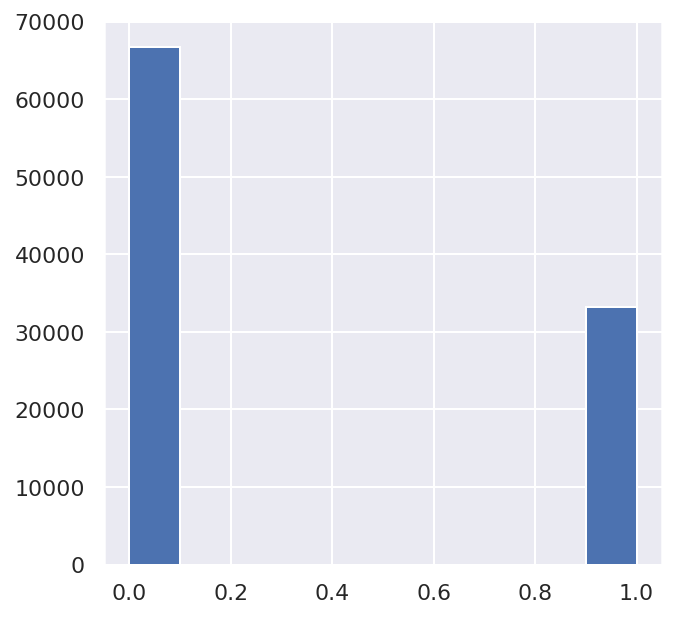

In [ ]:
plt.hist(df['is_attributed'])

(array([6.498119e+06, 0.000000e+00, 0.000000e+00, 0.000000e+00,
        0.000000e+00, 0.000000e+00, 0.000000e+00, 2.562200e+04,
        1.115000e+03, 1.189000e+03]),
 array([  0. ,  86.6, 173.2, 259.8, 346.4, 433. , 519.6, 606.2, 692.8,
        779.4, 866. ]),
 <a list of 10 Patch objects>)

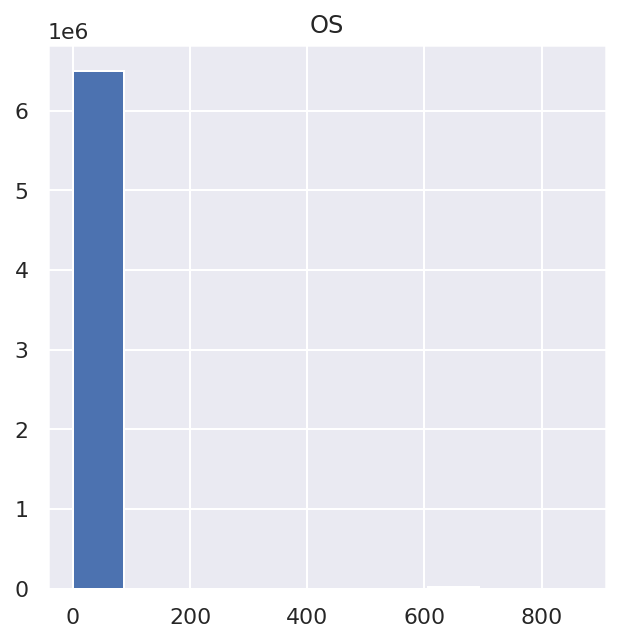

In [ ]:
plt.title("OS")
plt.hist(train['os'])

(array([5.154902e+06, 1.133549e+06, 5.850000e+04, 1.473550e+05,
        1.790400e+04, 9.266000e+03, 4.158000e+03, 0.000000e+00,
        3.450000e+02, 6.600000e+01]),
 array([  0. ,  18.3,  36.6,  54.9,  73.2,  91.5, 109.8, 128.1, 146.4,
        164.7, 183. ]),
 <a list of 10 Patch objects>)

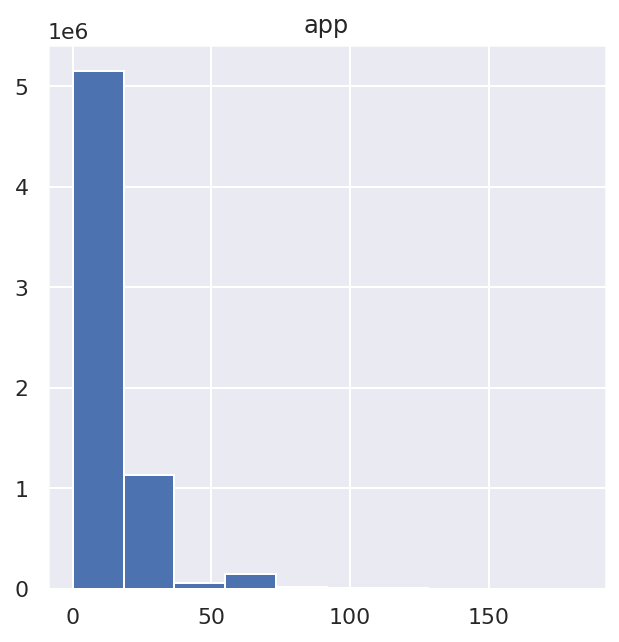

In [ ]:
plt.title("app")
plt.hist(train['app'])

(array([6501585.,       0.,       0.,       0.,       0.,       0.,
              0.,       0.,       0.,   24460.]),
 array([   0. ,  303.2,  606.4,  909.6, 1212.8, 1516. , 1819.2, 2122.4,
        2425.6, 2728.8, 3032. ]),
 <a list of 10 Patch objects>)

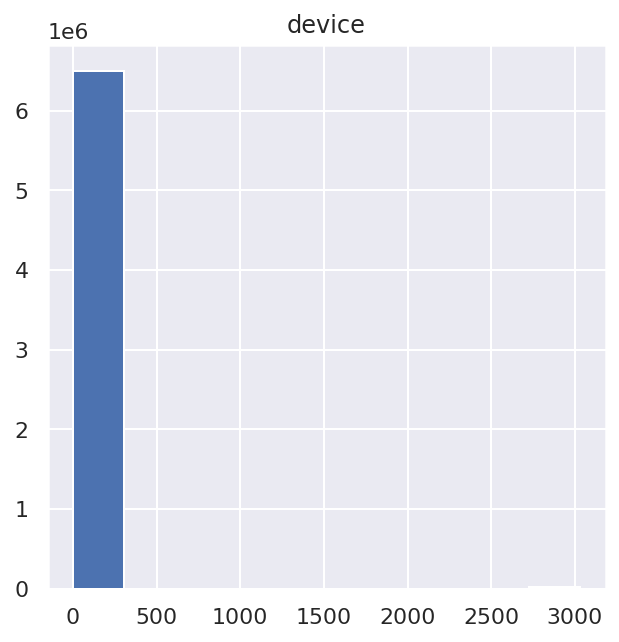

In [ ]:
plt.title("device")
plt.hist(train['device'])

(array([ 125070.,  704609., 1542995.,  447703., 1127625., 1199472.,
              0.,  151592.,  288211.,  938768.]),
 array([ 21. ,  67.8, 114.6, 161.4, 208.2, 255. , 301.8, 348.6, 395.4,
        442.2, 489. ]),
 <a list of 10 Patch objects>)

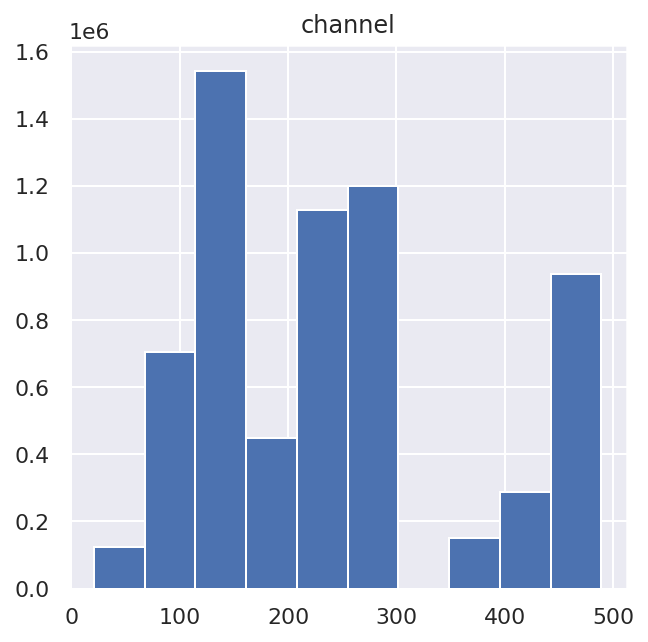

In [ ]:
plt.title("channel")
plt.hist(train['channel'])


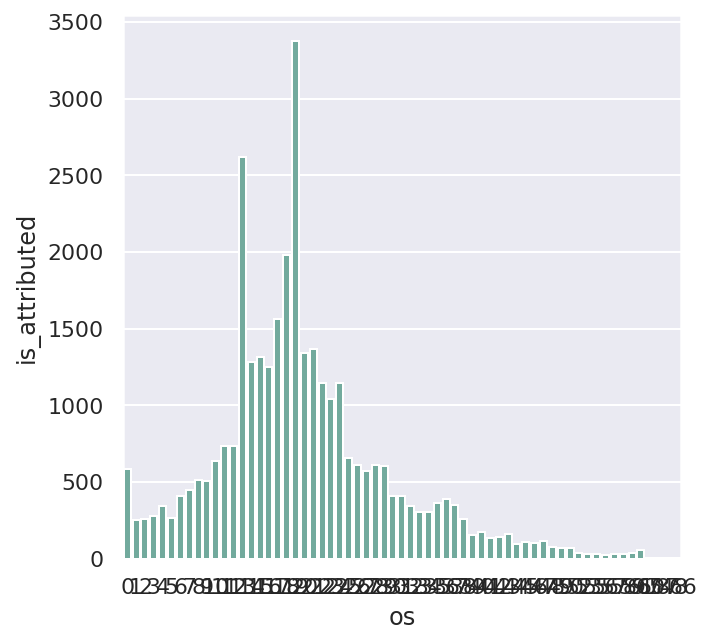

In [ ]:
sns.barplot(
    y="is_attributed", 
    x="os", 
    data=df, 
    estimator=sum, 
    ci=None, 
    color='#69b3a2');

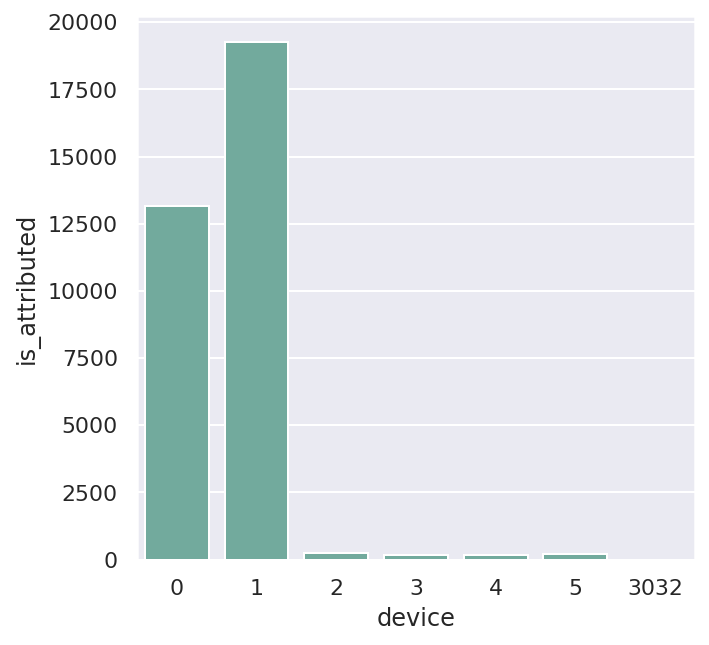

In [ ]:
sns.barplot(
    y="is_attributed", 
    x="device", 
    data=df, 
    estimator=sum, 
    ci=None, 
    color='#69b3a2');

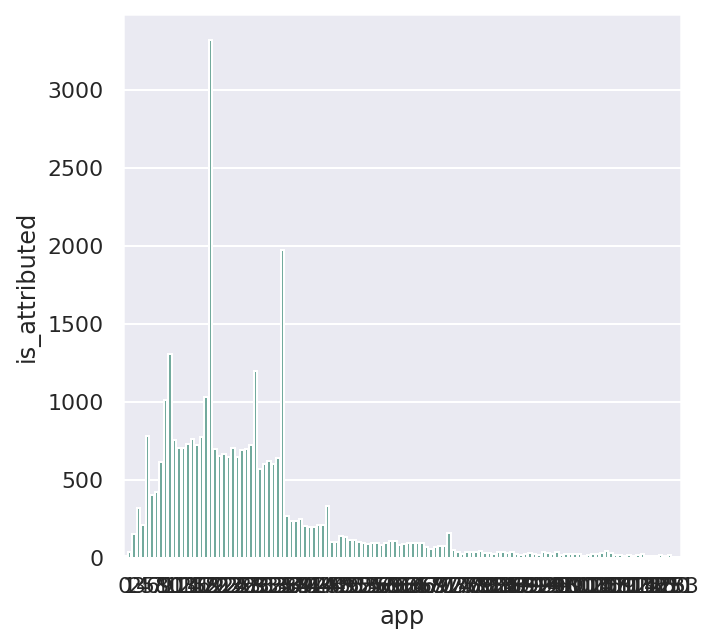

In [ ]:
sns.barplot(
    y="is_attributed", 
    x="app", 
    data=df, 
    estimator=sum, 
    ci=None, 
    color='#69b3a2');

In [ ]:
plt.show()

In [ ]:
sns.boxplot( x=df.os, y=df["app"] )

In [ ]:
df['os'].value_counts()

19     19555
13     16954
18      5313
17      5027
22      3866
       ...  
59        41
55        41
57        33
866       17
748       12
Name: os, Length: 63, dtype: int64

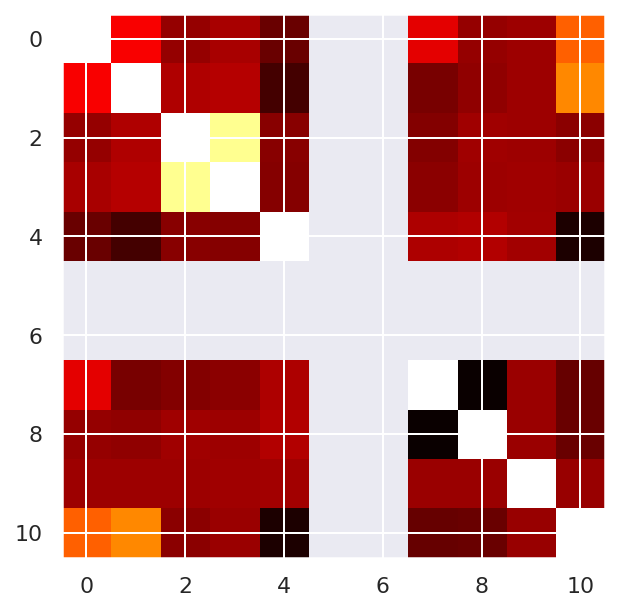

In [ ]:
plt.imshow(df.corr(),cmap='hot',interpolation='nearest')

In [ ]:
df.corr()

,ip,app,device,os,channel,Year,Month,Day,Hour,minute,is_attributed
ip,1.000000,0.173203,-0.016703,0.018873,-0.098258,NaN,NaN,0.136552,-0.017999,-0.001721,0.369935
app,0.173203,1.000000,0.035726,0.044298,-0.172582,NaN,NaN,-0.072791,-0.024265,-0.002870,0.444826
device,-0.016703,0.035726,1.000000,0.857845,-0.040100,NaN,NaN,-0.051326,0.004251,-0.001812,-0.036559
os,0.018873,0.044298,0.857845,1.000000,-0.043671,NaN,NaN,-0.036580,0.002057,0.002424,-0.005447
channel,-0.098258,-0.172582,-0.040100,-0.043671,1.000000,NaN,NaN,0.030621,0.040398,0.009263,-0.248617
Year,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Month,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Day,0.136552,-0.072791,-0.051326,-0.036580,0.030621,NaN,NaN,1.000000,-0.283785,-0.006863,-0.107106
Hour,-0.017999,-0.024265,0.004251,0.002057,0.040398,NaN,NaN,-0.283785,1.000000,-0.006057,-0.098548
minute,-0.001721,-0.002870,-0.001812,0.002424,0.009263,NaN,NaN,-0.006863,-0.006057,1.000000,-0.010785


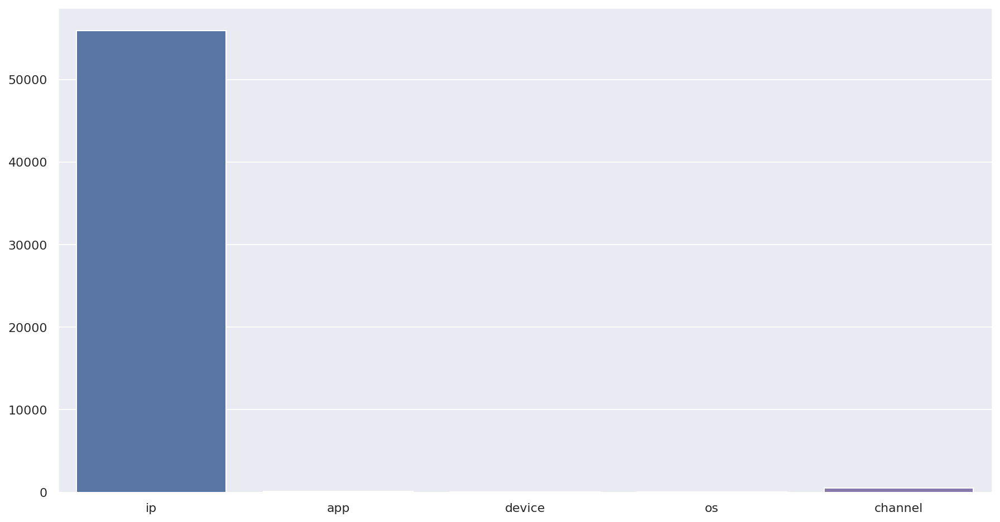

In [ ]:
plt.figure(figsize=(15, 8))
columns = [['ip', 'app', 'device', 'os', 'channel']]
unique_values = [len(df[col].value_counts()) for col in columns[0]]

ax = sns.barplot(x = columns[0] , y = unique_values , palette = sns.color_palette())

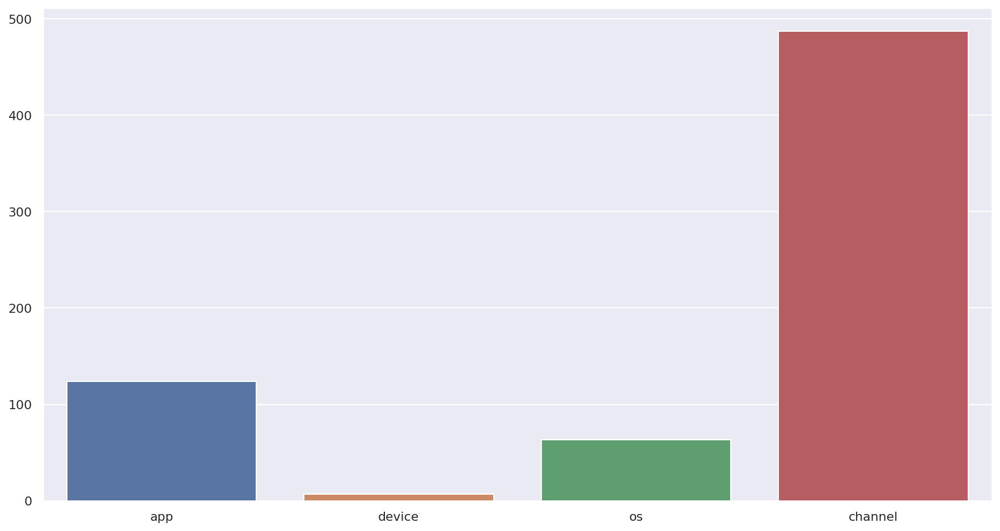

In [ ]:
plt.figure(figsize=(15, 8))
dax = sns.barplot(x = columns[0][1:5] , y = unique_values[1:5] , palette = sns.color_palette())


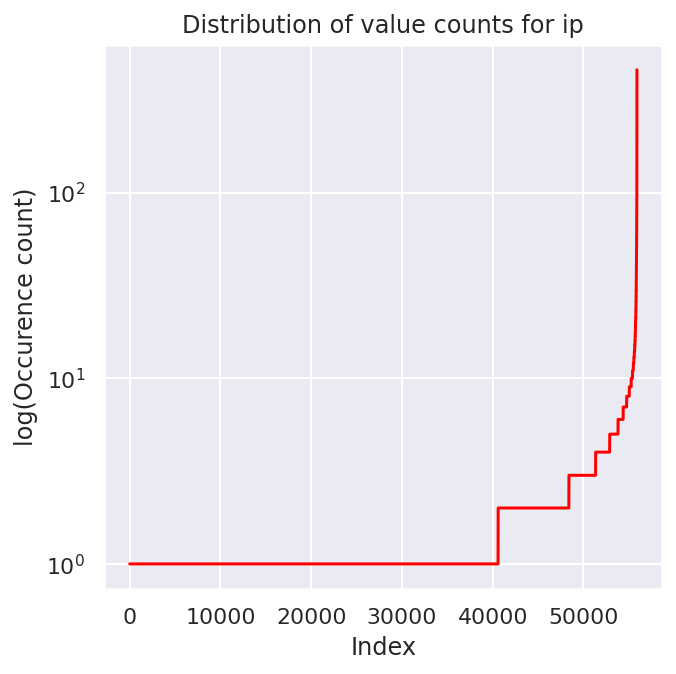

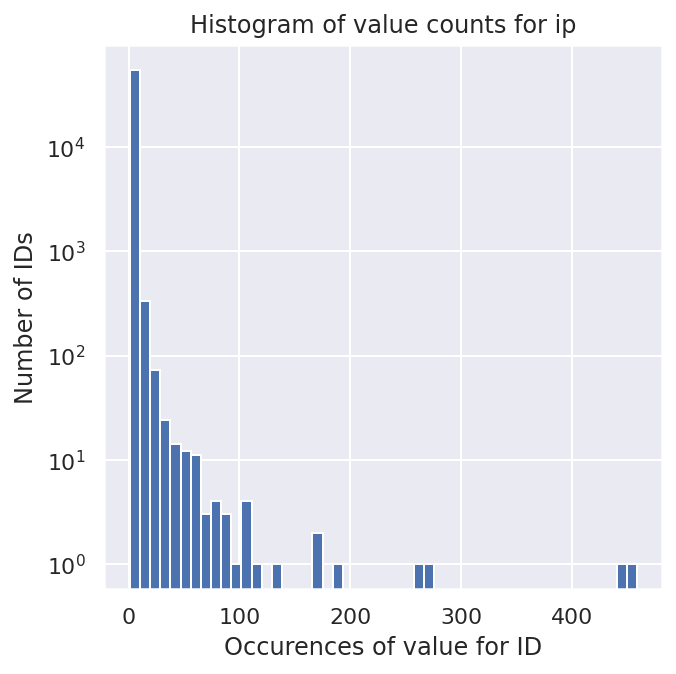

Variable 'ip': | Unique values: 55904 | Count of most common: 459 | Count of least common: 1 | count>10: 0.88% | count>100: 0.02% | count>1000: 0.0%


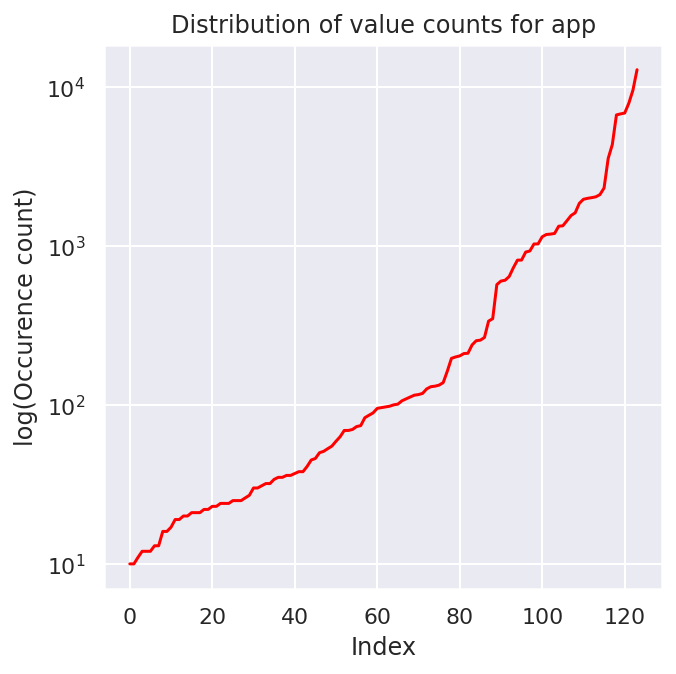

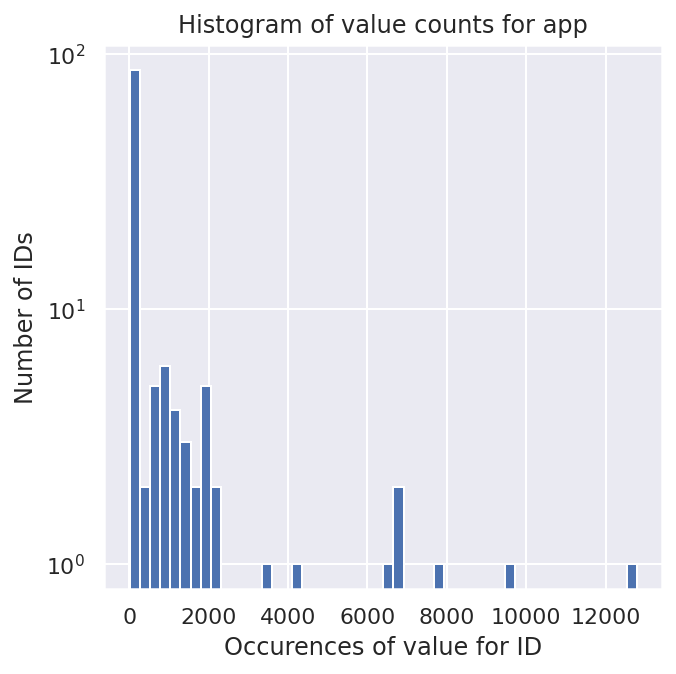

Variable 'app': | Unique values: 124 | Count of most common: 12791 | Count of least common: 10 | count>10: 98.39% | count>100: 47.58% | count>1000: 20.97%


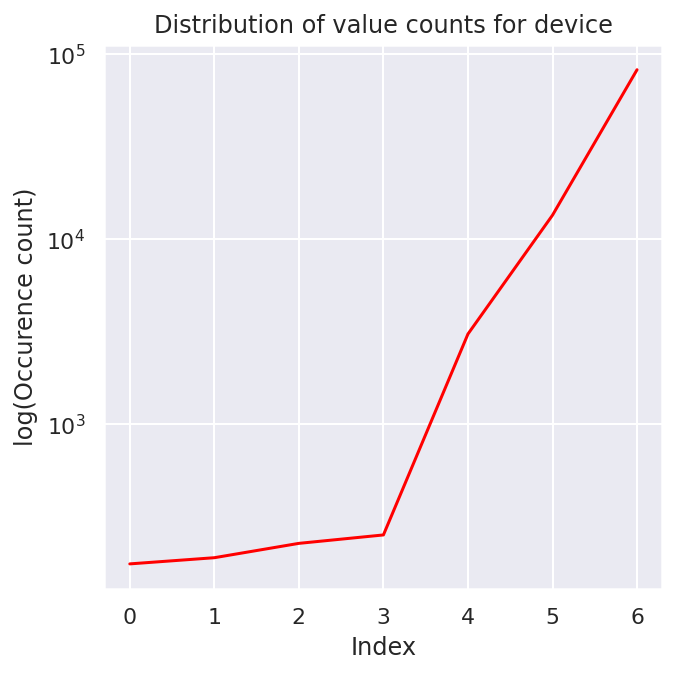

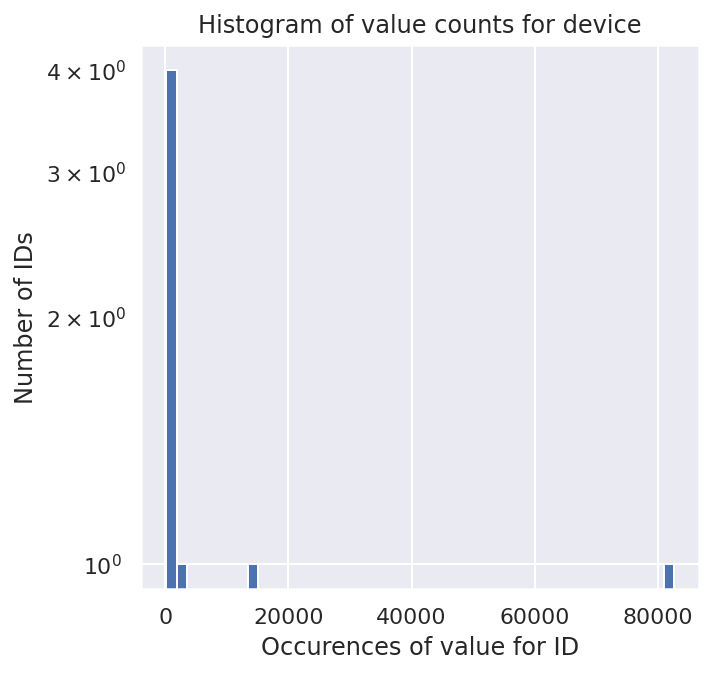

Variable 'device': | Unique values: 7 | Count of most common: 82602 | Count of least common: 175 | count>10: 100.0% | count>100: 100.0% | count>1000: 42.86%


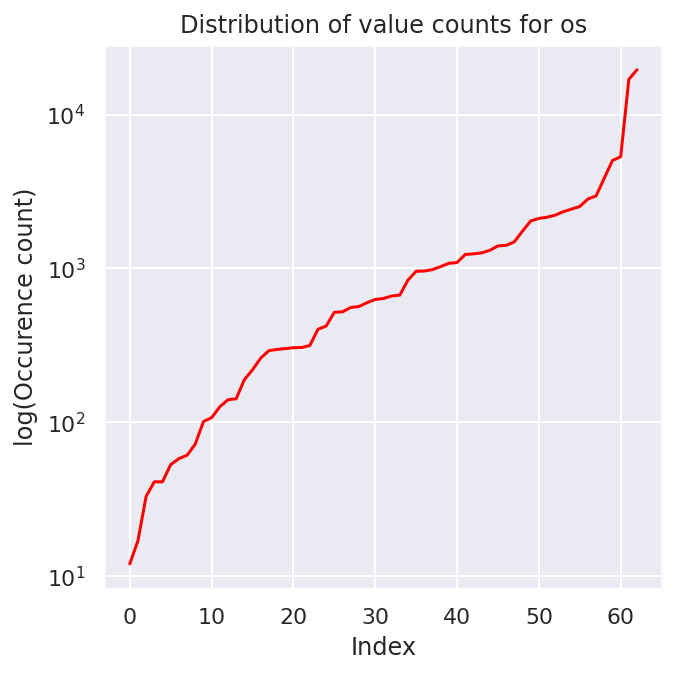

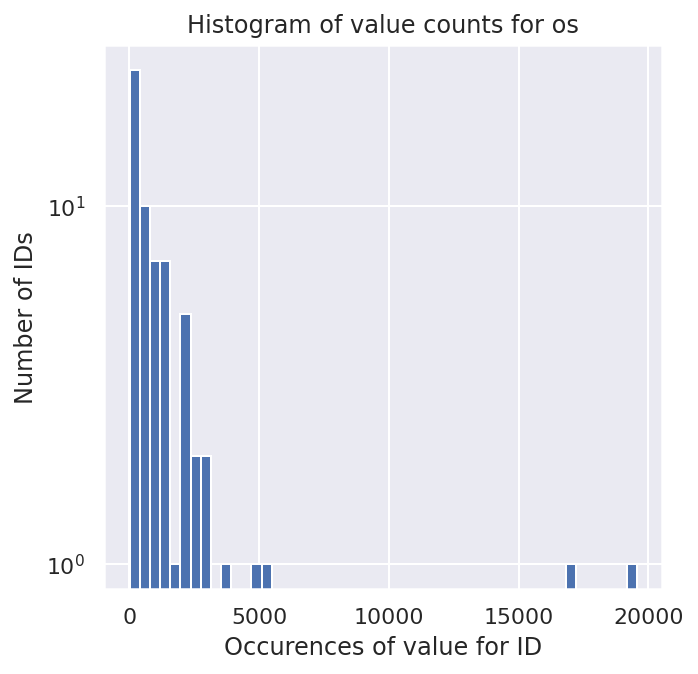

Variable 'os': | Unique values: 63 | Count of most common: 19555 | Count of least common: 12 | count>10: 100.0% | count>100: 85.71% | count>1000: 39.68%


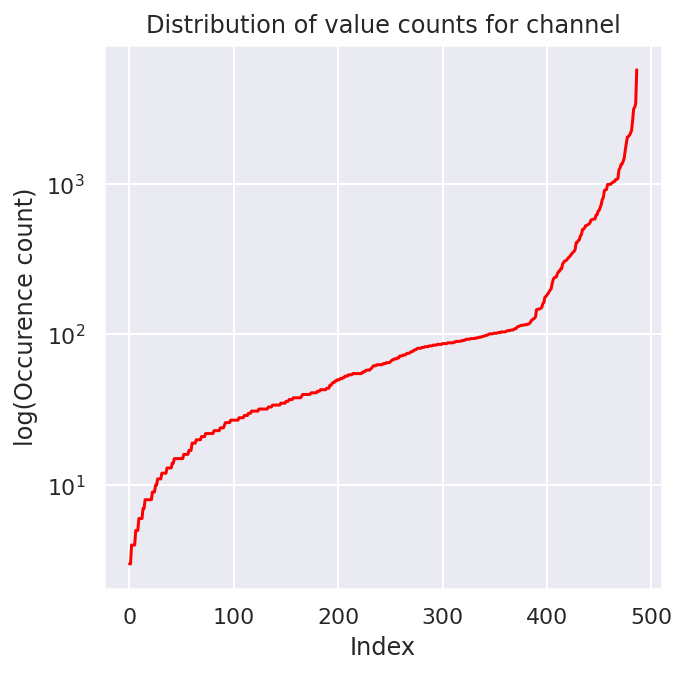

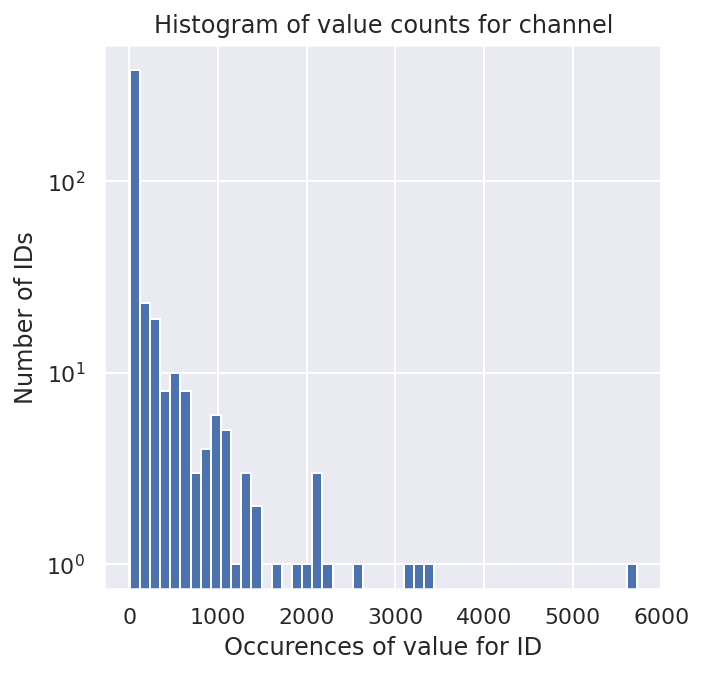

Variable 'channel': | Unique values: 487 | Count of most common: 5724 | Count of least common: 3 | count>10: 94.46% | count>100: 29.16% | count>1000: 5.13%


In [ ]:
for col, uniq in zip(columns[0], unique_values):
    counts = df[col].value_counts()

    sorted_counts = np.sort(counts.values)
    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)
    line, = ax.plot(sorted_counts, color='red')
    ax.set_yscale('log')
    plt.title("Distribution of value counts for {}".format(col))
    plt.ylabel('log(Occurence count)')
    plt.xlabel('Index')
    plt.show()
    
    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)
    plt.hist(sorted_counts, bins=50)
    ax.set_yscale('log', nonposy='clip')
    plt.title("Histogram of value counts for {}".format(col))
    plt.ylabel('Number of IDs')
    plt.xlabel('Occurences of value for ID')
    plt.show()
    
    max_count = np.max(counts)
    min_count = np.min(counts)
    gt = [10, 100, 1000]
    prop_gt = []
    for value in gt:
        prop_gt.append(round((counts > value).mean()*100, 2))
    print("Variable '{}': | Unique values: {} | Count of most common: {} | Count of least common: {} | count>10: {}% | count>100: {}% | count>1000: {}%".format(col, uniq, max_count, min_count, *prop_gt))

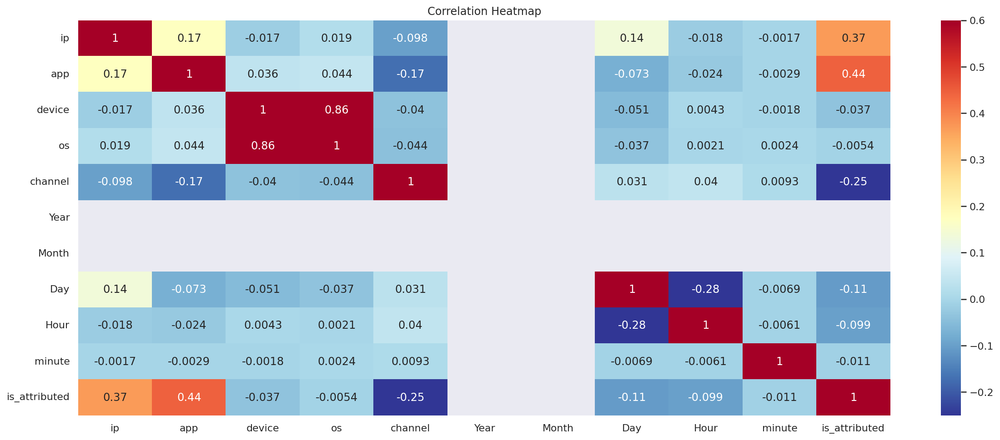

In [ ]:
plt.figure(figsize = (20, 8))

# Heatmap of correlations
sns.heatmap(df.corr(), cmap = plt.cm.RdYlBu_r, vmin = -0.25, annot = True, vmax = 0.6)
plt.title('Correlation Heatmap');

In [ ]:
#make wider graphs
sns.set(rc={'figure.figsize':(12,5)});
plt.figure(figsize=(12,5));

for fea in unique_count_features:
    sns.boxplot(df1.is_attributed, df1[fea])
    title_2 = 'PLOT OF: ' +fea
    plt.title(title_2)
    plt.show()
    sns.violinplot(df1.is_attributed, df1[fea])
    title_2 = 'PLOT OF:  ' +fea
    plt.title(title_2)
    plt.show()
    gc.collect()
    print('*'*70)


NameError: ignored

<Figure size 864x360 with 0 Axes>

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



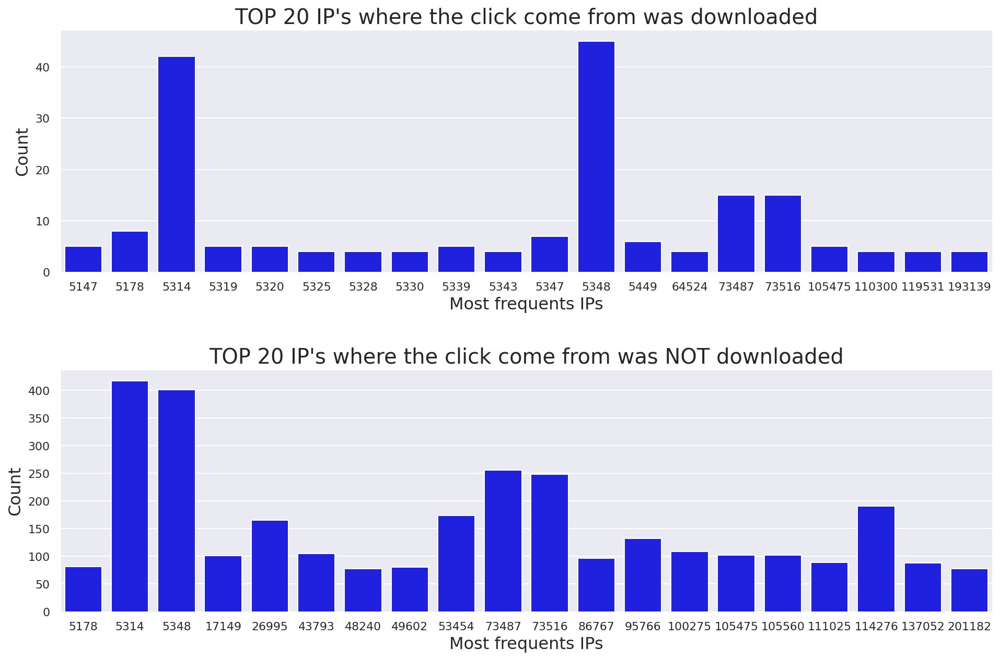

In [ ]:
ip_frequency_downloaded = df[df['is_attributed'] == 1]['ip'].value_counts()[:20]
ip_frequency_click = df[df['is_attributed'] == 0]['ip'].value_counts()[:20]

plt.figure(figsize=(16,10))
plt.subplot(2,1,1)
g = sns.barplot(ip_frequency_downloaded.index, ip_frequency_downloaded.values, color='blue')
g.set_title("TOP 20 IP's where the click come from was downloaded",fontsize=20)
g.set_xlabel('Most frequents IPs',fontsize=16)
g.set_ylabel('Count',fontsize=16)

plt.subplot(2,1,2)
g1 = sns.barplot(ip_frequency_click.index, ip_frequency_click.values, color='blue')
g1.set_title("TOP 20 IP's where the click come from was NOT downloaded",fontsize=20)
g1.set_xlabel('Most frequents IPs',fontsize=16)
g1.set_ylabel('Count',fontsize=16)

plt.subplots_adjust(wspace = 0.1, hspace = 0.4,top = 0.9)

plt.show()

In [ ]:
!pip install squarify 
import squarify    


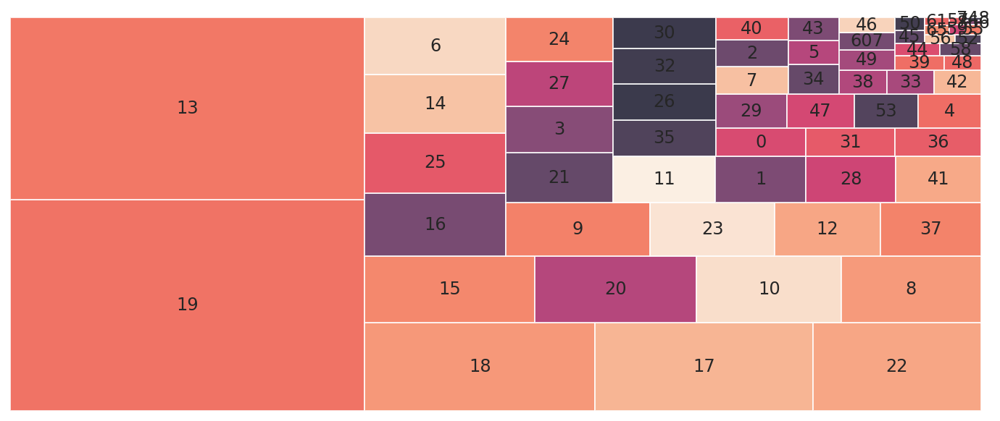

In [ ]:
squarify.plot(sizes=df['os'].value_counts().values, label=df['os'].value_counts().index, alpha=.8 )
plt.axis('off')
plt.show()

In [ ]:
df.is_attributed.value_counts().values

array([66751, 33249])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: MatplotlibDeprecationWarning:

Non-1D inputs to pie() are currently squeeze()d, but this behavior is deprecated since 3.1 and will be removed in 3.3; pass a 1D array instead.



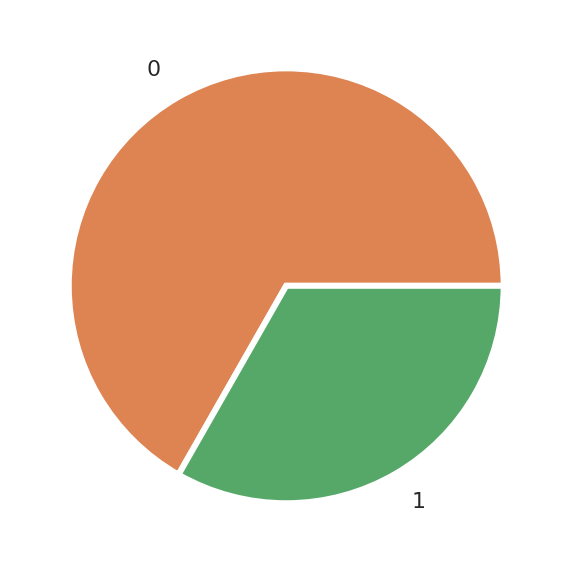

In [ ]:
# Create a pieplot
plt.pie(2)
plt.pie(df['is_attributed'].value_counts().values, labels=df.is_attributed.value_counts().index, labeldistance=1.15, wedgeprops = { 'linewidth' : 3, 'edgecolor' : 'white' });

plt.show();

In [ ]:
import plotly.express as px
temp = pd.DataFrame(df.Hour.value_counts())
fig = px.bar(temp, x=temp.index, y='Hour',
              color='Hour',
             labels={'pop':'population of Canada'}, height=400)
fig.show()

# Logistic Regression Main

In [ ]:
df.Month.value_counts()

11    100000
Name: Month, dtype: int64

In [ ]:
df.Year.value_counts()

2017    100000
Name: Year, dtype: int64

In [ ]:
df = model_datas[0]

In [ ]:
from sklearn.model_selection import train_test_split

X = df.drop(['is_attributed'], axis=1)

y = df['is_attributed']

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.20,random_state=0)

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_curve
from sklearn.metrics import auc

def evalute_mode(y_pred , y_pred_probab ,y_test):
  
  cm = confusion_matrix(y_test, y_pred)
  print('Confusion matrix\n\n', cm)
  print('\nTrue Positives(TP) = ', cm[0,0])
  print('\nTrue Negatives(TN) = ', cm[1,1])
  print('\nFalse Positives(FP) = ', cm[0,1])
  print('\nFalse Negatives(FN) = ', cm[1,0])
  TP = cm[0,0]
  TN = cm[1,1]
  FP = cm[0,1]
  FN = cm[1,0]
  print("========================================================================")
  plt.figure(figsize=(6,4))
  cm_matrix = pd.DataFrame(data=cm, columns=['Actual Positive:1', 'Actual Negative:0'], 
                                  index=['Predict Positive:1', 'Predict Negative:0'])
  sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')
  plt.show()
  print("========================================================================")
  print(classification_report(y_test, y_pred))
  print("========================================================================")
  classification_accuracy = (TP + TN) / float(TP + TN + FP + FN)
  print('Classification accuracy : {0:0.4f}'.format(classification_accuracy))
  print("========================================================================")
  fpr, tpr, threshold = roc_curve(y_test, y_pred_probab[:,1])
  roc_auc = auc(fpr, tpr)

  plt.title('Receiver Operating Characteristic')
  plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
  plt.legend(loc = 'lower right')
  plt.plot([0, 1], [0, 1],'r--')
  plt.xlim([0, 1])
  plt.ylim([0, 1])
  plt.ylabel('True Positive Rate')
  plt.xlabel('False Positive Rate')
  plt.title('ROC Curve of kNN')
  plt.show()

In [ ]:
from sklearn.linear_model import LogisticRegression

def lgstc_Reg(X_train, X_test, y_train, y_test, n_neighbors = 4):
  weights = {0:0.33,1:0.7}
  logreg = LogisticRegression(class_weight=weights , C = 10)
  logreg.fit(X_train, y_train)
  y_pred = logreg.predict(X_test)
  y_pred_probab = logreg.predict_proba(X_test)
  print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test, y_pred)))
  y_pred_train = logreg.predict(X_train)
  print('Training-set accuracy score: {0:0.4f}'. format(accuracy_score(y_train, y_pred_train)))
  return y_pred , y_pred_probab , logreg

In [ ]:
def predicate_data_lgstic(X_test, y_test,logreg ):
  y_pred = logreg.predict(X_test)
  y_pred_probab = logreg.predict_proba(X_test)
  print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test, y_pred)))
  y_pred_train = logreg.predict(X_train)
  print('Training-set accuracy score: {0:0.4f}'. format(accuracy_score(y_train, y_pred_train)))
  return y_pred , y_pred_probab

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,


Model accuracy score: 0.8369
Training-set accuracy score: 0.8339
Confusion matrix

 [[12389  1037]
 [ 2225  4349]]

True Positives(TP) =  12389

True Negatives(TN) =  4349

False Positives(FP) =  1037

False Negatives(FN) =  2225


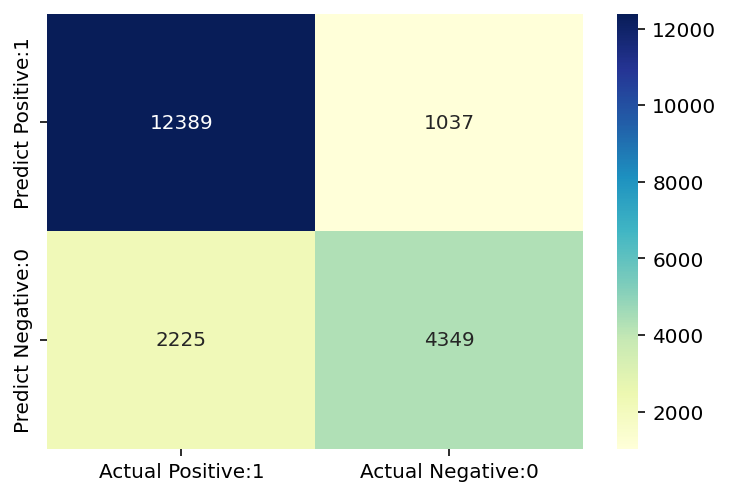

              precision    recall  f1-score   support

           0       0.85      0.92      0.88     13426
           1       0.81      0.66      0.73      6574

    accuracy                           0.84     20000
   macro avg       0.83      0.79      0.81     20000
weighted avg       0.83      0.84      0.83     20000

Classification accuracy : 0.8369


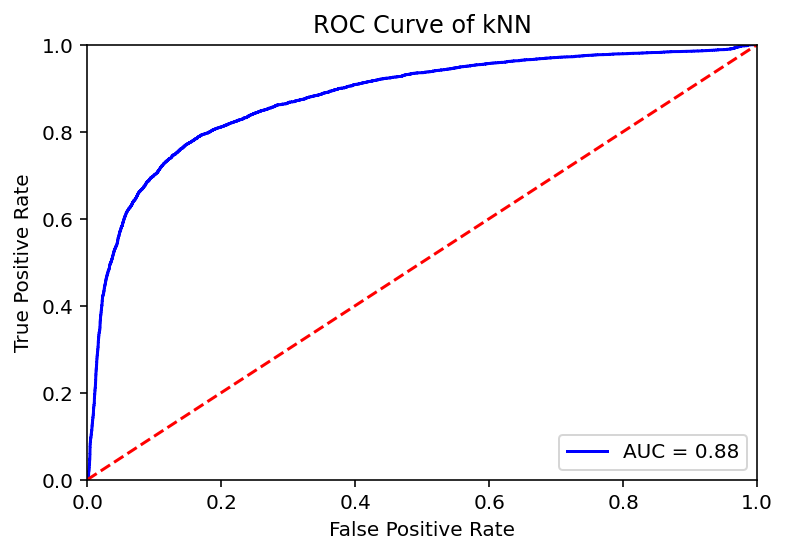

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,


Model accuracy score: 0.7703
Training-set accuracy score: 0.7728
Confusion matrix

 [[60353  6259]
 [16712 16676]]

True Positives(TP) =  60353

True Negatives(TN) =  16676

False Positives(FP) =  6259

False Negatives(FN) =  16712


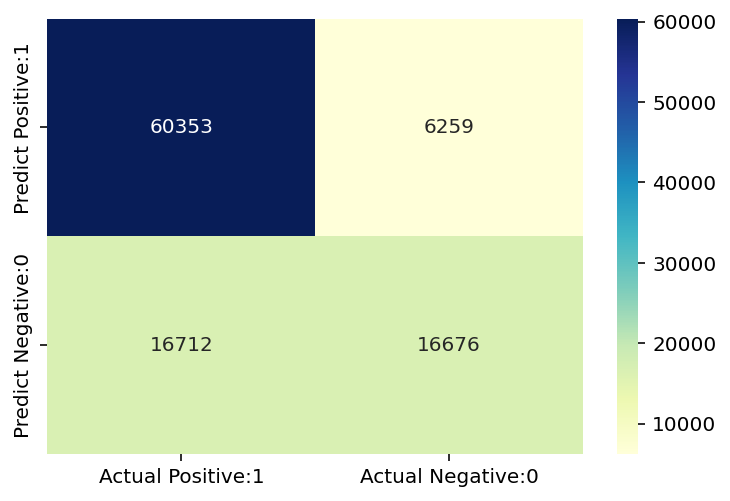

              precision    recall  f1-score   support

           0       0.78      0.91      0.84     66612
           1       0.73      0.50      0.59     33388

    accuracy                           0.77    100000
   macro avg       0.76      0.70      0.72    100000
weighted avg       0.76      0.77      0.76    100000

Classification accuracy : 0.7703


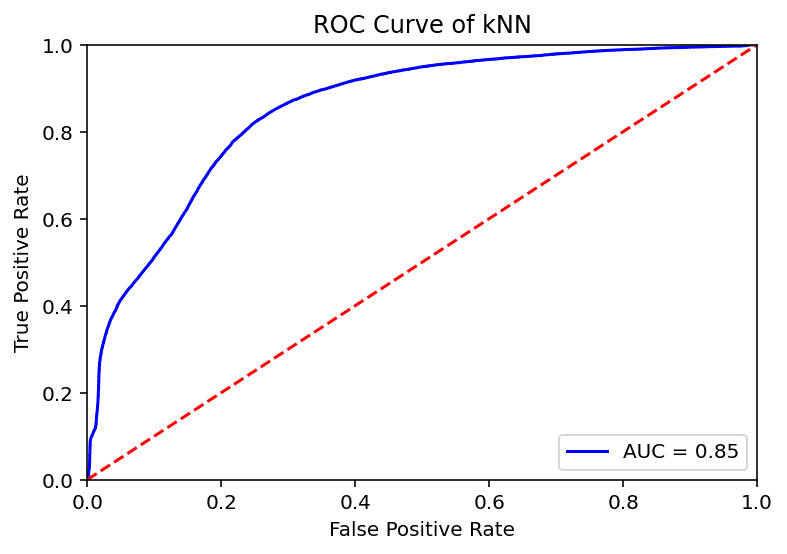

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,


Model accuracy score: 0.8369
Training-set accuracy score: 0.8339
Confusion matrix

 [[12389  1037]
 [ 2225  4349]]

True Positives(TP) =  12389

True Negatives(TN) =  4349

False Positives(FP) =  1037

False Negatives(FN) =  2225


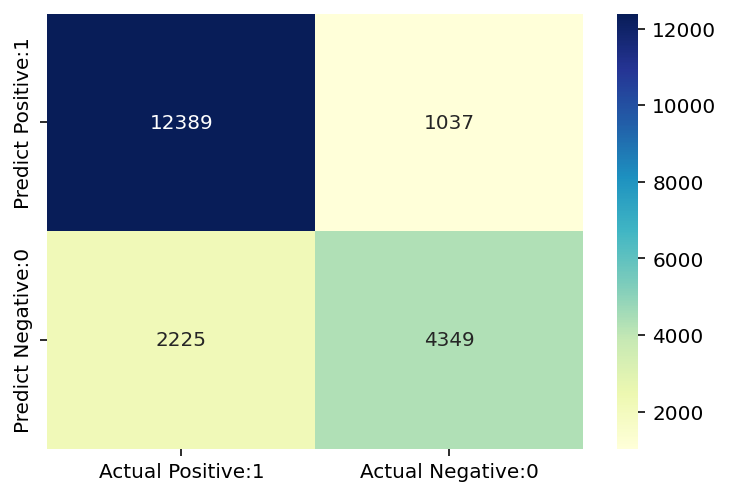

              precision    recall  f1-score   support

           0       0.85      0.92      0.88     13426
           1       0.81      0.66      0.73      6574

    accuracy                           0.84     20000
   macro avg       0.83      0.79      0.81     20000
weighted avg       0.83      0.84      0.83     20000

Classification accuracy : 0.8369


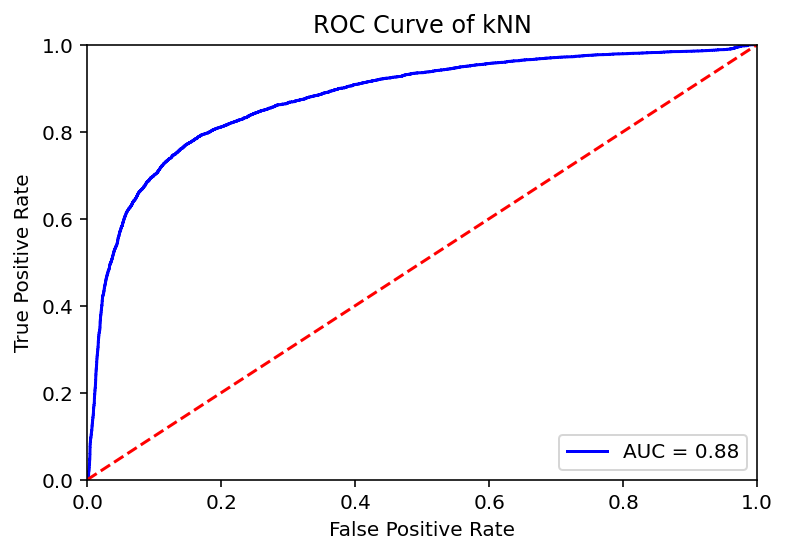

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,


Model accuracy score: 0.7703
Training-set accuracy score: 0.7728
Confusion matrix

 [[60353  6259]
 [16712 16676]]

True Positives(TP) =  60353

True Negatives(TN) =  16676

False Positives(FP) =  6259

False Negatives(FN) =  16712


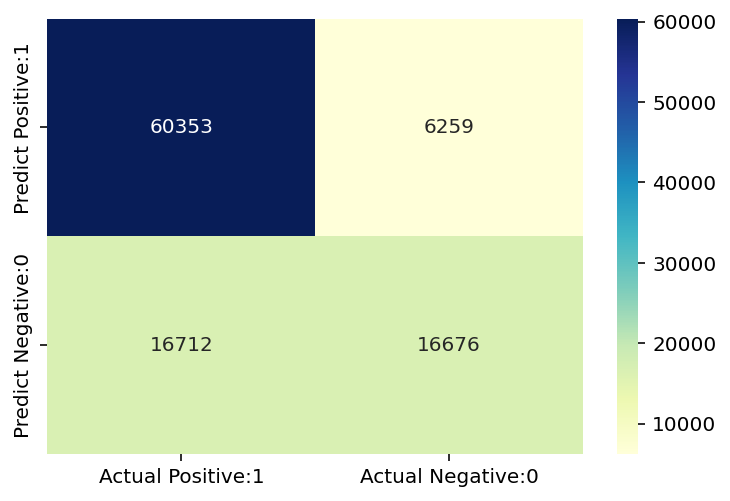

              precision    recall  f1-score   support

           0       0.78      0.91      0.84     66612
           1       0.73      0.50      0.59     33388

    accuracy                           0.77    100000
   macro avg       0.76      0.70      0.72    100000
weighted avg       0.76      0.77      0.76    100000

Classification accuracy : 0.7703


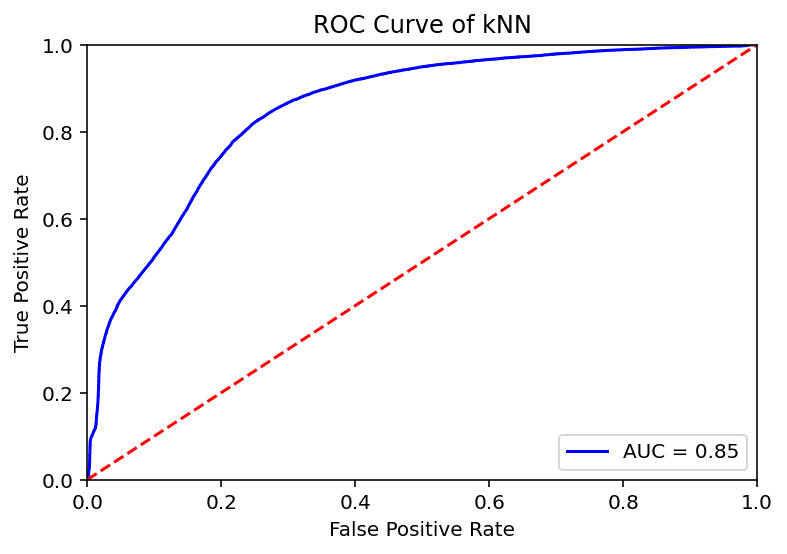

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,


Model accuracy score: 0.7730
Training-set accuracy score: 0.7726
Confusion matrix

 [[121104  12141]
 [ 33251  33504]]

True Positives(TP) =  121104

True Negatives(TN) =  33504

False Positives(FP) =  12141

False Negatives(FN) =  33251


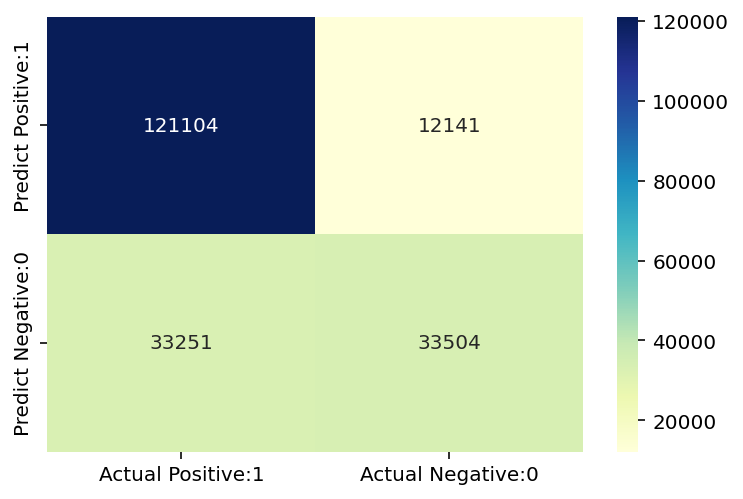

              precision    recall  f1-score   support

           0       0.78      0.91      0.84    133245
           1       0.73      0.50      0.60     66755

    accuracy                           0.77    200000
   macro avg       0.76      0.71      0.72    200000
weighted avg       0.77      0.77      0.76    200000

Classification accuracy : 0.7730


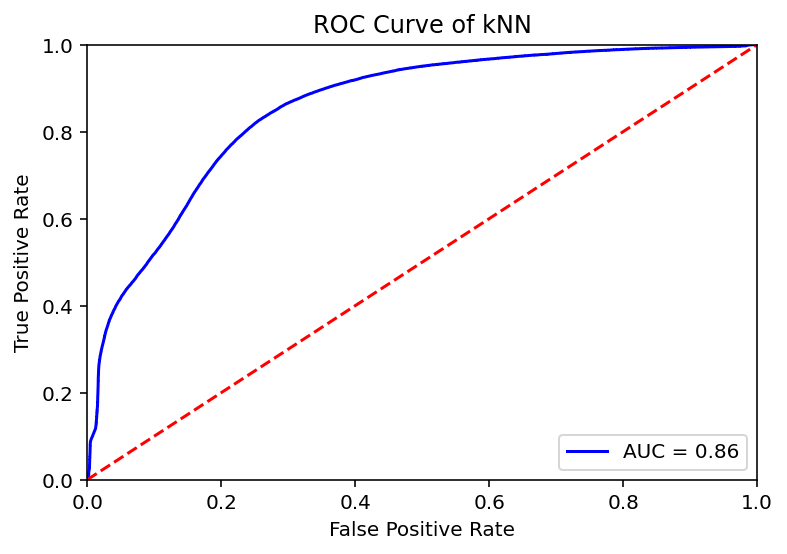

In [ ]:
for i in range(len(model_datas)):
  df = model_datas[i]
  X = df.drop(['is_attributed'], axis=1)

  y = df['is_attributed']

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  y_pred , y_pred_probab = lgstc_Reg(X_train , X_test , y_train, y_test)
  evalute_mode(y_pred , y_pred_probab ,y_test)

Model accuracy score: 0.7914
Training-set accuracy score: 0.7889
Confusion matrix

 [[12271  1155]
 [ 3016  3558]]

True Positives(TP) =  12271

True Negatives(TN) =  3558

False Positives(FP) =  1155

False Negatives(FN) =  3016


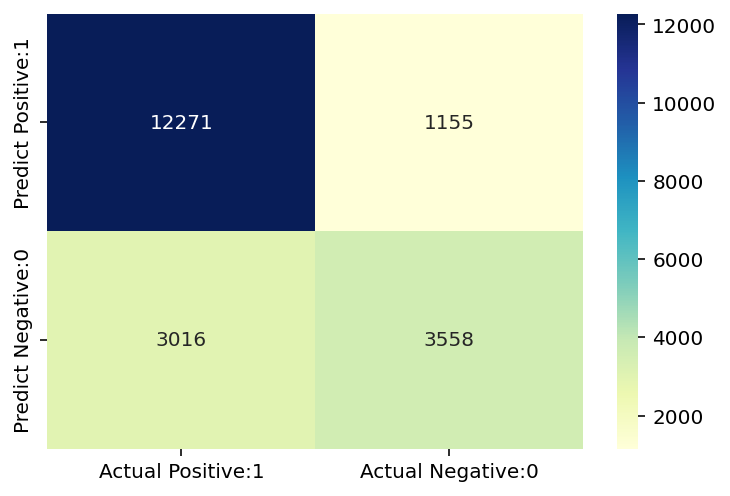

              precision    recall  f1-score   support

           0       0.80      0.91      0.85     13426
           1       0.75      0.54      0.63      6574

    accuracy                           0.79     20000
   macro avg       0.78      0.73      0.74     20000
weighted avg       0.79      0.79      0.78     20000

Classification accuracy : 0.7914


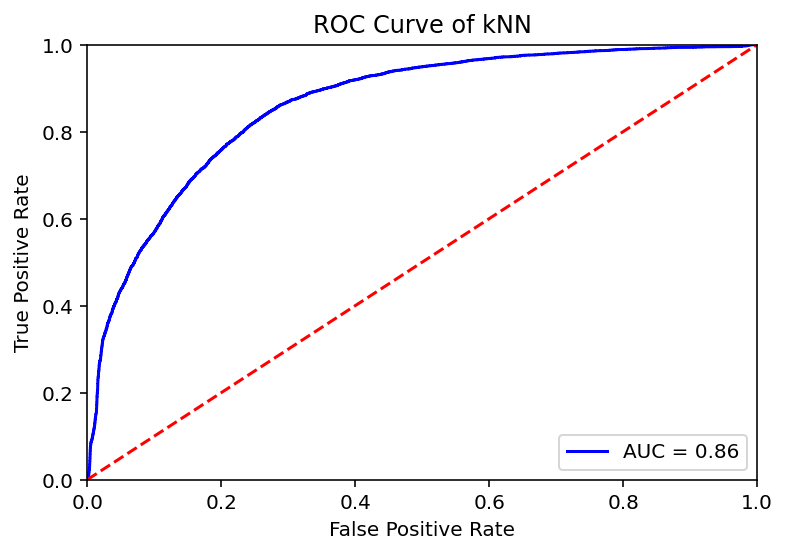

Model accuracy score: 0.8120
Training-set accuracy score: 0.8139
Confusion matrix

 [[61408  5204]
 [13596 19792]]

True Positives(TP) =  61408

True Negatives(TN) =  19792

False Positives(FP) =  5204

False Negatives(FN) =  13596


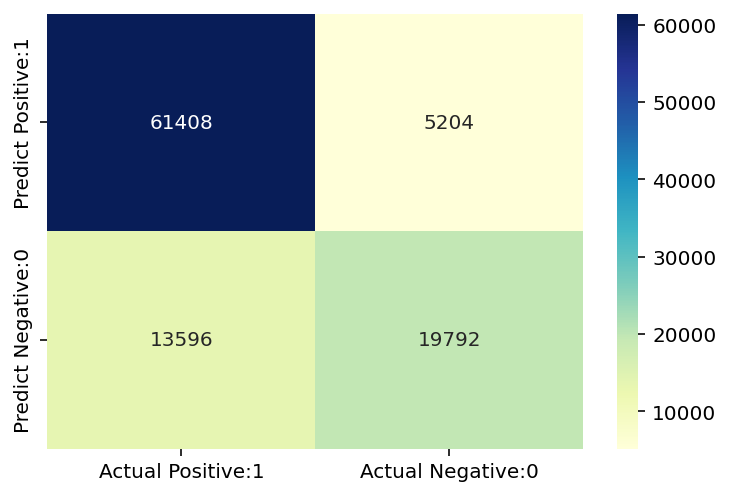

              precision    recall  f1-score   support

           0       0.82      0.92      0.87     66612
           1       0.79      0.59      0.68     33388

    accuracy                           0.81    100000
   macro avg       0.81      0.76      0.77    100000
weighted avg       0.81      0.81      0.80    100000

Classification accuracy : 0.8120


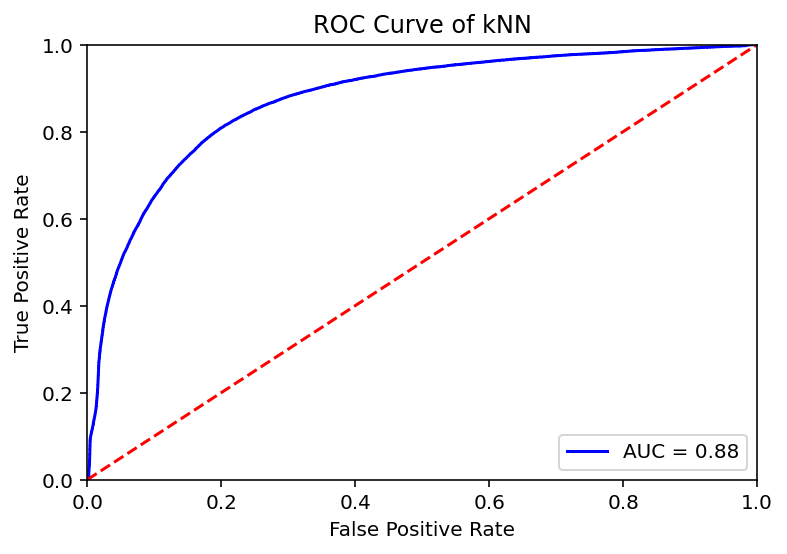

Model accuracy score: 0.7914
Training-set accuracy score: 0.7889
Confusion matrix

 [[12271  1155]
 [ 3016  3558]]

True Positives(TP) =  12271

True Negatives(TN) =  3558

False Positives(FP) =  1155

False Negatives(FN) =  3016


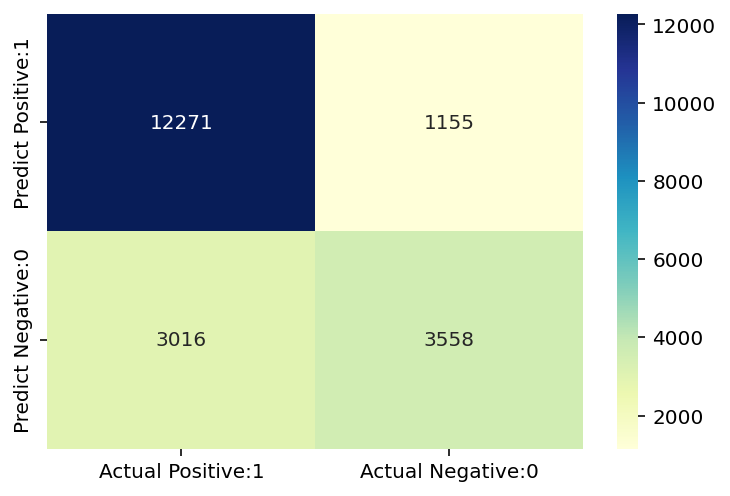

              precision    recall  f1-score   support

           0       0.80      0.91      0.85     13426
           1       0.75      0.54      0.63      6574

    accuracy                           0.79     20000
   macro avg       0.78      0.73      0.74     20000
weighted avg       0.79      0.79      0.78     20000

Classification accuracy : 0.7914


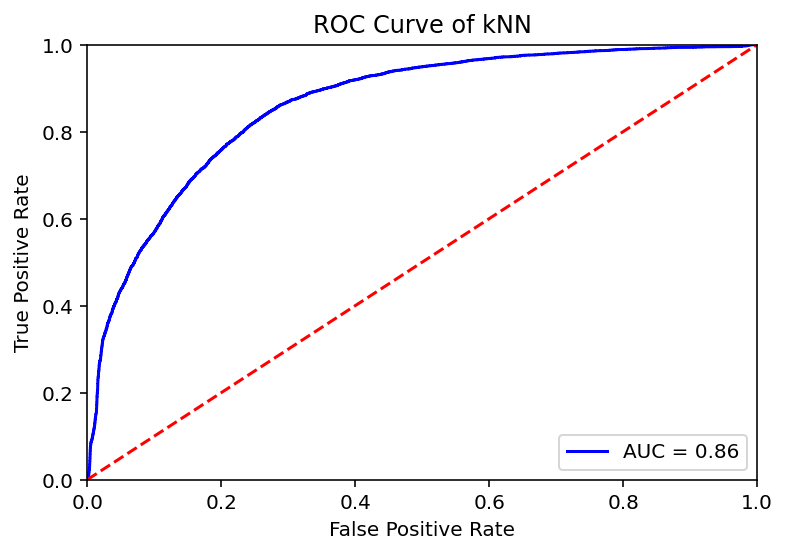

Model accuracy score: 0.8120
Training-set accuracy score: 0.8139
Confusion matrix

 [[61408  5204]
 [13596 19792]]

True Positives(TP) =  61408

True Negatives(TN) =  19792

False Positives(FP) =  5204

False Negatives(FN) =  13596


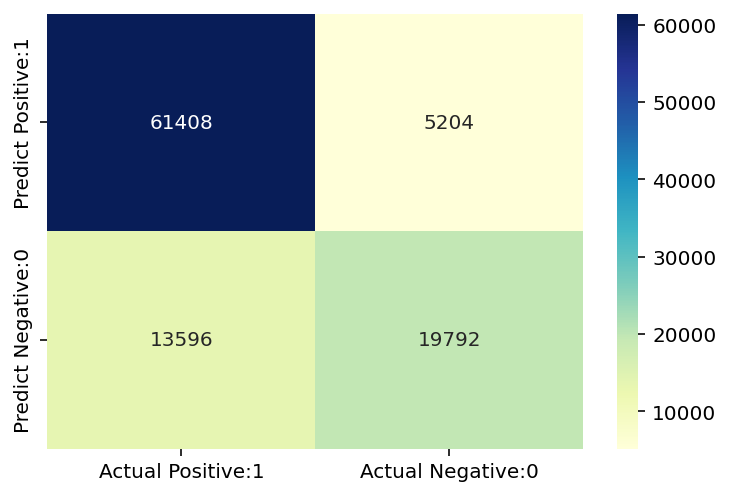

              precision    recall  f1-score   support

           0       0.82      0.92      0.87     66612
           1       0.79      0.59      0.68     33388

    accuracy                           0.81    100000
   macro avg       0.81      0.76      0.77    100000
weighted avg       0.81      0.81      0.80    100000

Classification accuracy : 0.8120


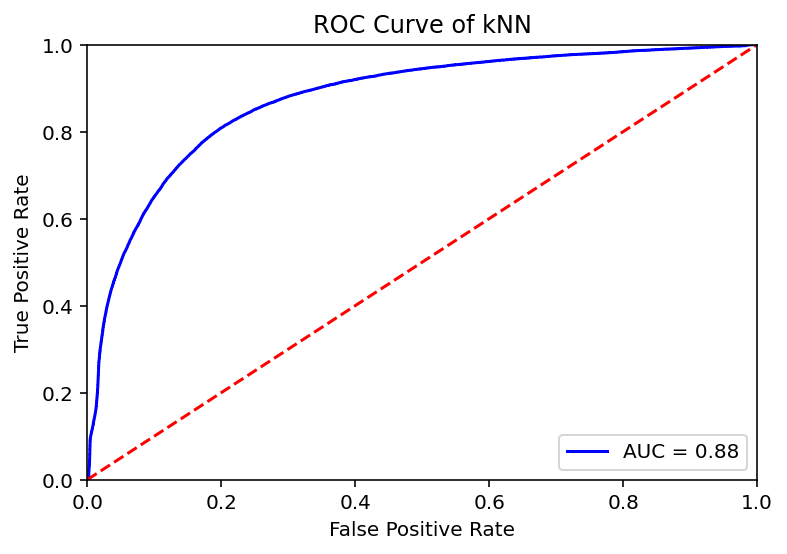

Model accuracy score: 0.8304
Training-set accuracy score: 0.8311
Confusion matrix

 [[123816   9429]
 [ 24495  42260]]

True Positives(TP) =  123816

True Negatives(TN) =  42260

False Positives(FP) =  9429

False Negatives(FN) =  24495


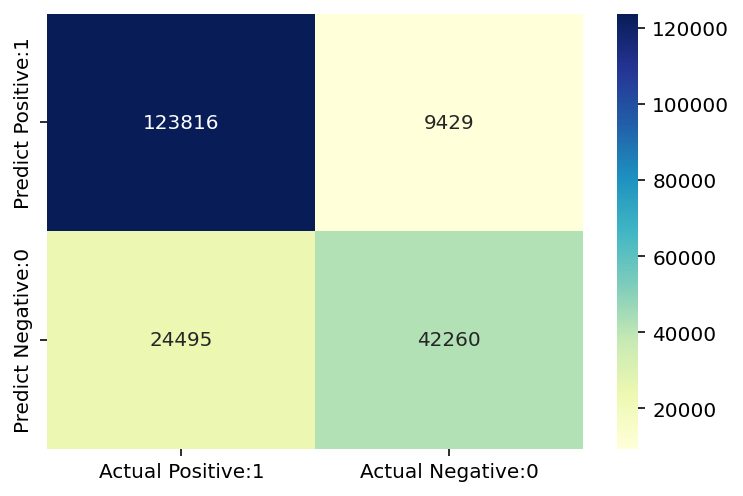

              precision    recall  f1-score   support

           0       0.83      0.93      0.88    133245
           1       0.82      0.63      0.71     66755

    accuracy                           0.83    200000
   macro avg       0.83      0.78      0.80    200000
weighted avg       0.83      0.83      0.82    200000

Classification accuracy : 0.8304


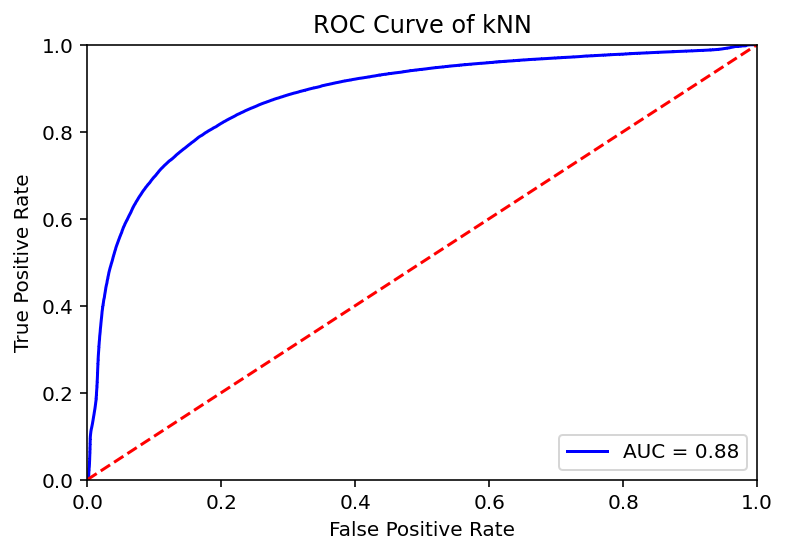

In [ ]:
from sklearn.preprocessing import StandardScaler

for i in range(len(model_datas)):
  df = model_datas[i]
  X = df.drop(['is_attributed'], axis=1)

  y = df['is_attributed']

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  scaler = StandardScaler()
  
  X_train = pd.DataFrame(scaler.fit_transform(X_train), columns = X.columns)
  X_test = pd.DataFrame(scaler.transform(X_test), columns = X.columns)
  
  y_pred , y_pred_probab = lgstc_Reg(X_train , X_test , y_train, y_test)
  evalute_mode(y_pred , y_pred_probab ,y_test)




Model accuracy score: 0.7845
Training-set accuracy score: 0.7804
Confusion matrix

 [[12700   726]
 [ 3583  2991]]

True Positives(TP) =  12700

True Negatives(TN) =  2991

False Positives(FP) =  726

False Negatives(FN) =  3583


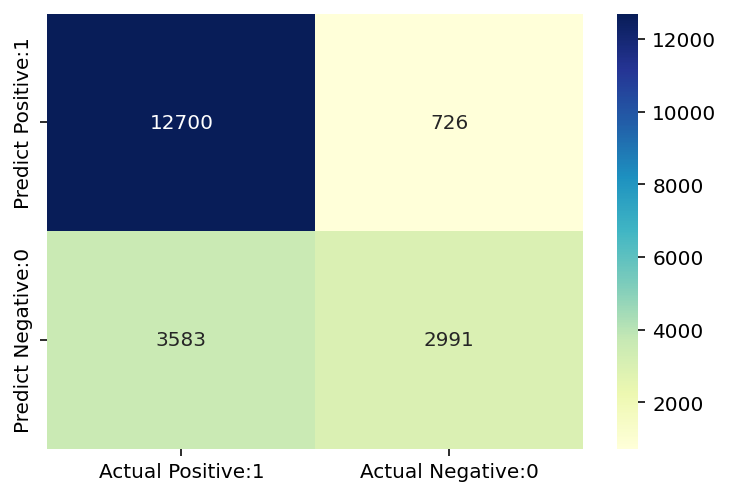

              precision    recall  f1-score   support

           0       0.78      0.95      0.85     13426
           1       0.80      0.45      0.58      6574

    accuracy                           0.78     20000
   macro avg       0.79      0.70      0.72     20000
weighted avg       0.79      0.78      0.77     20000

Classification accuracy : 0.7845


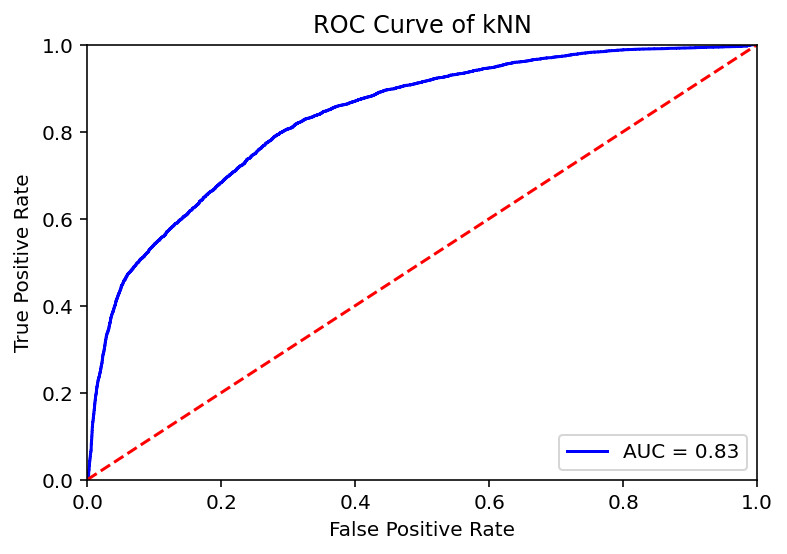

Model accuracy score: 0.8336
Training-set accuracy score: 0.8327
Confusion matrix

 [[64360  2252]
 [14390 18998]]

True Positives(TP) =  64360

True Negatives(TN) =  18998

False Positives(FP) =  2252

False Negatives(FN) =  14390


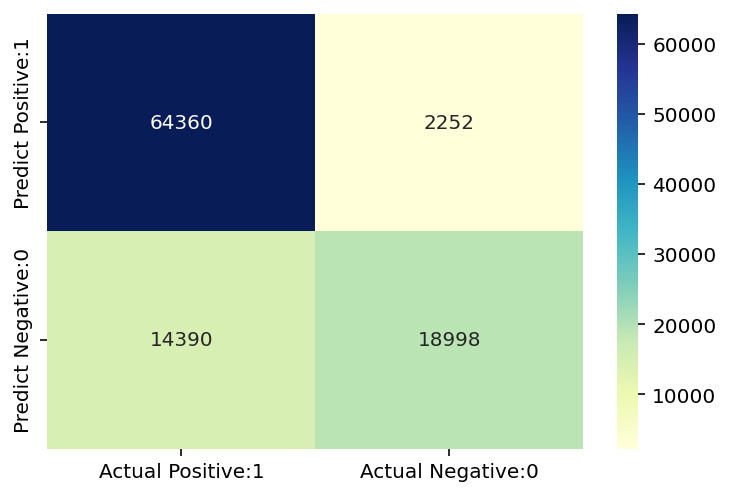

              precision    recall  f1-score   support

           0       0.82      0.97      0.89     66612
           1       0.89      0.57      0.70     33388

    accuracy                           0.83    100000
   macro avg       0.86      0.77      0.79    100000
weighted avg       0.84      0.83      0.82    100000

Classification accuracy : 0.8336


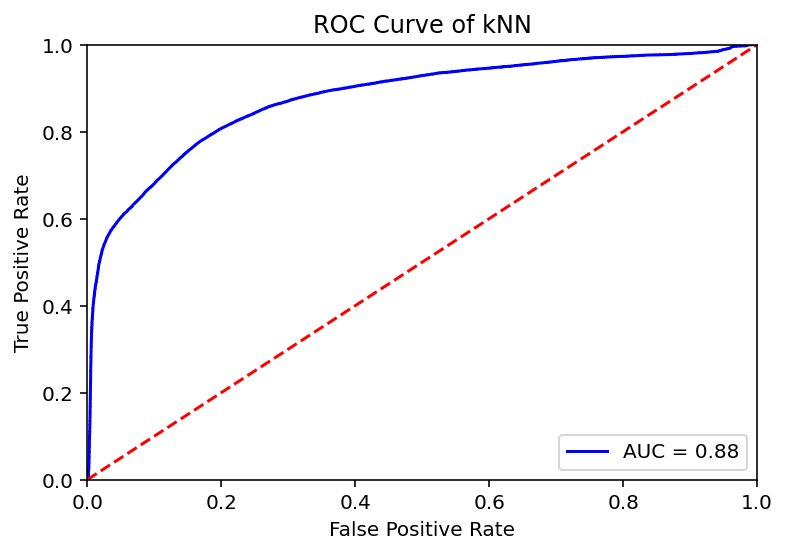

Model accuracy score: 0.7845
Training-set accuracy score: 0.7804
Confusion matrix

 [[12700   726]
 [ 3583  2991]]

True Positives(TP) =  12700

True Negatives(TN) =  2991

False Positives(FP) =  726

False Negatives(FN) =  3583


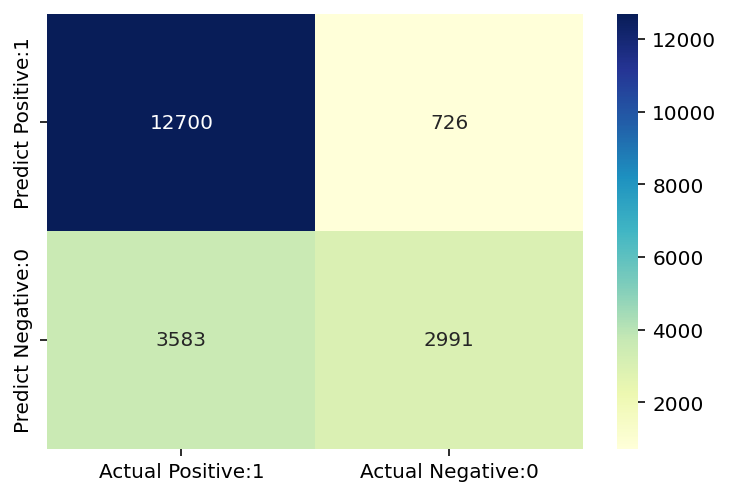

              precision    recall  f1-score   support

           0       0.78      0.95      0.85     13426
           1       0.80      0.45      0.58      6574

    accuracy                           0.78     20000
   macro avg       0.79      0.70      0.72     20000
weighted avg       0.79      0.78      0.77     20000

Classification accuracy : 0.7845


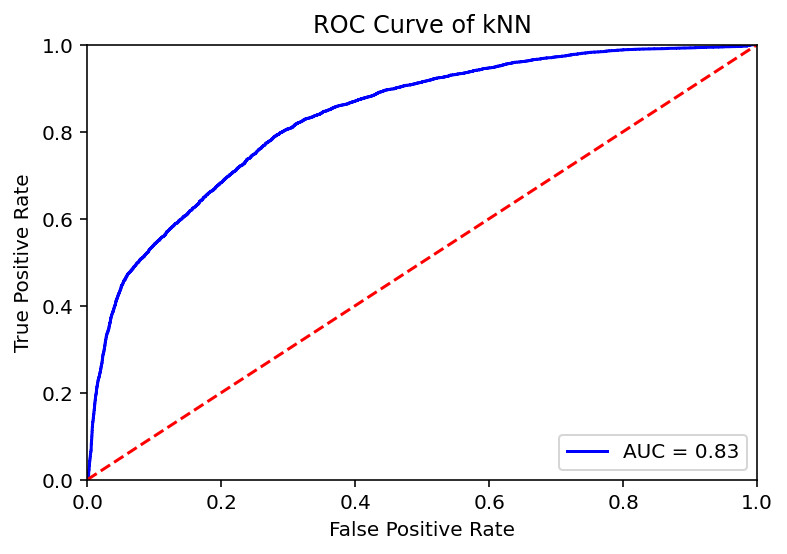

Model accuracy score: 0.8336
Training-set accuracy score: 0.8327
Confusion matrix

 [[64360  2252]
 [14390 18998]]

True Positives(TP) =  64360

True Negatives(TN) =  18998

False Positives(FP) =  2252

False Negatives(FN) =  14390


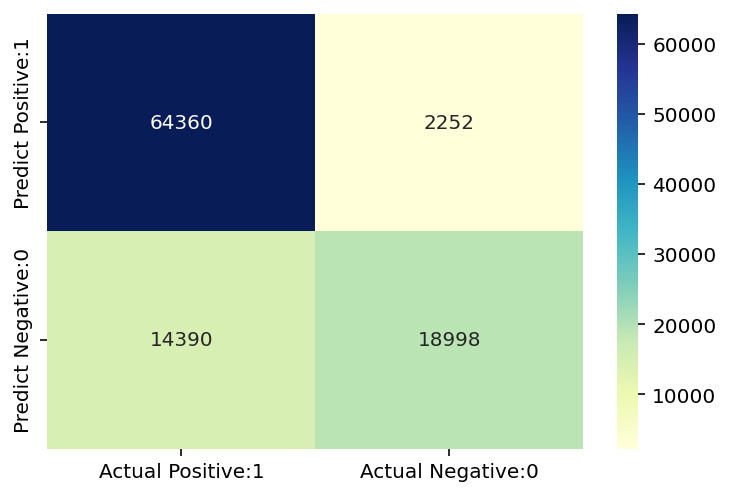

              precision    recall  f1-score   support

           0       0.82      0.97      0.89     66612
           1       0.89      0.57      0.70     33388

    accuracy                           0.83    100000
   macro avg       0.86      0.77      0.79    100000
weighted avg       0.84      0.83      0.82    100000

Classification accuracy : 0.8336


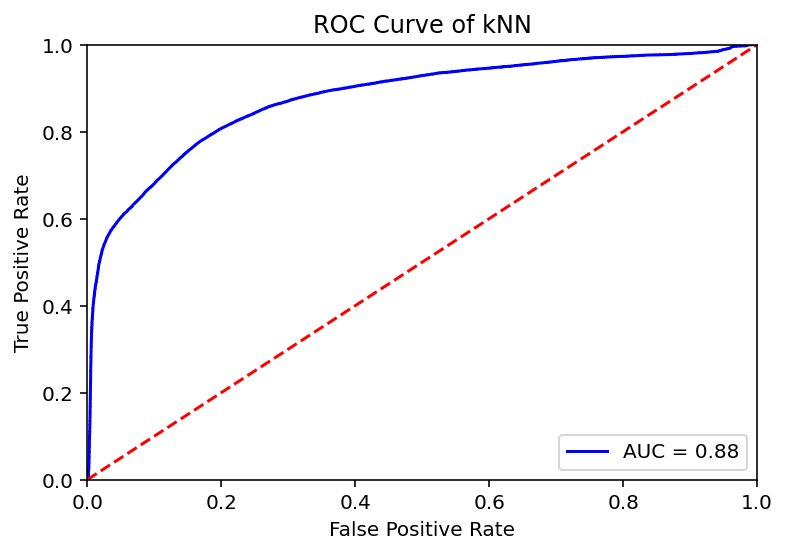

Model accuracy score: 0.8361
Training-set accuracy score: 0.8372
Confusion matrix

 [[128299   4946]
 [ 27837  38918]]

True Positives(TP) =  128299

True Negatives(TN) =  38918

False Positives(FP) =  4946

False Negatives(FN) =  27837


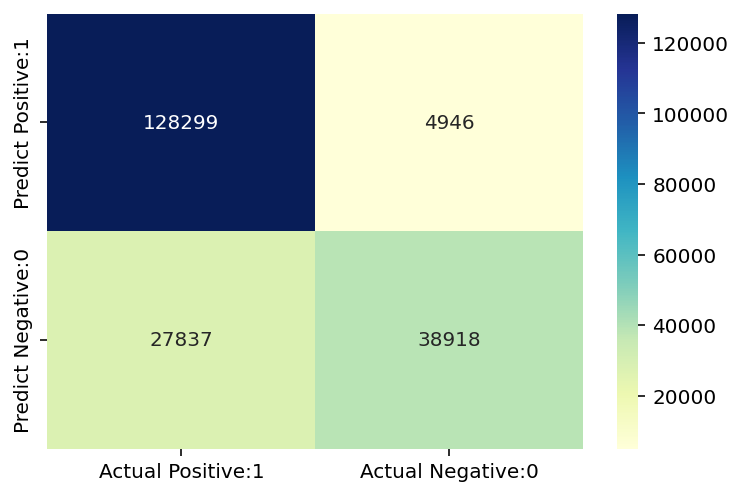

              precision    recall  f1-score   support

           0       0.82      0.96      0.89    133245
           1       0.89      0.58      0.70     66755

    accuracy                           0.84    200000
   macro avg       0.85      0.77      0.80    200000
weighted avg       0.84      0.84      0.83    200000

Classification accuracy : 0.8361


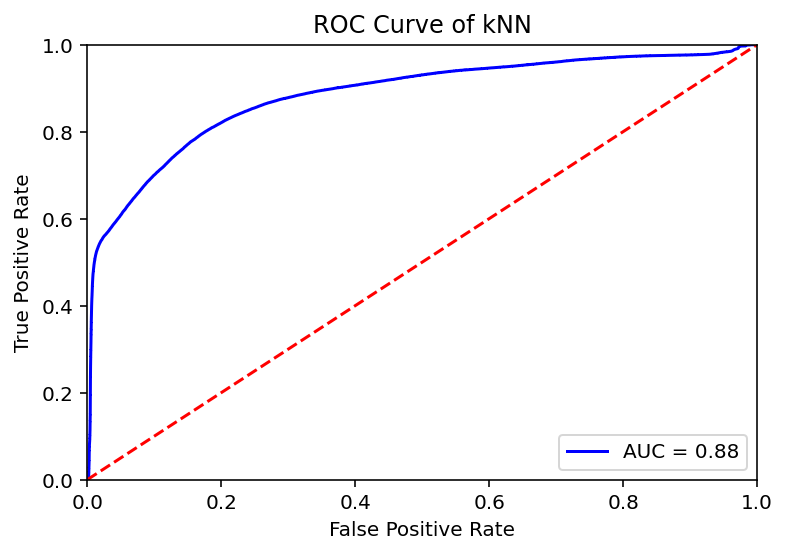

In [ ]:
for i in range(len(model_datas)):
  df = model_datas[i]

  X = df.drop(['is_attributed'], axis=1)
  y = df['is_attributed']

  columns = X.columns

  pca = PCA(n_components=5)
  X = pca.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = pd.DataFrame(scaler.fit_transform(X_train))
  X_test = pd.DataFrame(scaler.transform(X_test))
  
  y_pred , y_pred_probab = lgstc_Reg(X_train , X_test , y_train, y_test)
  evalute_mode(y_pred , y_pred_probab ,y_test)

Model accuracy score: 0.7845
Training-set accuracy score: 0.7804
Confusion matrix

 [[12700   726]
 [ 3583  2991]]

True Positives(TP) =  12700

True Negatives(TN) =  2991

False Positives(FP) =  726

False Negatives(FN) =  3583


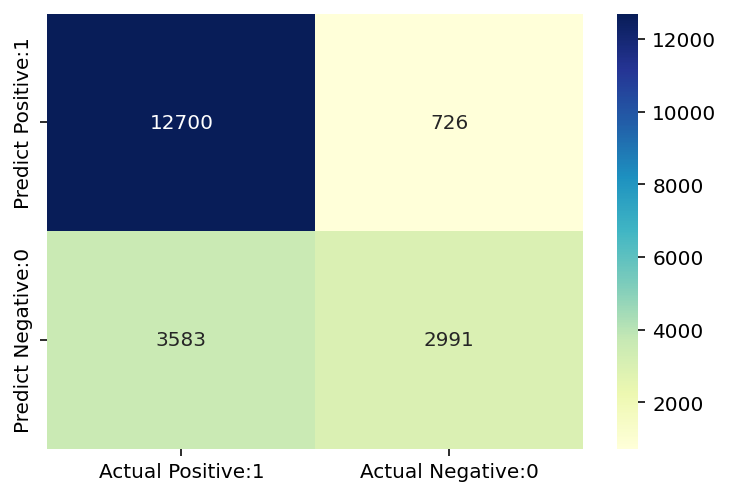

              precision    recall  f1-score   support

           0       0.78      0.95      0.85     13426
           1       0.80      0.45      0.58      6574

    accuracy                           0.78     20000
   macro avg       0.79      0.70      0.72     20000
weighted avg       0.79      0.78      0.77     20000

Classification accuracy : 0.7845


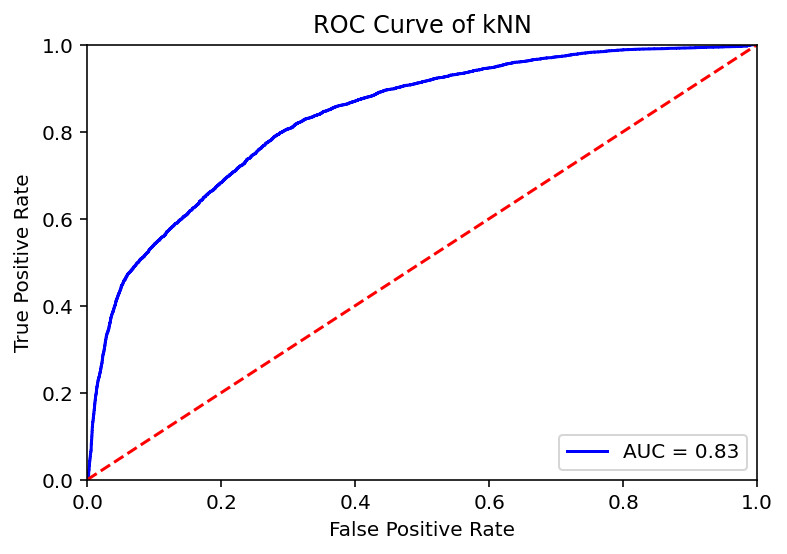

Model accuracy score: 0.8336
Training-set accuracy score: 0.8327
Confusion matrix

 [[64360  2252]
 [14390 18998]]

True Positives(TP) =  64360

True Negatives(TN) =  18998

False Positives(FP) =  2252

False Negatives(FN) =  14390


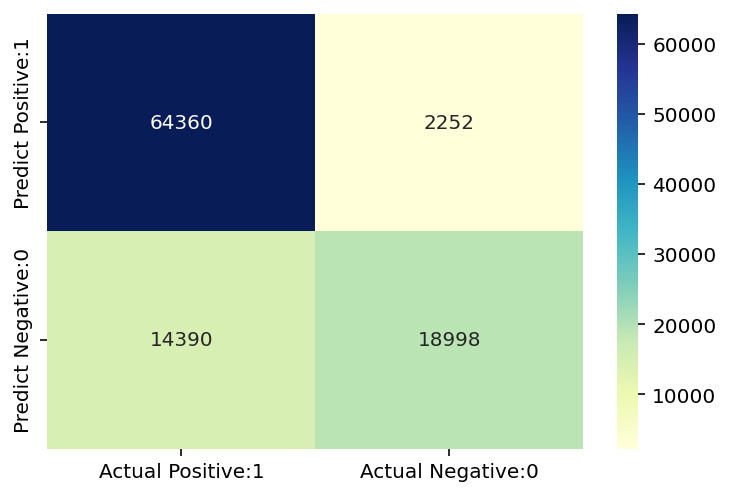

              precision    recall  f1-score   support

           0       0.82      0.97      0.89     66612
           1       0.89      0.57      0.70     33388

    accuracy                           0.83    100000
   macro avg       0.86      0.77      0.79    100000
weighted avg       0.84      0.83      0.82    100000

Classification accuracy : 0.8336


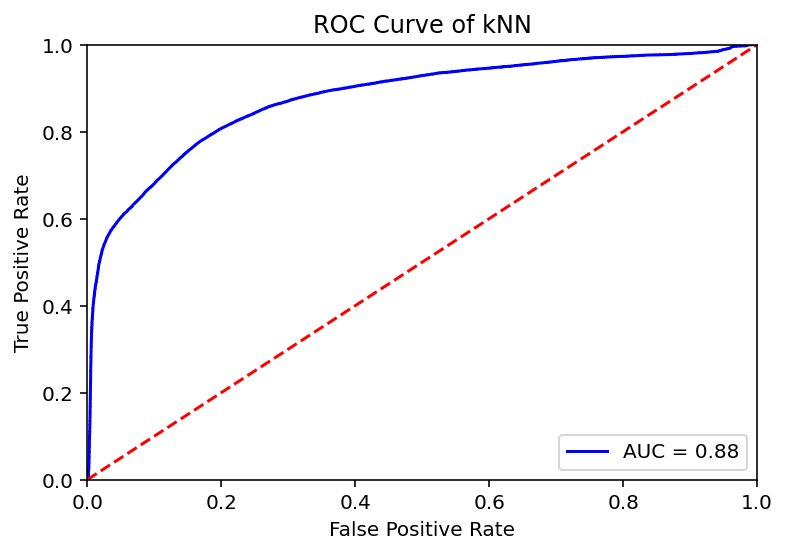

Model accuracy score: 0.7845
Training-set accuracy score: 0.7804
Confusion matrix

 [[12700   726]
 [ 3583  2991]]

True Positives(TP) =  12700

True Negatives(TN) =  2991

False Positives(FP) =  726

False Negatives(FN) =  3583


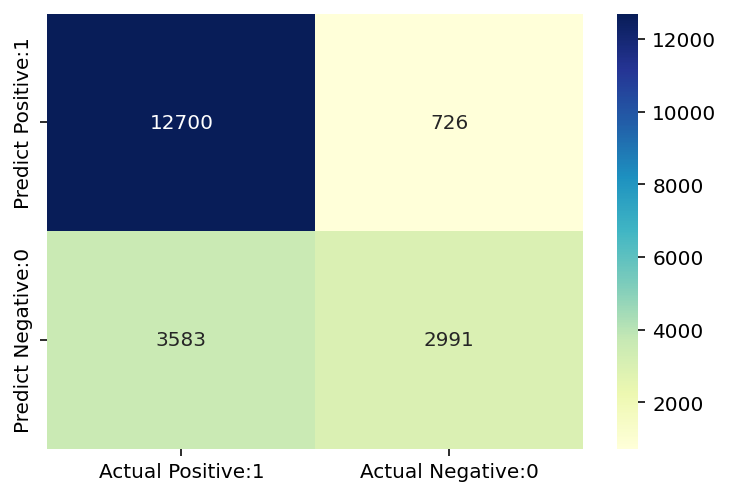

              precision    recall  f1-score   support

           0       0.78      0.95      0.85     13426
           1       0.80      0.45      0.58      6574

    accuracy                           0.78     20000
   macro avg       0.79      0.70      0.72     20000
weighted avg       0.79      0.78      0.77     20000

Classification accuracy : 0.7845


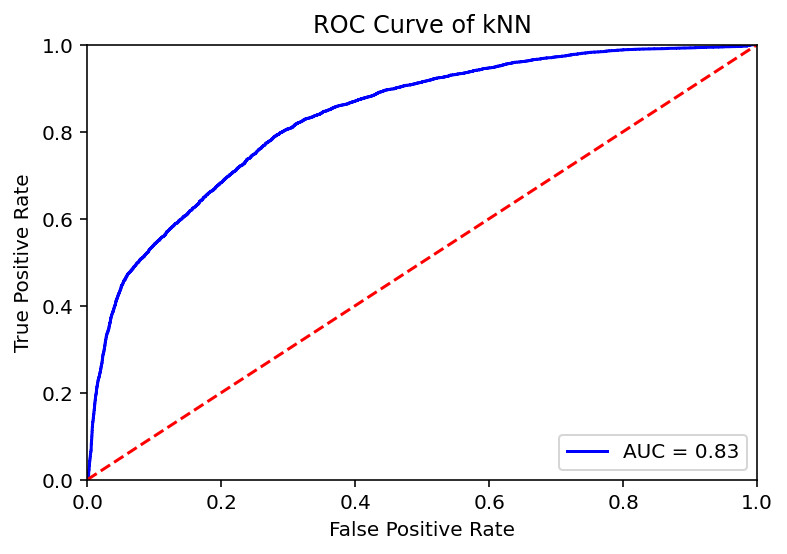

Model accuracy score: 0.8336
Training-set accuracy score: 0.8327
Confusion matrix

 [[64360  2252]
 [14390 18998]]

True Positives(TP) =  64360

True Negatives(TN) =  18998

False Positives(FP) =  2252

False Negatives(FN) =  14390


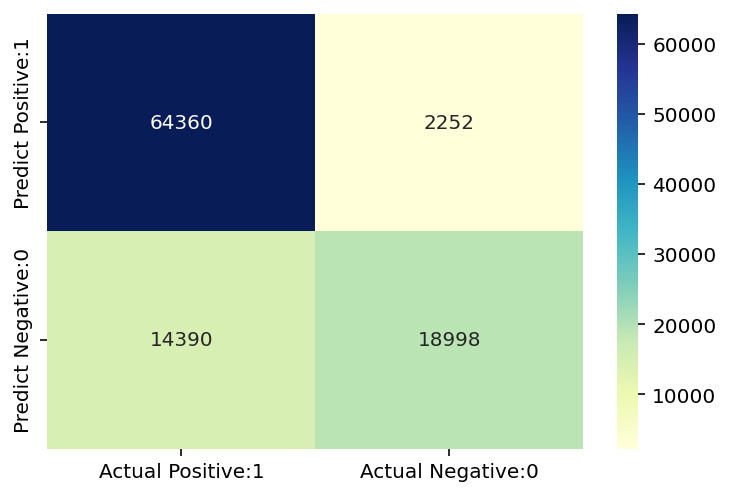

              precision    recall  f1-score   support

           0       0.82      0.97      0.89     66612
           1       0.89      0.57      0.70     33388

    accuracy                           0.83    100000
   macro avg       0.86      0.77      0.79    100000
weighted avg       0.84      0.83      0.82    100000

Classification accuracy : 0.8336


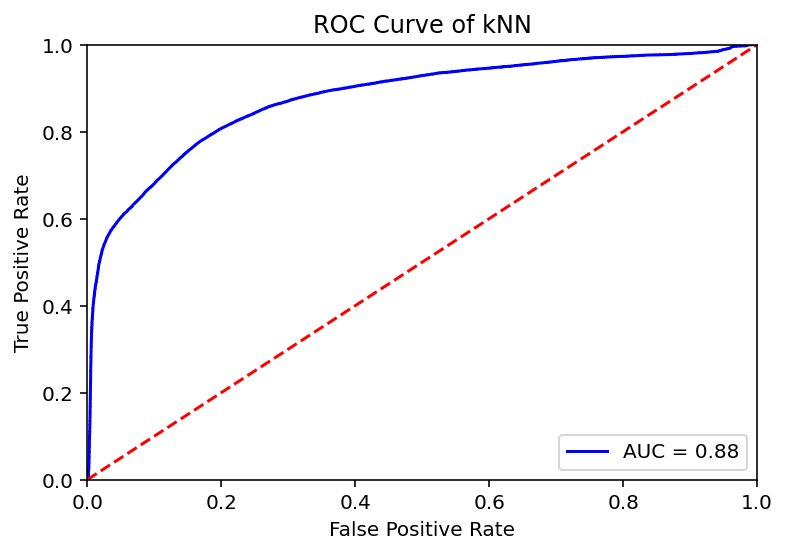

Model accuracy score: 0.8361
Training-set accuracy score: 0.8372
Confusion matrix

 [[128299   4946]
 [ 27837  38918]]

True Positives(TP) =  128299

True Negatives(TN) =  38918

False Positives(FP) =  4946

False Negatives(FN) =  27837


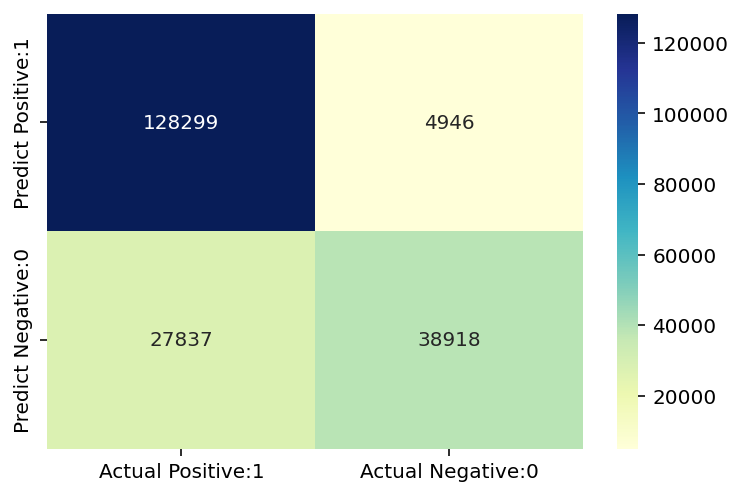

              precision    recall  f1-score   support

           0       0.82      0.96      0.89    133245
           1       0.89      0.58      0.70     66755

    accuracy                           0.84    200000
   macro avg       0.85      0.77      0.80    200000
weighted avg       0.84      0.84      0.83    200000

Classification accuracy : 0.8361


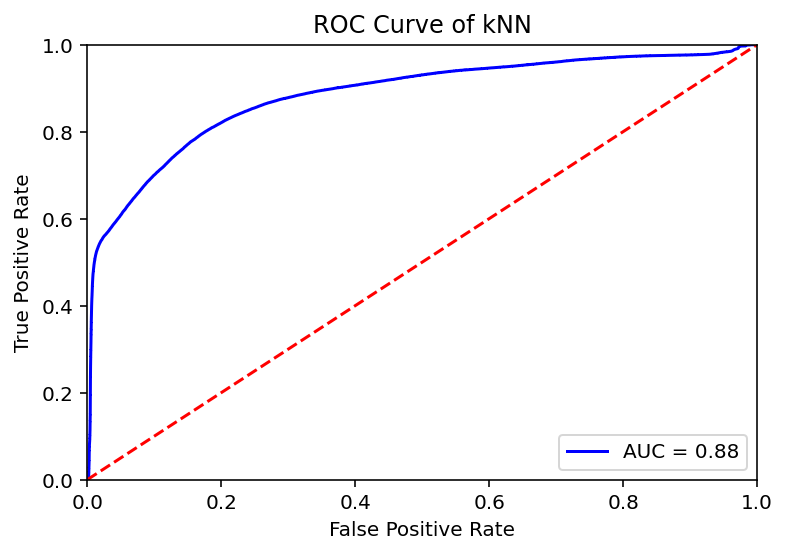

In [ ]:
for i in range(len(model_datas)):
  df = model_datas[i]

  X = df.drop(['is_attributed'], axis=1)
  y = df['is_attributed']

  columns = X.columns

  pca = PCA(n_components=5)
  X = pca.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = pd.DataFrame(scaler.fit_transform(X_train))
  X_test = pd.DataFrame(scaler.transform(X_test))
  
  y_pred , y_pred_probab = lgstc_Reg(X_train , X_test , y_train, y_test)
  evalute_mode(y_pred , y_pred_probab ,y_test)

Model accuracy score: 0.7845
Training-set accuracy score: 0.7804
Confusion matrix

 [[12700   726]
 [ 3583  2991]]

True Positives(TP) =  12700

True Negatives(TN) =  2991

False Positives(FP) =  726

False Negatives(FN) =  3583


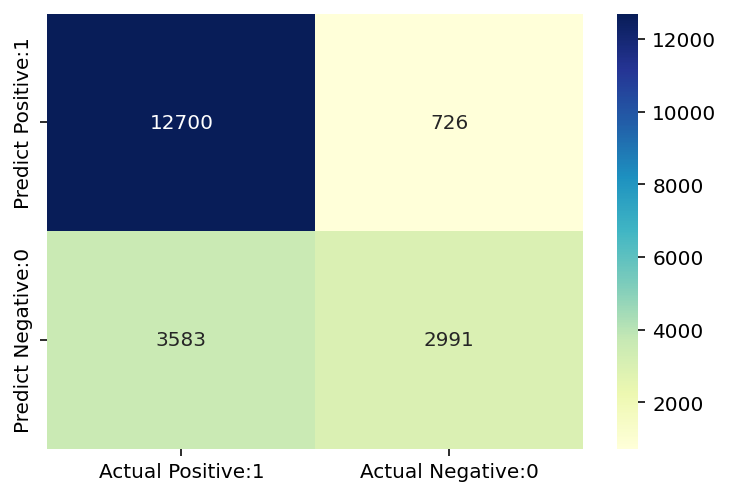

              precision    recall  f1-score   support

           0       0.78      0.95      0.85     13426
           1       0.80      0.45      0.58      6574

    accuracy                           0.78     20000
   macro avg       0.79      0.70      0.72     20000
weighted avg       0.79      0.78      0.77     20000

Classification accuracy : 0.7845


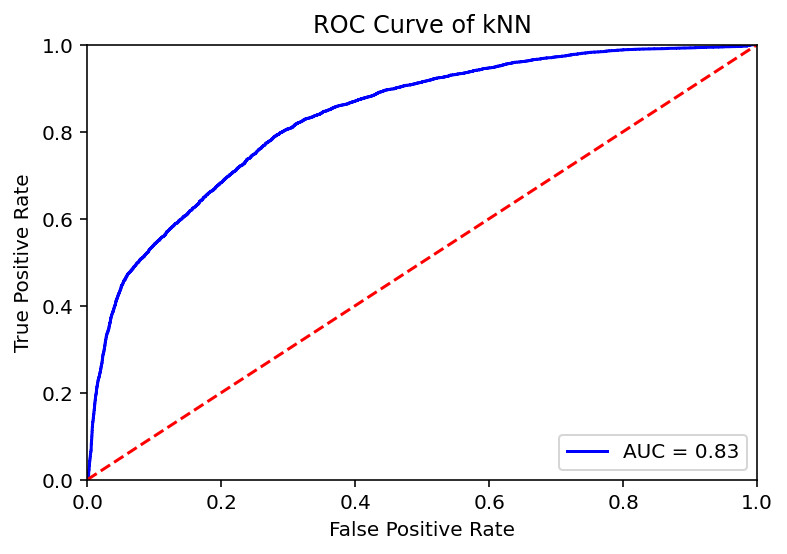

Model accuracy score: 0.8336
Training-set accuracy score: 0.8327
Confusion matrix

 [[64360  2252]
 [14390 18998]]

True Positives(TP) =  64360

True Negatives(TN) =  18998

False Positives(FP) =  2252

False Negatives(FN) =  14390


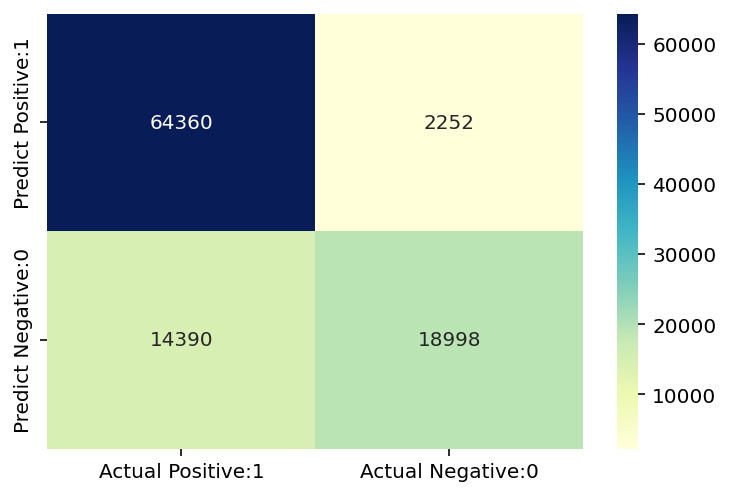

              precision    recall  f1-score   support

           0       0.82      0.97      0.89     66612
           1       0.89      0.57      0.70     33388

    accuracy                           0.83    100000
   macro avg       0.86      0.77      0.79    100000
weighted avg       0.84      0.83      0.82    100000

Classification accuracy : 0.8336


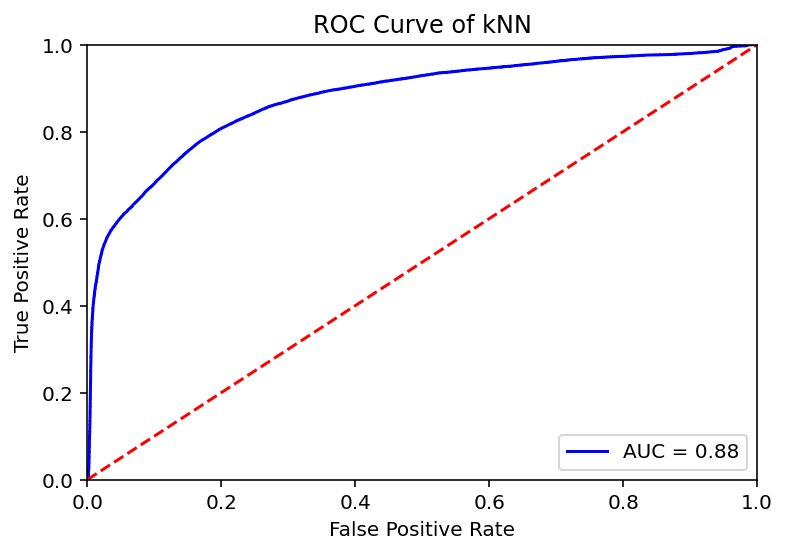

Model accuracy score: 0.7845
Training-set accuracy score: 0.7804
Confusion matrix

 [[12700   726]
 [ 3583  2991]]

True Positives(TP) =  12700

True Negatives(TN) =  2991

False Positives(FP) =  726

False Negatives(FN) =  3583


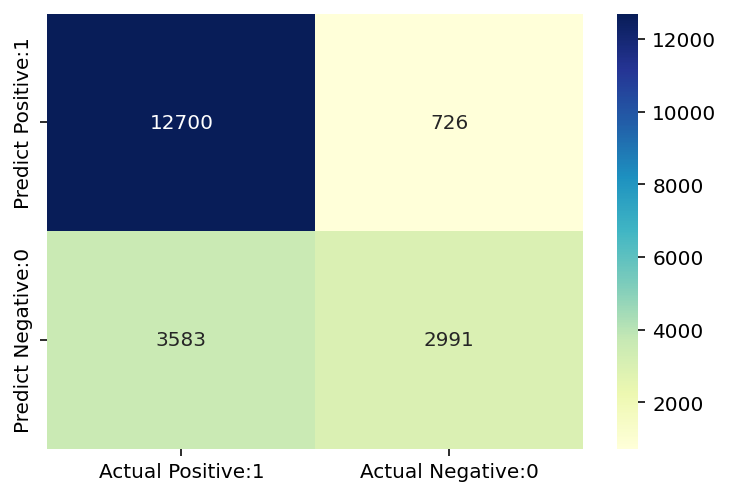

              precision    recall  f1-score   support

           0       0.78      0.95      0.85     13426
           1       0.80      0.45      0.58      6574

    accuracy                           0.78     20000
   macro avg       0.79      0.70      0.72     20000
weighted avg       0.79      0.78      0.77     20000

Classification accuracy : 0.7845


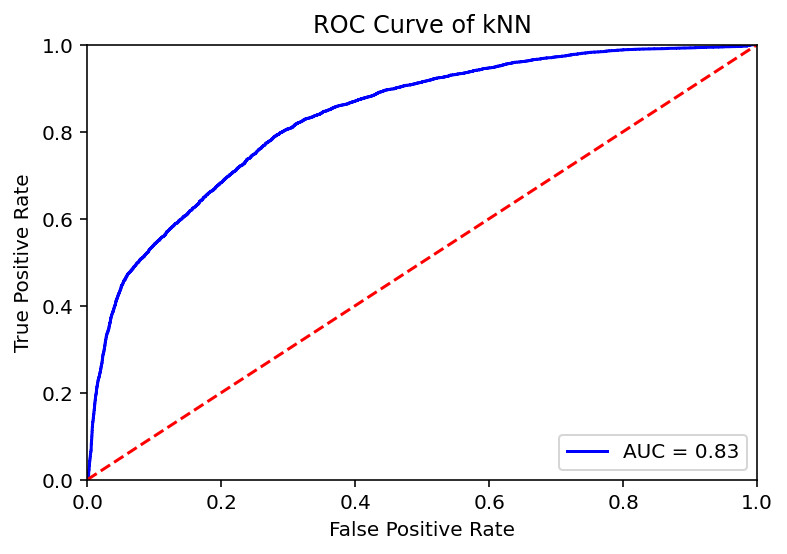

Model accuracy score: 0.8336
Training-set accuracy score: 0.8327
Confusion matrix

 [[64360  2252]
 [14390 18998]]

True Positives(TP) =  64360

True Negatives(TN) =  18998

False Positives(FP) =  2252

False Negatives(FN) =  14390


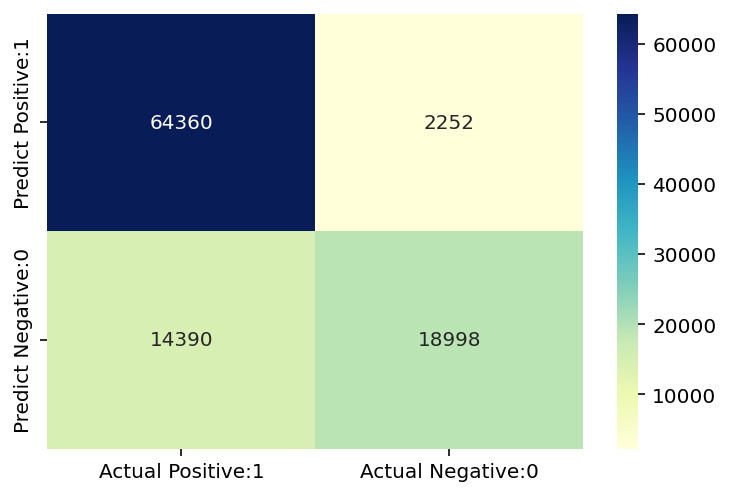

              precision    recall  f1-score   support

           0       0.82      0.97      0.89     66612
           1       0.89      0.57      0.70     33388

    accuracy                           0.83    100000
   macro avg       0.86      0.77      0.79    100000
weighted avg       0.84      0.83      0.82    100000

Classification accuracy : 0.8336


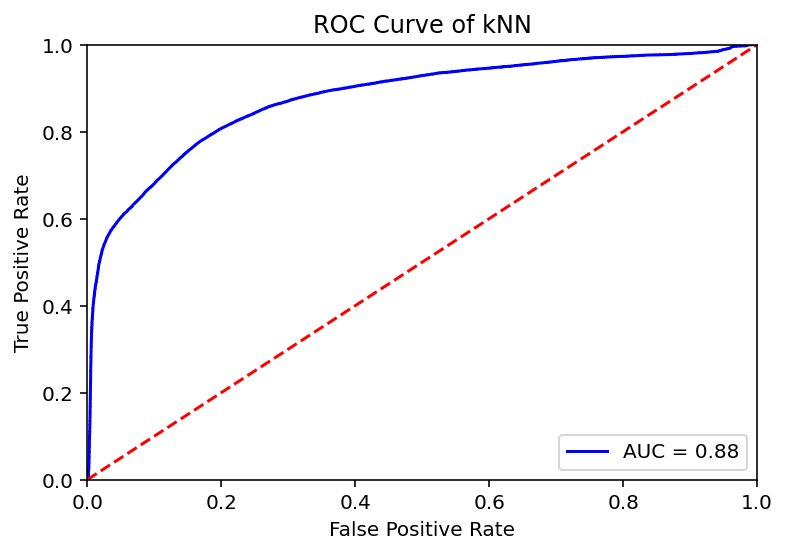

Model accuracy score: 0.8361
Training-set accuracy score: 0.8372
Confusion matrix

 [[128299   4946]
 [ 27837  38918]]

True Positives(TP) =  128299

True Negatives(TN) =  38918

False Positives(FP) =  4946

False Negatives(FN) =  27837


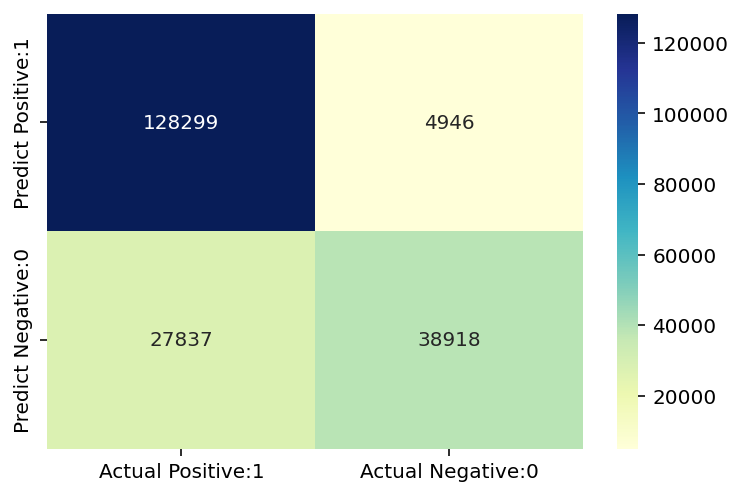

              precision    recall  f1-score   support

           0       0.82      0.96      0.89    133245
           1       0.89      0.58      0.70     66755

    accuracy                           0.84    200000
   macro avg       0.85      0.77      0.80    200000
weighted avg       0.84      0.84      0.83    200000

Classification accuracy : 0.8361


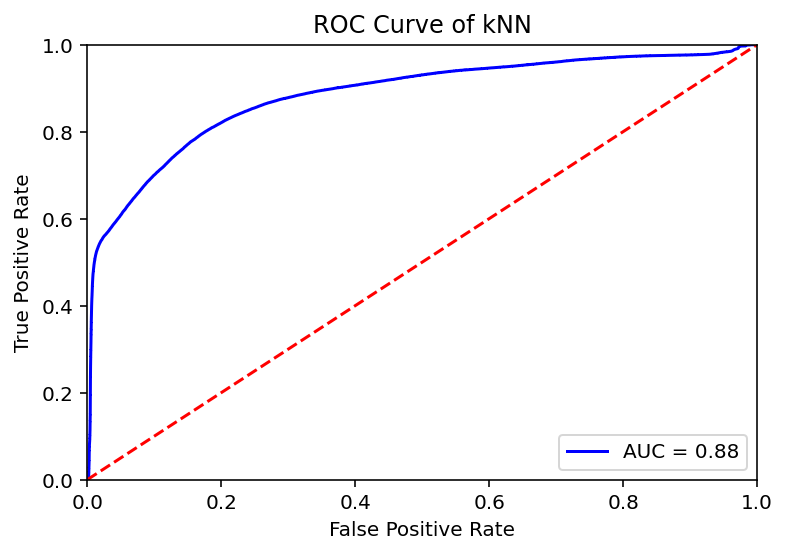

Model accuracy score: 0.8471
Training-set accuracy score: 0.8467
Confusion matrix

 [[383237  16988]
 [ 74767 125008]]

True Positives(TP) =  383237

True Negatives(TN) =  125008

False Positives(FP) =  16988

False Negatives(FN) =  74767


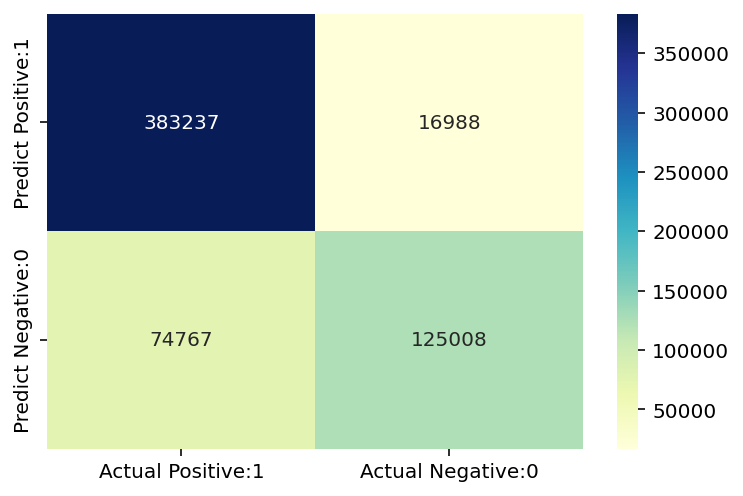

              precision    recall  f1-score   support

           0       0.84      0.96      0.89    400225
           1       0.88      0.63      0.73    199775

    accuracy                           0.85    600000
   macro avg       0.86      0.79      0.81    600000
weighted avg       0.85      0.85      0.84    600000

Classification accuracy : 0.8471


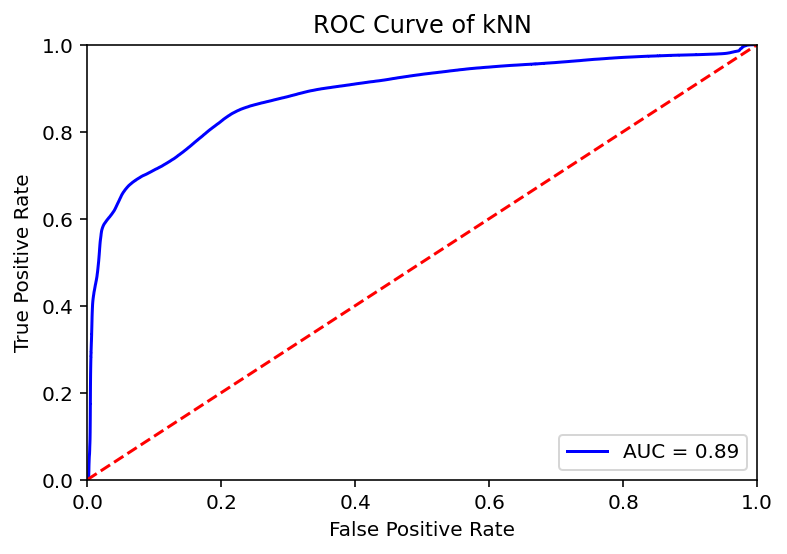

Model accuracy score: 0.8533
Training-set accuracy score: 0.8532
Confusion matrix

 [[763602  36502]
 [139493 260403]]

True Positives(TP) =  763602

True Negatives(TN) =  260403

False Positives(FP) =  36502

False Negatives(FN) =  139493


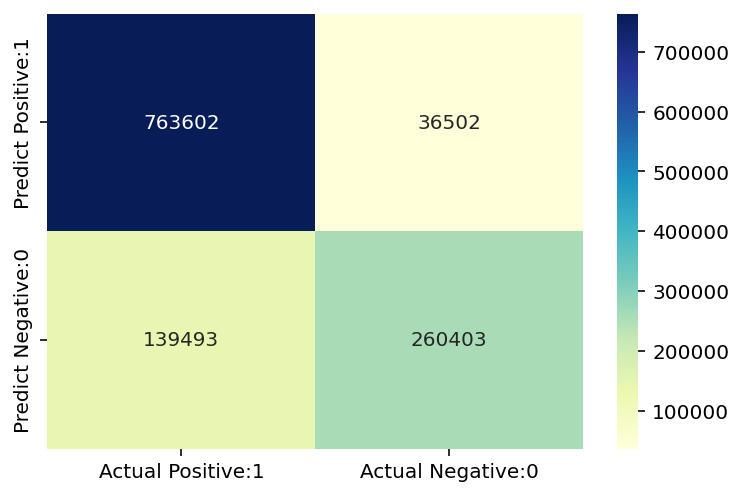

              precision    recall  f1-score   support

           0       0.85      0.95      0.90    800104
           1       0.88      0.65      0.75    399896

    accuracy                           0.85   1200000
   macro avg       0.86      0.80      0.82   1200000
weighted avg       0.86      0.85      0.85   1200000

Classification accuracy : 0.8533


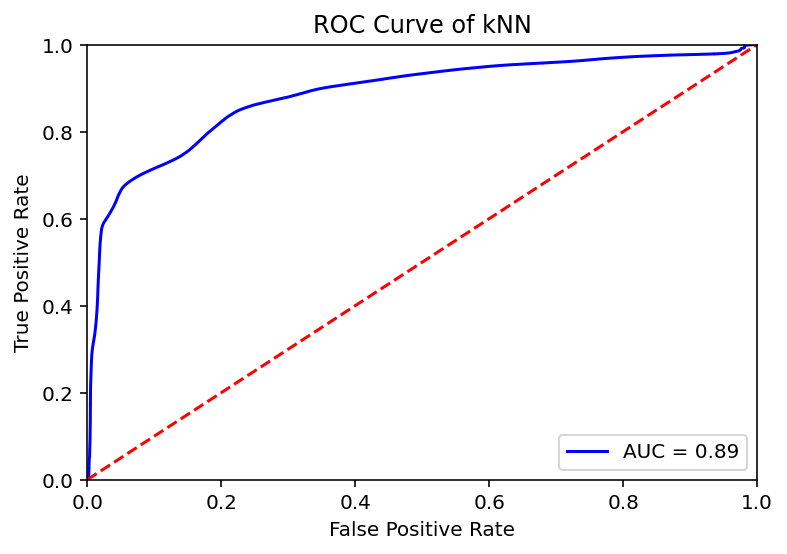

In [ ]:
for i in range(len(model_datas)):
  df = model_datas[i]

  X = df.drop(['is_attributed'], axis=1)
  y = df['is_attributed']

  columns = X.columns

  pca = PCA(n_components=5)
  X = pca.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = pd.DataFrame(scaler.fit_transform(X_train))
  X_test = pd.DataFrame(scaler.transform(X_test))
  
  y_pred , y_pred_probab = lgstc_Reg(X_train , X_test , y_train, y_test)
  evalute_mode(y_pred , y_pred_probab ,y_test)

Model accuracy score: 0.7845
Training-set accuracy score: 0.7804
Confusion matrix

 [[12700   726]
 [ 3583  2991]]

True Positives(TP) =  12700

True Negatives(TN) =  2991

False Positives(FP) =  726

False Negatives(FN) =  3583


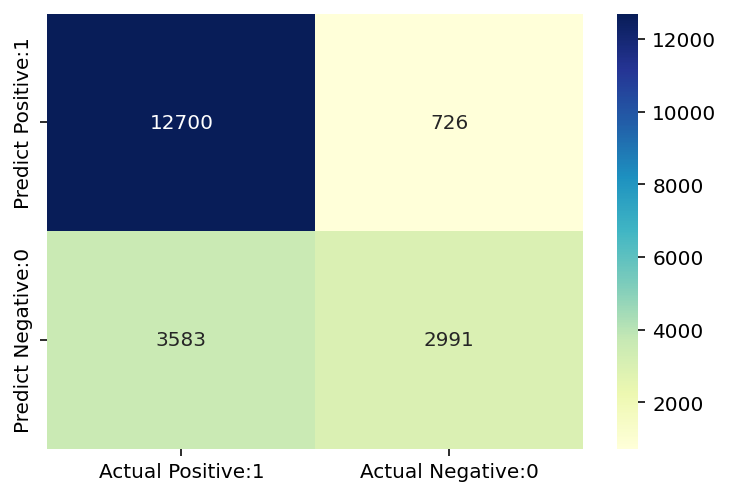

              precision    recall  f1-score   support

           0       0.78      0.95      0.85     13426
           1       0.80      0.45      0.58      6574

    accuracy                           0.78     20000
   macro avg       0.79      0.70      0.72     20000
weighted avg       0.79      0.78      0.77     20000

Classification accuracy : 0.7845


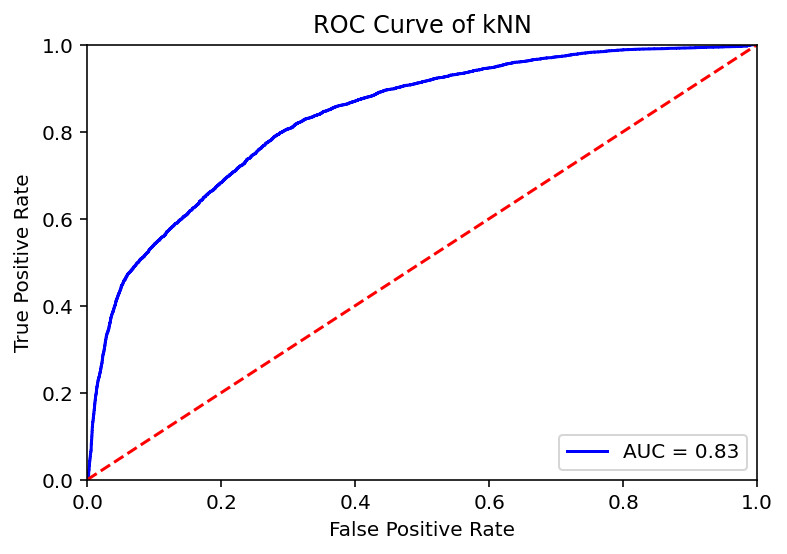

Model accuracy score: 0.8336
Training-set accuracy score: 0.8327
Confusion matrix

 [[64360  2252]
 [14390 18998]]

True Positives(TP) =  64360

True Negatives(TN) =  18998

False Positives(FP) =  2252

False Negatives(FN) =  14390


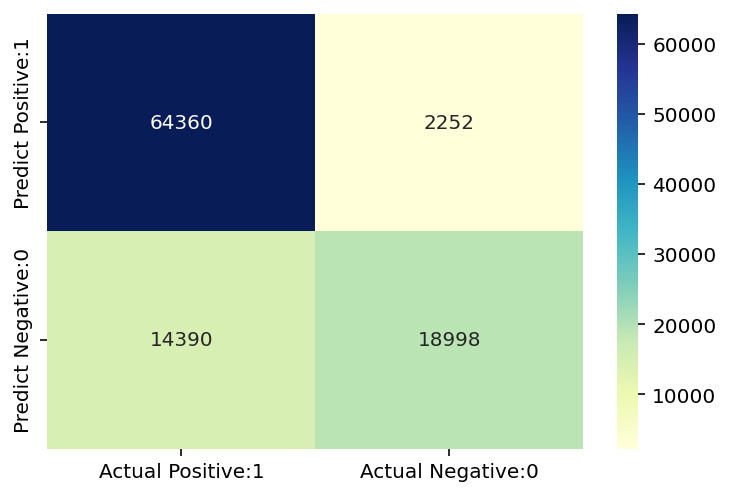

              precision    recall  f1-score   support

           0       0.82      0.97      0.89     66612
           1       0.89      0.57      0.70     33388

    accuracy                           0.83    100000
   macro avg       0.86      0.77      0.79    100000
weighted avg       0.84      0.83      0.82    100000

Classification accuracy : 0.8336


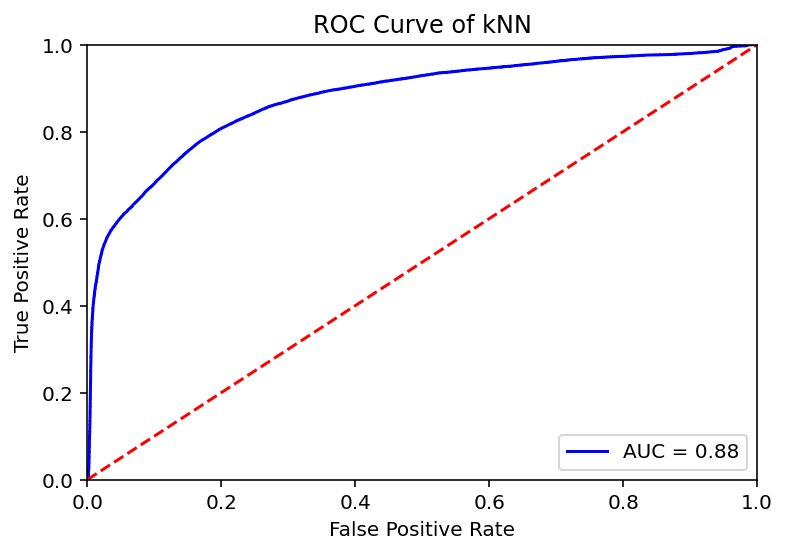

Model accuracy score: 0.7845
Training-set accuracy score: 0.7804
Confusion matrix

 [[12700   726]
 [ 3583  2991]]

True Positives(TP) =  12700

True Negatives(TN) =  2991

False Positives(FP) =  726

False Negatives(FN) =  3583


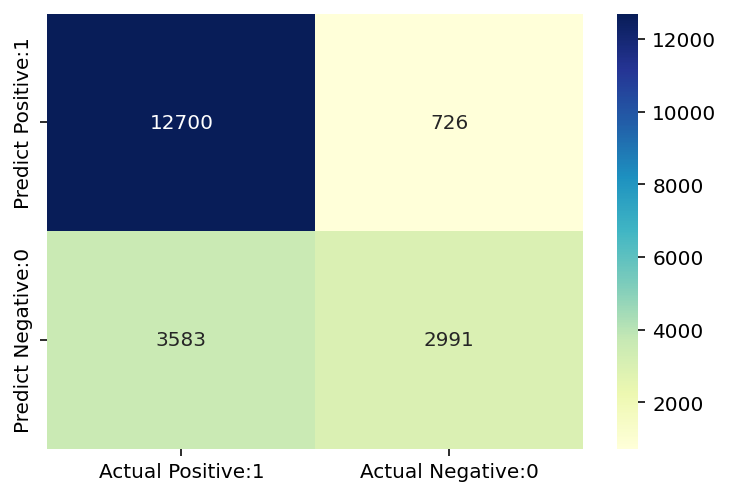

              precision    recall  f1-score   support

           0       0.78      0.95      0.85     13426
           1       0.80      0.45      0.58      6574

    accuracy                           0.78     20000
   macro avg       0.79      0.70      0.72     20000
weighted avg       0.79      0.78      0.77     20000

Classification accuracy : 0.7845


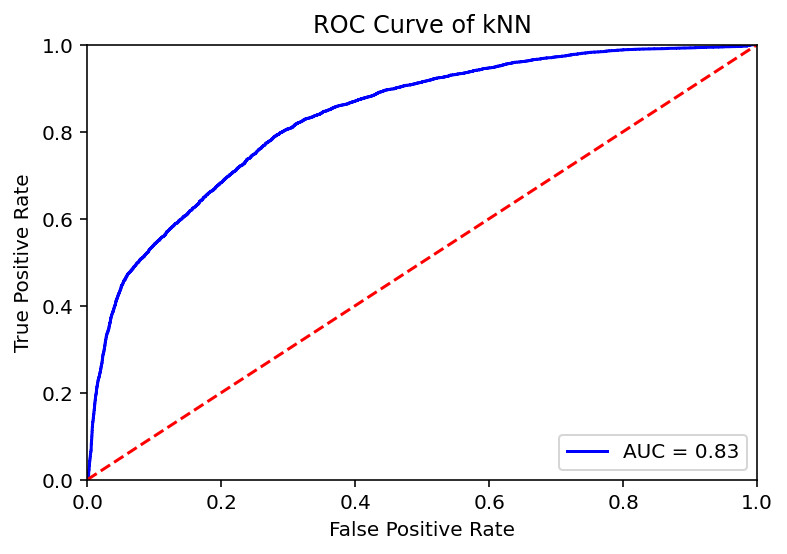

Model accuracy score: 0.8336
Training-set accuracy score: 0.8327
Confusion matrix

 [[64360  2252]
 [14390 18998]]

True Positives(TP) =  64360

True Negatives(TN) =  18998

False Positives(FP) =  2252

False Negatives(FN) =  14390


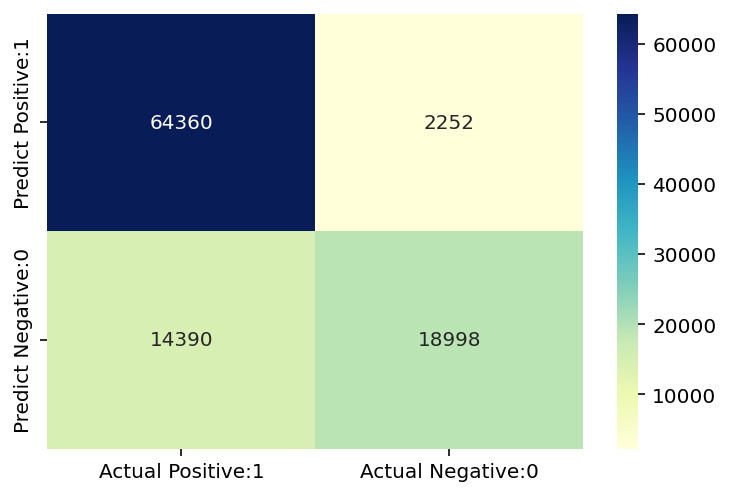

              precision    recall  f1-score   support

           0       0.82      0.97      0.89     66612
           1       0.89      0.57      0.70     33388

    accuracy                           0.83    100000
   macro avg       0.86      0.77      0.79    100000
weighted avg       0.84      0.83      0.82    100000

Classification accuracy : 0.8336


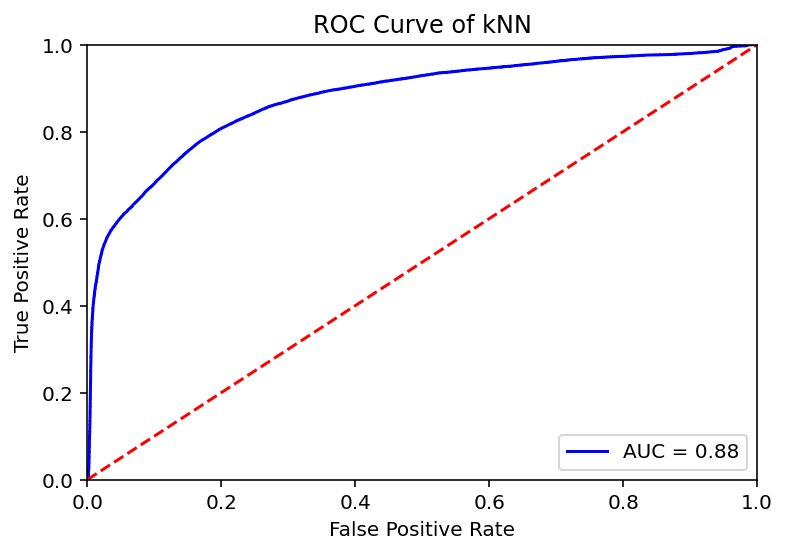

Model accuracy score: 0.8361
Training-set accuracy score: 0.8372
Confusion matrix

 [[128299   4946]
 [ 27837  38918]]

True Positives(TP) =  128299

True Negatives(TN) =  38918

False Positives(FP) =  4946

False Negatives(FN) =  27837


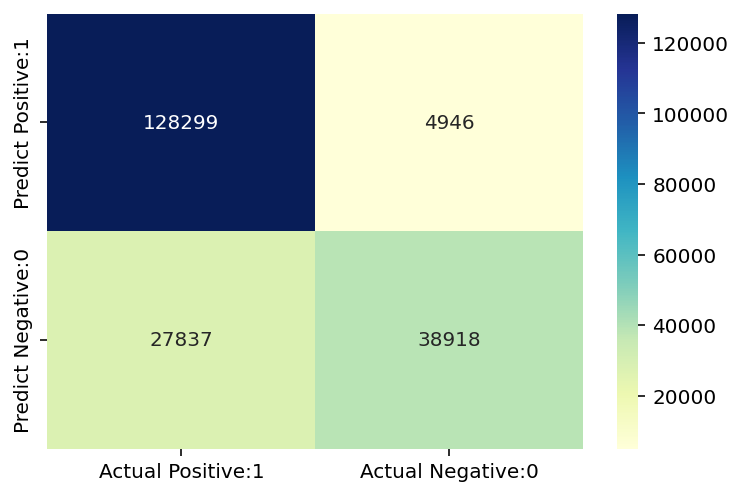

              precision    recall  f1-score   support

           0       0.82      0.96      0.89    133245
           1       0.89      0.58      0.70     66755

    accuracy                           0.84    200000
   macro avg       0.85      0.77      0.80    200000
weighted avg       0.84      0.84      0.83    200000

Classification accuracy : 0.8361


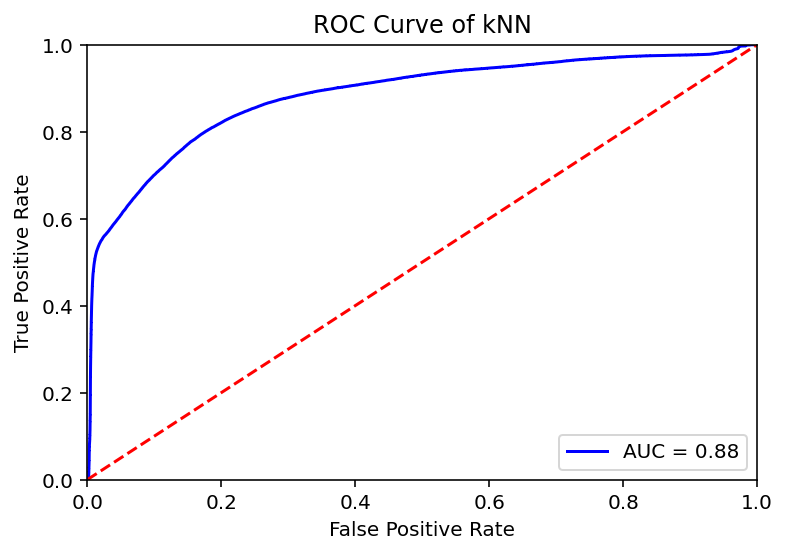

Model accuracy score: 0.8471
Training-set accuracy score: 0.8467
Confusion matrix

 [[383237  16988]
 [ 74767 125008]]

True Positives(TP) =  383237

True Negatives(TN) =  125008

False Positives(FP) =  16988

False Negatives(FN) =  74767


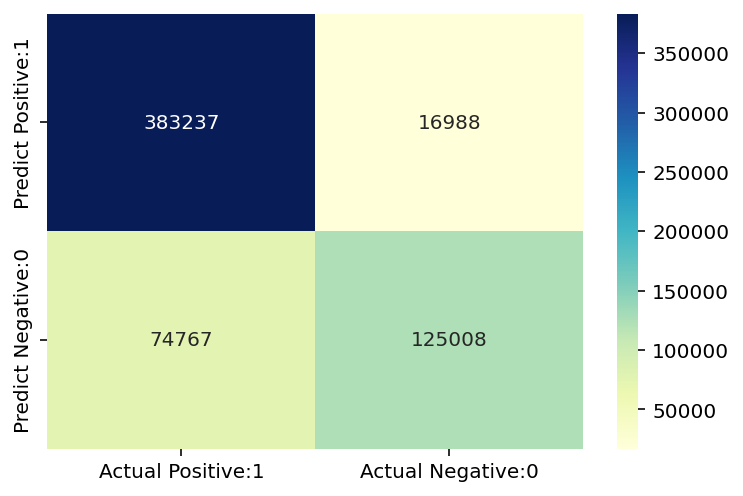

              precision    recall  f1-score   support

           0       0.84      0.96      0.89    400225
           1       0.88      0.63      0.73    199775

    accuracy                           0.85    600000
   macro avg       0.86      0.79      0.81    600000
weighted avg       0.85      0.85      0.84    600000

Classification accuracy : 0.8471


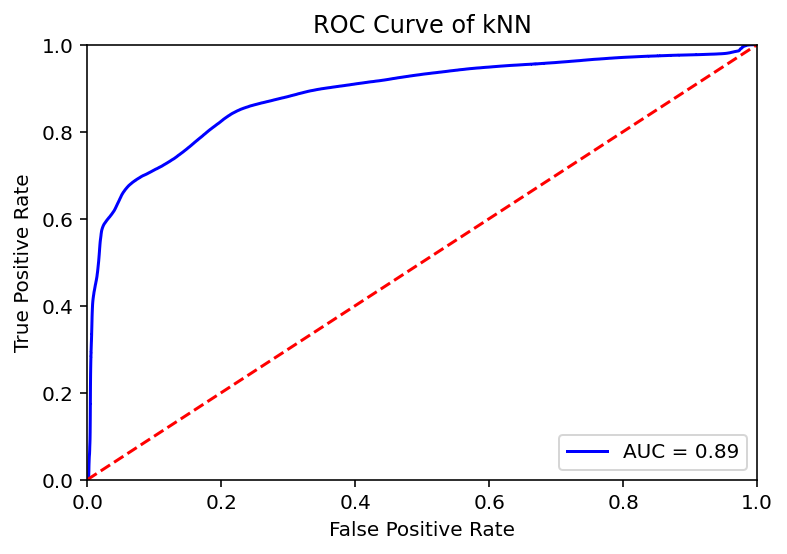

Model accuracy score: 0.7726
Training-set accuracy score: 0.7725
Confusion matrix

 [[728786  71318]
 [201588 198308]]

True Positives(TP) =  728786

True Negatives(TN) =  198308

False Positives(FP) =  71318

False Negatives(FN) =  201588


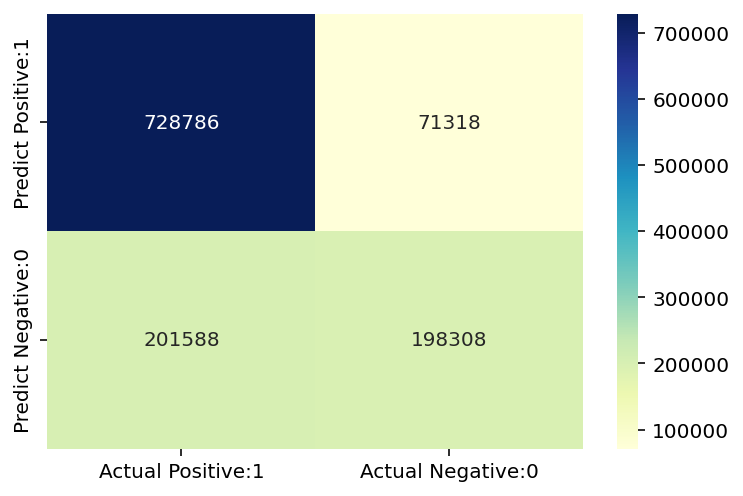

              precision    recall  f1-score   support

           0       0.78      0.91      0.84    800104
           1       0.74      0.50      0.59    399896

    accuracy                           0.77   1200000
   macro avg       0.76      0.70      0.72   1200000
weighted avg       0.77      0.77      0.76   1200000

Classification accuracy : 0.7726


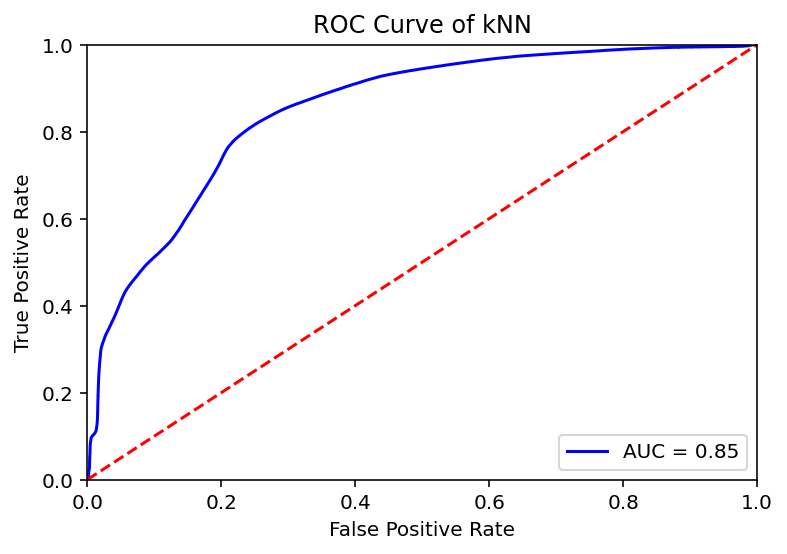

In [ ]:
# 4 variables becomes lable encoded
for i in range(len(model_datas)):
  df = model_datas[i]

  X = df.drop(['is_attributed'], axis=1)
  y = df['is_attributed']

  columns = X.columns

  pca = PCA(n_components=5)
  X = pca.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = pd.DataFrame(scaler.fit_transform(X_train))
  X_test = pd.DataFrame(scaler.transform(X_test))
  
  y_pred , y_pred_probab = lgstc_Reg(X_train , X_test , y_train, y_test)
  evalute_mode(y_pred , y_pred_probab ,y_test)

Model accuracy score: 0.8127
Training-set accuracy score: 0.8145
Confusion matrix

 [[11010  2416]
 [ 1329  5245]]

True Positives(TP) =  11010

True Negatives(TN) =  5245

False Positives(FP) =  2416

False Negatives(FN) =  1329


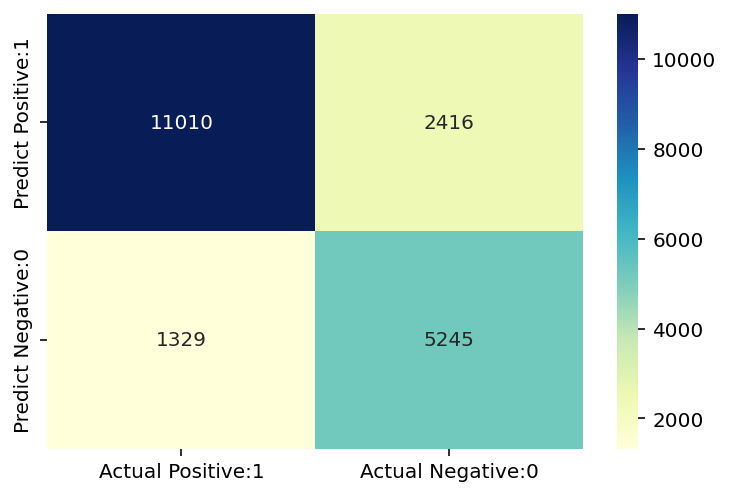

              precision    recall  f1-score   support

           0       0.89      0.82      0.85     13426
           1       0.68      0.80      0.74      6574

    accuracy                           0.81     20000
   macro avg       0.79      0.81      0.80     20000
weighted avg       0.82      0.81      0.82     20000

Classification accuracy : 0.8127


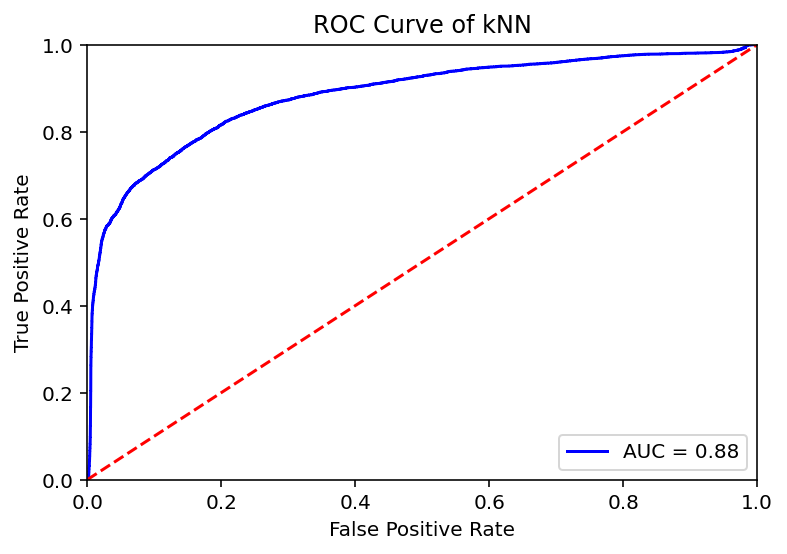

Model accuracy score: 0.8132
Training-set accuracy score: 0.8137
Confusion matrix

 [[54923 11689]
 [ 6995 26393]]

True Positives(TP) =  54923

True Negatives(TN) =  26393

False Positives(FP) =  11689

False Negatives(FN) =  6995


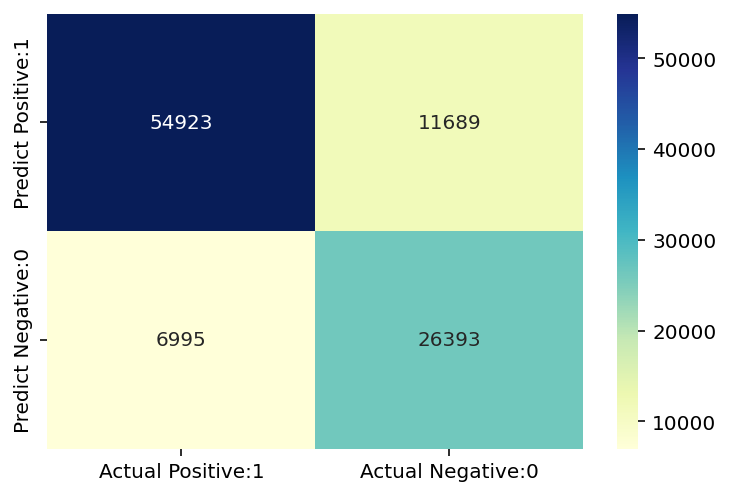

              precision    recall  f1-score   support

           0       0.89      0.82      0.85     66612
           1       0.69      0.79      0.74     33388

    accuracy                           0.81    100000
   macro avg       0.79      0.81      0.80    100000
weighted avg       0.82      0.81      0.82    100000

Classification accuracy : 0.8132


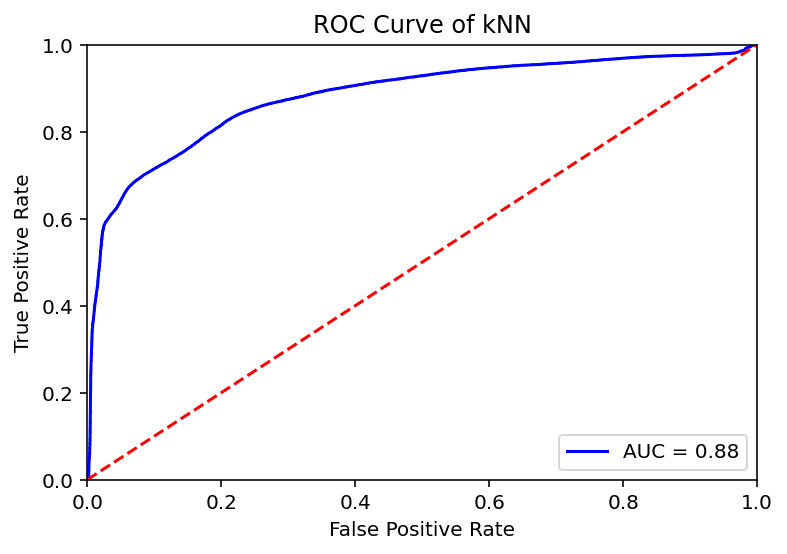

Model accuracy score: 0.8127
Training-set accuracy score: 0.8145
Confusion matrix

 [[11010  2416]
 [ 1329  5245]]

True Positives(TP) =  11010

True Negatives(TN) =  5245

False Positives(FP) =  2416

False Negatives(FN) =  1329


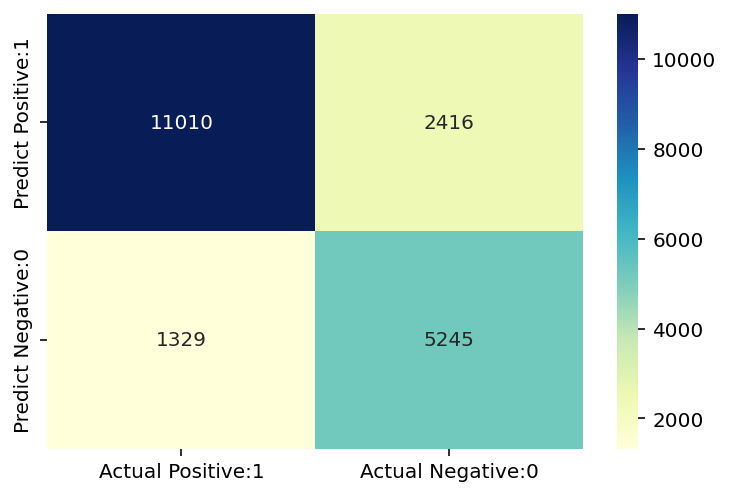

              precision    recall  f1-score   support

           0       0.89      0.82      0.85     13426
           1       0.68      0.80      0.74      6574

    accuracy                           0.81     20000
   macro avg       0.79      0.81      0.80     20000
weighted avg       0.82      0.81      0.82     20000

Classification accuracy : 0.8127


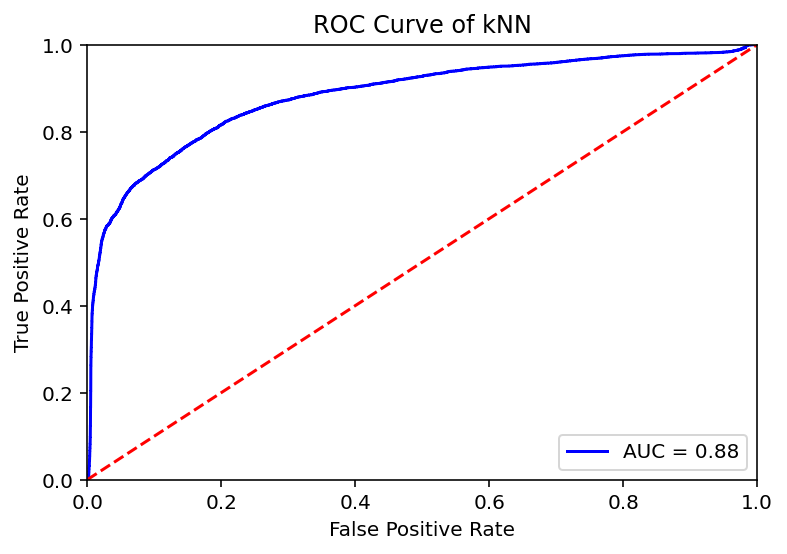

Model accuracy score: 0.8132
Training-set accuracy score: 0.8137
Confusion matrix

 [[54923 11689]
 [ 6995 26393]]

True Positives(TP) =  54923

True Negatives(TN) =  26393

False Positives(FP) =  11689

False Negatives(FN) =  6995


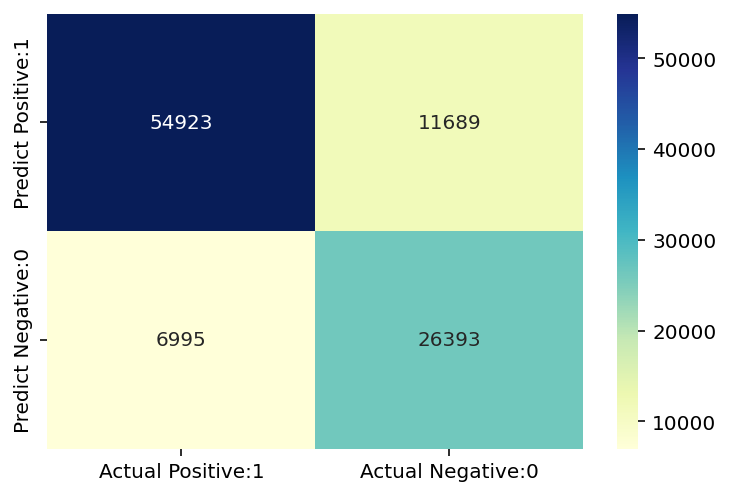

              precision    recall  f1-score   support

           0       0.89      0.82      0.85     66612
           1       0.69      0.79      0.74     33388

    accuracy                           0.81    100000
   macro avg       0.79      0.81      0.80    100000
weighted avg       0.82      0.81      0.82    100000

Classification accuracy : 0.8132


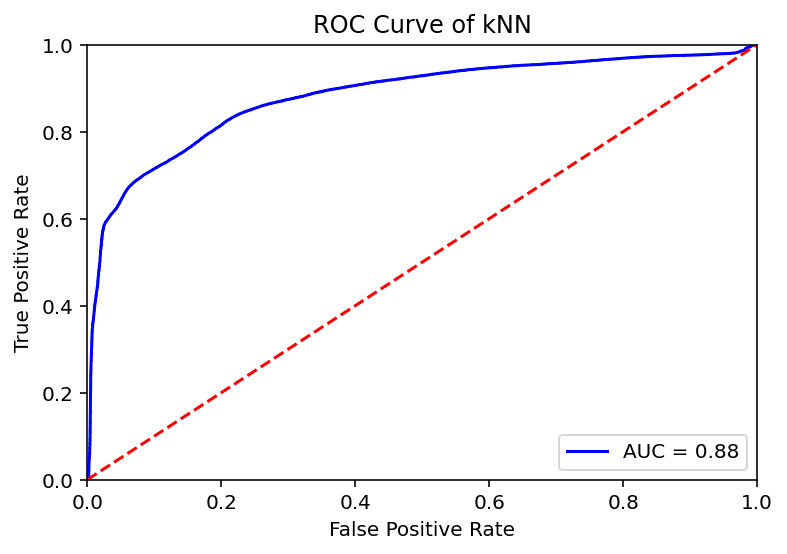

Model accuracy score: 0.8138
Training-set accuracy score: 0.8141
Confusion matrix

 [[110202  23043]
 [ 14203  52552]]

True Positives(TP) =  110202

True Negatives(TN) =  52552

False Positives(FP) =  23043

False Negatives(FN) =  14203


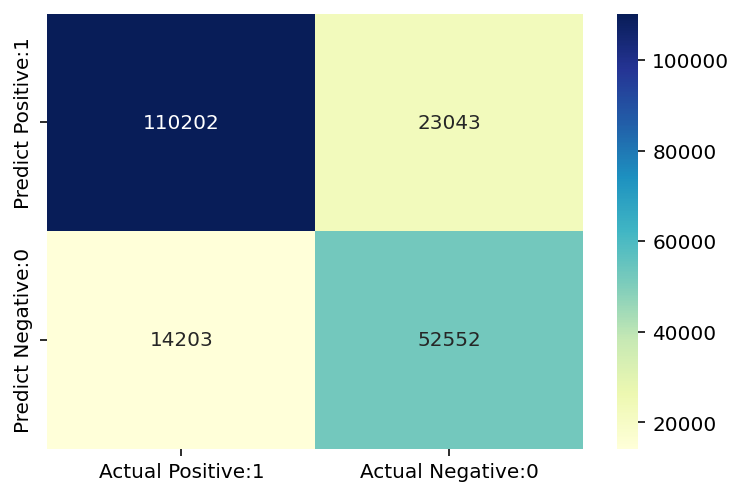

              precision    recall  f1-score   support

           0       0.89      0.83      0.86    133245
           1       0.70      0.79      0.74     66755

    accuracy                           0.81    200000
   macro avg       0.79      0.81      0.80    200000
weighted avg       0.82      0.81      0.82    200000

Classification accuracy : 0.8138


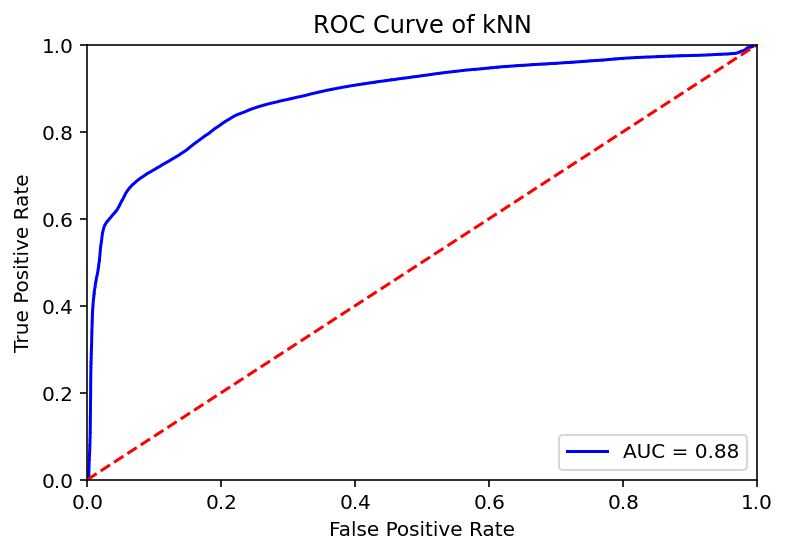

Model accuracy score: 0.8128
Training-set accuracy score: 0.8130
Confusion matrix

 [[330542  69683]
 [ 42620 157155]]

True Positives(TP) =  330542

True Negatives(TN) =  157155

False Positives(FP) =  69683

False Negatives(FN) =  42620


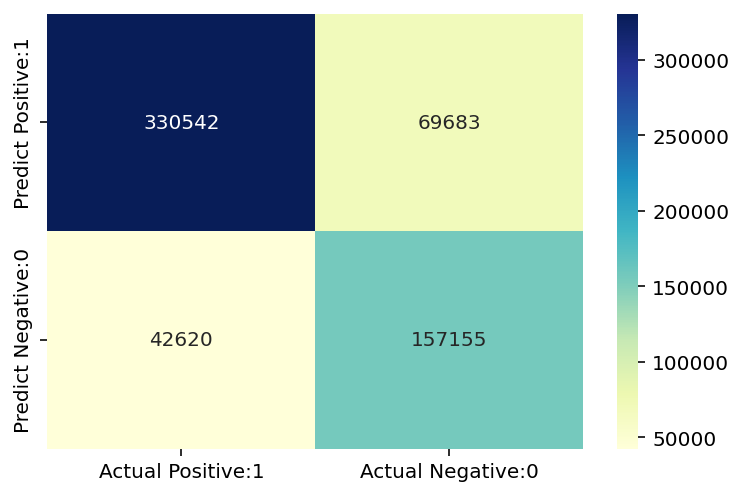

              precision    recall  f1-score   support

           0       0.89      0.83      0.85    400225
           1       0.69      0.79      0.74    199775

    accuracy                           0.81    600000
   macro avg       0.79      0.81      0.80    600000
weighted avg       0.82      0.81      0.82    600000

Classification accuracy : 0.8128


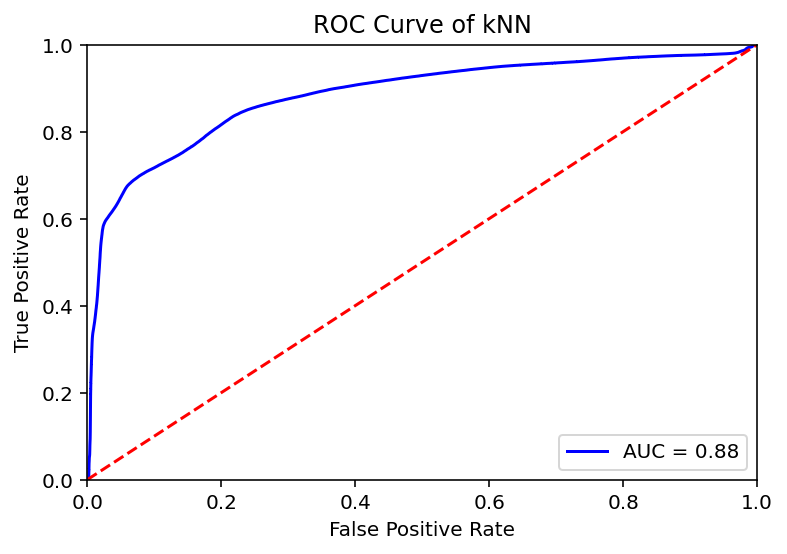

Model accuracy score: 0.7746
Training-set accuracy score: 0.7736
Confusion matrix

 [[628375 171729]
 [ 98798 301098]]

True Positives(TP) =  628375

True Negatives(TN) =  301098

False Positives(FP) =  171729

False Negatives(FN) =  98798


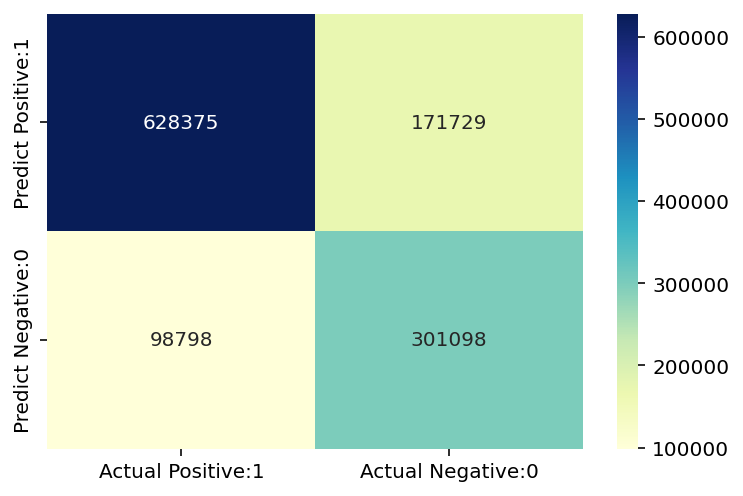

              precision    recall  f1-score   support

           0       0.86      0.79      0.82    800104
           1       0.64      0.75      0.69    399896

    accuracy                           0.77   1200000
   macro avg       0.75      0.77      0.76   1200000
weighted avg       0.79      0.77      0.78   1200000

Classification accuracy : 0.7746


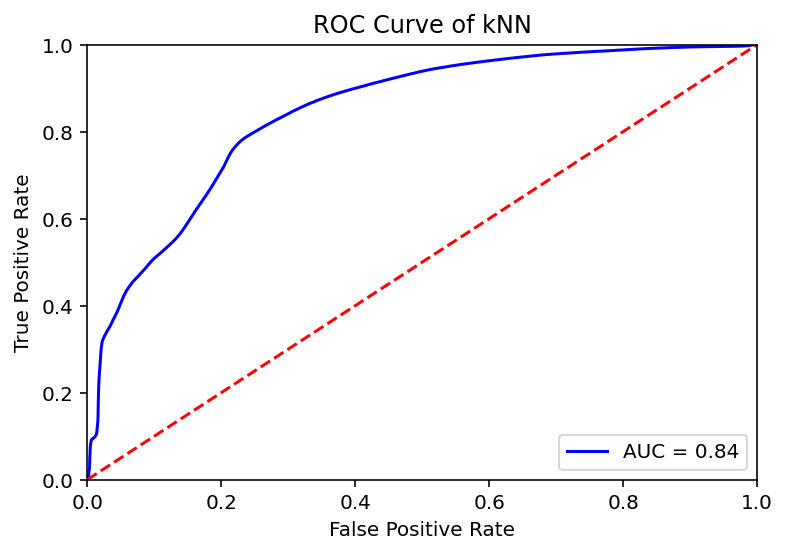

In [ ]:
# 4 variables becomes lable encoded using solver =  'liblinear' , cv = 100
for i in range(len(model_datas)):
  df = model_datas[i]

  X = df.drop(['is_attributed'], axis=1)
  y = df['is_attributed']

  columns = X.columns

  pca = PCA(n_components=5)
  X = pca.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = pd.DataFrame(scaler.fit_transform(X_train))
  X_test = pd.DataFrame(scaler.transform(X_test))
  
  y_pred , y_pred_probab = lgstc_Reg(X_train , X_test , y_train, y_test)
  evalute_mode(y_pred , y_pred_probab ,y_test)

Model accuracy score: 0.7949
Training-set accuracy score: 0.7980
Confusion matrix

 [[10655  2771]
 [ 1331  5243]]

True Positives(TP) =  10655

True Negatives(TN) =  5243

False Positives(FP) =  2771

False Negatives(FN) =  1331


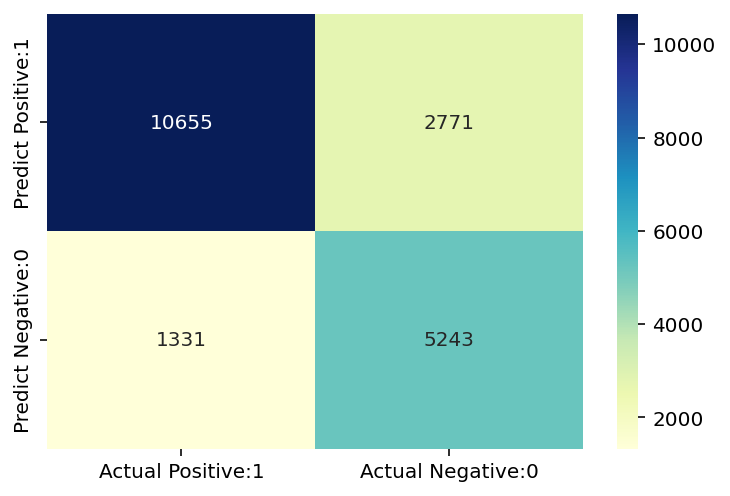

              precision    recall  f1-score   support

           0       0.89      0.79      0.84     13426
           1       0.65      0.80      0.72      6574

    accuracy                           0.79     20000
   macro avg       0.77      0.80      0.78     20000
weighted avg       0.81      0.79      0.80     20000

Classification accuracy : 0.7949


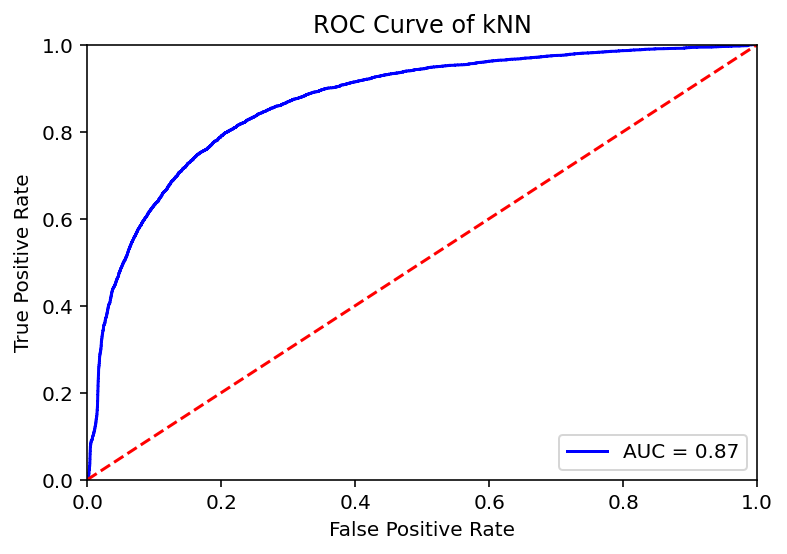

Model accuracy score: 0.9451
Training-set accuracy score: 0.7980
Confusion matrix

 [[891518   8315]
 [ 43534   1412]]

True Positives(TP) =  891518

True Negatives(TN) =  1412

False Positives(FP) =  8315

False Negatives(FN) =  43534


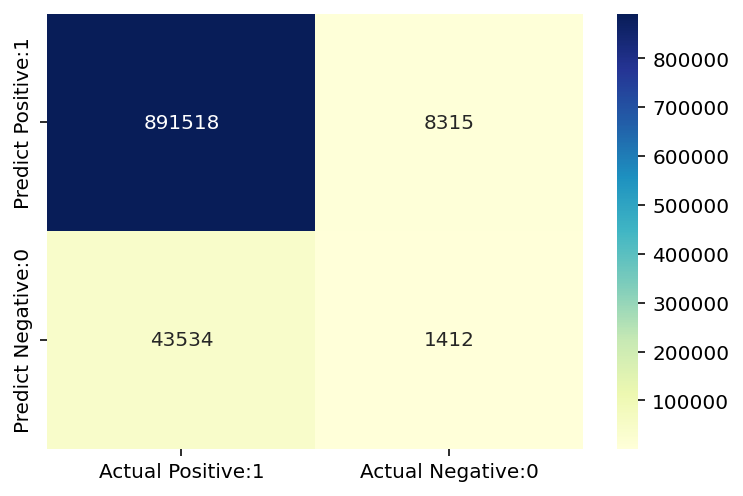

              precision    recall  f1-score   support

           0       0.95      0.99      0.97    899833
           1       0.15      0.03      0.05     44946

    accuracy                           0.95    944779
   macro avg       0.55      0.51      0.51    944779
weighted avg       0.91      0.95      0.93    944779

Classification accuracy : 0.9451


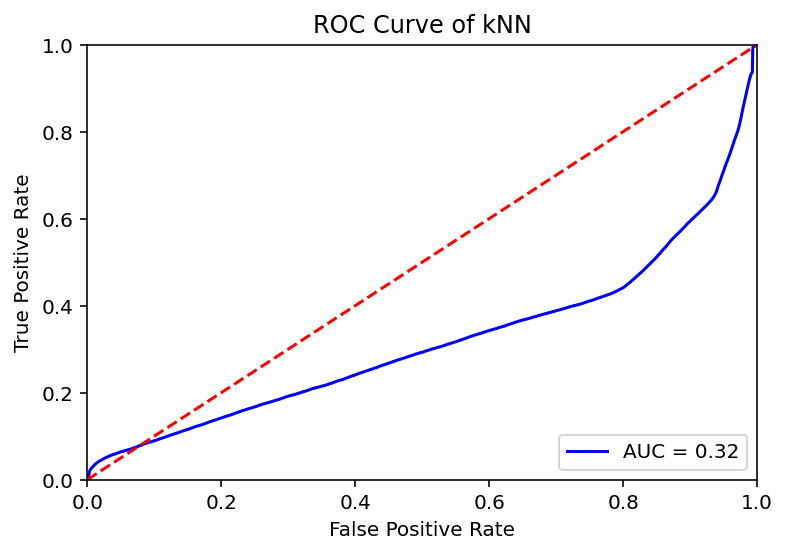

Model accuracy score: 0.8111
Training-set accuracy score: 0.8129
Confusion matrix

 [[54260 12352]
 [ 6534 26854]]

True Positives(TP) =  54260

True Negatives(TN) =  26854

False Positives(FP) =  12352

False Negatives(FN) =  6534


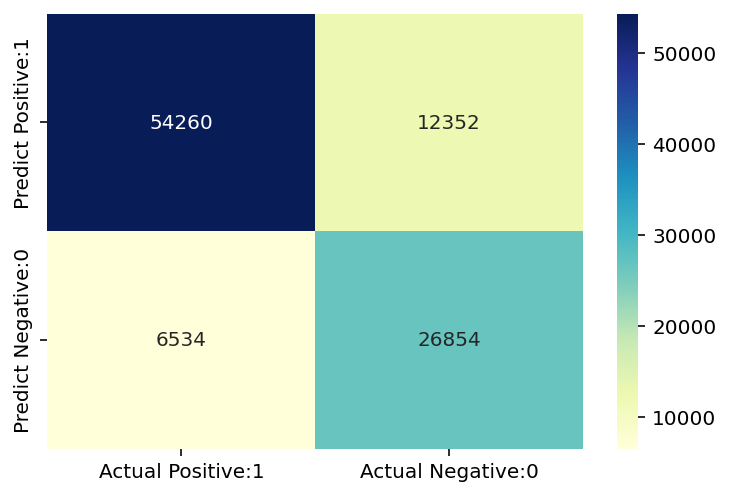

              precision    recall  f1-score   support

           0       0.89      0.81      0.85     66612
           1       0.68      0.80      0.74     33388

    accuracy                           0.81    100000
   macro avg       0.79      0.81      0.80    100000
weighted avg       0.82      0.81      0.81    100000

Classification accuracy : 0.8111


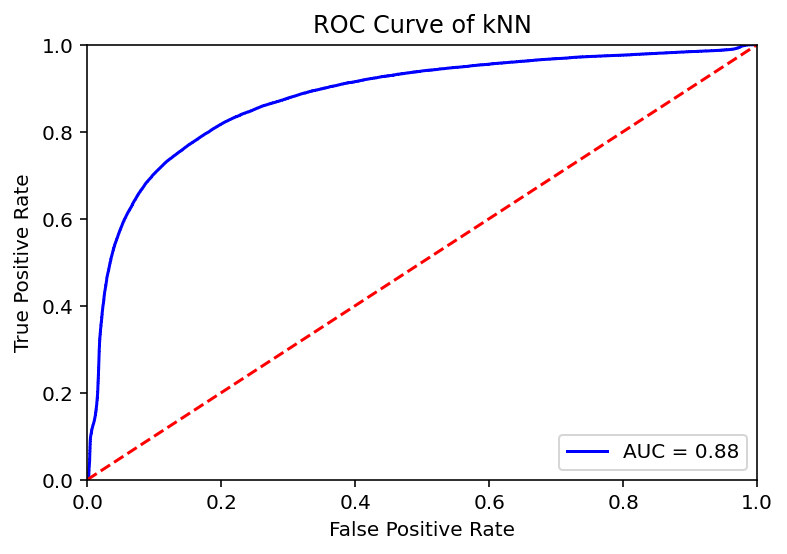

Model accuracy score: 0.9442
Training-set accuracy score: 0.8129
Confusion matrix

 [[890137   9696]
 [ 43041   1905]]

True Positives(TP) =  890137

True Negatives(TN) =  1905

False Positives(FP) =  9696

False Negatives(FN) =  43041


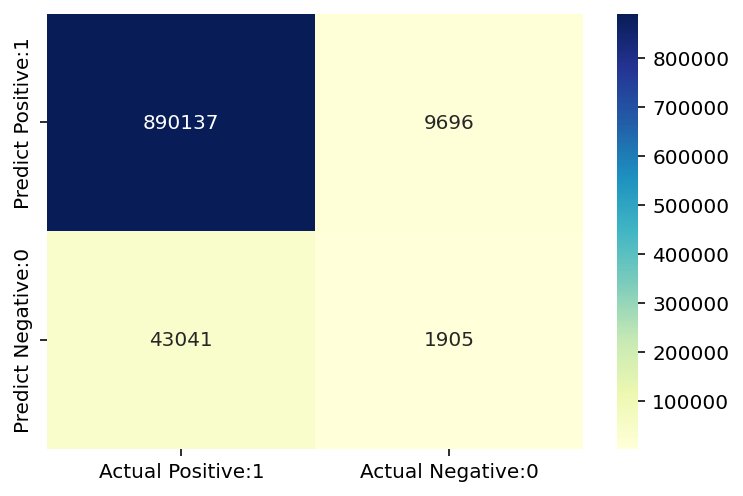

              precision    recall  f1-score   support

           0       0.95      0.99      0.97    899833
           1       0.16      0.04      0.07     44946

    accuracy                           0.94    944779
   macro avg       0.56      0.52      0.52    944779
weighted avg       0.92      0.94      0.93    944779

Classification accuracy : 0.9442


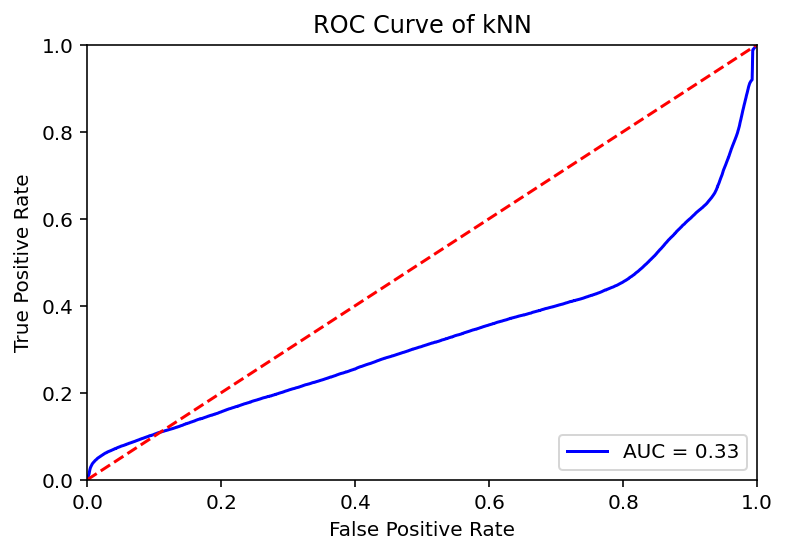

Model accuracy score: 0.7949
Training-set accuracy score: 0.7980
Confusion matrix

 [[10655  2771]
 [ 1331  5243]]

True Positives(TP) =  10655

True Negatives(TN) =  5243

False Positives(FP) =  2771

False Negatives(FN) =  1331


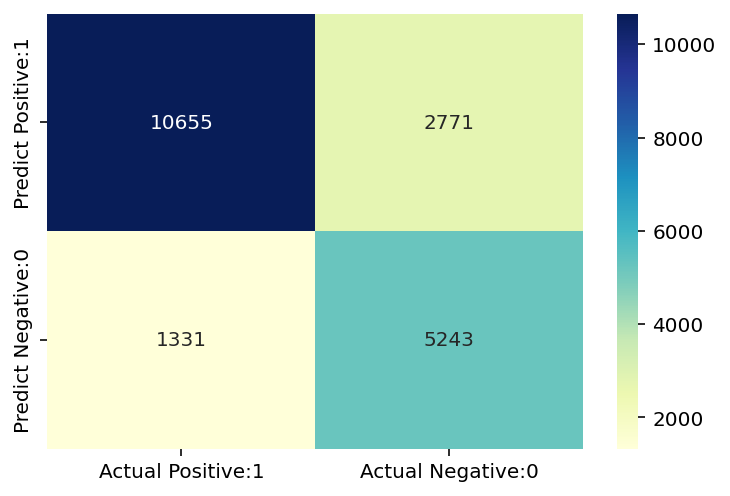

              precision    recall  f1-score   support

           0       0.89      0.79      0.84     13426
           1       0.65      0.80      0.72      6574

    accuracy                           0.79     20000
   macro avg       0.77      0.80      0.78     20000
weighted avg       0.81      0.79      0.80     20000

Classification accuracy : 0.7949


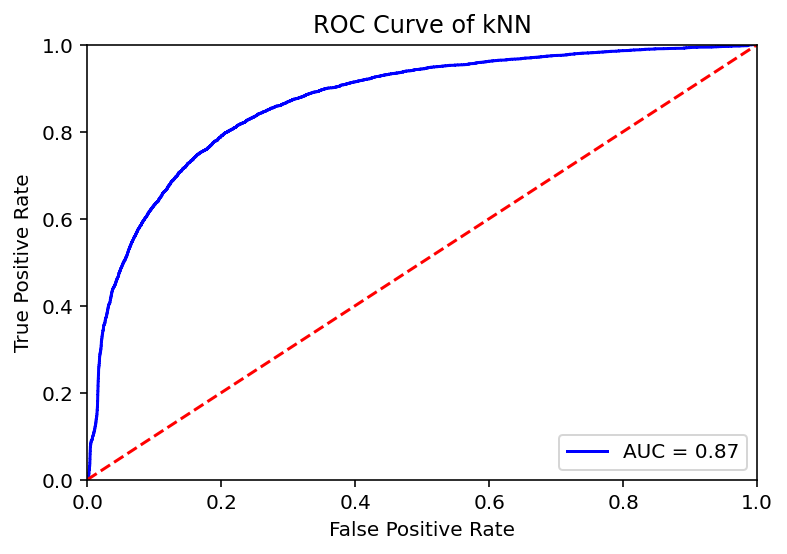

Model accuracy score: 0.9451
Training-set accuracy score: 0.7980
Confusion matrix

 [[891518   8315]
 [ 43534   1412]]

True Positives(TP) =  891518

True Negatives(TN) =  1412

False Positives(FP) =  8315

False Negatives(FN) =  43534


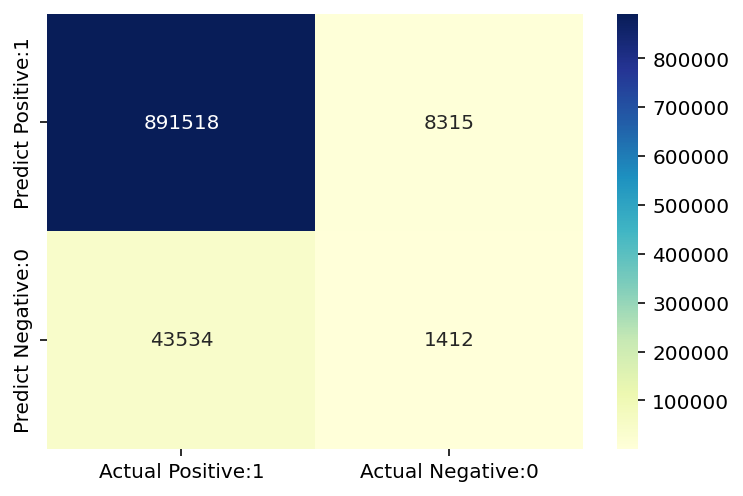

              precision    recall  f1-score   support

           0       0.95      0.99      0.97    899833
           1       0.15      0.03      0.05     44946

    accuracy                           0.95    944779
   macro avg       0.55      0.51      0.51    944779
weighted avg       0.91      0.95      0.93    944779

Classification accuracy : 0.9451


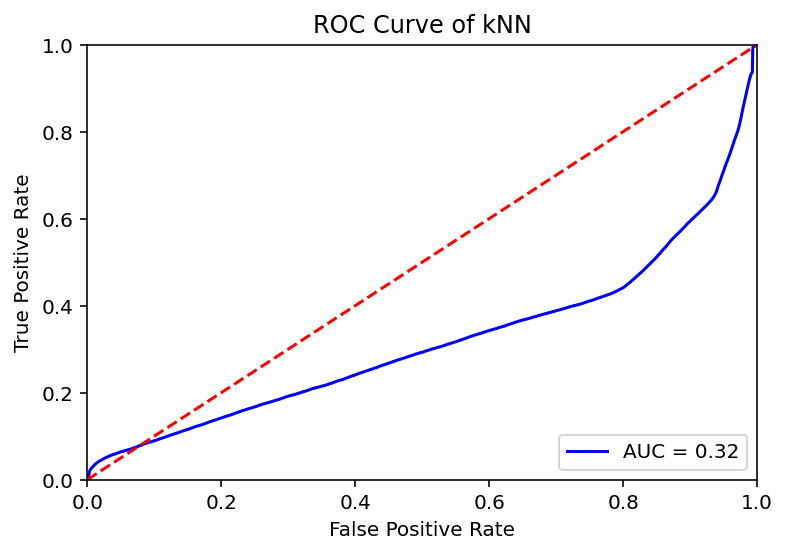

Model accuracy score: 0.8111
Training-set accuracy score: 0.8129
Confusion matrix

 [[54260 12352]
 [ 6534 26854]]

True Positives(TP) =  54260

True Negatives(TN) =  26854

False Positives(FP) =  12352

False Negatives(FN) =  6534


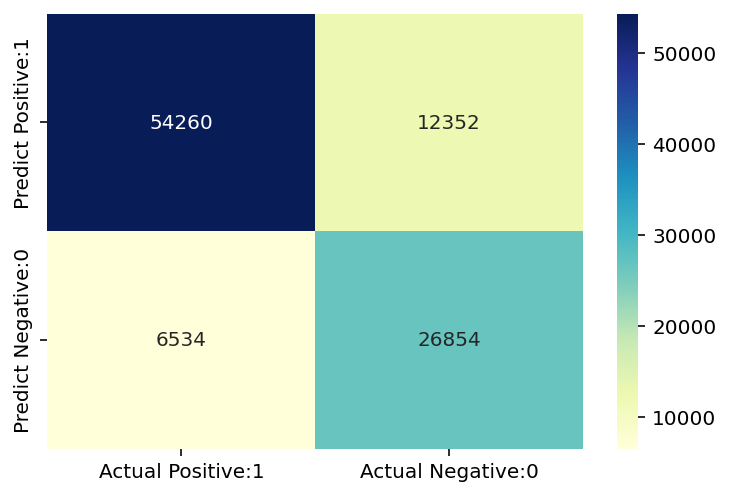

              precision    recall  f1-score   support

           0       0.89      0.81      0.85     66612
           1       0.68      0.80      0.74     33388

    accuracy                           0.81    100000
   macro avg       0.79      0.81      0.80    100000
weighted avg       0.82      0.81      0.81    100000

Classification accuracy : 0.8111


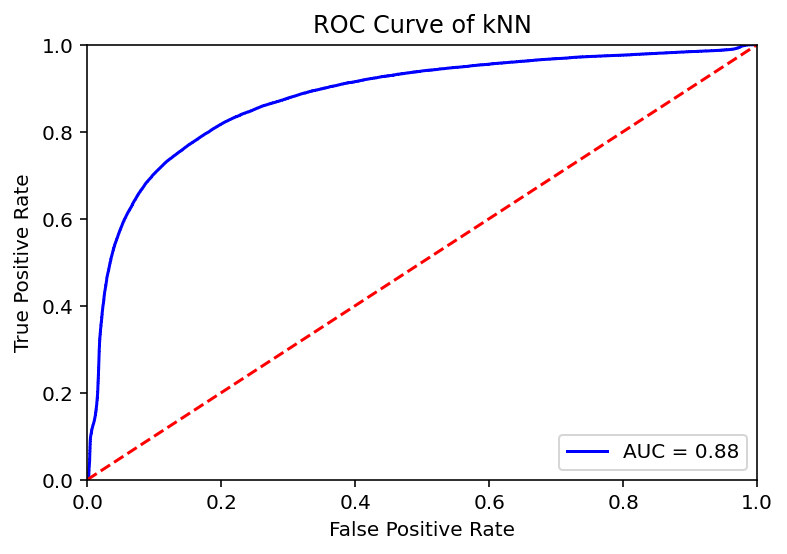

Model accuracy score: 0.9442
Training-set accuracy score: 0.8129
Confusion matrix

 [[890137   9696]
 [ 43041   1905]]

True Positives(TP) =  890137

True Negatives(TN) =  1905

False Positives(FP) =  9696

False Negatives(FN) =  43041


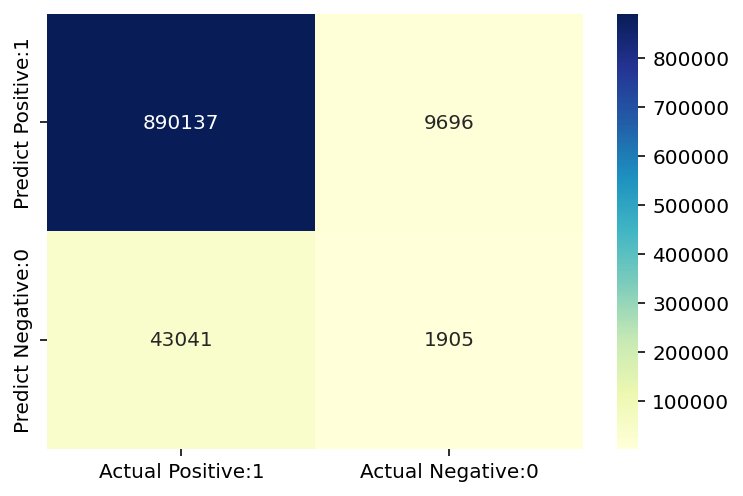

              precision    recall  f1-score   support

           0       0.95      0.99      0.97    899833
           1       0.16      0.04      0.07     44946

    accuracy                           0.94    944779
   macro avg       0.56      0.52      0.52    944779
weighted avg       0.92      0.94      0.93    944779

Classification accuracy : 0.9442


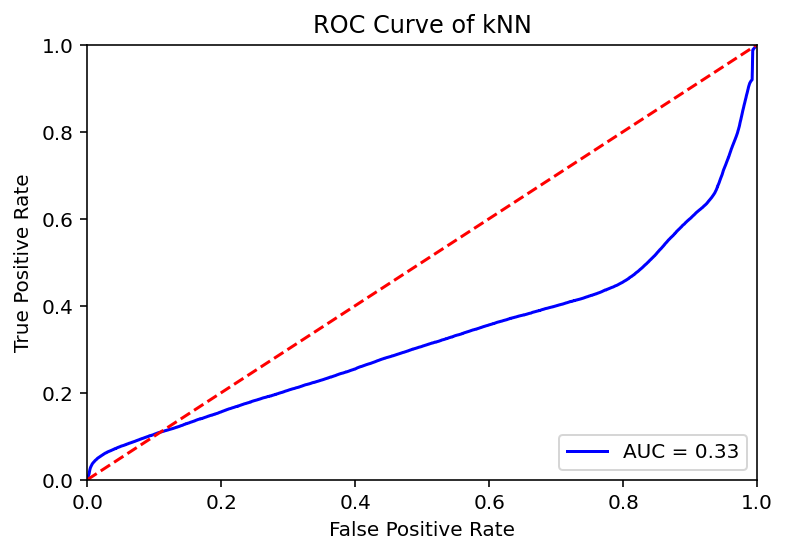

Model accuracy score: 0.8146
Training-set accuracy score: 0.8152
Confusion matrix

 [[109411  23834]
 [ 13245  53510]]

True Positives(TP) =  109411

True Negatives(TN) =  53510

False Positives(FP) =  23834

False Negatives(FN) =  13245


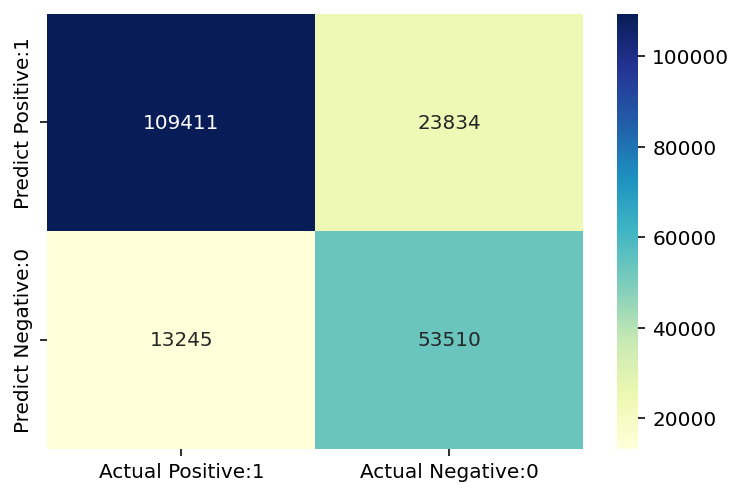

              precision    recall  f1-score   support

           0       0.89      0.82      0.86    133245
           1       0.69      0.80      0.74     66755

    accuracy                           0.81    200000
   macro avg       0.79      0.81      0.80    200000
weighted avg       0.83      0.81      0.82    200000

Classification accuracy : 0.8146


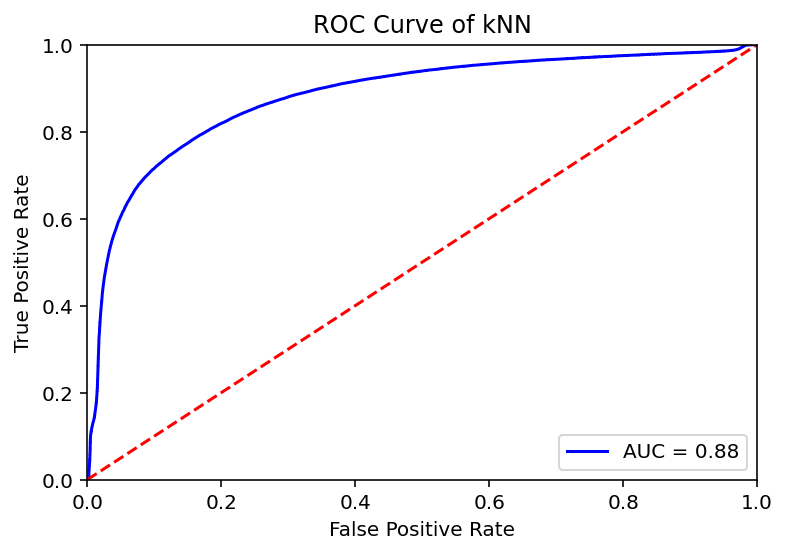

Model accuracy score: 0.9440
Training-set accuracy score: 0.8152
Confusion matrix

 [[889797  10036]
 [ 42879   2067]]

True Positives(TP) =  889797

True Negatives(TN) =  2067

False Positives(FP) =  10036

False Negatives(FN) =  42879


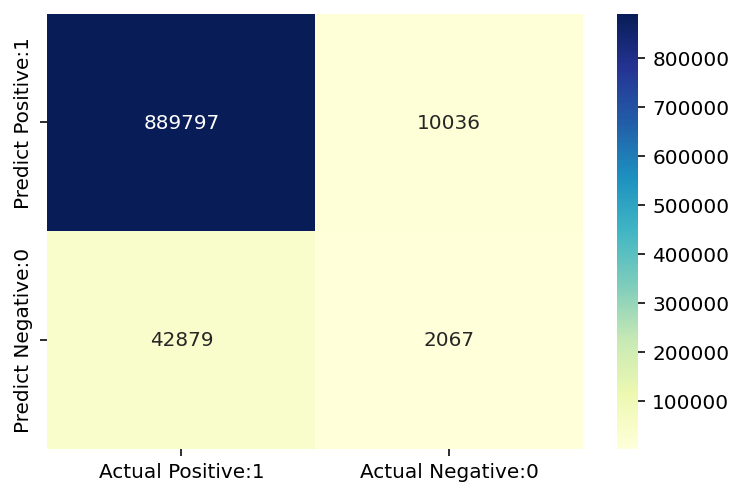

              precision    recall  f1-score   support

           0       0.95      0.99      0.97    899833
           1       0.17      0.05      0.07     44946

    accuracy                           0.94    944779
   macro avg       0.56      0.52      0.52    944779
weighted avg       0.92      0.94      0.93    944779

Classification accuracy : 0.9440


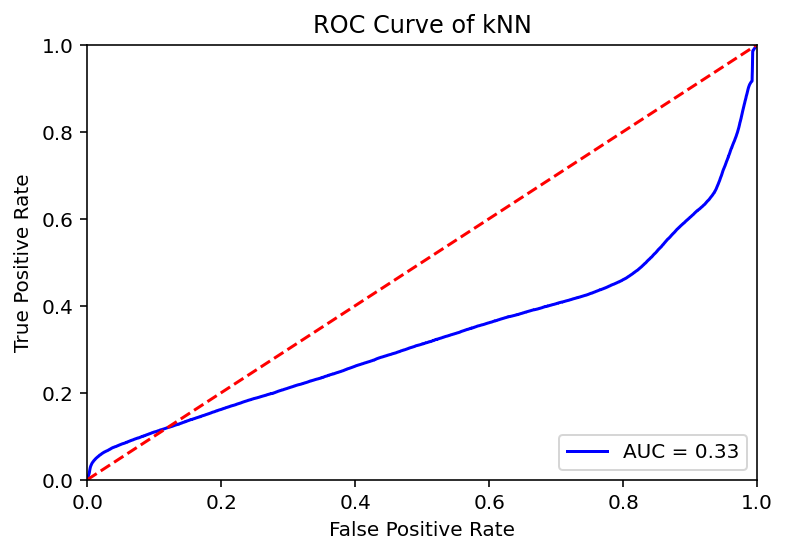

Model accuracy score: 0.8176
Training-set accuracy score: 0.8175
Confusion matrix

 [[330809  69416]
 [ 39999 159776]]

True Positives(TP) =  330809

True Negatives(TN) =  159776

False Positives(FP) =  69416

False Negatives(FN) =  39999


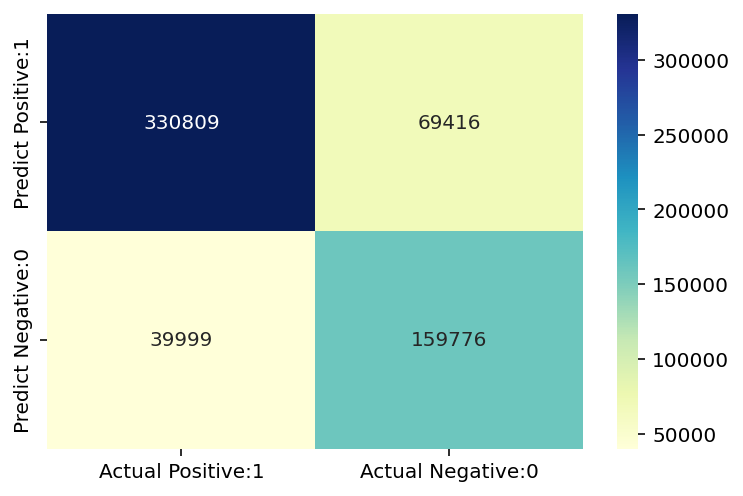

              precision    recall  f1-score   support

           0       0.89      0.83      0.86    400225
           1       0.70      0.80      0.74    199775

    accuracy                           0.82    600000
   macro avg       0.79      0.81      0.80    600000
weighted avg       0.83      0.82      0.82    600000

Classification accuracy : 0.8176


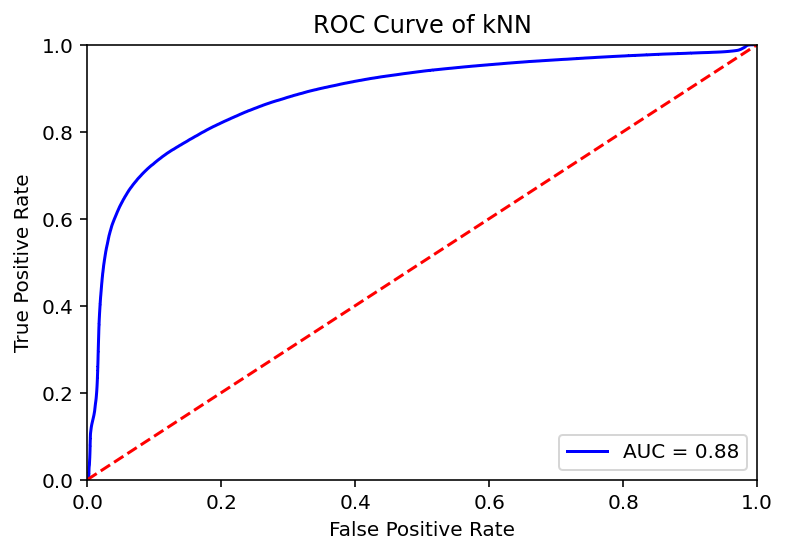

Model accuracy score: 0.9442
Training-set accuracy score: 0.8175
Confusion matrix

 [[889945   9888]
 [ 42821   2125]]

True Positives(TP) =  889945

True Negatives(TN) =  2125

False Positives(FP) =  9888

False Negatives(FN) =  42821


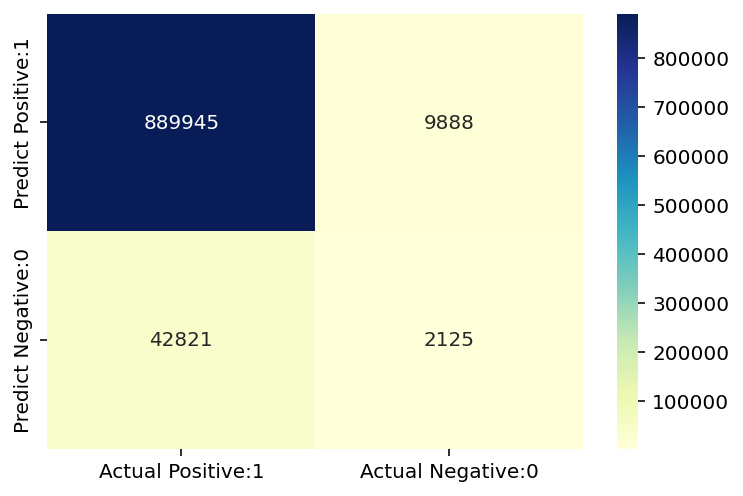

              precision    recall  f1-score   support

           0       0.95      0.99      0.97    899833
           1       0.18      0.05      0.07     44946

    accuracy                           0.94    944779
   macro avg       0.57      0.52      0.52    944779
weighted avg       0.92      0.94      0.93    944779

Classification accuracy : 0.9442


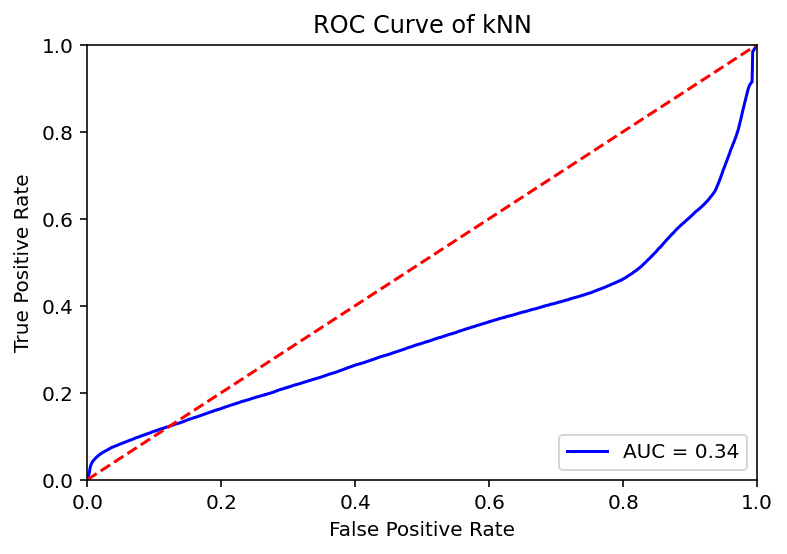

Model accuracy score: 0.8208
Training-set accuracy score: 0.8198
Confusion matrix

 [[664262 135842]
 [ 79173 320723]]

True Positives(TP) =  664262

True Negatives(TN) =  320723

False Positives(FP) =  135842

False Negatives(FN) =  79173


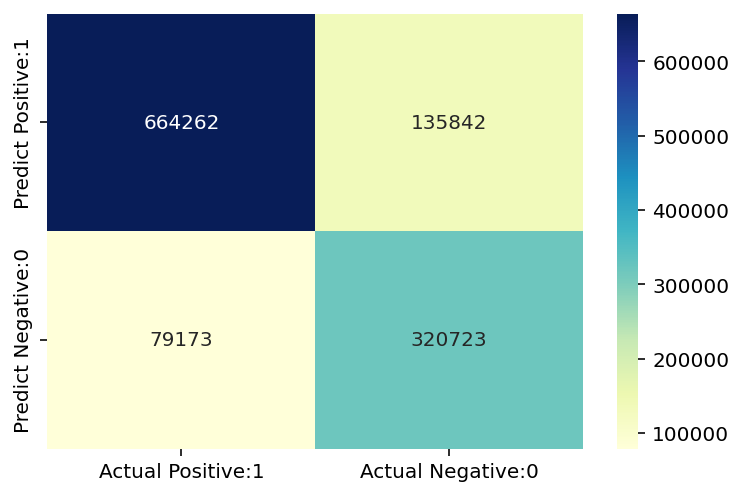

              precision    recall  f1-score   support

           0       0.89      0.83      0.86    800104
           1       0.70      0.80      0.75    399896

    accuracy                           0.82   1200000
   macro avg       0.80      0.82      0.80   1200000
weighted avg       0.83      0.82      0.82   1200000

Classification accuracy : 0.8208


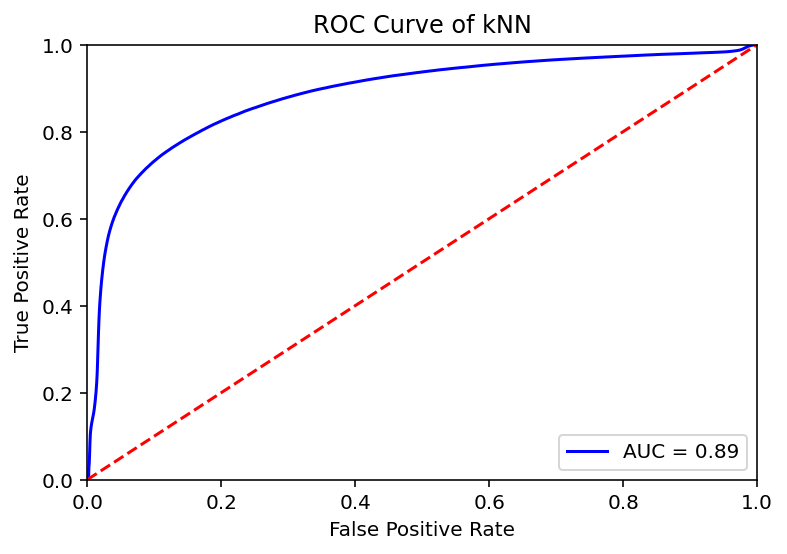

Model accuracy score: 0.9435
Training-set accuracy score: 0.8198
Confusion matrix

 [[889040  10793]
 [ 42542   2404]]

True Positives(TP) =  889040

True Negatives(TN) =  2404

False Positives(FP) =  10793

False Negatives(FN) =  42542


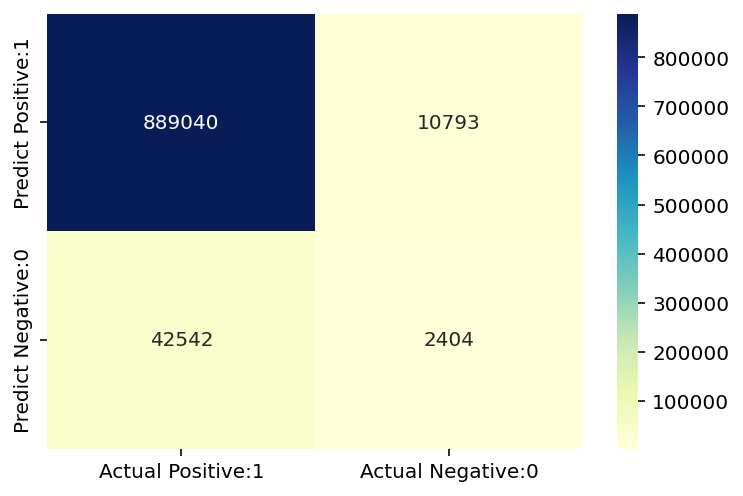

              precision    recall  f1-score   support

           0       0.95      0.99      0.97    899833
           1       0.18      0.05      0.08     44946

    accuracy                           0.94    944779
   macro avg       0.57      0.52      0.53    944779
weighted avg       0.92      0.94      0.93    944779

Classification accuracy : 0.9435


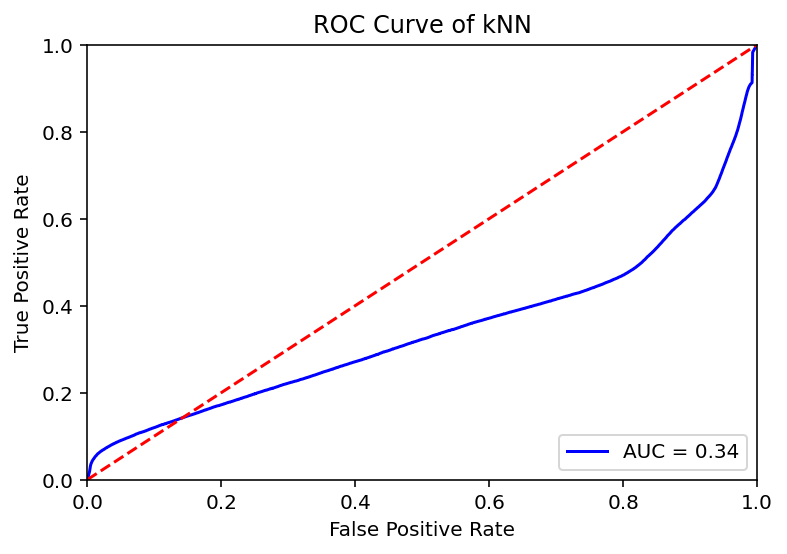

In [ ]:
for i in range(len(model_datas)):
  df = model_datas[i]
  
  X = df.drop(['is_attributed'], axis=1)
  y = df['is_attributed']

  columns = X.columns

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = pd.DataFrame(scaler.fit_transform(X_train))
  X_test = pd.DataFrame(scaler.transform(X_test))
  
  y_pred , y_pred_probab ,log = lgstc_Reg(X_train , X_test , y_train, y_test)
  evalute_mode(y_pred , y_pred_probab ,y_test)


  X = test.drop(['is_attributed'], axis=1)
  y = test['is_attributed']
  X = pd.DataFrame(scaler.transform(X))
  y_pred , y_pred_probab = predicate_data_lgstic(X,y,log)
  evalute_mode(y_pred , y_pred_probab ,y)


Model accuracy score: 0.8198
Training-set accuracy score: 0.8200
Confusion matrix

 [[1330224  274582]
 [ 159034  642136]]

True Positives(TP) =  1330224

True Negatives(TN) =  642136

False Positives(FP) =  274582

False Negatives(FN) =  159034


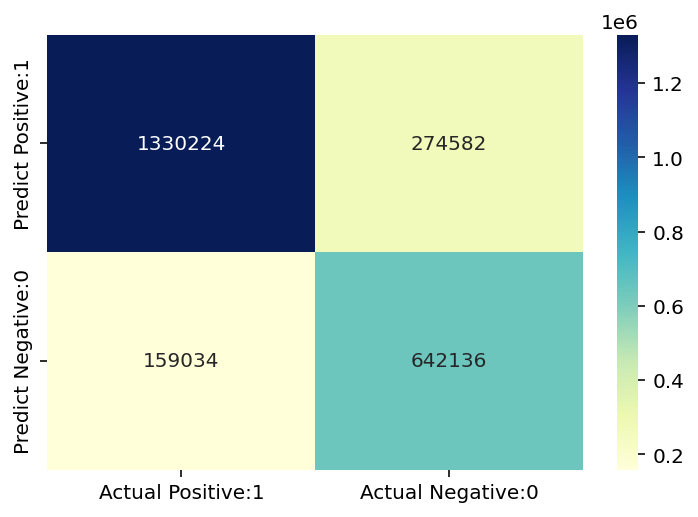

              precision    recall  f1-score   support

           0       0.89      0.83      0.86   1604806
           1       0.70      0.80      0.75    801170

    accuracy                           0.82   2405976
   macro avg       0.80      0.82      0.80   2405976
weighted avg       0.83      0.82      0.82   2405976

Classification accuracy : 0.8198


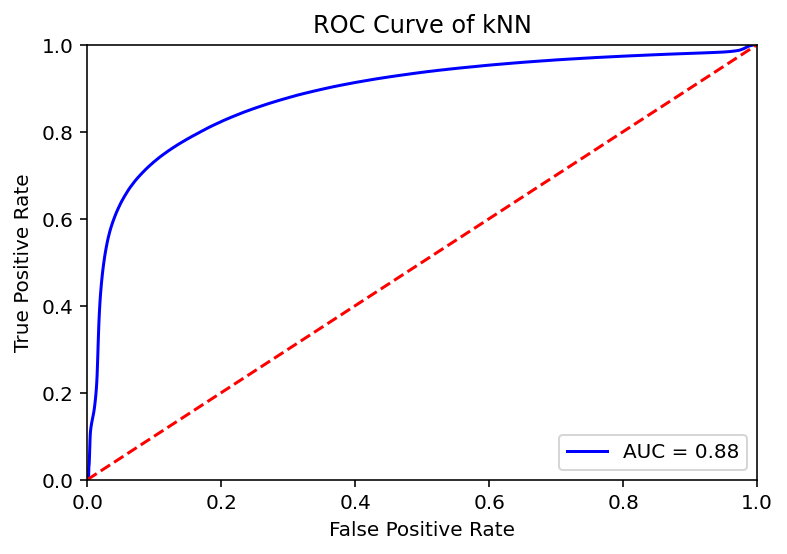

Model accuracy score: 0.6328
Training-set accuracy score: 0.8200
Confusion matrix

 [[564720 335113]
 [ 11855  33091]]

True Positives(TP) =  564720

True Negatives(TN) =  33091

False Positives(FP) =  335113

False Negatives(FN) =  11855


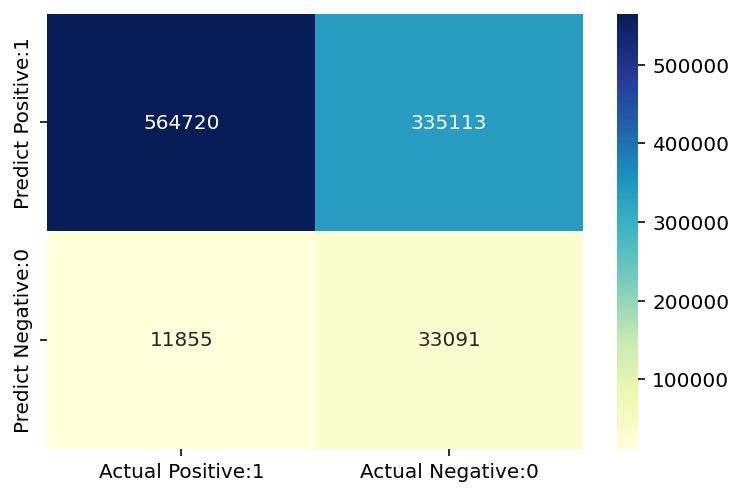

              precision    recall  f1-score   support

           0       0.98      0.63      0.76    899833
           1       0.09      0.74      0.16     44946

    accuracy                           0.63    944779
   macro avg       0.53      0.68      0.46    944779
weighted avg       0.94      0.63      0.74    944779

Classification accuracy : 0.6328


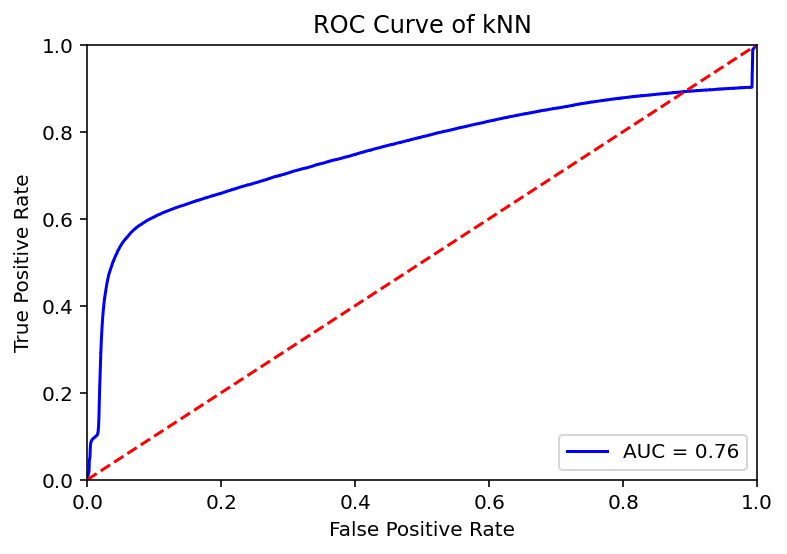

In [ ]:
for i in range(1):  
  df = train
  
  X = df.drop(['is_attributed'], axis=1)
  y = df['is_attributed']

  columns = X.columns

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = pd.DataFrame(scaler.fit_transform(X_train))
  X_test = pd.DataFrame(scaler.transform(X_test))
  
  y_pred , y_pred_probab ,log = lgstc_Reg(X_train , X_test , y_train, y_test)
  evalute_mode(y_pred , y_pred_probab ,y_test)


  X = test.drop(['is_attributed'], axis=1)
  y = test['is_attributed']
  X = pd.DataFrame(scaler.transform(X))
  y_pred , y_pred_probab = predicate_data_lgstic(X,y,log)
  evalute_mode(y_pred , y_pred_probab ,y)

In [ ]:
from sklearn.datasets import make_blobs
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression

df = model_datas[0]

X = df.drop(['is_attributed'], axis=1)
y = df['is_attributed']

model = LogisticRegression()

solvers = ['newton-cg', 'lbfgs', 'liblinear']
penalty = ['l2']
c_values = [100, 10, 1.0, 0.1, 0.01]

grid = dict(solver=solvers,penalty=penalty,C=c_values)
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=cv, scoring='accuracy',error_score=0)
grid_result = grid_search.fit(X, y)

print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

KeyboardInterrupt: ignored

In [ ]:
#PCA
from sklearn.decomposition import PCA
pca = PCA(n_components=5)
X = pca.fit_transform(X)
pca.explained_variance_ratio_

array([9.98982897e-01, 6.08136125e-04, 3.86745984e-04, 8.00819215e-06,
       6.84160037e-06])

In [ ]:

X_train = pd.DataFrame(scaler.fit_transform(X_train))


pca= PCA()
pca.fit(X_train)
cumsum = np.cumsum(pca.explained_variance_ratio_)
dim = np.argmax(cumsum >= 0.90) + 1
print('The number of dimensions required to preserve 90% of variance is',dim)

The number of dimensions required to preserve 90% of variance is 7


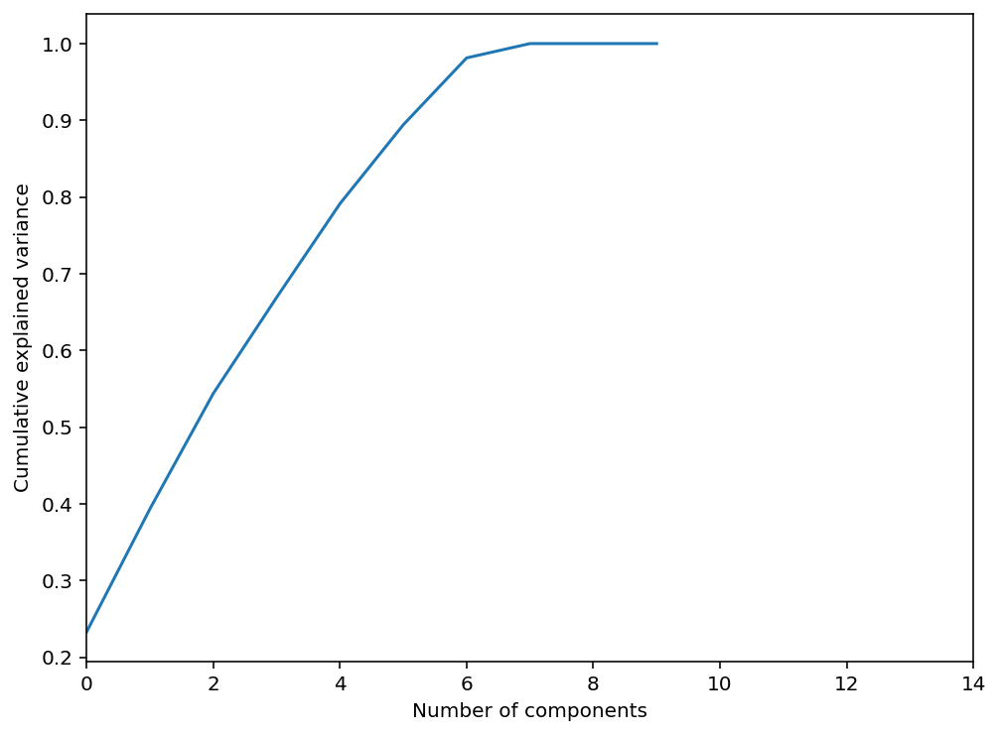

In [ ]:
plt.figure(figsize=(8,6))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlim(0,14,1)
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')
plt.show()

Text(0, 0.5, 'Frequency')

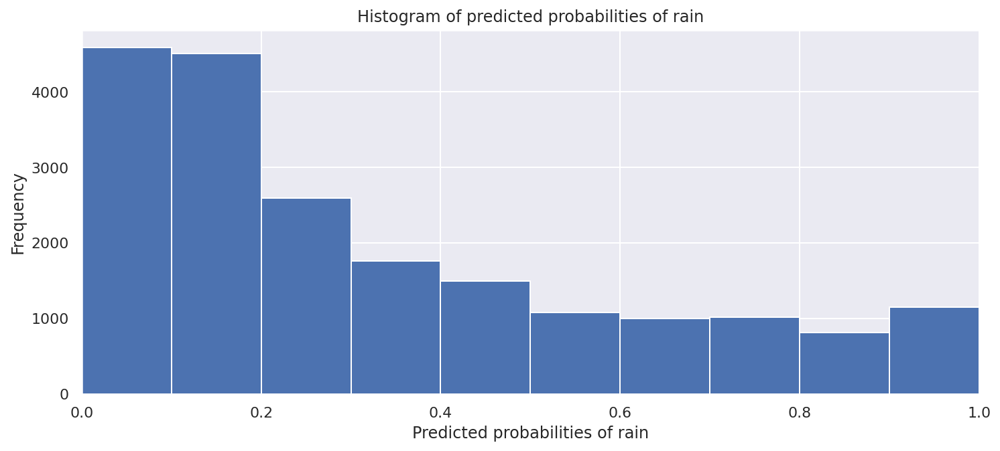

In [ ]:
# plot histogram of predicted probabilities


# adjust the font size 
plt.rcParams['font.size'] = 12


# plot histogram with 10 bins
plt.hist(y_pred1, bins = 10)


# set the title of predicted probabilities
plt.title('Histogram of predicted probabilities of rain')


# set the x-axis limit
plt.xlim(0,1)


# set the title
plt.xlabel('Predicted probabilities of rain')
plt.ylabel('Frequency')

In [ ]:
from sklearn.metrics import roc_auc_score

ROC_AUC = roc_auc_score(y_test, y_pred1)

print('ROC AUC : {:.4f}'.format(ROC_AUC))

ROC AUC : 0.8551


#Logistic Regression

In [ ]:
X = df1.drop(['is_attributed'], axis=1)

y = df1['is_attributed']

In [ ]:
df1

,ip,app,device,os,channel,Year,Month,Day,Hour,minute,is_attributed
8616292,228129,3,1,16,137,2017,11,9,13,27,0
13890621,123994,2,1,19,401,2017,11,9,15,59,0
20903210,96904,23,0,21,213,2017,11,9,1,38,1
3455697,94049,2,1,19,435,2017,11,7,21,22,0
6400524,169013,2,1,41,477,2017,11,8,21,34,0
...,...,...,...,...,...,...,...,...,...,...,...
17794381,25553,52,1,13,379,2017,11,7,17,5,1
686199,70429,18,1,8,107,2017,11,7,0,19,0
21375167,331055,24,0,7,213,2017,11,9,11,49,1
15119614,87073,19,0,29,213,2017,11,7,7,37,1


In [ ]:
# from sklearn.model_selection import train_test_split

# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.9, random_state = 10)
X = df1.drop(['is_attributed'], axis=1)

y = df1['is_attributed']

train_X, val_X, train_y, val_y = train_test_split(
    X, y, test_size=0.20,random_state=0)

In [ ]:
lr = LogisticRegression()
lr.fit(train_X, train_y)
predictions = lr.predict(val_X)
accuracy = accuracy_score(val_y, predictions)
print(accuracy)
from sklearn.metrics import classification_report
print(classification_report(val_y,predictions))

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,


0.793121
              precision    recall  f1-score   support

           0       0.80      0.89      0.84   1250237
           1       0.78      0.63      0.69    749763

    accuracy                           0.79   2000000
   macro avg       0.79      0.76      0.77   2000000
weighted avg       0.79      0.79      0.79   2000000



In [ ]:
lr = LogisticRegression()
scores = cross_val_score(lr, X, y, cv=10)
scores.sort()
accuracy = scores.mean()

print(scores)
print(accuracy)

In [ ]:
Encoding cyclical continuous featX_train.shape, X_test.shape

((1000000, 10), (9000000, 10))

In [ ]:
X_train.dtypes

ip         uint32
app        uint16
device     uint16
os         uint16
channel    uint16
Year       uint16
Month      uint16
Day        uint16
Hour        int64
minute      int64
dtype: object

In [ ]:
X_train.describe()

,ip,app,device,os,channel,Year,Month,Day,Hour,minute
count,6.700000e+06,6.700000e+06,6.700000e+06,6.700000e+06,6.700000e+06,6700000.0,6700000.0,6.700000e+06,6.700000e+06,6.700000e+06
mean,1.199104e+05,1.814324e+01,2.344082e+01,2.298955e+01,2.423981e+02,2017.0,11.0,8.033380e+00,9.963709e+00,3.006321e+01
std,9.400822e+04,2.234978e+01,2.370230e+02,5.435854e+01,1.290112e+02,0.0,0.0,9.177383e-01,5.575252e+00,1.664746e+01
min,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2017.0,11.0,6.000000e+00,0.000000e+00,0.000000e+00
25%,4.788200e+04,7.000000e+00,1.000000e+00,1.300000e+01,1.280000e+02,2017.0,11.0,7.000000e+00,5.000000e+00,1.600000e+01
50%,9.585600e+04,1.400000e+01,1.000000e+00,1.800000e+01,2.130000e+02,2017.0,11.0,8.000000e+00,1.100000e+01,3.100000e+01
75%,1.735180e+05,2.000000e+01,1.000000e+00,2.200000e+01,3.390000e+02,2017.0,11.0,9.000000e+00,1.500000e+01,4.400000e+01
max,3.647780e+05,7.680000e+02,4.227000e+03,9.360000e+02,4.980000e+02,2017.0,11.0,9.000000e+00,2.300000e+01,5.900000e+01


In [ ]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

X_train = pd.DataFrame(scaler.fit_transform(X_train), columns = X.columns)

X_test = pd.DataFrame(scaler.transform(X_test), columns = X.columns)

In [ ]:
X_train.describe()

,ip,app,device,os,channel,Year,Month,Day,Hour,minute
count,1.000000e+06,1.000000e+06,1.000000e+06,1.000000e+06,1.000000e+06,1000000.0,1000000.0,1.000000e+06,1.000000e+06,1.000000e+06
mean,9.501133e-17,1.127110e-15,-5.334958e-15,7.121391e-16,-1.304969e-15,0.0,0.0,-6.191261e-16,-1.286172e-16,-5.171485e-17
std,1.000001e+00,1.000000e+00,1.000001e+00,1.000001e+00,1.000001e+00,0.0,0.0,1.000000e+00,1.000000e+00,1.000000e+00
min,-1.276713e+00,-8.092341e-01,-9.915786e-02,-4.229653e-01,-1.878298e+00,0.0,0.0,-2.217474e+00,-1.788154e+00,-1.806097e+00
25%,-7.658793e-01,-4.975332e-01,-9.495012e-02,-1.836291e-01,-8.860108e-01,0.0,0.0,-1.127086e+00,-8.909852e-01,-8.451533e-01
50%,-2.553437e-01,-1.858322e-01,-9.495012e-02,-9.157673e-02,-2.270699e-01,0.0,0.0,-3.669916e-02,1.856170e-01,5.573111e-02
75%,5.725057e-01,8.134006e-02,-9.495012e-02,-1.793482e-02,7.497130e-01,0.0,0.0,1.053688e+00,9.033518e-01,8.364976e-01
max,2.602768e+00,3.338882e+01,1.768699e+01,1.634898e+01,1.982320e+00,0.0,0.0,1.053688e+00,2.338821e+00,1.737382e+00


In [ ]:
from sklearn.linear_model import LogisticRegression


# instantiate the model
logreg = LogisticRegression(solver='saga', random_state=0)


# fit the model
logreg.fit(X_train, y_train)

LogisticRegression(random_state=0, solver='saga')

In [ ]:
y_pred_test = logreg.predict(X_test)

y_pred_test

array([1, 0, 0, ..., 1, 1, 1], dtype=uint16)

In [ ]:
logreg.predict_proba(X_test)[:,0]

array([0.00727904, 0.77904865, 0.92261727, ..., 0.04364615, 0.19668538,
       0.47913497])

In [ ]:
logreg.predict_proba(X_test)[:,1]

array([0.99272096, 0.22095135, 0.07738273, ..., 0.95635385, 0.80331462,
       0.52086503])

In [ ]:
from sklearn.metrics import accuracy_score

print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test, y_pred_test)))

Model accuracy score: 0.8228


In [ ]:
#PCA
from sklearn.decomposition import PCA
pca = PCA(n_components=7)
X = pca.fit_transform(X)
pca.explained_variance_ratio_

KeyboardInterrupt: ignored

In [ ]:

X_train = pd.DataFrame(scaler.fit_transform(X_train), columns = X.columns)


pca= PCA()
pca.fit(X_train)
cumsum = np.cumsum(pca.explained_variance_ratio_)
dim = np.argmax(cumsum >= 0.90) + 1
print('The number of dimensions required to preserve 90% of variance is',dim)

The number of dimensions required to preserve 90% of variance is 7


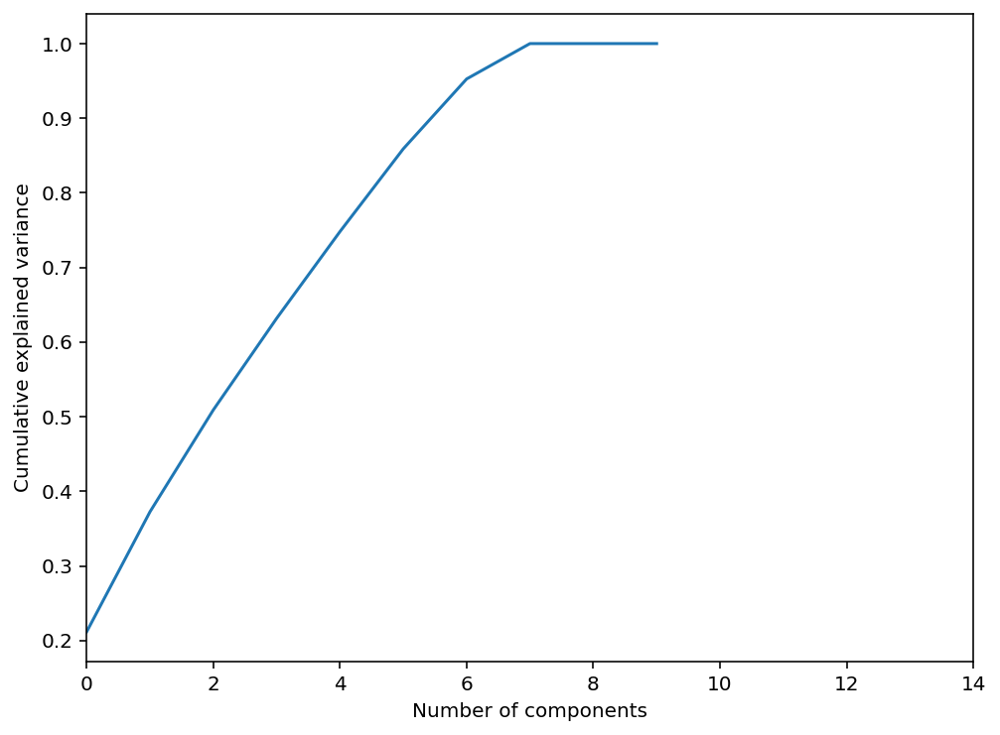

In [ ]:
plt.figure(figsize=(8,6))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlim(0,14,1)
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')
plt.show()

In [ ]:
y_pred_train = logreg.predict(X_train)

y_pred_train

array([0, 1, 0, ..., 1, 0, 0], dtype=uint16)

In [ ]:
print('Training-set accuracy score: {0:0.4f}'. format(accuracy_score(y_train, y_pred_train)))

Training-set accuracy score: 0.8228


In [ ]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(logreg.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(logreg.score(X_test, y_test)))

Training set score: 0.8228
Test set score: 0.8227


In [ ]:
# fit the Logsitic Regression model with C=100

# instantiate the model
logreg100 = LogisticRegression(C=100, solver='liblinear', random_state=0)


# fit the model
logreg100.fit(X_train, y_train)

LogisticRegression(C=100, random_state=0, solver='liblinear')

In [ ]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(logreg100.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(logreg100.score(X_test, y_test)))

Training set score: 0.8228
Test set score: 0.8228


In [ ]:
# fit the Logsitic Regression model with C=001

# instantiate the model
logreg001 = LogisticRegression(C=10, solver='saga', random_state=0)


# fit the model
logreg001.fit(X_train, y_train)

LogisticRegression(C=10, random_state=0, solver='saga')

In [ ]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(logreg001.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(logreg001.score(X_test, y_test)))

Training set score: 0.8228
Test set score: 0.8228


In [ ]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(logreg001.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(logreg001.score(X_test, y_test)))

Training set score: 0.8228
Test set score: 0.8228


In [ ]:
# check class distribution in test set

y_test.value_counts()

0    1250237
1     749763
Name: is_attributed, dtype: int64

In [ ]:
# check null accuracy score

null_accuracy = (2780120/(2780120+1666226))

print('Null accuracy score: {0:0.4f}'. format(null_accuracy))

Null accuracy score: 0.6253


In [ ]:
# Print the Confusion Matrix and slice it into four pieces

from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_test, y_pred_test)

print('Confusion matrix\n\n', cm)

print('\nTrue Positives(TP) = ', cm[0,0])

print('\nTrue Negatives(TN) = ', cm[1,1])

print('\nFalse Positives(FP) = ', cm[0,1])

print('\nFalse Negatives(FN) = ', cm[1,0])

#visualize confusion matrix with seaborn heatmap

cm_matrix = pd.DataFrame(data=cm, columns=['Actual Positive:1', 'Actual Negative:0'], 
                                 index=['Predict Positive:1', 'Predict Negative:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y_test, y_pred_test))

              precision    recall  f1-score   support

           0       0.85      0.87      0.86   1250237
           1       0.78      0.74      0.76    749763

    accuracy                           0.82   2000000
   macro avg       0.81      0.81      0.81   2000000
weighted avg       0.82      0.82      0.82   2000000



In [ ]:
X_train

,ip,app,device,os,channel,Year,Month,Day,Hour,minute
0,-1.225770,-0.677963,-0.094822,-0.073619,1.841211,0.0,0.0,-2.214961,1.979792,1.618181
1,-0.282658,-0.409276,-0.094822,0.256984,1.569916,0.0,0.0,-0.036273,-0.890332,-0.784855
2,-0.887372,-0.767525,-0.094822,0.256984,1.523408,0.0,0.0,-1.125617,0.185964,-0.244172
3,0.603118,0.038535,-0.099037,-0.275654,0.810291,0.0,0.0,-1.125617,-1.249098,-1.325538
4,-0.939888,-0.274933,-0.094822,-0.073619,1.290870,0.0,0.0,1.053071,0.544730,0.656967
...,...,...,...,...,...,...,...,...,...,...
7999995,1.018610,-0.319714,-0.094822,-0.110352,-0.538430,0.0,0.0,1.053071,0.903496,-1.385614
7999996,-0.151388,0.799813,-0.094822,-0.073619,0.725027,0.0,0.0,-0.036273,-0.890332,-0.724779
7999997,-0.799405,0.486346,-0.090607,-0.091985,0.779286,0.0,0.0,-0.036273,-1.249098,1.257726
7999998,0.037622,-0.722744,-0.094822,-0.183820,1.624175,0.0,0.0,-1.125617,1.082878,-0.304248


In [ ]:
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

In [ ]:
# print classification accuracy

classification_accuracy = (TP + TN) / float(TP + TN + FP + FN)

print('Classification accuracy : {0:0.4f}'.format(classification_accuracy))

Classification accuracy : 0.8228


In [ ]:
# print classification error

classification_error = (FP + FN) / float(TP + TN + FP + FN)

print('Classification error : {0:0.4f}'.format(classification_error))

Classification error : 0.1772


In [ ]:
# print precision score

precision = TP / float(TP + FP)


print('Precision : {0:0.4f}'.format(precision))

Precision : 0.8748


In [ ]:
recall = TP / float(TP + FN)

print('Recall or Sensitivity : {0:0.4f}'.format(recall))

Recall or Sensitivity : 0.8468


In [ ]:
# print the first 10 predicted probabilities of two classes- 0 and 1

y_pred_prob = logreg.predict_proba(X_test)[0:10]

y_pred_prob

array([[0.07248929, 0.92751071],
       [0.25165993, 0.74834007],
       [0.94020545, 0.05979455],
       [0.42355645, 0.57644355],
       [0.59846149, 0.40153851],
       [0.24230384, 0.75769616],
       [0.88553164, 0.11446836],
       [0.92099151, 0.07900849],
       [0.89816064, 0.10183936],
       [0.26055282, 0.73944718]])

In [ ]:
# store the probabilities in dataframe

y_pred_prob_df = pd.DataFrame(data=y_pred_prob, columns=['Prob of - No rain tomorrow (0)', 'Prob of - Rain tomorrow (1)'])

y_pred_prob_df

,Prob of - No rain tomorrow (0),Prob of - Rain tomorrow (1)
0,0.072489,0.927511
1,0.251660,0.748340
2,0.940205,0.059795
3,0.423556,0.576444
4,0.598461,0.401539
5,0.242304,0.757696
6,0.885532,0.114468
7,0.920992,0.079008
8,0.898161,0.101839
9,0.260553,0.739447


In [ ]:
# print the first 10 predicted probabilities for class 1 - Probability of rain

logreg.predict_proba(X_test)[0:10, 1]

array([0.92751071, 0.74834007, 0.05979455, 0.57644355, 0.40153851,
       0.75769616, 0.11446836, 0.07900849, 0.10183936, 0.73944718])

In [ ]:
# store the predicted probabilities for class 1 - Probability of rain

y_pred1 = logreg.predict_proba(X_test)[:, 1]

Text(0, 0.5, 'Frequency')

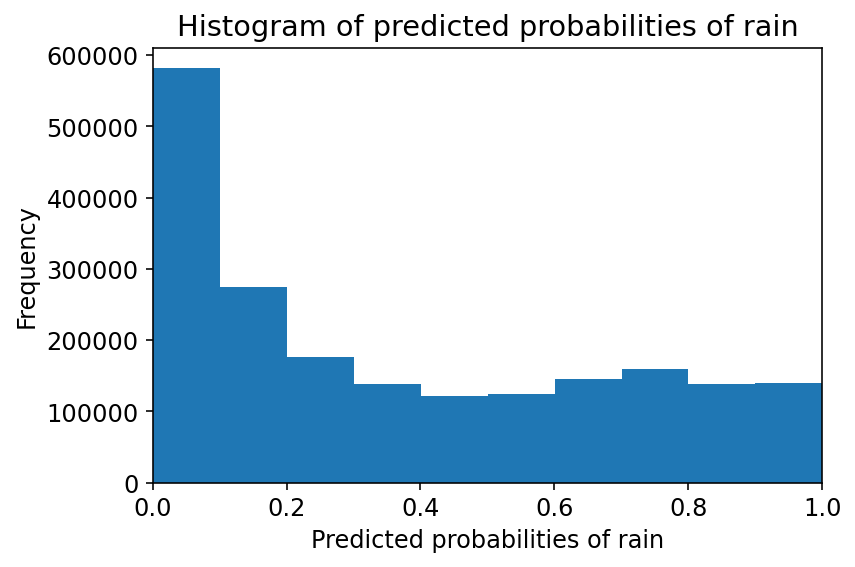

In [ ]:
# plot histogram of predicted probabilities


# adjust the font size 
plt.rcParams['font.size'] = 12


# plot histogram with 10 bins
plt.hist(y_pred1, bins = 10)


# set the title of predicted probabilities
plt.title('Histogram of predicted probabilities of rain')


# set the x-axis limit
plt.xlim(0,1)


# set the title
plt.xlabel('Predicted probabilities of rain')
plt.ylabel('Frequency')

In [ ]:
from sklearn.metrics import roc_auc_score

ROC_AUC = roc_auc_score(y_test, y_pred1)

print('ROC AUC : {:.4f}'.format(ROC_AUC))

ROC AUC : 0.8871


In [ ]:
# calculate cross-validated ROC AUC 

from sklearn.model_selection import cross_val_score

Cross_validated_ROC_AUC = cross_val_score(logreg, X_train, y_train, cv=5, scoring='roc_auc').mean()

print('Cross validated ROC AUC : {:.4f}'.format(Cross_validated_ROC_AUC))

Cross validated ROC AUC : 0.8871


In [ ]:
# Applying 5-Fold Cross Validation

from sklearn.model_selection import cross_val_score

scores = cross_val_score(logreg, X_train, y_train, cv = 5, scoring='accuracy')

print('Cross-validation scores:{}'.format(scores))

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:1679: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:1679: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:1679: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:1679: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.

Cross-validation scores:[0.99308    0.99303625 0.99319    0.99297125 0.9930025 ]


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:1679: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  FutureWarning,


In [ ]:
# compute Average cross-validation score

print('Average cross-validation score: {:.4f}'.format(scores.mean()))

NameError: ignored

In [ ]:
# examine the best model

# best score achieved during the GridSearchCV
print('GridSearch CV best score : {:.4f}\n\n'.format(grid_search.best_score_))

# print parameters that give the best results
print('Parameters that give the best results :','\n\n', (grid_search.best_params_))

# print estimator that was chosen by the GridSearch
print('\n\nEstimator that was chosen by the search :','\n\n', (grid_search.best_estimator_))

NameError: ignored

In [ ]:
# calculate GridSearch CV score on test set

print('GridSearch CV score on test set: {0:0.4f}'.format(grid_search.score(X_test, y_test)))

NameError: ignored

In [ ]:
# define model
lg1 = LogisticRegression(random_state=13, class_weight=None)
# fit it
lg1.fit(X_train,y_train)
# test
y_pred = lg1.predict(X_test)
# performance
print(f'Accuracy Score: {accuracy_score(y_test,y_pred)}')
print(f'Confusion Matrix: \n{confusion_matrix(y_test, y_pred)}')
print(f'Area Under Curve: {roc_auc_score(y_test, y_pred)}')
print(f'Recall score: {recall_score(y_test,y_pred)}')

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:1679: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:1679: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  FutureWarning,


Accuracy Score: 0.8231017109329773


NameError: ignored

In [ ]:
# define class weights
w = {0:1, 1:99}
# define model
lg2 = LogisticRegression(random_state=13, class_weight=w)
# fit it
lg2.fit(X_train,y_train)
# test
y_pred = lg2.predict(X_test)
# performance
print(f'Accuracy Score: {accuracy_score(y_test,y_pred)}')
print(f'Confusion Matrix: \n{confusion_matrix(y_test, y_pred)}')
print(f'Area Under Curve: {roc_auc_score(y_test, y_pred)}')
print(f'Recall score: {recall_score(y_test,y_pred)}')

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:1679: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:1679: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  FutureWarning,


Accuracy Score: 0.374682
Confusion Matrix: 
[[    11 625317]
 [     1 374671]]
Area Under Curve: 0.5000074608836058


NameError: ignored

In [ ]:
# define weight hyperparameter
w = [{0:1000,1:100},{0:1000,1:10}, {0:1000,1:1.0}, 
     {0:500,1:1.0}, {0:400,1:1.0}, {0:300,1:1.0}, {0:200,1:1.0}, 
     {0:150,1:1.0}, {0:100,1:1.0}, {0:99,1:1.0}, {0:10,1:1.0}, 
     {0:0.01,1:1.0}, {0:0.01,1:10}, {0:0.01,1:100}, 
     {0:0.001,1:1.0}, {0:0.005,1:1.0}, {0:1.0,1:1.0}, 
     {0:1.0,1:0.1}, {0:10,1:0.1}, {0:100,1:0.1}, 
     {0:10,1:0.01}, {0:1.0,1:0.01}, {0:1.0,1:0.001}, {0:1.0,1:0.005}, 
     {0:1.0,1:10}, {0:1.0,1:99}, {0:1.0,1:100}, {0:1.0,1:150}, 
     {0:1.0,1:200}, {0:1.0,1:300},{0:1.0,1:400},{0:1.0,1:500}, 
     {0:1.0,1:1000}, {0:10,1:1000},{0:100,1:1000} ]
hyperparam_grid = {"class_weight": w }

# define model
lg3 = LogisticRegression(random_state=13)
# define evaluation procedure
grid = GridSearchCV(lg3,hyperparam_grid,scoring="roc_auc", cv=100, n_jobs=-1, refit=True)
grid.fit(X_train, y_train)
print(f'Best score: {grid.best_score_} with param: {grid.best_params_}')

KeyboardInterrupt: ignored

In [ ]:
print(f'Best score: {grid.best_score_} with param: {grid.best_params_}')

AttributeError: ignored

In [ ]:
y_pred_proba = logreg.predict_proba(X_test)[::,1]
fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)
auc = metrics.roc_auc_score(y_test, y_pred_proba)
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.show()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:1679: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  FutureWarning,


NameError: ignored

# Support Vector Machine

In [ ]:
df = model_datas[1]

In [ ]:
df1.drop(columns=['Year','Month','minute','Unnamed: 0'],inplace=True)

In [ ]:
df1['ip'] = df1['ip'].astype(int)

In [ ]:
for i in df1.columns:
  df1[i] = df1[i].astype(int)

In [ ]:
temp=resample_data(df1,10000)

In [ ]:
X = temp.drop(['is_attributed'], axis=1)

y = temp['is_attributed']

In [ ]:
from sklearn.preprocessing import OneHotEncoder

X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))

In [ ]:
X

<10000x851 sparse matrix of type '<class 'numpy.float64'>'
	with 60000 stored elements in Compressed Sparse Row format>

In [ ]:
from scipy.sparse import hstack
X = hstack((X,np.array(temp['ip'])[:,None]))

In [ ]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)
X = pca.fit_transform(X)
pca.explained_variance_ratio_

In [ ]:
from sklearn.decomposition import TruncatedSVD

clf = TruncatedSVD(10)
X = clf.fit_transform(X)

In [ ]:
# split X and y into training and testing sets

from sklearn.model_selection import train_test_split
size = 20000
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

In [ ]:
# check the shape of X_train and X_test

X_train.shape, X_test.shape

((8000, 7), (2000, 7))

In [ ]:
cols = X_train.columns

In [ ]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

X_train = scaler.fit_transform(X_train)

X_test = scaler.transform(X_test)

In [ ]:
X_train = pd.DataFrame(X_train, columns=[cols])

In [ ]:
X_test = pd.DataFrame(X_test, columns=[cols])

In [ ]:
X_train.describe()

,ip,app,device,os,channel,Day,Hour
count,8.000000e+03,8.000000e+03,8.000000e+03,8.000000e+03,8.000000e+03,8.000000e+03,8.000000e+03
mean,-1.989728e-17,7.396861e-18,7.755949e-17,2.596933e-16,2.433297e-16,-2.684658e-16,-2.544354e-16
std,1.000063e+00,1.000063e+00,1.000063e+00,1.000063e+00,1.000063e+00,1.000063e+00,1.000063e+00
min,-2.407922e-01,-7.676407e-01,-9.424808e-02,-4.866149e-01,-1.871937e+00,-2.247521e+00,-1.787907e+00
25%,-2.386549e-01,-4.905891e-01,-8.913559e-02,-1.933392e-01,-8.606768e-01,-1.150902e+00,-8.840793e-01
50%,-2.259436e-01,-2.135375e-01,-8.913559e-02,-8.054085e-02,-2.353939e-01,-5.428265e-02,1.974864e-02
75%,-1.746484e-01,6.351408e-02,-8.913559e-02,9.697839e-03,7.527074e-01,1.042337e+00,7.428110e-01
max,7.470475e+00,2.111944e+01,1.967063e+01,1.905006e+01,1.941517e+00,1.042337e+00,2.369701e+00


In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_curve
from sklearn.metrics import auc

def evalute_model_SVC(y_pred , y_pred_probab ,y_test):
  cm = confusion_matrix(y_test, y_pred)
  TP = cm[0,0]
  TN = cm[1,1]
  FP = cm[0,1]
  FN = cm[1,0]
  print('Confusion matrix\n\n', cm)
  print('\nTrue Positives(TP) = ', cm[0,0])
  print('\nTrue Negatives(TN) = ', cm[1,1])
  print('\nFalse Positives(FP) = ', cm[0,1])
  print('\nFalse Negatives(FN) = ', cm[1,0])
  print("========================================================================")

  plt.figure(figsize=(6,4))
  cm_matrix = pd.DataFrame(data=cm, columns=['Actual Positive:1', 'Actual Negative:0'], 
                                  index=['Predict Positive:1', 'Predict Negative:0'])
  sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')
  plt.show()

  print("========================================================================")

  print(classification_report(y_test, y_pred))
  print("========================================================================")

  classification_accuracy = (TP + TN) / float(TP + TN + FP + FN)
  print('Classification accuracy : {0:0.4f}'.format(classification_accuracy))

  print("========================================================================")

  fpr, tpr, threshold = roc_curve(y_test, y_pred_probab[:,1])
  roc_auc = auc(fpr, tpr)

  plt.title('Receiver Operating Characteristic')
  plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
  plt.legend(loc = 'lower right')
  plt.plot([0, 1], [0, 1],'r--')
  plt.xlim([0, 1])
  plt.ylim([0, 1])
  plt.ylabel('True Positive Rate')
  plt.xlabel('False Positive Rate')
  plt.title('ROC Curve of SVC')
  plt.show()

  print("========================================================================")

  plt.rcParams['font.size'] = 12
  plt.hist(y_pred_probab[:,1], bins = 10)
  plt.title('Histogram of predicted probabilities of rain')
  plt.xlim(0,1)
  plt.xlabel('Predicted probabilities of rain')
  plt.ylabel('Frequency')

1000
Model accuracy score: 0.8500
Training-set accuracy score: 0.8462
Confusion matrix

 [[124  10]
 [ 20  46]]

True Positives(TP) =  124

True Negatives(TN) =  46

False Positives(FP) =  10

False Negatives(FN) =  20


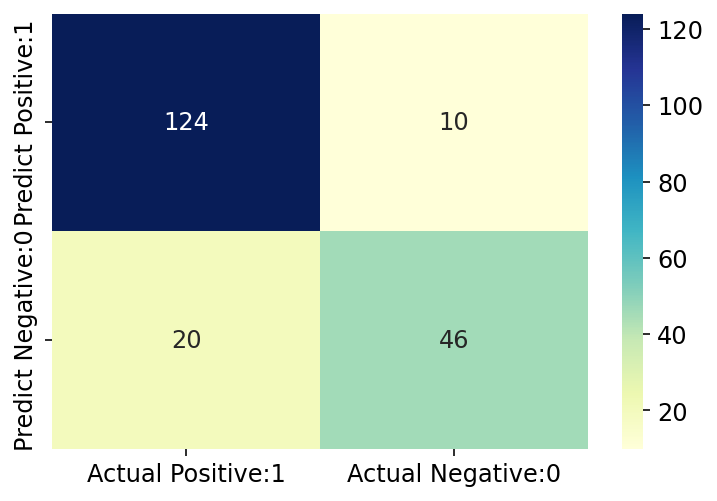

              precision    recall  f1-score   support

           0       0.86      0.93      0.89       134
           1       0.82      0.70      0.75        66

    accuracy                           0.85       200
   macro avg       0.84      0.81      0.82       200
weighted avg       0.85      0.85      0.85       200

Classification accuracy : 0.8500


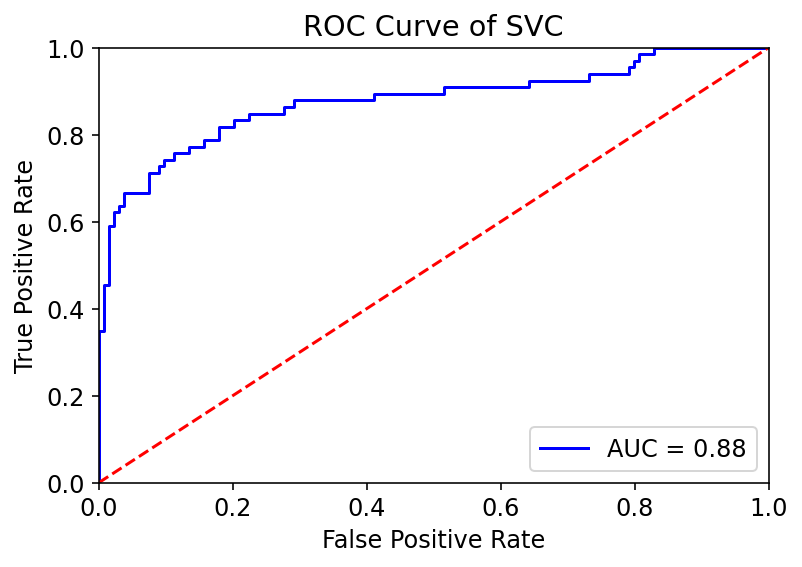

5000
Model accuracy score: 0.8770
Training-set accuracy score: 0.8685
Confusion matrix

 [[609  27]
 [ 96 268]]

True Positives(TP) =  609

True Negatives(TN) =  268

False Positives(FP) =  27

False Negatives(FN) =  96


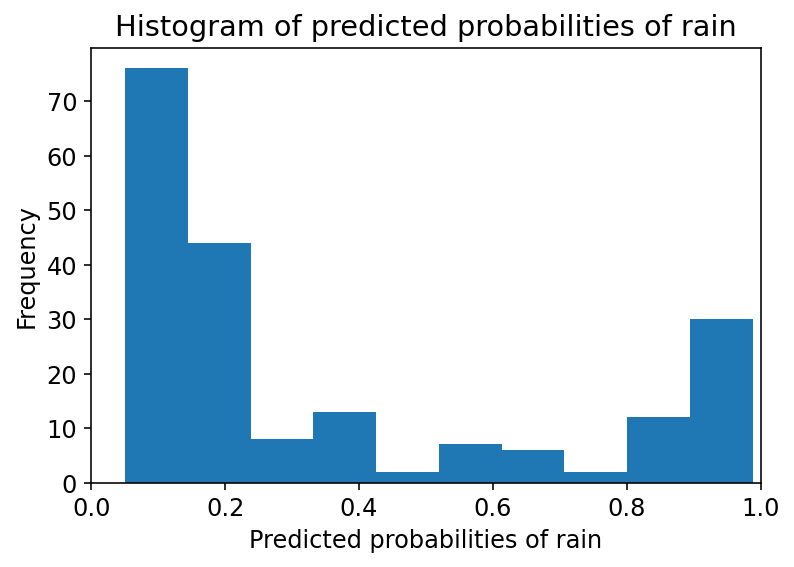

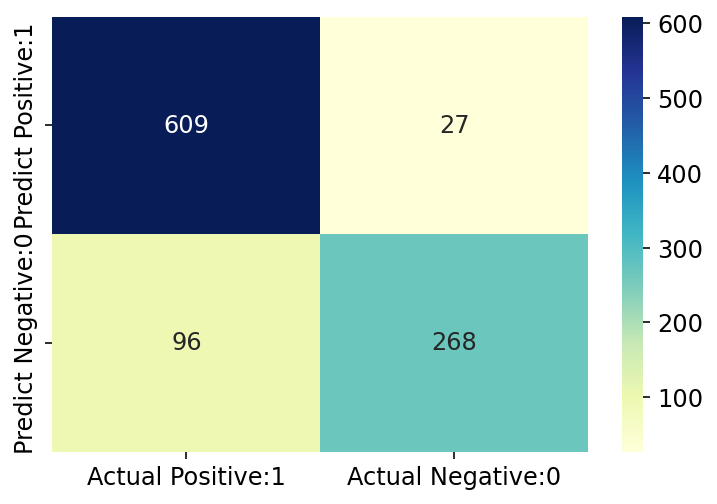

              precision    recall  f1-score   support

           0       0.86      0.96      0.91       636
           1       0.91      0.74      0.81       364

    accuracy                           0.88      1000
   macro avg       0.89      0.85      0.86      1000
weighted avg       0.88      0.88      0.87      1000

Classification accuracy : 0.8770


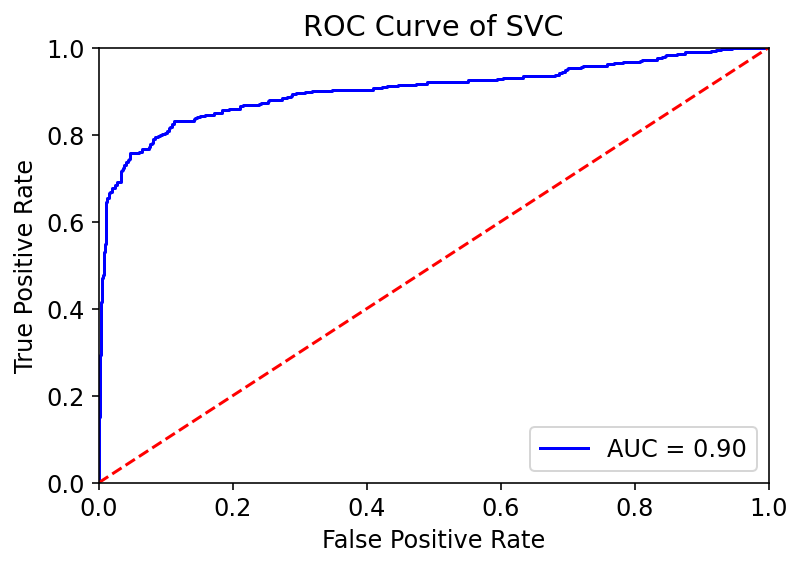

10000
Model accuracy score: 0.8635
Training-set accuracy score: 0.8770
Confusion matrix

 [[1186   71]
 [ 202  541]]

True Positives(TP) =  1186

True Negatives(TN) =  541

False Positives(FP) =  71

False Negatives(FN) =  202


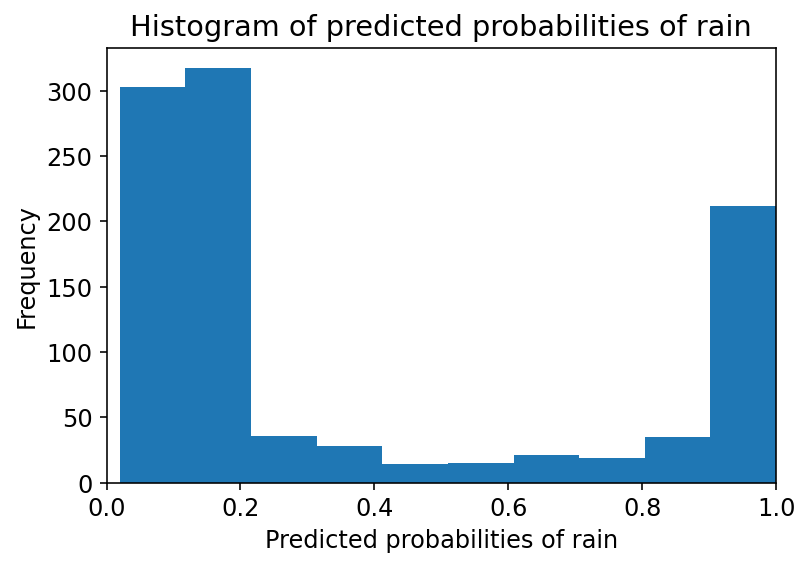

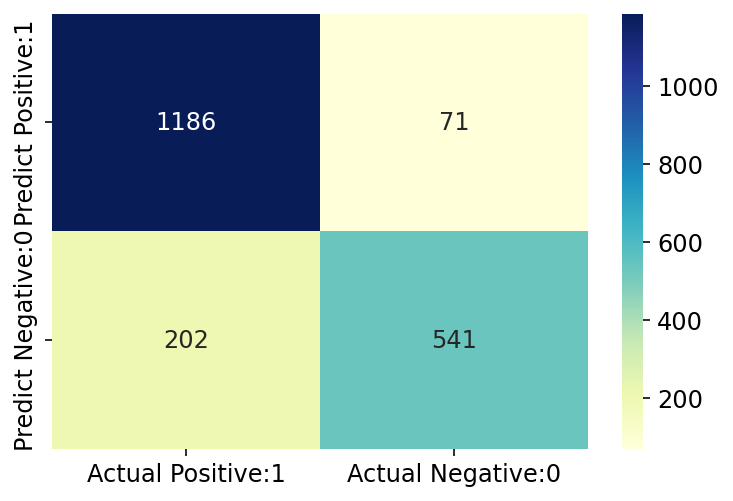

              precision    recall  f1-score   support

           0       0.85      0.94      0.90      1257
           1       0.88      0.73      0.80       743

    accuracy                           0.86      2000
   macro avg       0.87      0.84      0.85      2000
weighted avg       0.87      0.86      0.86      2000

Classification accuracy : 0.8635


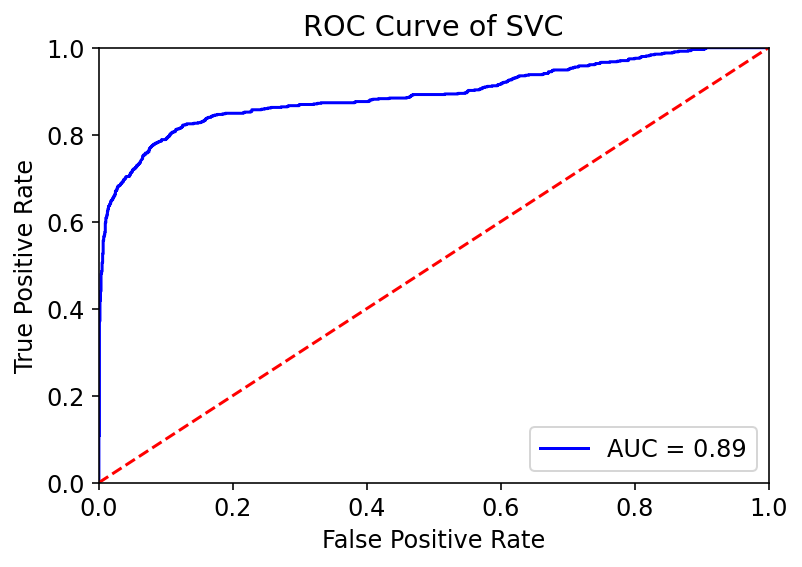

15000
Model accuracy score: 0.8693
Training-set accuracy score: 0.8780
Confusion matrix

 [[1768   79]
 [ 313  840]]

True Positives(TP) =  1768

True Negatives(TN) =  840

False Positives(FP) =  79

False Negatives(FN) =  313


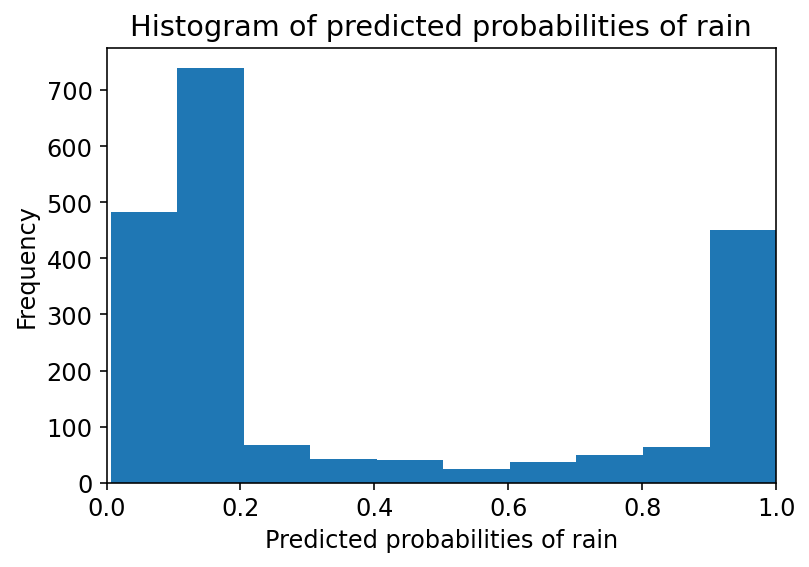

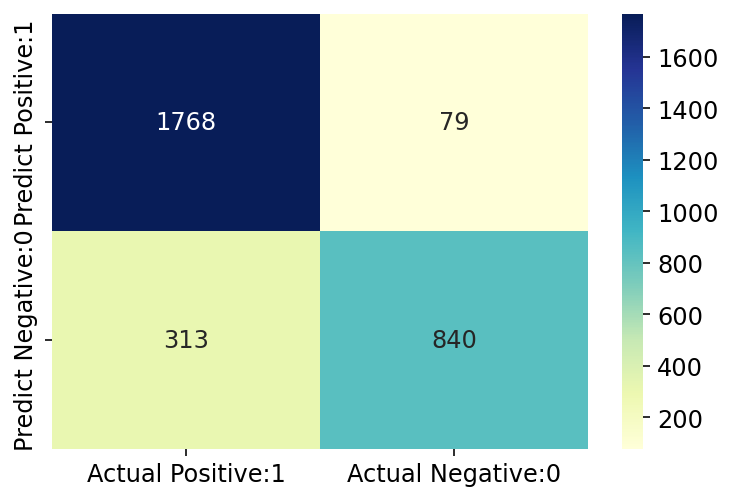

              precision    recall  f1-score   support

           0       0.85      0.96      0.90      1847
           1       0.91      0.73      0.81      1153

    accuracy                           0.87      3000
   macro avg       0.88      0.84      0.86      3000
weighted avg       0.87      0.87      0.87      3000

Classification accuracy : 0.8693


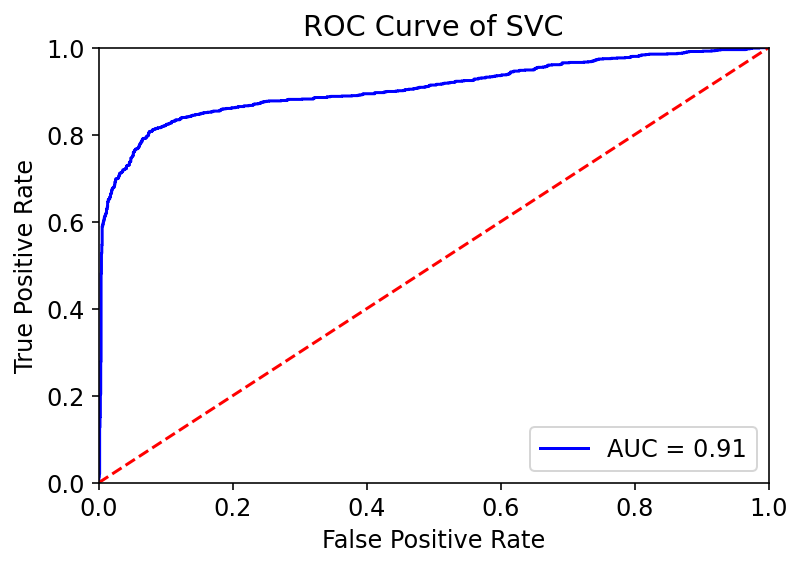

20000
Model accuracy score: 0.8840
Training-set accuracy score: 0.8796
Confusion matrix

 [[2386   95]
 [ 369 1150]]

True Positives(TP) =  2386

True Negatives(TN) =  1150

False Positives(FP) =  95

False Negatives(FN) =  369


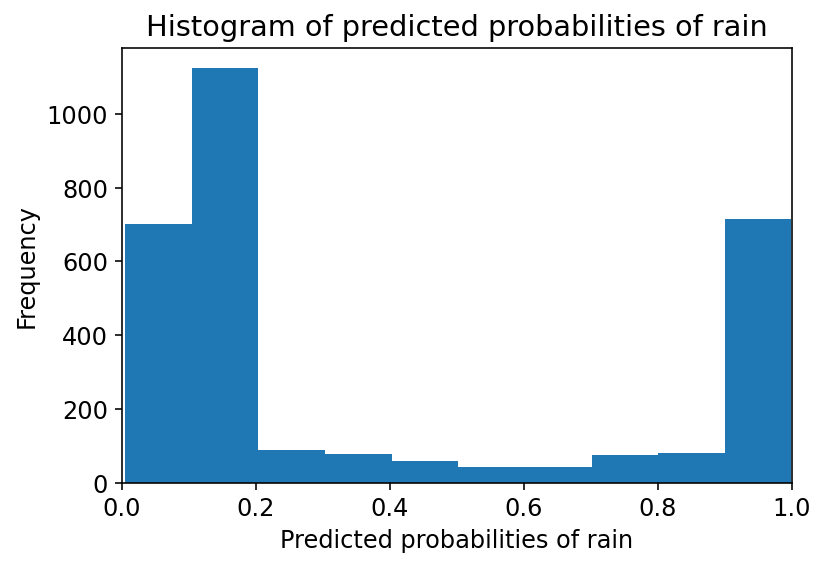

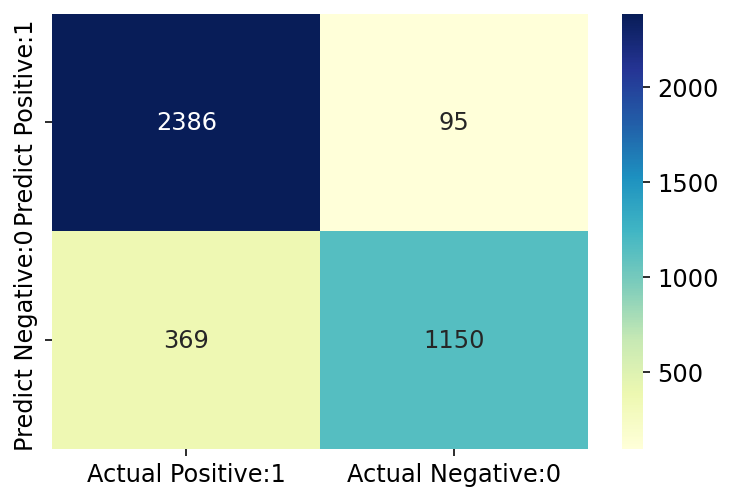

              precision    recall  f1-score   support

           0       0.87      0.96      0.91      2481
           1       0.92      0.76      0.83      1519

    accuracy                           0.88      4000
   macro avg       0.89      0.86      0.87      4000
weighted avg       0.89      0.88      0.88      4000

Classification accuracy : 0.8840


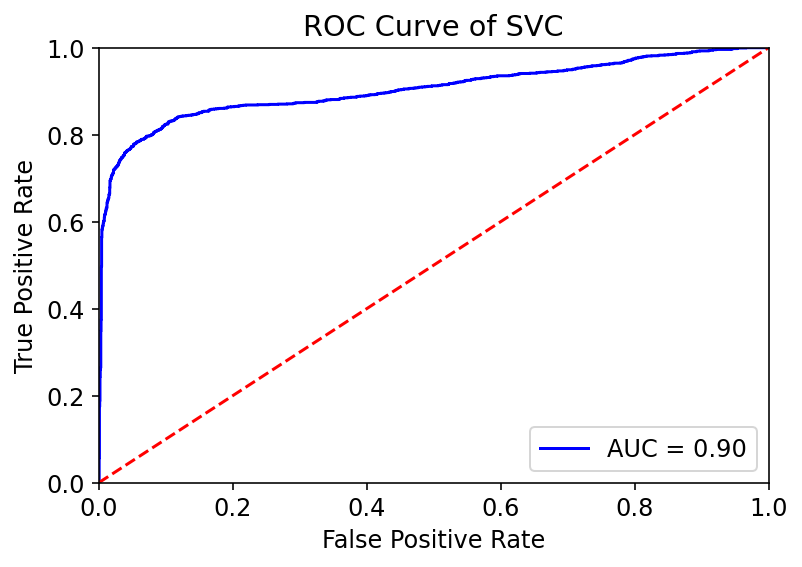

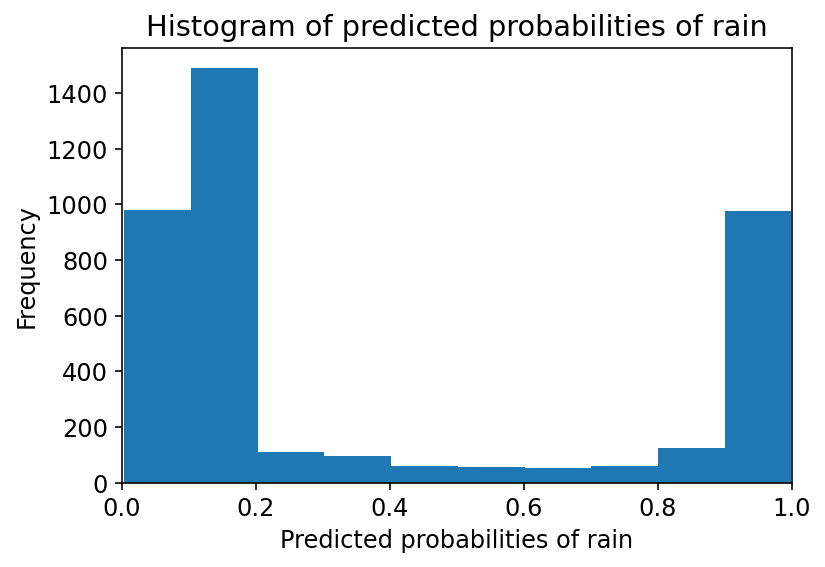

In [ ]:
from scipy.sparse import hstack
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD

for i in range(len(model_datas)):  
  df = model_datas[i]
  
  X = df.drop(['is_attributed','Year','Month','minute'], axis=1)
  y = df['is_attributed']
  print(len(X))

  
  columns = X.columns

  # X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
  # X = hstack((X,np.array(df['ip'])[:,None]))
  
  # lf = TruncatedSVD(10)
  # X = lf.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = (scaler.fit_transform(X_train))
  X_test = (scaler.transform(X_test))
  
  y_pred , y_pred_probab ,svc = SVC_mode(X_train , X_test , y_train, y_test)
  evalute_model_SVC(y_pred , y_pred_probab ,y_test)


  


1000
Model accuracy score: 0.8150
Training-set accuracy score: 0.8375
Confusion matrix

 [[110  24]
 [ 13  53]]

True Positives(TP) =  110

True Negatives(TN) =  53

False Positives(FP) =  24

False Negatives(FN) =  13


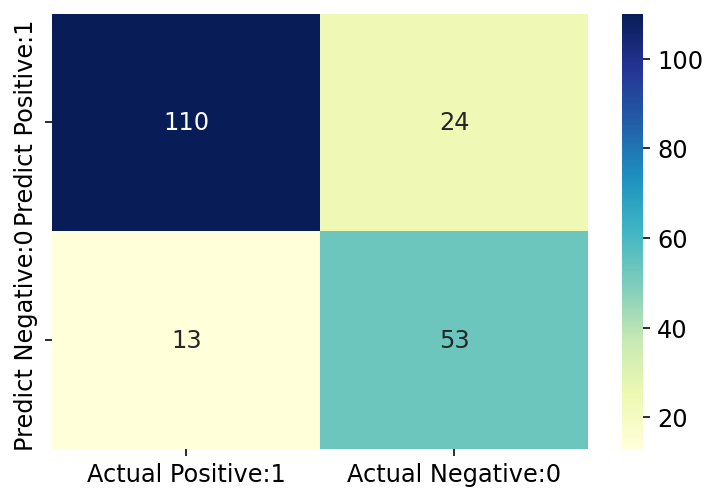

              precision    recall  f1-score   support

           0       0.89      0.82      0.86       134
           1       0.69      0.80      0.74        66

    accuracy                           0.81       200
   macro avg       0.79      0.81      0.80       200
weighted avg       0.83      0.81      0.82       200

Classification accuracy : 0.8150


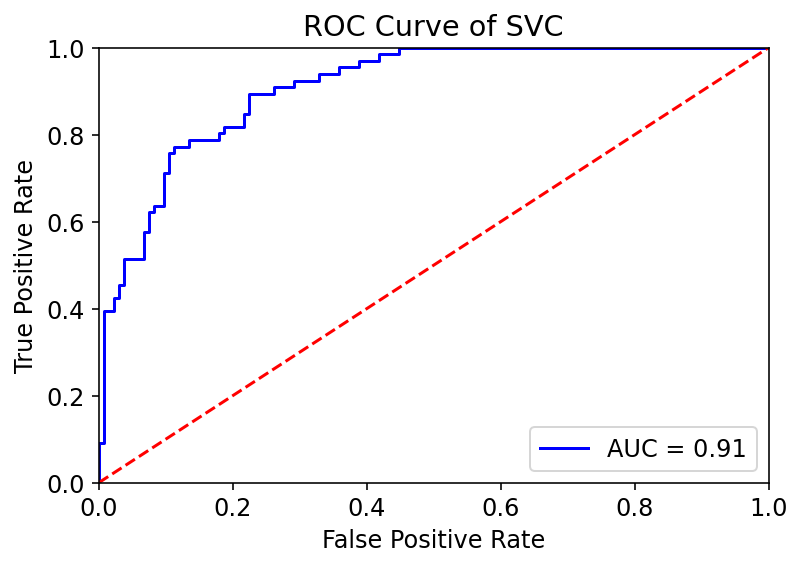

5000
Model accuracy score: 0.8450
Training-set accuracy score: 0.8385
Confusion matrix

 [[560  76]
 [ 79 285]]

True Positives(TP) =  560

True Negatives(TN) =  285

False Positives(FP) =  76

False Negatives(FN) =  79


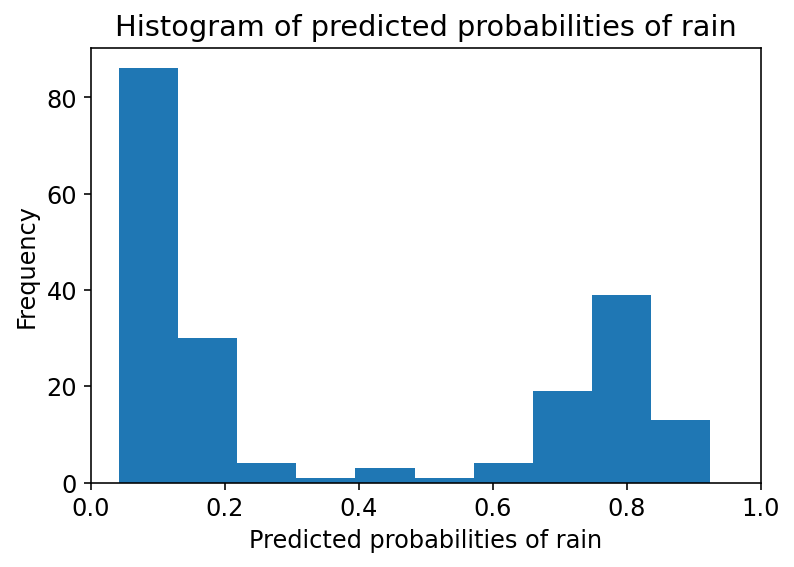

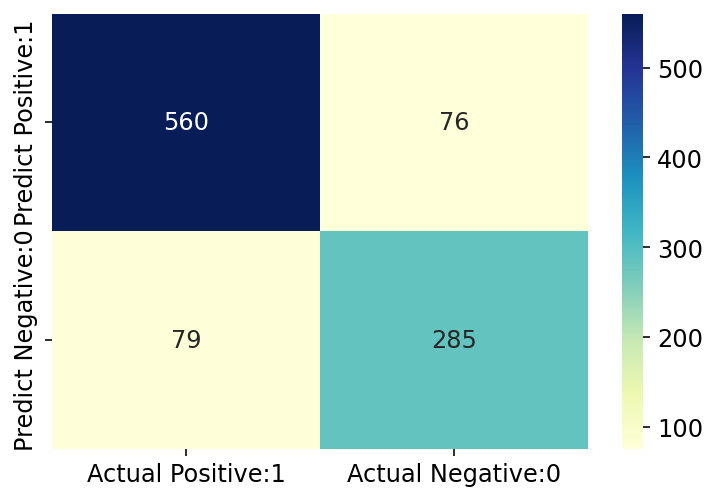

              precision    recall  f1-score   support

           0       0.88      0.88      0.88       636
           1       0.79      0.78      0.79       364

    accuracy                           0.84      1000
   macro avg       0.83      0.83      0.83      1000
weighted avg       0.84      0.84      0.84      1000

Classification accuracy : 0.8450


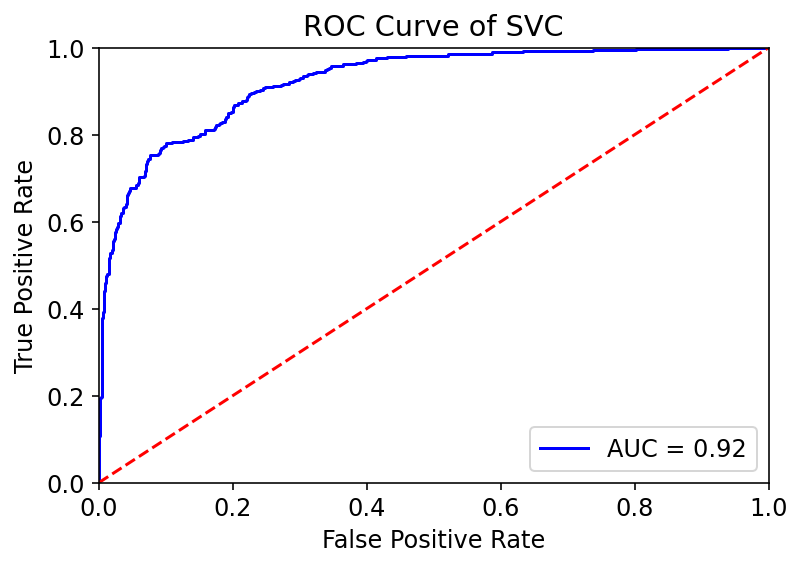

10000
Model accuracy score: 0.8345
Training-set accuracy score: 0.8427
Confusion matrix

 [[1107  150]
 [ 181  562]]

True Positives(TP) =  1107

True Negatives(TN) =  562

False Positives(FP) =  150

False Negatives(FN) =  181


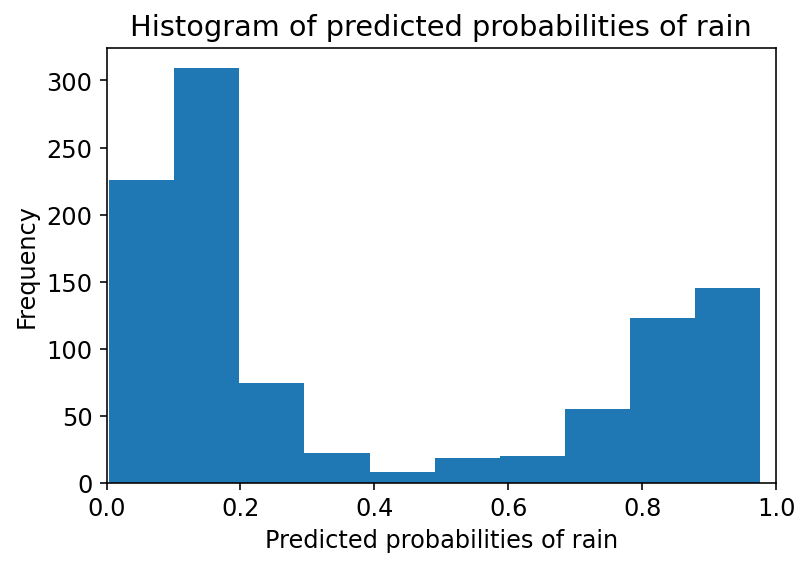

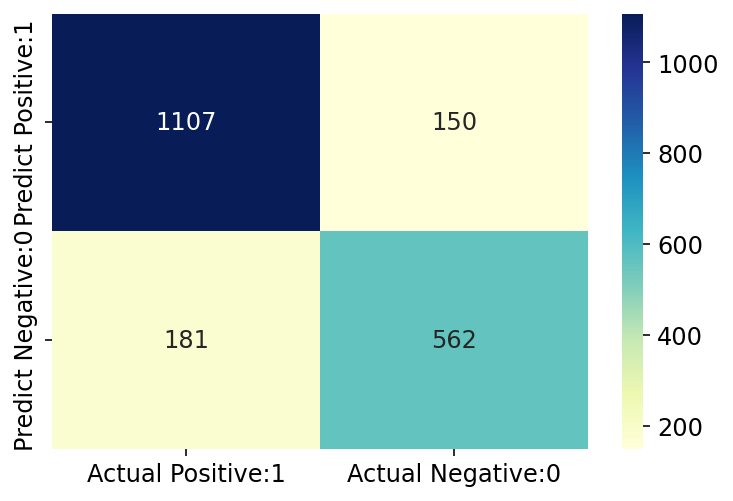

              precision    recall  f1-score   support

           0       0.86      0.88      0.87      1257
           1       0.79      0.76      0.77       743

    accuracy                           0.83      2000
   macro avg       0.82      0.82      0.82      2000
weighted avg       0.83      0.83      0.83      2000

Classification accuracy : 0.8345


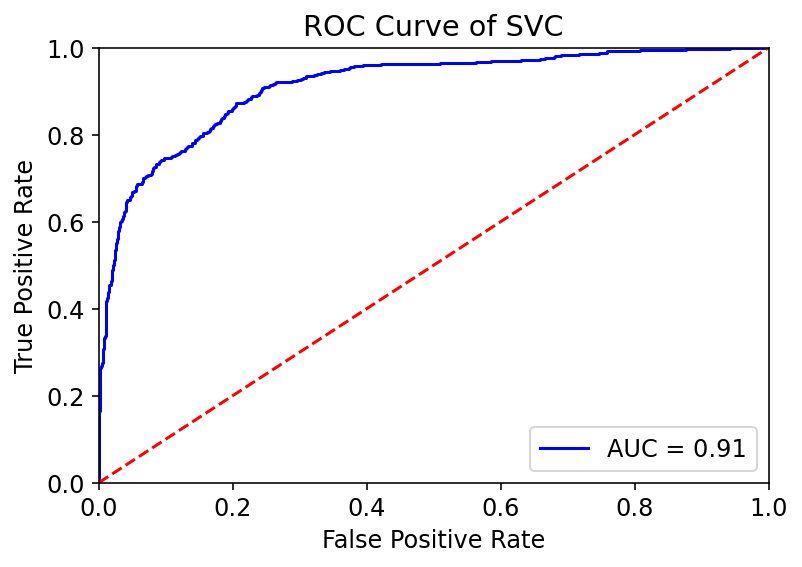

15000
Model accuracy score: 0.8417
Training-set accuracy score: 0.8433
Confusion matrix

 [[1647  200]
 [ 275  878]]

True Positives(TP) =  1647

True Negatives(TN) =  878

False Positives(FP) =  200

False Negatives(FN) =  275


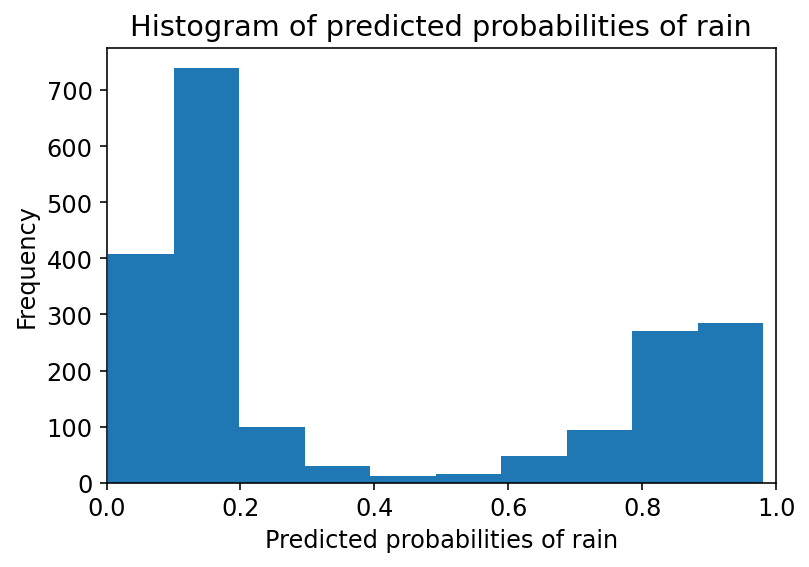

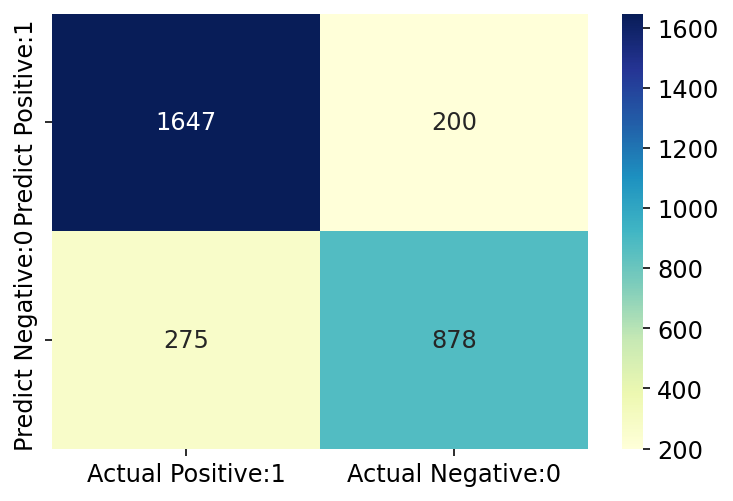

              precision    recall  f1-score   support

           0       0.86      0.89      0.87      1847
           1       0.81      0.76      0.79      1153

    accuracy                           0.84      3000
   macro avg       0.84      0.83      0.83      3000
weighted avg       0.84      0.84      0.84      3000

Classification accuracy : 0.8417


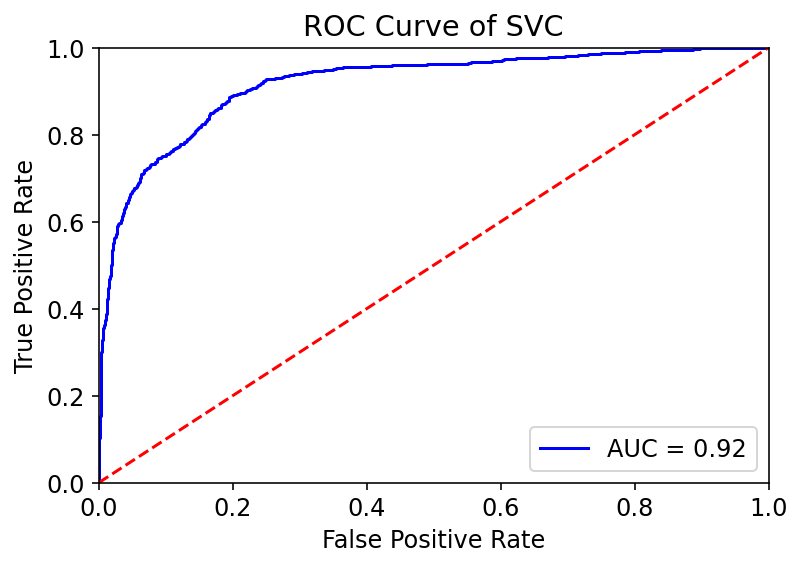

20000
Model accuracy score: 0.8450
Training-set accuracy score: 0.8441
Confusion matrix

 [[2224  257]
 [ 363 1156]]

True Positives(TP) =  2224

True Negatives(TN) =  1156

False Positives(FP) =  257

False Negatives(FN) =  363


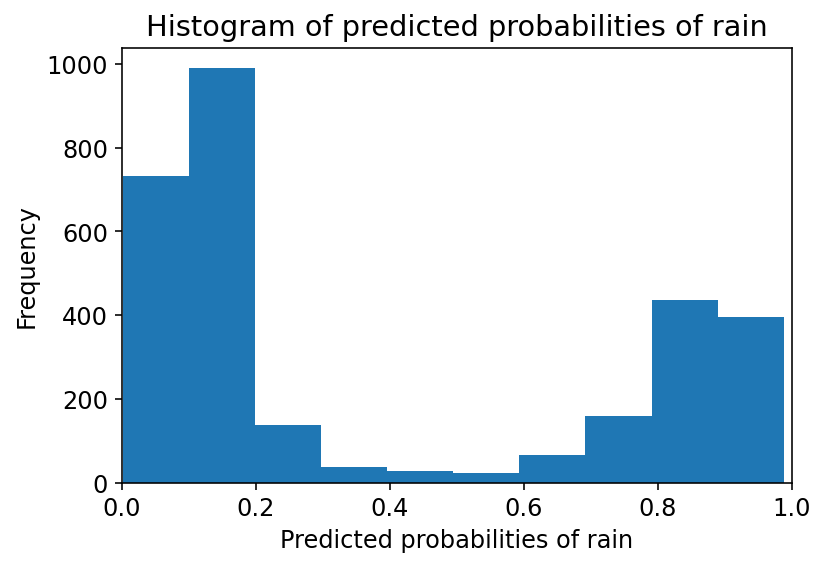

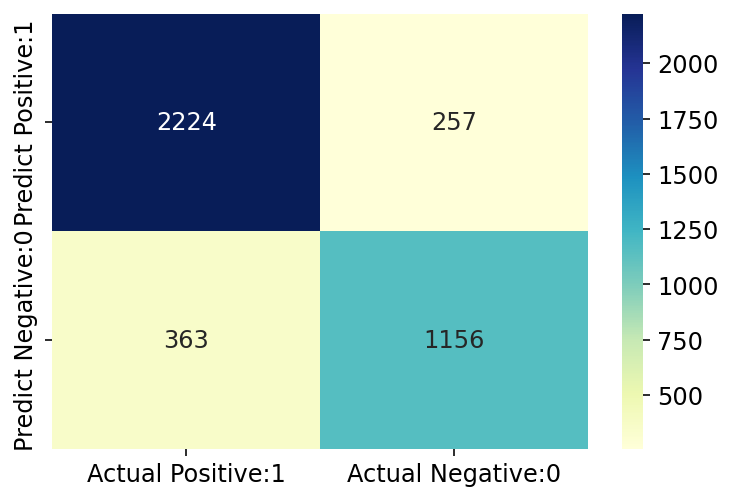

              precision    recall  f1-score   support

           0       0.86      0.90      0.88      2481
           1       0.82      0.76      0.79      1519

    accuracy                           0.84      4000
   macro avg       0.84      0.83      0.83      4000
weighted avg       0.84      0.84      0.84      4000

Classification accuracy : 0.8450


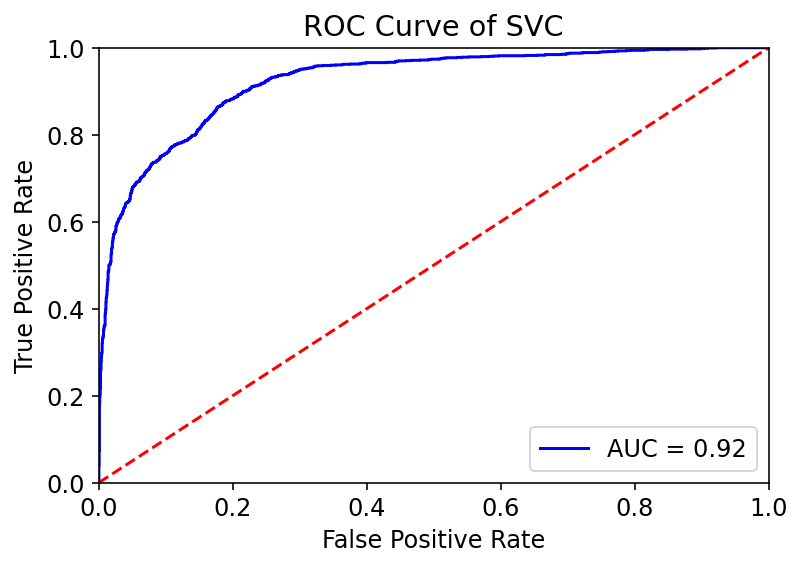

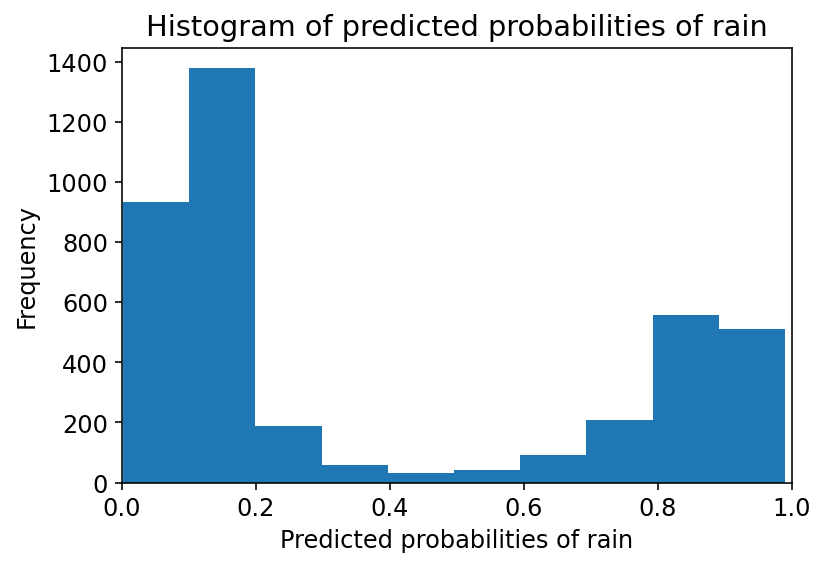

In [ ]:
from scipy.sparse import hstack
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD

for i in range(len(model_datas)):  
  df = model_datas[i]
  
  X = df.drop(['is_attributed','Year','Month','minute'], axis=1)
  y = df['is_attributed']
  print(len(X))

  
  columns = X.columns

  X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
  X = hstack((X,np.array(df['ip'])[:,None]))
  
  lf = TruncatedSVD(10)
  X = lf.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = (scaler.fit_transform(X_train))
  X_test = (scaler.transform(X_test))
  
  y_pred , y_pred_probab ,svc = SVC_mode(X_train , X_test , y_train, y_test)
  evalute_model_SVC(y_pred , y_pred_probab ,y_test)



In [ ]:
l = resample_data(test,10000)

10000
Model accuracy score: 0.9815
Training-set accuracy score: 0.9878
Confusion matrix

 [[1910    8]
 [  29   53]]

True Positives(TP) =  1910

True Negatives(TN) =  53

False Positives(FP) =  8

False Negatives(FN) =  29


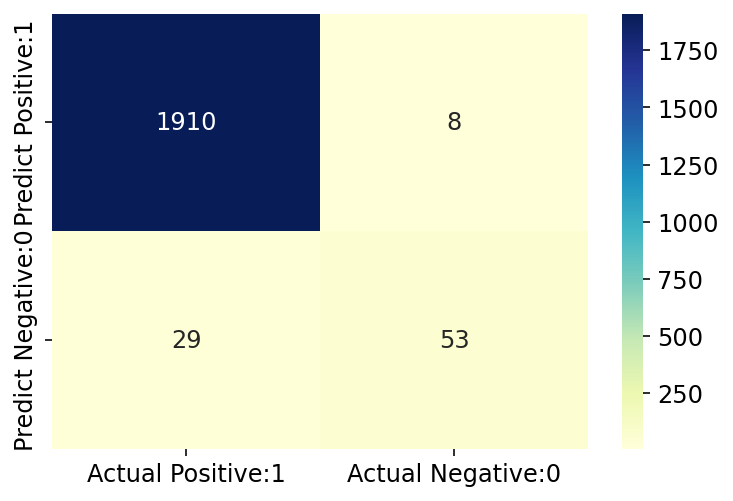

              precision    recall  f1-score   support

           0       0.99      1.00      0.99      1918
           1       0.87      0.65      0.74        82

    accuracy                           0.98      2000
   macro avg       0.93      0.82      0.87      2000
weighted avg       0.98      0.98      0.98      2000

Classification accuracy : 0.9815


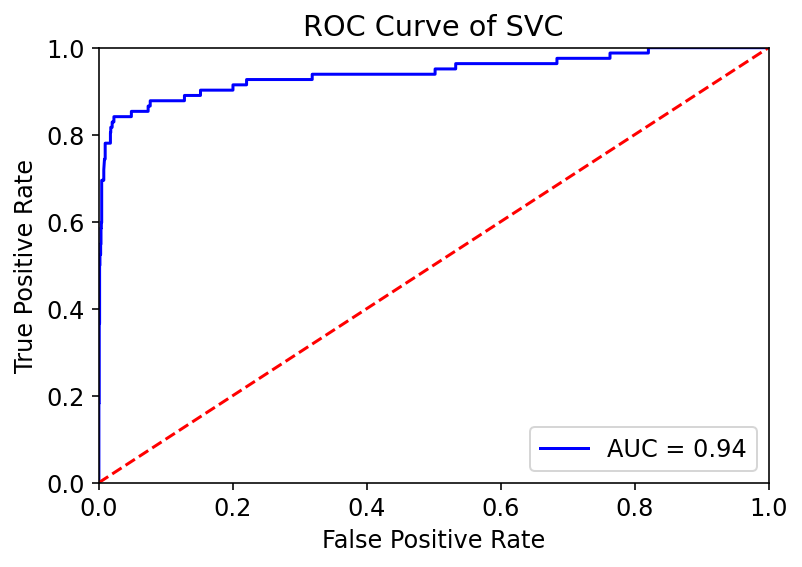

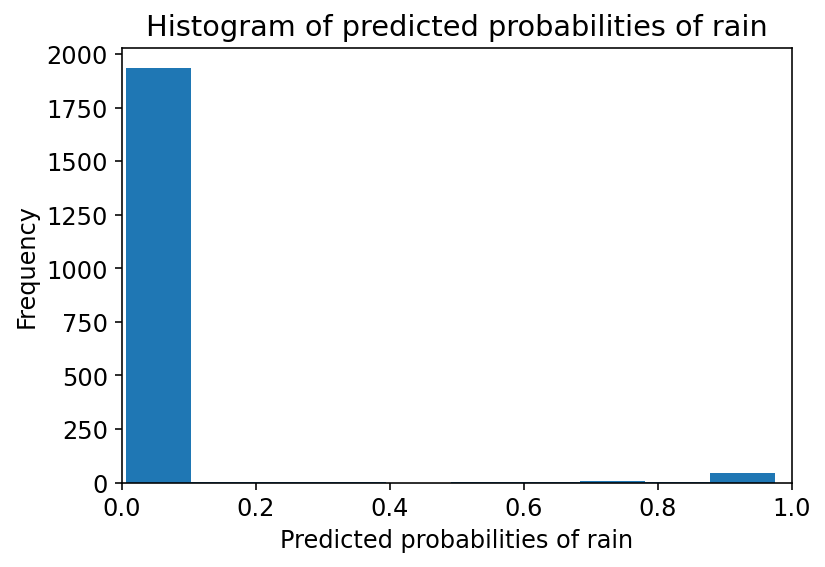

In [ ]:
X = l.drop(['is_attributed','Year','Month','minute'], axis=1)
y = l['is_attributed']
print(len(X))

  
columns = X.columns

X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
X = hstack((X,np.array(l['ip'])[:,None]))
  
lf = TruncatedSVD(260)
X = lf.fit_transform(X)

X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
scaler = StandardScaler()
X_train = (scaler.fit_transform(X_train))
X_test = (scaler.transform(X_test))

y_pred , y_pred_probab ,log = SVC_mode(X_train , X_test , y_train, y_test)
evalute_model_SVC(y_pred , y_pred_probab ,y_test)

1000
Model accuracy score: 0.8400
Training-set accuracy score: 0.8400
Confusion matrix

 [[122  12]
 [ 20  46]]

True Positives(TP) =  122

True Negatives(TN) =  46

False Positives(FP) =  12

False Negatives(FN) =  20


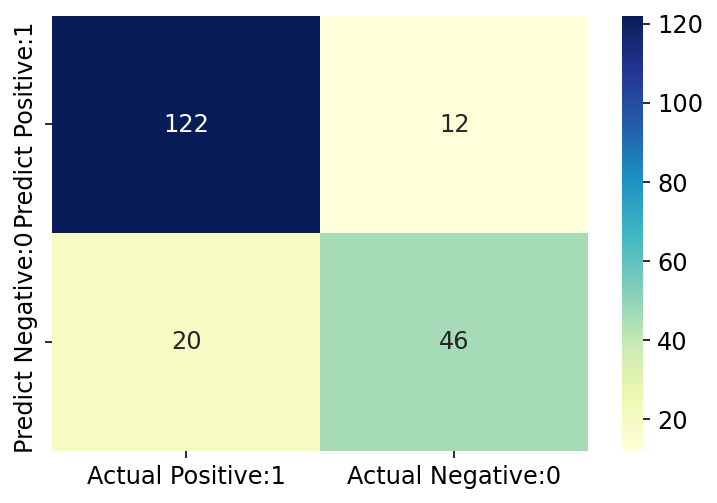

              precision    recall  f1-score   support

           0       0.86      0.91      0.88       134
           1       0.79      0.70      0.74        66

    accuracy                           0.84       200
   macro avg       0.83      0.80      0.81       200
weighted avg       0.84      0.84      0.84       200

Classification accuracy : 0.8400


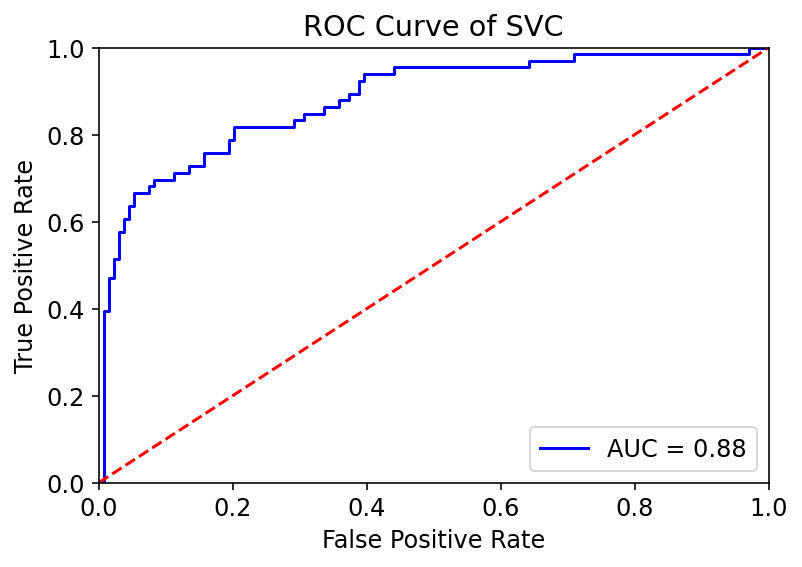

5000
Model accuracy score: 0.8370
Training-set accuracy score: 0.8305
Confusion matrix

 [[597  39]
 [124 240]]

True Positives(TP) =  597

True Negatives(TN) =  240

False Positives(FP) =  39

False Negatives(FN) =  124


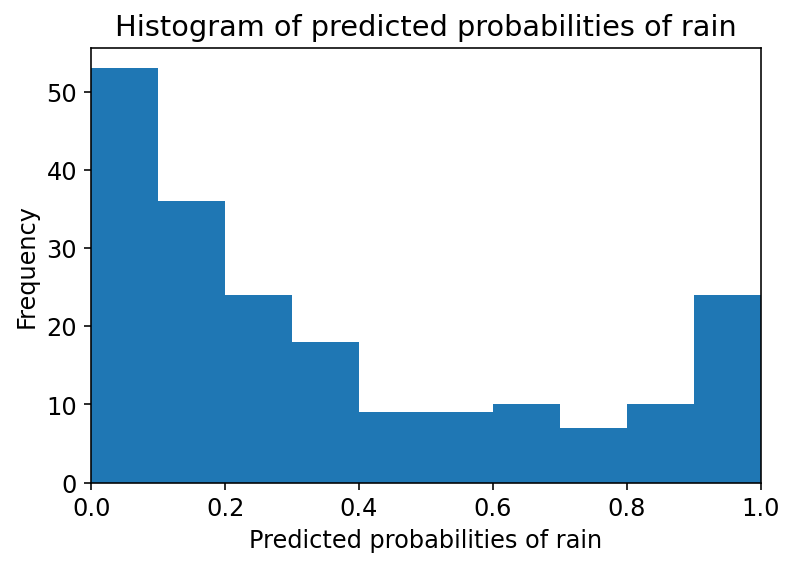

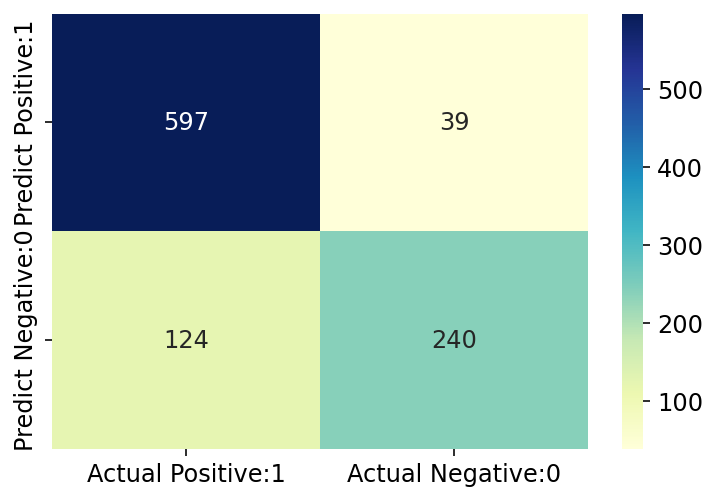

              precision    recall  f1-score   support

           0       0.83      0.94      0.88       636
           1       0.86      0.66      0.75       364

    accuracy                           0.84      1000
   macro avg       0.84      0.80      0.81      1000
weighted avg       0.84      0.84      0.83      1000

Classification accuracy : 0.8370


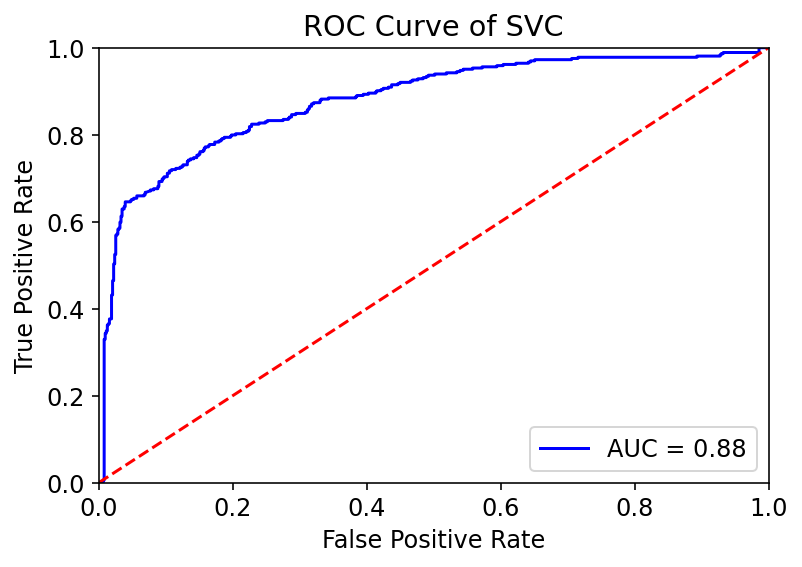

10000
Model accuracy score: 0.8265
Training-set accuracy score: 0.8324
Confusion matrix

 [[1157  100]
 [ 247  496]]

True Positives(TP) =  1157

True Negatives(TN) =  496

False Positives(FP) =  100

False Negatives(FN) =  247


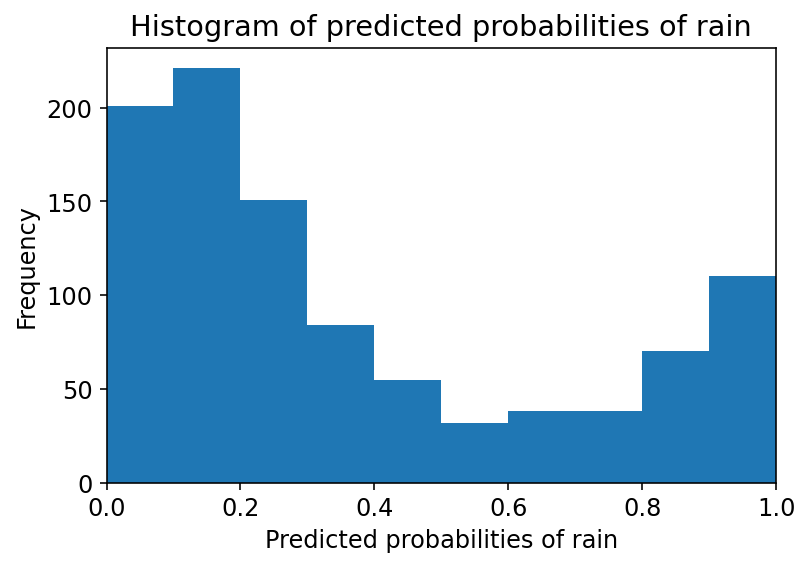

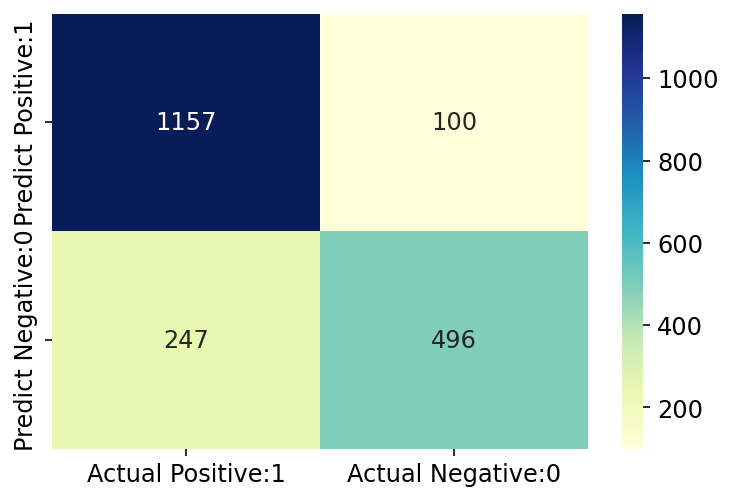

              precision    recall  f1-score   support

           0       0.82      0.92      0.87      1257
           1       0.83      0.67      0.74       743

    accuracy                           0.83      2000
   macro avg       0.83      0.79      0.81      2000
weighted avg       0.83      0.83      0.82      2000

Classification accuracy : 0.8265


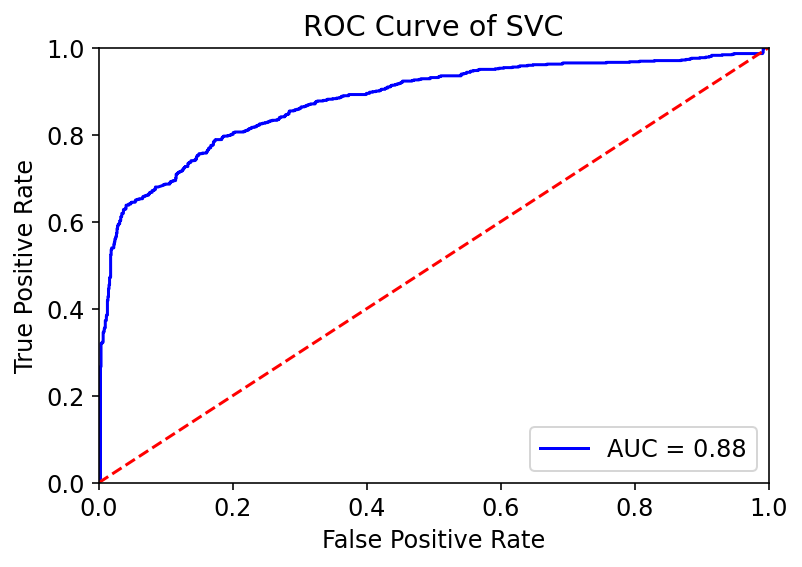

15000
Model accuracy score: 0.8317
Training-set accuracy score: 0.8341
Confusion matrix

 [[1712  135]
 [ 370  783]]

True Positives(TP) =  1712

True Negatives(TN) =  783

False Positives(FP) =  135

False Negatives(FN) =  370


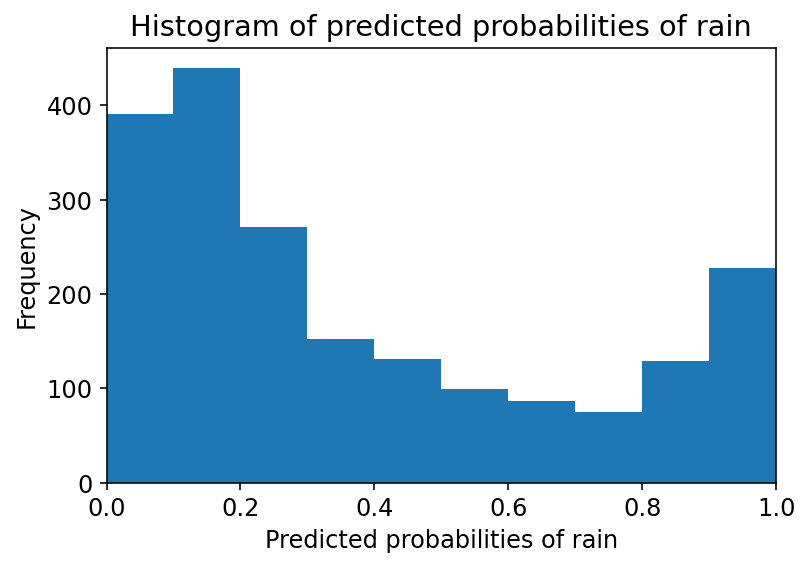

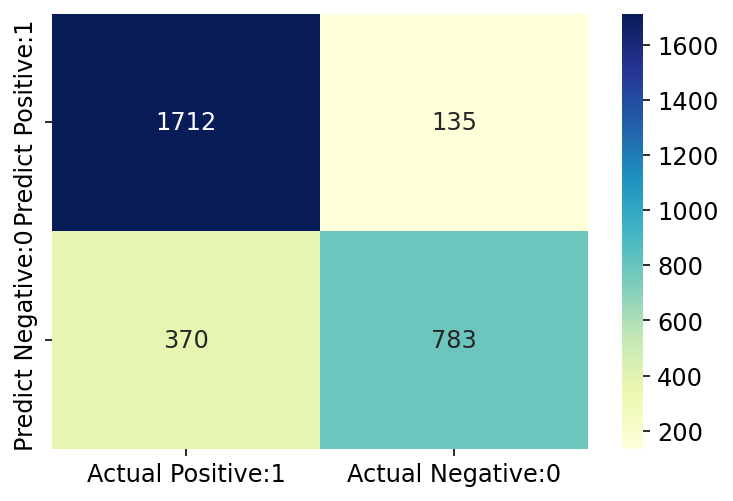

              precision    recall  f1-score   support

           0       0.82      0.93      0.87      1847
           1       0.85      0.68      0.76      1153

    accuracy                           0.83      3000
   macro avg       0.84      0.80      0.81      3000
weighted avg       0.83      0.83      0.83      3000

Classification accuracy : 0.8317


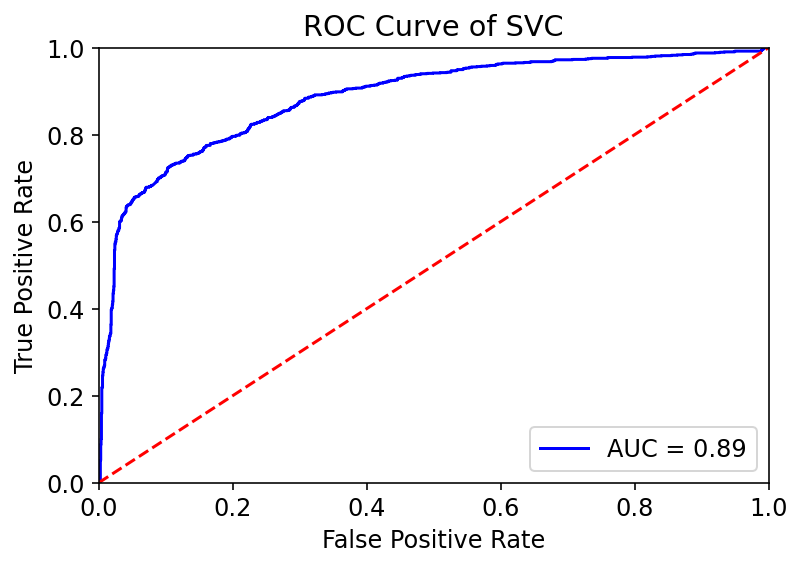

20000
Model accuracy score: 0.8417
Training-set accuracy score: 0.8357
Confusion matrix

 [[2309  172]
 [ 461 1058]]

True Positives(TP) =  2309

True Negatives(TN) =  1058

False Positives(FP) =  172

False Negatives(FN) =  461


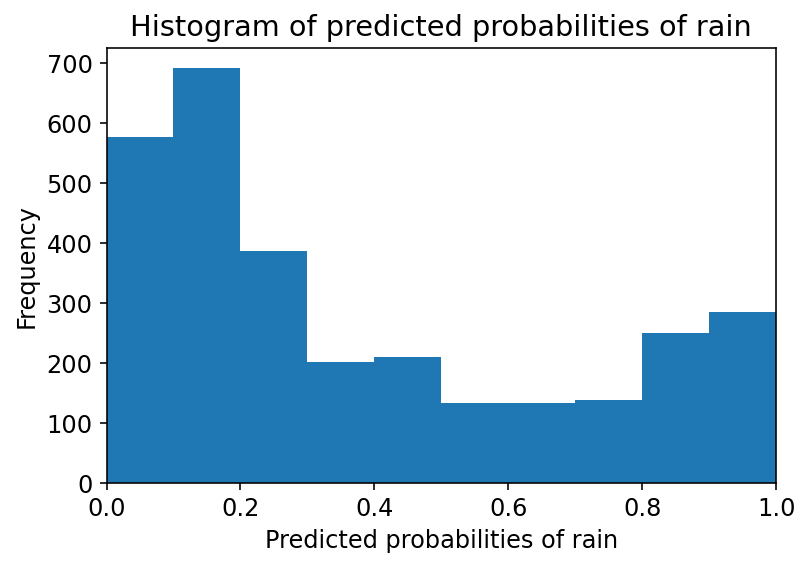

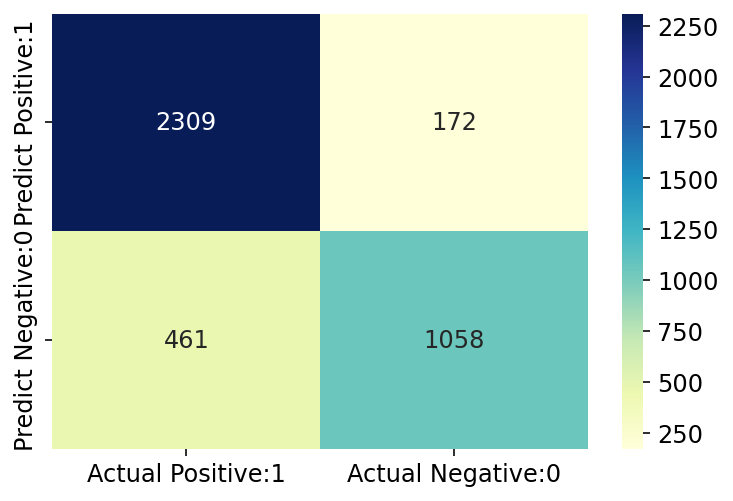

              precision    recall  f1-score   support

           0       0.83      0.93      0.88      2481
           1       0.86      0.70      0.77      1519

    accuracy                           0.84      4000
   macro avg       0.85      0.81      0.82      4000
weighted avg       0.84      0.84      0.84      4000

Classification accuracy : 0.8417


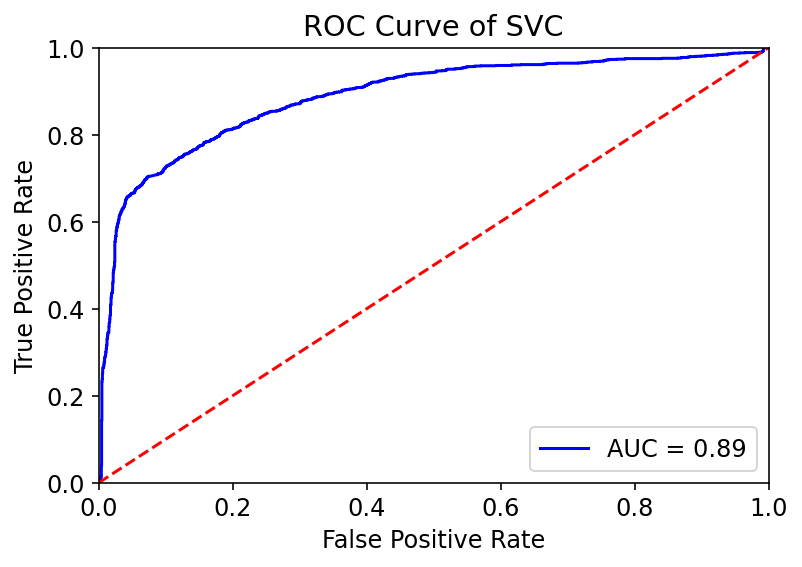

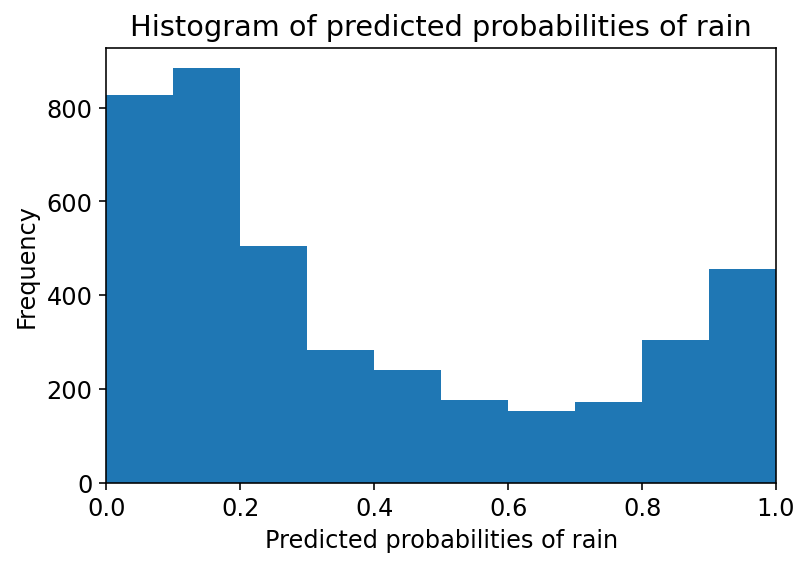

In [ ]:
from scipy.sparse import hstack
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD

for i in range(len(model_datas)):  
  df = model_datas[i]
  
  X = df.drop(['is_attributed','Year','Month','minute'], axis=1)
  y = df['is_attributed']
  print(len(X))

  
  columns = X.columns

  # X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
  # X = hstack((X,np.array(df['ip'])[:,None]))
  
  # lf = TruncatedSVD(10)
  # X = lf.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = (scaler.fit_transform(X_train))
  X_test = (scaler.transform(X_test))
  
  y_pred , y_pred_probab ,svc = SVC_mode(X_train , X_test , y_train, y_test)
  evalute_model_SVC(y_pred , y_pred_probab ,y_test)


  

In [ ]:
kernels = ['linear', 'rbf', 'poly']

def SVC_mode(X_train, X_test, y_train, y_test):
  svc=SVC(probability=True,kernel='poly') 
  svc.fit(X_train, y_train)
  y_pred=svc.predict(X_test)
  y_pred_probab = svc.predict_proba(X_test)
  print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test, y_pred)))
  y_pred_train = svc.predict(X_train)
  print('Training-set accuracy score: {0:0.4f}'. format(accuracy_score(y_train, y_pred_train)))
  return y_pred , y_pred_probab , svc

15000
Model accuracy score: 0.8387
Training-set accuracy score: 0.8429
Confusion matrix

 [[1616  231]
 [ 253  900]]

True Positives(TP) =  1616

True Negatives(TN) =  900

False Positives(FP) =  231

False Negatives(FN) =  253


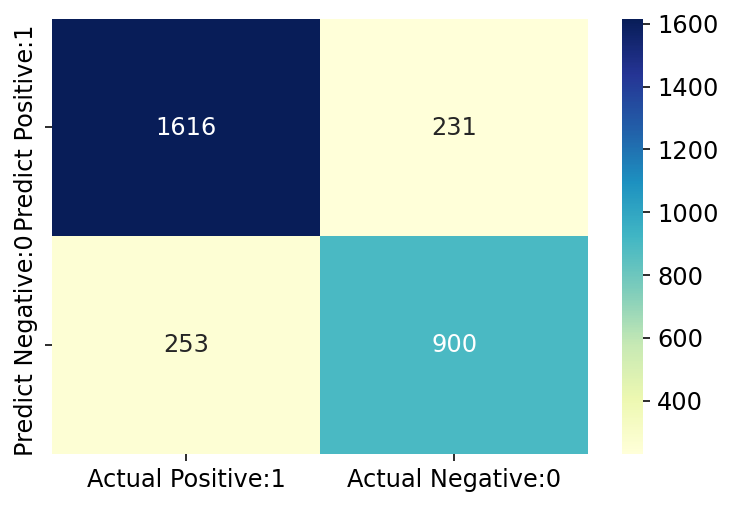

              precision    recall  f1-score   support

           0       0.86      0.87      0.87      1847
           1       0.80      0.78      0.79      1153

    accuracy                           0.84      3000
   macro avg       0.83      0.83      0.83      3000
weighted avg       0.84      0.84      0.84      3000

Classification accuracy : 0.8387


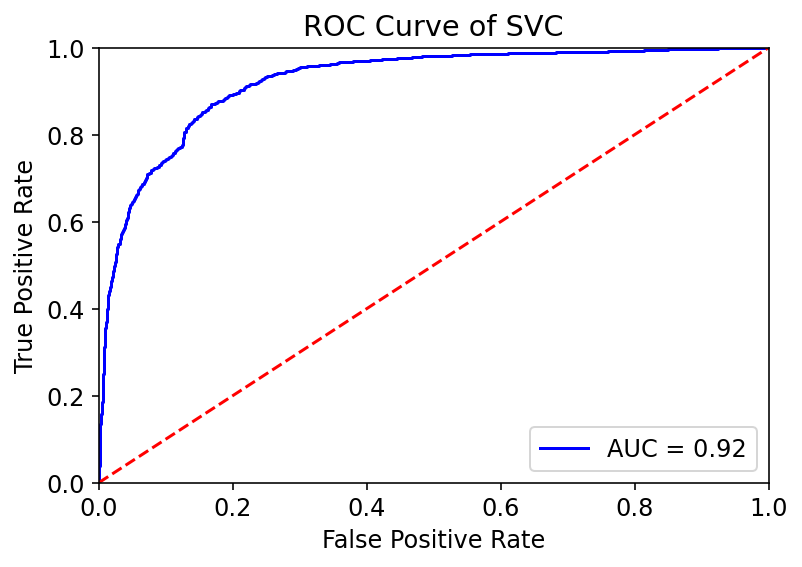

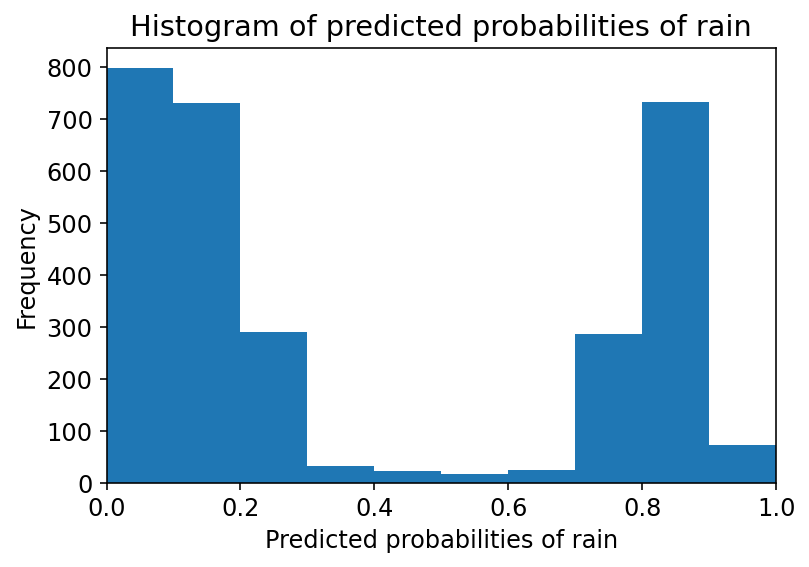

In [ ]:
l = model_datas[3]
X = l.drop(['is_attributed','Year','Month','minute'], axis=1)
y = l['is_attributed']
print(len(X))

  
columns = X.columns

X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
X = hstack((X,np.array(l['ip'])[:,None]))
  
lf = TruncatedSVD(15)
X = lf.fit_transform(X)

X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
scaler = StandardScaler()
X_train = (scaler.fit_transform(X_train))
X_test = (scaler.transform(X_test))

y_pred , y_pred_probab ,log = SVC_mode(X_train , X_test , y_train, y_test)
evalute_model_SVC(y_pred , y_pred_probab ,y_test)

# KNN

In [ ]:
df1.drop(columns=['Year','Month','minute'],inplace=True)

In [ ]:
df1['ip'] = df1['ip'].astype(int)

In [ ]:
for i in df1.columns:
  df1[i] = df1[i].astype(int)

In [ ]:
temp=resample_data(df1,100000)

In [ ]:
X = temp.drop(['is_attributed','ip'], axis=1)

y = temp['is_attributed']

In [ ]:
from sklearn.preprocessing import OneHotEncoder

X = OneHotEncoder().fit_transform(X)

In [ ]:
# split X and y into training and testing sets

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

In [ ]:
X_train.shape, X_test.shape

((80000, 6), (20000, 6))

In [ ]:
cols = X_train.columns

In [ ]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

X_train = scaler.fit_transform(X_train)

X_test = scaler.transform(X_test)

In [ ]:
X_train = pd.DataFrame(X_train, columns=[cols])

In [ ]:
X_test = pd.DataFrame(X_test, columns=[cols])

In [ ]:
X_train.head()

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

def knn_model(X_train, X_test, y_train, y_test, n_neighbors = 4):
  knn = KNeighborsClassifier(n_neighbors=n_neighbors)
  knn.fit(X_train, y_train)
  y_pred = knn.predict(X_test)
  y_pred_probab = knn.predict_proba(X_test)
  print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test, y_pred)))
  y_pred_train = knn.predict(X_train)
  print('Training-set accuracy score: {0:0.4f}'. format(accuracy_score(y_train, y_pred_train)))
  return y_pred , y_pred_probab

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_curve
from sklearn.metrics import auc

def evalute_mode(y_pred , y_pred_probab ,y_test):
  cm = confusion_matrix(y_test, y_pred)
  TP = cm[0,0]
  TN = cm[1,1]
  FP = cm[0,1]
  FN = cm[1,0]
  print('Confusion matrix\n\n', cm)
  print('\nTrue Positives(TP) = ', cm[0,0])
  print('\nTrue Negatives(TN) = ', cm[1,1])
  print('\nFalse Positives(FP) = ', cm[0,1])
  print('\nFalse Negatives(FN) = ', cm[1,0])
  print("_____________________________________________________________________________")

  plt.figure(figsize=(6,4))
  cm_matrix = pd.DataFrame(data=cm, columns=['Actual Positive:1', 'Actual Negative:0'], 
                                  index=['Predict Positive:1', 'Predict Negative:0'])
  sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')
  plt.show()
  print("_____________________________________________________________________________")
  print(classification_report(y_test, y_pred))
  print("_____________________________________________________________________________")
  classification_accuracy = (TP + TN) / float(TP + TN + FP + FN)
  print('Classification accuracy : {0:0.4f}'.format(classification_accuracy))
  print("_____________________________________________________________________________")
  fpr, tpr, threshold = roc_curve(y_test, y_pred_probab[:,1])
  roc_auc = auc(fpr, tpr)

  plt.title('Receiver Operating Characteristic')
  plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
  plt.legend(loc = 'lower right')
  plt.plot([0, 1], [0, 1],'r--')
  plt.xlim([0, 1])
  plt.ylim([0, 1])
  plt.ylabel('True Positive Rate')
  plt.xlabel('False Positive Rate')
  plt.title('ROC Curve of kNN')
  plt.show()

  print("========================================================================")


K -----> 1
Model accuracy score: 0.9416
Training-set accuracy score: 0.9920
Confusion matrix

 [[12040   393]
 [  775  6792]]

True Positives(TP) =  12040

True Negatives(TN) =  6792

False Positives(FP) =  393

False Negatives(FN) =  775


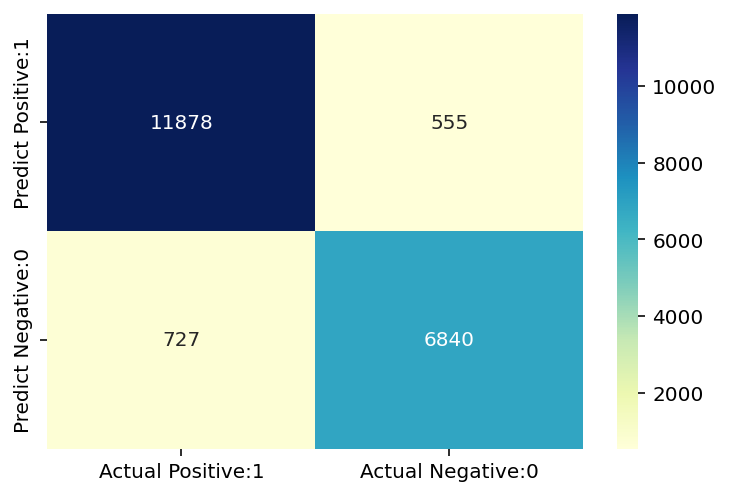

              precision    recall  f1-score   support

           0       0.94      0.97      0.95     12433
           1       0.95      0.90      0.92      7567

    accuracy                           0.94     20000
   macro avg       0.94      0.93      0.94     20000
weighted avg       0.94      0.94      0.94     20000

Classification accuracy : 0.9359


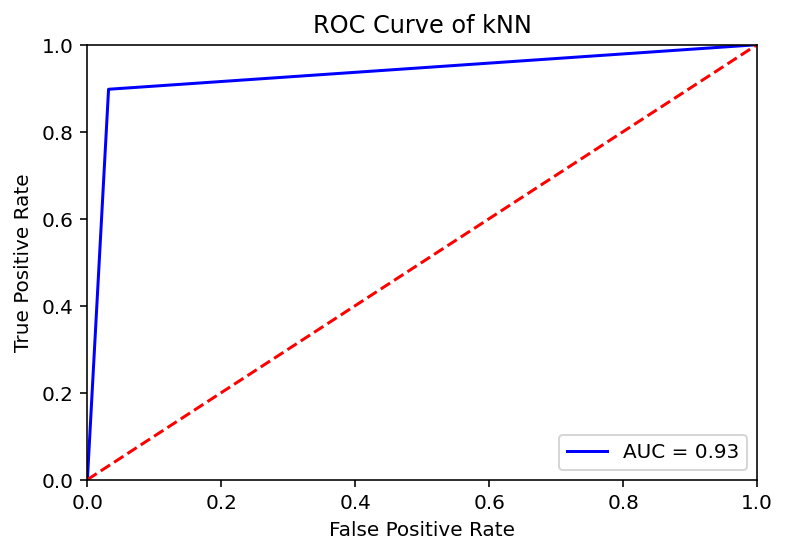

K -----> 2
Model accuracy score: 0.9371
Training-set accuracy score: 0.9596
Confusion matrix

 [[12293   140]
 [ 1119  6448]]

True Positives(TP) =  12293

True Negatives(TN) =  6448

False Positives(FP) =  140

False Negatives(FN) =  1119


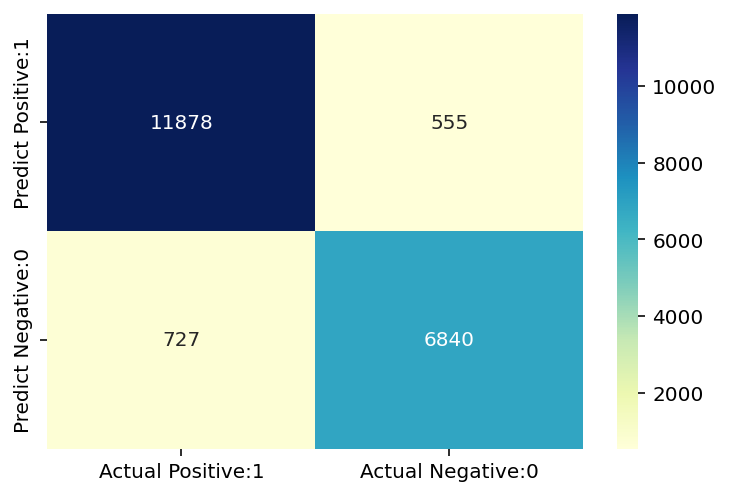

              precision    recall  f1-score   support

           0       0.92      0.99      0.95     12433
           1       0.98      0.85      0.91      7567

    accuracy                           0.94     20000
   macro avg       0.95      0.92      0.93     20000
weighted avg       0.94      0.94      0.94     20000

Classification accuracy : 0.9359


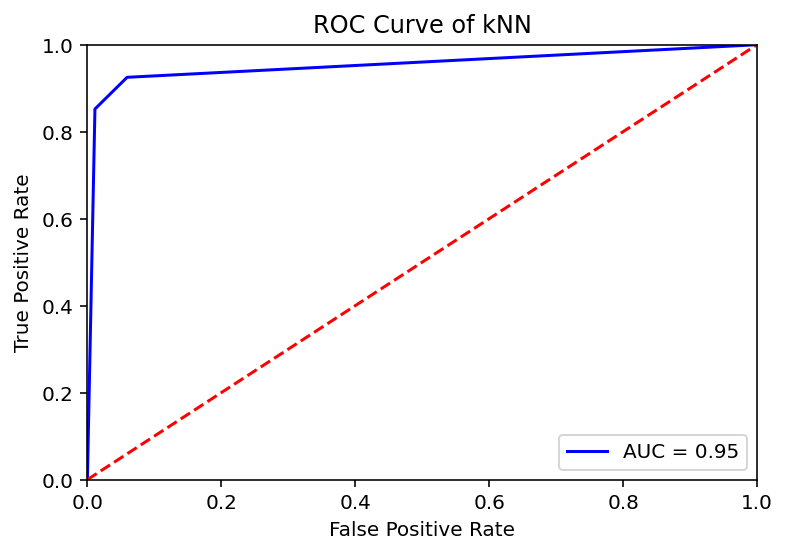

K -----> 3
Model accuracy score: 0.9470
Training-set accuracy score: 0.9640
Confusion matrix

 [[12190   243]
 [  817  6750]]

True Positives(TP) =  12190

True Negatives(TN) =  6750

False Positives(FP) =  243

False Negatives(FN) =  817


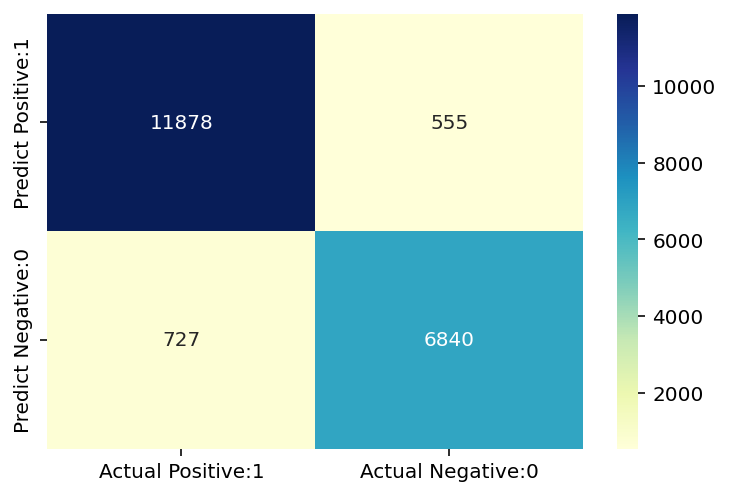

              precision    recall  f1-score   support

           0       0.94      0.98      0.96     12433
           1       0.97      0.89      0.93      7567

    accuracy                           0.95     20000
   macro avg       0.95      0.94      0.94     20000
weighted avg       0.95      0.95      0.95     20000

Classification accuracy : 0.9359


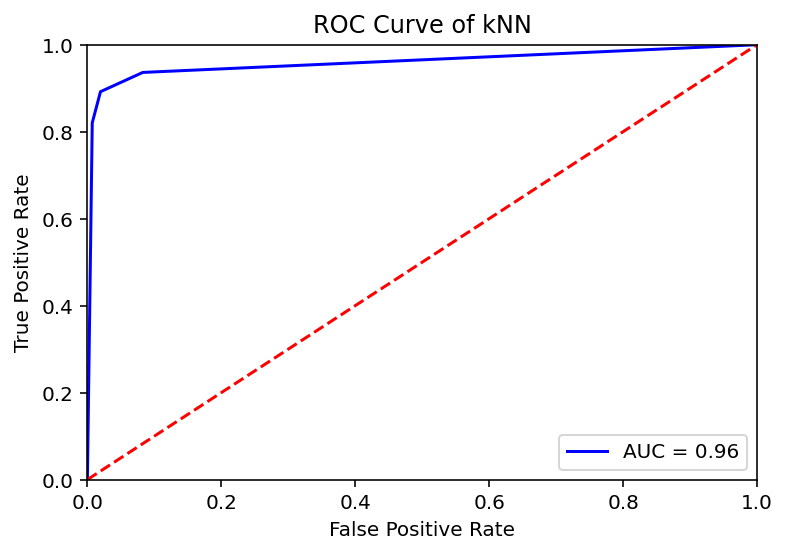

K -----> 4
Model accuracy score: 0.9426
Training-set accuracy score: 0.9528
Confusion matrix

 [[12278   155]
 [  993  6574]]

True Positives(TP) =  12278

True Negatives(TN) =  6574

False Positives(FP) =  155

False Negatives(FN) =  993


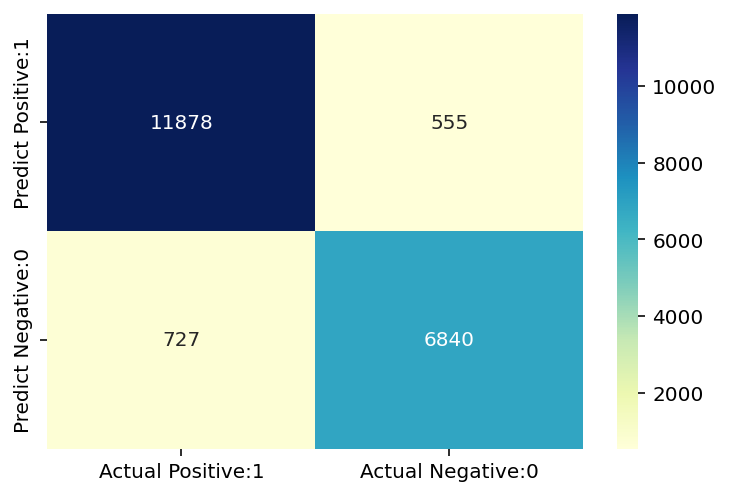

              precision    recall  f1-score   support

           0       0.93      0.99      0.96     12433
           1       0.98      0.87      0.92      7567

    accuracy                           0.94     20000
   macro avg       0.95      0.93      0.94     20000
weighted avg       0.94      0.94      0.94     20000

Classification accuracy : 0.9359


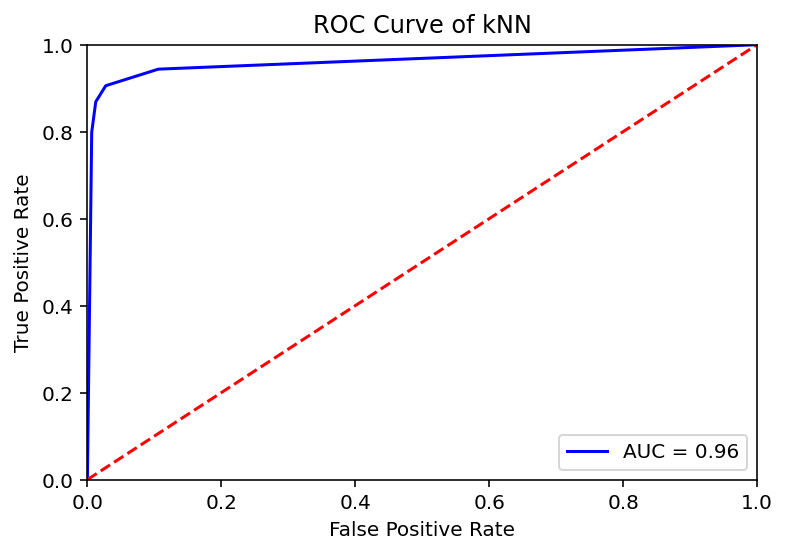

K -----> 5
Model accuracy score: 0.9455
Training-set accuracy score: 0.9541
Confusion matrix

 [[12217   216]
 [  874  6693]]

True Positives(TP) =  12217

True Negatives(TN) =  6693

False Positives(FP) =  216

False Negatives(FN) =  874


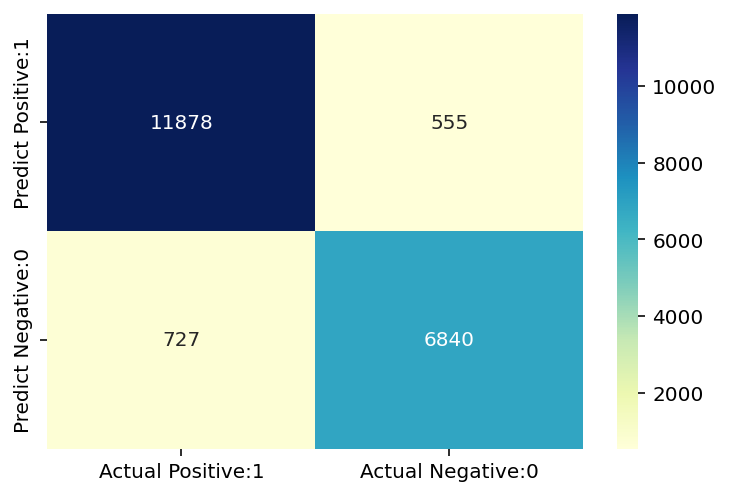

              precision    recall  f1-score   support

           0       0.93      0.98      0.96     12433
           1       0.97      0.88      0.92      7567

    accuracy                           0.95     20000
   macro avg       0.95      0.93      0.94     20000
weighted avg       0.95      0.95      0.94     20000

Classification accuracy : 0.9359


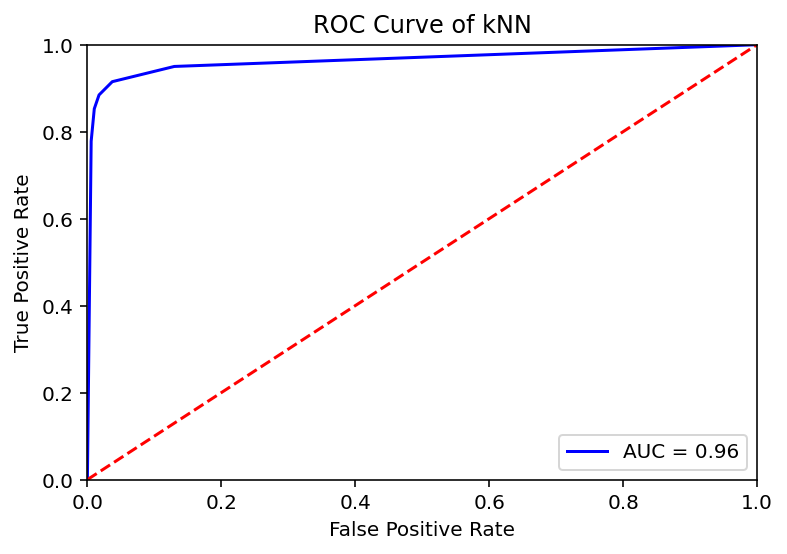

K -----> 6
Model accuracy score: 0.9425
Training-set accuracy score: 0.9479
Confusion matrix

 [[12266   167]
 [  983  6584]]

True Positives(TP) =  12266

True Negatives(TN) =  6584

False Positives(FP) =  167

False Negatives(FN) =  983


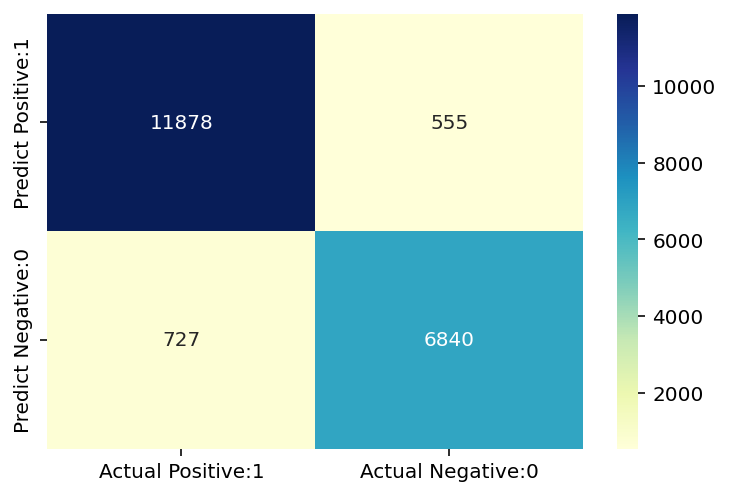

              precision    recall  f1-score   support

           0       0.93      0.99      0.96     12433
           1       0.98      0.87      0.92      7567

    accuracy                           0.94     20000
   macro avg       0.95      0.93      0.94     20000
weighted avg       0.94      0.94      0.94     20000

Classification accuracy : 0.9359


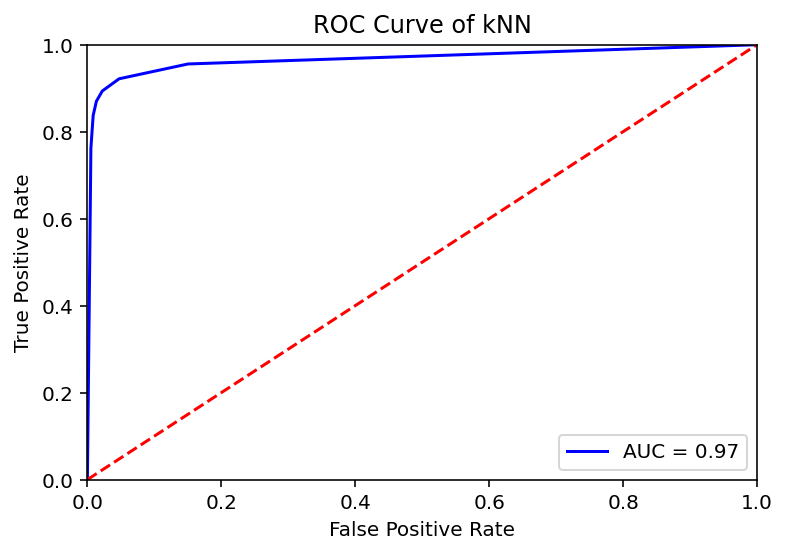

K -----> 7
Model accuracy score: 0.9431
Training-set accuracy score: 0.9492
Confusion matrix

 [[12223   210]
 [  929  6638]]

True Positives(TP) =  12223

True Negatives(TN) =  6638

False Positives(FP) =  210

False Negatives(FN) =  929


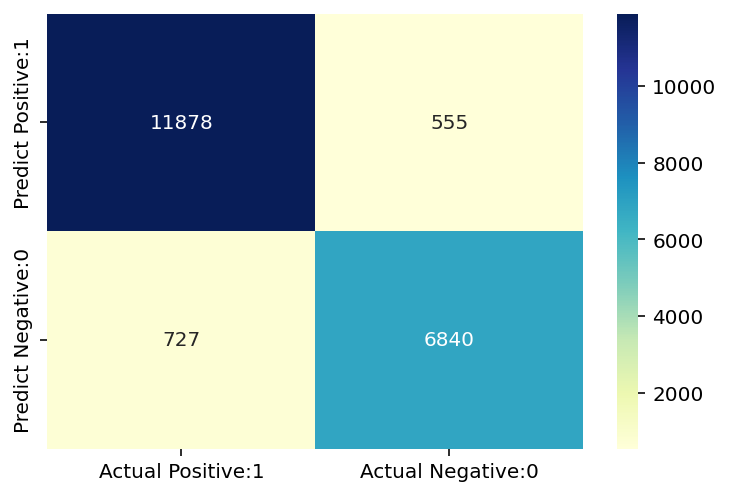

              precision    recall  f1-score   support

           0       0.93      0.98      0.96     12433
           1       0.97      0.88      0.92      7567

    accuracy                           0.94     20000
   macro avg       0.95      0.93      0.94     20000
weighted avg       0.94      0.94      0.94     20000

Classification accuracy : 0.9359


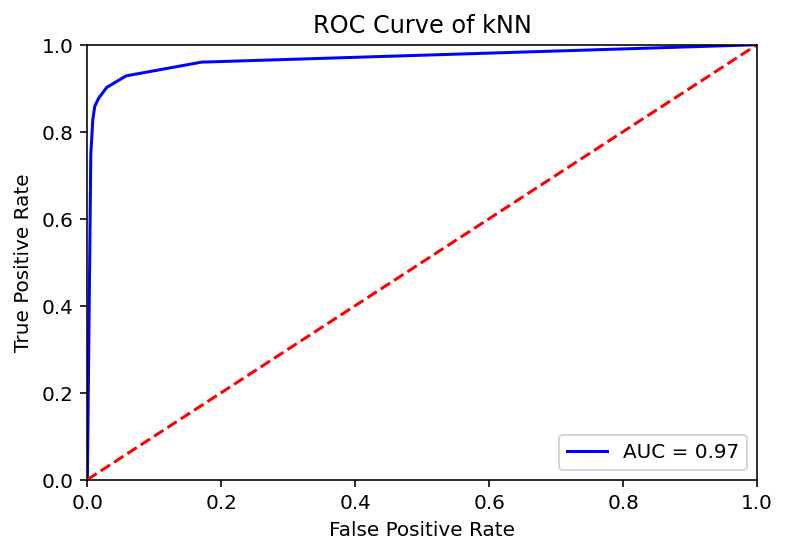

K -----> 8
Model accuracy score: 0.9409
Training-set accuracy score: 0.9450
Confusion matrix

 [[12255   178]
 [ 1003  6564]]

True Positives(TP) =  12255

True Negatives(TN) =  6564

False Positives(FP) =  178

False Negatives(FN) =  1003


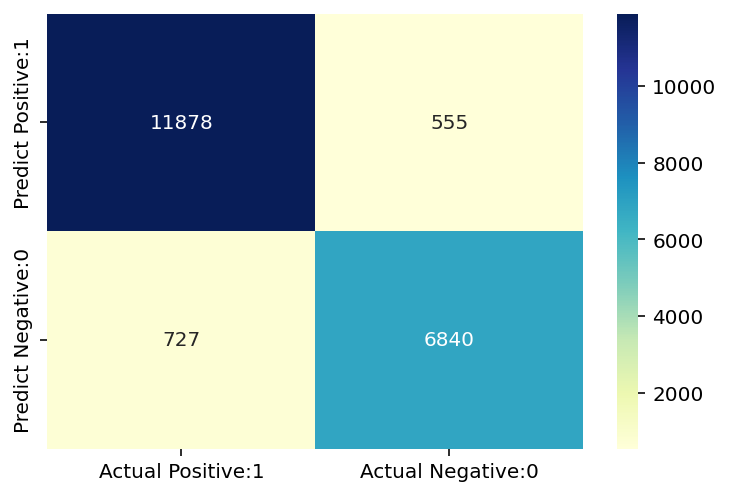

              precision    recall  f1-score   support

           0       0.92      0.99      0.95     12433
           1       0.97      0.87      0.92      7567

    accuracy                           0.94     20000
   macro avg       0.95      0.93      0.94     20000
weighted avg       0.94      0.94      0.94     20000

Classification accuracy : 0.9359


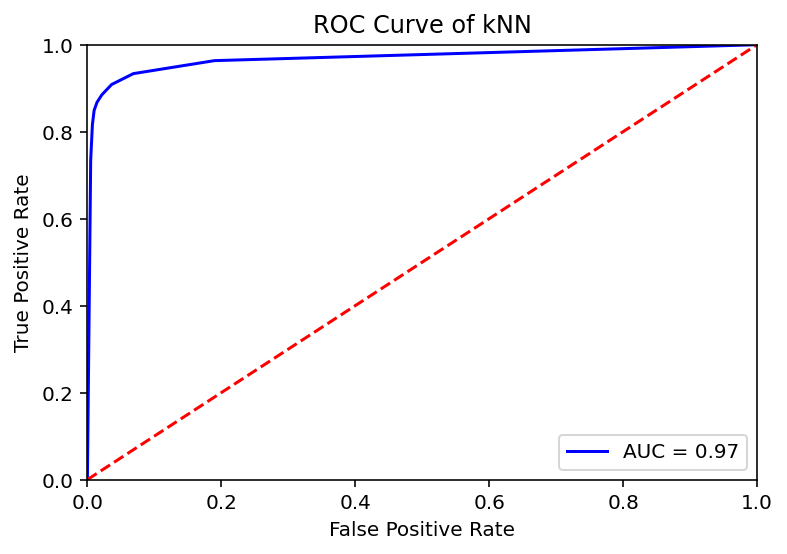

K -----> 9
Model accuracy score: 0.9417
Training-set accuracy score: 0.9462
Confusion matrix

 [[12219   214]
 [  951  6616]]

True Positives(TP) =  12219

True Negatives(TN) =  6616

False Positives(FP) =  214

False Negatives(FN) =  951


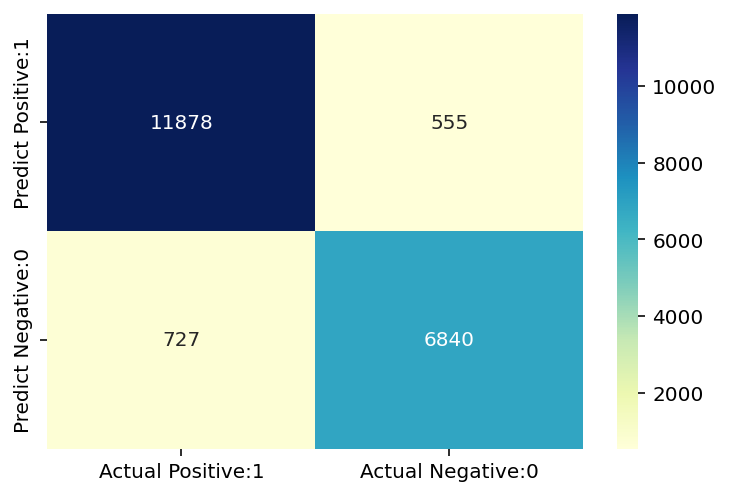

              precision    recall  f1-score   support

           0       0.93      0.98      0.95     12433
           1       0.97      0.87      0.92      7567

    accuracy                           0.94     20000
   macro avg       0.95      0.93      0.94     20000
weighted avg       0.94      0.94      0.94     20000

Classification accuracy : 0.9359


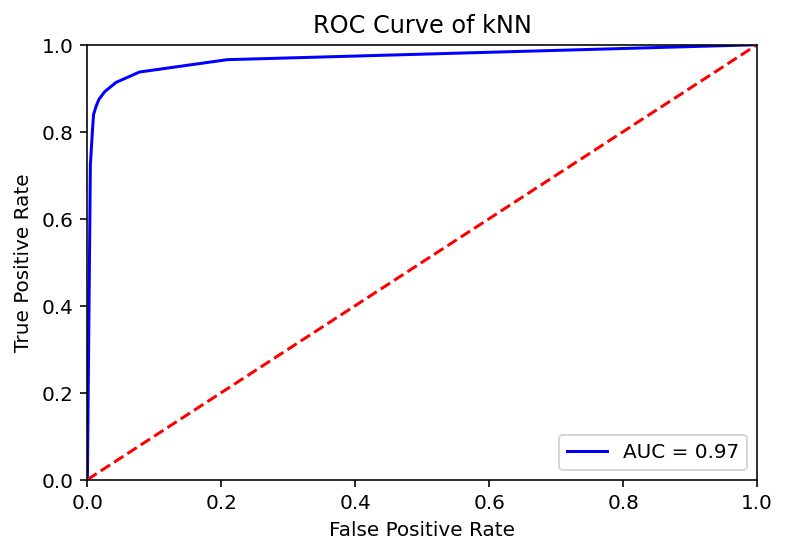

K -----> 10
Model accuracy score: 0.9393
Training-set accuracy score: 0.9424
Confusion matrix

 [[12243   190]
 [ 1025  6542]]

True Positives(TP) =  12243

True Negatives(TN) =  6542

False Positives(FP) =  190

False Negatives(FN) =  1025


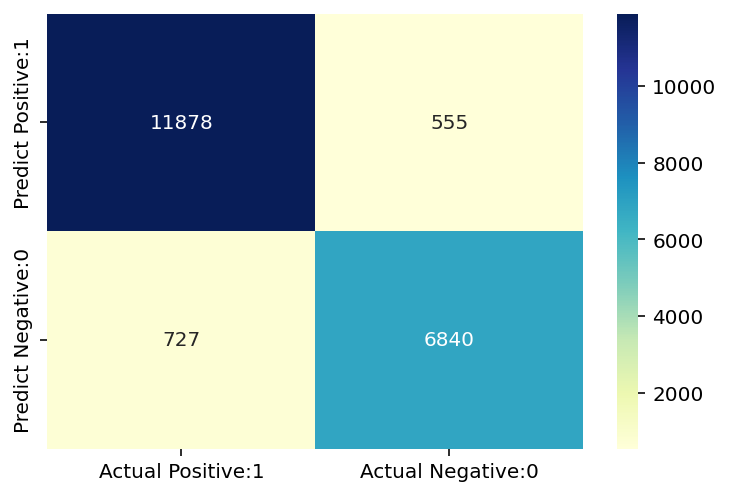

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     12433
           1       0.97      0.86      0.92      7567

    accuracy                           0.94     20000
   macro avg       0.95      0.92      0.93     20000
weighted avg       0.94      0.94      0.94     20000

Classification accuracy : 0.9359


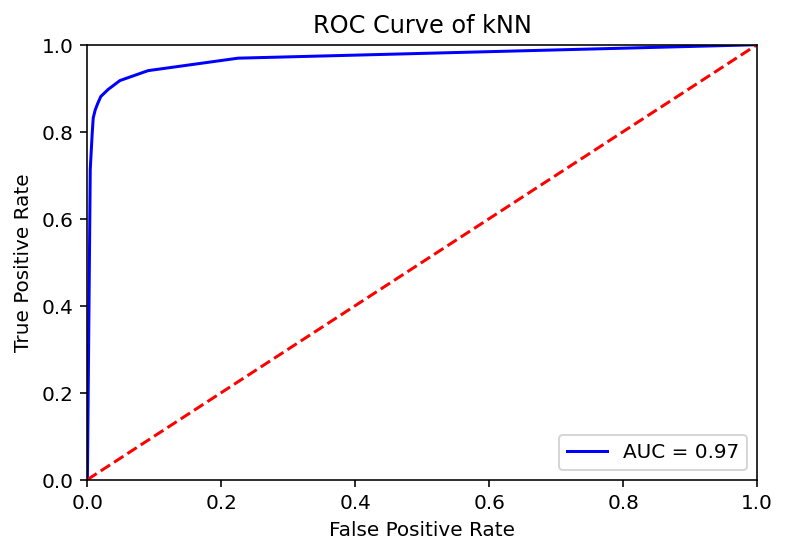

K -----> 11
Model accuracy score: 0.9396
Training-set accuracy score: 0.9432
Confusion matrix

 [[12209   224]
 [  983  6584]]

True Positives(TP) =  12209

True Negatives(TN) =  6584

False Positives(FP) =  224

False Negatives(FN) =  983


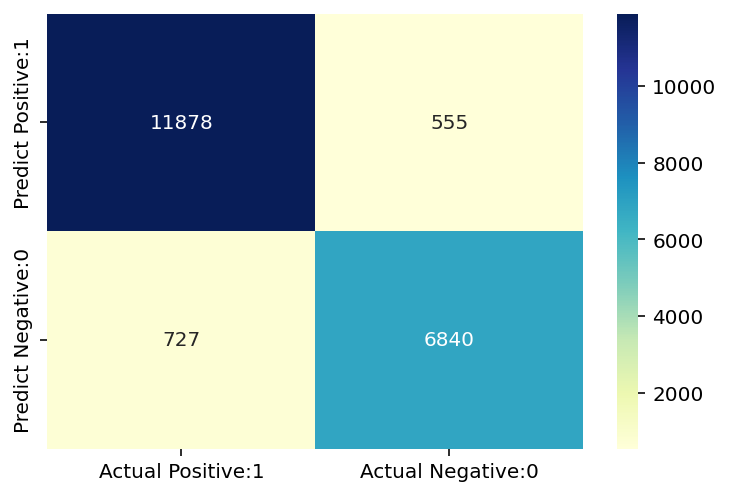

              precision    recall  f1-score   support

           0       0.93      0.98      0.95     12433
           1       0.97      0.87      0.92      7567

    accuracy                           0.94     20000
   macro avg       0.95      0.93      0.93     20000
weighted avg       0.94      0.94      0.94     20000

Classification accuracy : 0.9359


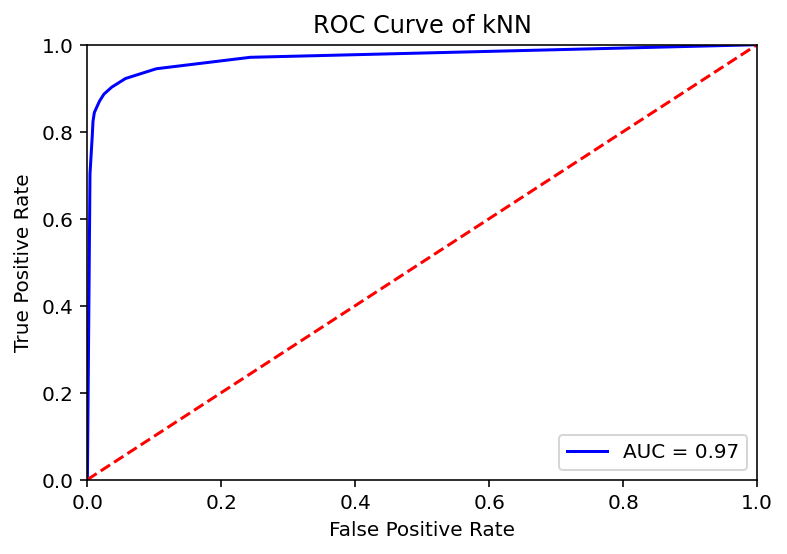

K -----> 12
Model accuracy score: 0.9378
Training-set accuracy score: 0.9404
Confusion matrix

 [[12228   205]
 [ 1038  6529]]

True Positives(TP) =  12228

True Negatives(TN) =  6529

False Positives(FP) =  205

False Negatives(FN) =  1038


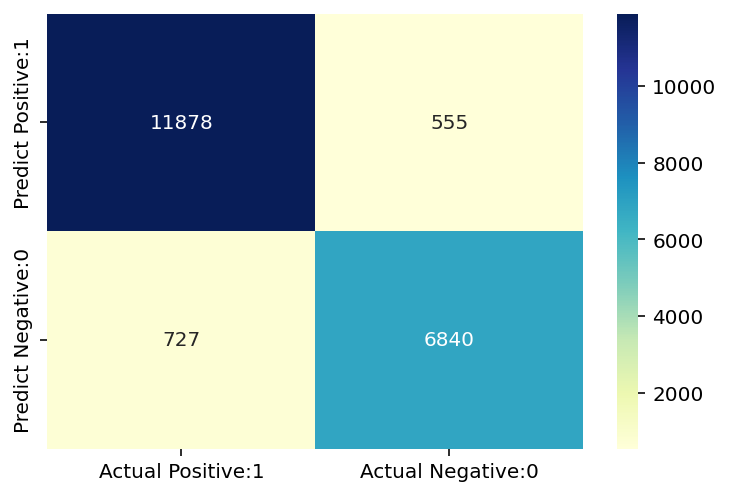

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     12433
           1       0.97      0.86      0.91      7567

    accuracy                           0.94     20000
   macro avg       0.95      0.92      0.93     20000
weighted avg       0.94      0.94      0.94     20000

Classification accuracy : 0.9359


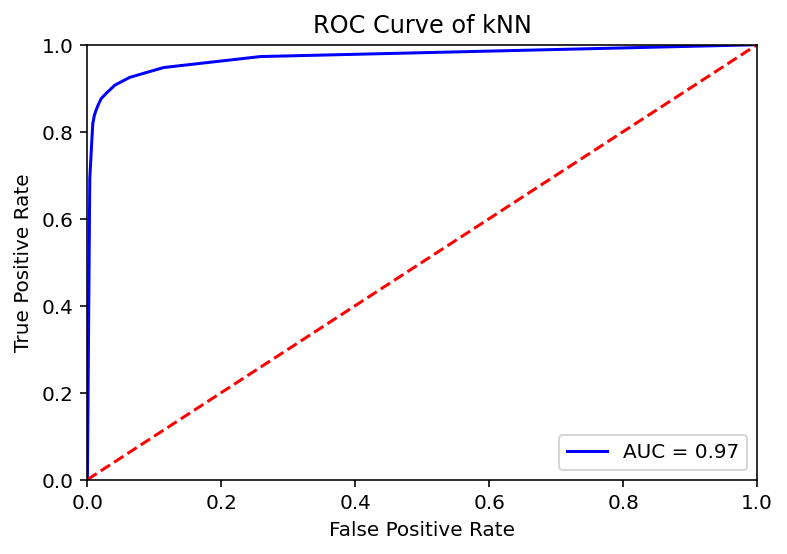

K -----> 13
Model accuracy score: 0.9383
Training-set accuracy score: 0.9411
Confusion matrix

 [[12205   228]
 [ 1007  6560]]

True Positives(TP) =  12205

True Negatives(TN) =  6560

False Positives(FP) =  228

False Negatives(FN) =  1007


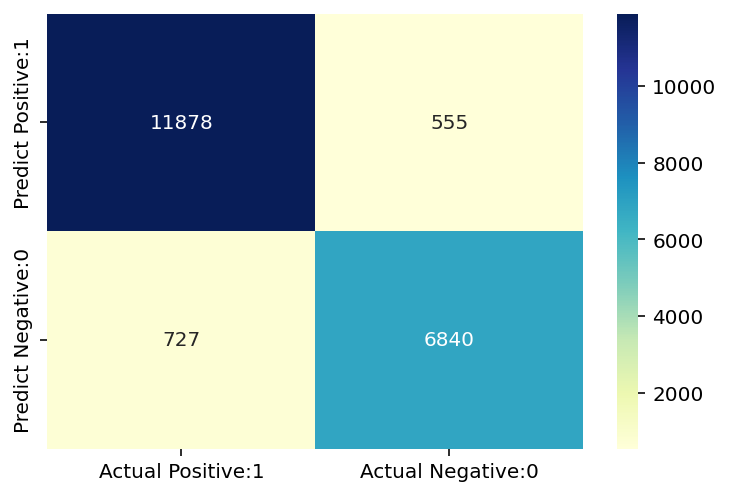

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     12433
           1       0.97      0.87      0.91      7567

    accuracy                           0.94     20000
   macro avg       0.95      0.92      0.93     20000
weighted avg       0.94      0.94      0.94     20000

Classification accuracy : 0.9359


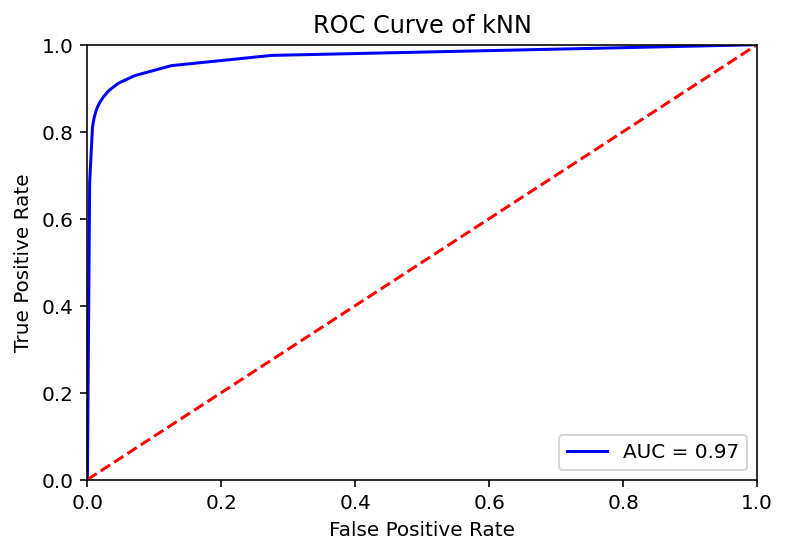

K -----> 14
Model accuracy score: 0.9367
Training-set accuracy score: 0.9389
Confusion matrix

 [[12221   212]
 [ 1054  6513]]

True Positives(TP) =  12221

True Negatives(TN) =  6513

False Positives(FP) =  212

False Negatives(FN) =  1054


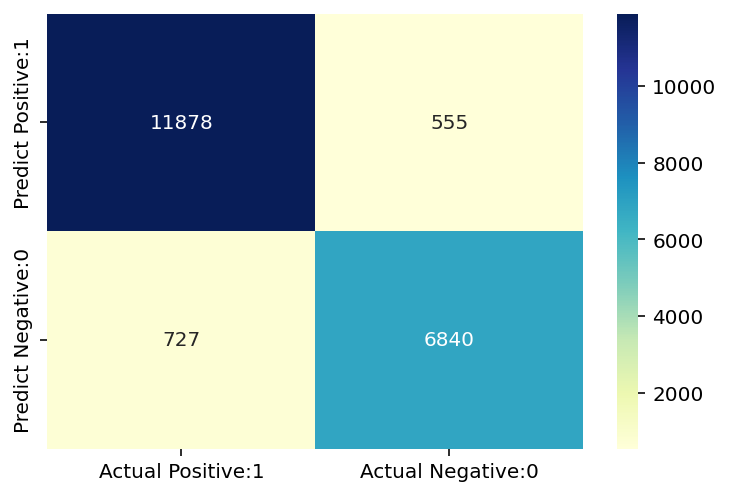

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     12433
           1       0.97      0.86      0.91      7567

    accuracy                           0.94     20000
   macro avg       0.94      0.92      0.93     20000
weighted avg       0.94      0.94      0.94     20000

Classification accuracy : 0.9359


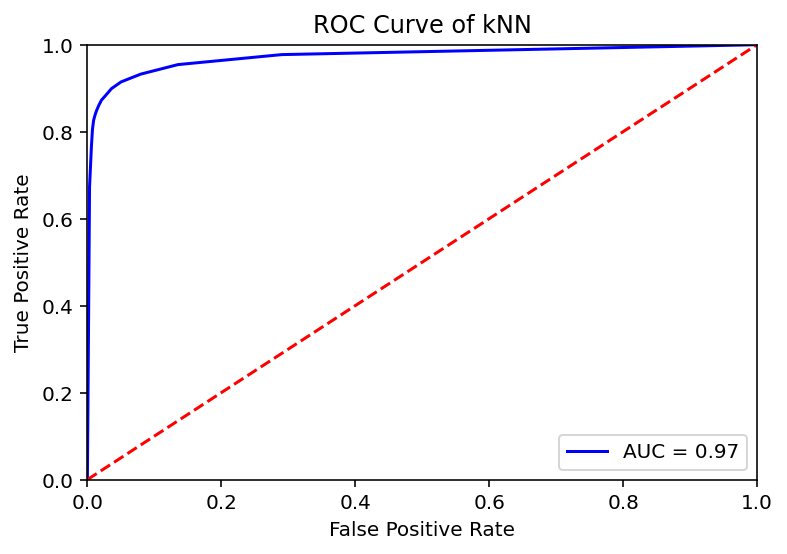

K -----> 15
Model accuracy score: 0.9377
Training-set accuracy score: 0.9397
Confusion matrix

 [[12202   231]
 [ 1014  6553]]

True Positives(TP) =  12202

True Negatives(TN) =  6553

False Positives(FP) =  231

False Negatives(FN) =  1014


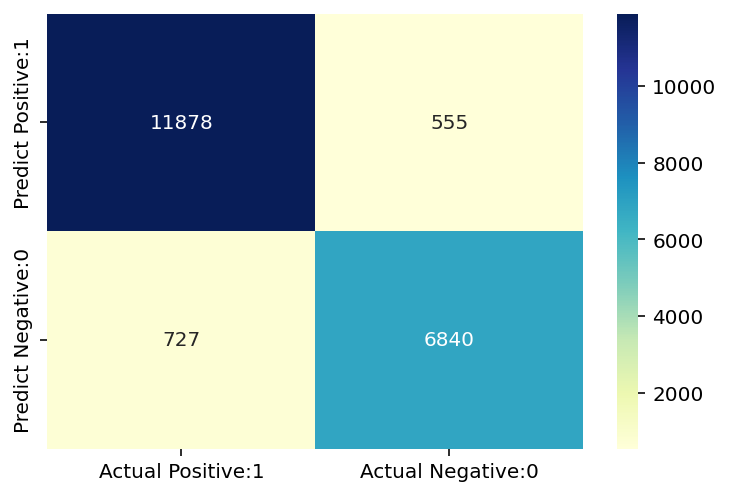

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     12433
           1       0.97      0.87      0.91      7567

    accuracy                           0.94     20000
   macro avg       0.94      0.92      0.93     20000
weighted avg       0.94      0.94      0.94     20000

Classification accuracy : 0.9359


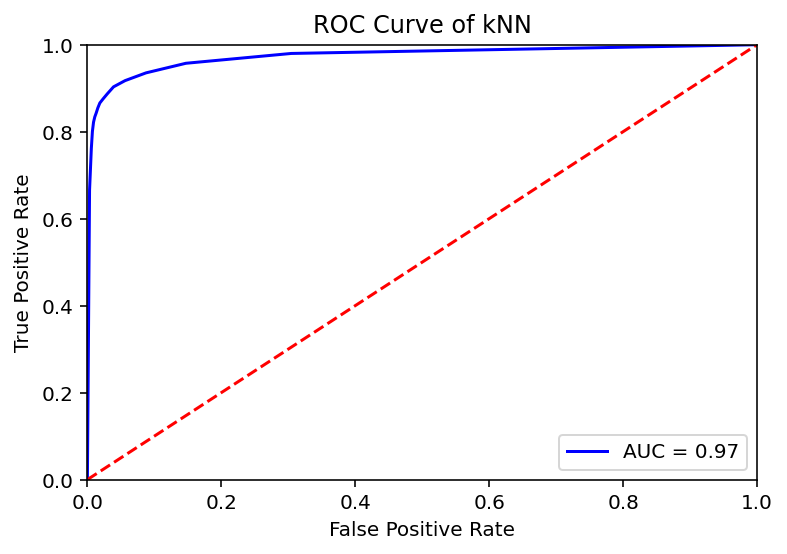

K -----> 16
Model accuracy score: 0.9355
Training-set accuracy score: 0.9375
Confusion matrix

 [[12218   215]
 [ 1076  6491]]

True Positives(TP) =  12218

True Negatives(TN) =  6491

False Positives(FP) =  215

False Negatives(FN) =  1076


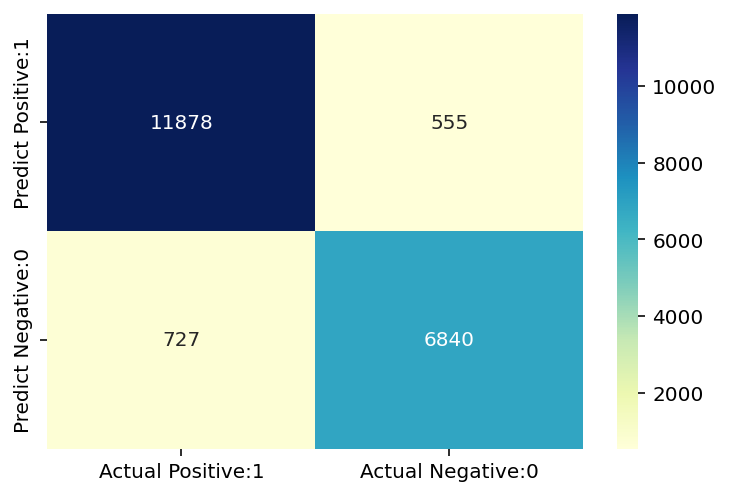

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     12433
           1       0.97      0.86      0.91      7567

    accuracy                           0.94     20000
   macro avg       0.94      0.92      0.93     20000
weighted avg       0.94      0.94      0.93     20000

Classification accuracy : 0.9359


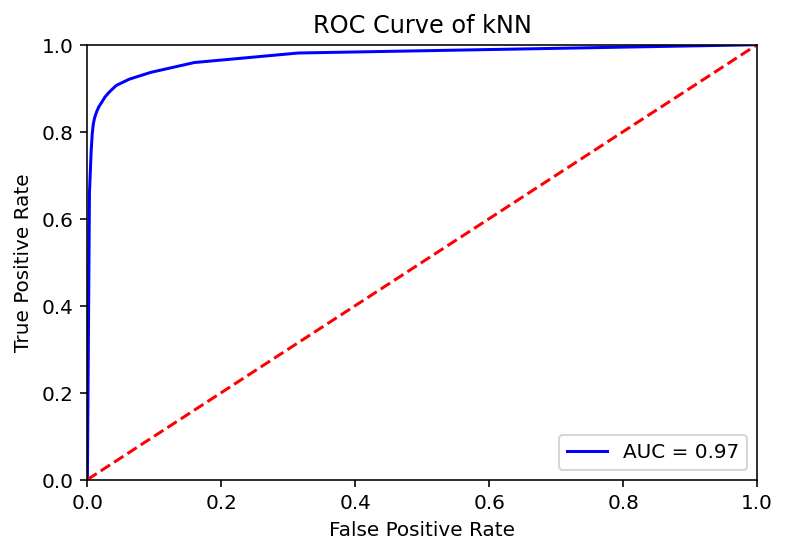

K -----> 17
Model accuracy score: 0.9353
Training-set accuracy score: 0.9381
Confusion matrix

 [[12179   254]
 [ 1040  6527]]

True Positives(TP) =  12179

True Negatives(TN) =  6527

False Positives(FP) =  254

False Negatives(FN) =  1040


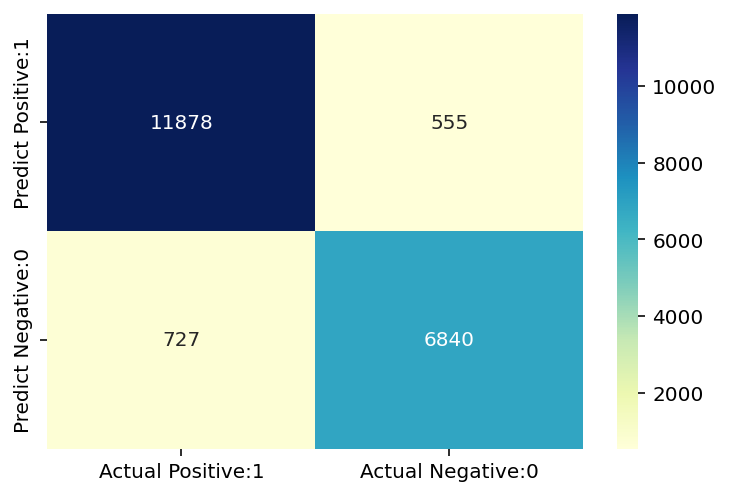

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     12433
           1       0.96      0.86      0.91      7567

    accuracy                           0.94     20000
   macro avg       0.94      0.92      0.93     20000
weighted avg       0.94      0.94      0.93     20000

Classification accuracy : 0.9359


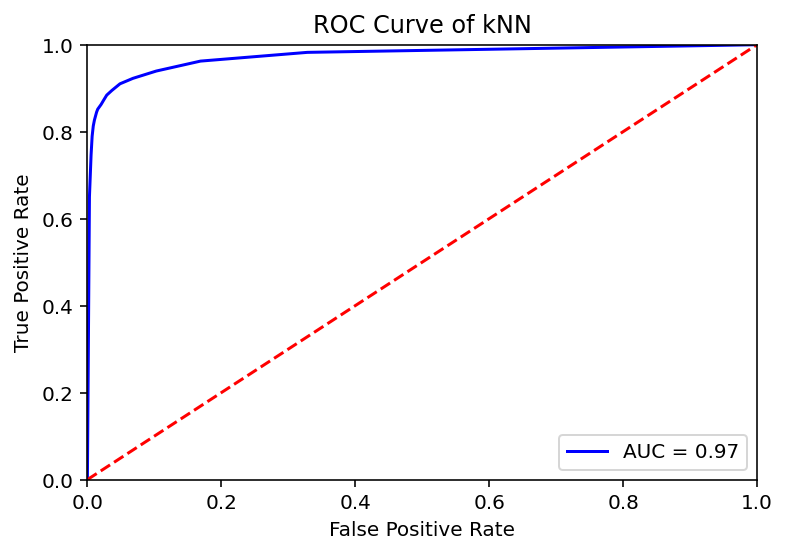

K -----> 18
Model accuracy score: 0.9343
Training-set accuracy score: 0.9361
Confusion matrix

 [[12206   227]
 [ 1088  6479]]

True Positives(TP) =  12206

True Negatives(TN) =  6479

False Positives(FP) =  227

False Negatives(FN) =  1088


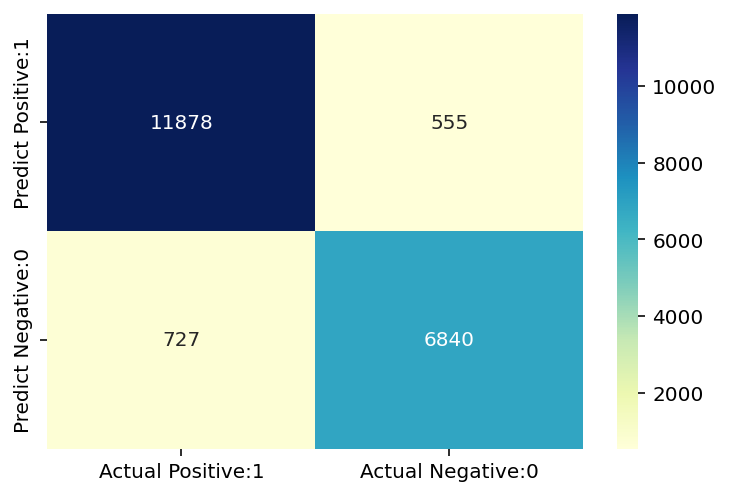

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     12433
           1       0.97      0.86      0.91      7567

    accuracy                           0.93     20000
   macro avg       0.94      0.92      0.93     20000
weighted avg       0.94      0.93      0.93     20000

Classification accuracy : 0.9359


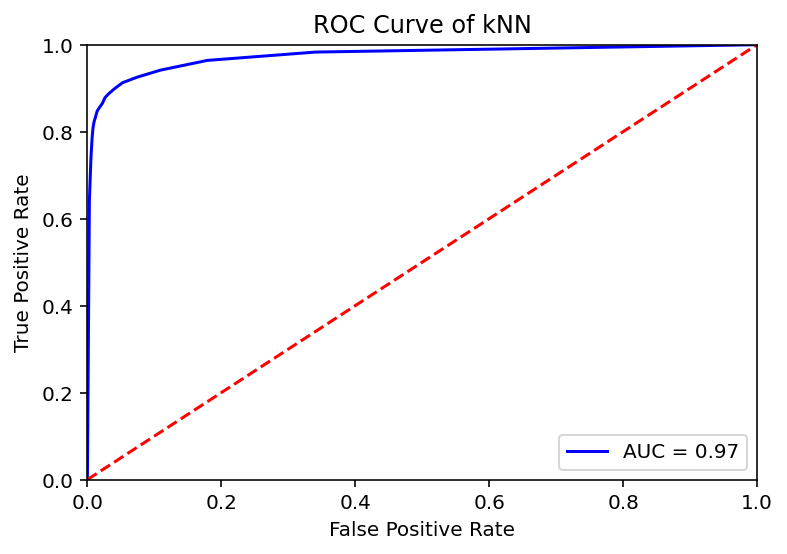

K -----> 19
Model accuracy score: 0.9335
Training-set accuracy score: 0.9364
Confusion matrix

 [[12167   266]
 [ 1064  6503]]

True Positives(TP) =  12167

True Negatives(TN) =  6503

False Positives(FP) =  266

False Negatives(FN) =  1064


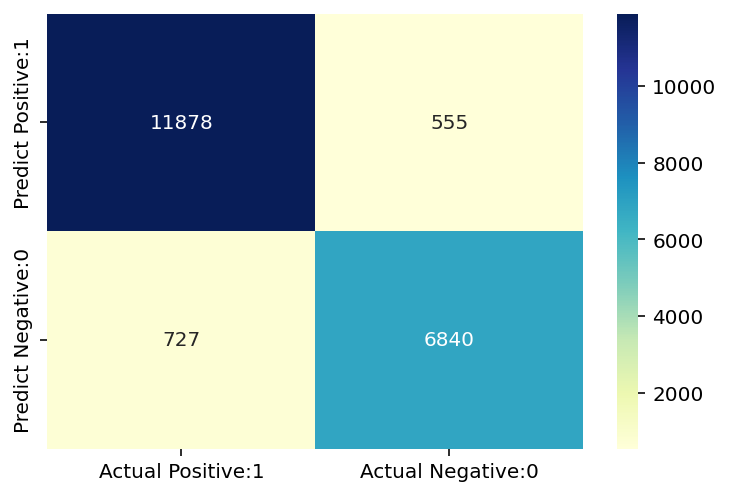

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     12433
           1       0.96      0.86      0.91      7567

    accuracy                           0.93     20000
   macro avg       0.94      0.92      0.93     20000
weighted avg       0.94      0.93      0.93     20000

Classification accuracy : 0.9359


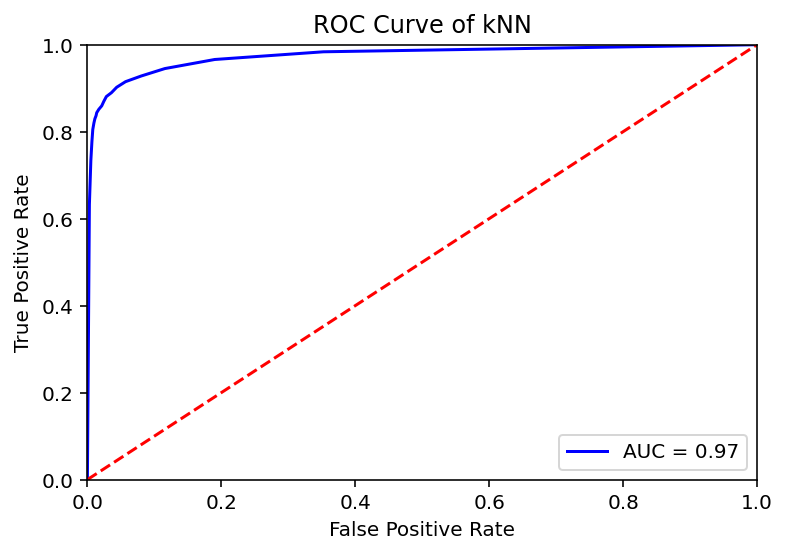

K -----> 20
Model accuracy score: 0.9328
Training-set accuracy score: 0.9349
Confusion matrix

 [[12195   238]
 [ 1106  6461]]

True Positives(TP) =  12195

True Negatives(TN) =  6461

False Positives(FP) =  238

False Negatives(FN) =  1106


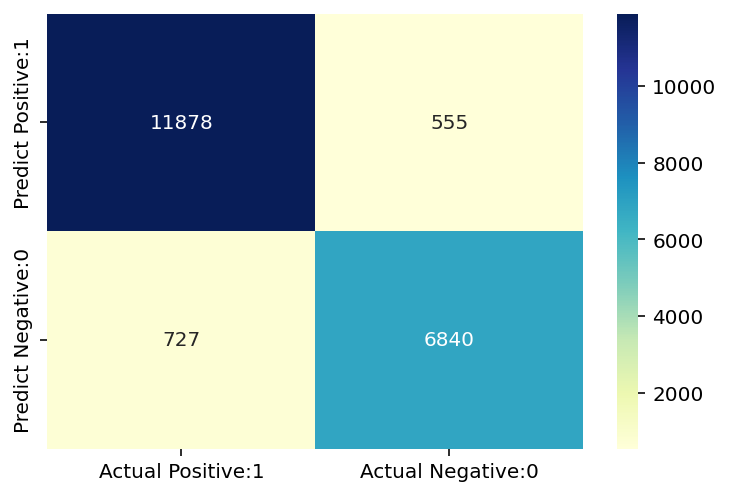

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     12433
           1       0.96      0.85      0.91      7567

    accuracy                           0.93     20000
   macro avg       0.94      0.92      0.93     20000
weighted avg       0.93      0.93      0.93     20000

Classification accuracy : 0.9359


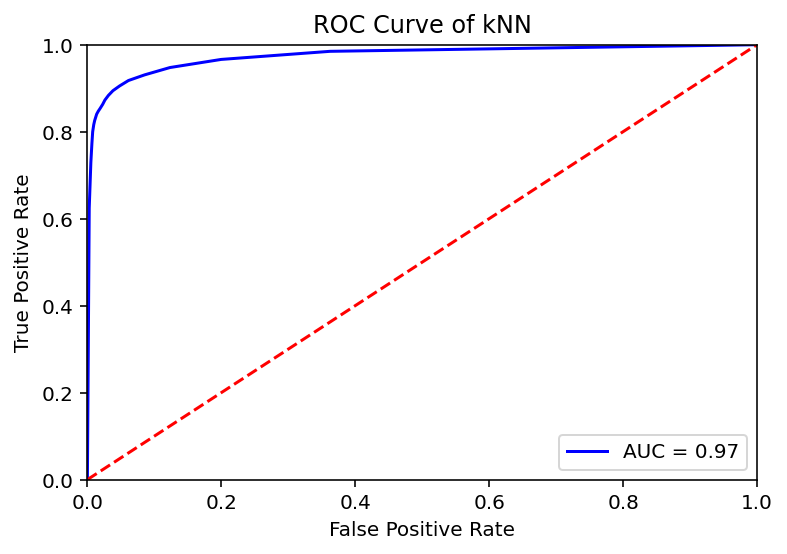

K -----> 21
Model accuracy score: 0.9332
Training-set accuracy score: 0.9355
Confusion matrix

 [[12169   264]
 [ 1072  6495]]

True Positives(TP) =  12169

True Negatives(TN) =  6495

False Positives(FP) =  264

False Negatives(FN) =  1072


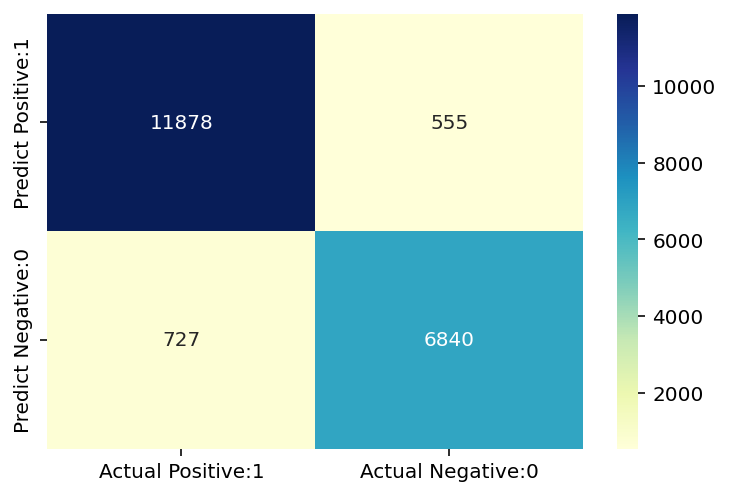

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     12433
           1       0.96      0.86      0.91      7567

    accuracy                           0.93     20000
   macro avg       0.94      0.92      0.93     20000
weighted avg       0.93      0.93      0.93     20000

Classification accuracy : 0.9359


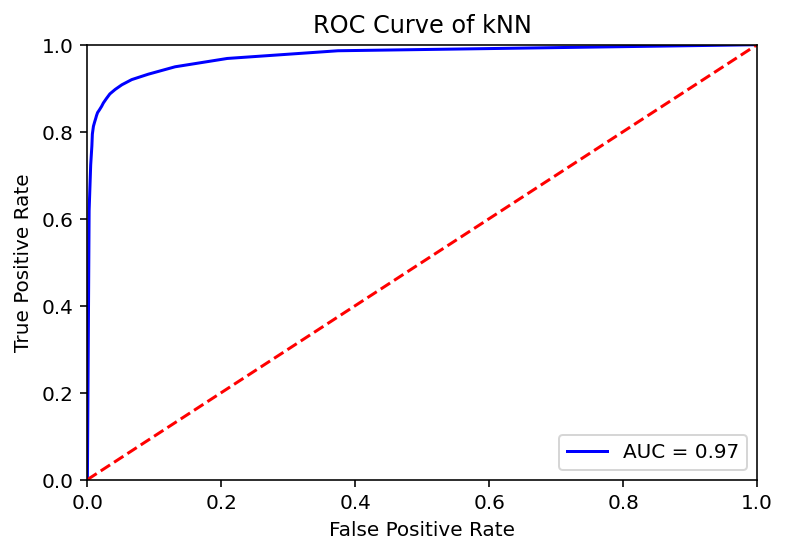

K -----> 22
Model accuracy score: 0.9326
Training-set accuracy score: 0.9339
Confusion matrix

 [[12190   243]
 [ 1105  6462]]

True Positives(TP) =  12190

True Negatives(TN) =  6462

False Positives(FP) =  243

False Negatives(FN) =  1105


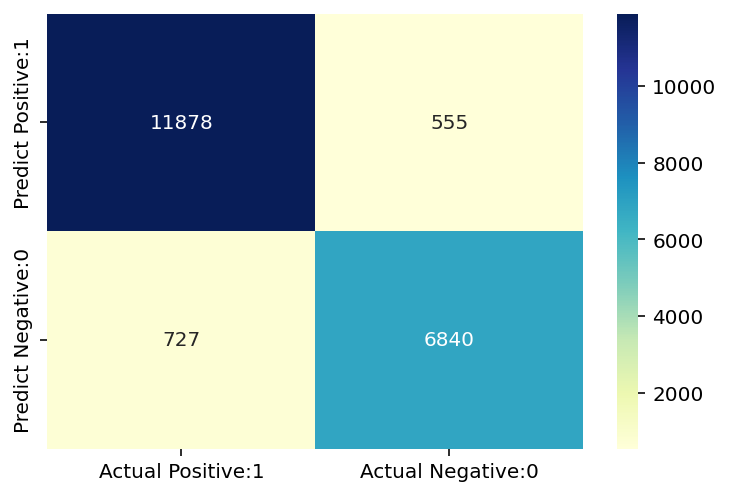

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     12433
           1       0.96      0.85      0.91      7567

    accuracy                           0.93     20000
   macro avg       0.94      0.92      0.93     20000
weighted avg       0.93      0.93      0.93     20000

Classification accuracy : 0.9359


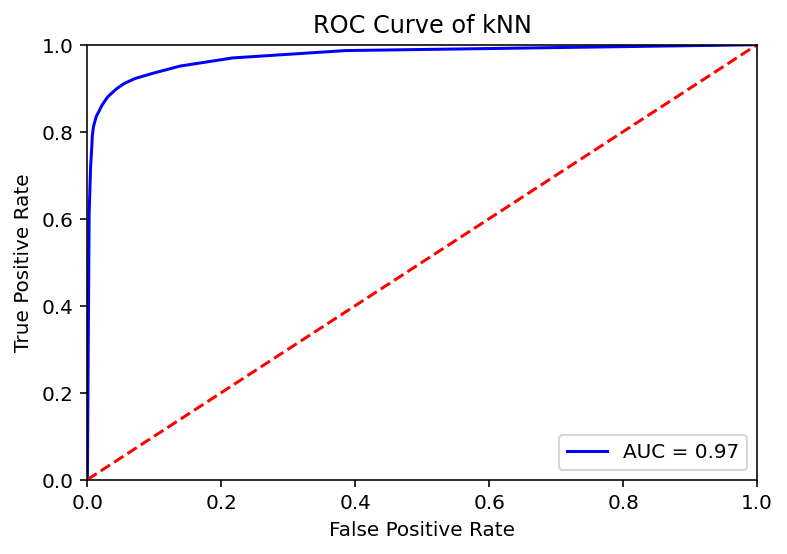

K -----> 23
Model accuracy score: 0.9325
Training-set accuracy score: 0.9345
Confusion matrix

 [[12173   260]
 [ 1090  6477]]

True Positives(TP) =  12173

True Negatives(TN) =  6477

False Positives(FP) =  260

False Negatives(FN) =  1090


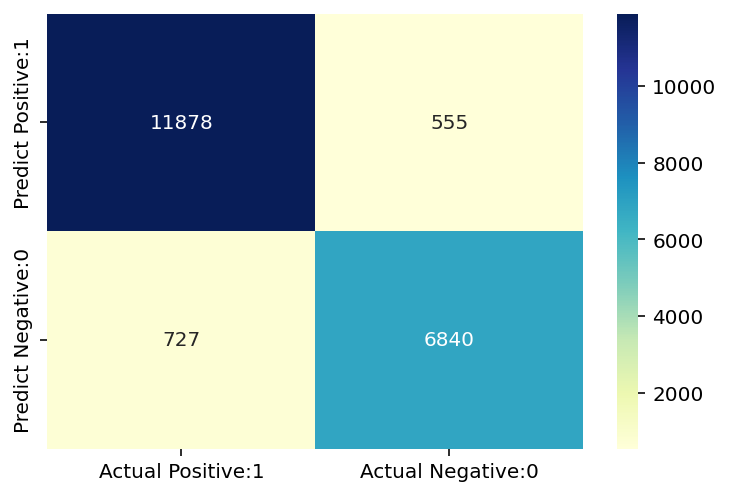

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     12433
           1       0.96      0.86      0.91      7567

    accuracy                           0.93     20000
   macro avg       0.94      0.92      0.93     20000
weighted avg       0.93      0.93      0.93     20000

Classification accuracy : 0.9359


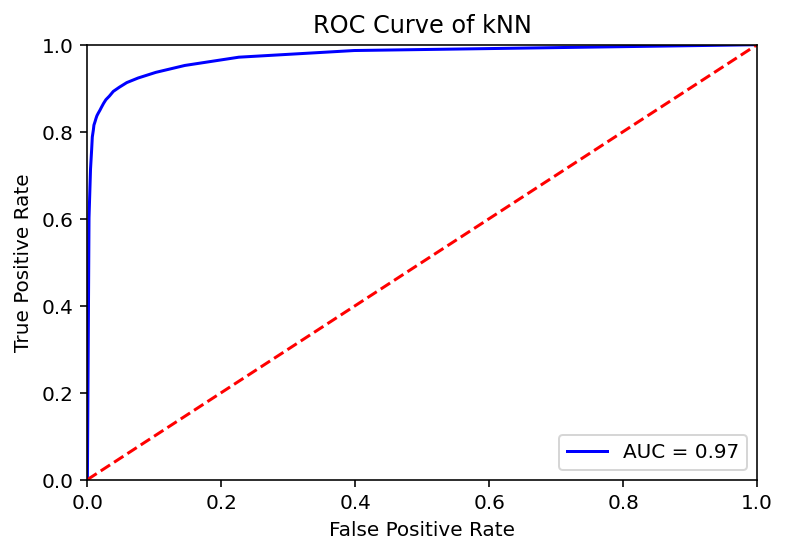

K -----> 24
Model accuracy score: 0.9315
Training-set accuracy score: 0.9332
Confusion matrix

 [[12184   249]
 [ 1121  6446]]

True Positives(TP) =  12184

True Negatives(TN) =  6446

False Positives(FP) =  249

False Negatives(FN) =  1121


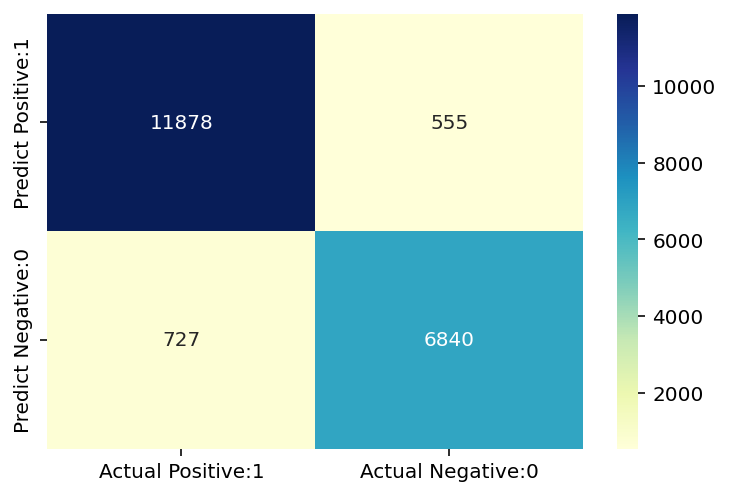

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     12433
           1       0.96      0.85      0.90      7567

    accuracy                           0.93     20000
   macro avg       0.94      0.92      0.93     20000
weighted avg       0.93      0.93      0.93     20000

Classification accuracy : 0.9359


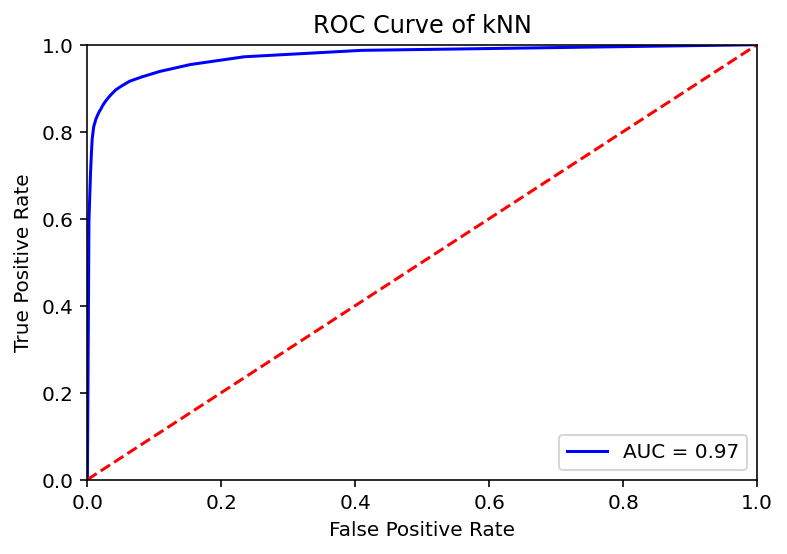

K -----> 25
Model accuracy score: 0.9315
Training-set accuracy score: 0.9333
Confusion matrix

 [[12165   268]
 [ 1101  6466]]

True Positives(TP) =  12165

True Negatives(TN) =  6466

False Positives(FP) =  268

False Negatives(FN) =  1101


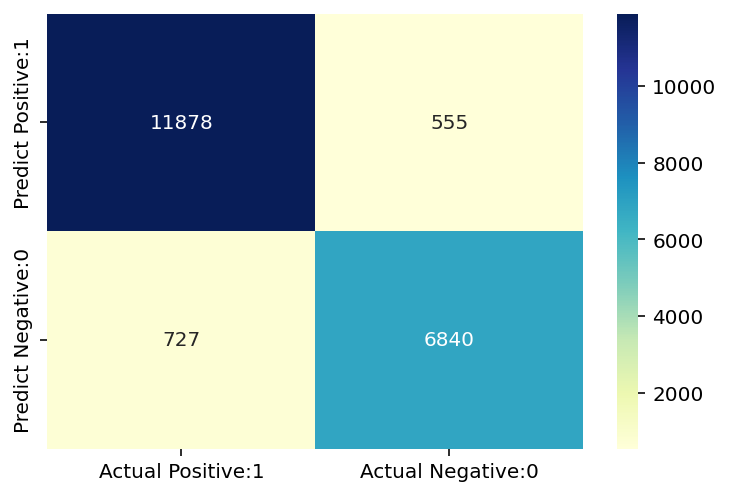

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     12433
           1       0.96      0.85      0.90      7567

    accuracy                           0.93     20000
   macro avg       0.94      0.92      0.93     20000
weighted avg       0.93      0.93      0.93     20000

Classification accuracy : 0.9359


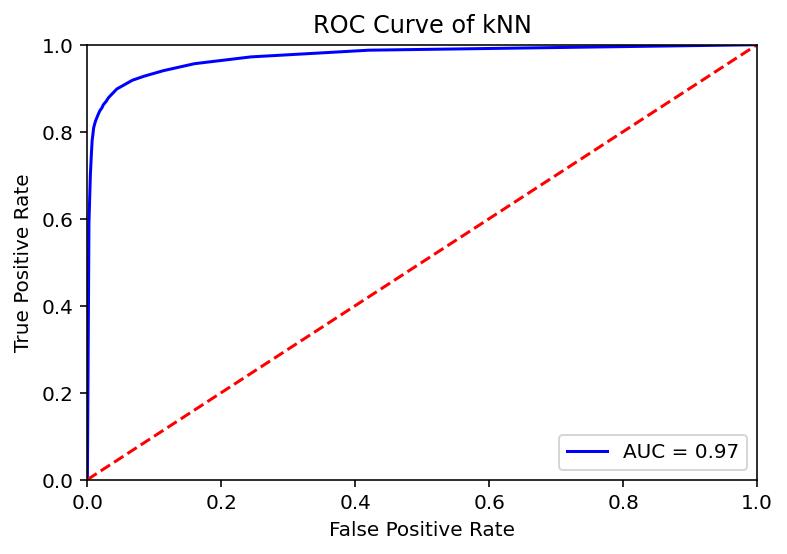

[]


In [ ]:
# try K=1 through K=25 and record testing accuracy
k_range = range(1, 26)

# We can create Python dictionary using [] or dict()
scores = []

# We use a loop through the range 1 to 26
# We append the scores in the dictionary
for k in k_range:
    print("K ----->" , k)
    y_pred , y_pred_probab = knn_model(X_train, X_test, y_train, y_test , k)
    evalute_mode(y_pred , y_pred_probab , y_test)
print(scores)

10000
K -----> 1
Model accuracy score: 0.8840
Training-set accuracy score: 1.0000
Confusion matrix

 [[1165  122]
 [ 110  603]]

True Positives(TP) =  1165

True Negatives(TN) =  603

False Positives(FP) =  122

False Negatives(FN) =  110
_____________________________________________________________________________


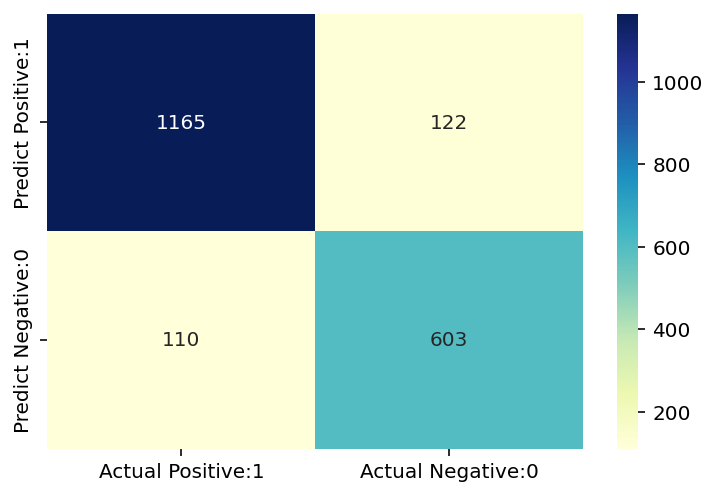

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.91      0.91      1287
           1       0.83      0.85      0.84       713

    accuracy                           0.88      2000
   macro avg       0.87      0.88      0.87      2000
weighted avg       0.88      0.88      0.88      2000

_____________________________________________________________________________
Classification accuracy : 0.8840
_____________________________________________________________________________


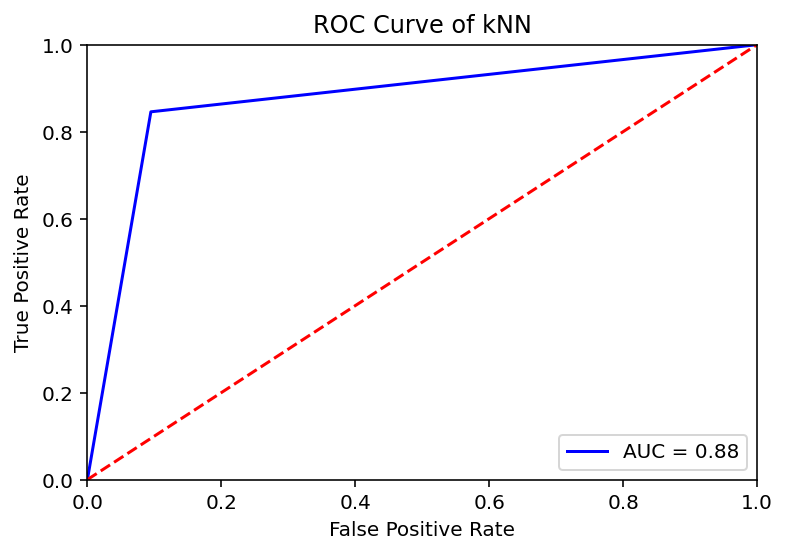

K -----> 4
Model accuracy score: 0.8980
Training-set accuracy score: 0.9187
Confusion matrix

 [[1236   51]
 [ 153  560]]

True Positives(TP) =  1236

True Negatives(TN) =  560

False Positives(FP) =  51

False Negatives(FN) =  153
_____________________________________________________________________________


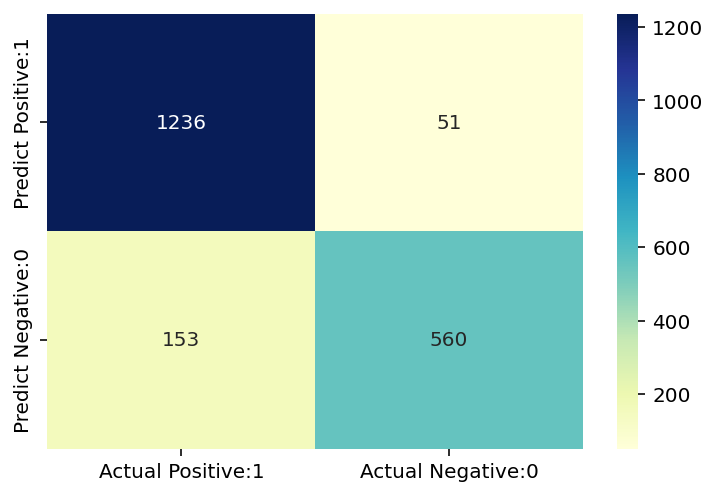

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.89      0.96      0.92      1287
           1       0.92      0.79      0.85       713

    accuracy                           0.90      2000
   macro avg       0.90      0.87      0.88      2000
weighted avg       0.90      0.90      0.90      2000

_____________________________________________________________________________
Classification accuracy : 0.8980
_____________________________________________________________________________


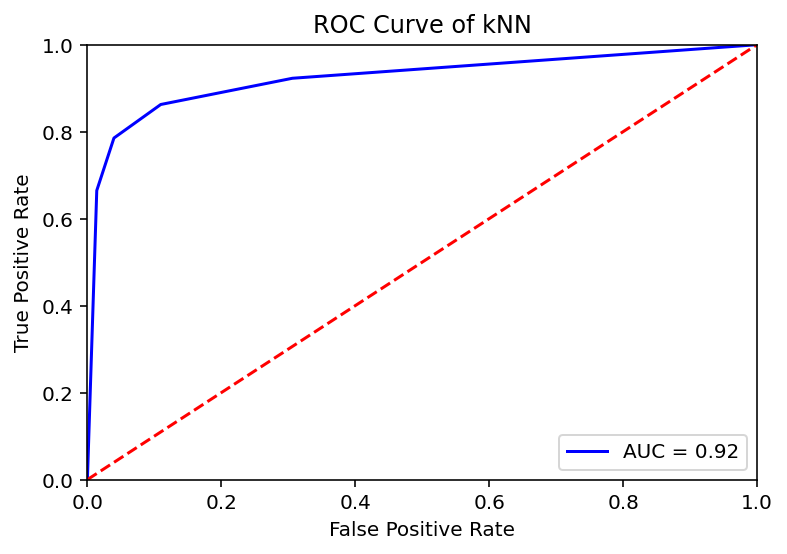

K -----> 7
Model accuracy score: 0.9000
Training-set accuracy score: 0.9073
Confusion matrix

 [[1216   71]
 [ 129  584]]

True Positives(TP) =  1216

True Negatives(TN) =  584

False Positives(FP) =  71

False Negatives(FN) =  129
_____________________________________________________________________________


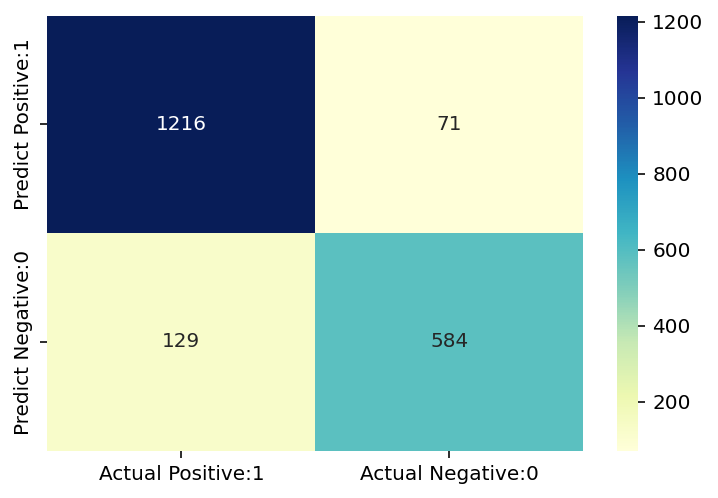

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.90      0.94      0.92      1287
           1       0.89      0.82      0.85       713

    accuracy                           0.90      2000
   macro avg       0.90      0.88      0.89      2000
weighted avg       0.90      0.90      0.90      2000

_____________________________________________________________________________
Classification accuracy : 0.9000
_____________________________________________________________________________


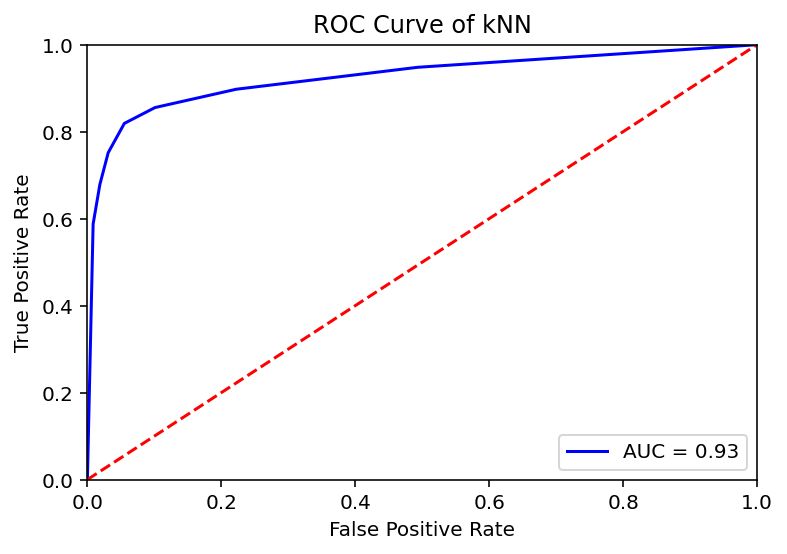

K -----> 10
Model accuracy score: 0.8865
Training-set accuracy score: 0.8988
Confusion matrix

 [[1223   64]
 [ 163  550]]

True Positives(TP) =  1223

True Negatives(TN) =  550

False Positives(FP) =  64

False Negatives(FN) =  163
_____________________________________________________________________________


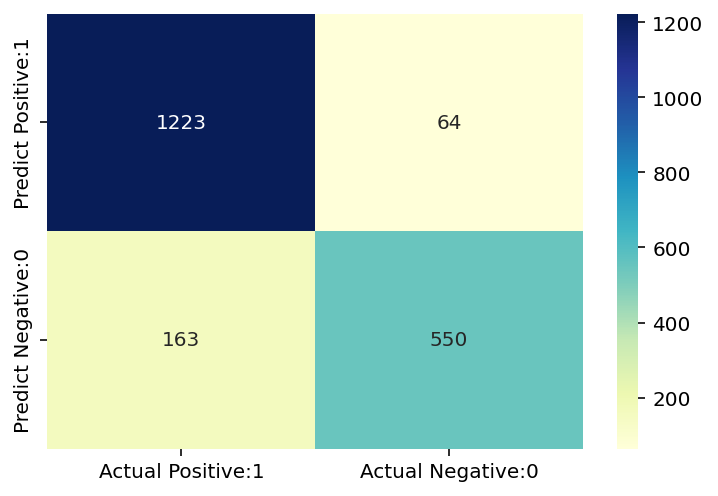

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.88      0.95      0.92      1287
           1       0.90      0.77      0.83       713

    accuracy                           0.89      2000
   macro avg       0.89      0.86      0.87      2000
weighted avg       0.89      0.89      0.88      2000

_____________________________________________________________________________
Classification accuracy : 0.8865
_____________________________________________________________________________


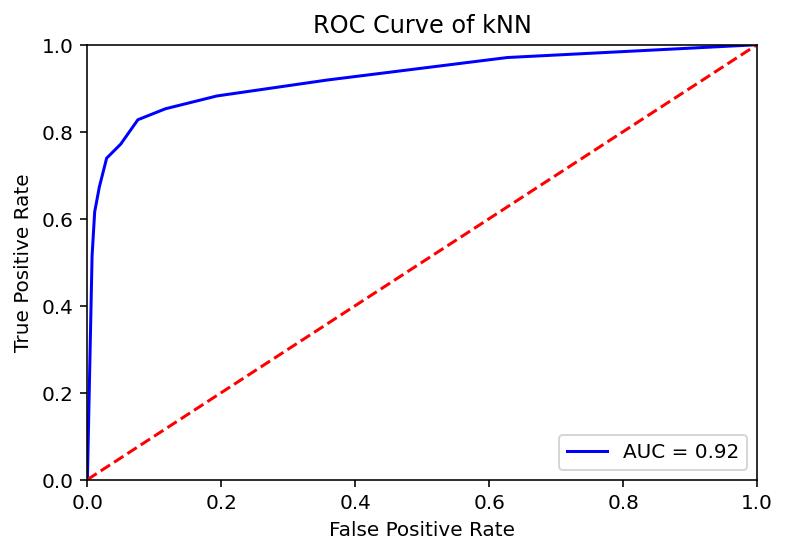

K -----> 13
Model accuracy score: 0.8865
Training-set accuracy score: 0.8929
Confusion matrix

 [[1209   78]
 [ 149  564]]

True Positives(TP) =  1209

True Negatives(TN) =  564

False Positives(FP) =  78

False Negatives(FN) =  149
_____________________________________________________________________________


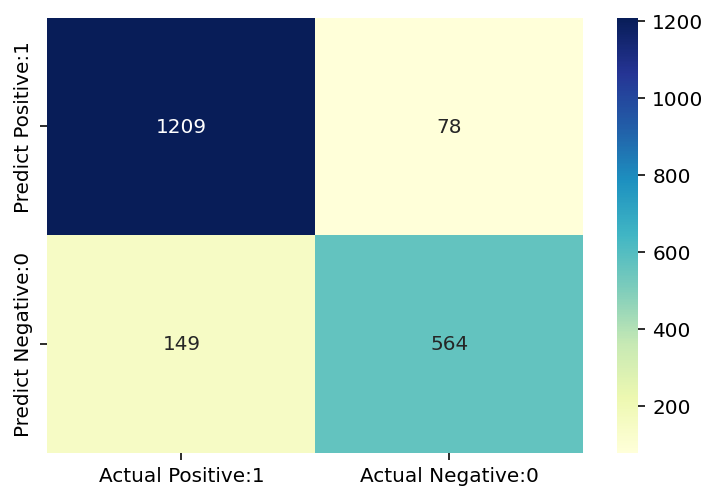

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.89      0.94      0.91      1287
           1       0.88      0.79      0.83       713

    accuracy                           0.89      2000
   macro avg       0.88      0.87      0.87      2000
weighted avg       0.89      0.89      0.89      2000

_____________________________________________________________________________
Classification accuracy : 0.8865
_____________________________________________________________________________


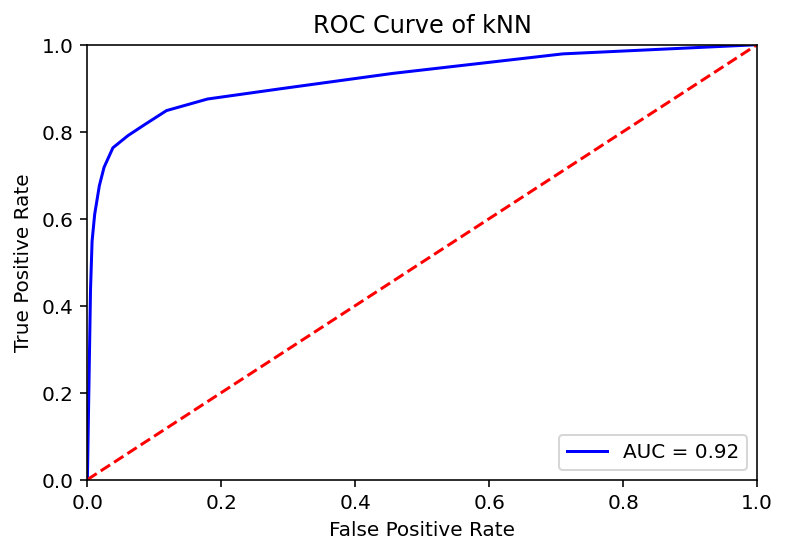

K -----> 16
Model accuracy score: 0.8855
Training-set accuracy score: 0.8850
Confusion matrix

 [[1223   64]
 [ 165  548]]

True Positives(TP) =  1223

True Negatives(TN) =  548

False Positives(FP) =  64

False Negatives(FN) =  165
_____________________________________________________________________________


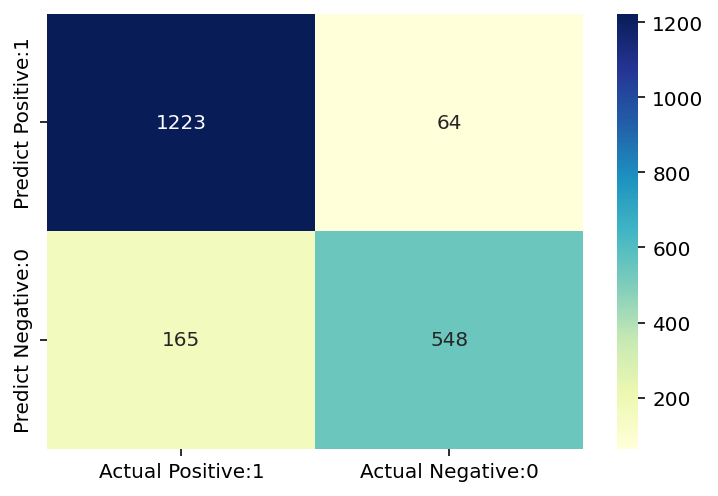

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.88      0.95      0.91      1287
           1       0.90      0.77      0.83       713

    accuracy                           0.89      2000
   macro avg       0.89      0.86      0.87      2000
weighted avg       0.89      0.89      0.88      2000

_____________________________________________________________________________
Classification accuracy : 0.8855
_____________________________________________________________________________


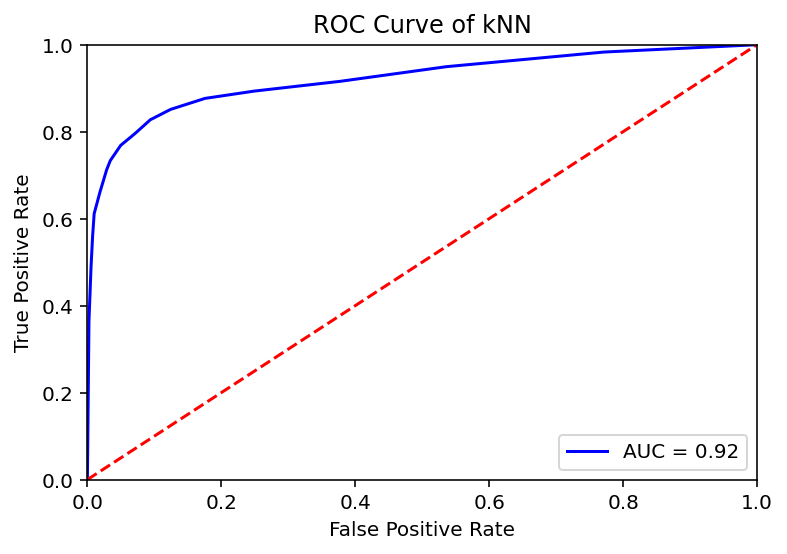

K -----> 19
Model accuracy score: 0.8810
Training-set accuracy score: 0.8828
Confusion matrix

 [[1211   76]
 [ 162  551]]

True Positives(TP) =  1211

True Negatives(TN) =  551

False Positives(FP) =  76

False Negatives(FN) =  162
_____________________________________________________________________________


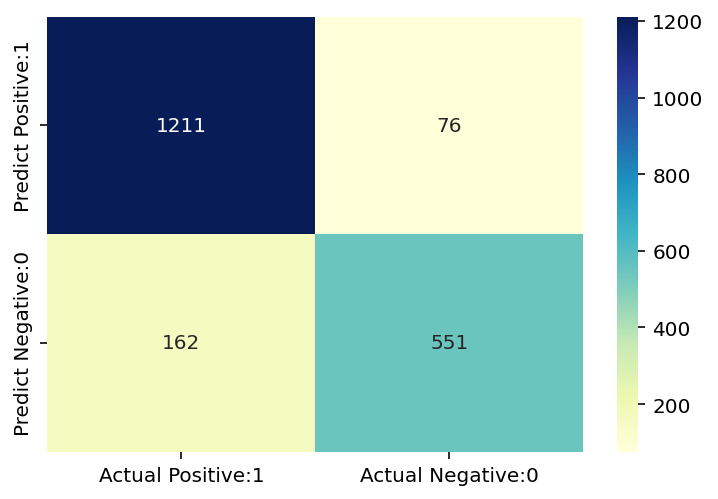

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.88      0.94      0.91      1287
           1       0.88      0.77      0.82       713

    accuracy                           0.88      2000
   macro avg       0.88      0.86      0.87      2000
weighted avg       0.88      0.88      0.88      2000

_____________________________________________________________________________
Classification accuracy : 0.8810
_____________________________________________________________________________


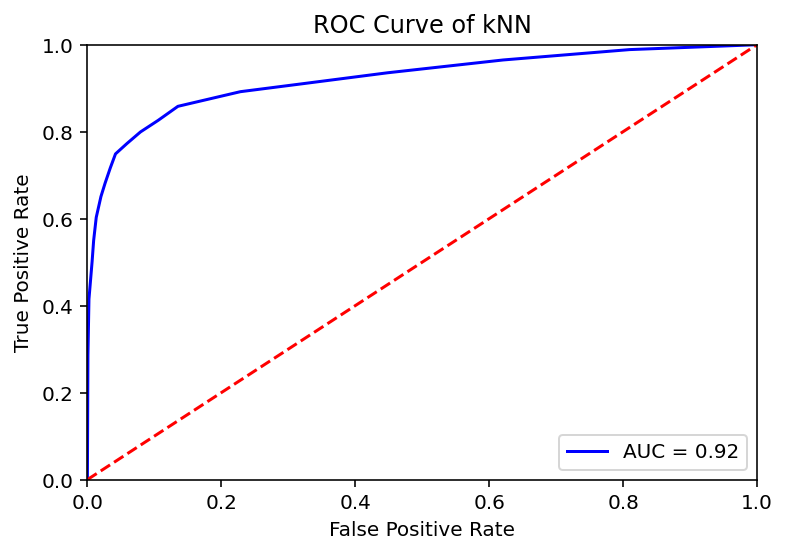

K -----> 22
Model accuracy score: 0.8795
Training-set accuracy score: 0.8769
Confusion matrix

 [[1219   68]
 [ 173  540]]

True Positives(TP) =  1219

True Negatives(TN) =  540

False Positives(FP) =  68

False Negatives(FN) =  173
_____________________________________________________________________________


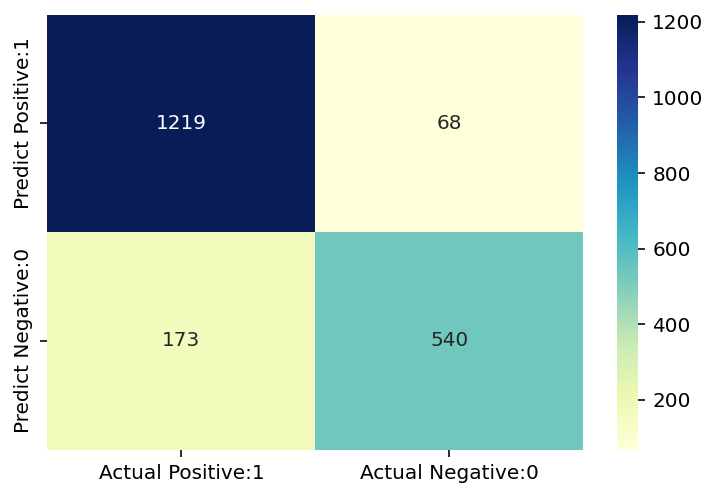

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.88      0.95      0.91      1287
           1       0.89      0.76      0.82       713

    accuracy                           0.88      2000
   macro avg       0.88      0.85      0.86      2000
weighted avg       0.88      0.88      0.88      2000

_____________________________________________________________________________
Classification accuracy : 0.8795
_____________________________________________________________________________


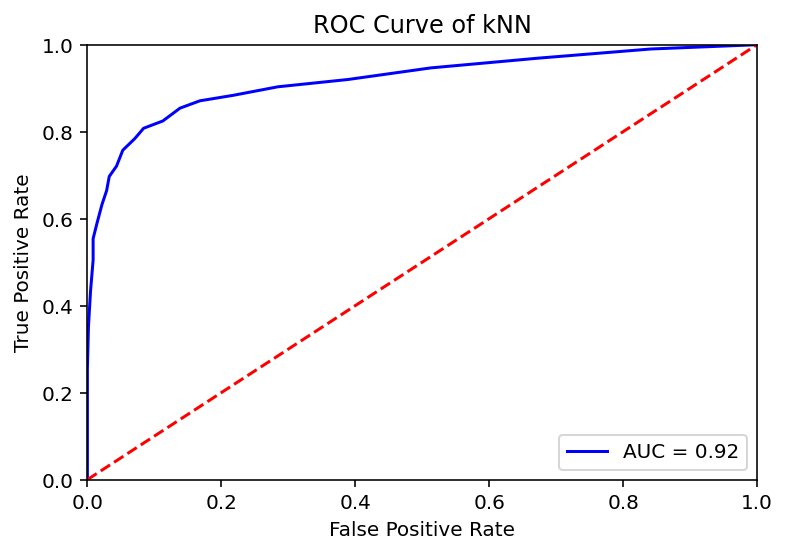

K -----> 25
Model accuracy score: 0.8745
Training-set accuracy score: 0.8726
Confusion matrix

 [[1208   79]
 [ 172  541]]

True Positives(TP) =  1208

True Negatives(TN) =  541

False Positives(FP) =  79

False Negatives(FN) =  172
_____________________________________________________________________________


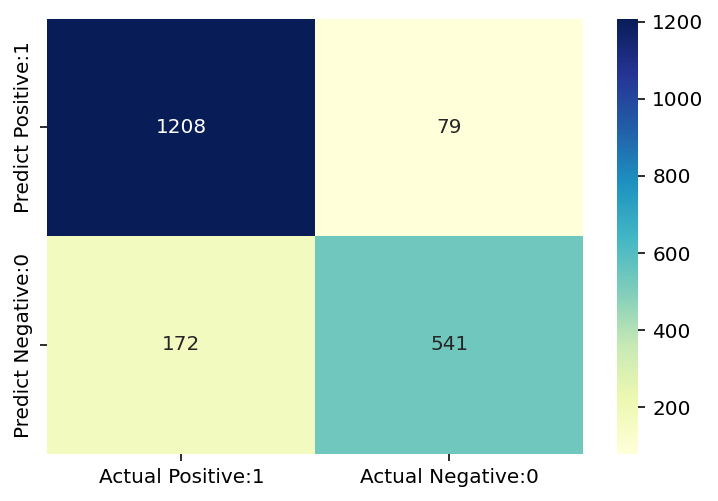

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.88      0.94      0.91      1287
           1       0.87      0.76      0.81       713

    accuracy                           0.87      2000
   macro avg       0.87      0.85      0.86      2000
weighted avg       0.87      0.87      0.87      2000

_____________________________________________________________________________
Classification accuracy : 0.8745
_____________________________________________________________________________


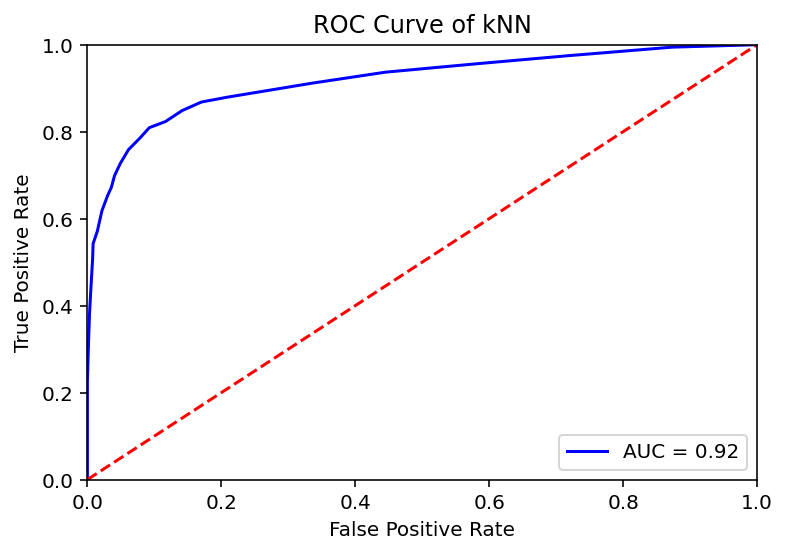

[]
50000
K -----> 1
Model accuracy score: 0.8923
Training-set accuracy score: 0.9997
Confusion matrix

 [[5807  556]
 [ 521 3116]]

True Positives(TP) =  5807

True Negatives(TN) =  3116

False Positives(FP) =  556

False Negatives(FN) =  521
_____________________________________________________________________________


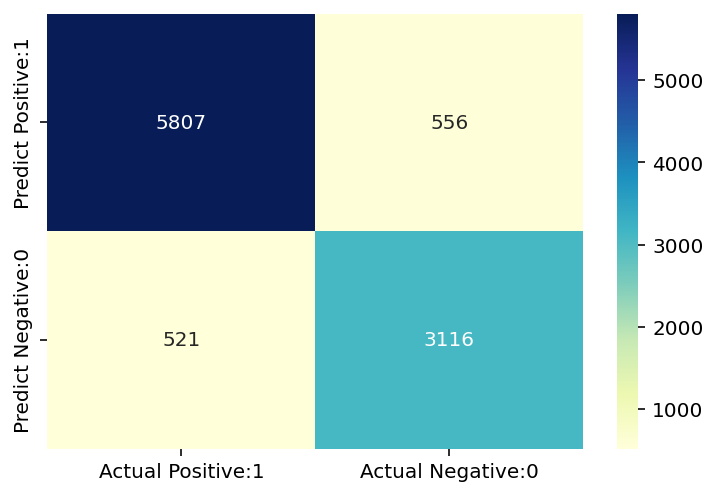

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.92      0.91      0.92      6363
           1       0.85      0.86      0.85      3637

    accuracy                           0.89     10000
   macro avg       0.88      0.88      0.88     10000
weighted avg       0.89      0.89      0.89     10000

_____________________________________________________________________________
Classification accuracy : 0.8923
_____________________________________________________________________________


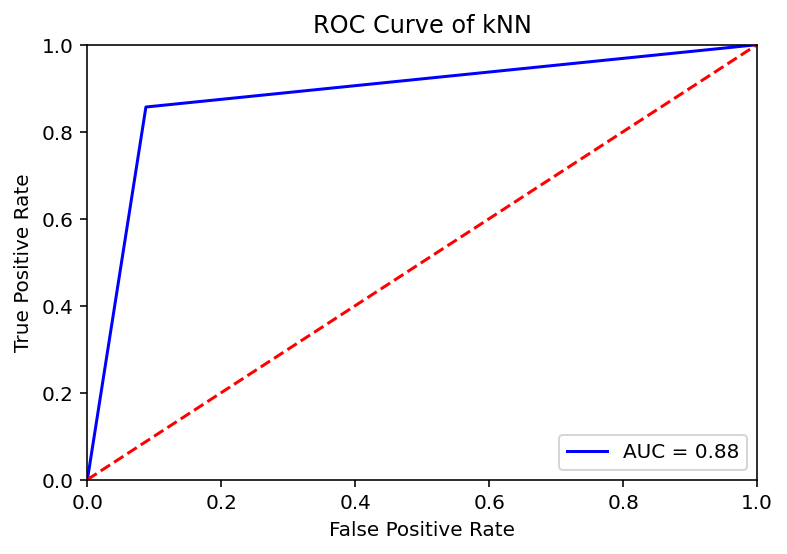

K -----> 4
Model accuracy score: 0.9164
Training-set accuracy score: 0.9348
Confusion matrix

 [[6181  182]
 [ 654 2983]]

True Positives(TP) =  6181

True Negatives(TN) =  2983

False Positives(FP) =  182

False Negatives(FN) =  654
_____________________________________________________________________________


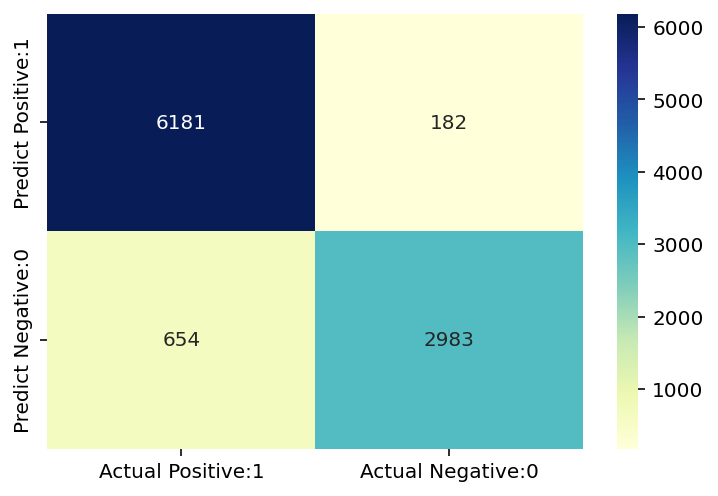

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.90      0.97      0.94      6363
           1       0.94      0.82      0.88      3637

    accuracy                           0.92     10000
   macro avg       0.92      0.90      0.91     10000
weighted avg       0.92      0.92      0.91     10000

_____________________________________________________________________________
Classification accuracy : 0.9164
_____________________________________________________________________________


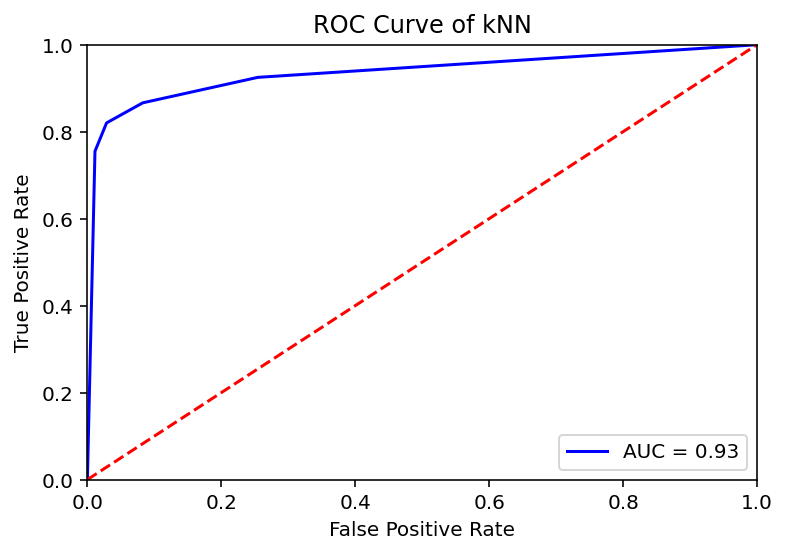

K -----> 7
Model accuracy score: 0.9113
Training-set accuracy score: 0.9276
Confusion matrix

 [[6078  285]
 [ 602 3035]]

True Positives(TP) =  6078

True Negatives(TN) =  3035

False Positives(FP) =  285

False Negatives(FN) =  602
_____________________________________________________________________________


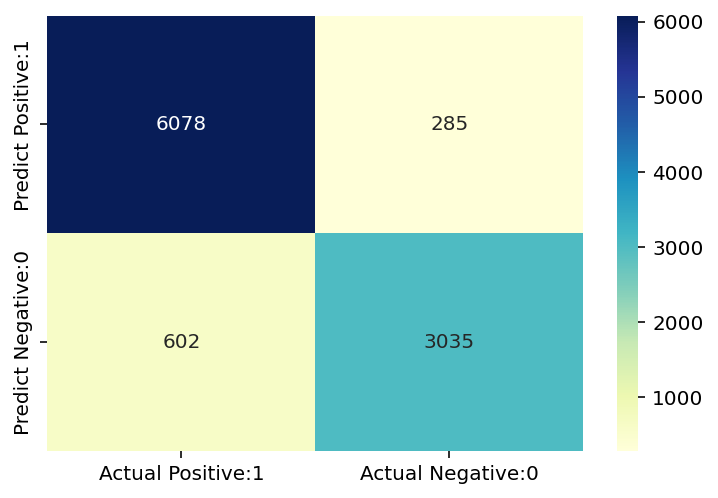

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.96      0.93      6363
           1       0.91      0.83      0.87      3637

    accuracy                           0.91     10000
   macro avg       0.91      0.89      0.90     10000
weighted avg       0.91      0.91      0.91     10000

_____________________________________________________________________________
Classification accuracy : 0.9113
_____________________________________________________________________________


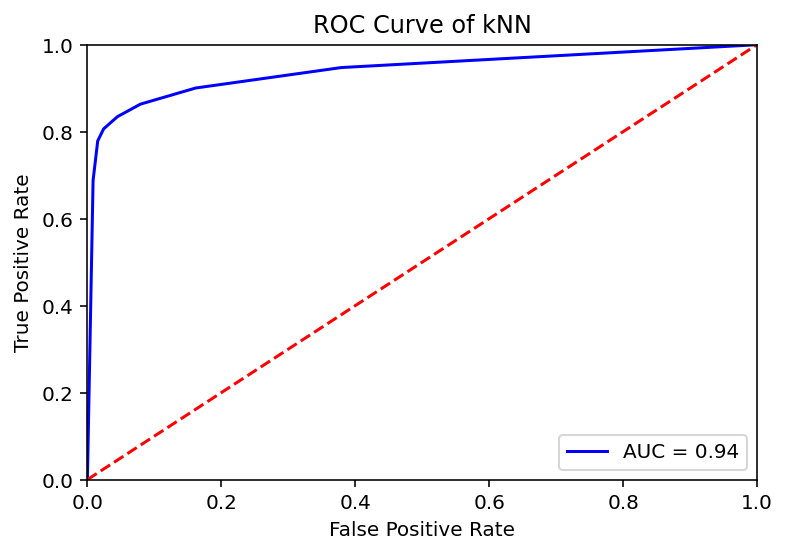

K -----> 10
Model accuracy score: 0.9101
Training-set accuracy score: 0.9221
Confusion matrix

 [[6137  226]
 [ 673 2964]]

True Positives(TP) =  6137

True Negatives(TN) =  2964

False Positives(FP) =  226

False Negatives(FN) =  673
_____________________________________________________________________________


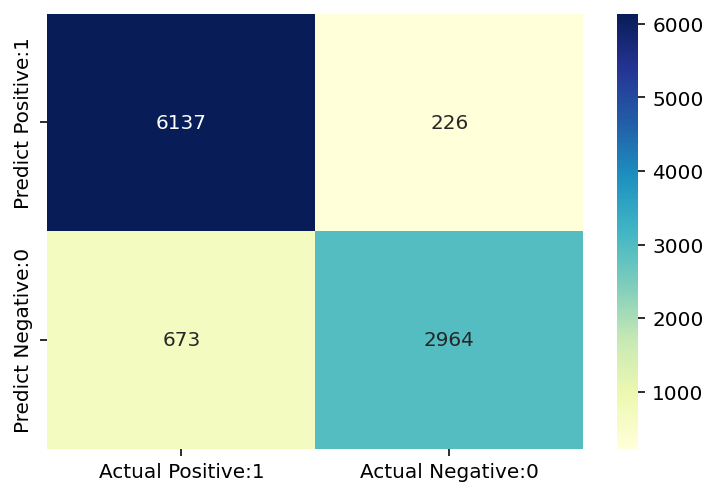

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.90      0.96      0.93      6363
           1       0.93      0.81      0.87      3637

    accuracy                           0.91     10000
   macro avg       0.92      0.89      0.90     10000
weighted avg       0.91      0.91      0.91     10000

_____________________________________________________________________________
Classification accuracy : 0.9101
_____________________________________________________________________________


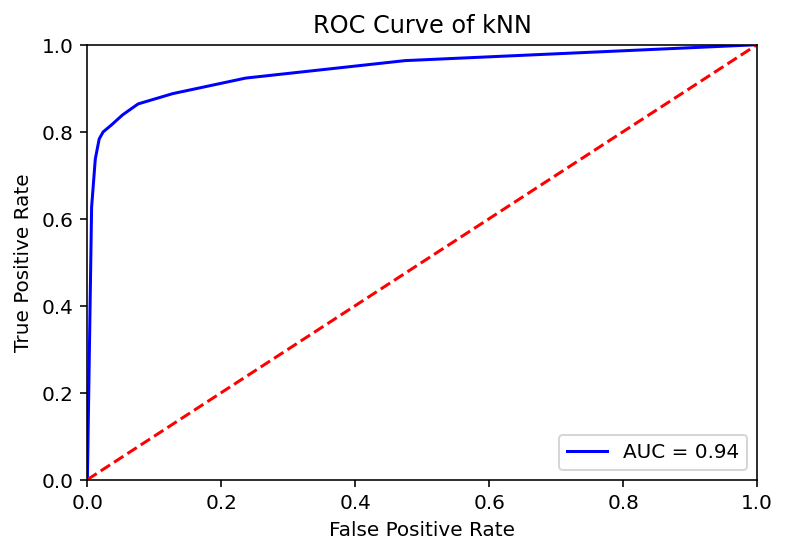

K -----> 13
Model accuracy score: 0.9091
Training-set accuracy score: 0.9194
Confusion matrix

 [[6100  263]
 [ 646 2991]]

True Positives(TP) =  6100

True Negatives(TN) =  2991

False Positives(FP) =  263

False Negatives(FN) =  646
_____________________________________________________________________________


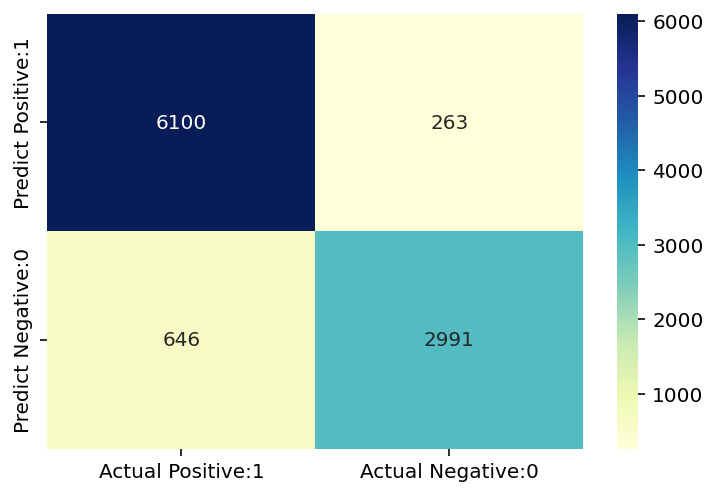

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.90      0.96      0.93      6363
           1       0.92      0.82      0.87      3637

    accuracy                           0.91     10000
   macro avg       0.91      0.89      0.90     10000
weighted avg       0.91      0.91      0.91     10000

_____________________________________________________________________________
Classification accuracy : 0.9091
_____________________________________________________________________________


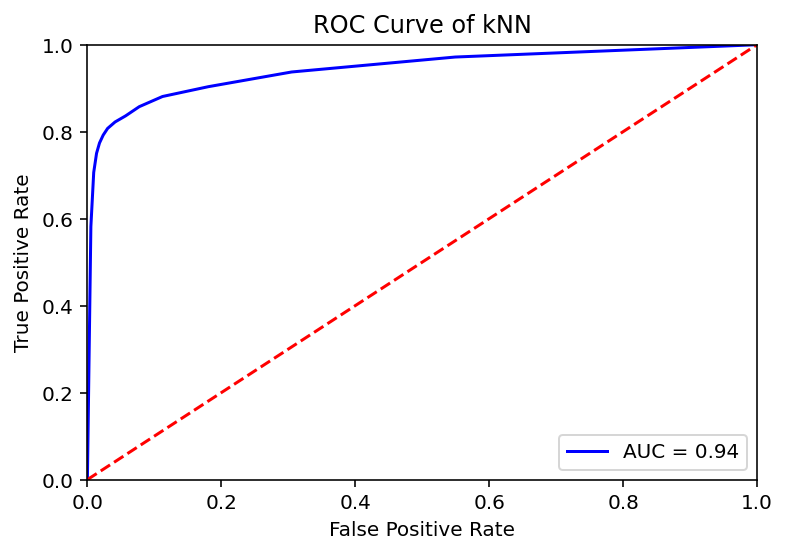

K -----> 16
Model accuracy score: 0.9087
Training-set accuracy score: 0.9156
Confusion matrix

 [[6134  229]
 [ 684 2953]]

True Positives(TP) =  6134

True Negatives(TN) =  2953

False Positives(FP) =  229

False Negatives(FN) =  684
_____________________________________________________________________________


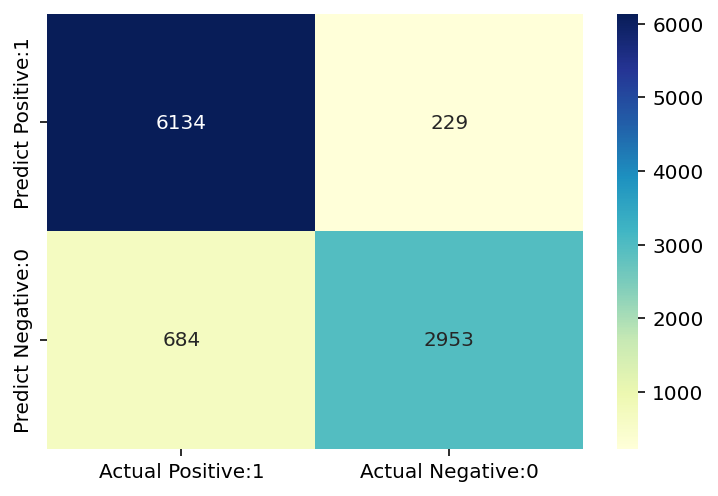

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.90      0.96      0.93      6363
           1       0.93      0.81      0.87      3637

    accuracy                           0.91     10000
   macro avg       0.91      0.89      0.90     10000
weighted avg       0.91      0.91      0.91     10000

_____________________________________________________________________________
Classification accuracy : 0.9087
_____________________________________________________________________________


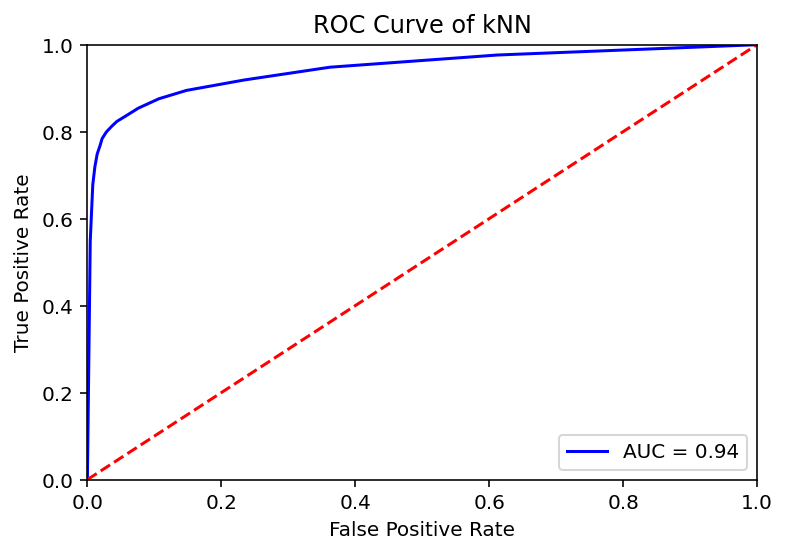

K -----> 19
Model accuracy score: 0.9078
Training-set accuracy score: 0.9139
Confusion matrix

 [[6111  252]
 [ 670 2967]]

True Positives(TP) =  6111

True Negatives(TN) =  2967

False Positives(FP) =  252

False Negatives(FN) =  670
_____________________________________________________________________________


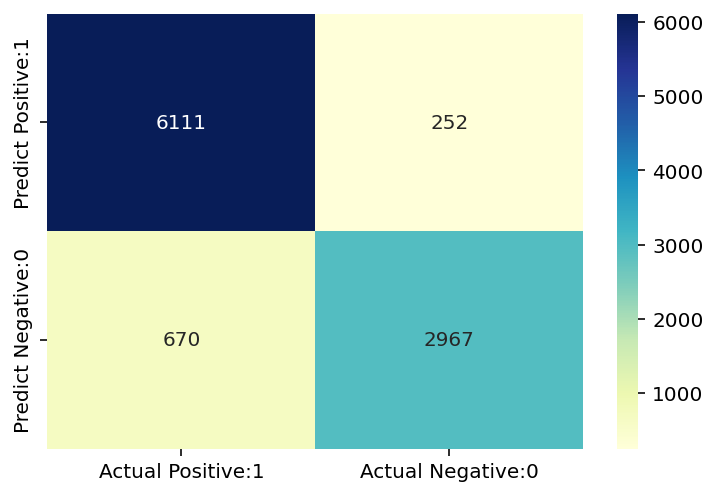

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.90      0.96      0.93      6363
           1       0.92      0.82      0.87      3637

    accuracy                           0.91     10000
   macro avg       0.91      0.89      0.90     10000
weighted avg       0.91      0.91      0.91     10000

_____________________________________________________________________________
Classification accuracy : 0.9078
_____________________________________________________________________________


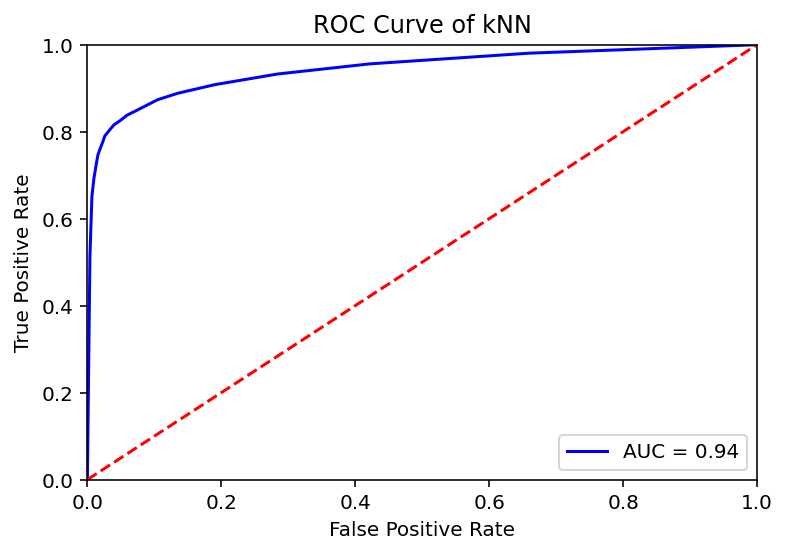

K -----> 22
Model accuracy score: 0.9069
Training-set accuracy score: 0.9116
Confusion matrix

 [[6132  231]
 [ 700 2937]]

True Positives(TP) =  6132

True Negatives(TN) =  2937

False Positives(FP) =  231

False Negatives(FN) =  700
_____________________________________________________________________________


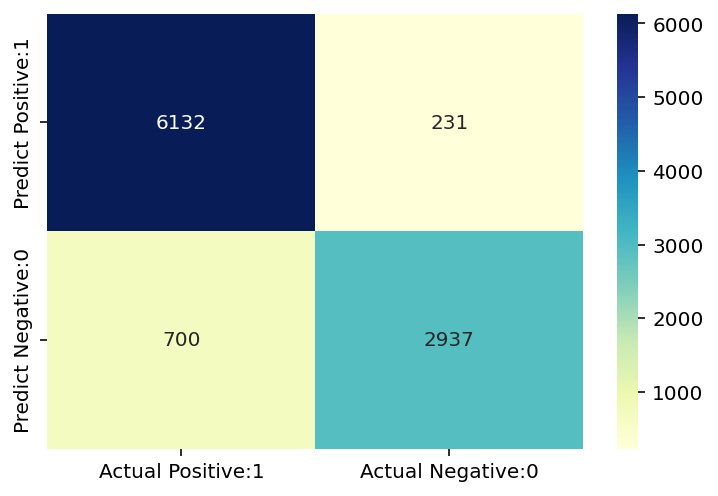

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.90      0.96      0.93      6363
           1       0.93      0.81      0.86      3637

    accuracy                           0.91     10000
   macro avg       0.91      0.89      0.90     10000
weighted avg       0.91      0.91      0.91     10000

_____________________________________________________________________________
Classification accuracy : 0.9069
_____________________________________________________________________________


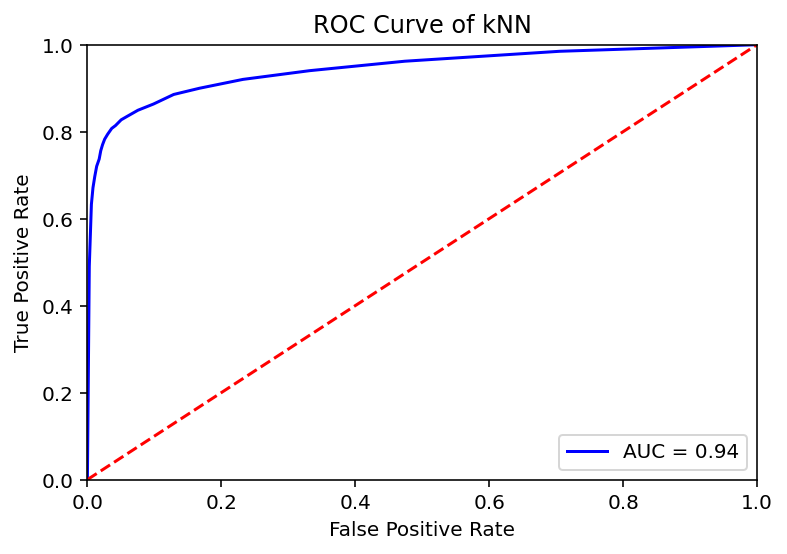

K -----> 25
Model accuracy score: 0.9047
Training-set accuracy score: 0.9096
Confusion matrix

 [[6117  246]
 [ 707 2930]]

True Positives(TP) =  6117

True Negatives(TN) =  2930

False Positives(FP) =  246

False Negatives(FN) =  707
_____________________________________________________________________________


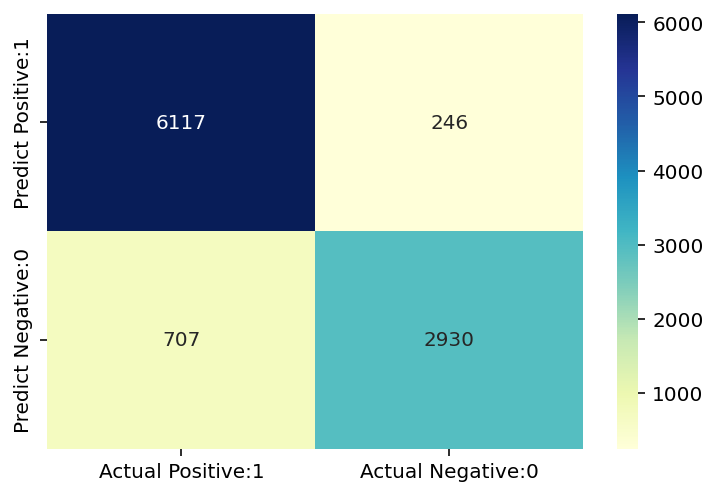

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.90      0.96      0.93      6363
           1       0.92      0.81      0.86      3637

    accuracy                           0.90     10000
   macro avg       0.91      0.88      0.89     10000
weighted avg       0.91      0.90      0.90     10000

_____________________________________________________________________________
Classification accuracy : 0.9047
_____________________________________________________________________________


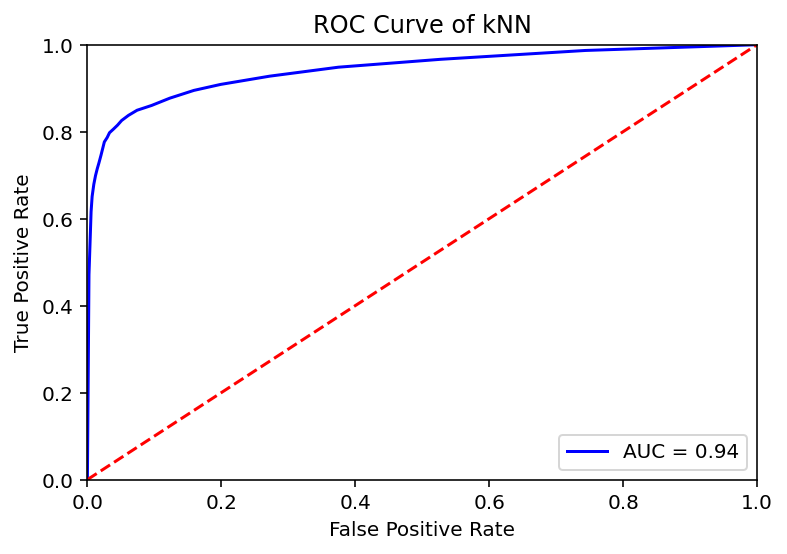

[]
100000
K -----> 1
Model accuracy score: 0.9025
Training-set accuracy score: 0.9996
Confusion matrix

 [[11732   929]
 [ 1020  6319]]

True Positives(TP) =  11732

True Negatives(TN) =  6319

False Positives(FP) =  929

False Negatives(FN) =  1020
_____________________________________________________________________________


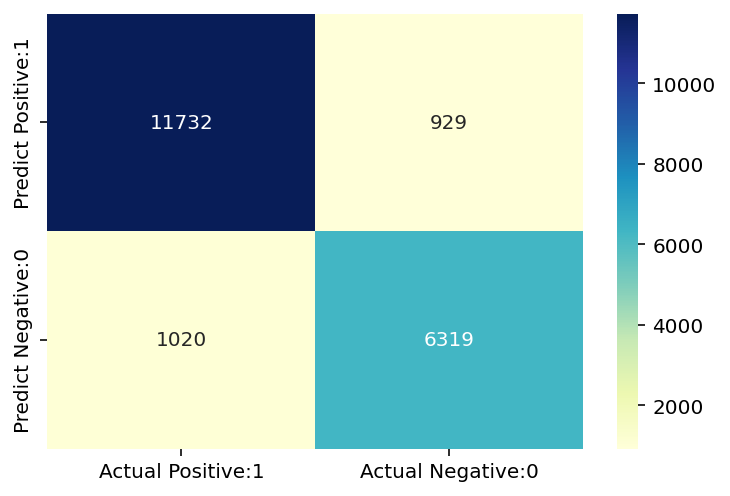

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.92      0.93      0.92     12661
           1       0.87      0.86      0.87      7339

    accuracy                           0.90     20000
   macro avg       0.90      0.89      0.89     20000
weighted avg       0.90      0.90      0.90     20000

_____________________________________________________________________________
Classification accuracy : 0.9025
_____________________________________________________________________________


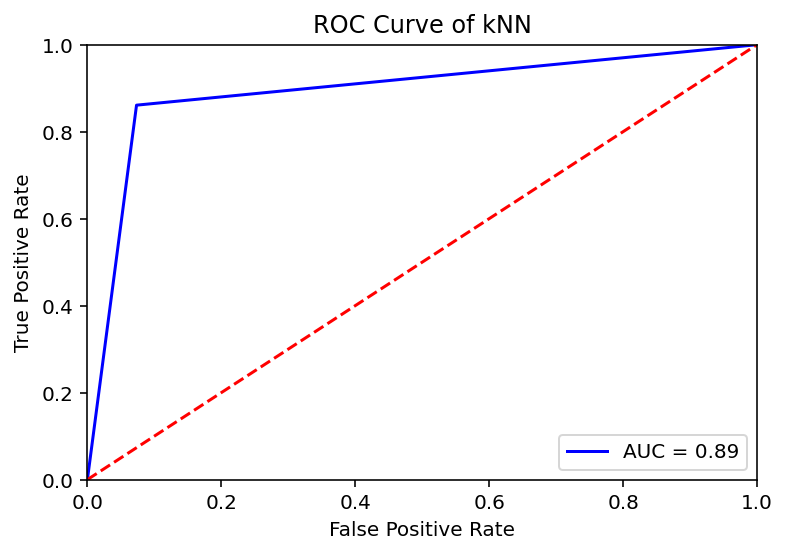

K -----> 4
Model accuracy score: 0.9186
Training-set accuracy score: 0.9395
Confusion matrix

 [[12293   368]
 [ 1260  6079]]

True Positives(TP) =  12293

True Negatives(TN) =  6079

False Positives(FP) =  368

False Negatives(FN) =  1260
_____________________________________________________________________________


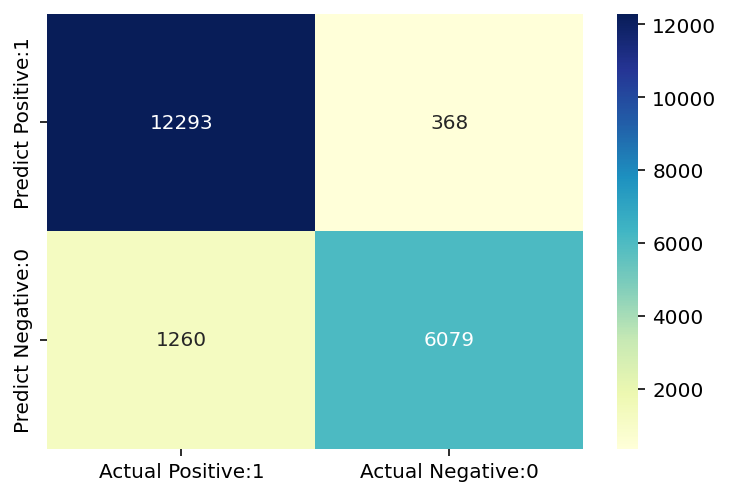

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.97      0.94     12661
           1       0.94      0.83      0.88      7339

    accuracy                           0.92     20000
   macro avg       0.92      0.90      0.91     20000
weighted avg       0.92      0.92      0.92     20000

_____________________________________________________________________________
Classification accuracy : 0.9186
_____________________________________________________________________________


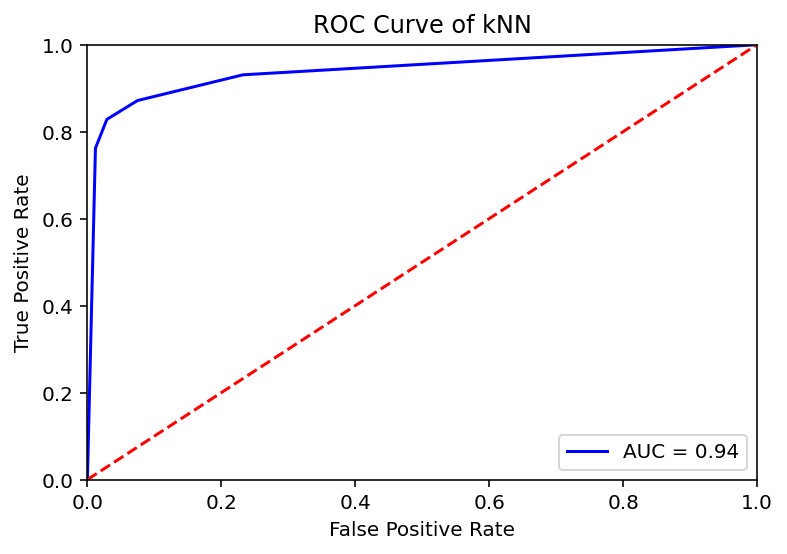

K -----> 7
Model accuracy score: 0.9162
Training-set accuracy score: 0.9325
Confusion matrix

 [[12159   502]
 [ 1175  6164]]

True Positives(TP) =  12159

True Negatives(TN) =  6164

False Positives(FP) =  502

False Negatives(FN) =  1175
_____________________________________________________________________________


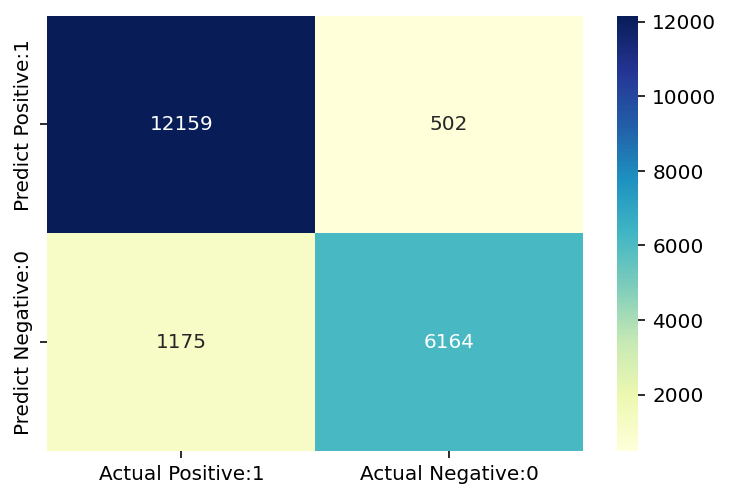

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.96      0.94     12661
           1       0.92      0.84      0.88      7339

    accuracy                           0.92     20000
   macro avg       0.92      0.90      0.91     20000
weighted avg       0.92      0.92      0.92     20000

_____________________________________________________________________________
Classification accuracy : 0.9162
_____________________________________________________________________________


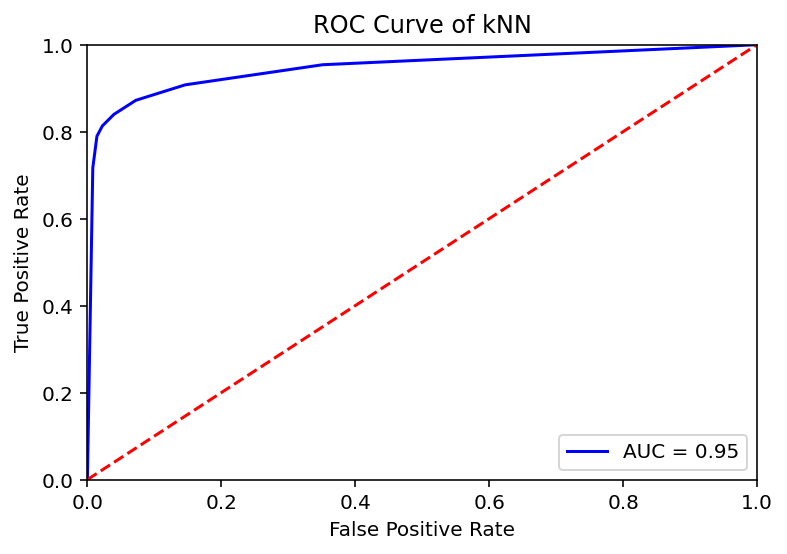

K -----> 10
Model accuracy score: 0.9165
Training-set accuracy score: 0.9274
Confusion matrix

 [[12277   384]
 [ 1285  6054]]

True Positives(TP) =  12277

True Negatives(TN) =  6054

False Positives(FP) =  384

False Negatives(FN) =  1285
_____________________________________________________________________________


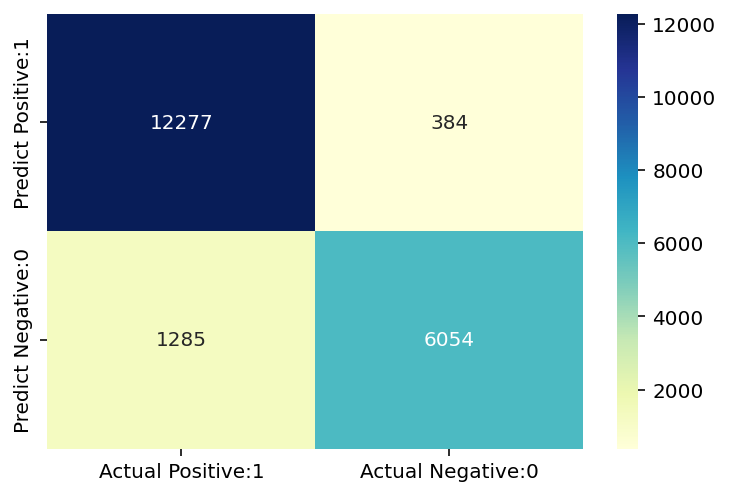

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.97      0.94     12661
           1       0.94      0.82      0.88      7339

    accuracy                           0.92     20000
   macro avg       0.92      0.90      0.91     20000
weighted avg       0.92      0.92      0.92     20000

_____________________________________________________________________________
Classification accuracy : 0.9165
_____________________________________________________________________________


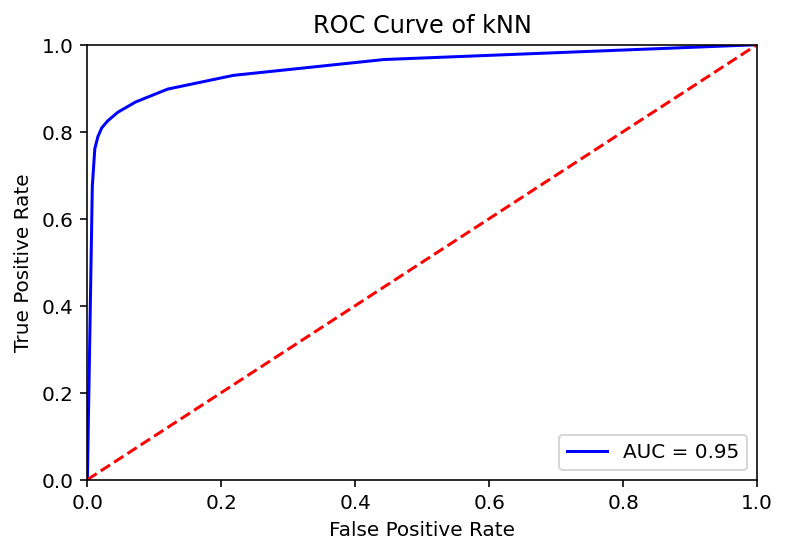

K -----> 13
Model accuracy score: 0.9146
Training-set accuracy score: 0.9251
Confusion matrix

 [[12197   464]
 [ 1243  6096]]

True Positives(TP) =  12197

True Negatives(TN) =  6096

False Positives(FP) =  464

False Negatives(FN) =  1243
_____________________________________________________________________________


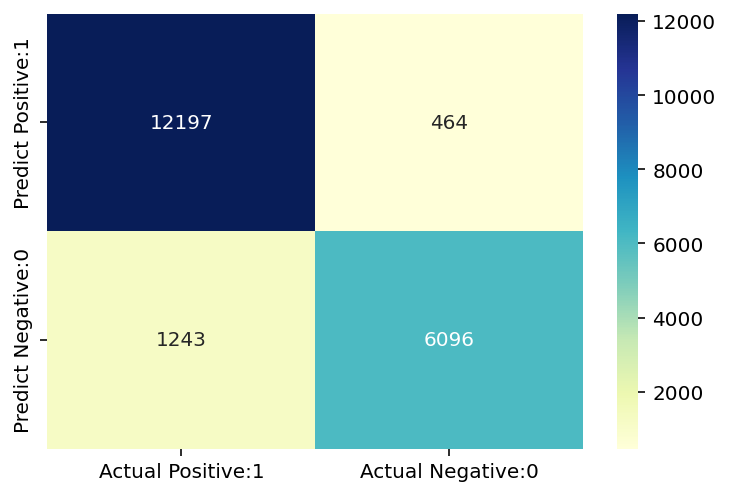

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.96      0.93     12661
           1       0.93      0.83      0.88      7339

    accuracy                           0.91     20000
   macro avg       0.92      0.90      0.91     20000
weighted avg       0.92      0.91      0.91     20000

_____________________________________________________________________________
Classification accuracy : 0.9146
_____________________________________________________________________________


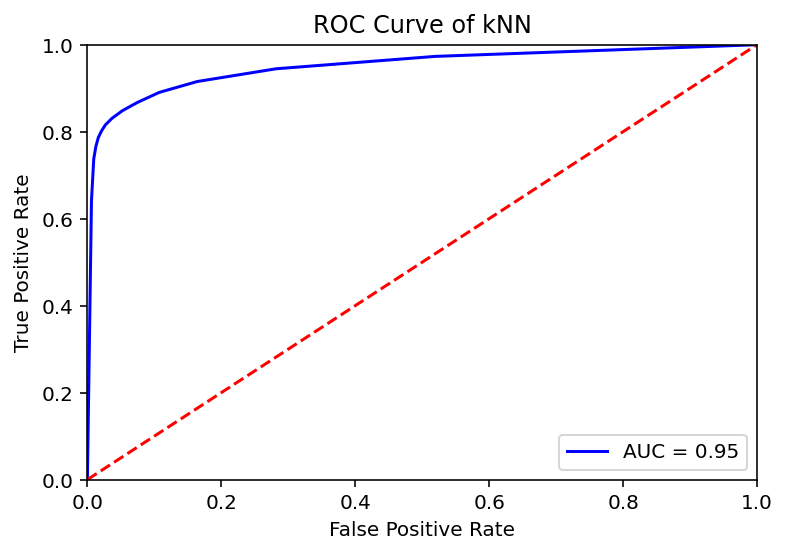

K -----> 16
Model accuracy score: 0.9134
Training-set accuracy score: 0.9228
Confusion matrix

 [[12252   409]
 [ 1322  6017]]

True Positives(TP) =  12252

True Negatives(TN) =  6017

False Positives(FP) =  409

False Negatives(FN) =  1322
_____________________________________________________________________________


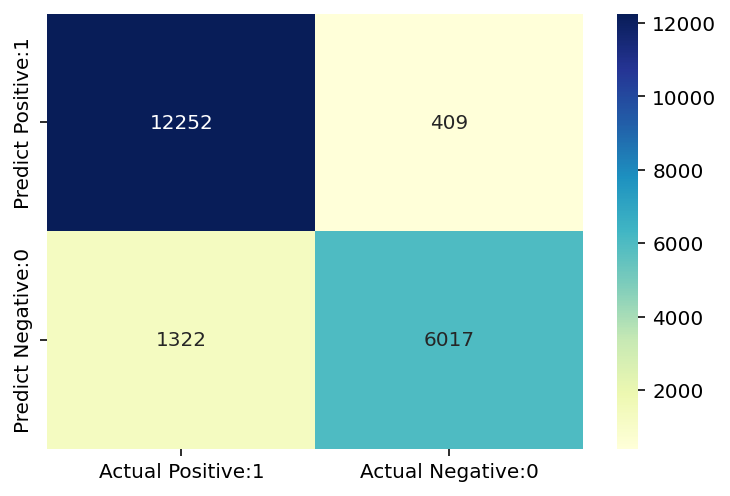

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.90      0.97      0.93     12661
           1       0.94      0.82      0.87      7339

    accuracy                           0.91     20000
   macro avg       0.92      0.89      0.90     20000
weighted avg       0.91      0.91      0.91     20000

_____________________________________________________________________________
Classification accuracy : 0.9134
_____________________________________________________________________________


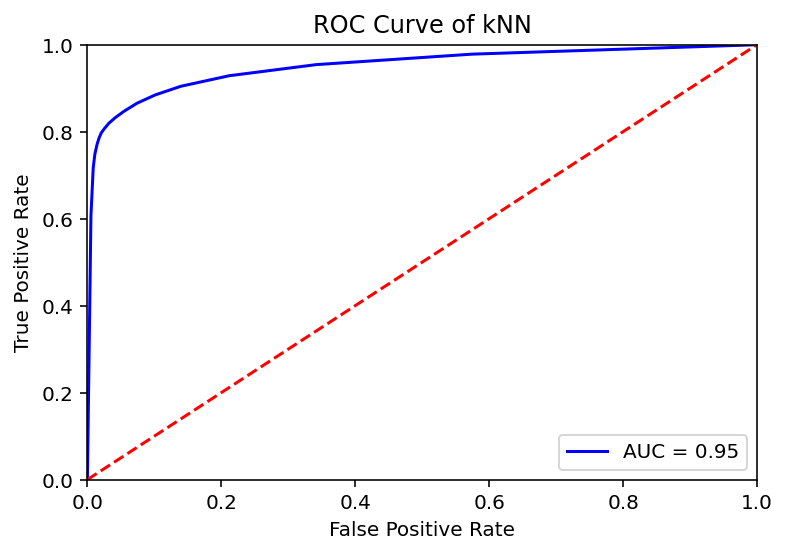

K -----> 19
Model accuracy score: 0.9115
Training-set accuracy score: 0.9205
Confusion matrix

 [[12190   471]
 [ 1298  6041]]

True Positives(TP) =  12190

True Negatives(TN) =  6041

False Positives(FP) =  471

False Negatives(FN) =  1298
_____________________________________________________________________________


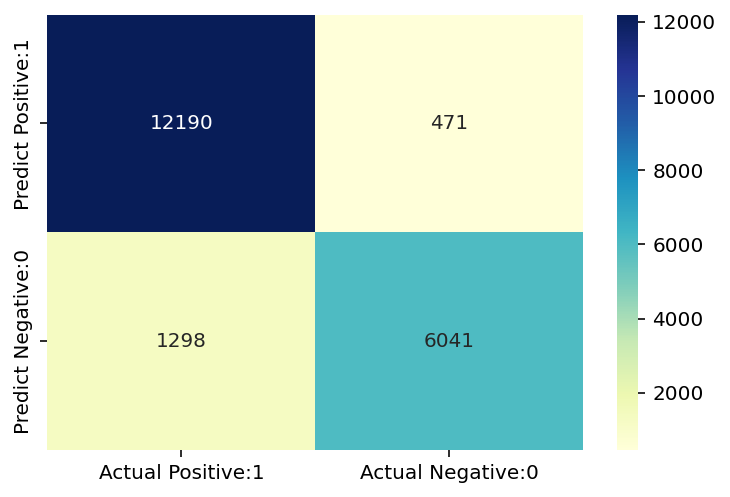

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.90      0.96      0.93     12661
           1       0.93      0.82      0.87      7339

    accuracy                           0.91     20000
   macro avg       0.92      0.89      0.90     20000
weighted avg       0.91      0.91      0.91     20000

_____________________________________________________________________________
Classification accuracy : 0.9115
_____________________________________________________________________________


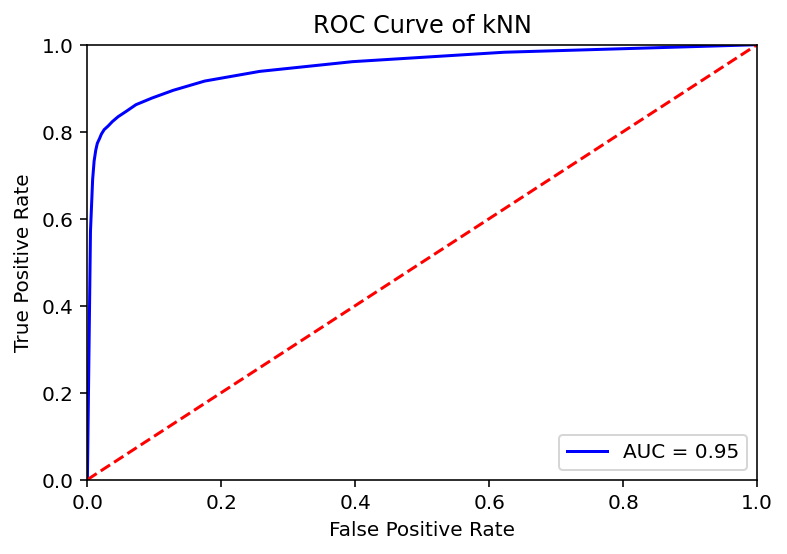

K -----> 22
Model accuracy score: 0.9110
Training-set accuracy score: 0.9185
Confusion matrix

 [[12221   440]
 [ 1340  5999]]

True Positives(TP) =  12221

True Negatives(TN) =  5999

False Positives(FP) =  440

False Negatives(FN) =  1340
_____________________________________________________________________________


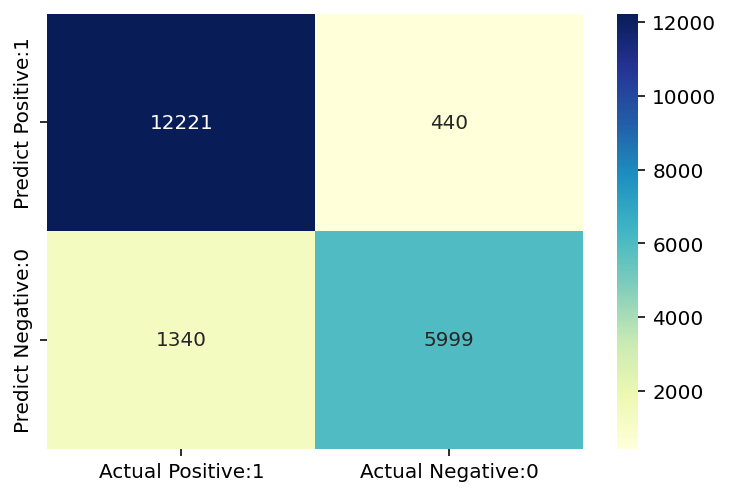

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.90      0.97      0.93     12661
           1       0.93      0.82      0.87      7339

    accuracy                           0.91     20000
   macro avg       0.92      0.89      0.90     20000
weighted avg       0.91      0.91      0.91     20000

_____________________________________________________________________________
Classification accuracy : 0.9110
_____________________________________________________________________________


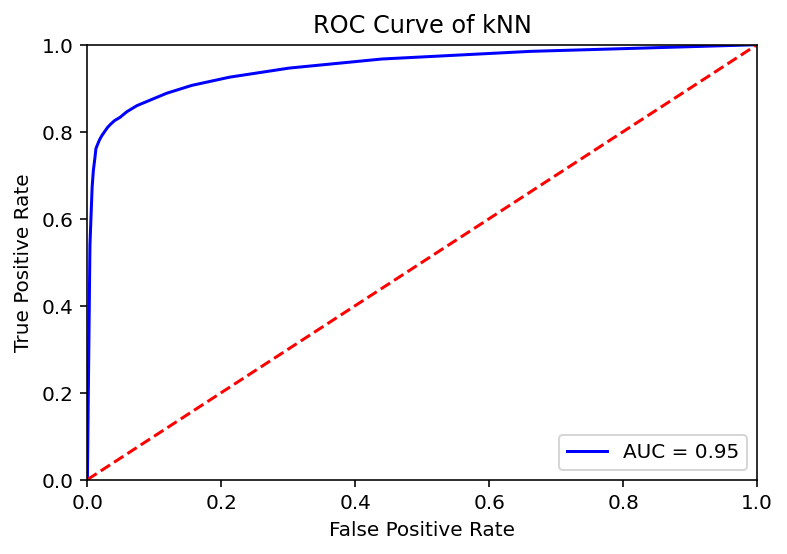

K -----> 25
Model accuracy score: 0.9094
Training-set accuracy score: 0.9171
Confusion matrix

 [[12172   489]
 [ 1323  6016]]

True Positives(TP) =  12172

True Negatives(TN) =  6016

False Positives(FP) =  489

False Negatives(FN) =  1323
_____________________________________________________________________________


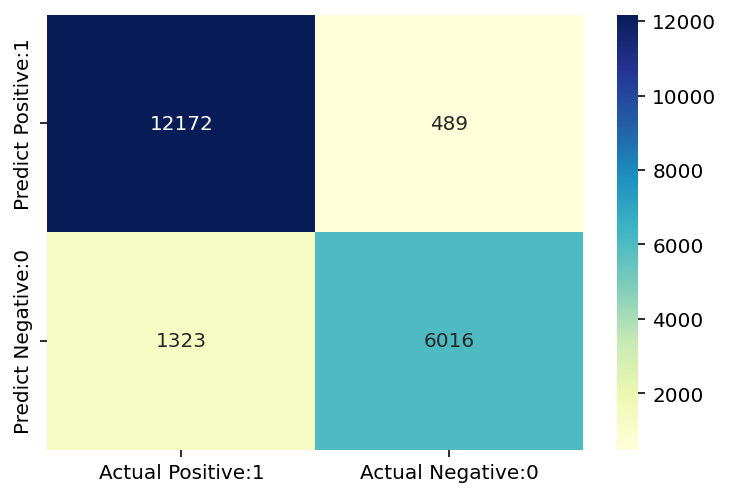

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.90      0.96      0.93     12661
           1       0.92      0.82      0.87      7339

    accuracy                           0.91     20000
   macro avg       0.91      0.89      0.90     20000
weighted avg       0.91      0.91      0.91     20000

_____________________________________________________________________________
Classification accuracy : 0.9094
_____________________________________________________________________________


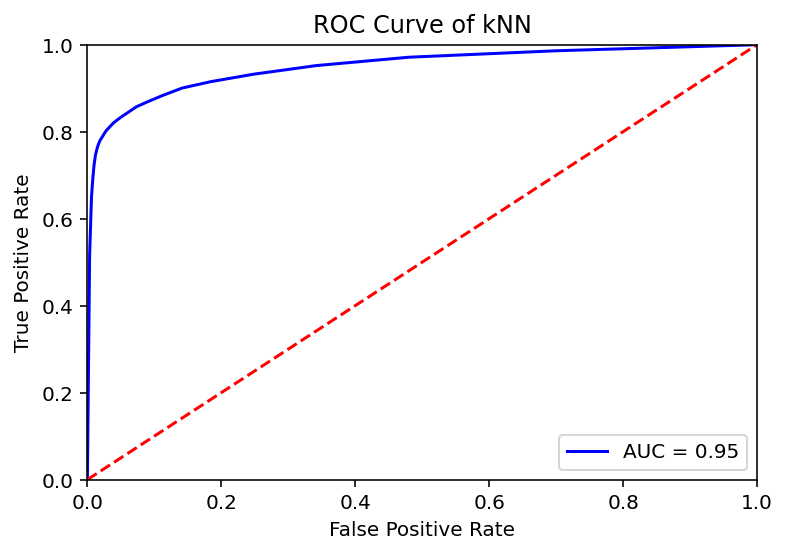

[]
150000
K -----> 1
Model accuracy score: 0.9079
Training-set accuracy score: 0.9993
Confusion matrix

 [[17751  1295]
 [ 1469  9485]]

True Positives(TP) =  17751

True Negatives(TN) =  9485

False Positives(FP) =  1295

False Negatives(FN) =  1469
_____________________________________________________________________________


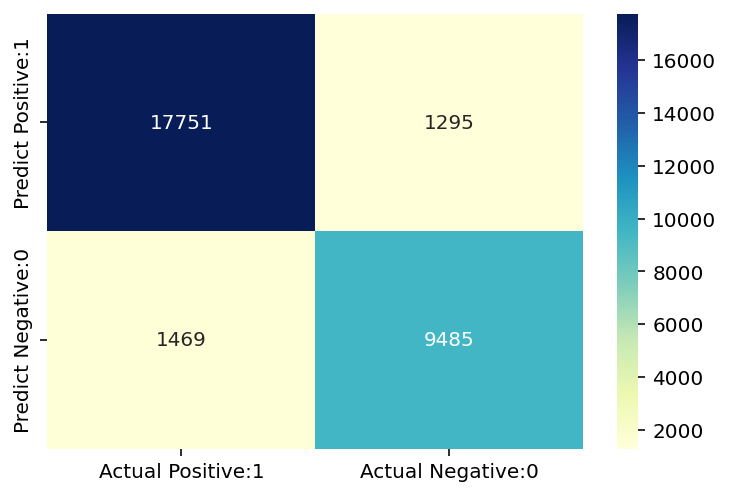

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.92      0.93      0.93     19046
           1       0.88      0.87      0.87     10954

    accuracy                           0.91     30000
   macro avg       0.90      0.90      0.90     30000
weighted avg       0.91      0.91      0.91     30000

_____________________________________________________________________________
Classification accuracy : 0.9079
_____________________________________________________________________________


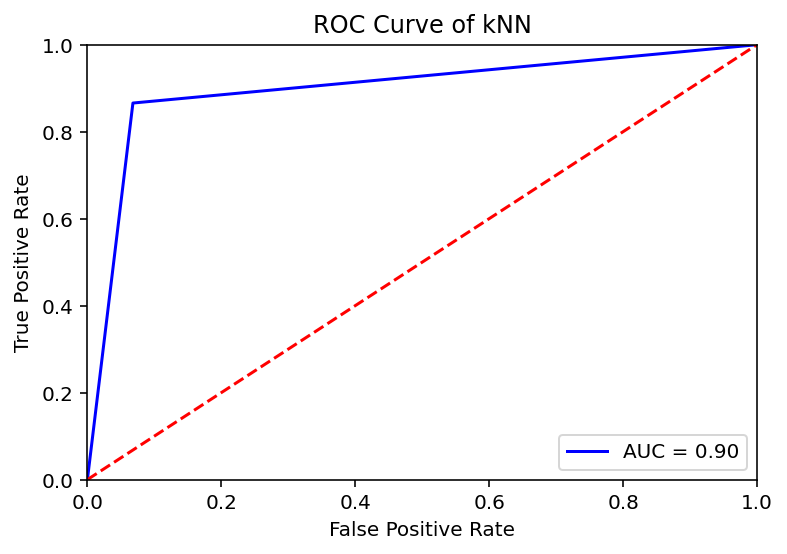

K -----> 4
Model accuracy score: 0.9219
Training-set accuracy score: 0.9407
Confusion matrix

 [[18516   530]
 [ 1814  9140]]

True Positives(TP) =  18516

True Negatives(TN) =  9140

False Positives(FP) =  530

False Negatives(FN) =  1814
_____________________________________________________________________________


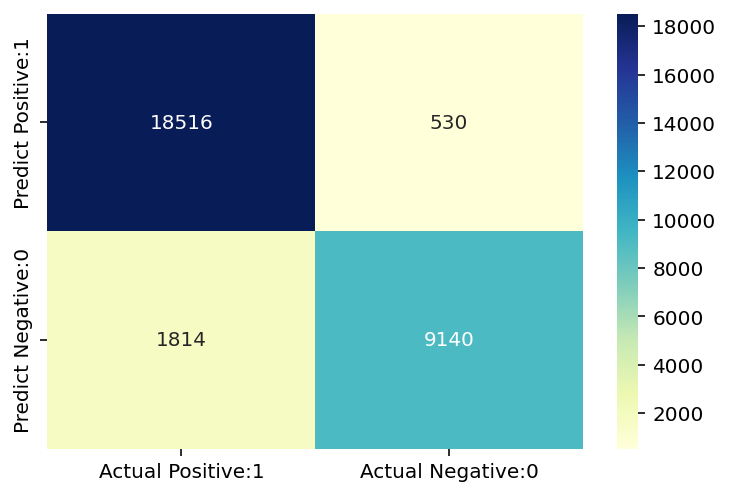

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.97      0.94     19046
           1       0.95      0.83      0.89     10954

    accuracy                           0.92     30000
   macro avg       0.93      0.90      0.91     30000
weighted avg       0.92      0.92      0.92     30000

_____________________________________________________________________________
Classification accuracy : 0.9219
_____________________________________________________________________________


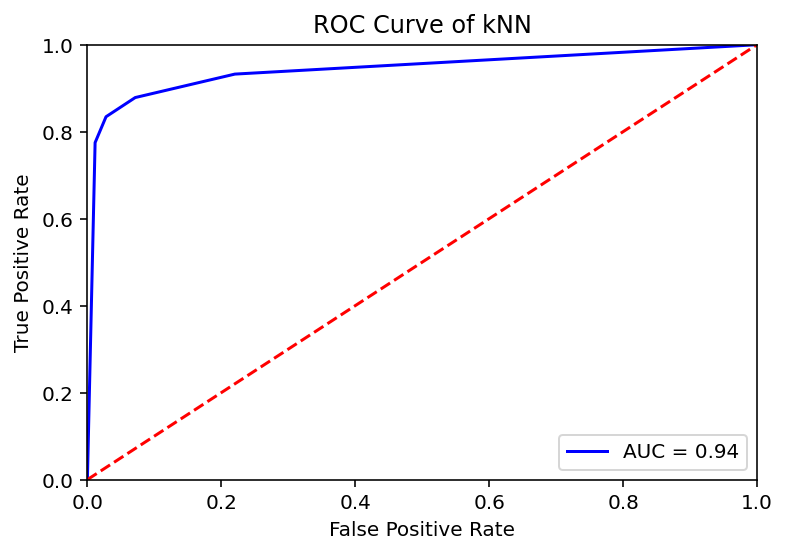

K -----> 7
Model accuracy score: 0.9178
Training-set accuracy score: 0.9341
Confusion matrix

 [[18261   785]
 [ 1680  9274]]

True Positives(TP) =  18261

True Negatives(TN) =  9274

False Positives(FP) =  785

False Negatives(FN) =  1680
_____________________________________________________________________________


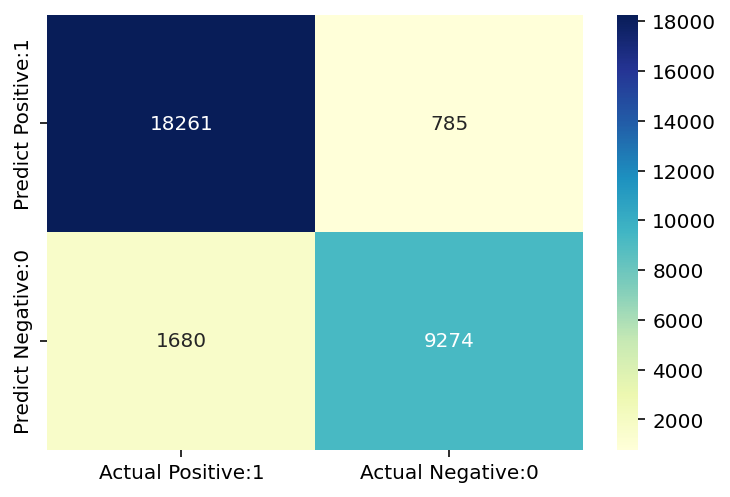

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.92      0.96      0.94     19046
           1       0.92      0.85      0.88     10954

    accuracy                           0.92     30000
   macro avg       0.92      0.90      0.91     30000
weighted avg       0.92      0.92      0.92     30000

_____________________________________________________________________________
Classification accuracy : 0.9178
_____________________________________________________________________________


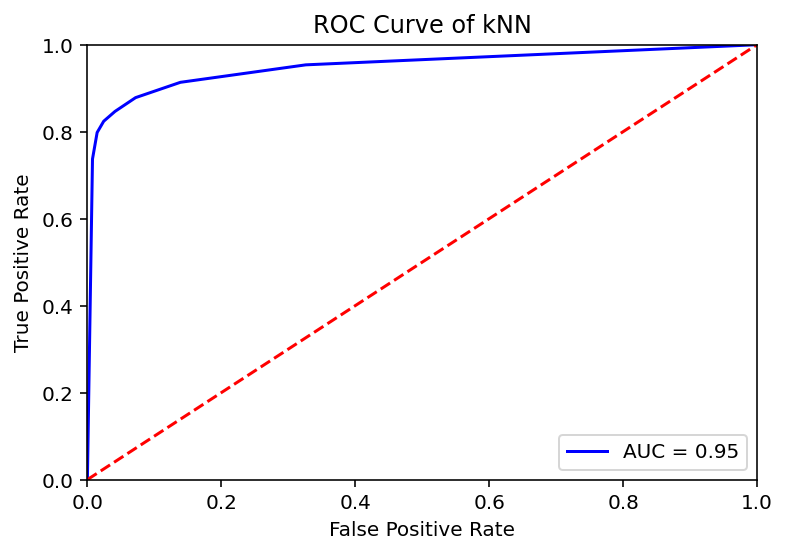

K -----> 10
Model accuracy score: 0.9191
Training-set accuracy score: 0.9295
Confusion matrix

 [[18427   619]
 [ 1807  9147]]

True Positives(TP) =  18427

True Negatives(TN) =  9147

False Positives(FP) =  619

False Negatives(FN) =  1807
_____________________________________________________________________________


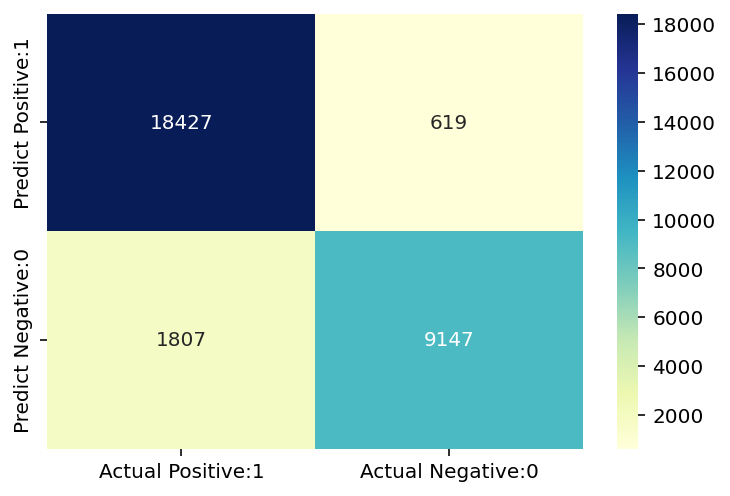

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.97      0.94     19046
           1       0.94      0.84      0.88     10954

    accuracy                           0.92     30000
   macro avg       0.92      0.90      0.91     30000
weighted avg       0.92      0.92      0.92     30000

_____________________________________________________________________________
Classification accuracy : 0.9191
_____________________________________________________________________________


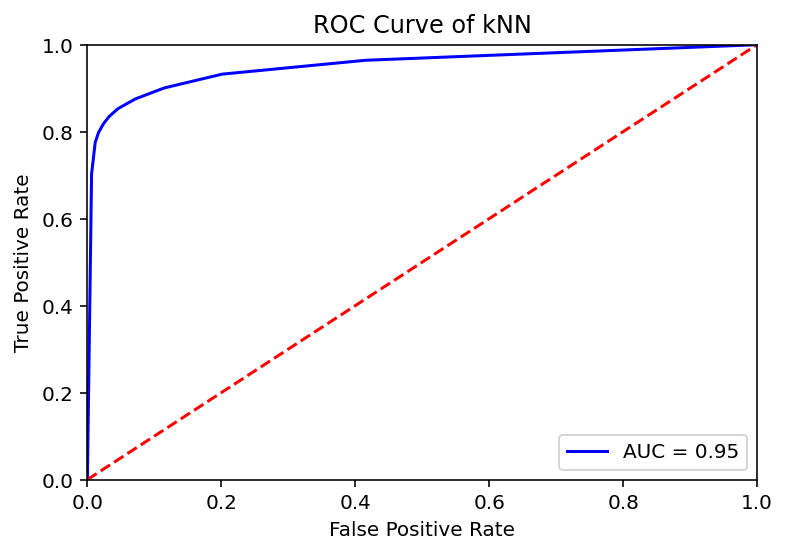

K -----> 13
Model accuracy score: 0.9179
Training-set accuracy score: 0.9269
Confusion matrix

 [[18335   711]
 [ 1753  9201]]

True Positives(TP) =  18335

True Negatives(TN) =  9201

False Positives(FP) =  711

False Negatives(FN) =  1753
_____________________________________________________________________________


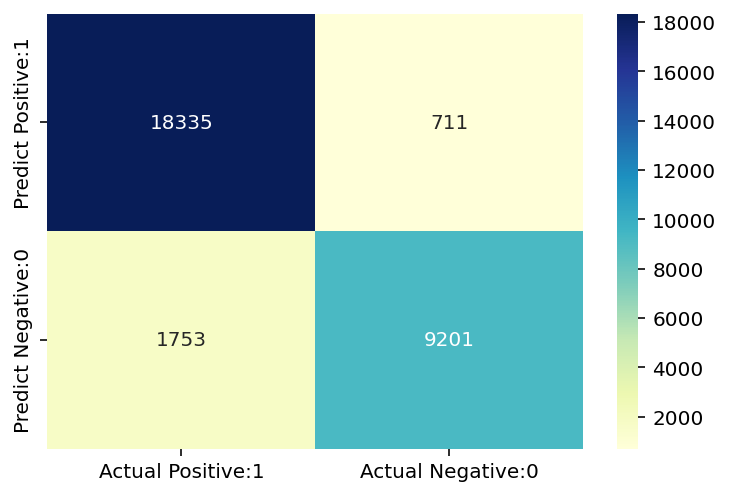

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.96      0.94     19046
           1       0.93      0.84      0.88     10954

    accuracy                           0.92     30000
   macro avg       0.92      0.90      0.91     30000
weighted avg       0.92      0.92      0.92     30000

_____________________________________________________________________________
Classification accuracy : 0.9179
_____________________________________________________________________________


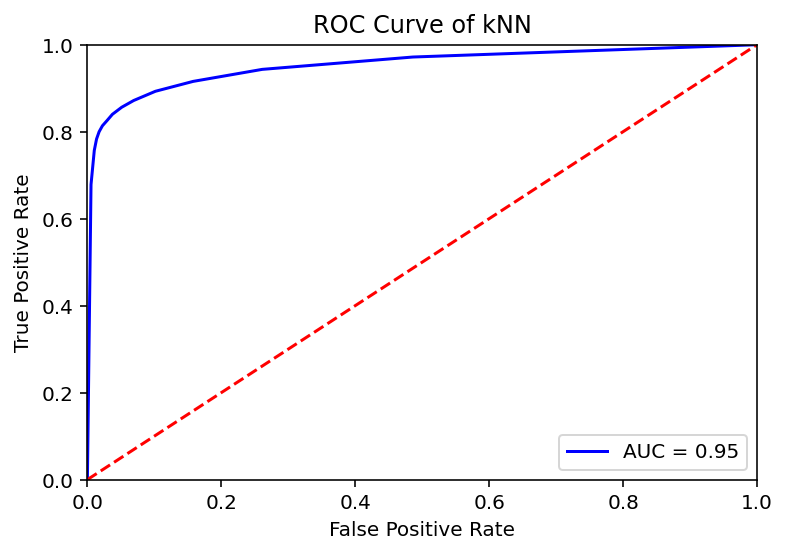

K -----> 16
Model accuracy score: 0.9175
Training-set accuracy score: 0.9248
Confusion matrix

 [[18427   619]
 [ 1855  9099]]

True Positives(TP) =  18427

True Negatives(TN) =  9099

False Positives(FP) =  619

False Negatives(FN) =  1855
_____________________________________________________________________________


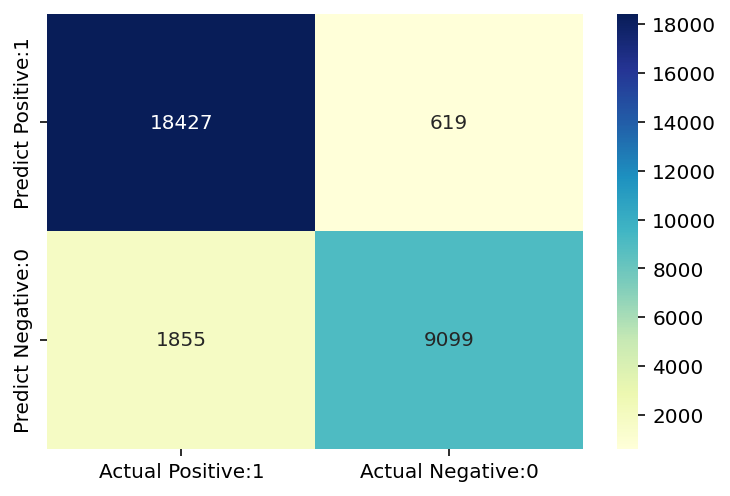

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.97      0.94     19046
           1       0.94      0.83      0.88     10954

    accuracy                           0.92     30000
   macro avg       0.92      0.90      0.91     30000
weighted avg       0.92      0.92      0.92     30000

_____________________________________________________________________________
Classification accuracy : 0.9175
_____________________________________________________________________________


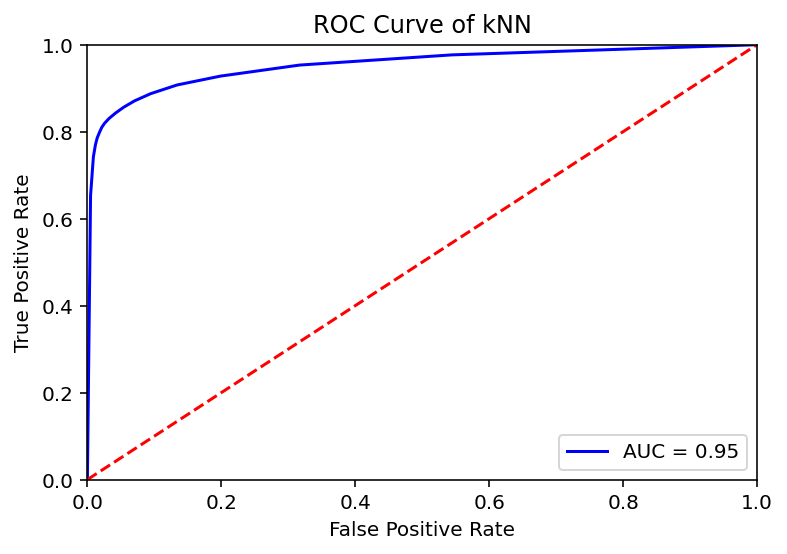

K -----> 19
Model accuracy score: 0.9161
Training-set accuracy score: 0.9231
Confusion matrix

 [[18348   698]
 [ 1820  9134]]

True Positives(TP) =  18348

True Negatives(TN) =  9134

False Positives(FP) =  698

False Negatives(FN) =  1820
_____________________________________________________________________________


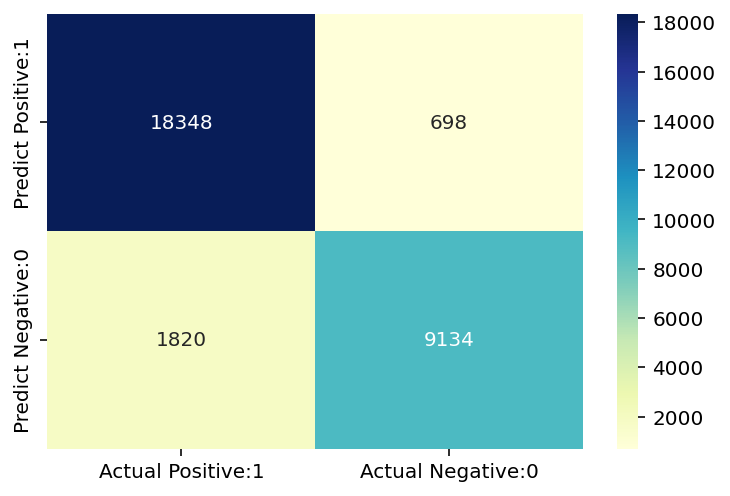

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.96      0.94     19046
           1       0.93      0.83      0.88     10954

    accuracy                           0.92     30000
   macro avg       0.92      0.90      0.91     30000
weighted avg       0.92      0.92      0.92     30000

_____________________________________________________________________________
Classification accuracy : 0.9161
_____________________________________________________________________________


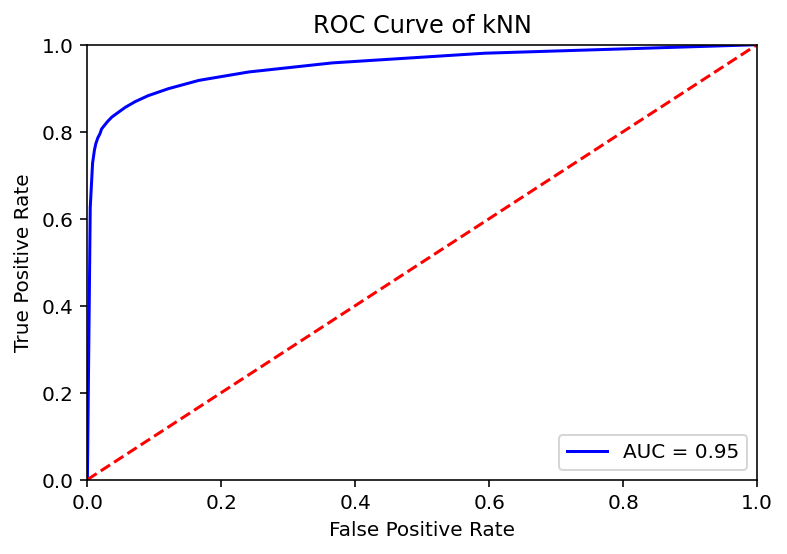

K -----> 22
Model accuracy score: 0.9143
Training-set accuracy score: 0.9216
Confusion matrix

 [[18377   669]
 [ 1902  9052]]

True Positives(TP) =  18377

True Negatives(TN) =  9052

False Positives(FP) =  669

False Negatives(FN) =  1902
_____________________________________________________________________________


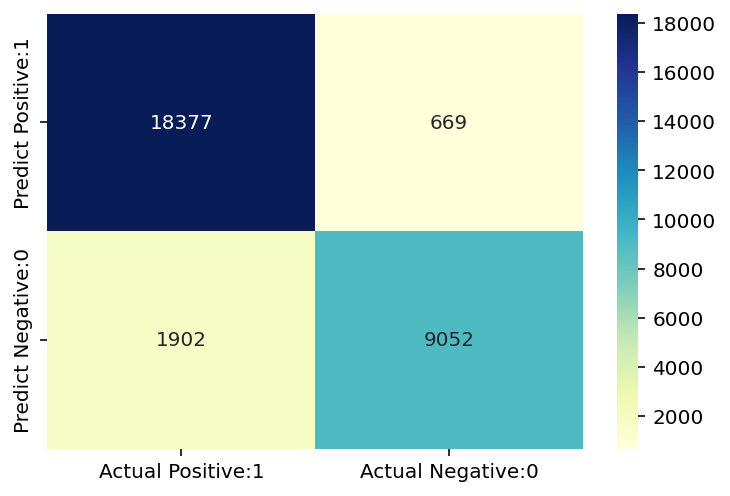

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.96      0.93     19046
           1       0.93      0.83      0.88     10954

    accuracy                           0.91     30000
   macro avg       0.92      0.90      0.91     30000
weighted avg       0.92      0.91      0.91     30000

_____________________________________________________________________________
Classification accuracy : 0.9143
_____________________________________________________________________________


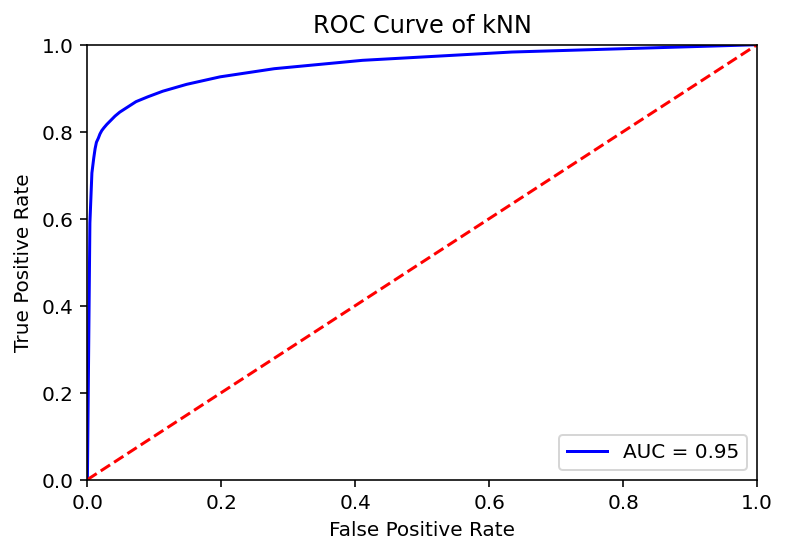

K -----> 25
Model accuracy score: 0.9134
Training-set accuracy score: 0.9202
Confusion matrix

 [[18322   724]
 [ 1875  9079]]

True Positives(TP) =  18322

True Negatives(TN) =  9079

False Positives(FP) =  724

False Negatives(FN) =  1875
_____________________________________________________________________________


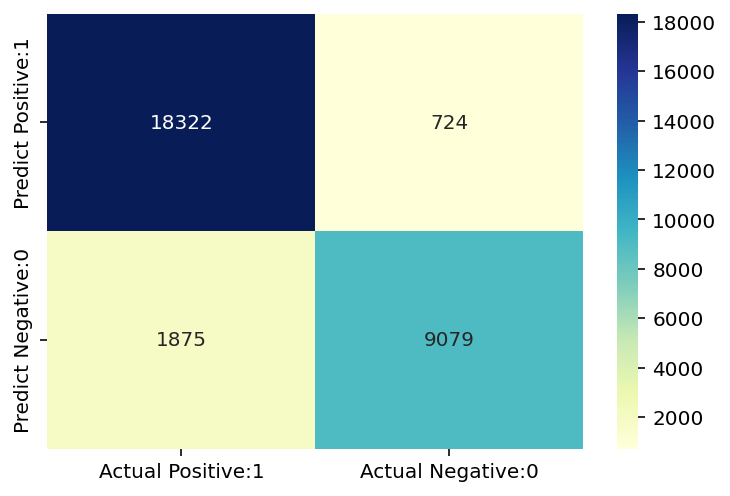

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.96      0.93     19046
           1       0.93      0.83      0.87     10954

    accuracy                           0.91     30000
   macro avg       0.92      0.90      0.90     30000
weighted avg       0.91      0.91      0.91     30000

_____________________________________________________________________________
Classification accuracy : 0.9134
_____________________________________________________________________________


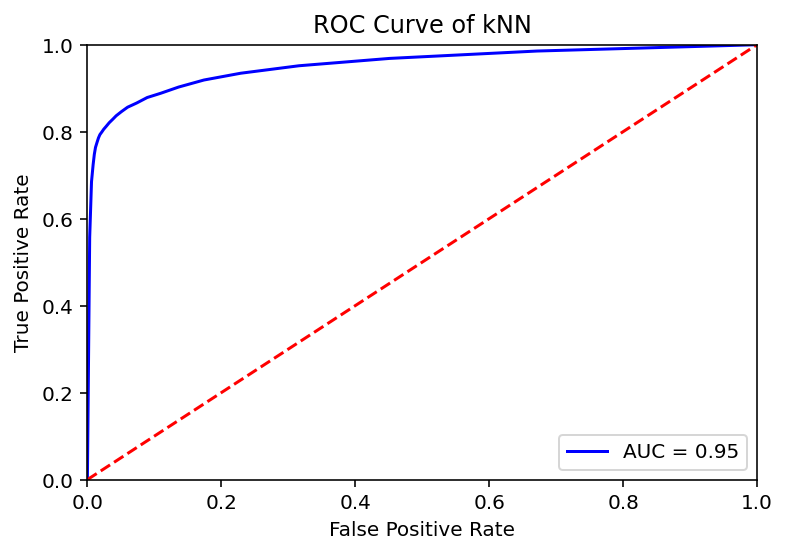

[]
200000
K -----> 1
Model accuracy score: 0.9095
Training-set accuracy score: 0.9991
Confusion matrix

 [[23683  1732]
 [ 1888 12697]]

True Positives(TP) =  23683

True Negatives(TN) =  12697

False Positives(FP) =  1732

False Negatives(FN) =  1888
_____________________________________________________________________________


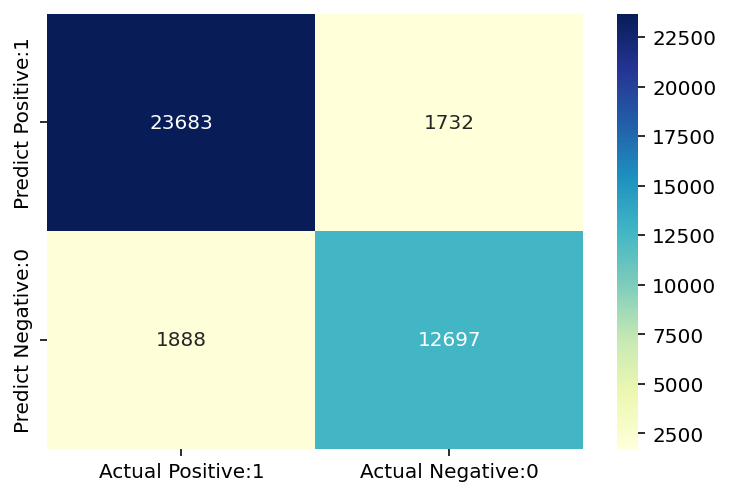

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.93      0.93      0.93     25415
           1       0.88      0.87      0.88     14585

    accuracy                           0.91     40000
   macro avg       0.90      0.90      0.90     40000
weighted avg       0.91      0.91      0.91     40000

_____________________________________________________________________________
Classification accuracy : 0.9095
_____________________________________________________________________________


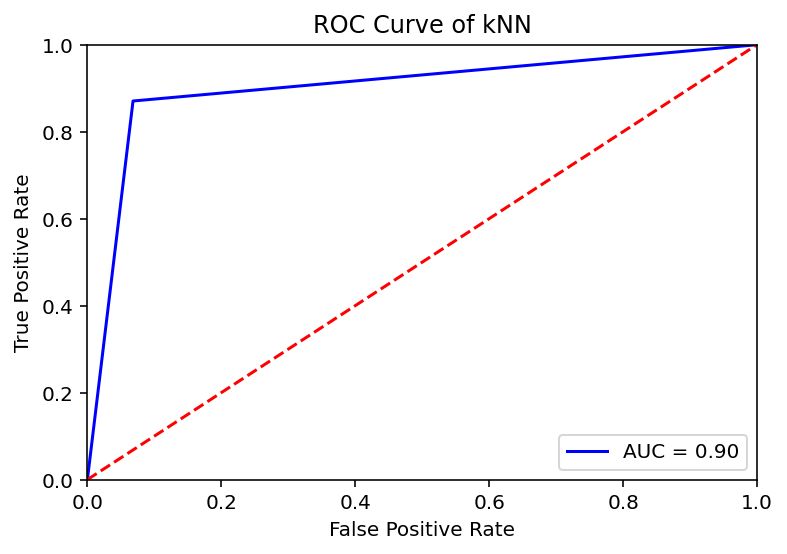

K -----> 4
Model accuracy score: 0.9220
Training-set accuracy score: 0.9418
Confusion matrix

 [[24704   711]
 [ 2409 12176]]

True Positives(TP) =  24704

True Negatives(TN) =  12176

False Positives(FP) =  711

False Negatives(FN) =  2409
_____________________________________________________________________________


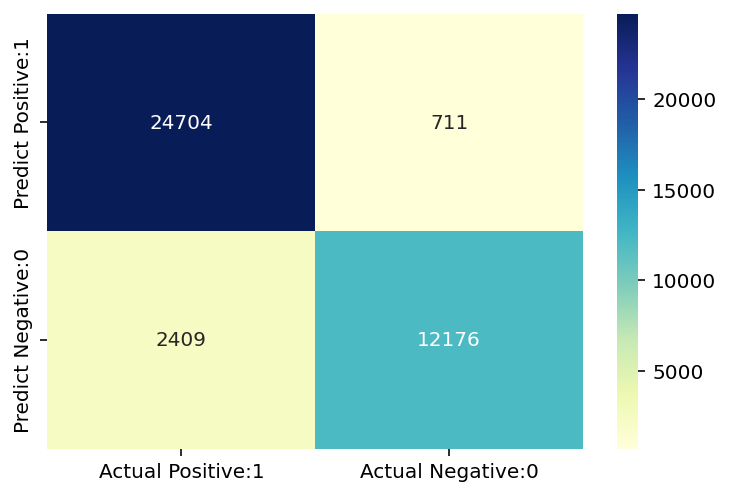

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.97      0.94     25415
           1       0.94      0.83      0.89     14585

    accuracy                           0.92     40000
   macro avg       0.93      0.90      0.91     40000
weighted avg       0.92      0.92      0.92     40000

_____________________________________________________________________________
Classification accuracy : 0.9220
_____________________________________________________________________________


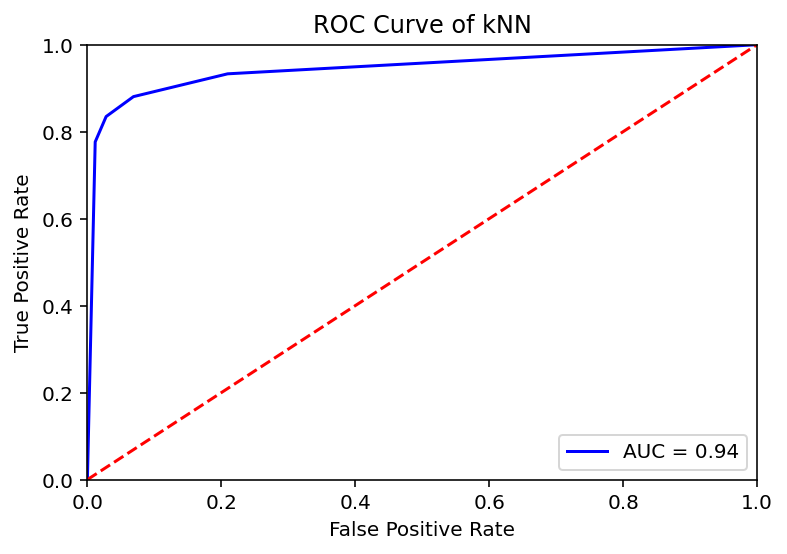

K -----> 7
Model accuracy score: 0.9208
Training-set accuracy score: 0.9356
Confusion matrix

 [[24426   989]
 [ 2177 12408]]

True Positives(TP) =  24426

True Negatives(TN) =  12408

False Positives(FP) =  989

False Negatives(FN) =  2177
_____________________________________________________________________________


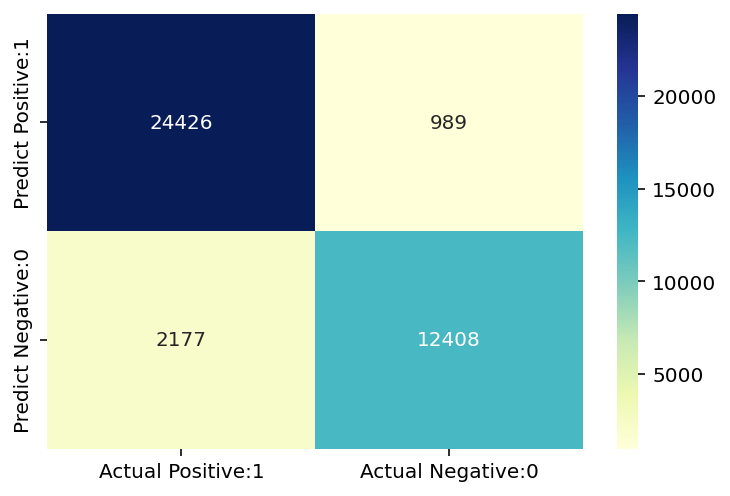

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.92      0.96      0.94     25415
           1       0.93      0.85      0.89     14585

    accuracy                           0.92     40000
   macro avg       0.92      0.91      0.91     40000
weighted avg       0.92      0.92      0.92     40000

_____________________________________________________________________________
Classification accuracy : 0.9208
_____________________________________________________________________________


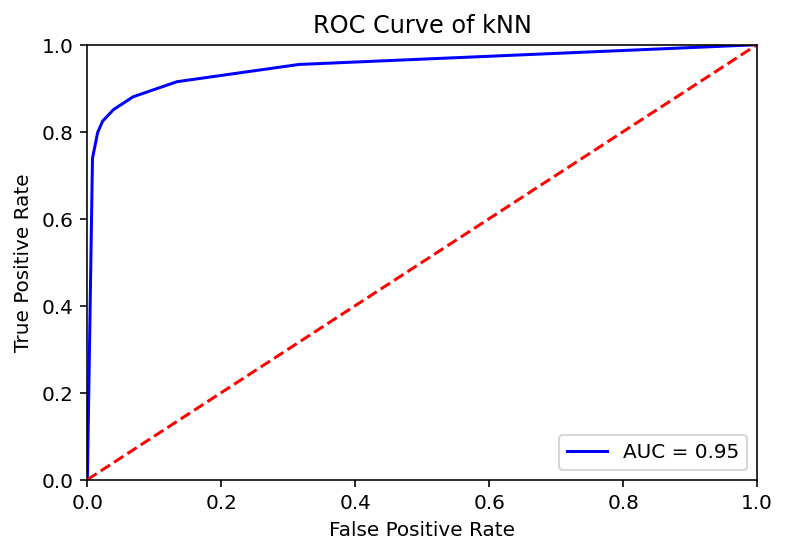

K -----> 10
Model accuracy score: 0.9205
Training-set accuracy score: 0.9308
Confusion matrix

 [[24622   793]
 [ 2387 12198]]

True Positives(TP) =  24622

True Negatives(TN) =  12198

False Positives(FP) =  793

False Negatives(FN) =  2387
_____________________________________________________________________________


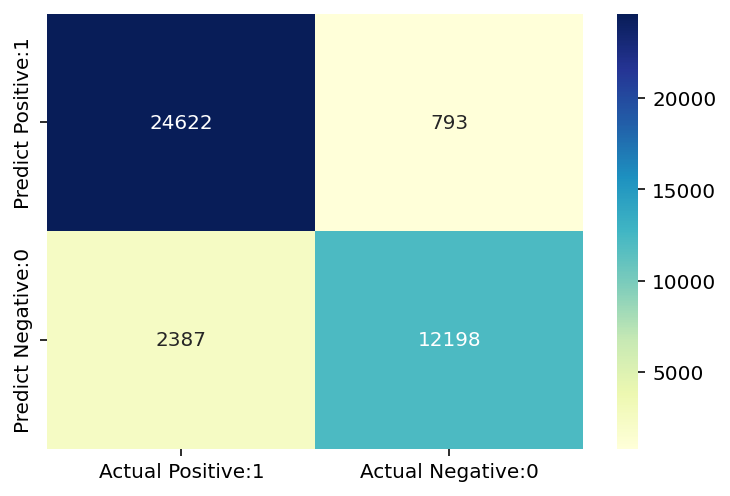

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.97      0.94     25415
           1       0.94      0.84      0.88     14585

    accuracy                           0.92     40000
   macro avg       0.93      0.90      0.91     40000
weighted avg       0.92      0.92      0.92     40000

_____________________________________________________________________________
Classification accuracy : 0.9205
_____________________________________________________________________________


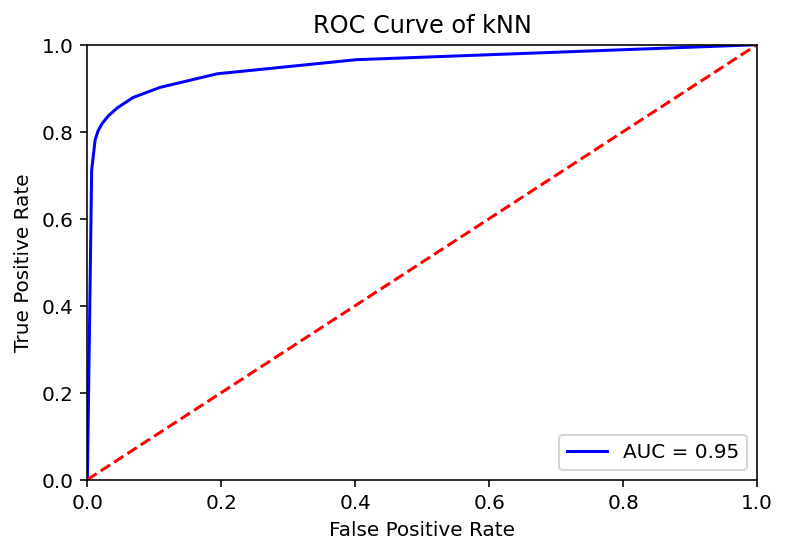

K -----> 13
Model accuracy score: 0.9190
Training-set accuracy score: 0.9288
Confusion matrix

 [[24484   931]
 [ 2308 12277]]

True Positives(TP) =  24484

True Negatives(TN) =  12277

False Positives(FP) =  931

False Negatives(FN) =  2308
_____________________________________________________________________________


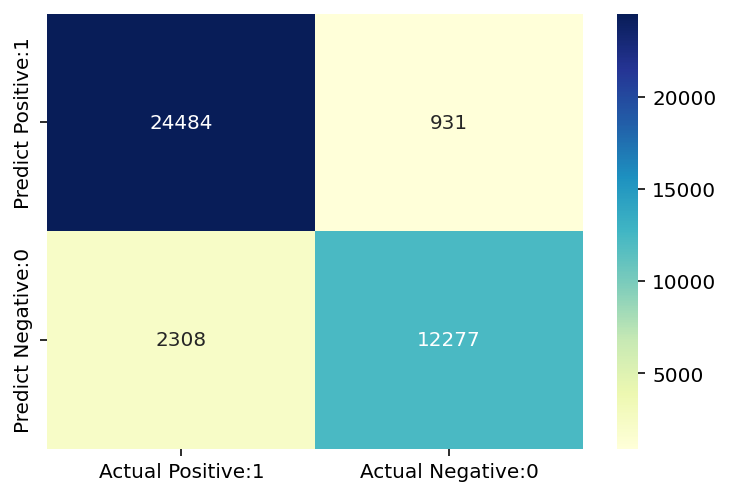

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.96      0.94     25415
           1       0.93      0.84      0.88     14585

    accuracy                           0.92     40000
   macro avg       0.92      0.90      0.91     40000
weighted avg       0.92      0.92      0.92     40000

_____________________________________________________________________________
Classification accuracy : 0.9190
_____________________________________________________________________________


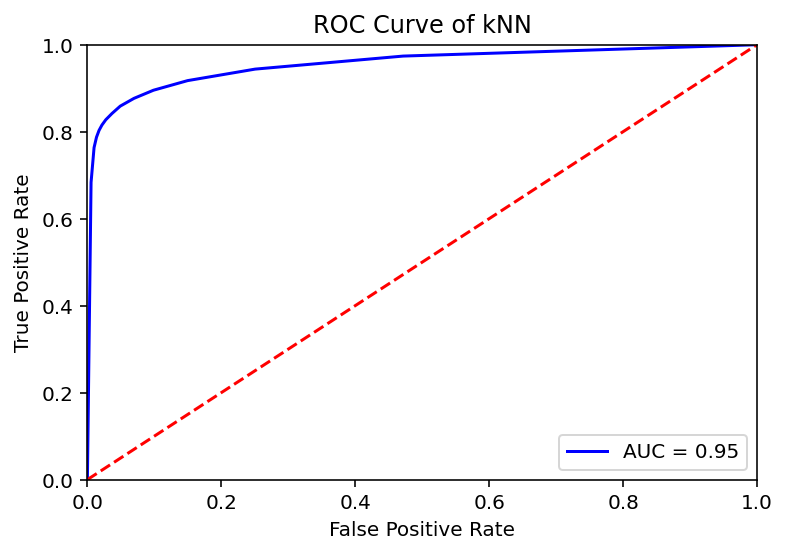

K -----> 16
Model accuracy score: 0.9190
Training-set accuracy score: 0.9264
Confusion matrix

 [[24596   819]
 [ 2422 12163]]

True Positives(TP) =  24596

True Negatives(TN) =  12163

False Positives(FP) =  819

False Negatives(FN) =  2422
_____________________________________________________________________________


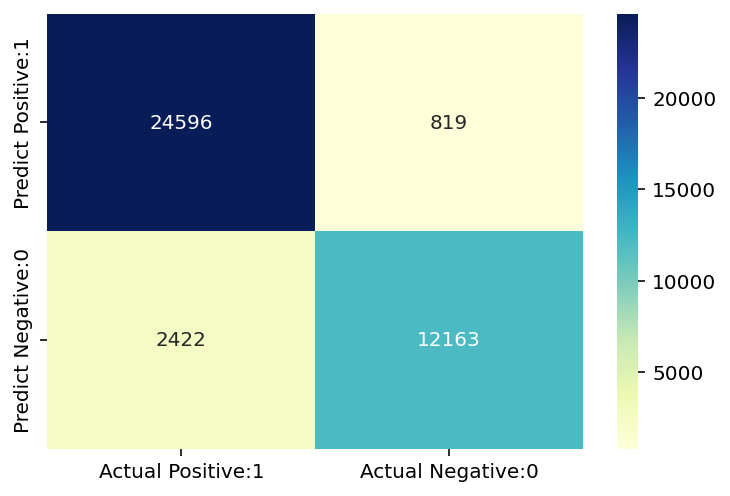

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.97      0.94     25415
           1       0.94      0.83      0.88     14585

    accuracy                           0.92     40000
   macro avg       0.92      0.90      0.91     40000
weighted avg       0.92      0.92      0.92     40000

_____________________________________________________________________________
Classification accuracy : 0.9190
_____________________________________________________________________________


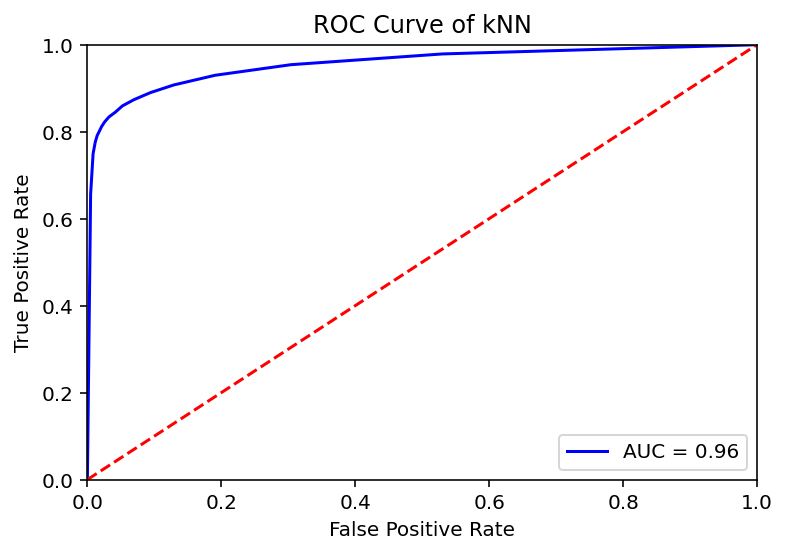

K -----> 19
Model accuracy score: 0.9176
Training-set accuracy score: 0.9251
Confusion matrix

 [[24511   904]
 [ 2393 12192]]

True Positives(TP) =  24511

True Negatives(TN) =  12192

False Positives(FP) =  904

False Negatives(FN) =  2393
_____________________________________________________________________________


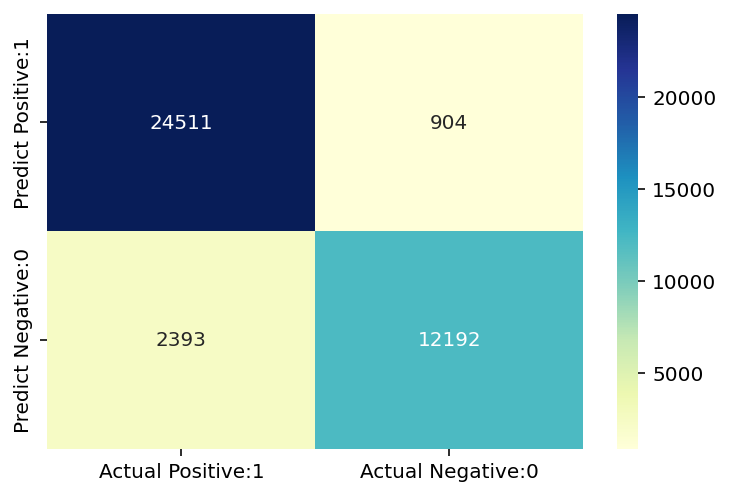

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.96      0.94     25415
           1       0.93      0.84      0.88     14585

    accuracy                           0.92     40000
   macro avg       0.92      0.90      0.91     40000
weighted avg       0.92      0.92      0.92     40000

_____________________________________________________________________________
Classification accuracy : 0.9176
_____________________________________________________________________________


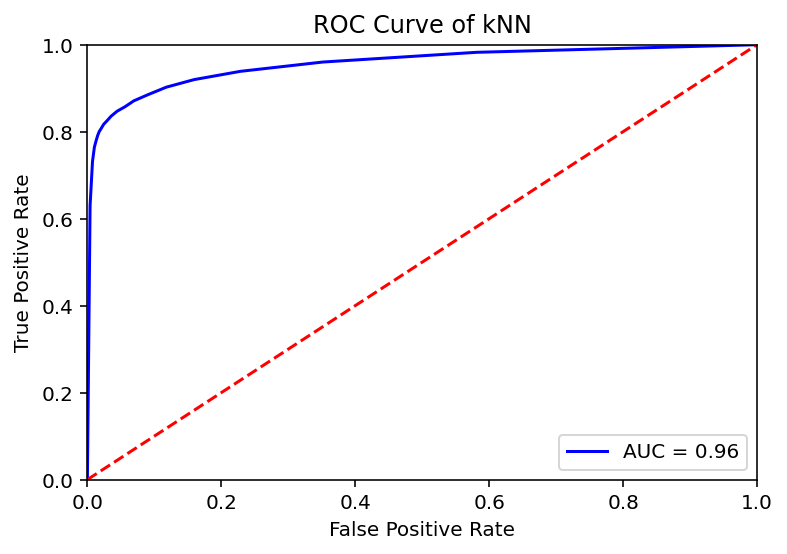

K -----> 22
Model accuracy score: 0.9169
Model accuracy score: 0.9169


KeyboardInterrupt: ignored

KeyboardInterrupt: ignored

In [ ]:
from scipy.sparse import hstack
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD

for i in range(len(model_datas)):  
  df = model_datas[i]
  
  X = df.drop(['is_attributed','Year','Month','minute'], axis=1)
  y = df['is_attributed']
  print(len(X))

  
  columns = X.columns

  # X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
  # X = hstack((X,np.array(df['ip'])[:,None]))
  
  # lf = TruncatedSVD(10)
  # X = lf.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = (scaler.fit_transform(X_train))
  X_test = (scaler.transform(X_test))

  k_range = range(1, 26 ,3)
  scores = []
  for k in k_range:
    print("K ----->" , k)
    y_pred , y_pred_probab = knn_model(X_train, X_test, y_train, y_test , k)
    evalute_mode(y_pred , y_pred_probab , y_test)
  print(scores)
  # y_pred , y_pred_probab ,log = lgstc_Reg_sparse(X_train , X_test , y_train, y_test)
  # evalute_mode(y_pred , y_pred_probab ,y_test)


    

10000
K -----> 1
Model accuracy score: 0.8730
Training-set accuracy score: 1.0000
Confusion matrix

 [[1144  143]
 [ 111  602]]

True Positives(TP) =  1144

True Negatives(TN) =  602

False Positives(FP) =  143

False Negatives(FN) =  111
_____________________________________________________________________________


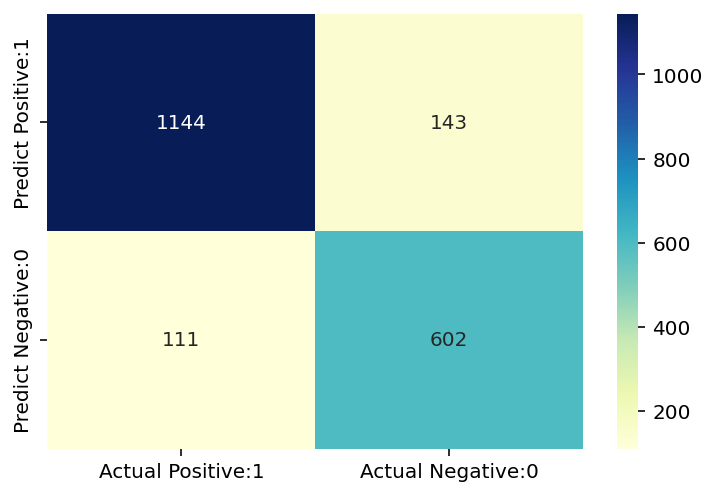

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.89      0.90      1287
           1       0.81      0.84      0.83       713

    accuracy                           0.87      2000
   macro avg       0.86      0.87      0.86      2000
weighted avg       0.87      0.87      0.87      2000

_____________________________________________________________________________
Classification accuracy : 0.8730
_____________________________________________________________________________


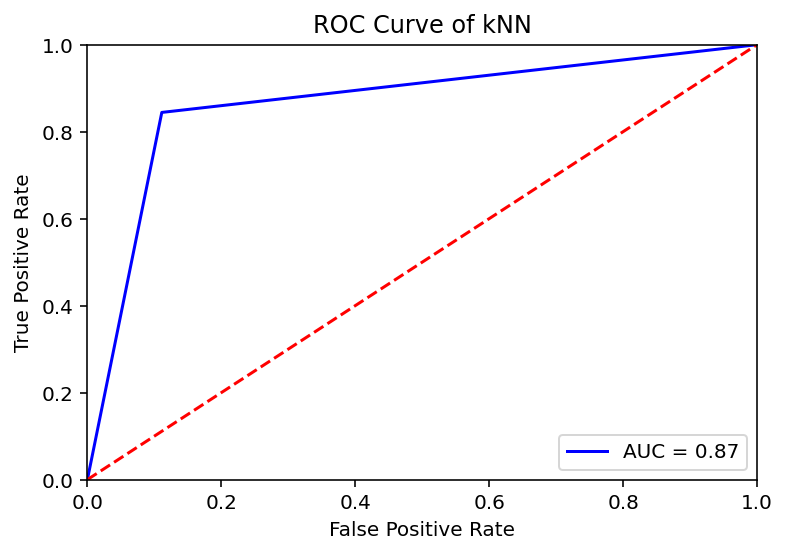

K -----> 5
Model accuracy score: 0.8905
Training-set accuracy score: 0.9150
Confusion matrix

 [[1217   70]
 [ 149  564]]

True Positives(TP) =  1217

True Negatives(TN) =  564

False Positives(FP) =  70

False Negatives(FN) =  149
_____________________________________________________________________________


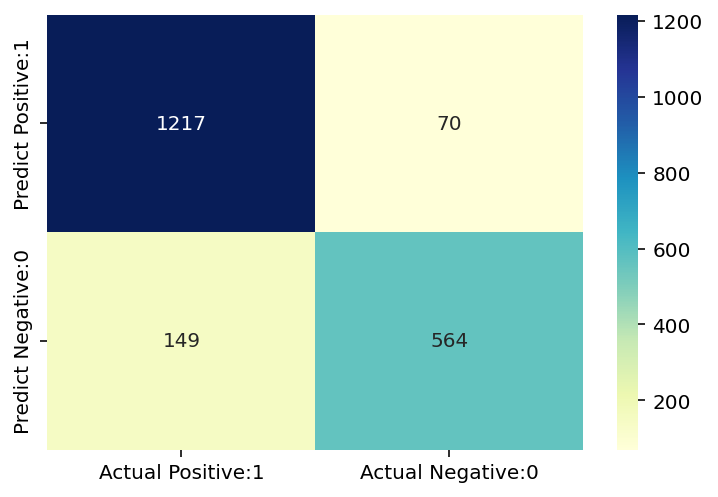

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.89      0.95      0.92      1287
           1       0.89      0.79      0.84       713

    accuracy                           0.89      2000
   macro avg       0.89      0.87      0.88      2000
weighted avg       0.89      0.89      0.89      2000

_____________________________________________________________________________
Classification accuracy : 0.8905
_____________________________________________________________________________


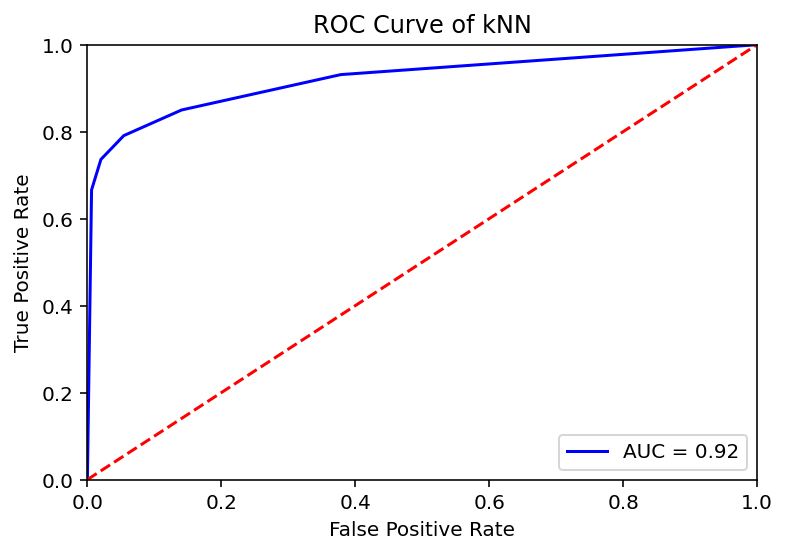

K -----> 9
Model accuracy score: 0.8855
Training-set accuracy score: 0.9046
Confusion matrix

 [[1229   58]
 [ 171  542]]

True Positives(TP) =  1229

True Negatives(TN) =  542

False Positives(FP) =  58

False Negatives(FN) =  171
_____________________________________________________________________________


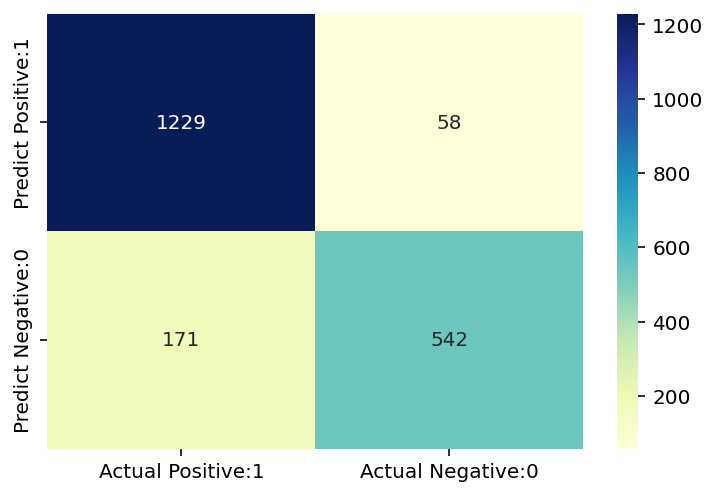

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.88      0.95      0.91      1287
           1       0.90      0.76      0.83       713

    accuracy                           0.89      2000
   macro avg       0.89      0.86      0.87      2000
weighted avg       0.89      0.89      0.88      2000

_____________________________________________________________________________
Classification accuracy : 0.8855
_____________________________________________________________________________


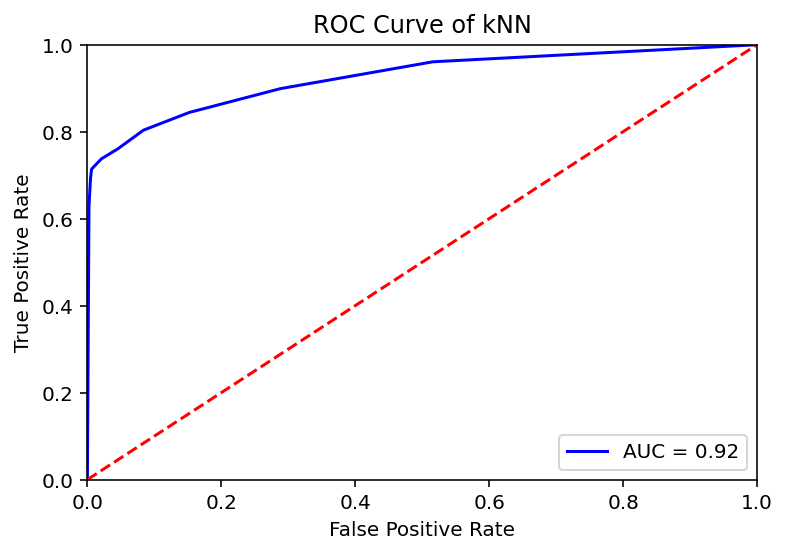

K -----> 13
Model accuracy score: 0.8925
Training-set accuracy score: 0.9018
Confusion matrix

 [[1246   41]
 [ 174  539]]

True Positives(TP) =  1246

True Negatives(TN) =  539

False Positives(FP) =  41

False Negatives(FN) =  174
_____________________________________________________________________________


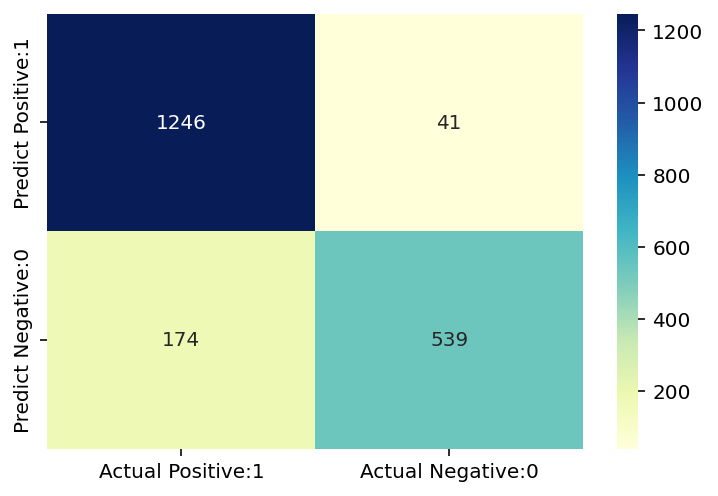

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.88      0.97      0.92      1287
           1       0.93      0.76      0.83       713

    accuracy                           0.89      2000
   macro avg       0.90      0.86      0.88      2000
weighted avg       0.90      0.89      0.89      2000

_____________________________________________________________________________
Classification accuracy : 0.8925
_____________________________________________________________________________


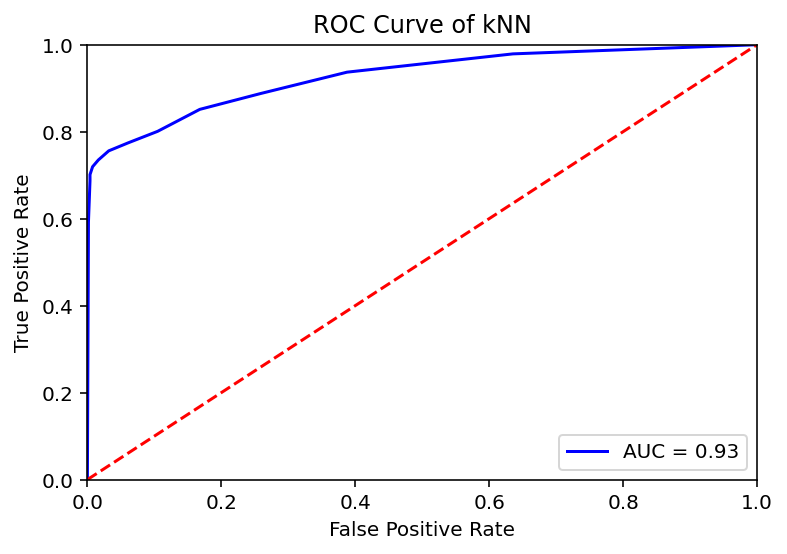

K -----> 17
Model accuracy score: 0.8915
Training-set accuracy score: 0.8988
Confusion matrix

 [[1254   33]
 [ 184  529]]

True Positives(TP) =  1254

True Negatives(TN) =  529

False Positives(FP) =  33

False Negatives(FN) =  184
_____________________________________________________________________________


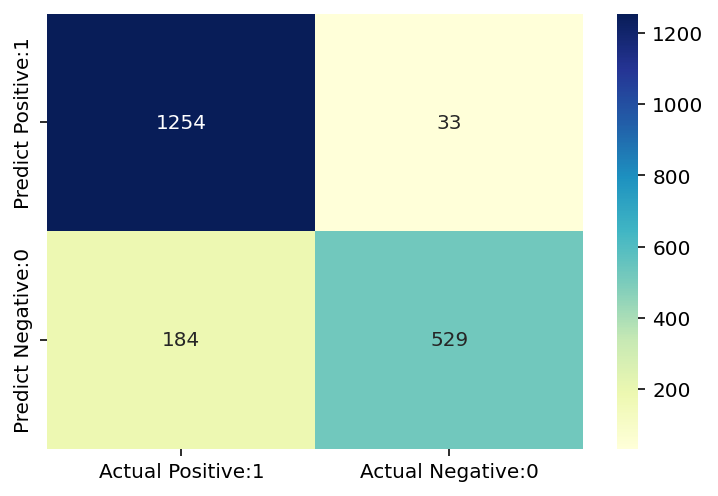

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.87      0.97      0.92      1287
           1       0.94      0.74      0.83       713

    accuracy                           0.89      2000
   macro avg       0.91      0.86      0.88      2000
weighted avg       0.90      0.89      0.89      2000

_____________________________________________________________________________
Classification accuracy : 0.8915
_____________________________________________________________________________


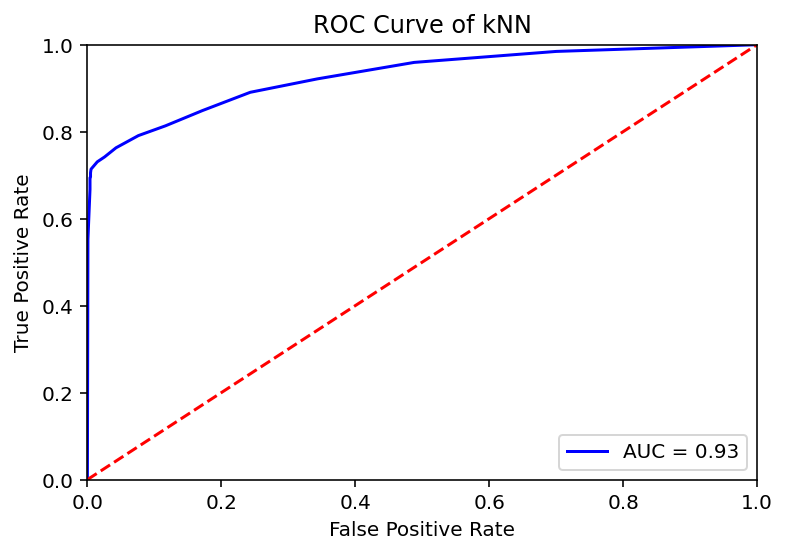

K -----> 21
Model accuracy score: 0.8940
Training-set accuracy score: 0.8951
Confusion matrix

 [[1265   22]
 [ 190  523]]

True Positives(TP) =  1265

True Negatives(TN) =  523

False Positives(FP) =  22

False Negatives(FN) =  190
_____________________________________________________________________________


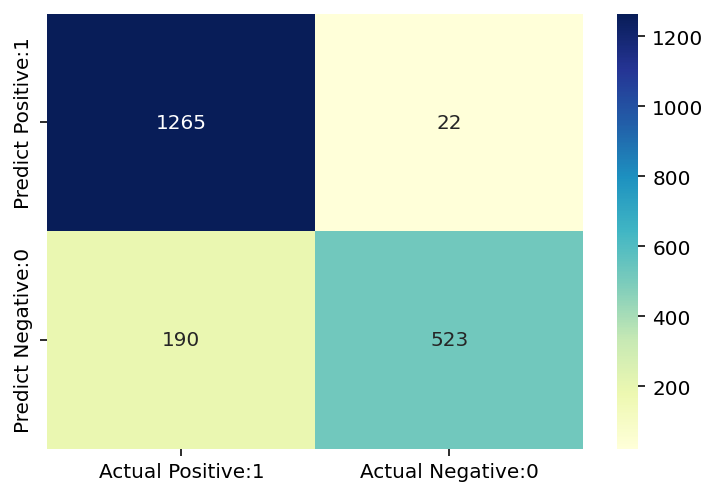

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.87      0.98      0.92      1287
           1       0.96      0.73      0.83       713

    accuracy                           0.89      2000
   macro avg       0.91      0.86      0.88      2000
weighted avg       0.90      0.89      0.89      2000

_____________________________________________________________________________
Classification accuracy : 0.8940
_____________________________________________________________________________


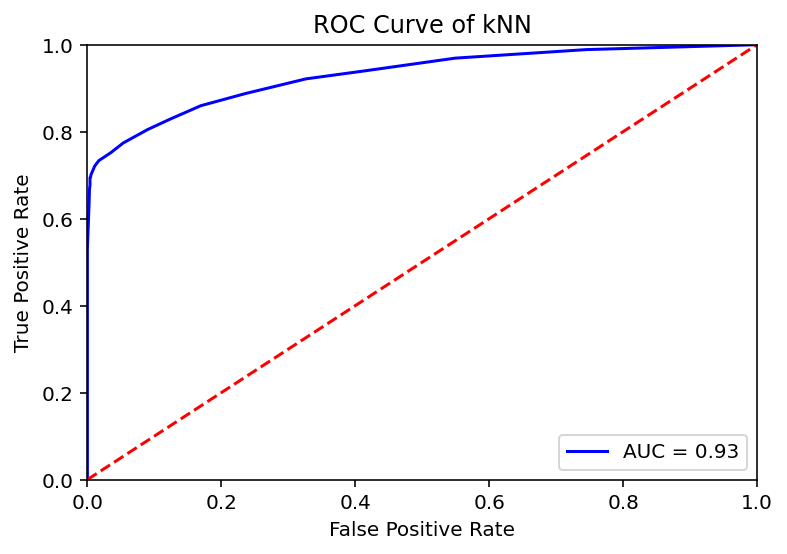

K -----> 25
Model accuracy score: 0.8920
Training-set accuracy score: 0.8922
Confusion matrix

 [[1268   19]
 [ 197  516]]

True Positives(TP) =  1268

True Negatives(TN) =  516

False Positives(FP) =  19

False Negatives(FN) =  197
_____________________________________________________________________________


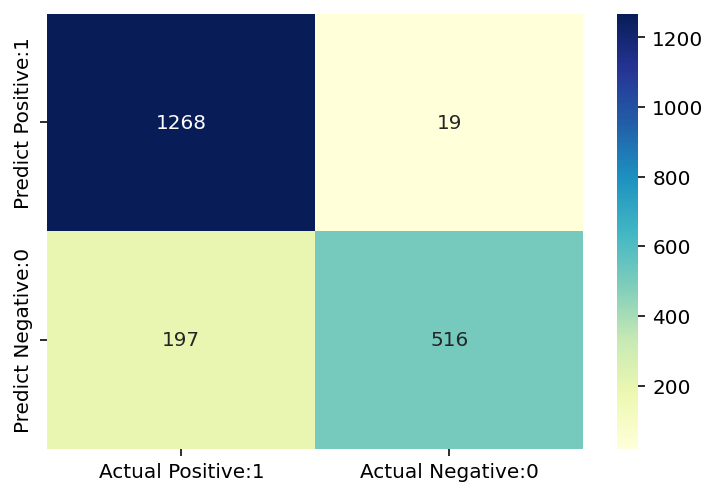

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.87      0.99      0.92      1287
           1       0.96      0.72      0.83       713

    accuracy                           0.89      2000
   macro avg       0.92      0.85      0.87      2000
weighted avg       0.90      0.89      0.89      2000

_____________________________________________________________________________
Classification accuracy : 0.8920
_____________________________________________________________________________


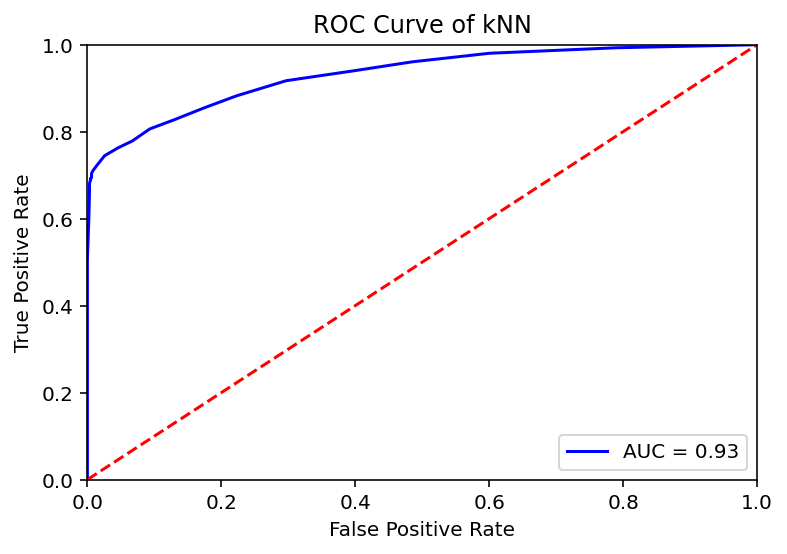

[]
50000
K -----> 1
Model accuracy score: 0.8957
Training-set accuracy score: 0.9998
Confusion matrix

 [[5869  494]
 [ 549 3088]]

True Positives(TP) =  5869

True Negatives(TN) =  3088

False Positives(FP) =  494

False Negatives(FN) =  549
_____________________________________________________________________________


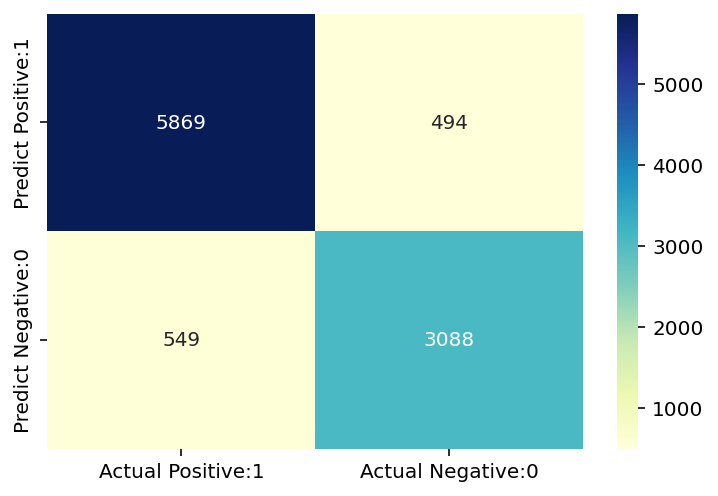

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.92      0.92      6363
           1       0.86      0.85      0.86      3637

    accuracy                           0.90     10000
   macro avg       0.89      0.89      0.89     10000
weighted avg       0.90      0.90      0.90     10000

_____________________________________________________________________________
Classification accuracy : 0.8957
_____________________________________________________________________________


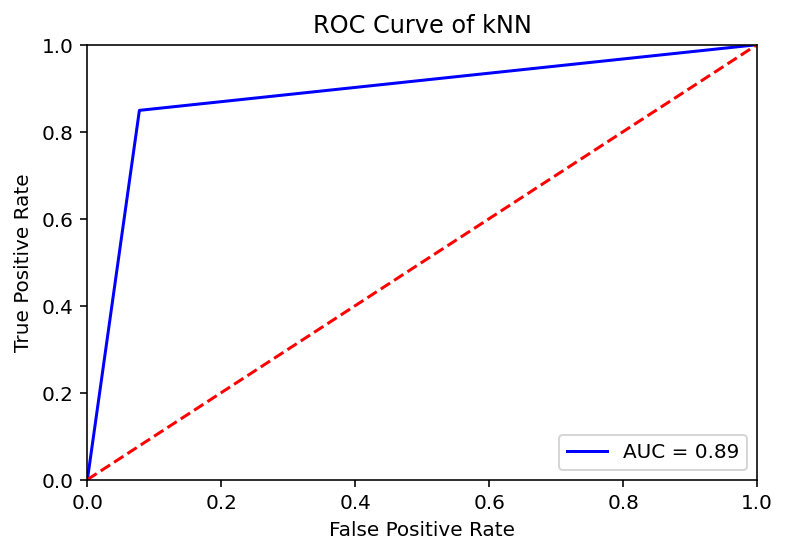

K -----> 5
Model accuracy score: 0.9113
Training-set accuracy score: 0.9325
Confusion matrix

 [[6126  237]
 [ 650 2987]]

True Positives(TP) =  6126

True Negatives(TN) =  2987

False Positives(FP) =  237

False Negatives(FN) =  650
_____________________________________________________________________________


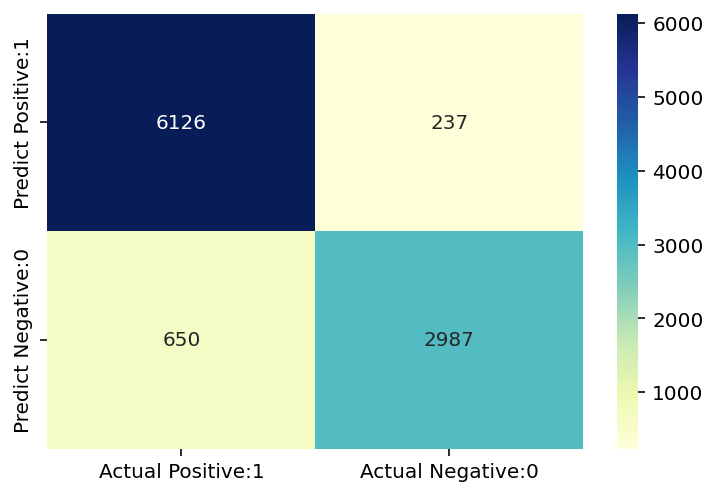

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.90      0.96      0.93      6363
           1       0.93      0.82      0.87      3637

    accuracy                           0.91     10000
   macro avg       0.92      0.89      0.90     10000
weighted avg       0.91      0.91      0.91     10000

_____________________________________________________________________________
Classification accuracy : 0.9113
_____________________________________________________________________________


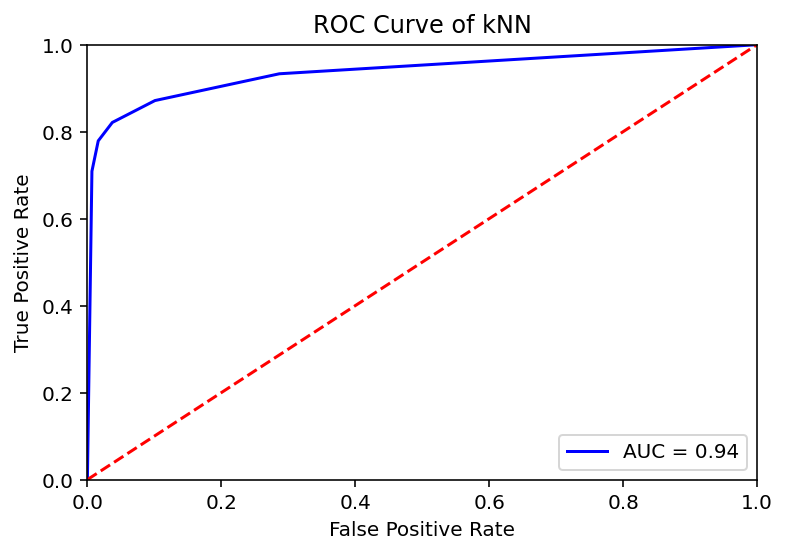

K -----> 9
Model accuracy score: 0.9097
Training-set accuracy score: 0.9236
Confusion matrix

 [[6174  189]
 [ 714 2923]]

True Positives(TP) =  6174

True Negatives(TN) =  2923

False Positives(FP) =  189

False Negatives(FN) =  714
_____________________________________________________________________________


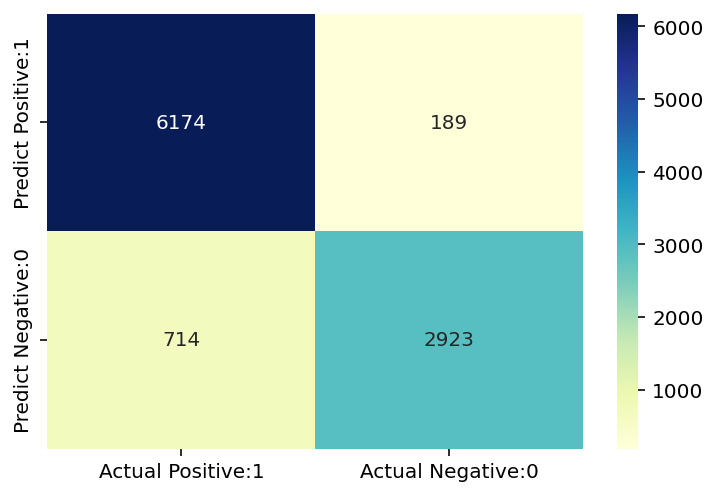

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.90      0.97      0.93      6363
           1       0.94      0.80      0.87      3637

    accuracy                           0.91     10000
   macro avg       0.92      0.89      0.90     10000
weighted avg       0.91      0.91      0.91     10000

_____________________________________________________________________________
Classification accuracy : 0.9097
_____________________________________________________________________________


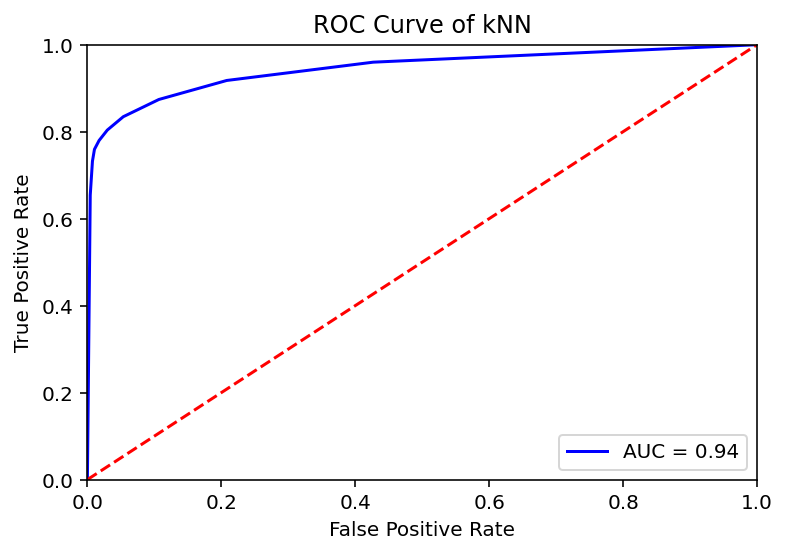

K -----> 13
Model accuracy score: 0.9081
Training-set accuracy score: 0.9200
Confusion matrix

 [[6191  172]
 [ 747 2890]]

True Positives(TP) =  6191

True Negatives(TN) =  2890

False Positives(FP) =  172

False Negatives(FN) =  747
_____________________________________________________________________________


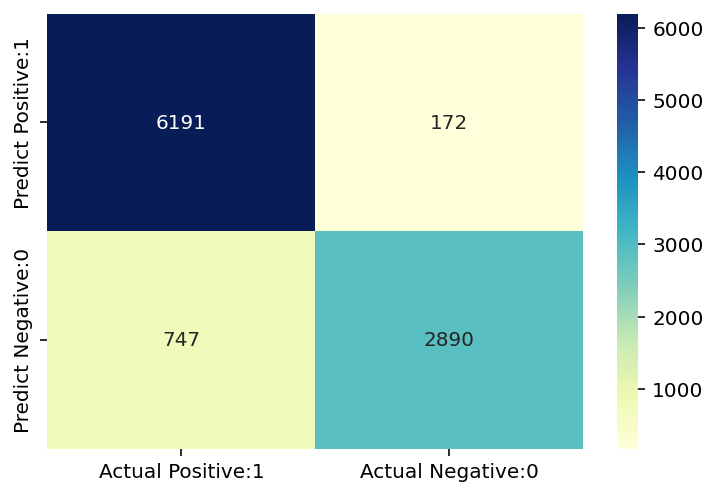

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.89      0.97      0.93      6363
           1       0.94      0.79      0.86      3637

    accuracy                           0.91     10000
   macro avg       0.92      0.88      0.90     10000
weighted avg       0.91      0.91      0.91     10000

_____________________________________________________________________________
Classification accuracy : 0.9081
_____________________________________________________________________________


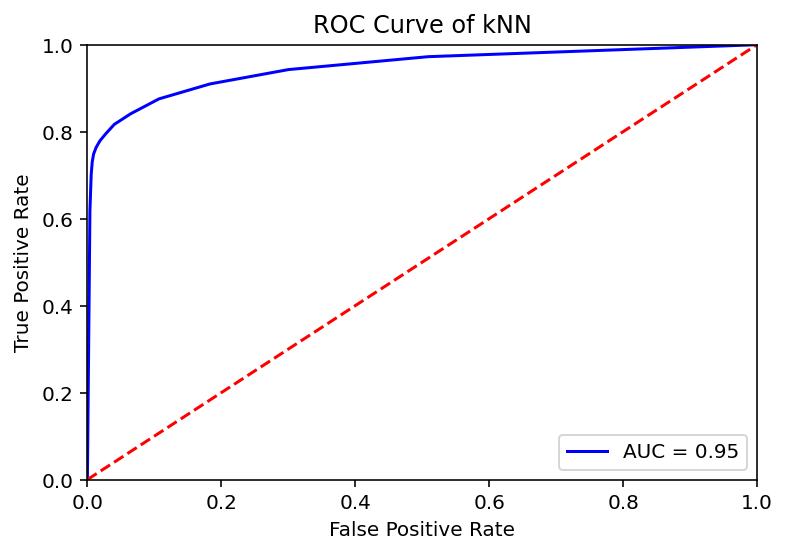

K -----> 17
Model accuracy score: 0.9075
Training-set accuracy score: 0.9164
Confusion matrix

 [[6208  155]
 [ 770 2867]]

True Positives(TP) =  6208

True Negatives(TN) =  2867

False Positives(FP) =  155

False Negatives(FN) =  770
_____________________________________________________________________________


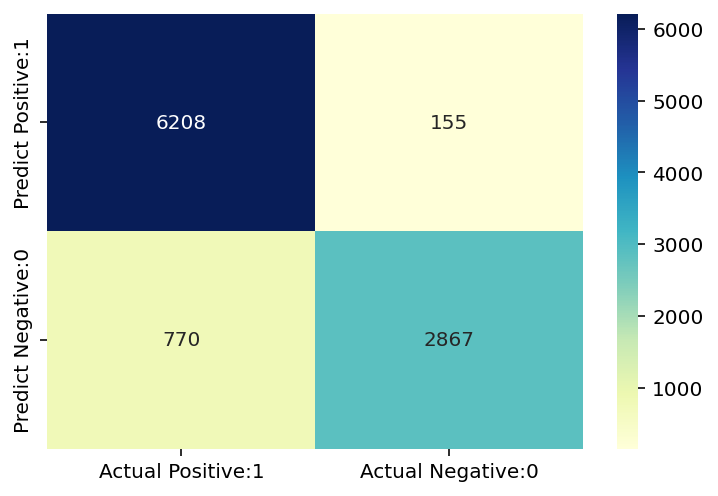

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.89      0.98      0.93      6363
           1       0.95      0.79      0.86      3637

    accuracy                           0.91     10000
   macro avg       0.92      0.88      0.90     10000
weighted avg       0.91      0.91      0.91     10000

_____________________________________________________________________________
Classification accuracy : 0.9075
_____________________________________________________________________________


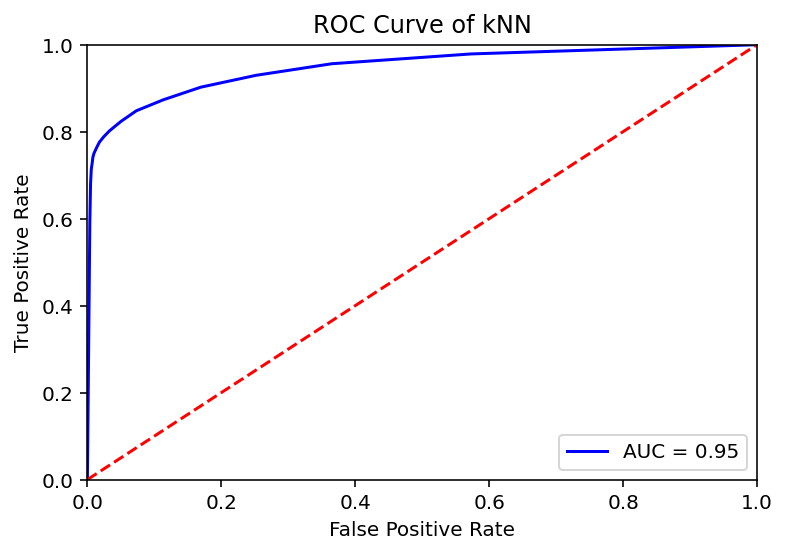

K -----> 21
Model accuracy score: 0.9058
Training-set accuracy score: 0.9145
Confusion matrix

 [[6210  153]
 [ 789 2848]]

True Positives(TP) =  6210

True Negatives(TN) =  2848

False Positives(FP) =  153

False Negatives(FN) =  789
_____________________________________________________________________________


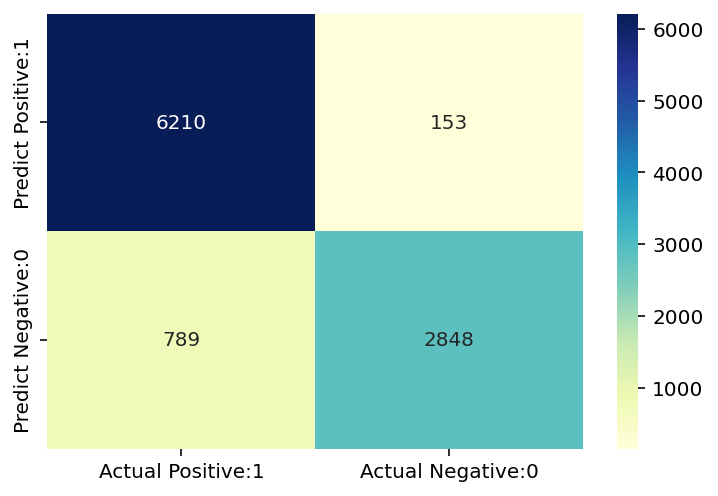

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.89      0.98      0.93      6363
           1       0.95      0.78      0.86      3637

    accuracy                           0.91     10000
   macro avg       0.92      0.88      0.89     10000
weighted avg       0.91      0.91      0.90     10000

_____________________________________________________________________________
Classification accuracy : 0.9058
_____________________________________________________________________________


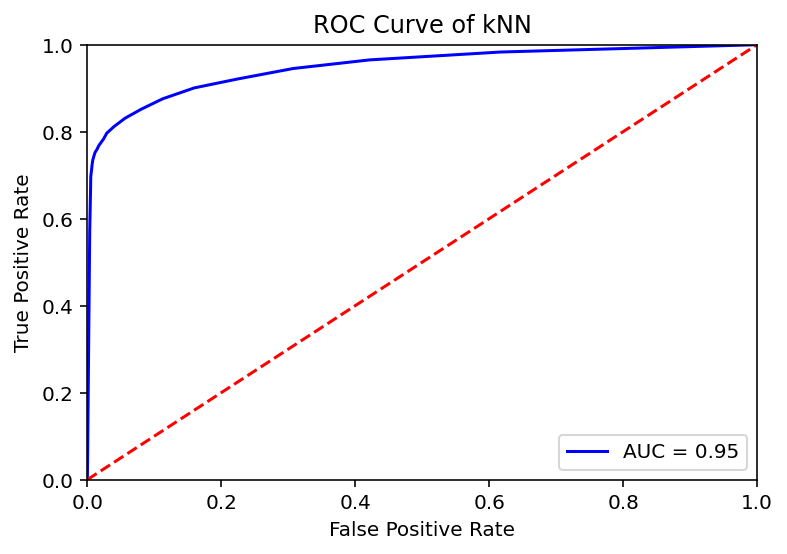

K -----> 25
Model accuracy score: 0.9054
Training-set accuracy score: 0.9131
Confusion matrix

 [[6232  131]
 [ 815 2822]]

True Positives(TP) =  6232

True Negatives(TN) =  2822

False Positives(FP) =  131

False Negatives(FN) =  815
_____________________________________________________________________________


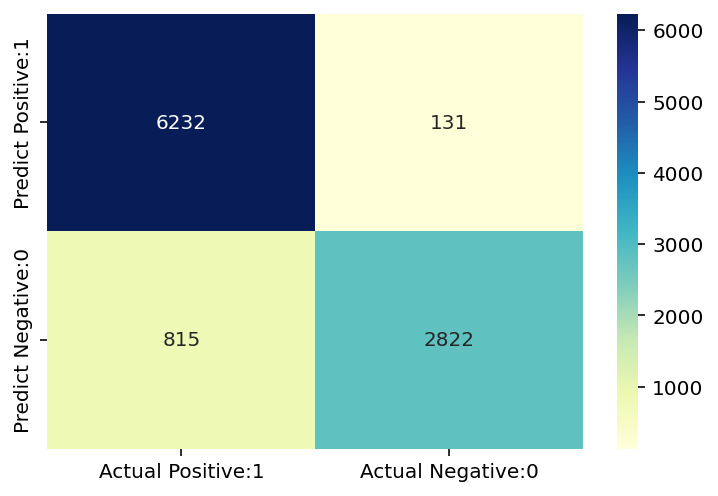

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.88      0.98      0.93      6363
           1       0.96      0.78      0.86      3637

    accuracy                           0.91     10000
   macro avg       0.92      0.88      0.89     10000
weighted avg       0.91      0.91      0.90     10000

_____________________________________________________________________________
Classification accuracy : 0.9054
_____________________________________________________________________________


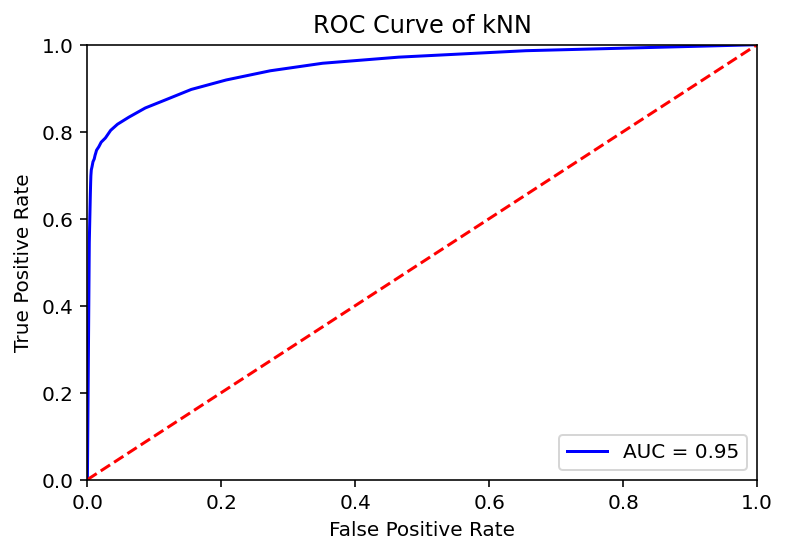

[]
100000
K -----> 1
Model accuracy score: 0.9030
Training-set accuracy score: 0.9996
Confusion matrix

 [[11777   884]
 [ 1057  6282]]

True Positives(TP) =  11777

True Negatives(TN) =  6282

False Positives(FP) =  884

False Negatives(FN) =  1057
_____________________________________________________________________________


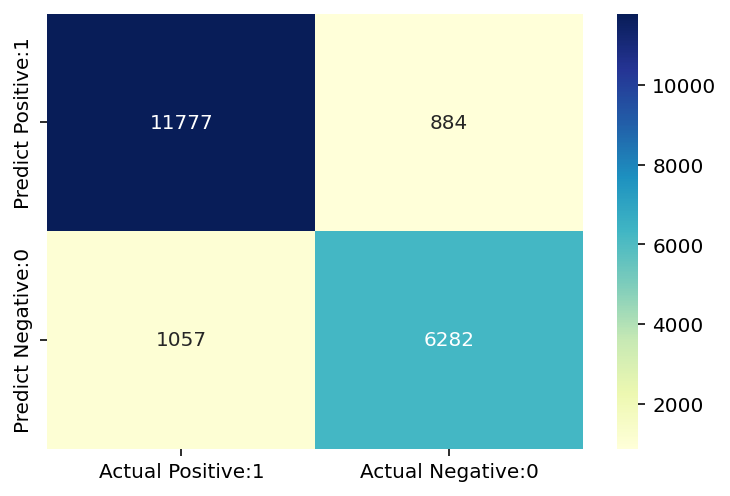

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.92      0.93      0.92     12661
           1       0.88      0.86      0.87      7339

    accuracy                           0.90     20000
   macro avg       0.90      0.89      0.90     20000
weighted avg       0.90      0.90      0.90     20000

_____________________________________________________________________________
Classification accuracy : 0.9030
_____________________________________________________________________________


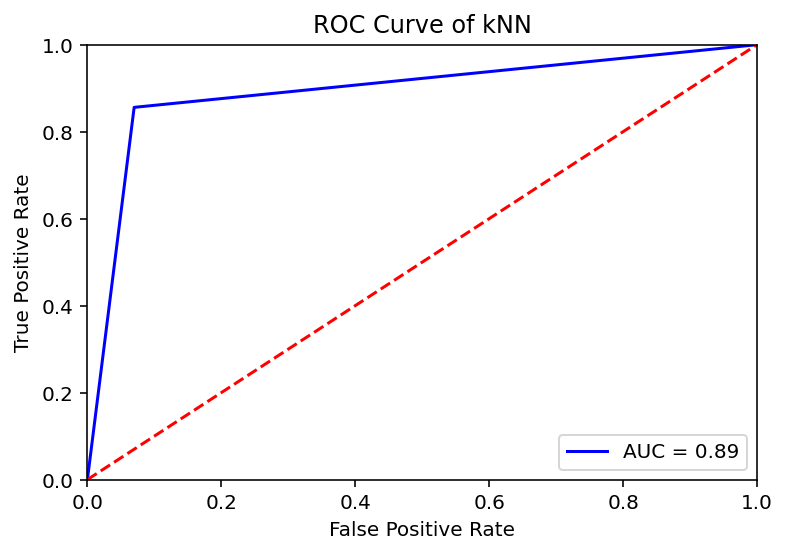

K -----> 5
Model accuracy score: 0.9133
Training-set accuracy score: 0.9379
Confusion matrix

 [[12176   485]
 [ 1249  6090]]

True Positives(TP) =  12176

True Negatives(TN) =  6090

False Positives(FP) =  485

False Negatives(FN) =  1249
_____________________________________________________________________________


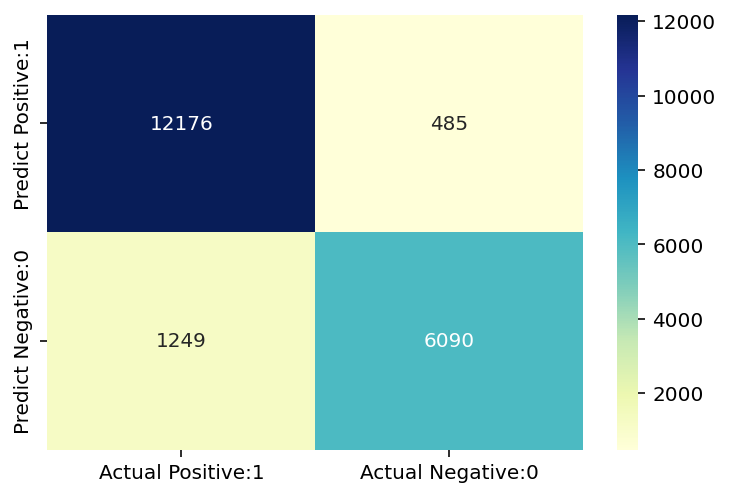

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.96      0.93     12661
           1       0.93      0.83      0.88      7339

    accuracy                           0.91     20000
   macro avg       0.92      0.90      0.90     20000
weighted avg       0.91      0.91      0.91     20000

_____________________________________________________________________________
Classification accuracy : 0.9133
_____________________________________________________________________________


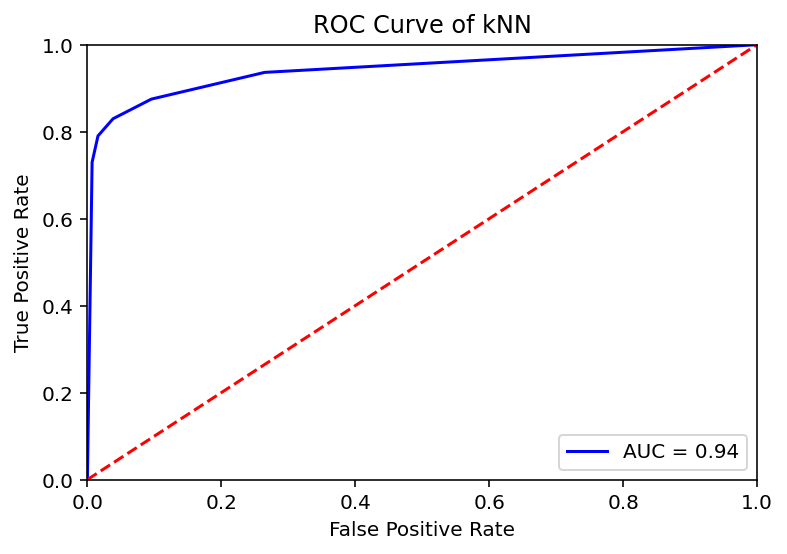

K -----> 9
Model accuracy score: 0.9124
Training-set accuracy score: 0.9298
Confusion matrix

 [[12277   384]
 [ 1368  5971]]

True Positives(TP) =  12277

True Negatives(TN) =  5971

False Positives(FP) =  384

False Negatives(FN) =  1368
_____________________________________________________________________________


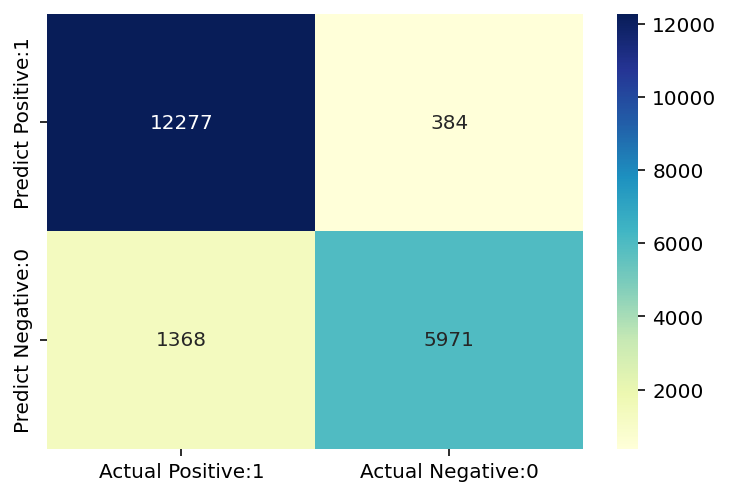

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.90      0.97      0.93     12661
           1       0.94      0.81      0.87      7339

    accuracy                           0.91     20000
   macro avg       0.92      0.89      0.90     20000
weighted avg       0.91      0.91      0.91     20000

_____________________________________________________________________________
Classification accuracy : 0.9124
_____________________________________________________________________________


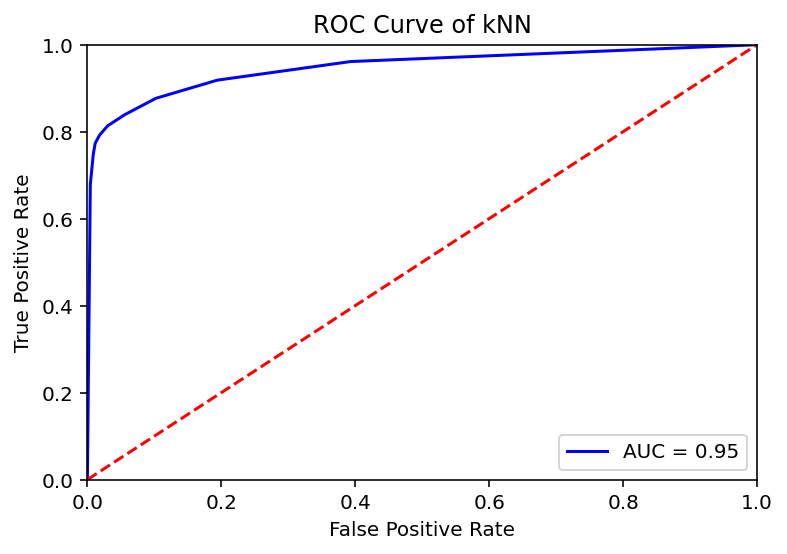

K -----> 13
Model accuracy score: 0.9111
Training-set accuracy score: 0.9251
Confusion matrix

 [[12314   347]
 [ 1431  5908]]

True Positives(TP) =  12314

True Negatives(TN) =  5908

False Positives(FP) =  347

False Negatives(FN) =  1431
_____________________________________________________________________________


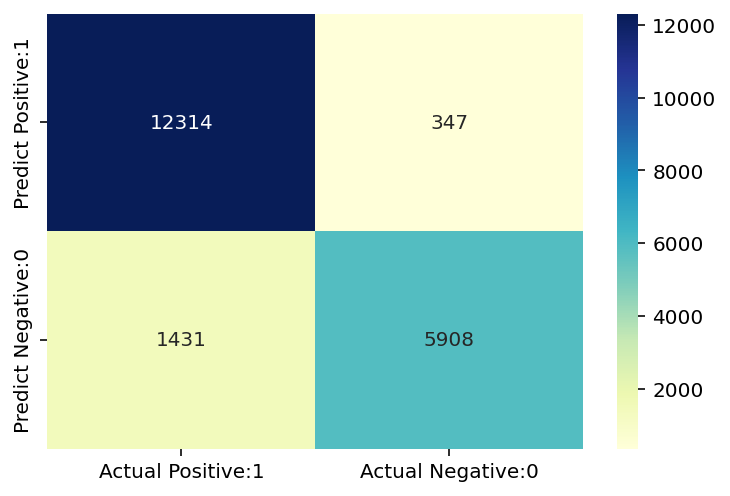

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.90      0.97      0.93     12661
           1       0.94      0.81      0.87      7339

    accuracy                           0.91     20000
   macro avg       0.92      0.89      0.90     20000
weighted avg       0.91      0.91      0.91     20000

_____________________________________________________________________________
Classification accuracy : 0.9111
_____________________________________________________________________________


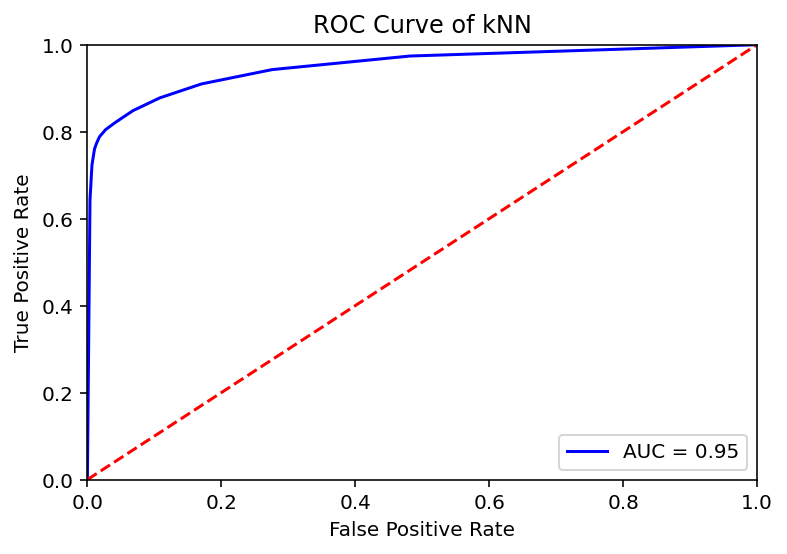

K -----> 17
Model accuracy score: 0.9095
Training-set accuracy score: 0.9222
Confusion matrix

 [[12345   316]
 [ 1493  5846]]

True Positives(TP) =  12345

True Negatives(TN) =  5846

False Positives(FP) =  316

False Negatives(FN) =  1493
_____________________________________________________________________________


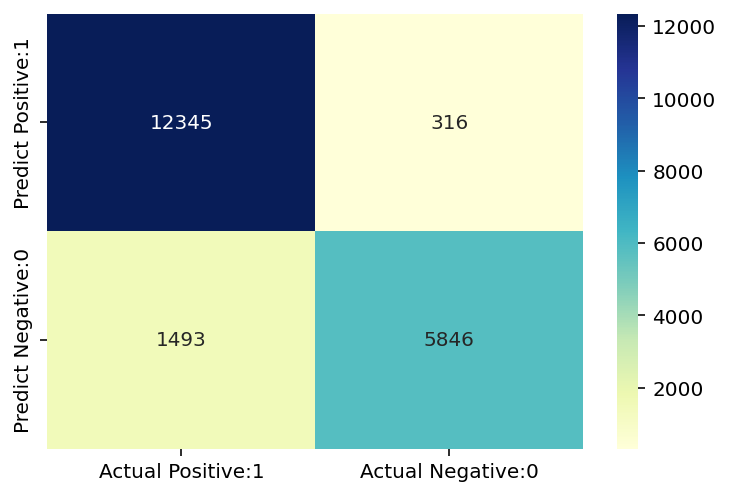

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.89      0.98      0.93     12661
           1       0.95      0.80      0.87      7339

    accuracy                           0.91     20000
   macro avg       0.92      0.89      0.90     20000
weighted avg       0.91      0.91      0.91     20000

_____________________________________________________________________________
Classification accuracy : 0.9095
_____________________________________________________________________________


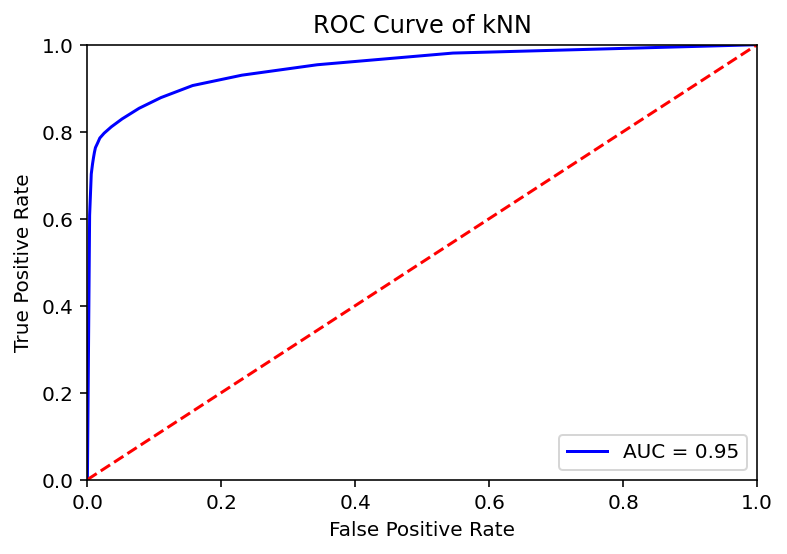

K -----> 21
Model accuracy score: 0.9083
Training-set accuracy score: 0.9201
Confusion matrix

 [[12361   300]
 [ 1533  5806]]

True Positives(TP) =  12361

True Negatives(TN) =  5806

False Positives(FP) =  300

False Negatives(FN) =  1533
_____________________________________________________________________________


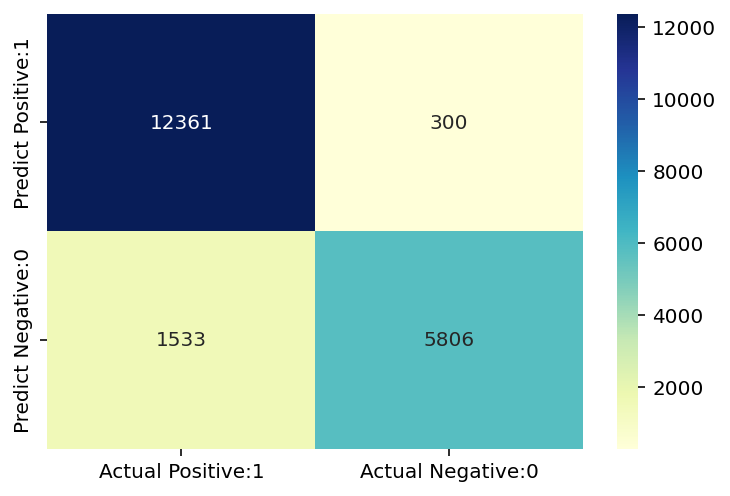

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.89      0.98      0.93     12661
           1       0.95      0.79      0.86      7339

    accuracy                           0.91     20000
   macro avg       0.92      0.88      0.90     20000
weighted avg       0.91      0.91      0.91     20000

_____________________________________________________________________________
Classification accuracy : 0.9083
_____________________________________________________________________________


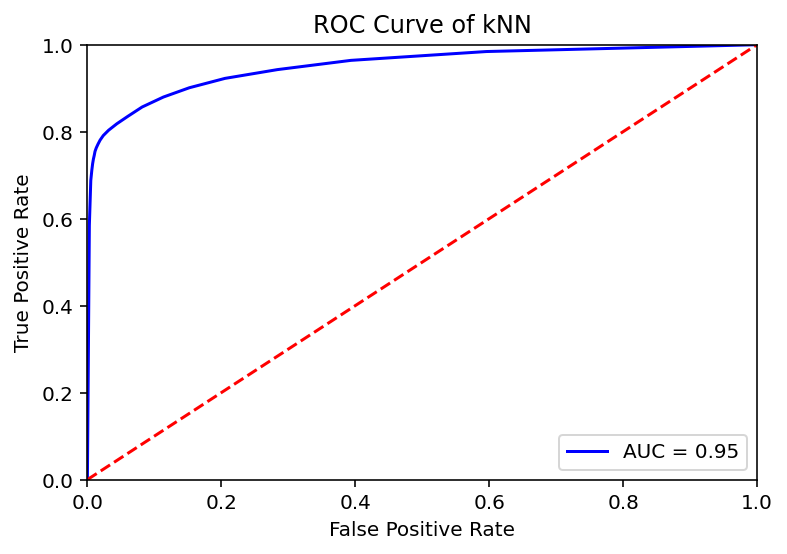

K -----> 25
Model accuracy score: 0.9069
Training-set accuracy score: 0.9183
Confusion matrix

 [[12371   290]
 [ 1573  5766]]

True Positives(TP) =  12371

True Negatives(TN) =  5766

False Positives(FP) =  290

False Negatives(FN) =  1573
_____________________________________________________________________________


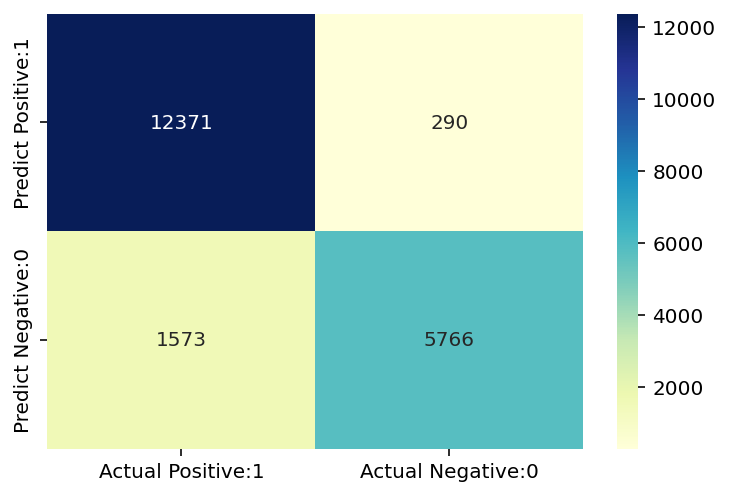

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.89      0.98      0.93     12661
           1       0.95      0.79      0.86      7339

    accuracy                           0.91     20000
   macro avg       0.92      0.88      0.90     20000
weighted avg       0.91      0.91      0.90     20000

_____________________________________________________________________________
Classification accuracy : 0.9069
_____________________________________________________________________________


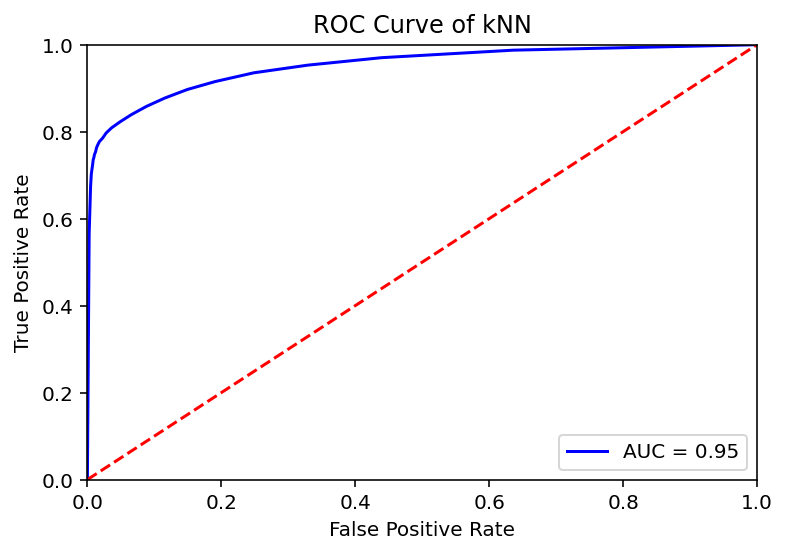

[]
150000
K -----> 1
Model accuracy score: 0.9074
Training-set accuracy score: 0.9994
Confusion matrix

 [[17733  1313]
 [ 1465  9489]]

True Positives(TP) =  17733

True Negatives(TN) =  9489

False Positives(FP) =  1313

False Negatives(FN) =  1465
_____________________________________________________________________________


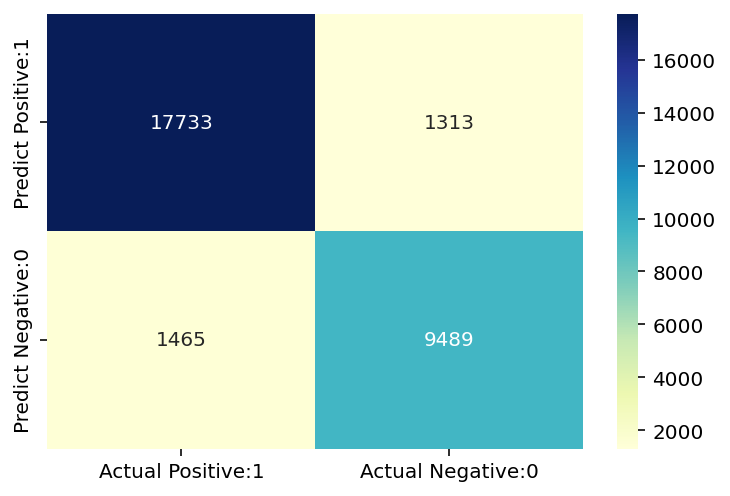

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.92      0.93      0.93     19046
           1       0.88      0.87      0.87     10954

    accuracy                           0.91     30000
   macro avg       0.90      0.90      0.90     30000
weighted avg       0.91      0.91      0.91     30000

_____________________________________________________________________________
Classification accuracy : 0.9074
_____________________________________________________________________________


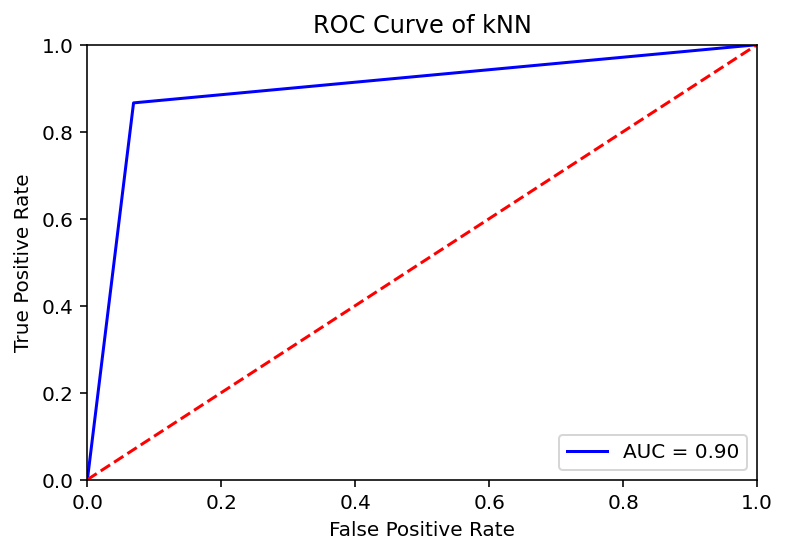

K -----> 5
Model accuracy score: 0.9203
Training-set accuracy score: 0.9394
Confusion matrix

 [[18364   682]
 [ 1710  9244]]

True Positives(TP) =  18364

True Negatives(TN) =  9244

False Positives(FP) =  682

False Negatives(FN) =  1710
_____________________________________________________________________________


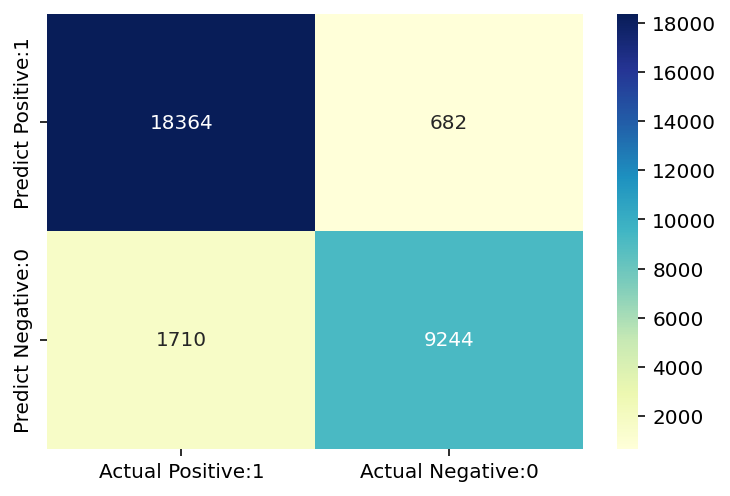

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.96      0.94     19046
           1       0.93      0.84      0.89     10954

    accuracy                           0.92     30000
   macro avg       0.92      0.90      0.91     30000
weighted avg       0.92      0.92      0.92     30000

_____________________________________________________________________________
Classification accuracy : 0.9203
_____________________________________________________________________________


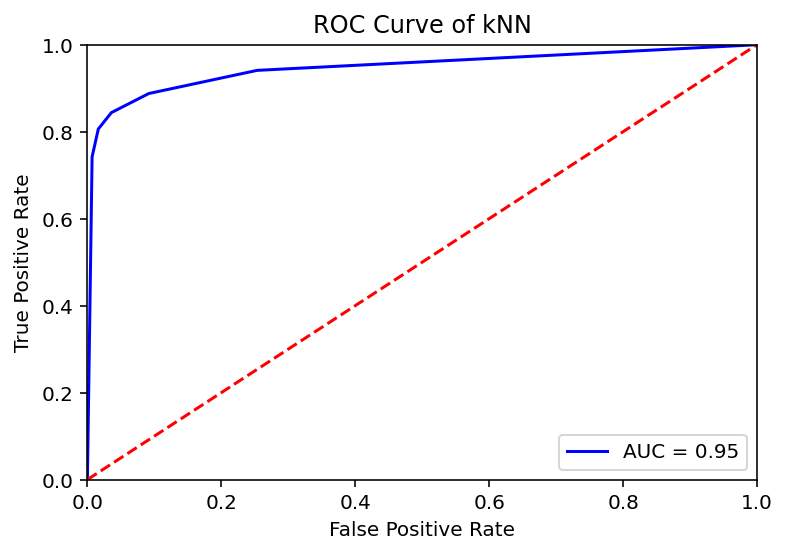

K -----> 9
Model accuracy score: 0.9187


KeyboardInterrupt: ignored

In [ ]:
from scipy.sparse import hstack
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD

for i in range(len(model_datas)):  
  df = model_datas[i]
  
  X = df.drop(['is_attributed','Year','Month','minute'], axis=1)
  y = df['is_attributed']
  print(len(X))

  
  columns = X.columns

  X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
  X = hstack((X,np.array(df['ip'])[:,None]))
  
  lf = TruncatedSVD(10)
  X = lf.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = (scaler.fit_transform(X_train))
  X_test = (scaler.transform(X_test))

  k_range = range(1, 26 ,4)
  scores = []
  for k in k_range:
    print("K ----->" , k)
    y_pred , y_pred_probab = knn_model(X_train, X_test, y_train, y_test , k)
    evalute_mode(y_pred , y_pred_probab , y_test)
  print(scores)
  # y_pred , y_pred_probab ,log = lgstc_Reg_sparse(X_train , X_test , y_train, y_test)
  # evalute_mode(y_pred , y_pred_probab ,y_test)


    

10000
K -----> 1
Model accuracy score: 0.9020
Training-set accuracy score: 1.0000
Confusion matrix

 [[1177  110]
 [  86  627]]

True Positives(TP) =  1177

True Negatives(TN) =  627

False Positives(FP) =  110

False Negatives(FN) =  86
_____________________________________________________________________________


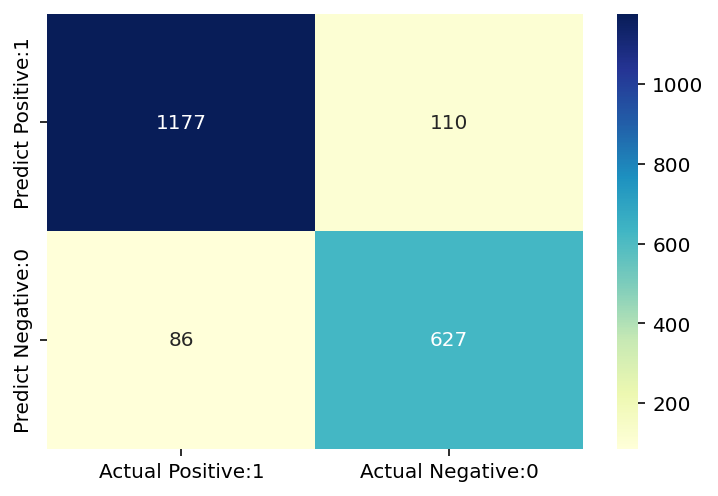

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.93      0.91      0.92      1287
           1       0.85      0.88      0.86       713

    accuracy                           0.90      2000
   macro avg       0.89      0.90      0.89      2000
weighted avg       0.90      0.90      0.90      2000

_____________________________________________________________________________
Classification accuracy : 0.9020
_____________________________________________________________________________


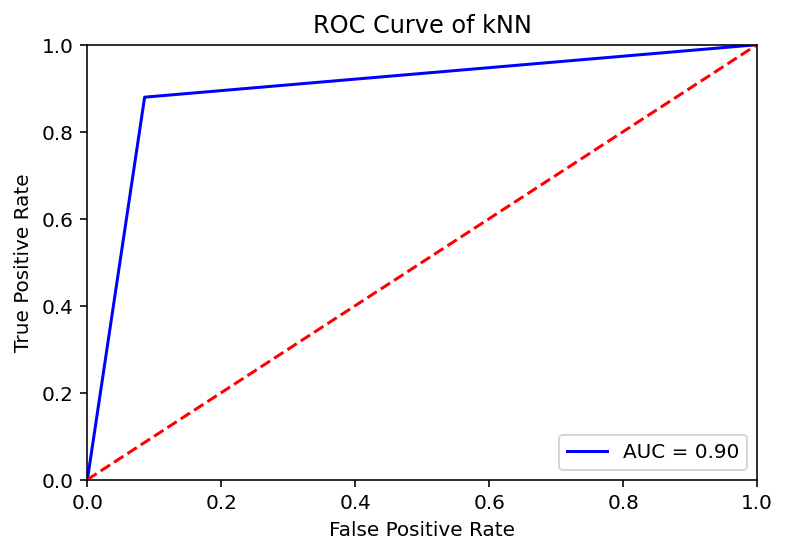

K -----> 5
Model accuracy score: 0.9180
Training-set accuracy score: 0.9260
Confusion matrix

 [[1225   62]
 [ 102  611]]

True Positives(TP) =  1225

True Negatives(TN) =  611

False Positives(FP) =  62

False Negatives(FN) =  102
_____________________________________________________________________________


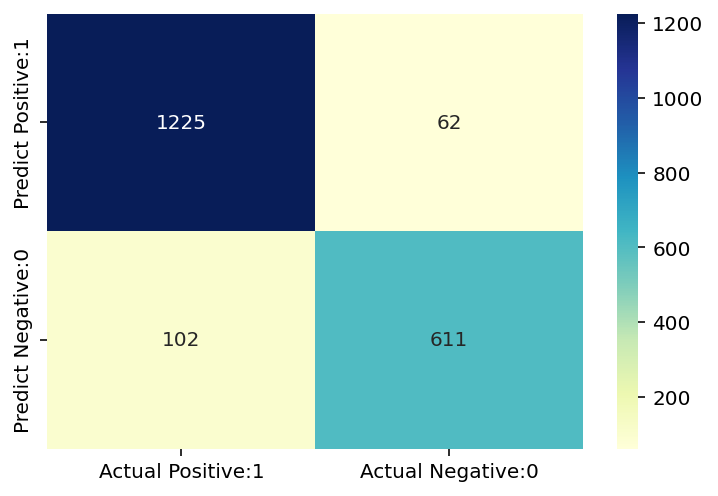

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.92      0.95      0.94      1287
           1       0.91      0.86      0.88       713

    accuracy                           0.92      2000
   macro avg       0.92      0.90      0.91      2000
weighted avg       0.92      0.92      0.92      2000

_____________________________________________________________________________
Classification accuracy : 0.9180
_____________________________________________________________________________


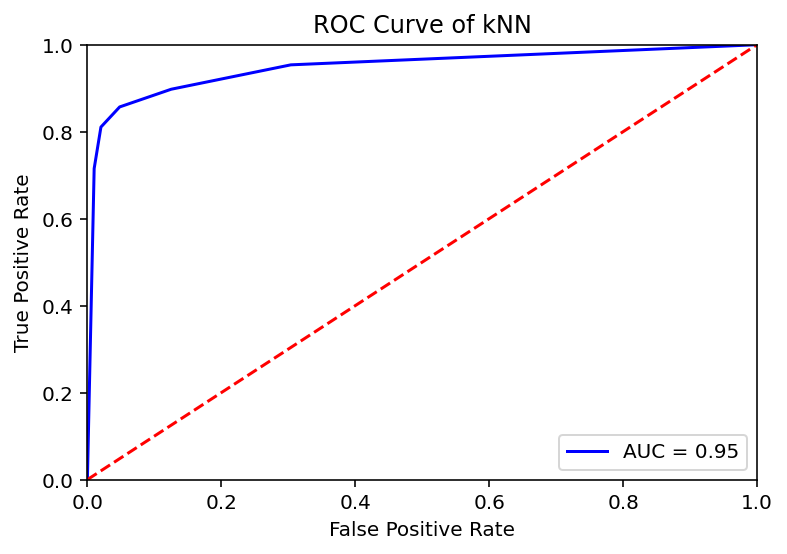

K -----> 9
Model accuracy score: 0.9195
Training-set accuracy score: 0.9183
Confusion matrix

 [[1241   46]
 [ 115  598]]

True Positives(TP) =  1241

True Negatives(TN) =  598

False Positives(FP) =  46

False Negatives(FN) =  115
_____________________________________________________________________________


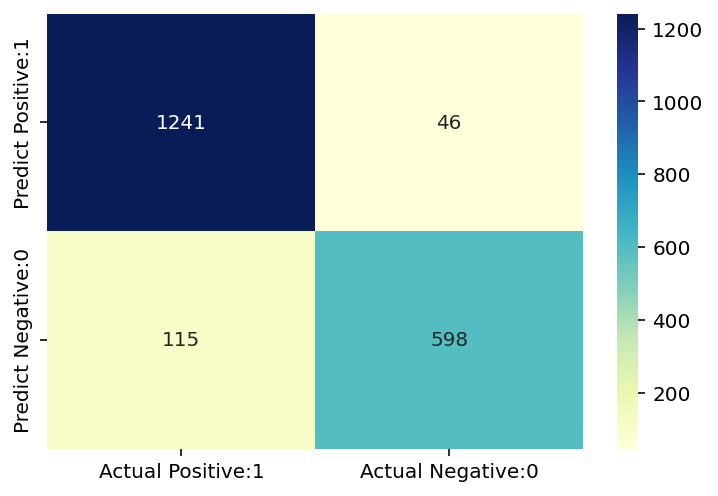

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.92      0.96      0.94      1287
           1       0.93      0.84      0.88       713

    accuracy                           0.92      2000
   macro avg       0.92      0.90      0.91      2000
weighted avg       0.92      0.92      0.92      2000

_____________________________________________________________________________
Classification accuracy : 0.9195
_____________________________________________________________________________


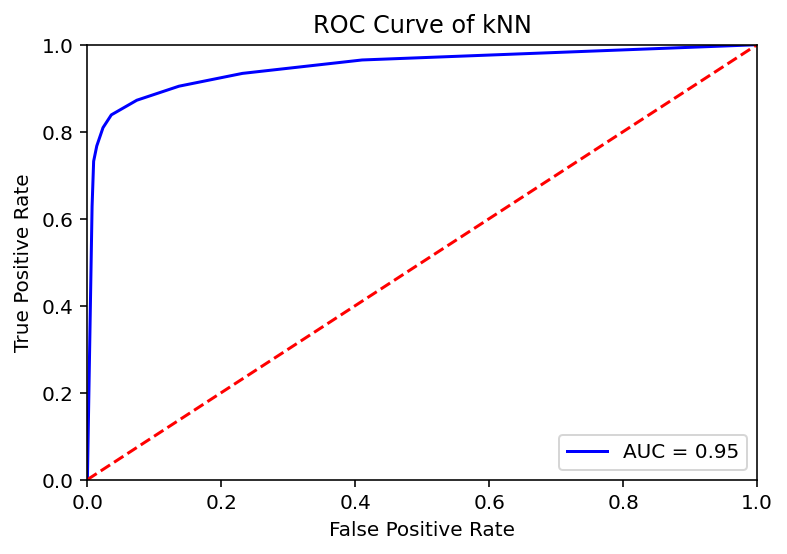

K -----> 13
Model accuracy score: 0.9100
Training-set accuracy score: 0.9157
Confusion matrix

 [[1228   59]
 [ 121  592]]

True Positives(TP) =  1228

True Negatives(TN) =  592

False Positives(FP) =  59

False Negatives(FN) =  121
_____________________________________________________________________________


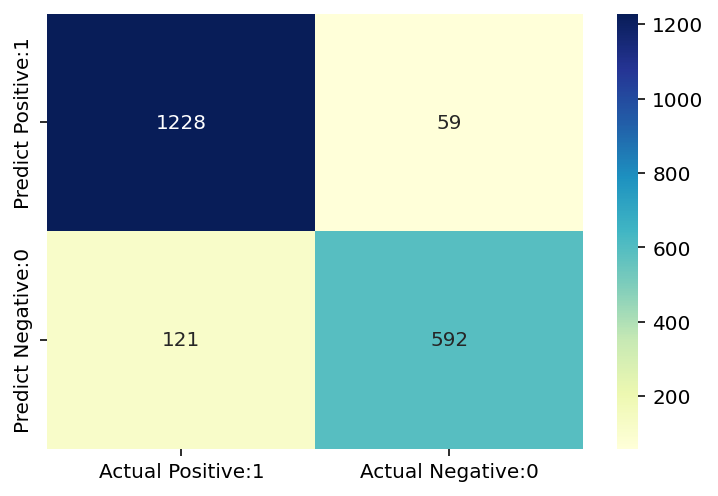

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.95      0.93      1287
           1       0.91      0.83      0.87       713

    accuracy                           0.91      2000
   macro avg       0.91      0.89      0.90      2000
weighted avg       0.91      0.91      0.91      2000

_____________________________________________________________________________
Classification accuracy : 0.9100
_____________________________________________________________________________


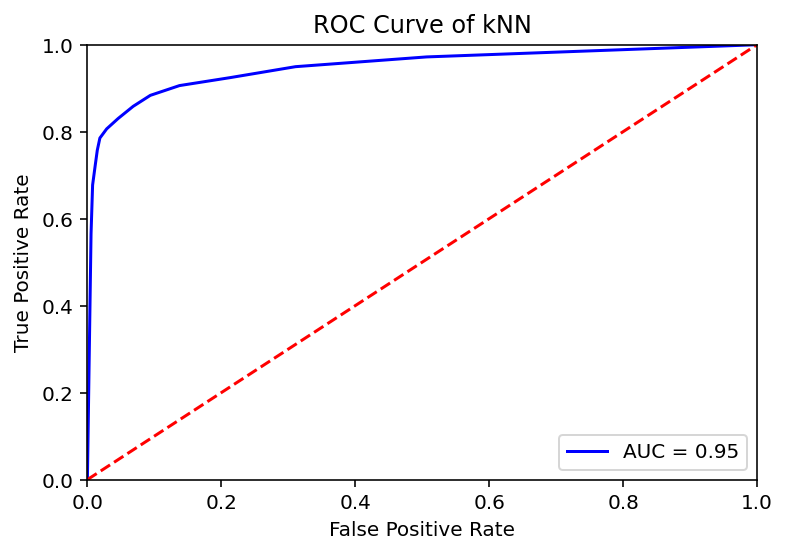

K -----> 17
Model accuracy score: 0.9080
Training-set accuracy score: 0.9133
Confusion matrix

 [[1224   63]
 [ 121  592]]

True Positives(TP) =  1224

True Negatives(TN) =  592

False Positives(FP) =  63

False Negatives(FN) =  121
_____________________________________________________________________________


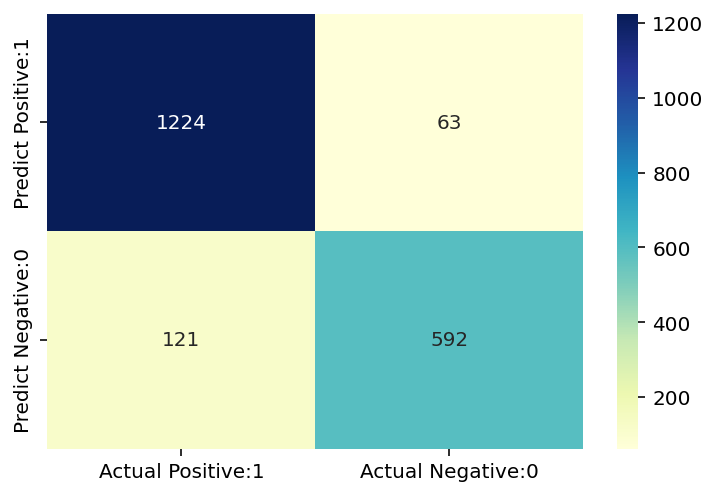

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.95      0.93      1287
           1       0.90      0.83      0.87       713

    accuracy                           0.91      2000
   macro avg       0.91      0.89      0.90      2000
weighted avg       0.91      0.91      0.91      2000

_____________________________________________________________________________
Classification accuracy : 0.9080
_____________________________________________________________________________


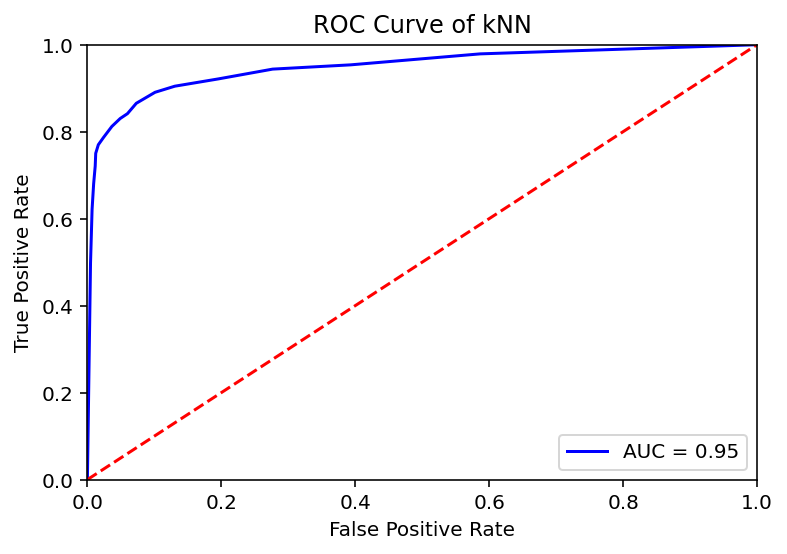

K -----> 21
Model accuracy score: 0.9070
Training-set accuracy score: 0.9093
Confusion matrix

 [[1228   59]
 [ 127  586]]

True Positives(TP) =  1228

True Negatives(TN) =  586

False Positives(FP) =  59

False Negatives(FN) =  127
_____________________________________________________________________________


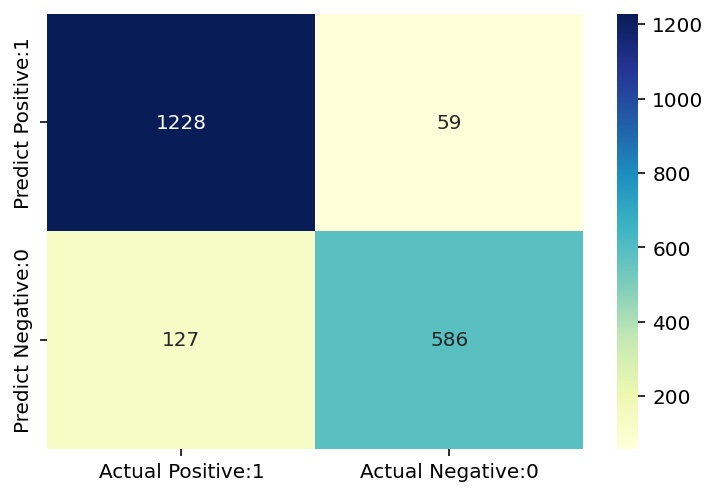

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.95      0.93      1287
           1       0.91      0.82      0.86       713

    accuracy                           0.91      2000
   macro avg       0.91      0.89      0.90      2000
weighted avg       0.91      0.91      0.91      2000

_____________________________________________________________________________
Classification accuracy : 0.9070
_____________________________________________________________________________


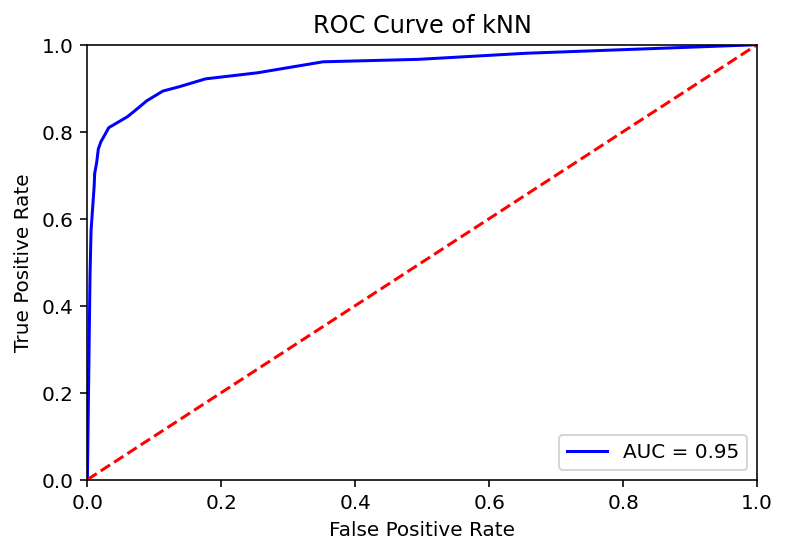

K -----> 25
Model accuracy score: 0.9055
Training-set accuracy score: 0.9084
Confusion matrix

 [[1226   61]
 [ 128  585]]

True Positives(TP) =  1226

True Negatives(TN) =  585

False Positives(FP) =  61

False Negatives(FN) =  128
_____________________________________________________________________________


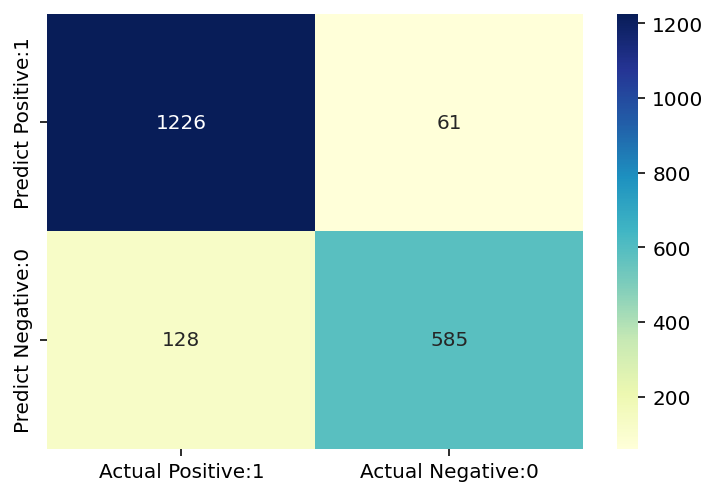

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.95      0.93      1287
           1       0.91      0.82      0.86       713

    accuracy                           0.91      2000
   macro avg       0.91      0.89      0.89      2000
weighted avg       0.91      0.91      0.90      2000

_____________________________________________________________________________
Classification accuracy : 0.9055
_____________________________________________________________________________


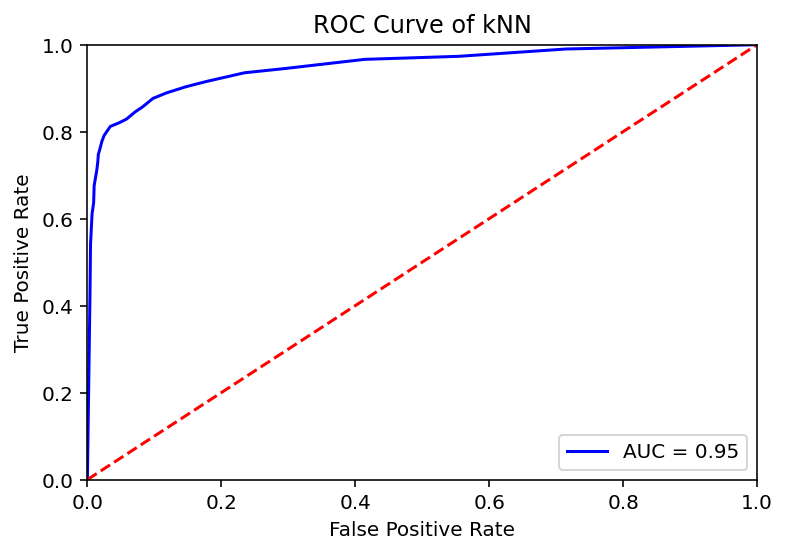

[]
50000
K -----> 1
Model accuracy score: 0.9124
Training-set accuracy score: 0.9999
Confusion matrix

 [[5944  419]
 [ 457 3180]]

True Positives(TP) =  5944

True Negatives(TN) =  3180

False Positives(FP) =  419

False Negatives(FN) =  457
_____________________________________________________________________________


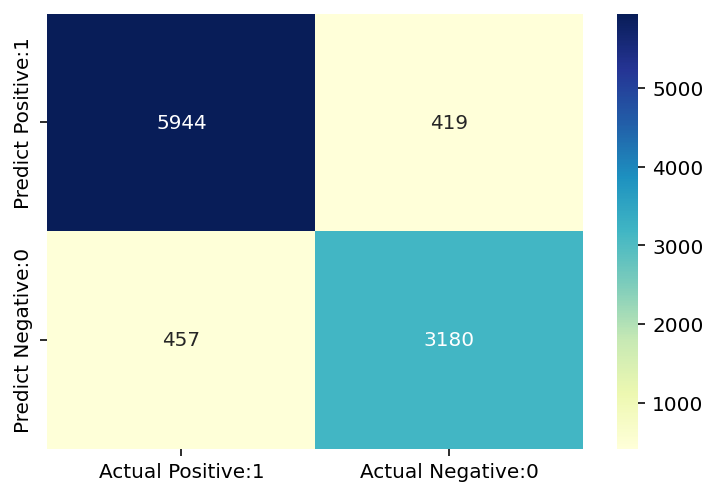

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.93      0.93      0.93      6363
           1       0.88      0.87      0.88      3637

    accuracy                           0.91     10000
   macro avg       0.91      0.90      0.91     10000
weighted avg       0.91      0.91      0.91     10000

_____________________________________________________________________________
Classification accuracy : 0.9124
_____________________________________________________________________________


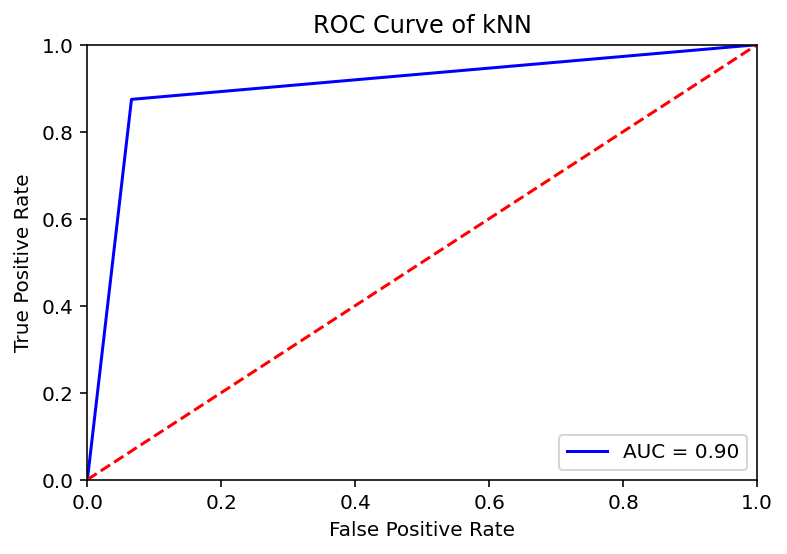

K -----> 5
Model accuracy score: 0.9250
Training-set accuracy score: 0.9462
Confusion matrix

 [[6139  224]
 [ 526 3111]]

True Positives(TP) =  6139

True Negatives(TN) =  3111

False Positives(FP) =  224

False Negatives(FN) =  526
_____________________________________________________________________________


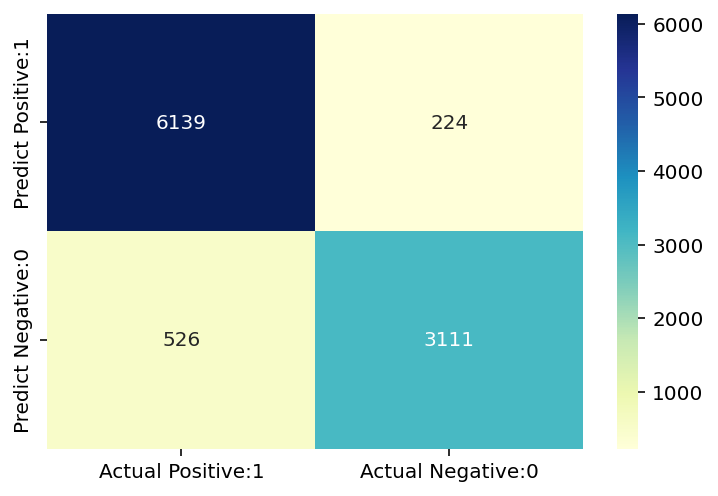

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.92      0.96      0.94      6363
           1       0.93      0.86      0.89      3637

    accuracy                           0.93     10000
   macro avg       0.93      0.91      0.92     10000
weighted avg       0.93      0.93      0.92     10000

_____________________________________________________________________________
Classification accuracy : 0.9250
_____________________________________________________________________________


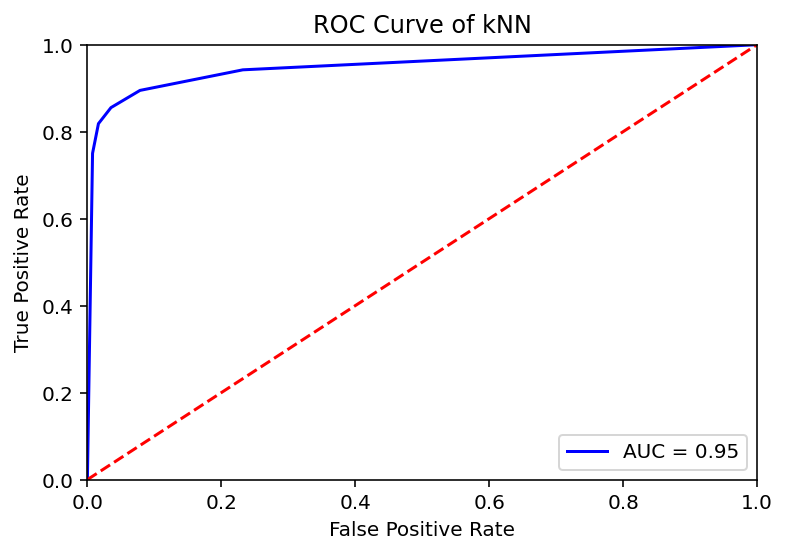

K -----> 9
Model accuracy score: 0.9225
Training-set accuracy score: 0.9372
Confusion matrix

 [[6174  189]
 [ 586 3051]]

True Positives(TP) =  6174

True Negatives(TN) =  3051

False Positives(FP) =  189

False Negatives(FN) =  586
_____________________________________________________________________________


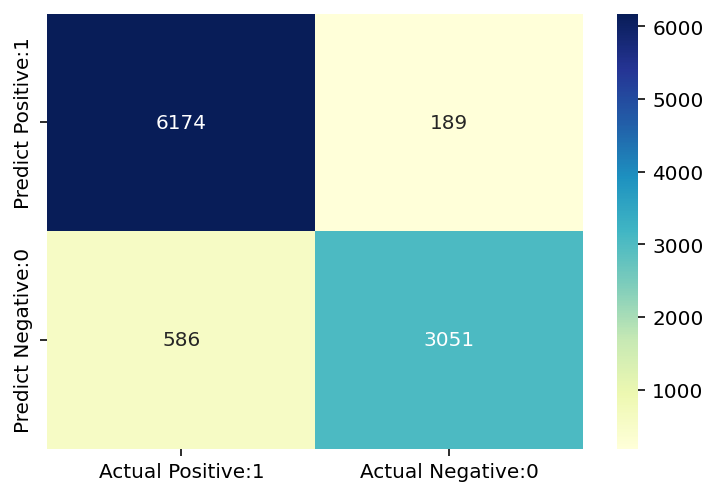

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.97      0.94      6363
           1       0.94      0.84      0.89      3637

    accuracy                           0.92     10000
   macro avg       0.93      0.90      0.91     10000
weighted avg       0.92      0.92      0.92     10000

_____________________________________________________________________________
Classification accuracy : 0.9225
_____________________________________________________________________________


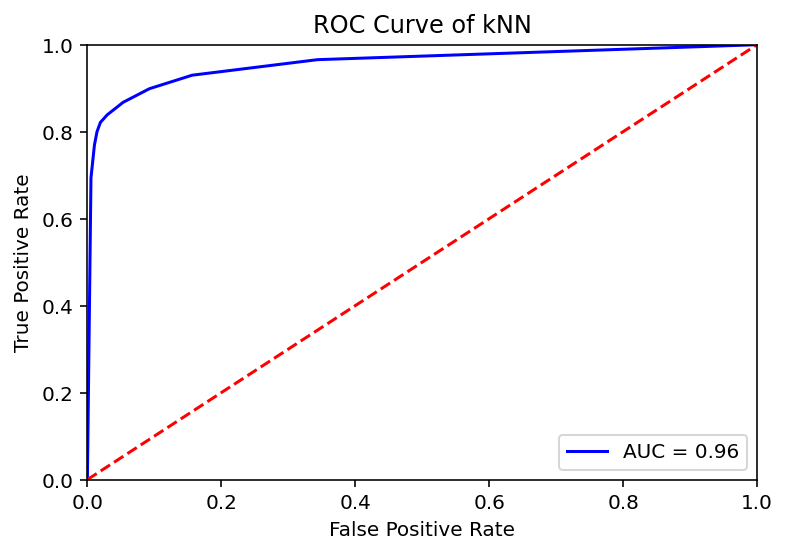

K -----> 13
Model accuracy score: 0.9208
Training-set accuracy score: 0.9327
Confusion matrix

 [[6173  190]
 [ 602 3035]]

True Positives(TP) =  6173

True Negatives(TN) =  3035

False Positives(FP) =  190

False Negatives(FN) =  602
_____________________________________________________________________________


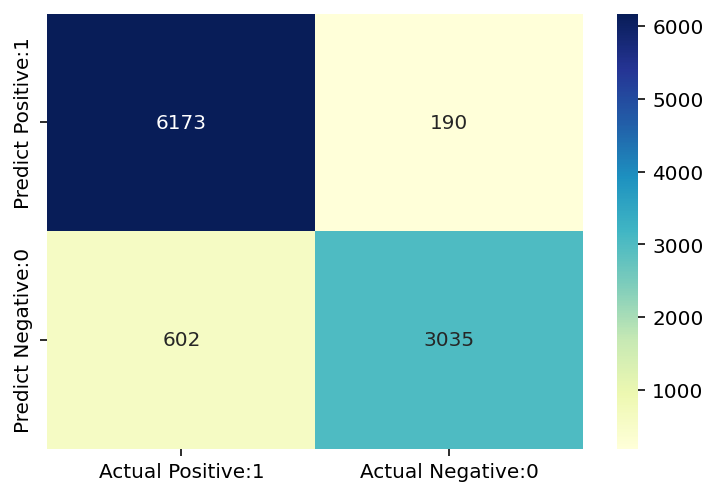

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.91      0.97      0.94      6363
           1       0.94      0.83      0.88      3637

    accuracy                           0.92     10000
   macro avg       0.93      0.90      0.91     10000
weighted avg       0.92      0.92      0.92     10000

_____________________________________________________________________________
Classification accuracy : 0.9208
_____________________________________________________________________________


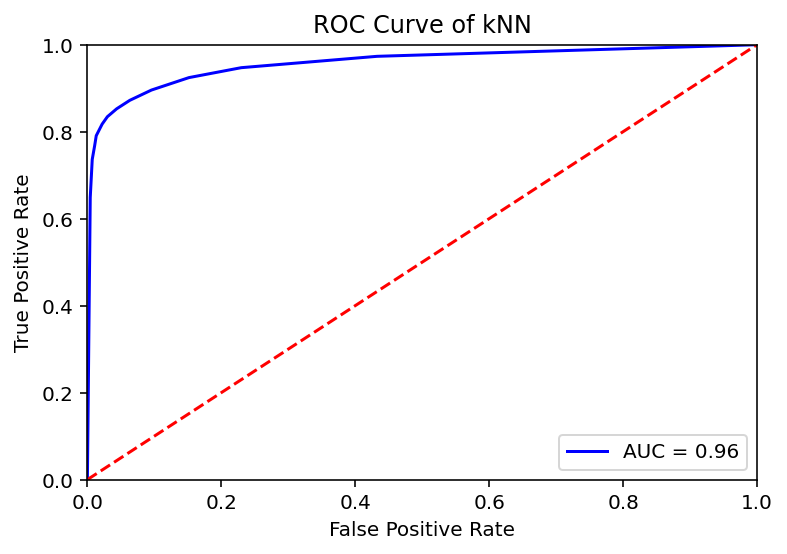

K -----> 17


KeyboardInterrupt: ignored

In [ ]:
from scipy.sparse import hstack
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD

for i in range(len(model_datas)):  
  df = model_datas[i]
  
  X = df.drop(['is_attributed','Year','Month','minute'], axis=1)
  y = df['is_attributed']
  print(len(X))

  
  columns = X.columns

  X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
  X = hstack((X,np.array(df['ip'])[:,None]))
  
  lf = TruncatedSVD(216)
  X = lf.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = (scaler.fit_transform(X_train))
  X_test = (scaler.transform(X_test))

  k_range = range(1, 26 ,4)
  scores = []
  for k in k_range:
    print("K ----->" , k)
    y_pred , y_pred_probab = knn_model(X_train, X_test, y_train, y_test , k)
    evalute_mode(y_pred , y_pred_probab , y_test)
  print(scores)
  # y_pred , y_pred_probab ,log = lgstc_Reg_sparse(X_train , X_test , y_train, y_test)
  # evalute_mode(y_pred , y_pred_probab ,y_test)

50000
K -----> 1
Model accuracy score: 0.9727
Training-set accuracy score: 1.0000
Confusion matrix

 [[9446  121]
 [ 152  281]]

True Positives(TP) =  9446

True Negatives(TN) =  281

False Positives(FP) =  121

False Negatives(FN) =  152
_____________________________________________________________________________


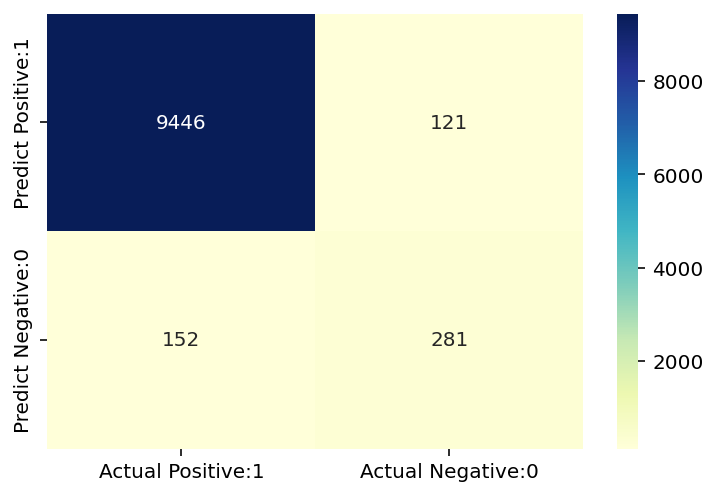

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.98      0.99      0.99      9567
           1       0.70      0.65      0.67       433

    accuracy                           0.97     10000
   macro avg       0.84      0.82      0.83     10000
weighted avg       0.97      0.97      0.97     10000

_____________________________________________________________________________
Classification accuracy : 0.9727
_____________________________________________________________________________


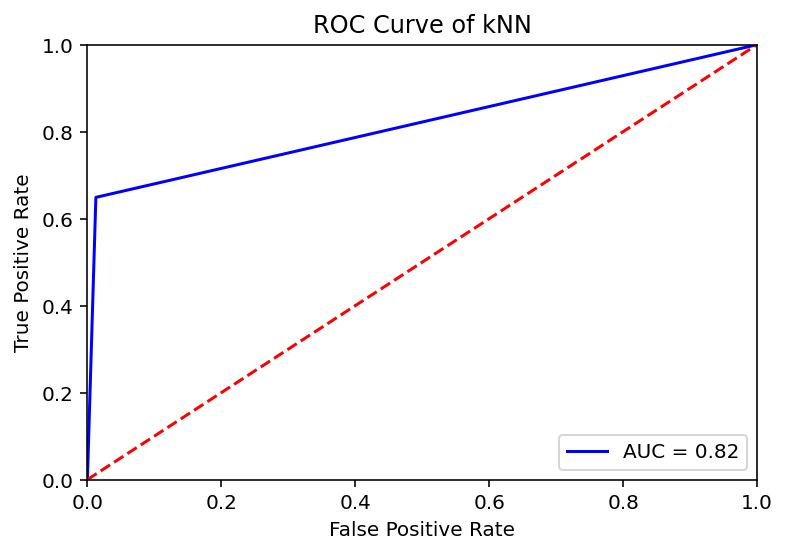

K -----> 5
Model accuracy score: 0.9808
Training-set accuracy score: 0.9857
Confusion matrix

 [[9511   56]
 [ 136  297]]

True Positives(TP) =  9511

True Negatives(TN) =  297

False Positives(FP) =  56

False Negatives(FN) =  136
_____________________________________________________________________________


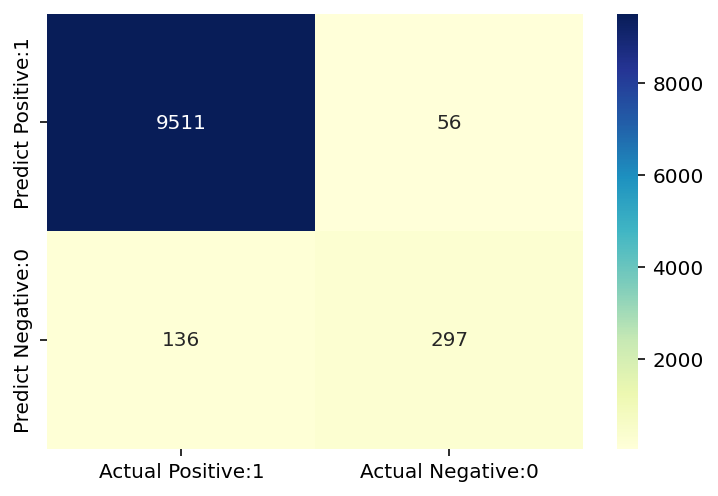

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9567
           1       0.84      0.69      0.76       433

    accuracy                           0.98     10000
   macro avg       0.91      0.84      0.87     10000
weighted avg       0.98      0.98      0.98     10000

_____________________________________________________________________________
Classification accuracy : 0.9808
_____________________________________________________________________________


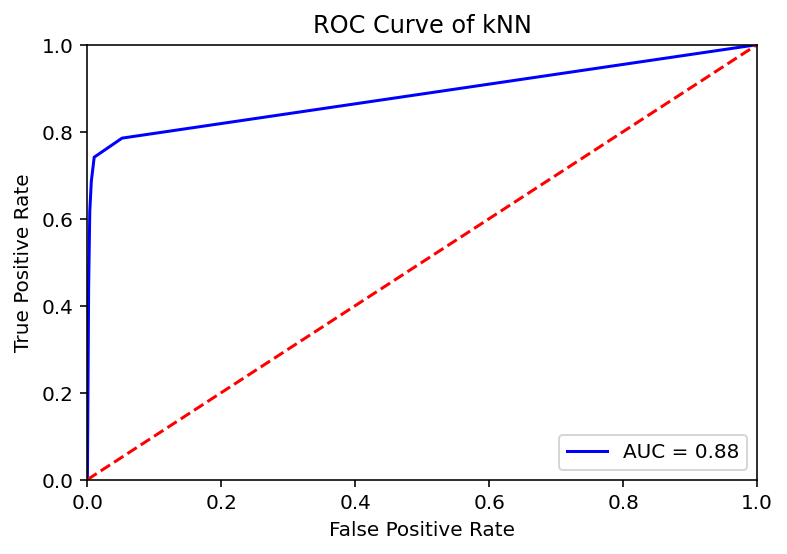

K -----> 9
Model accuracy score: 0.9811
Training-set accuracy score: 0.9847
Confusion matrix

 [[9516   51]
 [ 138  295]]

True Positives(TP) =  9516

True Negatives(TN) =  295

False Positives(FP) =  51

False Negatives(FN) =  138
_____________________________________________________________________________


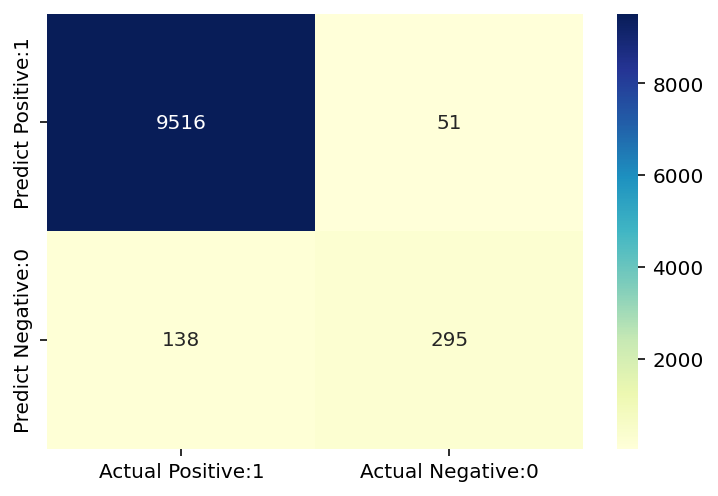

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9567
           1       0.85      0.68      0.76       433

    accuracy                           0.98     10000
   macro avg       0.92      0.84      0.87     10000
weighted avg       0.98      0.98      0.98     10000

_____________________________________________________________________________
Classification accuracy : 0.9811
_____________________________________________________________________________


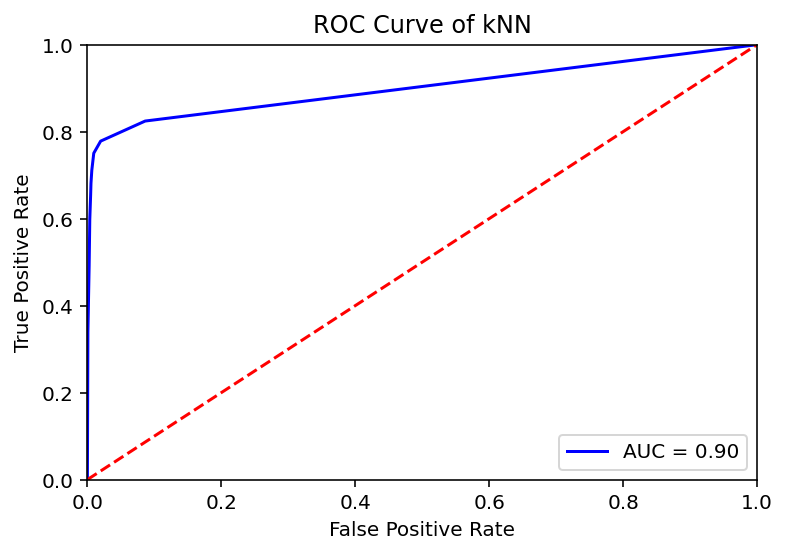

K -----> 13
Model accuracy score: 0.9814
Training-set accuracy score: 0.9846
Confusion matrix

 [[9516   51]
 [ 135  298]]

True Positives(TP) =  9516

True Negatives(TN) =  298

False Positives(FP) =  51

False Negatives(FN) =  135
_____________________________________________________________________________


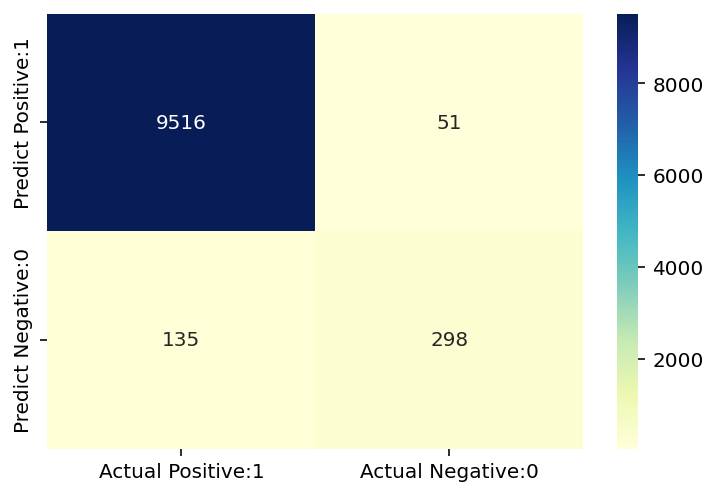

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9567
           1       0.85      0.69      0.76       433

    accuracy                           0.98     10000
   macro avg       0.92      0.84      0.88     10000
weighted avg       0.98      0.98      0.98     10000

_____________________________________________________________________________
Classification accuracy : 0.9814
_____________________________________________________________________________


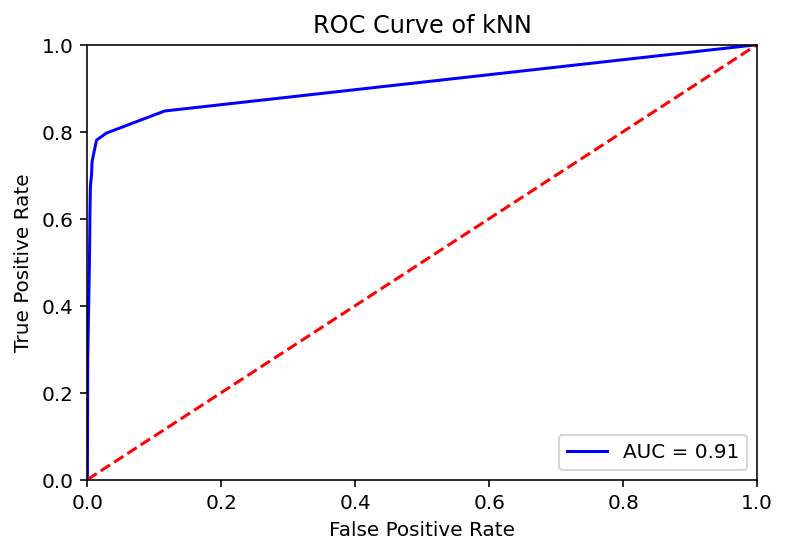

K -----> 17
Model accuracy score: 0.9806
Training-set accuracy score: 0.9840
Confusion matrix

 [[9514   53]
 [ 141  292]]

True Positives(TP) =  9514

True Negatives(TN) =  292

False Positives(FP) =  53

False Negatives(FN) =  141
_____________________________________________________________________________


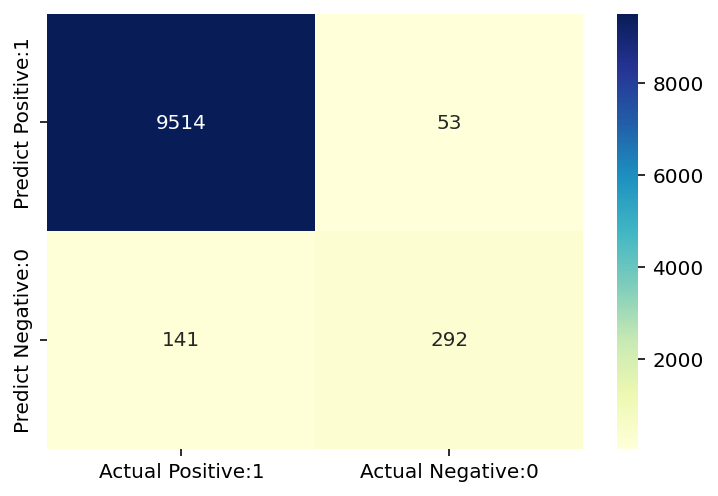

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9567
           1       0.85      0.67      0.75       433

    accuracy                           0.98     10000
   macro avg       0.92      0.83      0.87     10000
weighted avg       0.98      0.98      0.98     10000

_____________________________________________________________________________
Classification accuracy : 0.9806
_____________________________________________________________________________


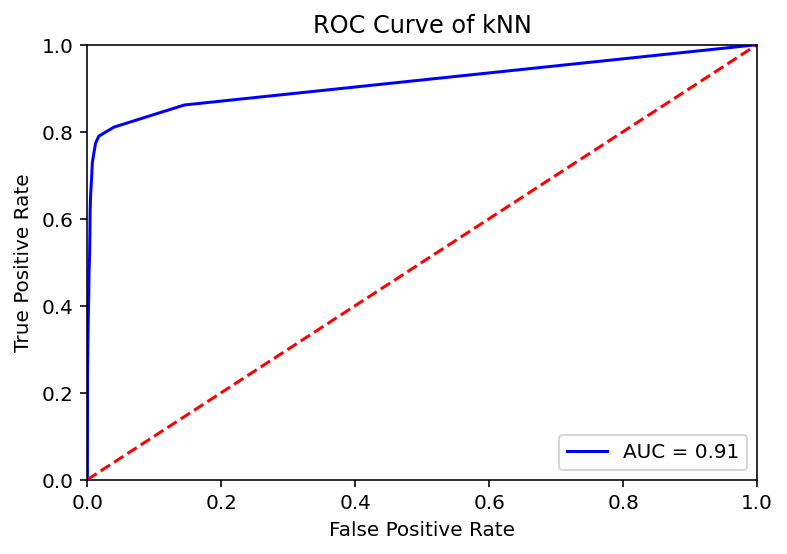

K -----> 21
Model accuracy score: 0.9803
Training-set accuracy score: 0.9839
Confusion matrix

 [[9513   54]
 [ 143  290]]

True Positives(TP) =  9513

True Negatives(TN) =  290

False Positives(FP) =  54

False Negatives(FN) =  143
_____________________________________________________________________________


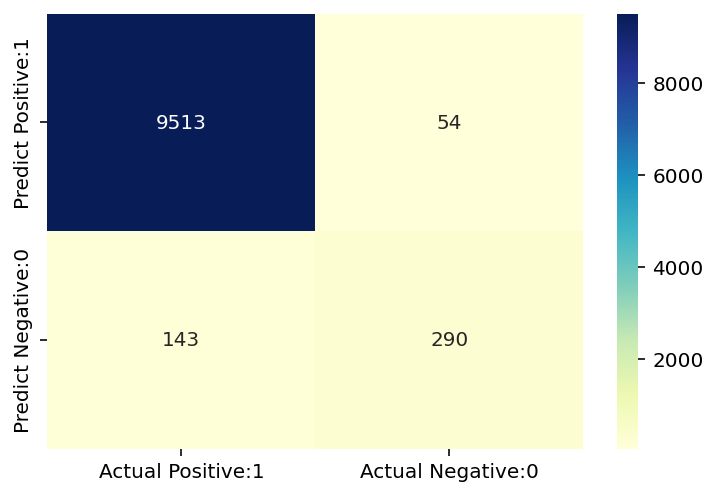

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9567
           1       0.84      0.67      0.75       433

    accuracy                           0.98     10000
   macro avg       0.91      0.83      0.87     10000
weighted avg       0.98      0.98      0.98     10000

_____________________________________________________________________________
Classification accuracy : 0.9803
_____________________________________________________________________________


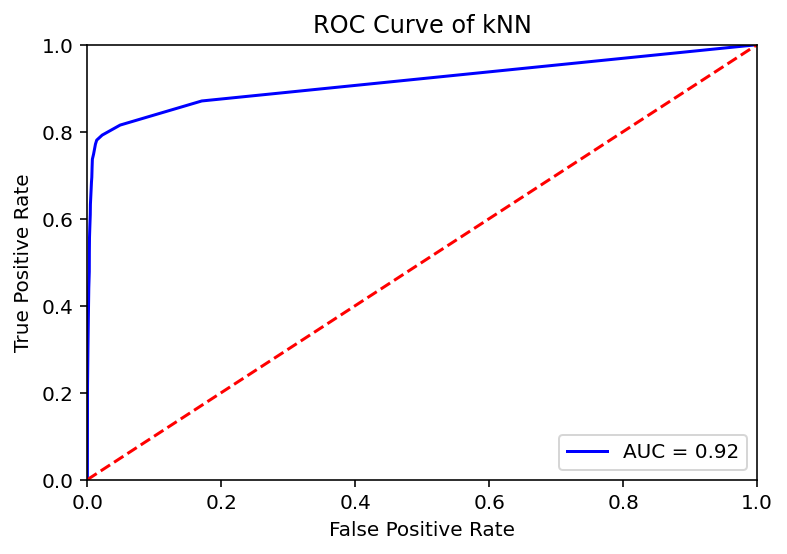

K -----> 25
Model accuracy score: 0.9800
Training-set accuracy score: 0.9830
Confusion matrix

 [[9515   52]
 [ 148  285]]

True Positives(TP) =  9515

True Negatives(TN) =  285

False Positives(FP) =  52

False Negatives(FN) =  148
_____________________________________________________________________________


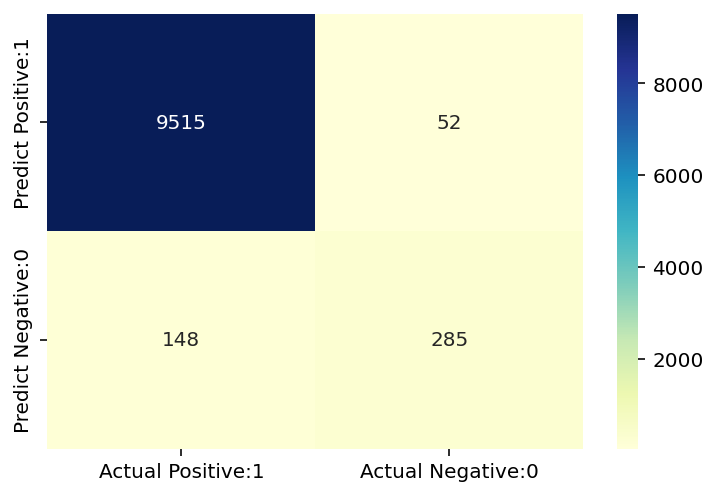

_____________________________________________________________________________
              precision    recall  f1-score   support

           0       0.98      0.99      0.99      9567
           1       0.85      0.66      0.74       433

    accuracy                           0.98     10000
   macro avg       0.92      0.83      0.86     10000
weighted avg       0.98      0.98      0.98     10000

_____________________________________________________________________________
Classification accuracy : 0.9800
_____________________________________________________________________________


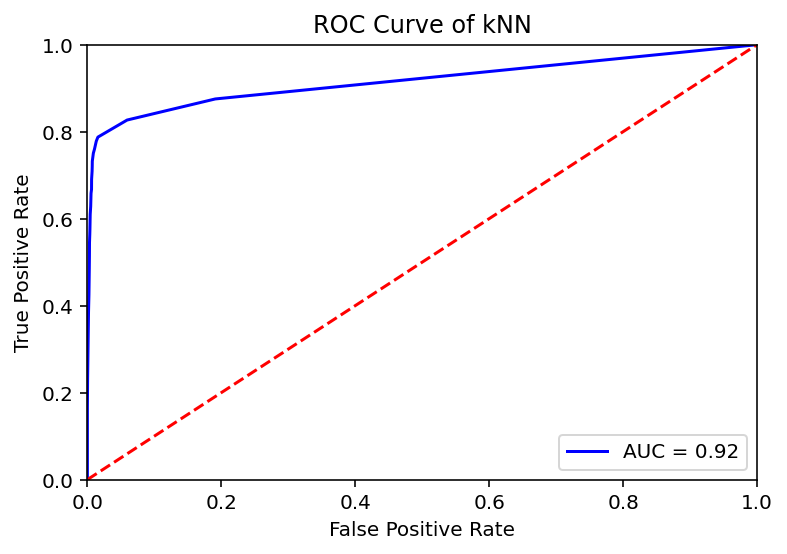

[]


In [ ]:
from scipy.sparse import hstack
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD

for i in range(1):  
  df = resample_data(test,50000)
  
  X = df.drop(['is_attributed','Year','Month','minute'], axis=1)
  y = df['is_attributed']
  print(len(X))

  
  columns = X.columns

  X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
  X = hstack((X,np.array(df['ip'])[:,None]))
  
  lf = TruncatedSVD(216)
  X = lf.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = (scaler.fit_transform(X_train))
  X_test = (scaler.transform(X_test))

  k_range = range(1, 26 ,4)
  scores = []
  for k in k_range:
    print("K ----->" , k)
    y_pred , y_pred_probab = knn_model(X_train, X_test, y_train, y_test , k)
    evalute_mode(y_pred , y_pred_probab , y_test)
  print(scores)

In [ ]:
#PCA
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
X = pca.fit_transform(X)
pca.explained_variance_ratio_

KeyboardInterrupt: ignored

# Logitic regression with sparse matrix

In [ ]:
df = model_datas[3]
df

In [ ]:
del X , y

In [ ]:
temp = df

In [ ]:
X = temp.drop(columns = ['is_attributed','Year','Month','minute','Day'])
y = temp['is_attributed']

In [ ]:
temp = resample_data(df1,100000)

In [ ]:
from sklearn.preprocessing import OneHotEncoder

X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))

In [ ]:
from scipy.sparse import hstack
X = hstack((X,np.array(temp['ip'])[:,None]))

In [ ]:
from sklearn.decomposition import TruncatedSVD

clf = TruncatedSVD(30)
Xpca = clf.fit_transform(X)

In [ ]:
scaler = StandardScaler()
X_train = pd.DataFrame(scaler.fit_transform(X_train))
X_test = pd.DataFrame(scaler.transform(X_test))

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(Xpca,y, test_size = 0.2, random_state = 0)

In [ ]:
from sklearn.linear_model import LogisticRegressionCV
clf = LogisticRegressionCV(cv=5, random_state=0,solver='lbfgs', max_iter=30).fit(X_train, y_train)

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_curve
from sklearn.metrics import auc

def evalute_mode(y_pred , y_pred_probab ,y_test):
  
  cm = confusion_matrix(y_test, y_pred)
  print('Confusion matrix\n\n', cm)
  print('\nTrue Positives(TP) = ', cm[0,0])
  print('\nTrue Negatives(TN) = ', cm[1,1])
  print('\nFalse Positives(FP) = ', cm[0,1])
  print('\nFalse Negatives(FN) = ', cm[1,0])
  TP = cm[0,0]
  TN = cm[1,1]
  FP = cm[0,1]
  FN = cm[1,0]
  print("========================================================================")
  plt.figure(figsize=(6,4))
  cm_matrix = pd.DataFrame(data=cm, columns=['Actual Positive:1', 'Actual Negative:0'], 
                                  index=['Predict Positive:1', 'Predict Negative:0'])
  sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')
  plt.show()
  print("========================================================================")
  print(classification_report(y_test, y_pred))
  print("========================================================================")
  classification_accuracy = (TP + TN) / float(TP + TN + FP + FN)
  print('Classification accuracy : {0:0.4f}'.format(classification_accuracy))
  print("========================================================================")
  fpr, tpr, threshold = roc_curve(y_test, y_pred_probab[:,1])
  roc_auc = auc(fpr, tpr)

  plt.title('Receiver Operating Characteristic')
  plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
  plt.legend(loc = 'lower right')
  plt.plot([0, 1], [0, 1],'r--')
  plt.xlim([0, 1])
  plt.ylim([0, 1])
  plt.ylabel('True Positive Rate')
  plt.xlabel('False Positive Rate')
  plt.title('ROC Curve of Logistic Regression Sparse Matrix')
  plt.show()

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LogisticRegressionCV

def lgstc_Reg_sparse(X_train, X_test, y_train, y_test, n_neighbors = 4):
  weights = {0:0.09,1:0.95}
  logreg = LogisticRegressionCV(cv=5, random_state=0,solver='lbfgs', max_iter=30,class_weight=weights)
  logreg.fit(X_train, y_train)
  y_pred = logreg.predict(X_test)
  y_pred_probab = logreg.predict_proba(X_test)
  print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test, y_pred)))
  y_pred_train = logreg.predict(X_train)
  print('Training-set accuracy score: {0:0.4f}'. format(accuracy_score(y_train, y_pred_train)))
  return y_pred , y_pred_probab , logreg

In [ ]:
def predicate_data_lgstic(X_test, y_test,logreg ):
  y_pred = logreg.predict(X_test)
  y_pred_probab = logreg.predict_proba(X_test)
  print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test, y_pred)))
  y_pred_train = logreg.predict(X_train)
  print('Training-set accuracy score: {0:0.4f}'. format(accuracy_score(y_train, y_pred_train)))
  return y_pred , y_pred_probab

100000
Model accuracy score: 0.8968
Training-set accuracy score: 0.8931
Confusion matrix

 [[11514   259]
 [ 1805  6422]]

True Positives(TP) =  11514

True Negatives(TN) =  6422

False Positives(FP) =  259

False Negatives(FN) =  1805


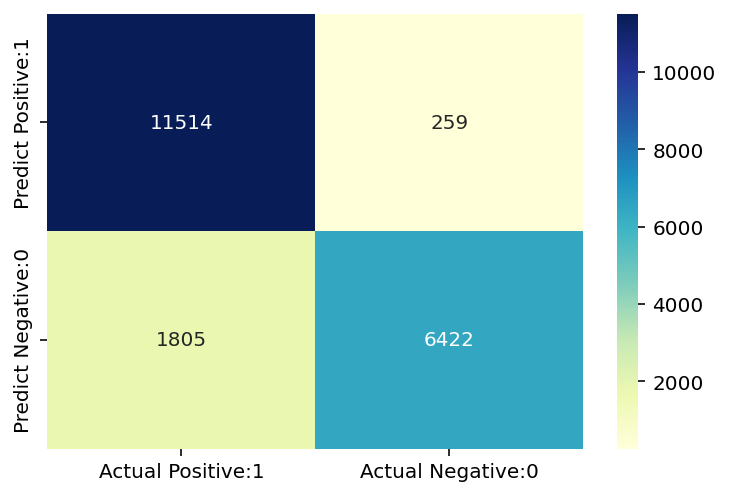

              precision    recall  f1-score   support

           0       0.86      0.98      0.92     11773
           1       0.96      0.78      0.86      8227

    accuracy                           0.90     20000
   macro avg       0.91      0.88      0.89     20000
weighted avg       0.90      0.90      0.89     20000

Classification accuracy : 0.8968


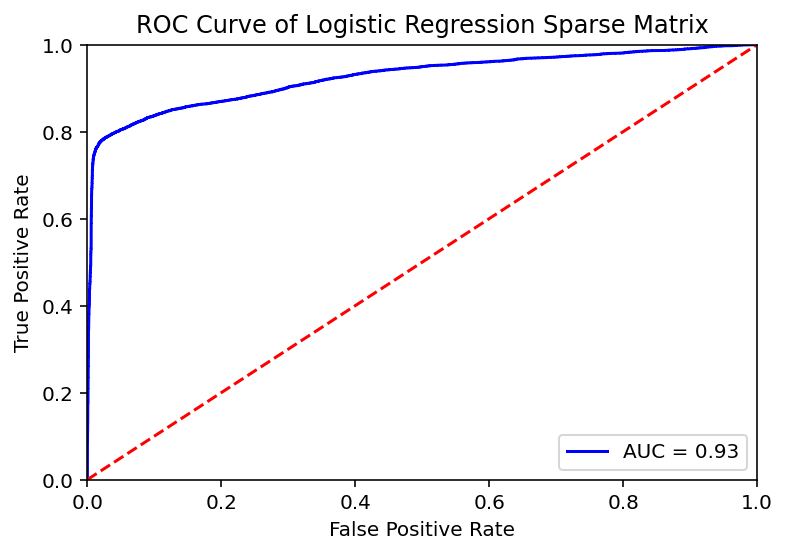

500000
Model accuracy score: 0.8921
Training-set accuracy score: 0.8935
Confusion matrix

 [[56735  1560]
 [ 9231 32474]]

True Positives(TP) =  56735

True Negatives(TN) =  32474

False Positives(FP) =  1560

False Negatives(FN) =  9231


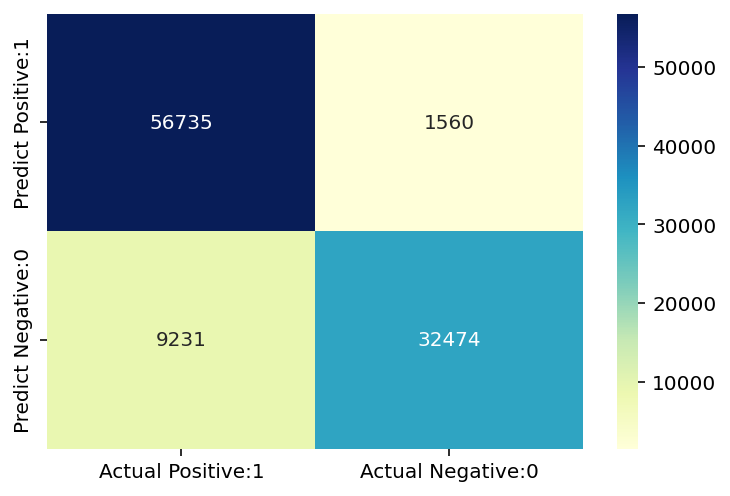

              precision    recall  f1-score   support

           0       0.86      0.97      0.91     58295
           1       0.95      0.78      0.86     41705

    accuracy                           0.89    100000
   macro avg       0.91      0.88      0.89    100000
weighted avg       0.90      0.89      0.89    100000

Classification accuracy : 0.8921


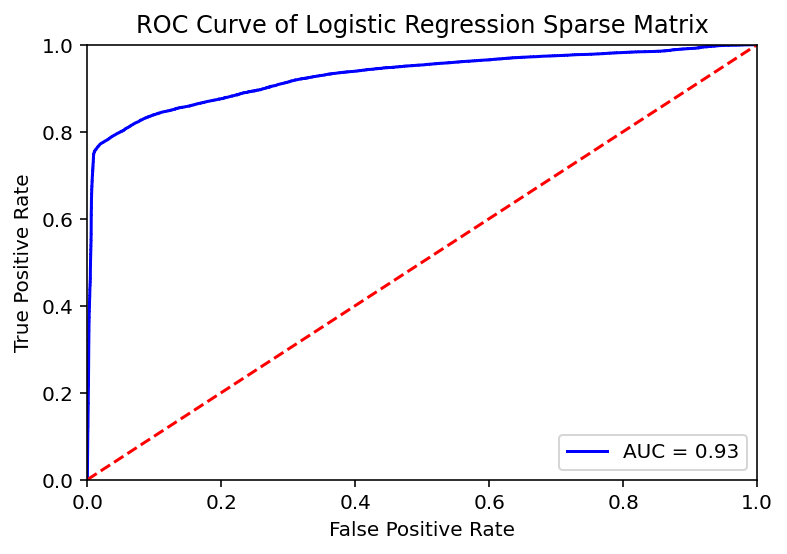

100000
Model accuracy score: 0.8971
Training-set accuracy score: 0.8931
Confusion matrix

 [[11516   257]
 [ 1802  6425]]

True Positives(TP) =  11516

True Negatives(TN) =  6425

False Positives(FP) =  257

False Negatives(FN) =  1802


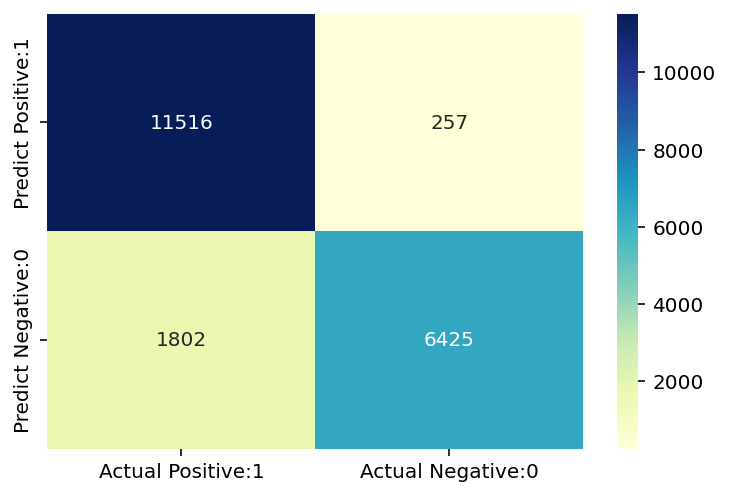

              precision    recall  f1-score   support

           0       0.86      0.98      0.92     11773
           1       0.96      0.78      0.86      8227

    accuracy                           0.90     20000
   macro avg       0.91      0.88      0.89     20000
weighted avg       0.90      0.90      0.89     20000

Classification accuracy : 0.8971


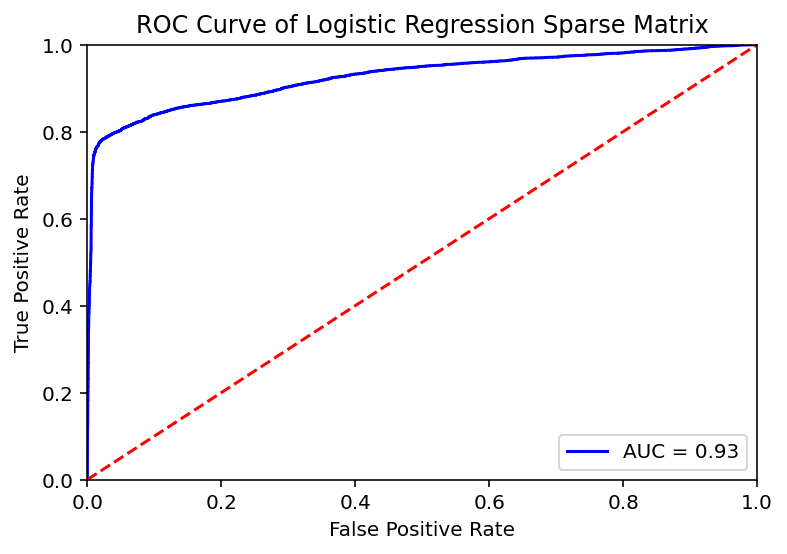

500000
Model accuracy score: 0.8920
Training-set accuracy score: 0.8934
Confusion matrix

 [[56730  1565]
 [ 9234 32471]]

True Positives(TP) =  56730

True Negatives(TN) =  32471

False Positives(FP) =  1565

False Negatives(FN) =  9234


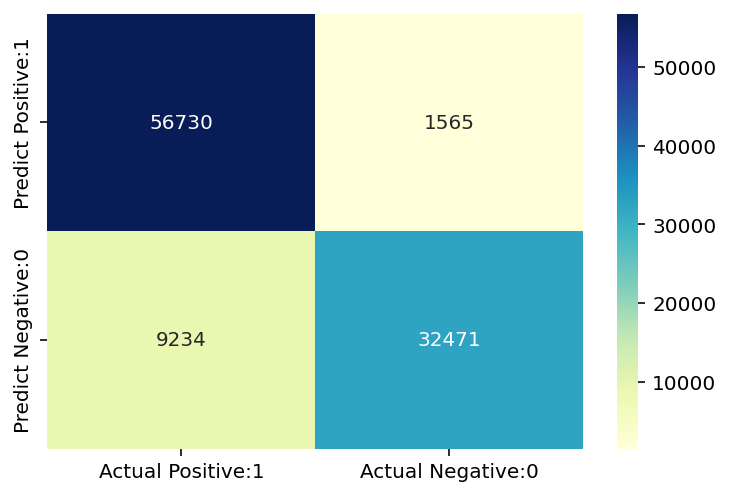

              precision    recall  f1-score   support

           0       0.86      0.97      0.91     58295
           1       0.95      0.78      0.86     41705

    accuracy                           0.89    100000
   macro avg       0.91      0.88      0.89    100000
weighted avg       0.90      0.89      0.89    100000

Classification accuracy : 0.8920


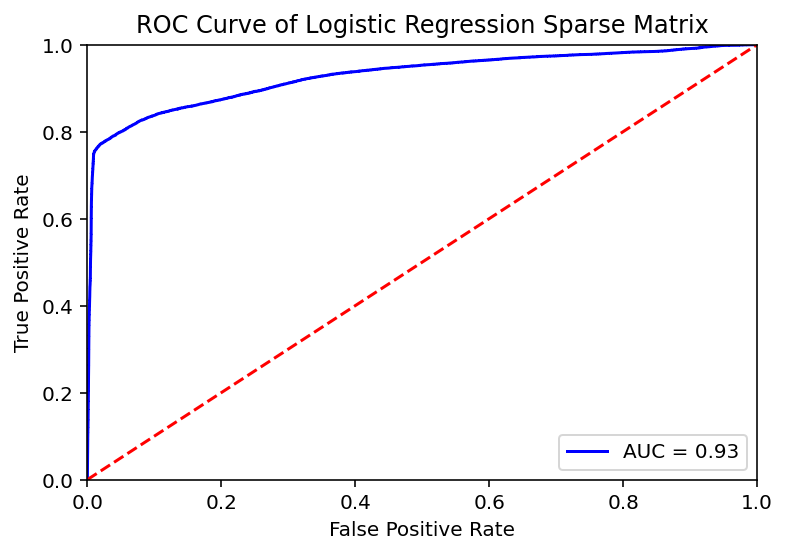

1000000
Model accuracy score: 0.8939
Training-set accuracy score: 0.8934
Confusion matrix

 [[113937   2940]
 [ 18289  64834]]

True Positives(TP) =  113937

True Negatives(TN) =  64834

False Positives(FP) =  2940

False Negatives(FN) =  18289


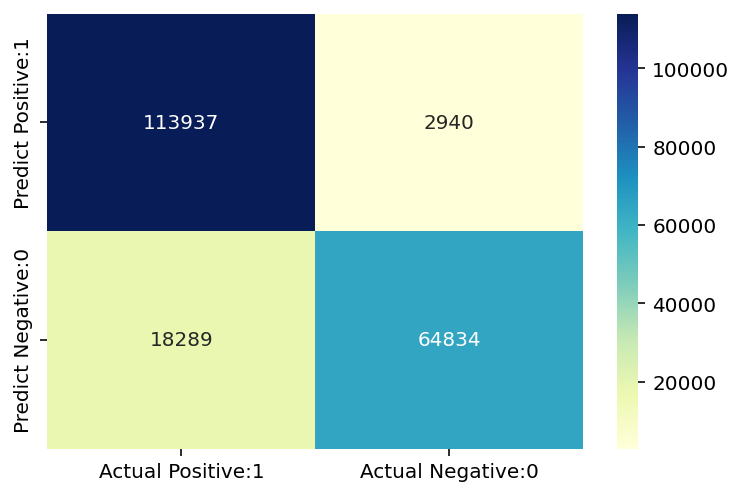

              precision    recall  f1-score   support

           0       0.86      0.97      0.91    116877
           1       0.96      0.78      0.86     83123

    accuracy                           0.89    200000
   macro avg       0.91      0.88      0.89    200000
weighted avg       0.90      0.89      0.89    200000

Classification accuracy : 0.8939


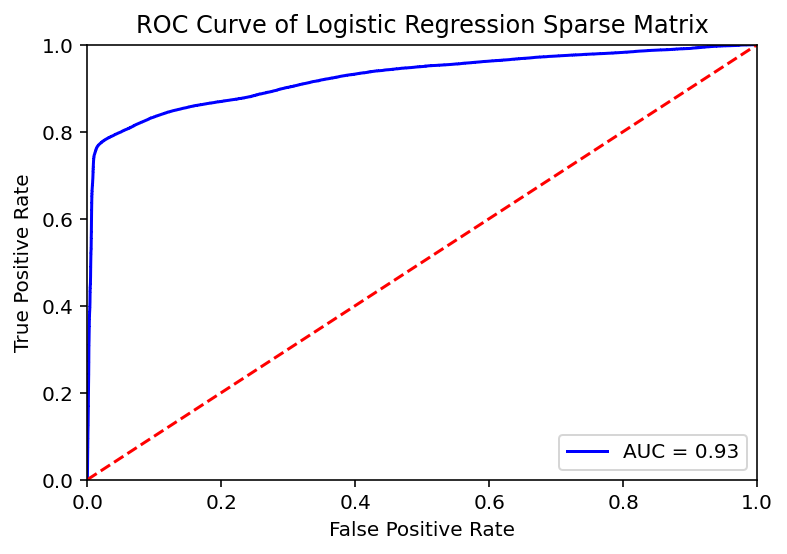

3000000
Model accuracy score: 0.8932
Training-set accuracy score: 0.8932
Confusion matrix

 [[341769   9426]
 [ 54638 194167]]

True Positives(TP) =  341769

True Negatives(TN) =  194167

False Positives(FP) =  9426

False Negatives(FN) =  54638


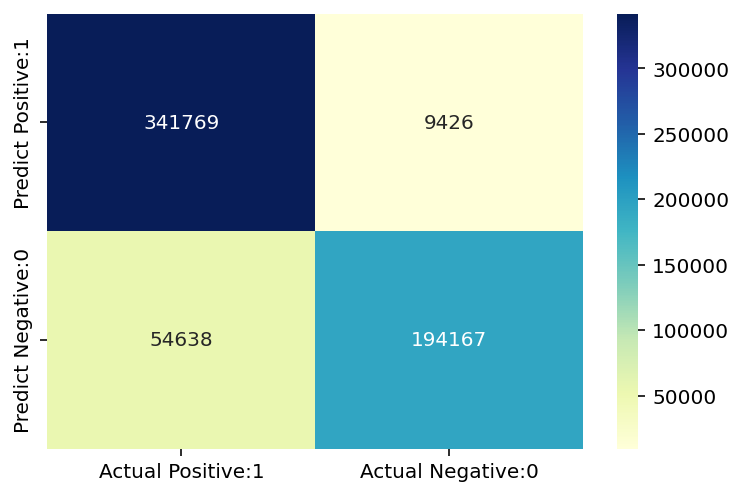

              precision    recall  f1-score   support

           0       0.86      0.97      0.91    351195
           1       0.95      0.78      0.86    248805

    accuracy                           0.89    600000
   macro avg       0.91      0.88      0.89    600000
weighted avg       0.90      0.89      0.89    600000

Classification accuracy : 0.8932


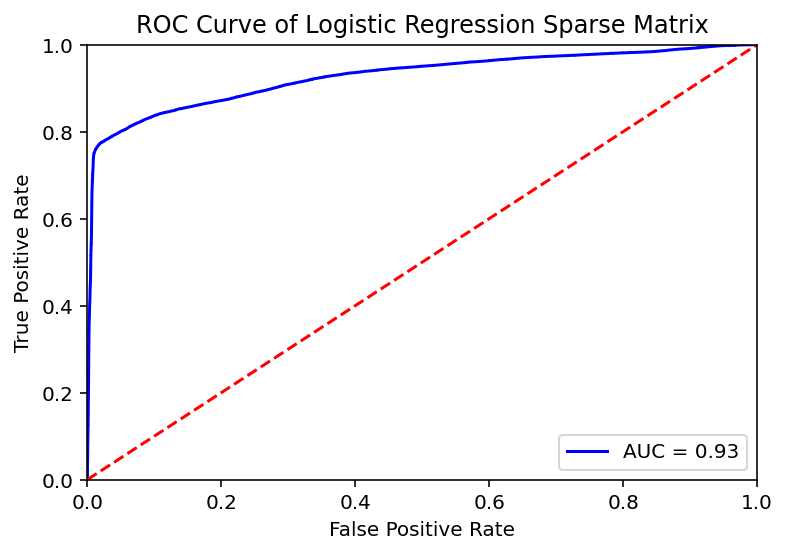

6000000
Model accuracy score: 0.8936
Training-set accuracy score: 0.8945
Confusion matrix

 [[683214  18172]
 [109503 389111]]

True Positives(TP) =  683214

True Negatives(TN) =  389111

False Positives(FP) =  18172

False Negatives(FN) =  109503


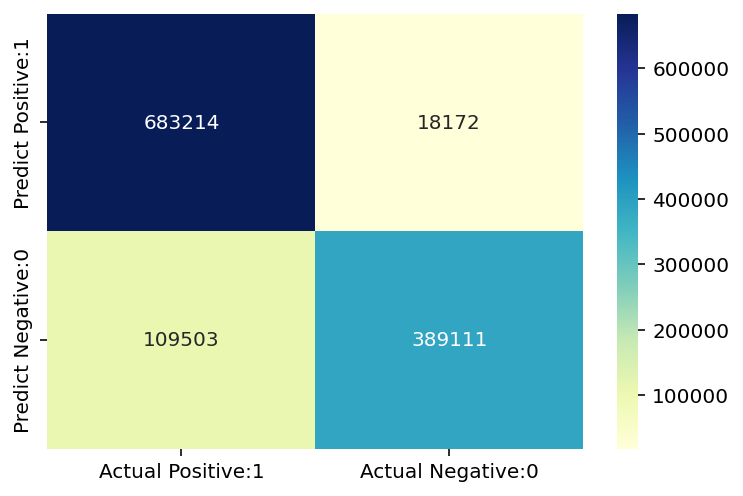

              precision    recall  f1-score   support

           0       0.86      0.97      0.91    701386
           1       0.96      0.78      0.86    498614

    accuracy                           0.89   1200000
   macro avg       0.91      0.88      0.89   1200000
weighted avg       0.90      0.89      0.89   1200000

Classification accuracy : 0.8936


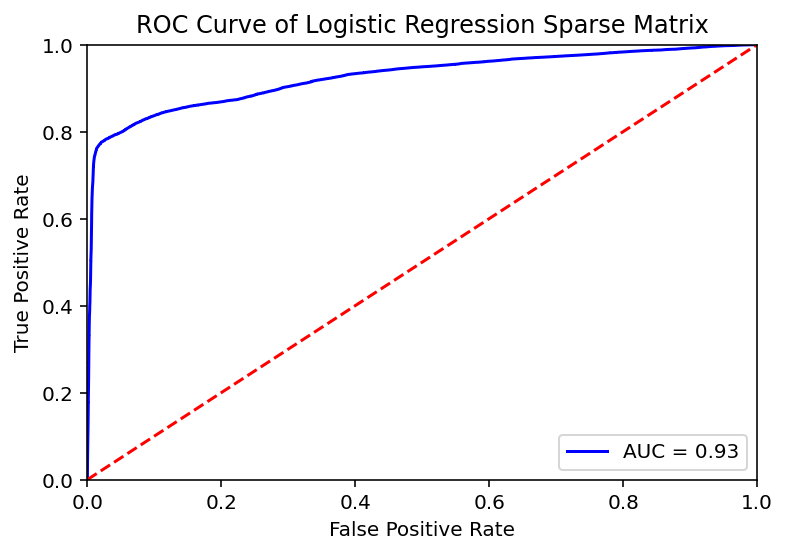

In [ ]:
from scipy.sparse import hstack
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD

for i in range(len(model_datas)):  
  df = model_datas[i]
  
  X = df.drop(['is_attributed','Year','Month','minute'], axis=1)
  y = df['is_attributed']
  print(len(X))

  
  columns = X.columns

  X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
  X = hstack((X,np.array(df['ip'])[:,None]))
  
  lf = TruncatedSVD(10)
  X = lf.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = (scaler.fit_transform(X_train))
  X_test = (scaler.transform(X_test))
  
  y_pred , y_pred_probab ,log = lgstc_Reg_sparse(X_train , X_test , y_train, y_test)
  evalute_mode(y_pred , y_pred_probab ,y_test)


  


In [ ]:
l = resample_data(df1,1000000)

In [ ]:
l.is_attributed.value_counts()

0    960490
1     39510
Name: is_attributed, dtype: int64

1000000
Model accuracy score: 0.9435
Training-set accuracy score: 0.9437
Confusion matrix

 [[186663   5393]
 [  5903   2041]]

True Positives(TP) =  186663

True Negatives(TN) =  2041

False Positives(FP) =  5393

False Negatives(FN) =  5903


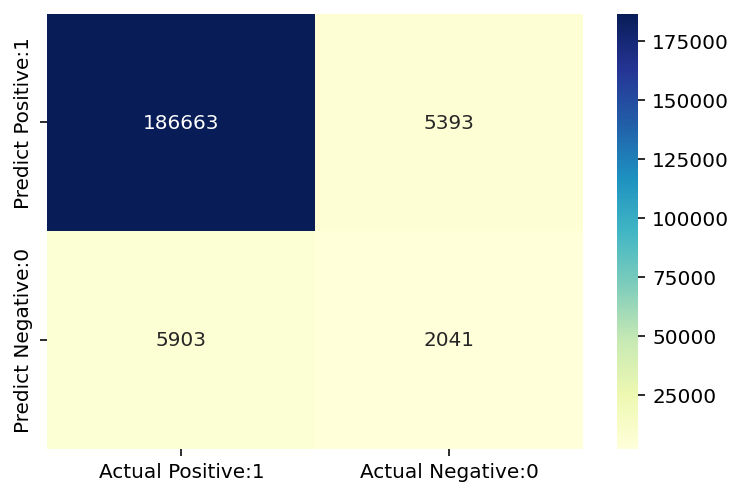

              precision    recall  f1-score   support

           0       0.97      0.97      0.97    192056
           1       0.27      0.26      0.27      7944

    accuracy                           0.94    200000
   macro avg       0.62      0.61      0.62    200000
weighted avg       0.94      0.94      0.94    200000

Classification accuracy : 0.9435


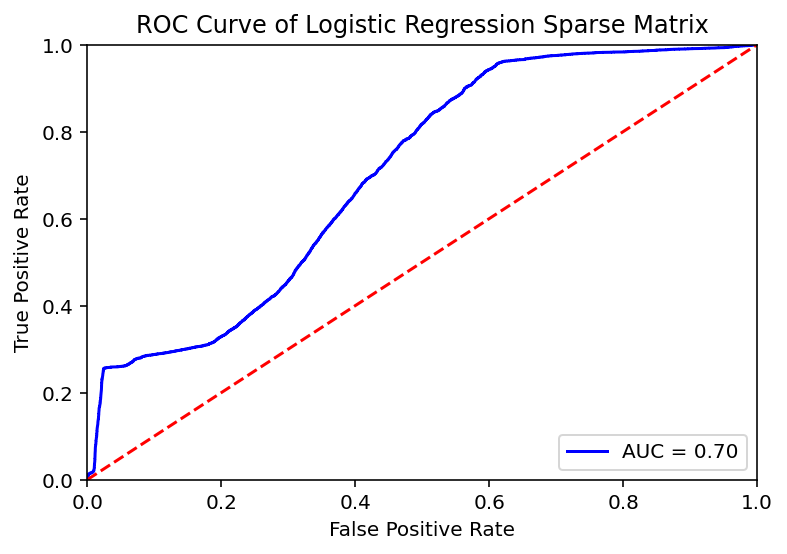

In [ ]:
# df = model_datas[i]
  
X = l.drop(['is_attributed','Year','Month','minute'], axis=1)
y = l['is_attributed']
print(len(X))

  
columns = X.columns

X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
X = hstack((X,np.array(l['ip'])[:,None]))
  
lf = TruncatedSVD(10)
X = lf.fit_transform(X)

X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
scaler = StandardScaler()
X_train = (scaler.fit_transform(X_train))
X_test = (scaler.transform(X_test))
  
y_pred , y_pred_probab ,log = lgstc_Reg_sparse(X_train , X_test , y_train, y_test)
evalute_mode(y_pred , y_pred_probab ,y_test)

In [ ]:
df

,ip,app,device,os,channel,Year,Month,Day,Hour,minute,is_attributed
9670917,99,19,0,21,213,2017,11,7,2,14,1
1283742,15,23,1,13,153,2017,11,8,7,26,0
1664297,7709,12,2,13,178,2017,11,8,13,42,0
9456245,2,5,1,43,113,2017,11,8,13,18,1
12467013,522,35,1,18,21,2017,11,8,4,23,1
...,...,...,...,...,...,...,...,...,...,...,...
8603048,53,35,1,14,21,2017,11,7,0,15,1
11937446,951,35,1,18,21,2017,11,7,0,19,1
10030548,167,8,1,13,145,2017,11,7,2,33,1
9966112,1903,35,1,14,21,2017,11,8,1,36,1


100000


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Model accuracy score: 0.8538
Training-set accuracy score: 0.8524
Confusion matrix

 [[9081 2692]
 [ 231 7996]]

True Positives(TP) =  9081

True Negatives(TN) =  7996

False Positives(FP) =  2692

False Negatives(FN) =  231


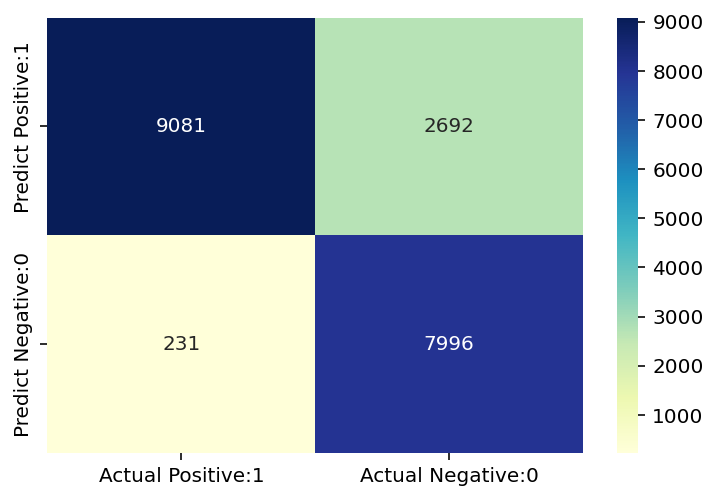

              precision    recall  f1-score   support

           0       0.98      0.77      0.86     11773
           1       0.75      0.97      0.85      8227

    accuracy                           0.85     20000
   macro avg       0.86      0.87      0.85     20000
weighted avg       0.88      0.85      0.85     20000

Classification accuracy : 0.8538


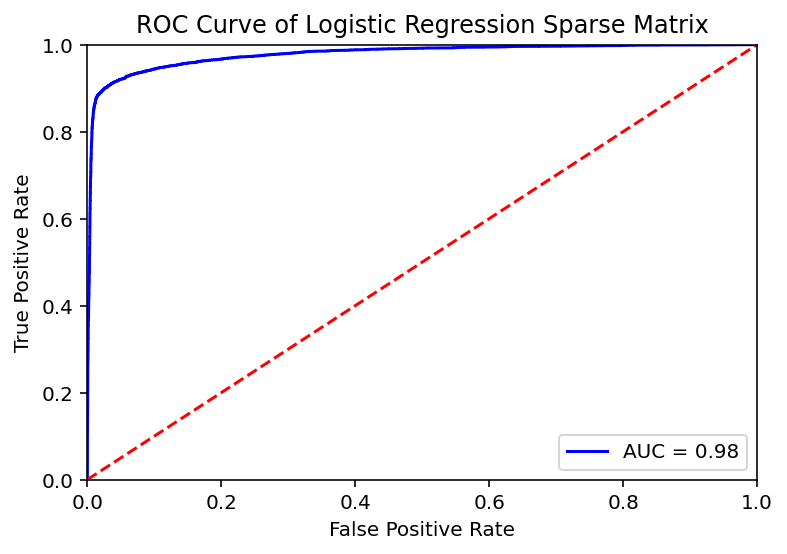

500000


KeyboardInterrupt: ignored

In [ ]:
from scipy.sparse import hstack
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD

for i in range(len(model_datas)):  
  df = model_datas[i]
  
  X = df.drop(['is_attributed','Year','Month','minute'], axis=1)
  y = df['is_attributed']
  print(len(X))

  
  columns = X.columns

  X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
  X = hstack((X,np.array(df['ip'])[:,None]))
  
  lf = TruncatedSVD(260)
  X = lf.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = (scaler.fit_transform(X_train))
  X_test = (scaler.transform(X_test))
  
  y_pred , y_pred_probab ,log = lgstc_Reg_sparse(X_train , X_test , y_train, y_test)
  evalute_mode(y_pred , y_pred_probab ,y_test)

In [ ]:
y_pred_test = clf.predict(X_test)

y_pred_test

array([1, 1, 0, ..., 0, 1, 0], dtype=uint16)

In [ ]:
clf.predict_proba(X_test)[:,0]

array([0.36164063, 0.01179764, 0.94943153, ..., 0.88888842, 0.00941589,
       0.97063795])

In [ ]:
clf.predict_proba(X_test)[:,1]

array([0.63835937, 0.98820236, 0.05056847, ..., 0.11111158, 0.99058411,
       0.02936205])

In [ ]:
from sklearn.metrics import accuracy_score

print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test, y_pred_test)))

Model accuracy score: 0.8537


Confusion matrix

 [[60994  5618]
 [ 9017 24371]]

True Positives(TP) =  60994

True Negatives(TN) =  24371

False Positives(FP) =  5618

False Negatives(FN) =  9017


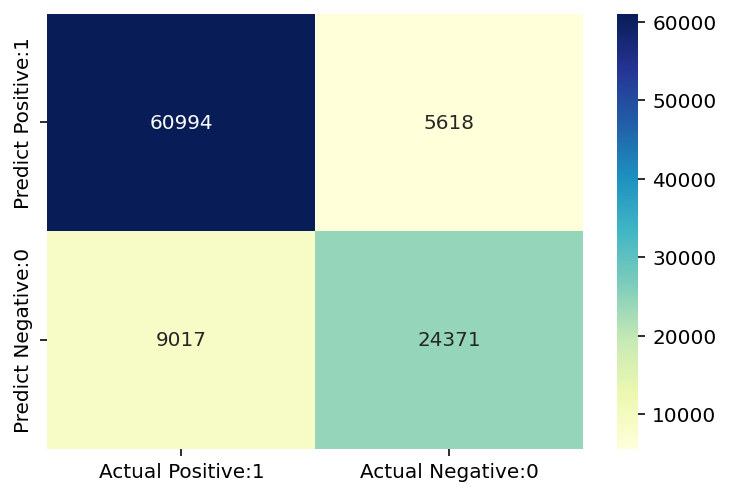

In [ ]:

from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_test, y_pred_test)

print('Confusion matrix\n\n', cm)

print('\nTrue Positives(TP) = ', cm[0,0])

print('\nTrue Negatives(TN) = ', cm[1,1])

print('\nFalse Positives(FP) = ', cm[0,1])

print('\nFalse Negatives(FN) = ', cm[1,0])

#visualize confusion matrix with seaborn heatmap

cm_matrix = pd.DataFrame(data=cm, columns=['Actual Positive:1', 'Actual Negative:0'], 
                                 index=['Predict Positive:1', 'Predict Negative:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

In [ ]:
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

In [ ]:
# print classification accuracy

classification_accuracy = (TP + TN) / float(TP + TN + FP + FN)

print('Classification accuracy : {0:0.4f}'.format(classification_accuracy))

Classification accuracy : 0.8537


In [ ]:
# print classification error

classification_error = (FP + FN) / float(TP + TN + FP + FN)

print('Classification error : {0:0.4f}'.format(classification_error))

Classification error : 0.1464


In [ ]:
# print precision score

precision = TP / float(TP + FP)


print('Precision : {0:0.4f}'.format(precision))

Precision : 0.9157


In [ ]:
recall = TP / float(TP + FN)

print('Recall or Sensitivity : {0:0.4f}'.format(recall))

Recall or Sensitivity : 0.8712


In [ ]:
# print the first 10 predicted probabilities of two classes- 0 and 1

y_pred_prob = clf.predict_proba(X_test)[0:10]

y_pred_prob

array([[0.36164063, 0.63835937],
       [0.01179764, 0.98820236],
       [0.94943153, 0.05056847],
       [0.00786689, 0.99213311],
       [0.96149929, 0.03850071],
       [0.49601817, 0.50398183],
       [0.97662527, 0.02337473],
       [0.83796485, 0.16203515],
       [0.76334094, 0.23665906],
       [0.99336012, 0.00663988]])

In [ ]:
# store the probabilities in dataframe

y_pred_prob_df = pd.DataFrame(data=y_pred_prob, columns=['Prob of - No rain tomorrow (0)', 'Prob of - Rain tomorrow (1)'])

y_pred_prob_df

,Prob of - No rain tomorrow (0),Prob of - Rain tomorrow (1)
0,0.361641,0.638359
1,0.011798,0.988202
2,0.949432,0.050568
3,0.007867,0.992133
4,0.961499,0.038501
5,0.496018,0.503982
6,0.976625,0.023375
7,0.837965,0.162035
8,0.763341,0.236659
9,0.993360,0.006640


In [ ]:
# print the first 10 predicted probabilities for class 1 - Probability of rain

clf.predict_proba(X_test)[0:10, 1]

array([0.63835937, 0.98820236, 0.05056847, 0.99213311, 0.03850071,
       0.50398183, 0.02337473, 0.16203515, 0.23665906, 0.00663988])

In [ ]:
# store the predicted probabilities for class 1 - Probability of rain

y_pred1 = clf.predict_proba(X_test)[:, 1]

Text(0, 0.5, 'Frequency')

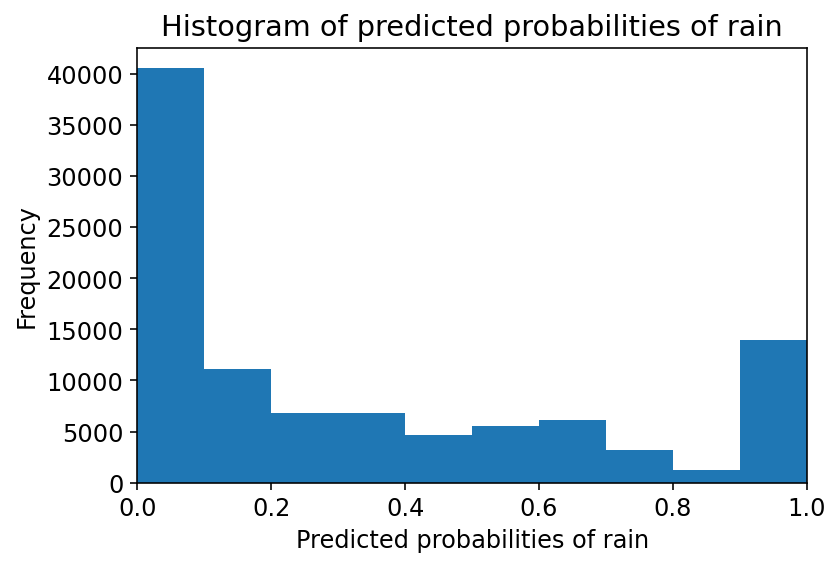

In [ ]:
# plot histogram of predicted probabilities


# adjust the font size 
plt.rcParams['font.size'] = 12


# plot histogram with 10 bins
plt.hist(y_pred1, bins = 10)


# set the title of predicted probabilities
plt.title('Histogram of predicted probabilities of rain')


# set the x-axis limit
plt.xlim(0,1)


# set the title
plt.xlabel('Predicted probabilities of rain')
plt.ylabel('Frequency')

In [ ]:
np.array(train[0:10000])[:,0:2]

array([[1820,   15],
       [6811,    2],
       [ 316,    9],
       ...,
       [ 284,    3],
       [ 182,   64],
       [ 126,   12]])

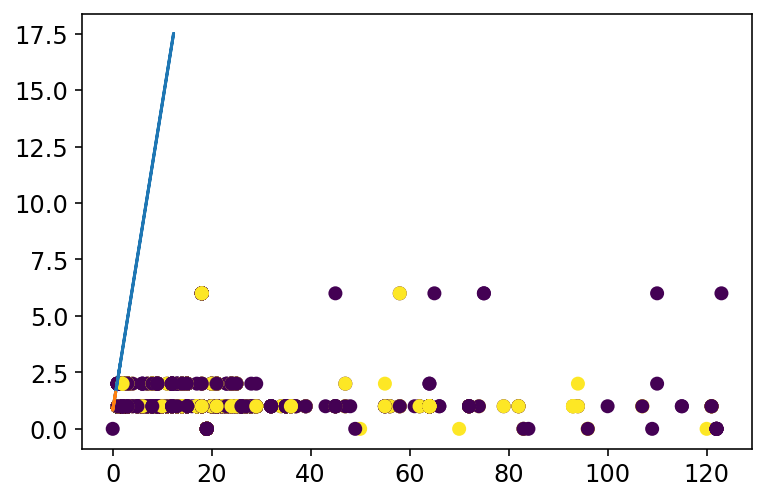

In [ ]:
a=1
b=3
points_x=[np.array(train[0:10000])[:,a:b]/10. for x in range(-50,+50)]

line_bias = clf.intercept_
line_w = clf.coef_.T
points_y=[(line_w[0]*x+line_bias)/(-1*line_w[1]) for x in points_x]
plt.plot(points_x[1], points_y[0])

plt.scatter(np.array(train[0:10000])[:,a:b-1],np.array(train[0:10000])[:,a+1:b],c=y[0:10000])

plt.show()

In [ ]:
x_min, x_max = Xpca[0:10, 0].min() - 0.5, Xpca[0:10:, 0].max() + 0.5
y_min, y_max = Xpca[0:10:, 1].min() - 0.5, Xpca[0:10:, 1].max() + 0.5


In [ ]:
print(x_min)
print(x_max)
print(y_min)
print(y_max)


4.50000477525115
11644.500030018597
-1.8126163768692432
0.42767030024918185


In [ ]:
h = 0.02  # step size in the mesh
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
Z = logreg.predict(np.c_[xx.ravel(), yy.ravel()])

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.figure(1, figsize=(4, 3))
plt.pcolormesh(xx, yy, Z, cmap=plt.cm.Paired)

# Plot also the training points
plt.scatter(X[:, 0], X[:, 1], c=Y, edgecolors="k", cmap=plt.cm.Paired)
plt.xlabel("Sepal length")
plt.ylabel("Sepal width")

plt.xlim(xx.min(), xx.max())
plt.ylim(yy.min(), yy.max())
plt.xticks(())
plt.yticks(())

plt.show()

In [ ]:
clf.predict_proba

<bound method LogisticRegression.predict_proba of LogisticRegressionCV(cv=5, max_iter=10, random_state=0)>

In [ ]:
xx, yy = np.mgrid[-5:100:.01, -5:5:.01]
grid = np.c_[xx.ravel(), yy.ravel()]
probs = clf.predict_proba(grid)[:, 1].reshape(xx.shape)

f, ax = plt.subplots(figsize=(8, 6))
contour = ax.contourf(xx, yy, probs, 25, cmap="RdBu",
                      vmin=0, vmax=1)
ax_c = f.colorbar(contour)
ax_c.set_label("$P(y = 1)$")
ax_c.set_ticks([0, .25, .5, .75, 1])
q = 1000
ax.scatter(np.array(train[0:1000])[:,a:b-1],np.array(train[0:1000])[:,a+1:b], c=y[0:q], s=50,
           cmap="RdBu", vmin=-.2, vmax=1.2,
           edgecolor="white", linewidth=1)

ax.set(aspect="equal",
       xlim=(-5, 100), ylim=(-5, 5),
       xlabel="$X_1$", ylabel="$X_2$")

ValueError: ignored

In [ ]:
X

<500000x706 sparse matrix of type '<class 'numpy.float64'>'
	with 3000000 stored elements in COOrdinate format>

# Decision tree

In [ ]:
from sklearn.tree import DecisionTreeClassifier

def Decision_tree_model(X_train, X_test, y_train, y_test):
  clf_gini = DecisionTreeClassifier(criterion='entropy', max_depth=20, random_state=0)
  # clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=20, random_state=0)
  clf_gini.fit(X_train, y_train)
  y_pred=clf_gini.predict(X_test)
  y_pred_probab = clf_gini.predict_proba(X_test)
  print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test, y_pred)))
  y_pred_train = clf_gini.predict(X_train)
  print('Training-set accuracy score: {0:0.4f}'. format(accuracy_score(y_train, y_pred_train)))
  return y_pred , y_pred_probab

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_curve
from sklearn.metrics import auc

def evalute_model_Decision_tree(y_pred , y_pred_probab ,y_test):

  cm = confusion_matrix(y_test, y_pred)
  TP = cm[0,0]
  TN = cm[1,1]
  FP = cm[0,1]
  FN = cm[1,0]
  print('Confusion matrix\n\n', cm)
  print('\nTrue Positives(TP) = ', cm[0,0])
  print('\nTrue Negatives(TN) = ', cm[1,1])
  print('\nFalse Positives(FP) = ', cm[0,1])
  print('\nFalse Negatives(FN) = ', cm[1,0])
  print("========================================================================")

  plt.figure(figsize=(6,4))
  cm_matrix = pd.DataFrame(data=cm, columns=['Actual Positive:1', 'Actual Negative:0'], 
                                  index=['Predict Positive:1', 'Predict Negative:0'])
  sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')
  plt.show()

  print("========================================================================")

  print(classification_report(y_test, y_pred))
  print("========================================================================")

  classification_accuracy = (TP + TN) / float(TP + TN + FP + FN)
  print('Classification accuracy : {0:0.4f}'.format(classification_accuracy))

  print("========================================================================")

  fpr, tpr, threshold = roc_curve(y_test, y_pred_probab[:,1])
  roc_auc = auc(fpr, tpr)

  plt.title('Receiver Operating Characteristic')
  plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
  plt.legend(loc = 'lower right')
  plt.plot([0, 1], [0, 1],'r--')
  plt.xlim([0, 1])
  plt.ylim([0, 1])
  plt.ylabel('True Positive Rate')
  plt.xlabel('False Positive Rate')
  plt.title('ROC Curve of Decision_tree')
  plt.show()

  print("========================================================================")

  plt.rcParams['font.size'] = 12
  plt.hist(y_pred_probab[:,1], bins = 10)
  plt.title('Histogram of predicted probabilities of rain')
  plt.xlim(0,1)
  plt.xlabel('Predicted probabilities of rain')
  plt.ylabel('Frequency')
  print("____________________________________________________________________________")


10000
Model accuracy score: 0.8980
Training-set accuracy score: 0.9939
Confusion matrix

 [[1109  108]
 [  96  687]]

True Positives(TP) =  1109

True Negatives(TN) =  687

False Positives(FP) =  108

False Negatives(FN) =  96


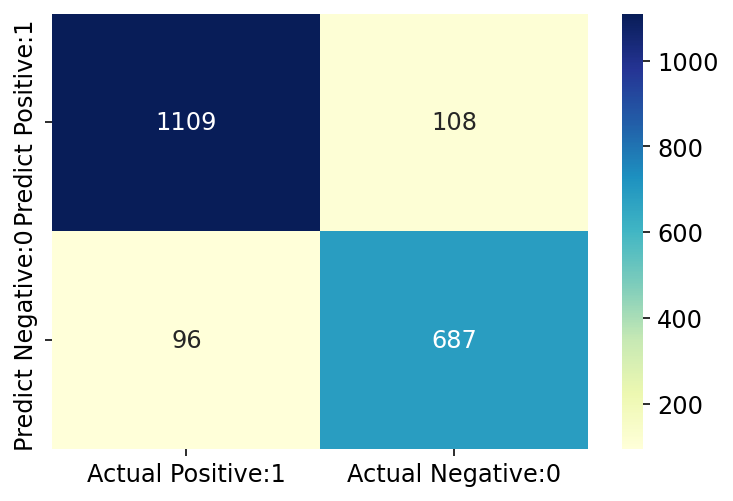

              precision    recall  f1-score   support

           0       0.92      0.91      0.92      1217
           1       0.86      0.88      0.87       783

    accuracy                           0.90      2000
   macro avg       0.89      0.89      0.89      2000
weighted avg       0.90      0.90      0.90      2000

Classification accuracy : 0.8980


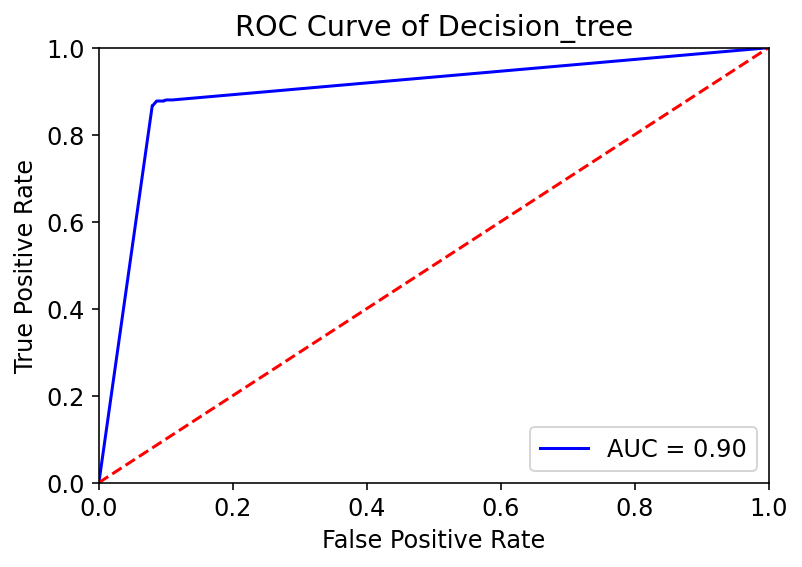

____________________________________________________________________________
50000
Model accuracy score: 0.9362
Training-set accuracy score: 0.9870
Confusion matrix

 [[5972  260]
 [ 378 3390]]

True Positives(TP) =  5972

True Negatives(TN) =  3390

False Positives(FP) =  260

False Negatives(FN) =  378


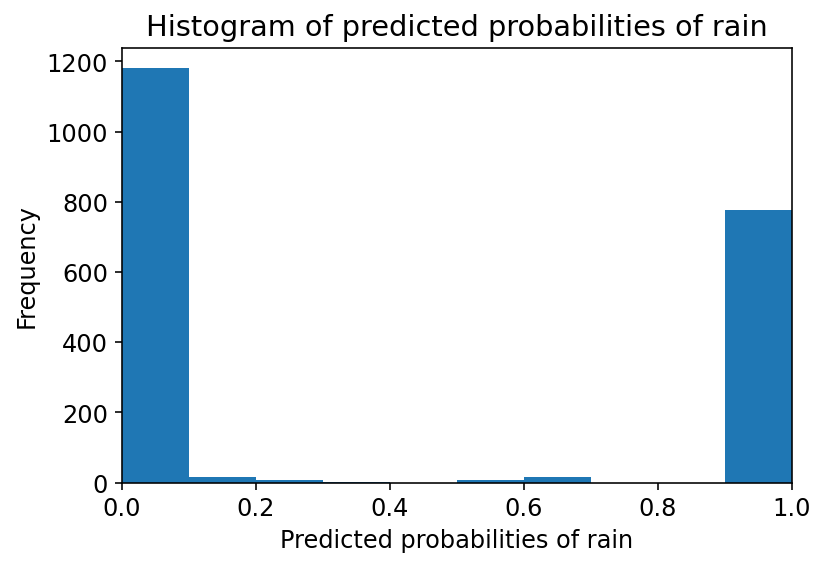

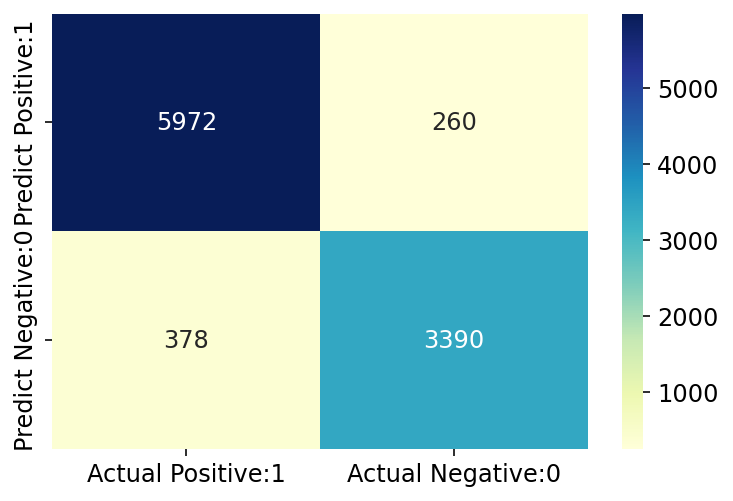

              precision    recall  f1-score   support

           0       0.94      0.96      0.95      6232
           1       0.93      0.90      0.91      3768

    accuracy                           0.94     10000
   macro avg       0.93      0.93      0.93     10000
weighted avg       0.94      0.94      0.94     10000

Classification accuracy : 0.9362


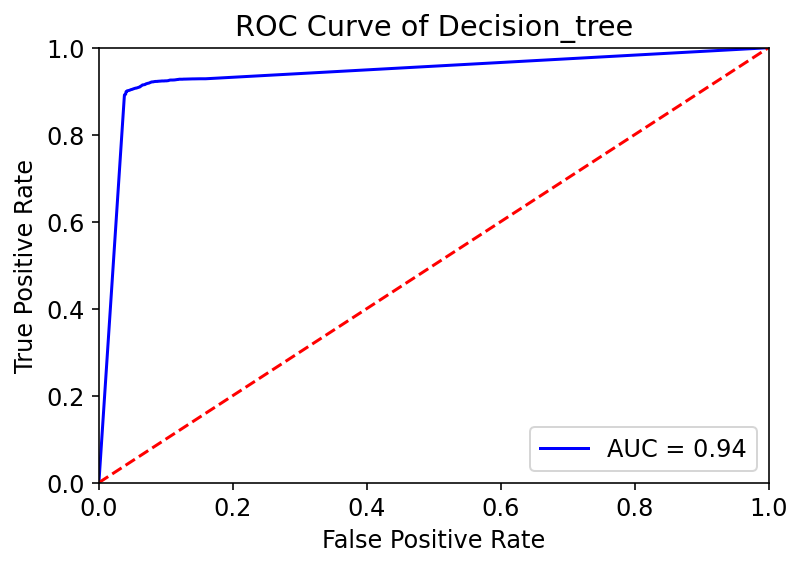

____________________________________________________________________________
100000
Model accuracy score: 0.9438
Training-set accuracy score: 0.9841
Confusion matrix

 [[12205   455]
 [  668  6672]]

True Positives(TP) =  12205

True Negatives(TN) =  6672

False Positives(FP) =  455

False Negatives(FN) =  668


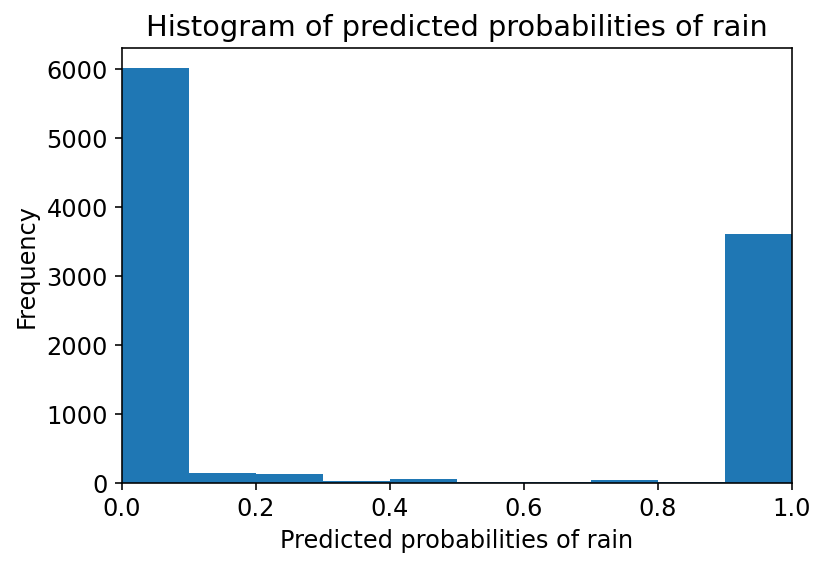

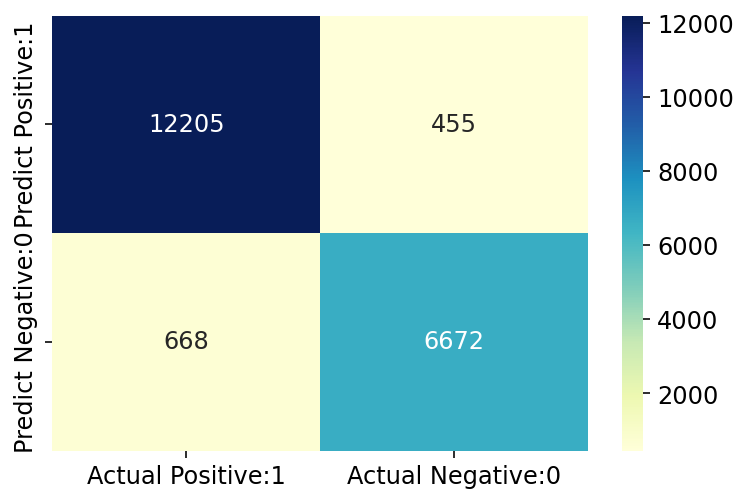

              precision    recall  f1-score   support

           0       0.95      0.96      0.96     12660
           1       0.94      0.91      0.92      7340

    accuracy                           0.94     20000
   macro avg       0.94      0.94      0.94     20000
weighted avg       0.94      0.94      0.94     20000

Classification accuracy : 0.9438


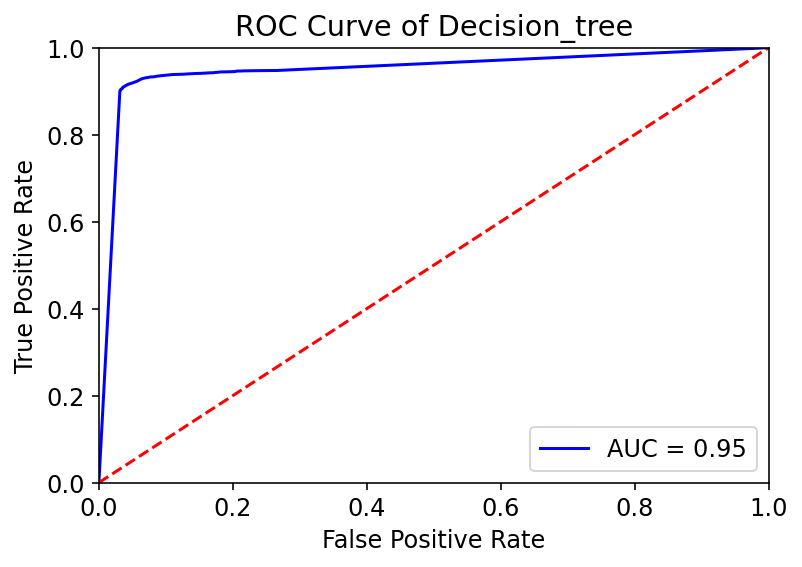

____________________________________________________________________________
150000
Model accuracy score: 0.9467
Training-set accuracy score: 0.9823
Confusion matrix

 [[18215   601]
 [  998 10186]]

True Positives(TP) =  18215

True Negatives(TN) =  10186

False Positives(FP) =  601

False Negatives(FN) =  998


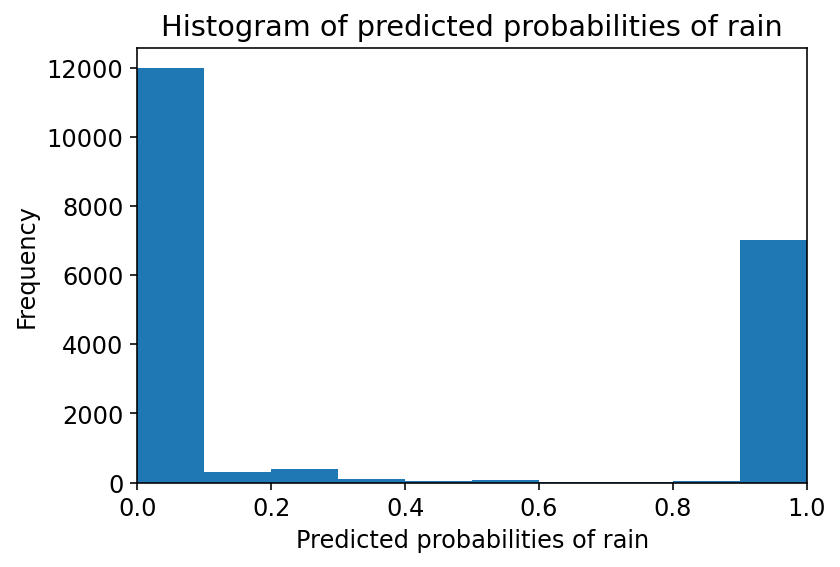

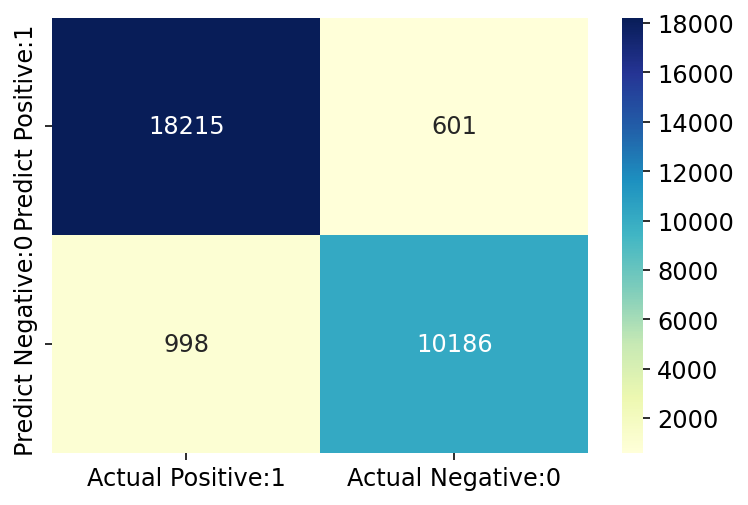

              precision    recall  f1-score   support

           0       0.95      0.97      0.96     18816
           1       0.94      0.91      0.93     11184

    accuracy                           0.95     30000
   macro avg       0.95      0.94      0.94     30000
weighted avg       0.95      0.95      0.95     30000

Classification accuracy : 0.9467


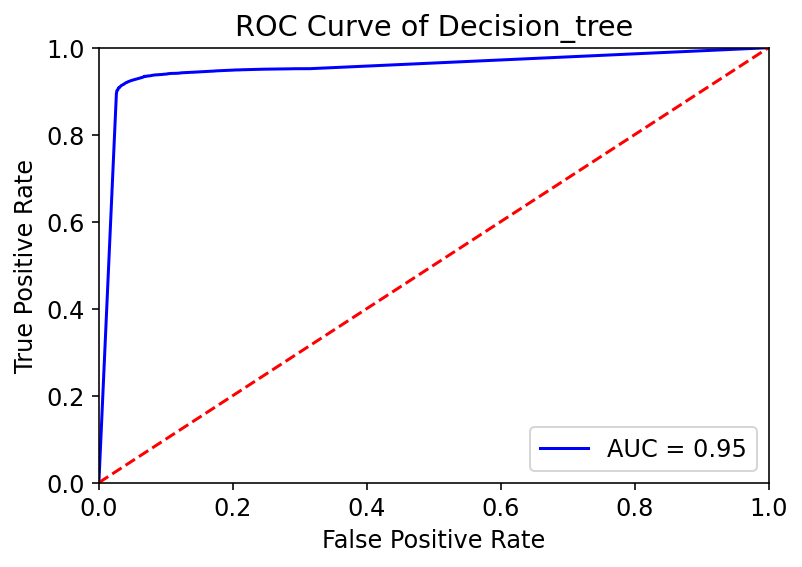

____________________________________________________________________________
200000
Model accuracy score: 0.9505
Training-set accuracy score: 0.9810
Confusion matrix

 [[24282   688]
 [ 1291 13739]]

True Positives(TP) =  24282

True Negatives(TN) =  13739

False Positives(FP) =  688

False Negatives(FN) =  1291


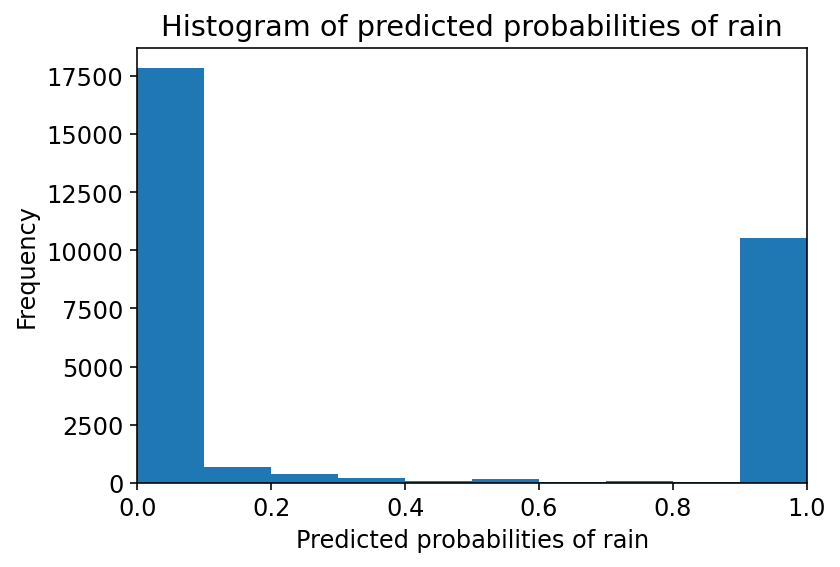

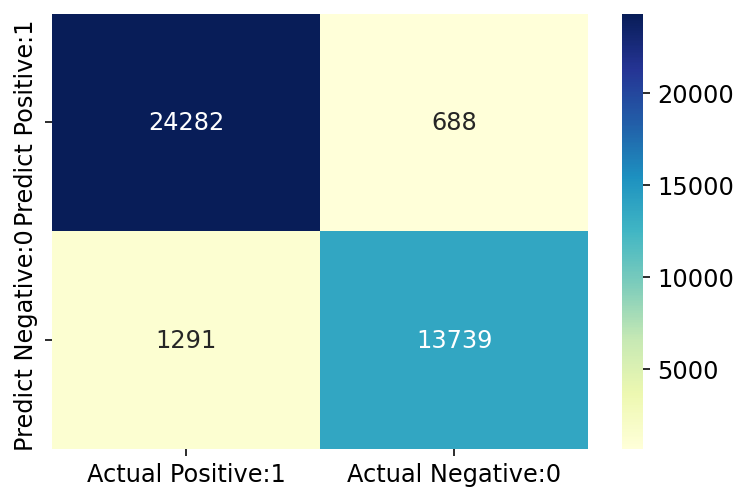

              precision    recall  f1-score   support

           0       0.95      0.97      0.96     24970
           1       0.95      0.91      0.93     15030

    accuracy                           0.95     40000
   macro avg       0.95      0.94      0.95     40000
weighted avg       0.95      0.95      0.95     40000

Classification accuracy : 0.9505


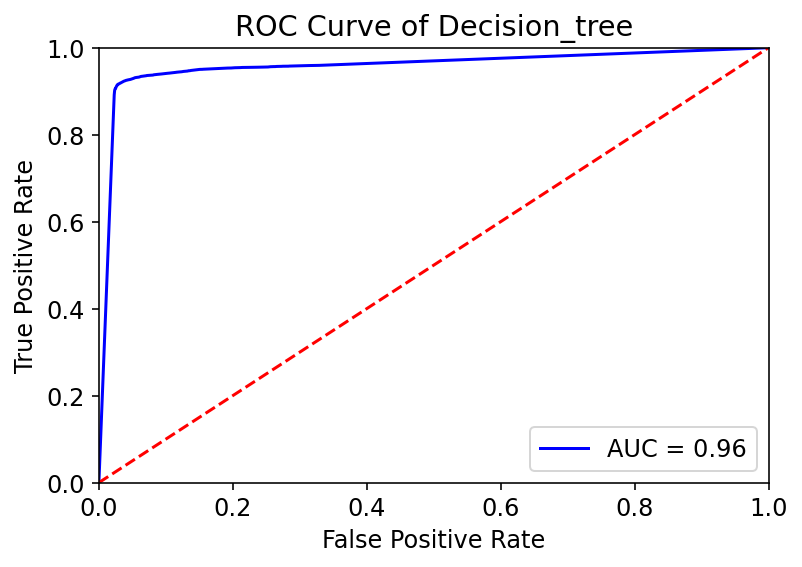

____________________________________________________________________________
6000000
Model accuracy score: 0.9657
Training-set accuracy score: 0.9700
Confusion matrix

 [[739017  10877]
 [ 30316 419790]]

True Positives(TP) =  739017

True Negatives(TN) =  419790

False Positives(FP) =  10877

False Negatives(FN) =  30316


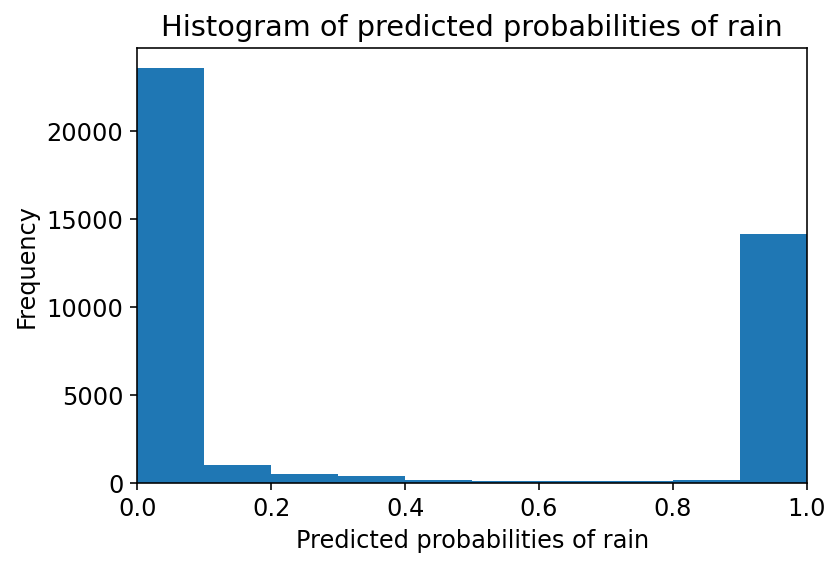

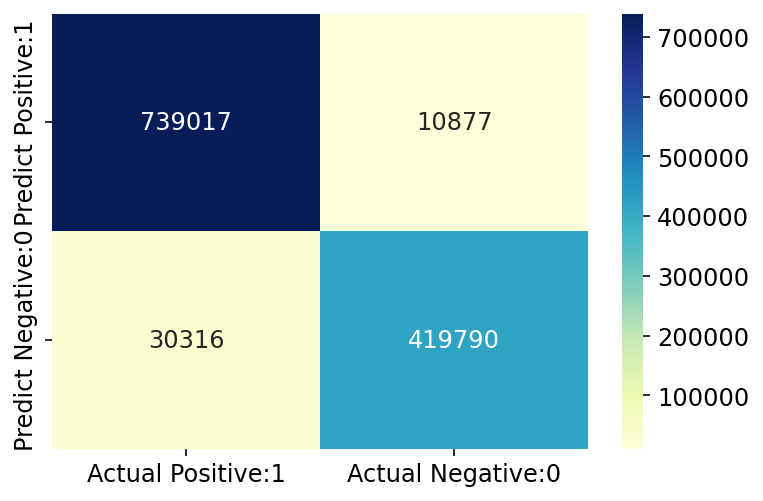

              precision    recall  f1-score   support

           0       0.96      0.99      0.97    749894
           1       0.97      0.93      0.95    450106

    accuracy                           0.97   1200000
   macro avg       0.97      0.96      0.96   1200000
weighted avg       0.97      0.97      0.97   1200000

Classification accuracy : 0.9657


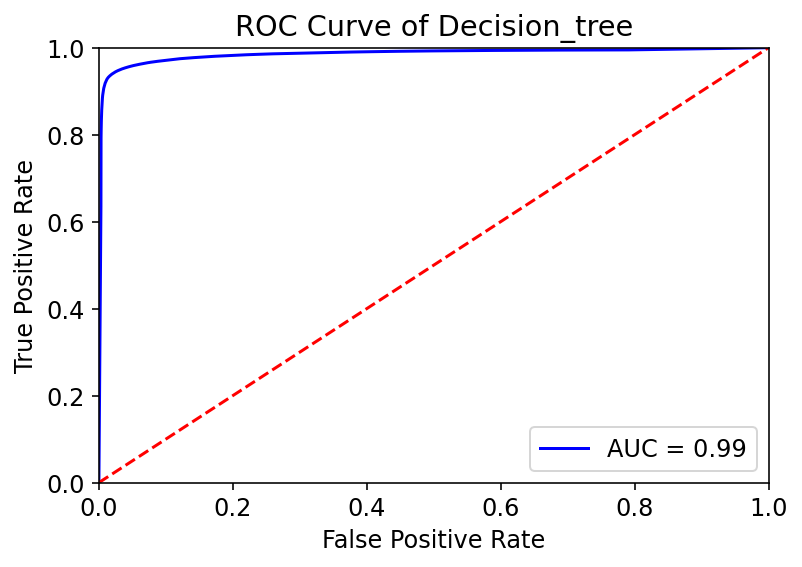

____________________________________________________________________________


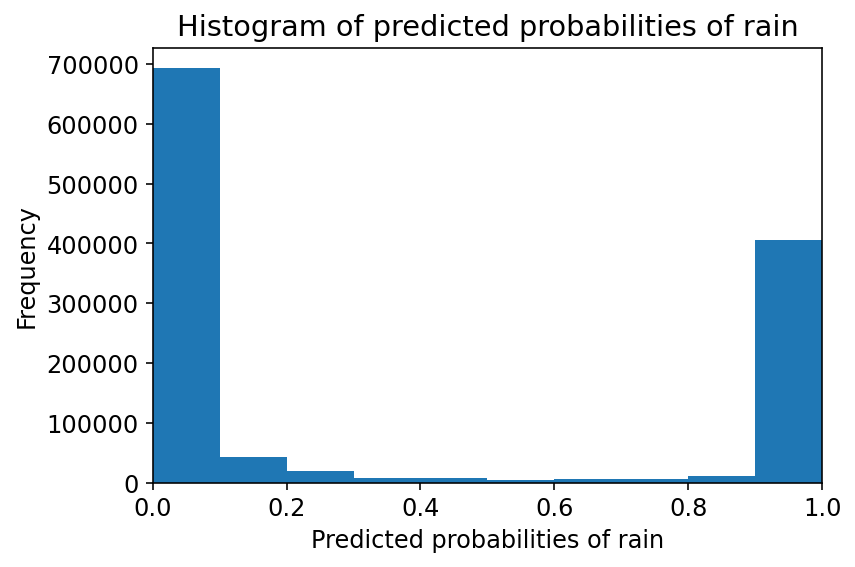

In [ ]:
from scipy.sparse import hstack
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD

for i in range(len(model_datas)):  
  df = model_datas[i]
  
  X = df.drop(['is_attributed','Year','Month','minute'], axis=1)
  y = df['is_attributed']
  print(len(X))

  
  columns = X.columns

  # X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
  # X = hstack((X,np.array(df['ip'])[:,None]))
  
  # lf = TruncatedSVD(10)
  # X = lf.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = (scaler.fit_transform(X_train))
  X_test = (scaler.transform(X_test))

  y_pred , y_pred_probab  = Decision_tree_model(X_train , X_test , y_train, y_test)
  evalute_model_Decision_tree(y_pred , y_pred_probab ,y_test)


10000
Model accuracy score: 0.8820
Training-set accuracy score: 0.9938
Confusion matrix

 [[1100  117]
 [ 119  664]]

True Positives(TP) =  1100

True Negatives(TN) =  664

False Positives(FP) =  117

False Negatives(FN) =  119


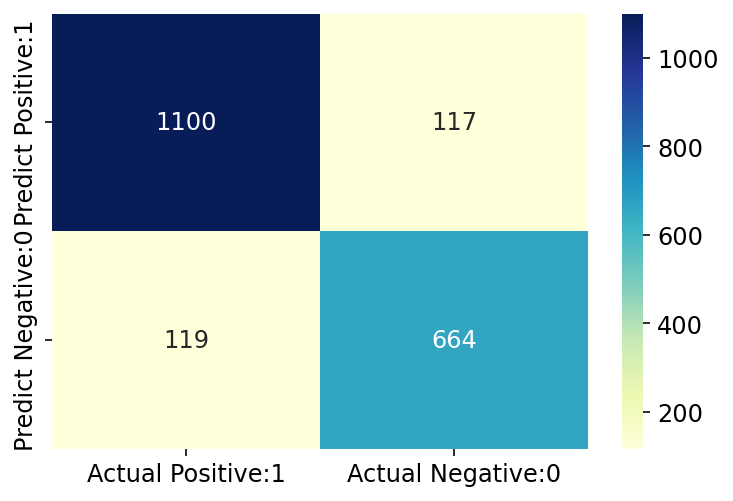

              precision    recall  f1-score   support

           0       0.90      0.90      0.90      1217
           1       0.85      0.85      0.85       783

    accuracy                           0.88      2000
   macro avg       0.88      0.88      0.88      2000
weighted avg       0.88      0.88      0.88      2000

Classification accuracy : 0.8820


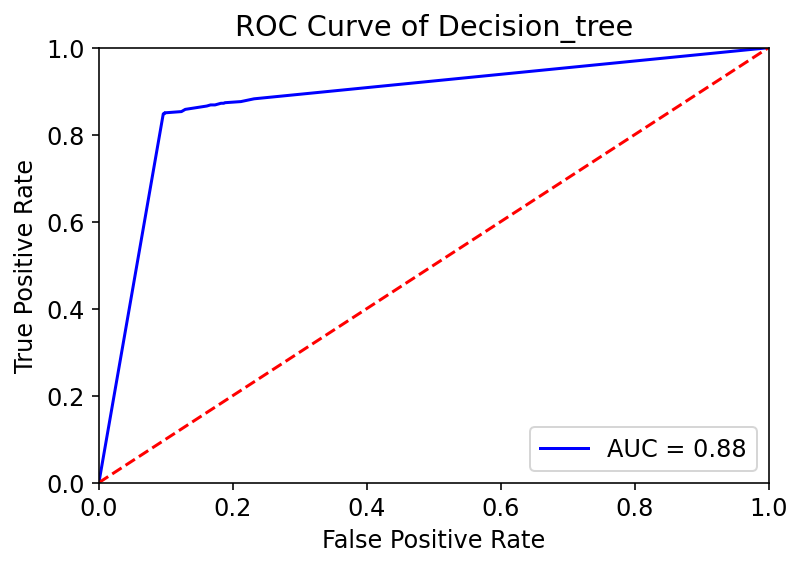

____________________________________________________________________________
50000
Model accuracy score: 0.9050
Training-set accuracy score: 0.9635
Confusion matrix

 [[5880  352]
 [ 598 3170]]

True Positives(TP) =  5880

True Negatives(TN) =  3170

False Positives(FP) =  352

False Negatives(FN) =  598


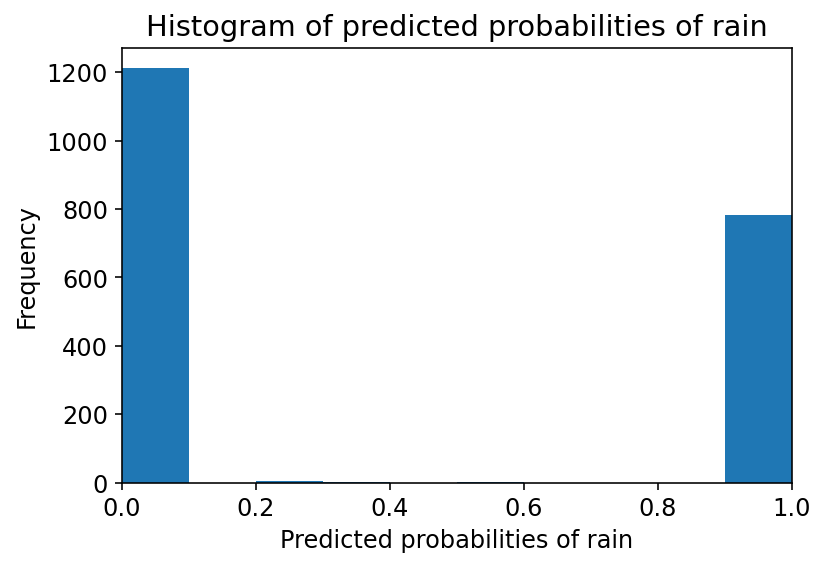

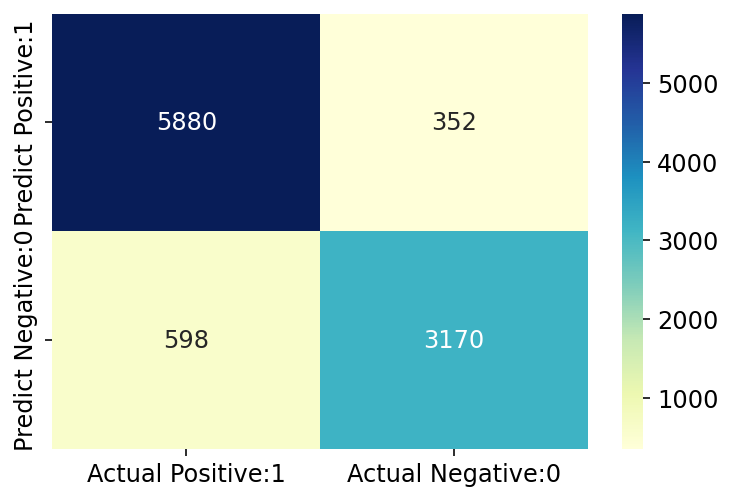

              precision    recall  f1-score   support

           0       0.91      0.94      0.93      6232
           1       0.90      0.84      0.87      3768

    accuracy                           0.91     10000
   macro avg       0.90      0.89      0.90     10000
weighted avg       0.90      0.91      0.90     10000

Classification accuracy : 0.9050


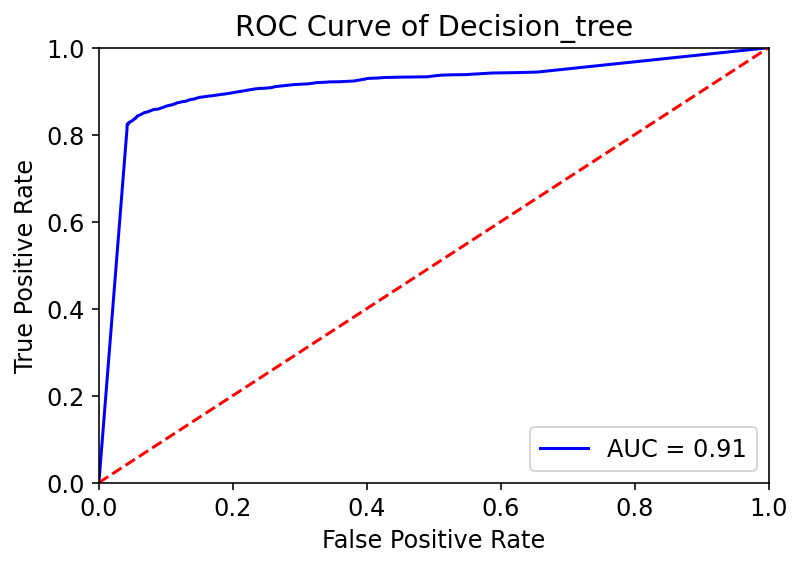

____________________________________________________________________________
100000
Model accuracy score: 0.9129
Training-set accuracy score: 0.9522
Confusion matrix

 [[12156   504]
 [ 1239  6101]]

True Positives(TP) =  12156

True Negatives(TN) =  6101

False Positives(FP) =  504

False Negatives(FN) =  1239


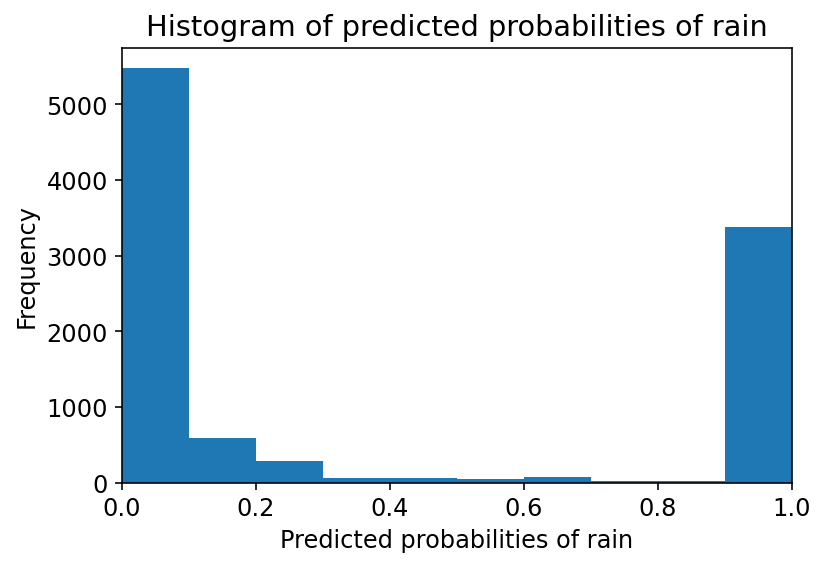

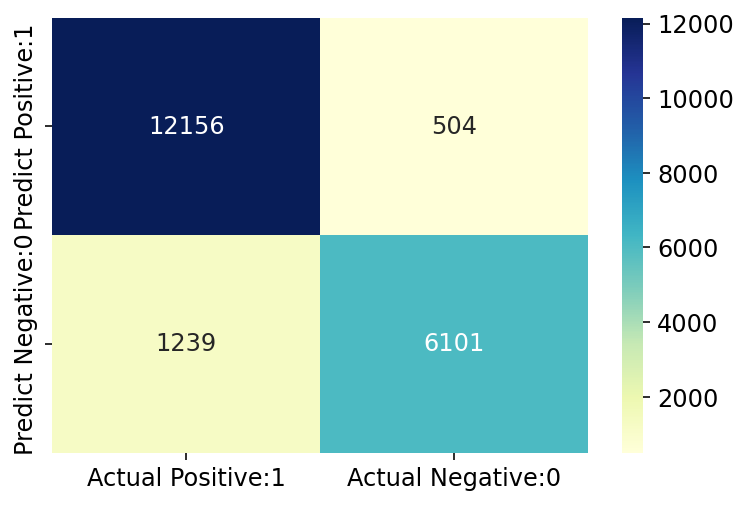

              precision    recall  f1-score   support

           0       0.91      0.96      0.93     12660
           1       0.92      0.83      0.88      7340

    accuracy                           0.91     20000
   macro avg       0.92      0.90      0.90     20000
weighted avg       0.91      0.91      0.91     20000

Classification accuracy : 0.9129


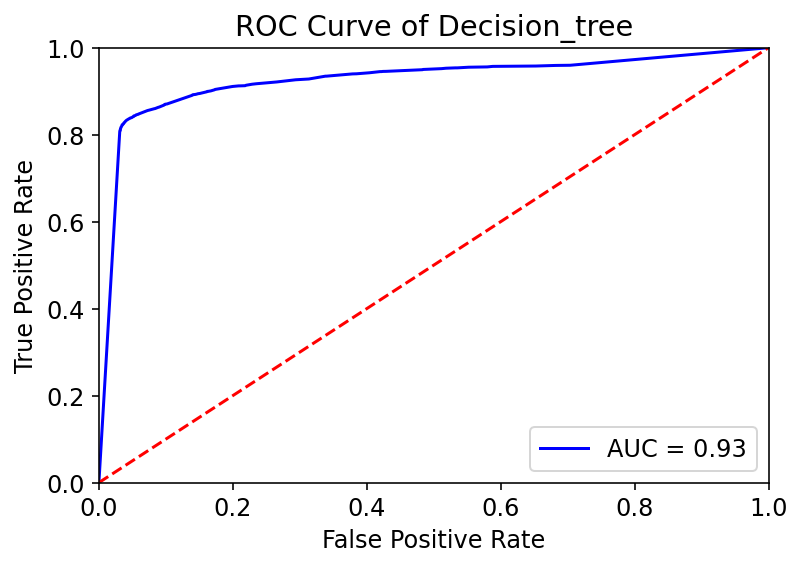

____________________________________________________________________________
150000
Model accuracy score: 0.9166
Training-set accuracy score: 0.9525
Confusion matrix

 [[18150   666]
 [ 1836  9348]]

True Positives(TP) =  18150

True Negatives(TN) =  9348

False Positives(FP) =  666

False Negatives(FN) =  1836


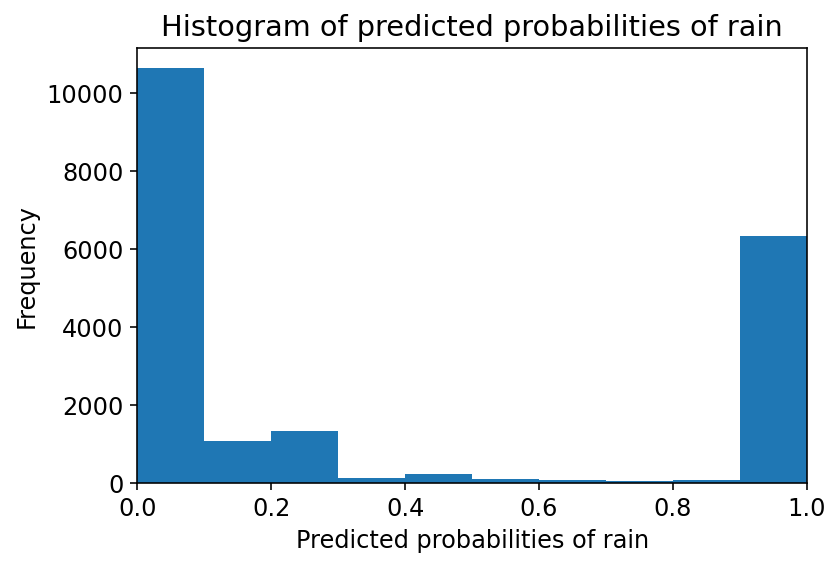

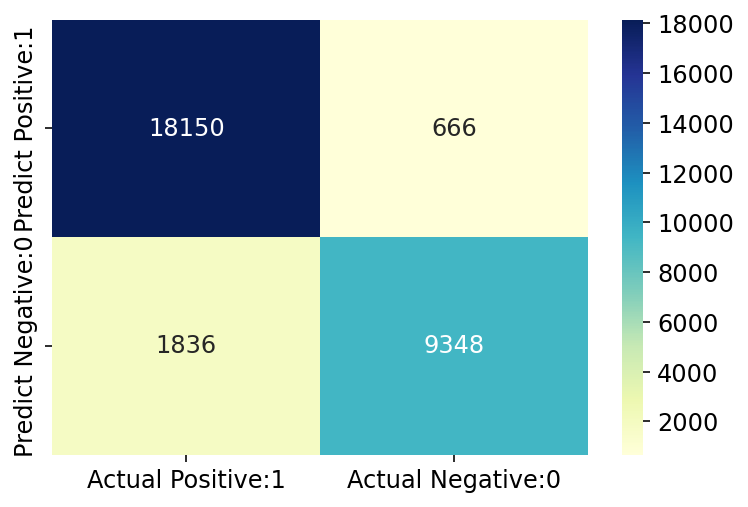

              precision    recall  f1-score   support

           0       0.91      0.96      0.94     18816
           1       0.93      0.84      0.88     11184

    accuracy                           0.92     30000
   macro avg       0.92      0.90      0.91     30000
weighted avg       0.92      0.92      0.92     30000

Classification accuracy : 0.9166


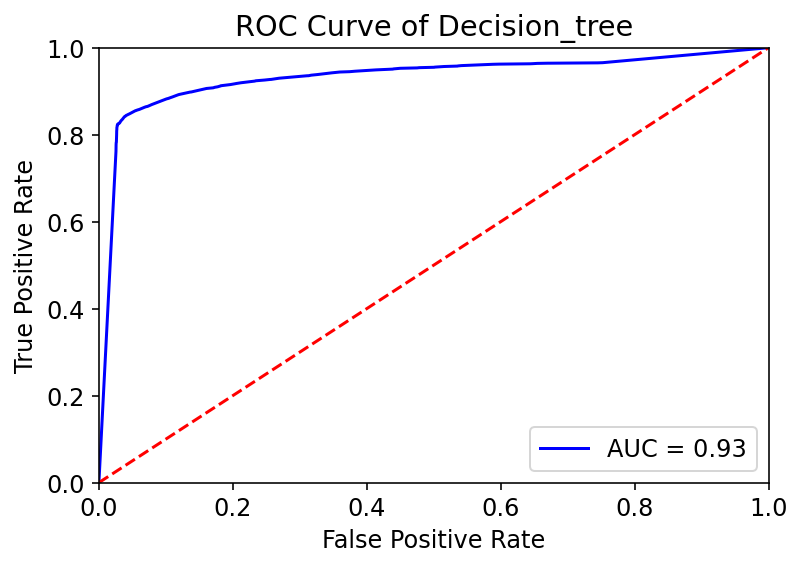

____________________________________________________________________________
200000
Model accuracy score: 0.9183
Training-set accuracy score: 0.9510
Confusion matrix

 [[24184   786]
 [ 2484 12546]]

True Positives(TP) =  24184

True Negatives(TN) =  12546

False Positives(FP) =  786

False Negatives(FN) =  2484


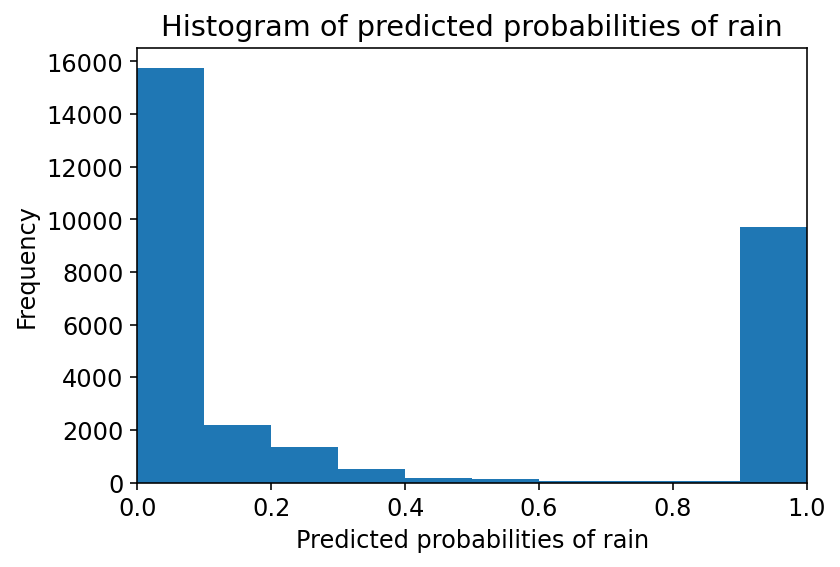

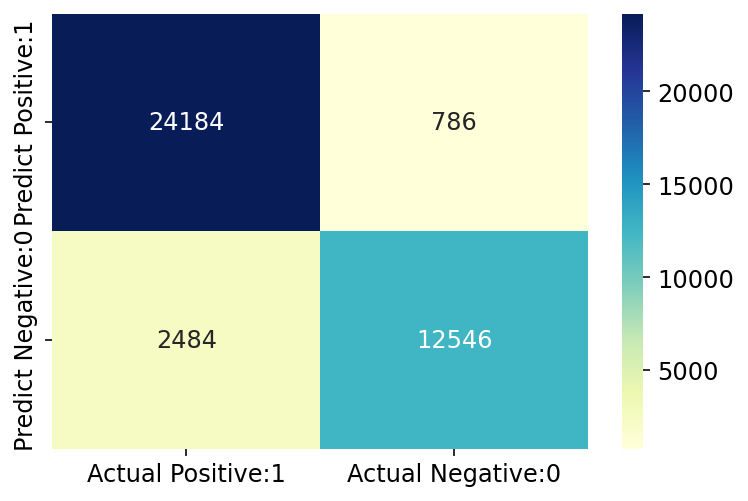

              precision    recall  f1-score   support

           0       0.91      0.97      0.94     24970
           1       0.94      0.83      0.88     15030

    accuracy                           0.92     40000
   macro avg       0.92      0.90      0.91     40000
weighted avg       0.92      0.92      0.92     40000

Classification accuracy : 0.9183


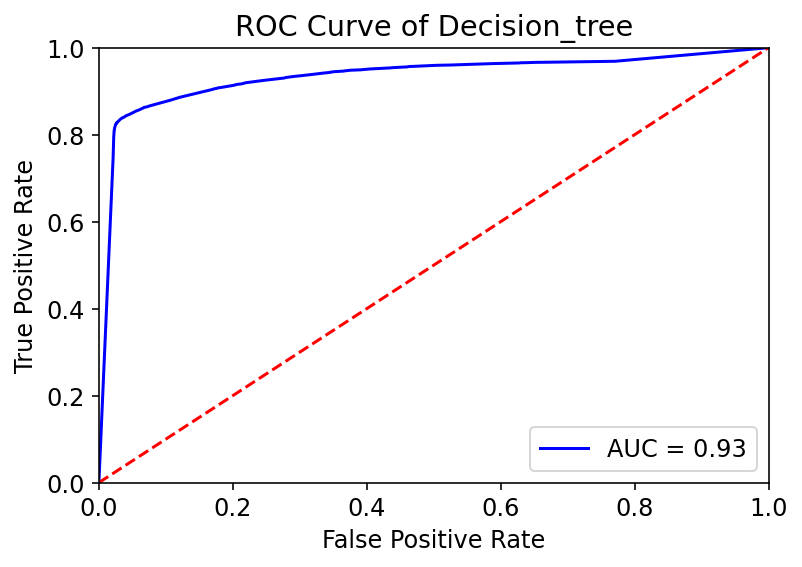

____________________________________________________________________________
6000000
Model accuracy score: 0.9342
Training-set accuracy score: 0.9400
Confusion matrix

 [[735349  14545]
 [ 64431 385675]]

True Positives(TP) =  735349

True Negatives(TN) =  385675

False Positives(FP) =  14545

False Negatives(FN) =  64431


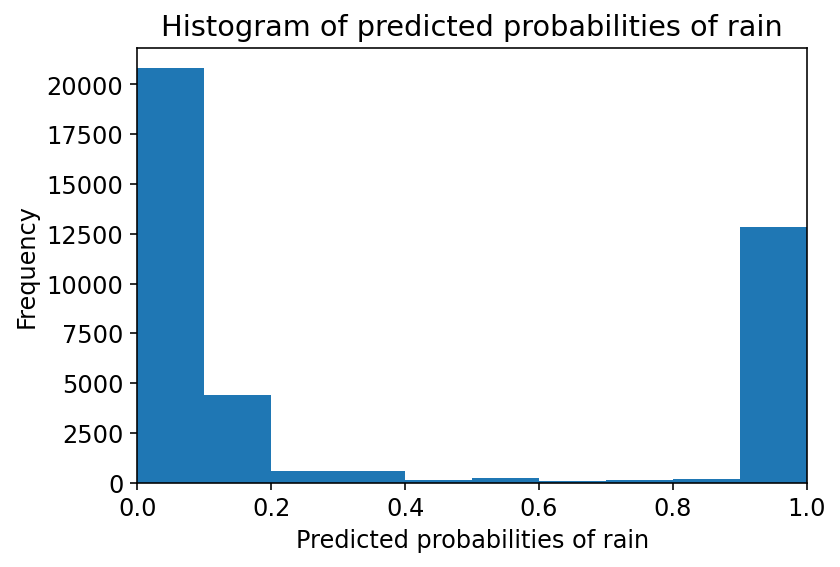

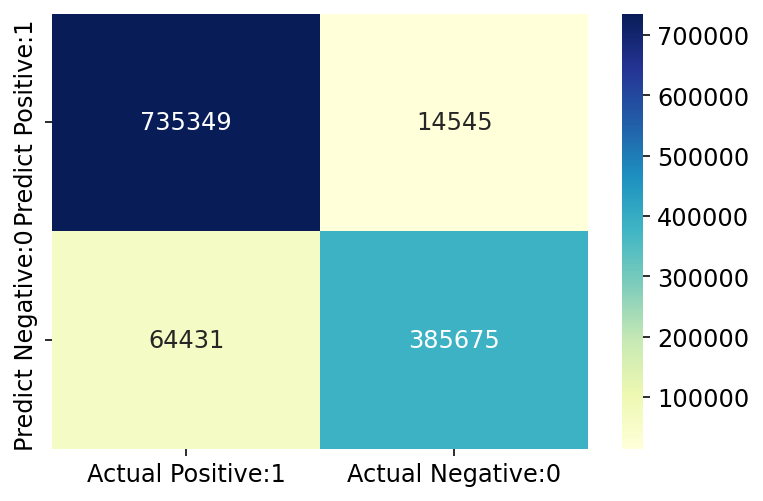

              precision    recall  f1-score   support

           0       0.92      0.98      0.95    749894
           1       0.96      0.86      0.91    450106

    accuracy                           0.93   1200000
   macro avg       0.94      0.92      0.93   1200000
weighted avg       0.94      0.93      0.93   1200000

Classification accuracy : 0.9342


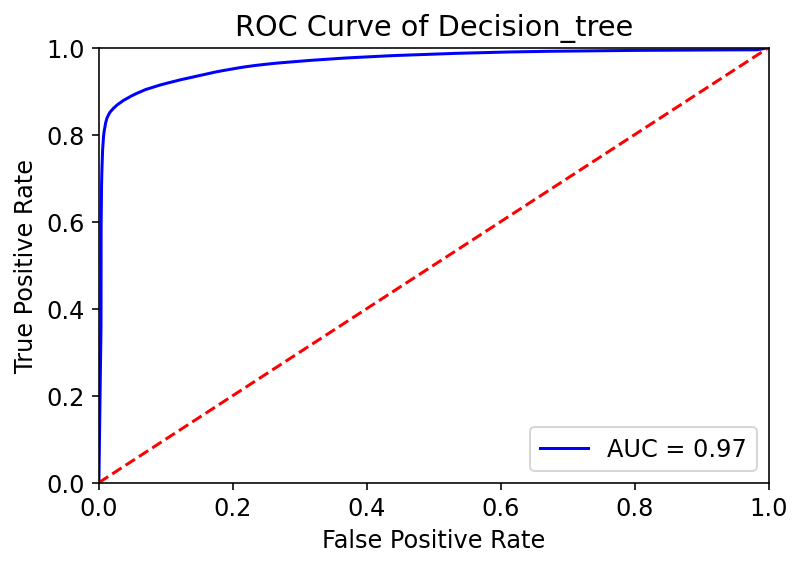

____________________________________________________________________________


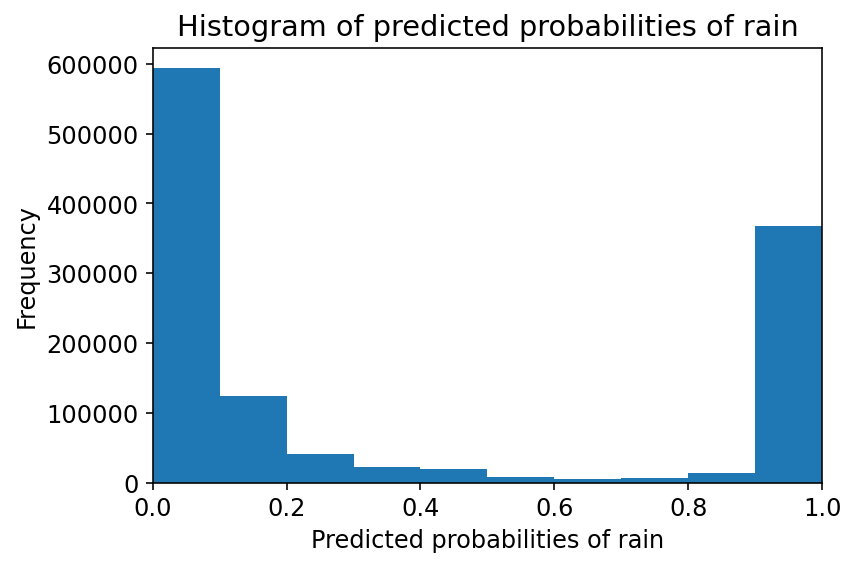

In [ ]:
from scipy.sparse import hstack
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD

for i in range(len(model_datas)):  
  df = model_datas[i]
  
  X = df.drop(['is_attributed','Year','Month','minute'], axis=1)
  y = df['is_attributed']
  print(len(X))

  
  columns = X.columns

  X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
  X = hstack((X,np.array(df['ip'])[:,None]))
  
  lf = TruncatedSVD(10)
  X = lf.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = (scaler.fit_transform(X_train))
  X_test = (scaler.transform(X_test))

  y_pred , y_pred_probab  = Decision_tree_model(X_train , X_test , y_train, y_test)
  evalute_model_Decision_tree(y_pred , y_pred_probab ,y_test)

10000
Model accuracy score: 0.9035
Training-set accuracy score: 0.9826
Confusion matrix

 [[1134   83]
 [ 110  673]]

True Positives(TP) =  1134

True Negatives(TN) =  673

False Positives(FP) =  83

False Negatives(FN) =  110


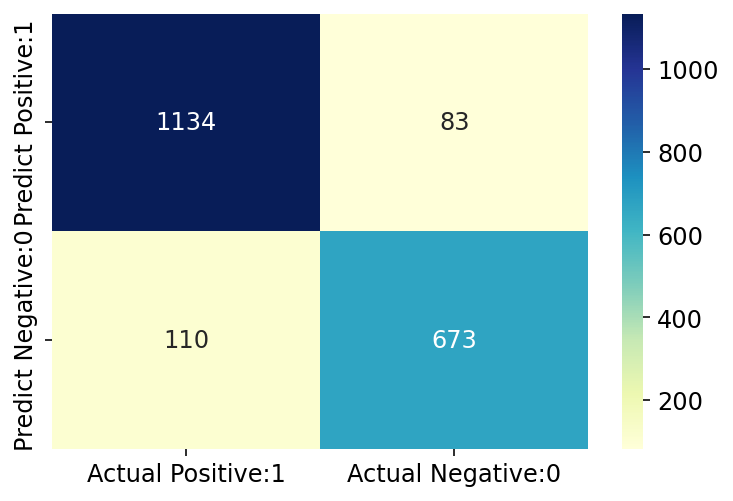

              precision    recall  f1-score   support

           0       0.91      0.93      0.92      1217
           1       0.89      0.86      0.87       783

    accuracy                           0.90      2000
   macro avg       0.90      0.90      0.90      2000
weighted avg       0.90      0.90      0.90      2000

Classification accuracy : 0.9035


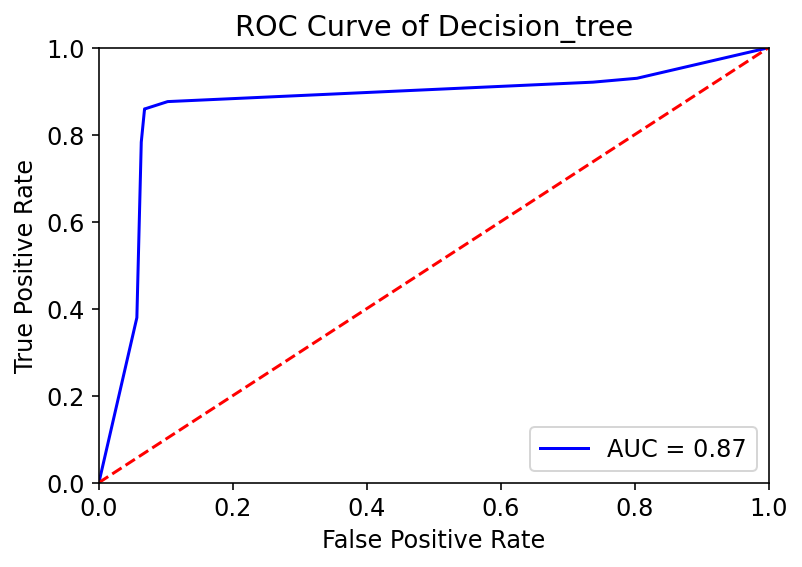

____________________________________________________________________________
50000
Model accuracy score: 0.9314
Training-set accuracy score: 0.9796
Confusion matrix

 [[5973  259]
 [ 427 3341]]

True Positives(TP) =  5973

True Negatives(TN) =  3341

False Positives(FP) =  259

False Negatives(FN) =  427


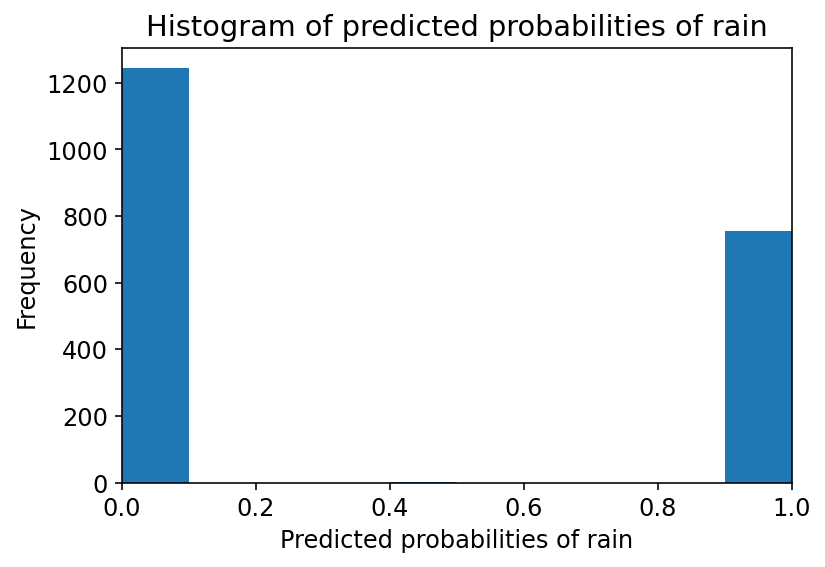

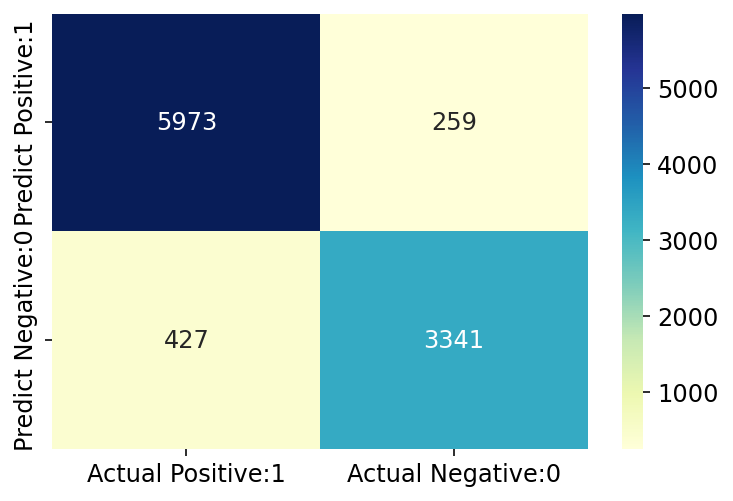

              precision    recall  f1-score   support

           0       0.93      0.96      0.95      6232
           1       0.93      0.89      0.91      3768

    accuracy                           0.93     10000
   macro avg       0.93      0.92      0.93     10000
weighted avg       0.93      0.93      0.93     10000

Classification accuracy : 0.9314


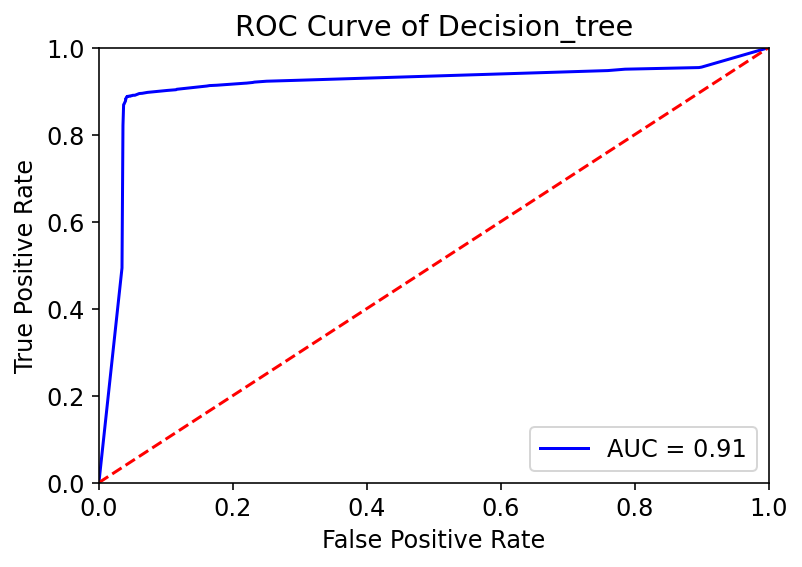

____________________________________________________________________________
100000
Model accuracy score: 0.9393
Training-set accuracy score: 0.9714
Confusion matrix

 [[12256   404]
 [  810  6530]]

True Positives(TP) =  12256

True Negatives(TN) =  6530

False Positives(FP) =  404

False Negatives(FN) =  810


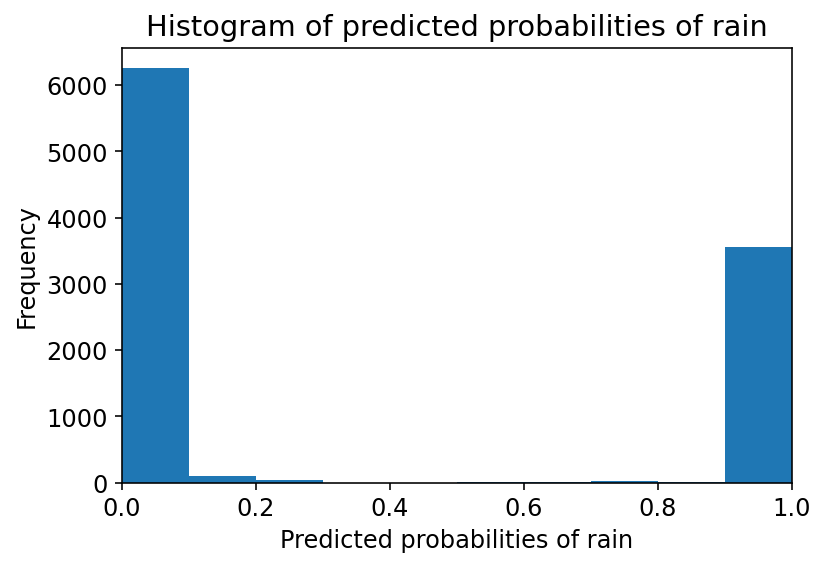

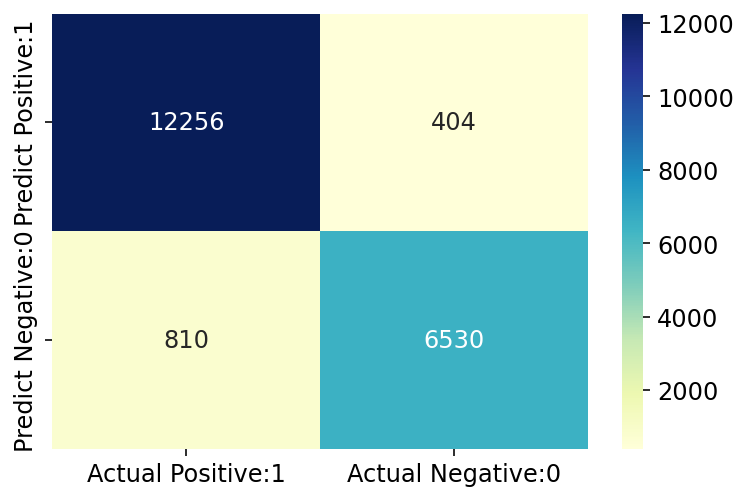

              precision    recall  f1-score   support

           0       0.94      0.97      0.95     12660
           1       0.94      0.89      0.91      7340

    accuracy                           0.94     20000
   macro avg       0.94      0.93      0.93     20000
weighted avg       0.94      0.94      0.94     20000

Classification accuracy : 0.9393


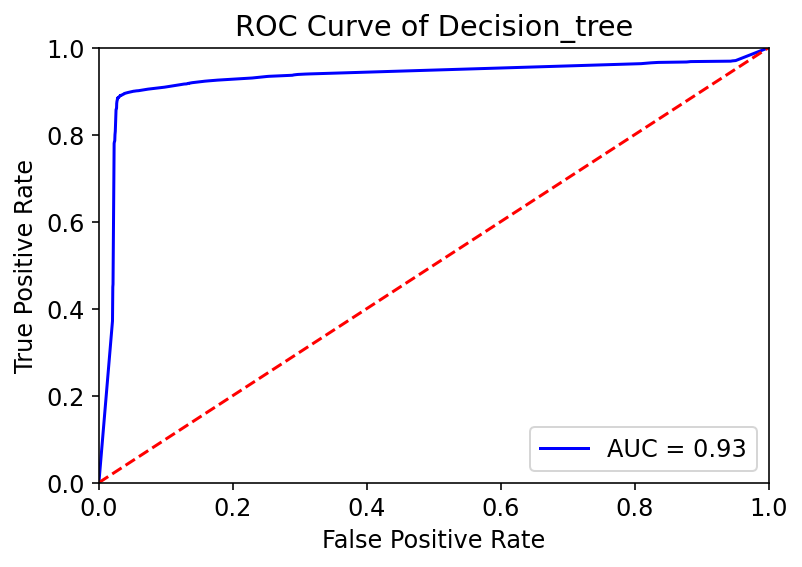

____________________________________________________________________________
150000
Model accuracy score: 0.9427
Training-set accuracy score: 0.9740
Confusion matrix

 [[18273   543]
 [ 1176 10008]]

True Positives(TP) =  18273

True Negatives(TN) =  10008

False Positives(FP) =  543

False Negatives(FN) =  1176


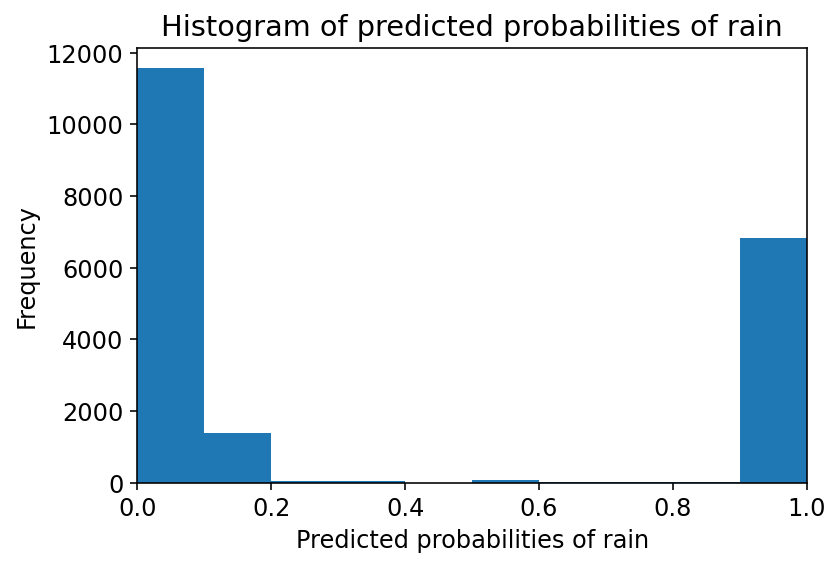

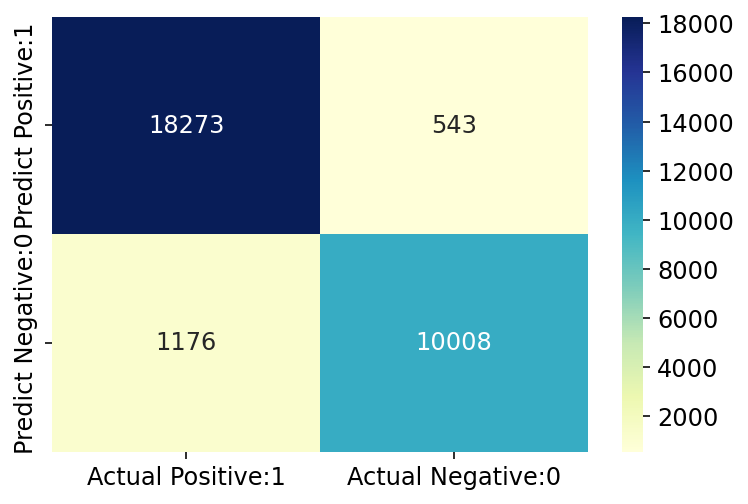

              precision    recall  f1-score   support

           0       0.94      0.97      0.96     18816
           1       0.95      0.89      0.92     11184

    accuracy                           0.94     30000
   macro avg       0.94      0.93      0.94     30000
weighted avg       0.94      0.94      0.94     30000

Classification accuracy : 0.9427


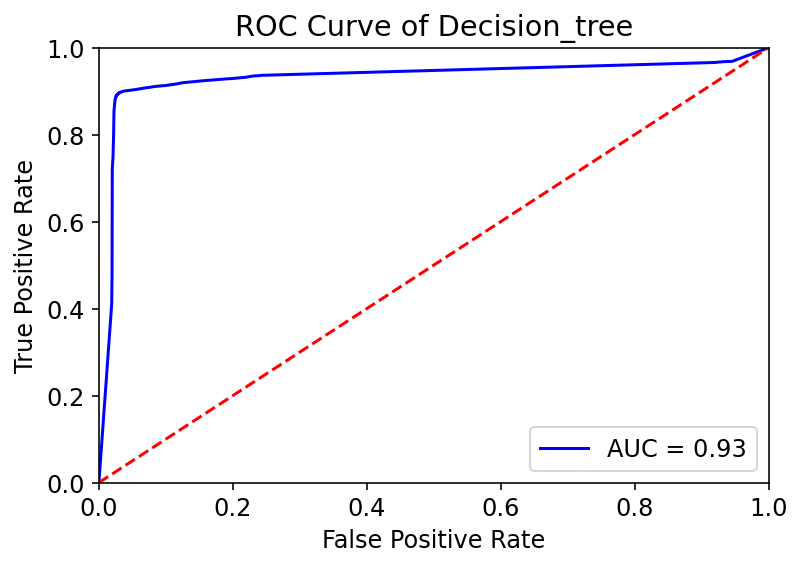

____________________________________________________________________________
200000
Model accuracy score: 0.9414
Training-set accuracy score: 0.9709
Confusion matrix

 [[24236   734]
 [ 1612 13418]]

True Positives(TP) =  24236

True Negatives(TN) =  13418

False Positives(FP) =  734

False Negatives(FN) =  1612


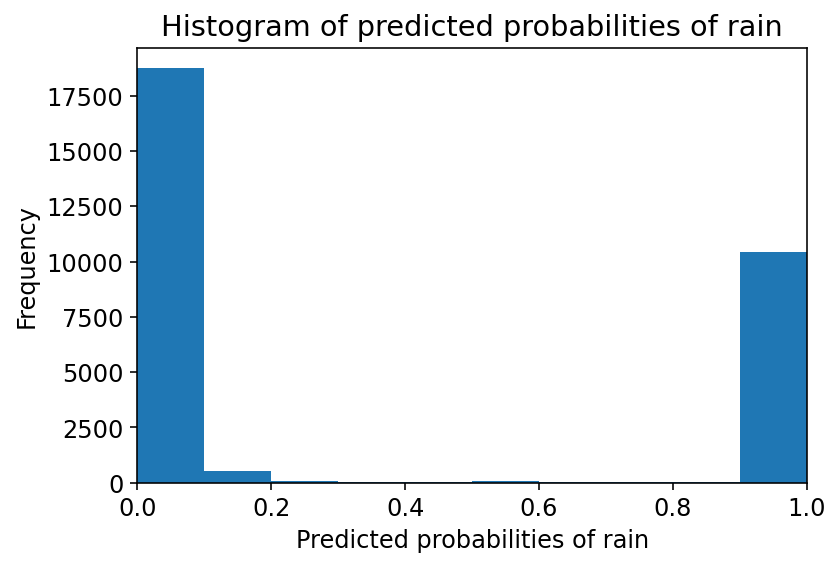

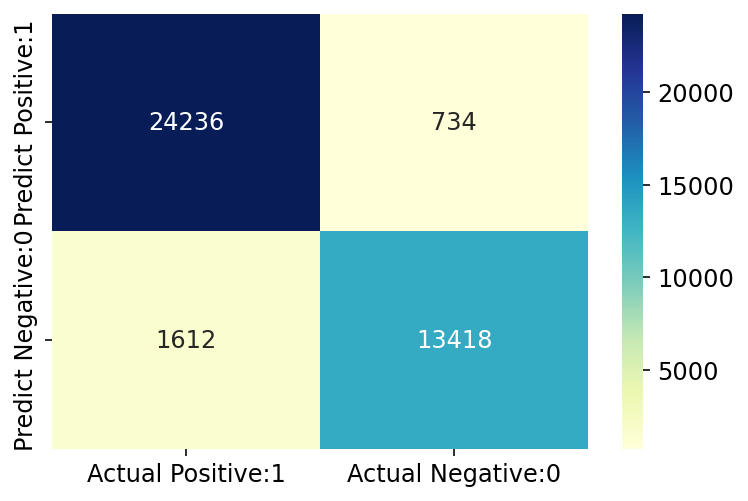

              precision    recall  f1-score   support

           0       0.94      0.97      0.95     24970
           1       0.95      0.89      0.92     15030

    accuracy                           0.94     40000
   macro avg       0.94      0.93      0.94     40000
weighted avg       0.94      0.94      0.94     40000

Classification accuracy : 0.9414


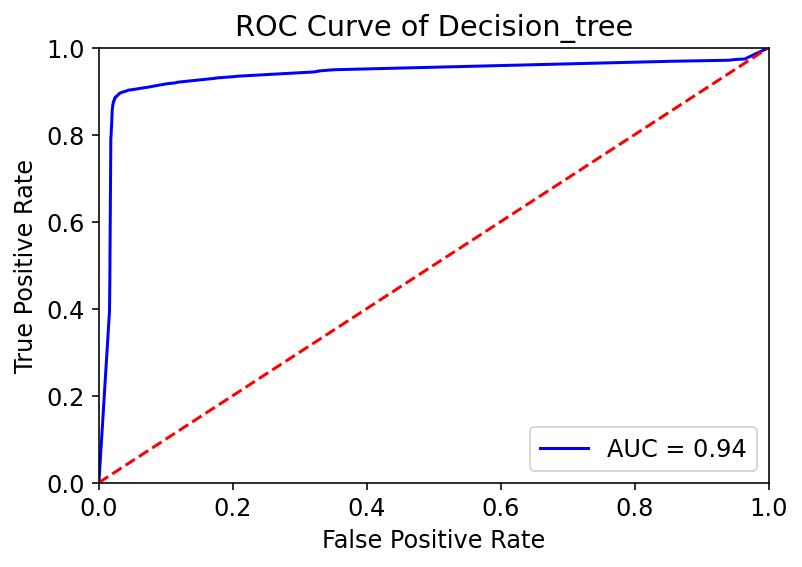

____________________________________________________________________________
6000000


In [ ]:
from scipy.sparse import hstack
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD

for i in range(len(model_datas)):  
  df = model_datas[i]
  
  X = df.drop(['is_attributed','Year','Month','minute'], axis=1)
  y = df['is_attributed']
  print(len(X))

  
  columns = X.columns

  X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
  X = hstack((X,np.array(df['ip'])[:,None]))
  
  lf = TruncatedSVD(100)
  X = lf.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = (scaler.fit_transform(X_train))
  X_test = (scaler.transform(X_test))

  y_pred , y_pred_probab  = Decision_tree_model(X_train , X_test , y_train, y_test)
  evalute_model_Decision_tree(y_pred , y_pred_probab ,y_test)

##  Decision Tree Classifier with criterion gini index 


In [ ]:
df2

NameError: ignored

10000
Model accuracy score: 0.9100
Training-set accuracy score: 0.9948
Confusion matrix

 [[1189   84]
 [  96  631]]

True Positives(TP) =  1189

True Negatives(TN) =  631

False Positives(FP) =  84

False Negatives(FN) =  96


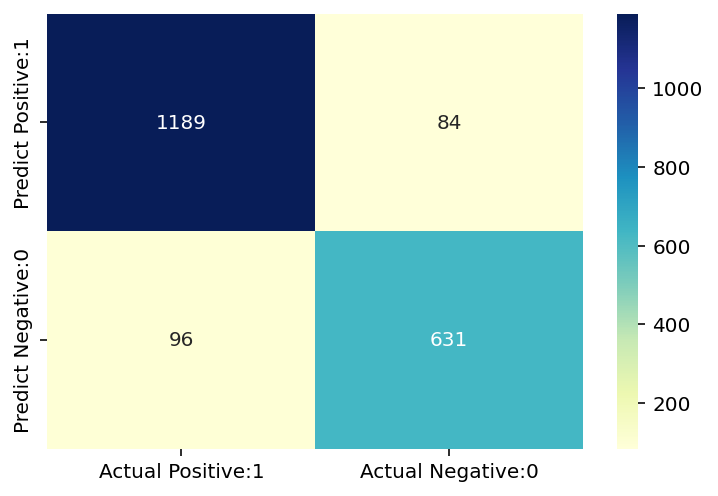

              precision    recall  f1-score   support

           0       0.93      0.93      0.93      1273
           1       0.88      0.87      0.88       727

    accuracy                           0.91      2000
   macro avg       0.90      0.90      0.90      2000
weighted avg       0.91      0.91      0.91      2000

Classification accuracy : 0.9100


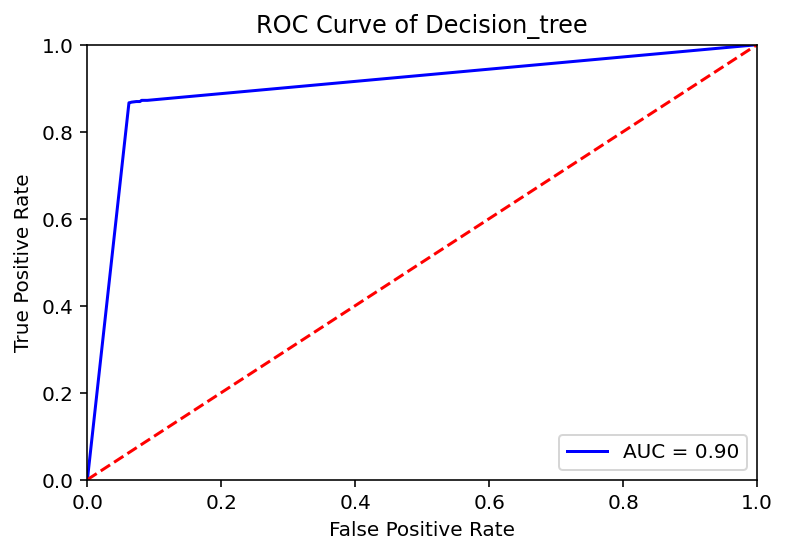

____________________________________________________________________________
50000
Model accuracy score: 0.9484
Training-set accuracy score: 0.9888
Confusion matrix

 [[6004  214]
 [ 302 3480]]

True Positives(TP) =  6004

True Negatives(TN) =  3480

False Positives(FP) =  214

False Negatives(FN) =  302


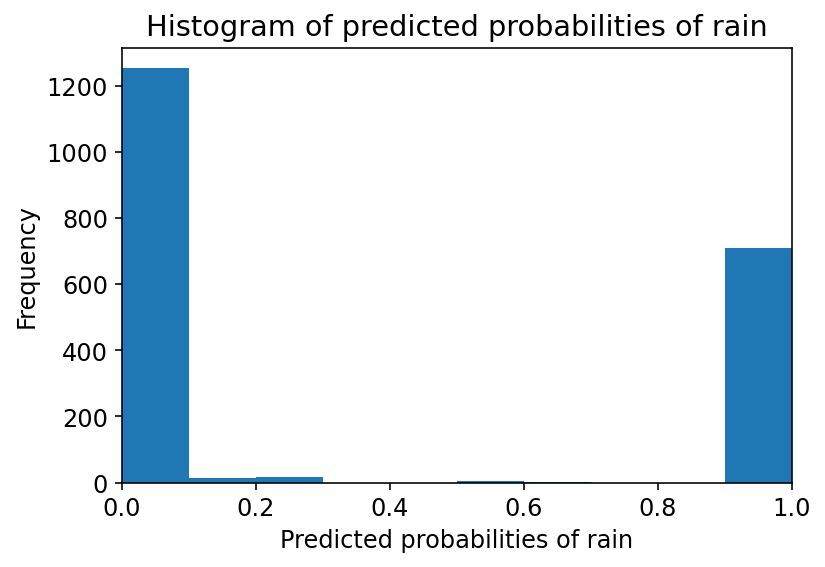

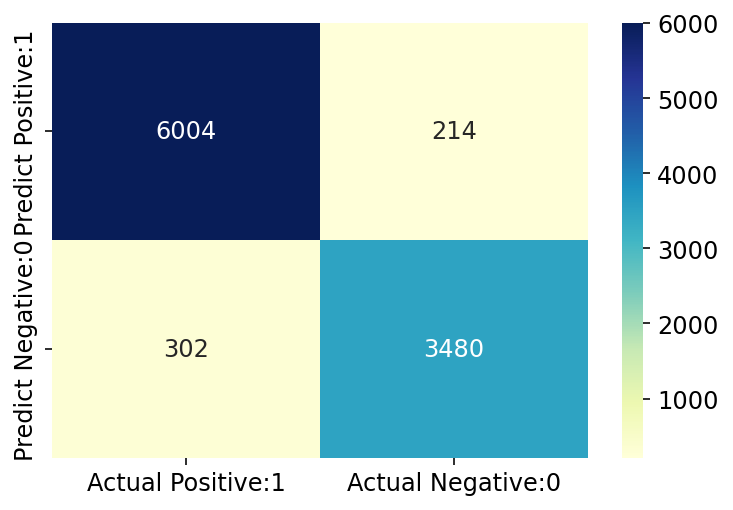

              precision    recall  f1-score   support

           0       0.95      0.97      0.96      6218
           1       0.94      0.92      0.93      3782

    accuracy                           0.95     10000
   macro avg       0.95      0.94      0.94     10000
weighted avg       0.95      0.95      0.95     10000

Classification accuracy : 0.9484


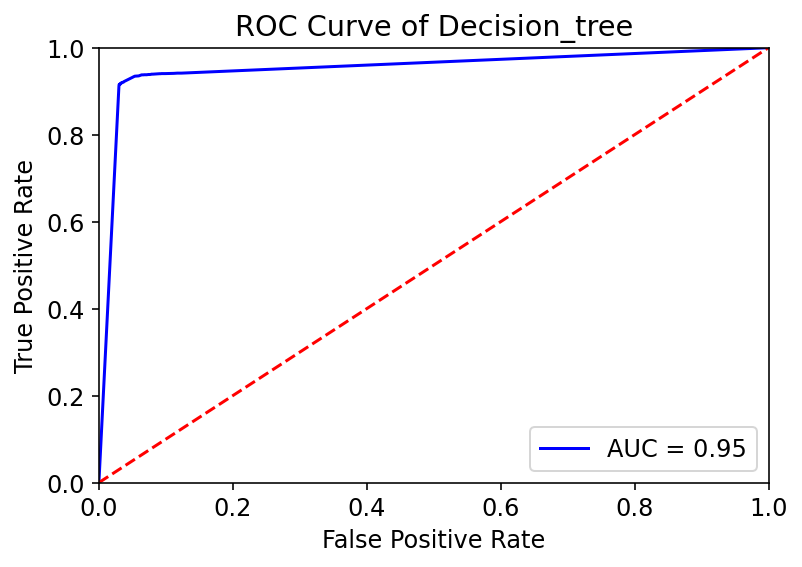

____________________________________________________________________________
100000
Model accuracy score: 0.9624
Training-set accuracy score: 0.9922
Confusion matrix

 [[12205   308]
 [  444  7043]]

True Positives(TP) =  12205

True Negatives(TN) =  7043

False Positives(FP) =  308

False Negatives(FN) =  444


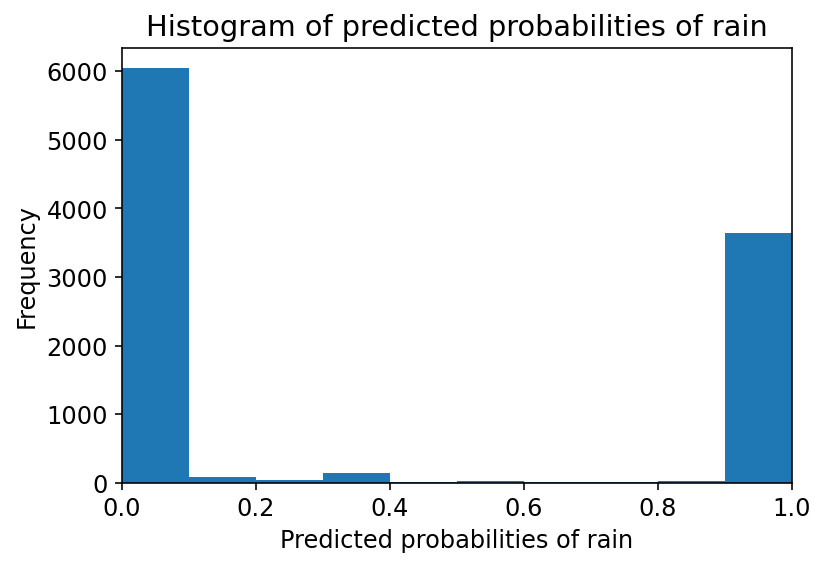

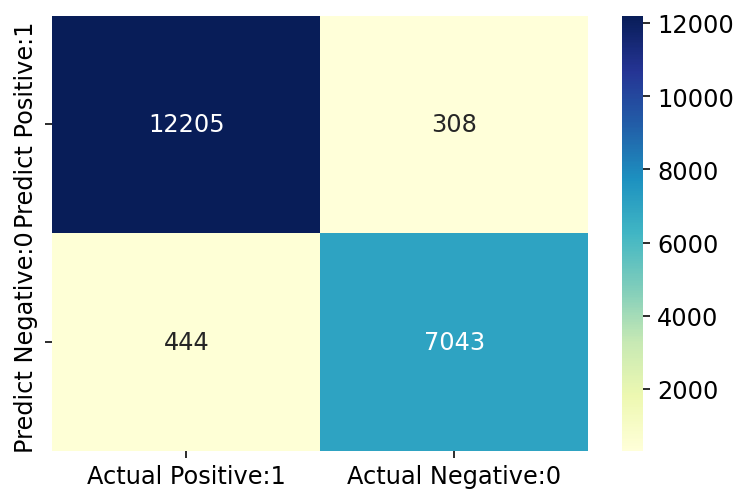

              precision    recall  f1-score   support

           0       0.96      0.98      0.97     12513
           1       0.96      0.94      0.95      7487

    accuracy                           0.96     20000
   macro avg       0.96      0.96      0.96     20000
weighted avg       0.96      0.96      0.96     20000

Classification accuracy : 0.9624


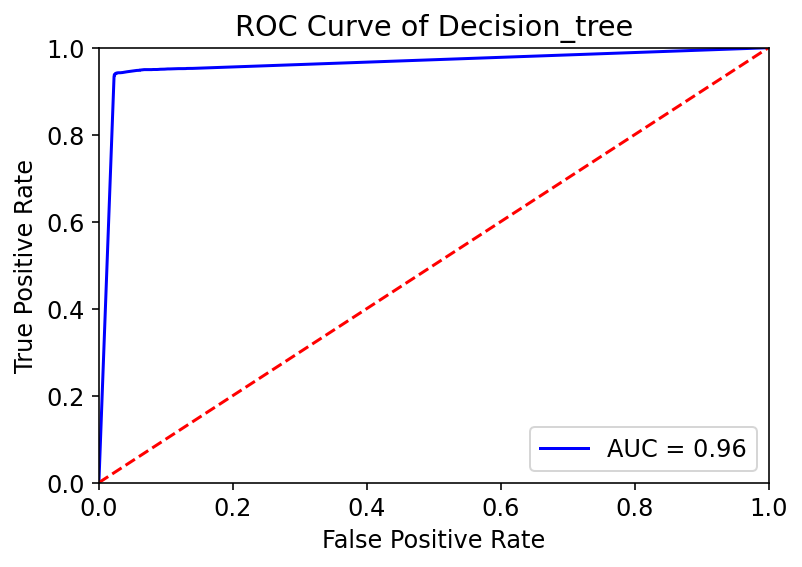

____________________________________________________________________________
150000
Model accuracy score: 0.9631
Training-set accuracy score: 0.9903
Confusion matrix

 [[18302   438]
 [  668 10592]]

True Positives(TP) =  18302

True Negatives(TN) =  10592

False Positives(FP) =  438

False Negatives(FN) =  668


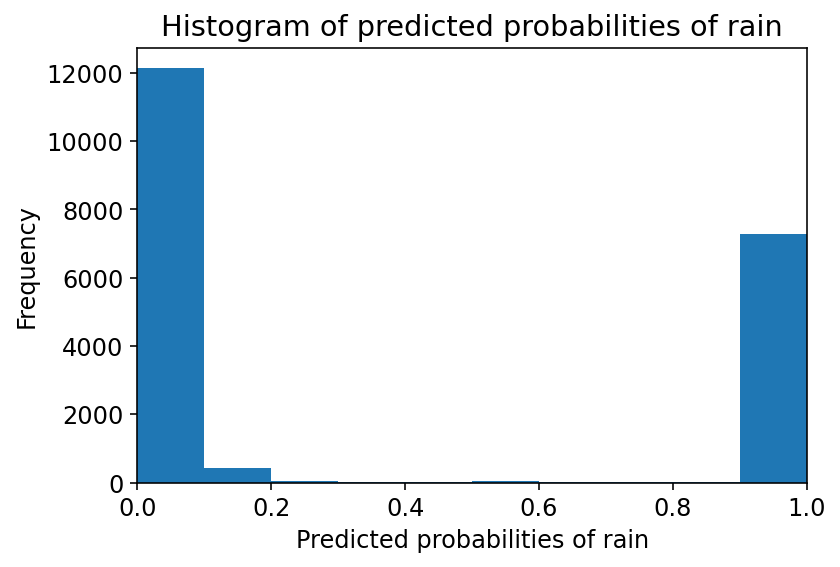

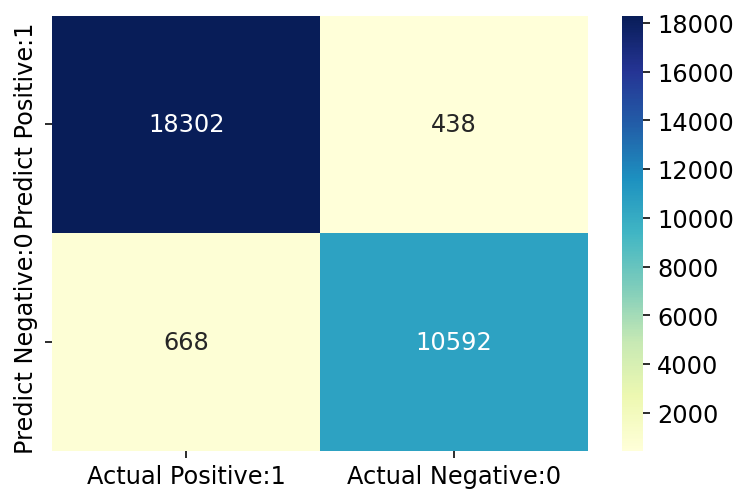

              precision    recall  f1-score   support

           0       0.96      0.98      0.97     18740
           1       0.96      0.94      0.95     11260

    accuracy                           0.96     30000
   macro avg       0.96      0.96      0.96     30000
weighted avg       0.96      0.96      0.96     30000

Classification accuracy : 0.9631


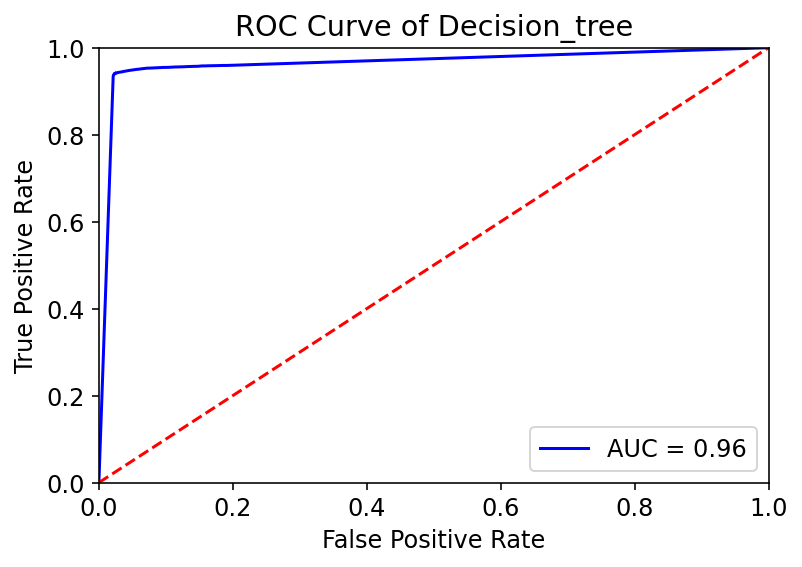

____________________________________________________________________________
200000
Model accuracy score: 0.9679
Training-set accuracy score: 0.9903
Confusion matrix

 [[24544   472]
 [  813 14171]]

True Positives(TP) =  24544

True Negatives(TN) =  14171

False Positives(FP) =  472

False Negatives(FN) =  813


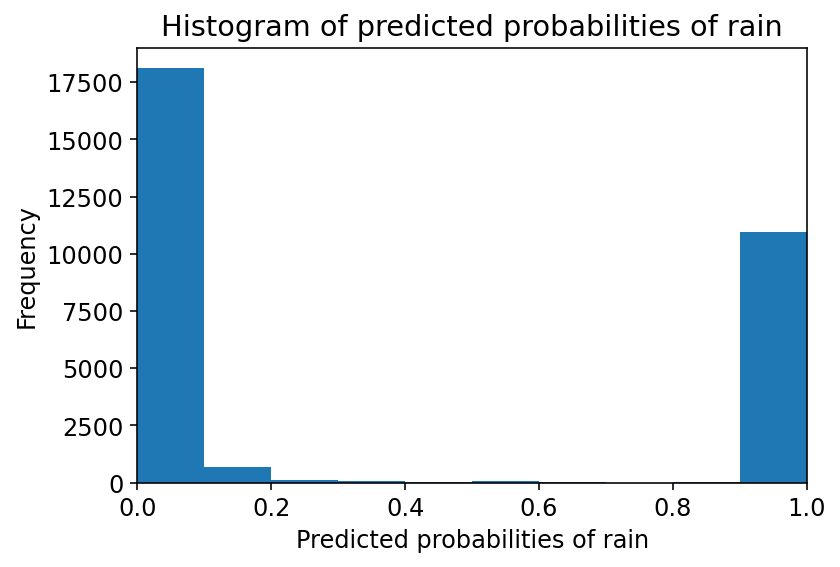

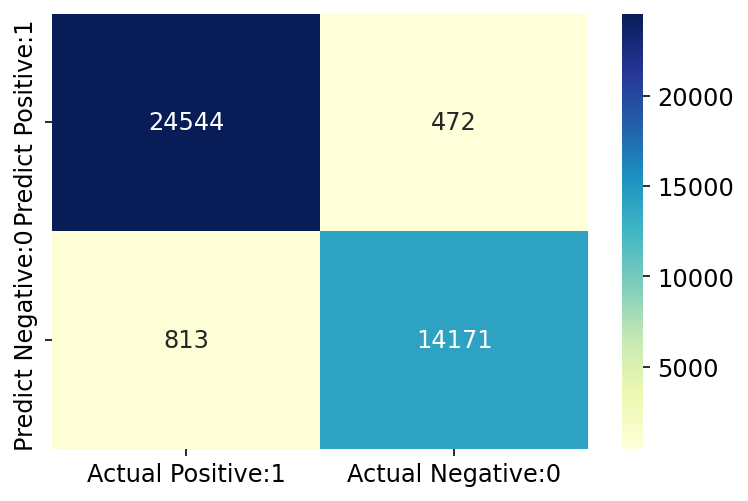

              precision    recall  f1-score   support

           0       0.97      0.98      0.97     25016
           1       0.97      0.95      0.96     14984

    accuracy                           0.97     40000
   macro avg       0.97      0.96      0.97     40000
weighted avg       0.97      0.97      0.97     40000

Classification accuracy : 0.9679


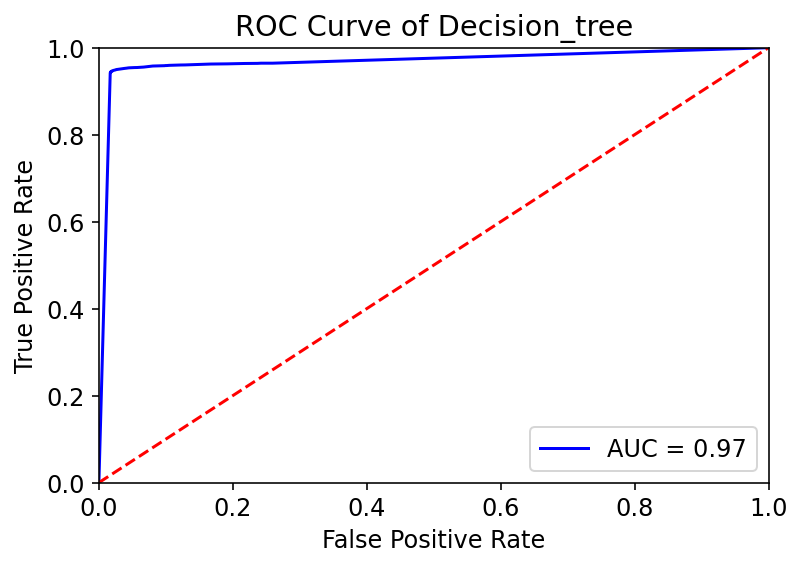

____________________________________________________________________________
6000000
Model accuracy score: 0.9794
Training-set accuracy score: 0.9831
Confusion matrix

 [[744215   6158]
 [ 18565 431062]]

True Positives(TP) =  744215

True Negatives(TN) =  431062

False Positives(FP) =  6158

False Negatives(FN) =  18565


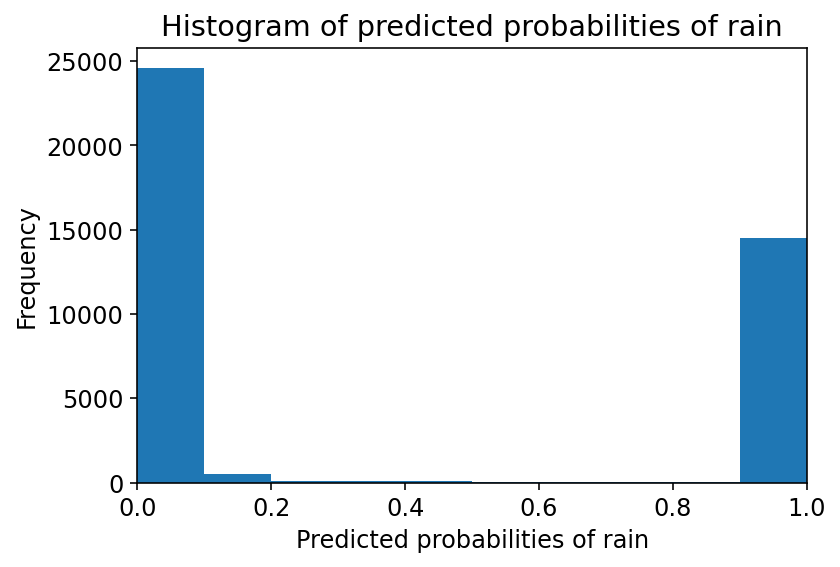

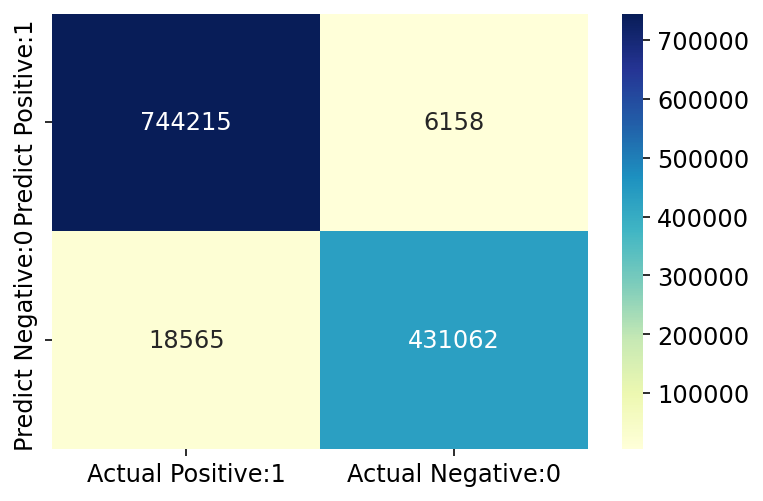

              precision    recall  f1-score   support

           0       0.98      0.99      0.98    750373
           1       0.99      0.96      0.97    449627

    accuracy                           0.98   1200000
   macro avg       0.98      0.98      0.98   1200000
weighted avg       0.98      0.98      0.98   1200000

Classification accuracy : 0.9794


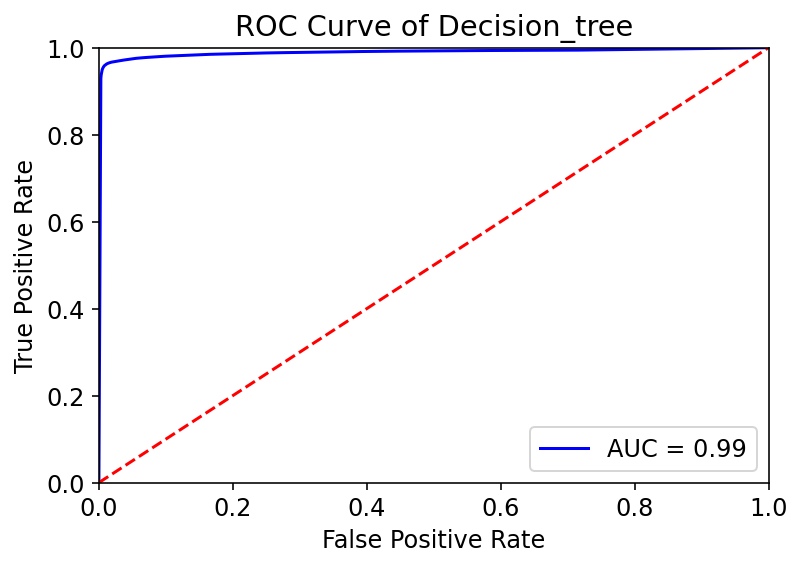

____________________________________________________________________________


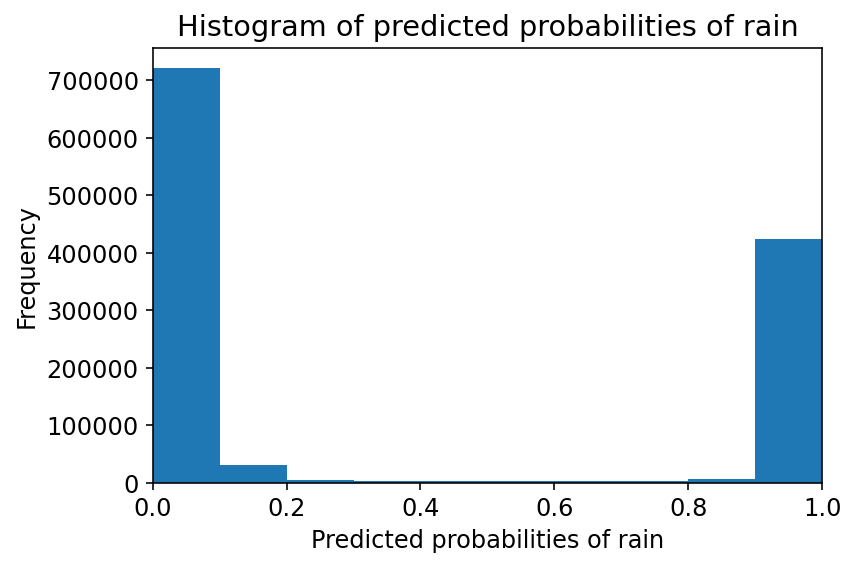

In [ ]:
from scipy.sparse import hstack
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD

for i in range(len(model_datas)):  
  df = model_datas[i]
  
  X = df.drop(['is_attributed','Year','Month','minute'], axis=1)
  y = df['is_attributed']
  print(len(X))

  
  columns = X.columns

  # X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
  # X = hstack((X,np.array(df['ip'])[:,None]))
  
  # lf = TruncatedSVD(10)
  # X = lf.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = (scaler.fit_transform(X_train))
  X_test = (scaler.transform(X_test))

  y_pred , y_pred_probab  = Decision_tree_model(X_train , X_test , y_train, y_test)
  evalute_model_Decision_tree(y_pred , y_pred_probab ,y_test)


10000
Model accuracy score: 0.8345
Training-set accuracy score: 0.9816
Confusion matrix

 [[1106  167]
 [ 164  563]]

True Positives(TP) =  1106

True Negatives(TN) =  563

False Positives(FP) =  167

False Negatives(FN) =  164


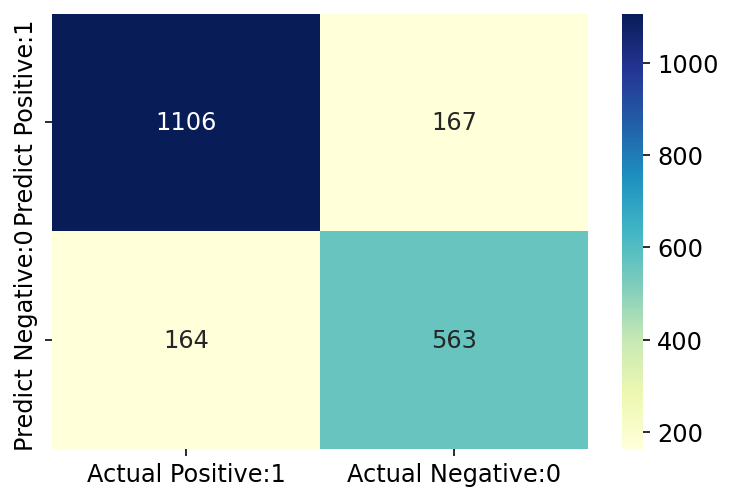

              precision    recall  f1-score   support

           0       0.87      0.87      0.87      1273
           1       0.77      0.77      0.77       727

    accuracy                           0.83      2000
   macro avg       0.82      0.82      0.82      2000
weighted avg       0.83      0.83      0.83      2000

Classification accuracy : 0.8345


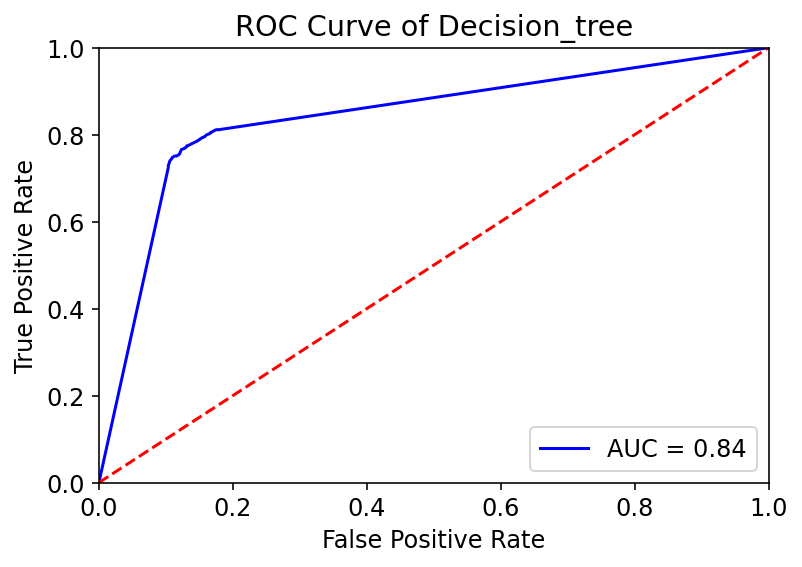

____________________________________________________________________________
50000
Model accuracy score: 0.8675
Training-set accuracy score: 0.9688
Confusion matrix

 [[5536  682]
 [ 643 3139]]

True Positives(TP) =  5536

True Negatives(TN) =  3139

False Positives(FP) =  682

False Negatives(FN) =  643


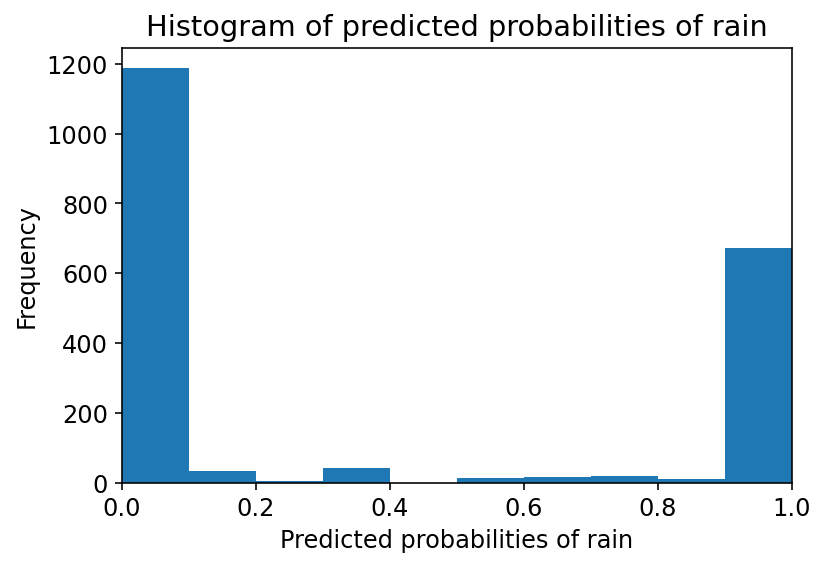

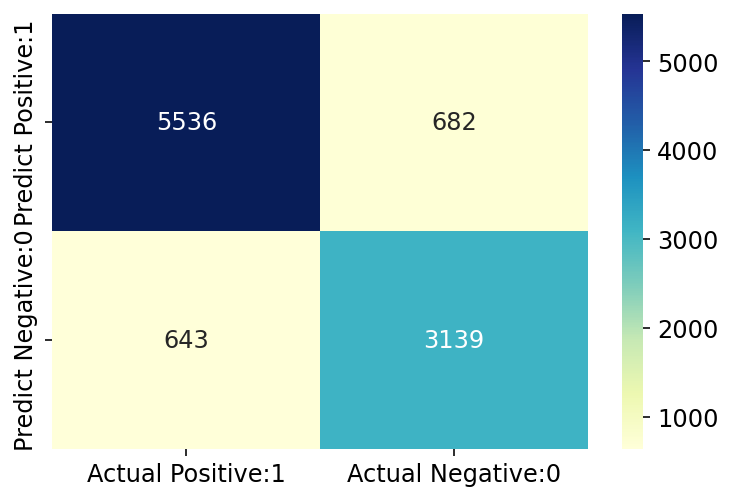

              precision    recall  f1-score   support

           0       0.90      0.89      0.89      6218
           1       0.82      0.83      0.83      3782

    accuracy                           0.87     10000
   macro avg       0.86      0.86      0.86     10000
weighted avg       0.87      0.87      0.87     10000

Classification accuracy : 0.8675


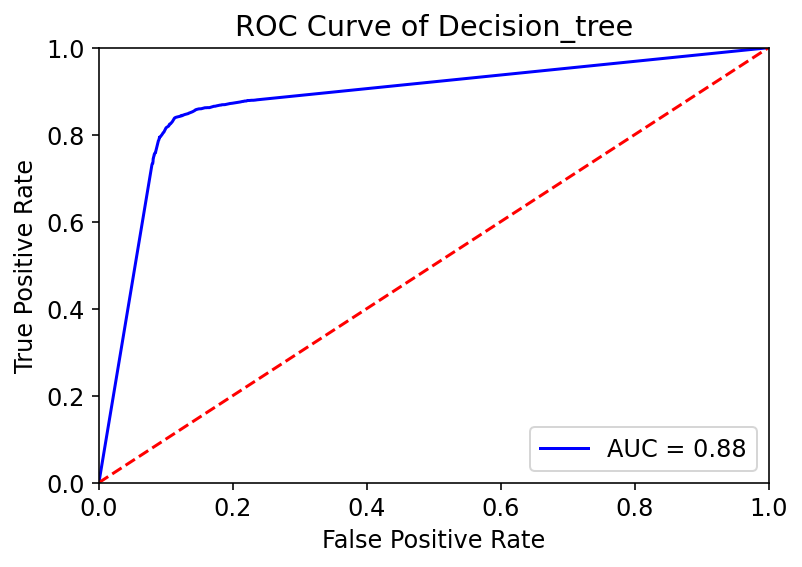

____________________________________________________________________________
100000
Model accuracy score: 0.8760
Training-set accuracy score: 0.9595
Confusion matrix

 [[11370  1143]
 [ 1338  6149]]

True Positives(TP) =  11370

True Negatives(TN) =  6149

False Positives(FP) =  1143

False Negatives(FN) =  1338


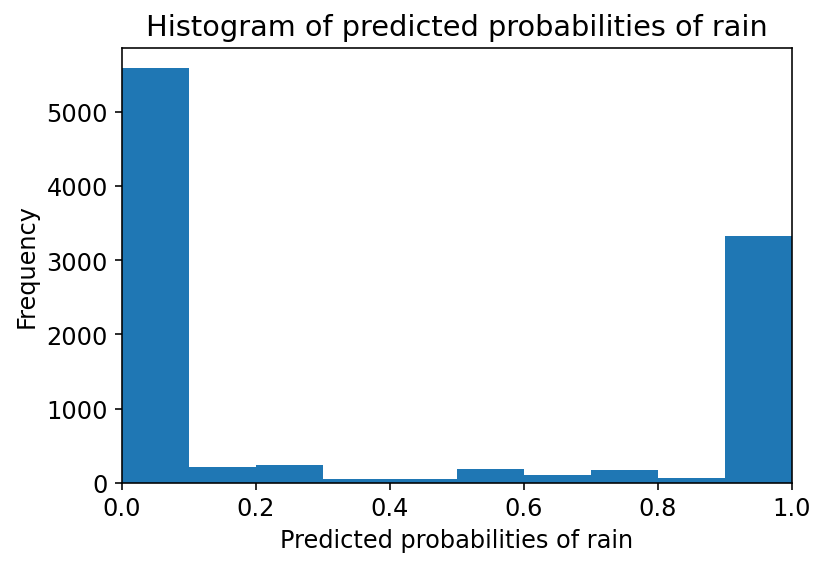

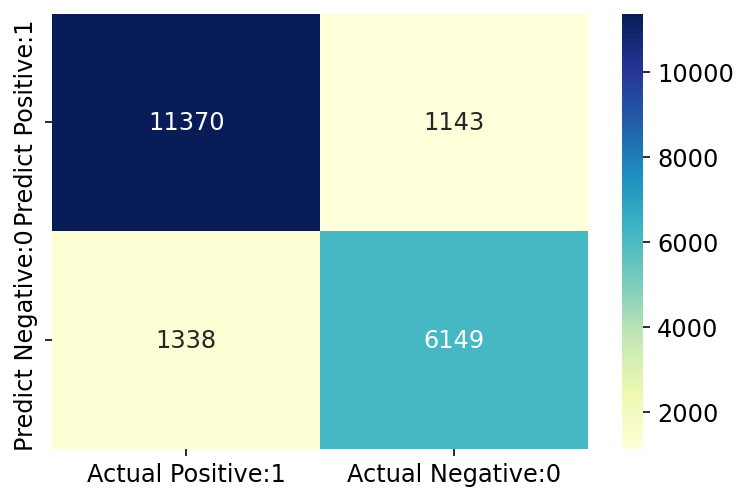

              precision    recall  f1-score   support

           0       0.89      0.91      0.90     12513
           1       0.84      0.82      0.83      7487

    accuracy                           0.88     20000
   macro avg       0.87      0.86      0.87     20000
weighted avg       0.88      0.88      0.88     20000

Classification accuracy : 0.8760


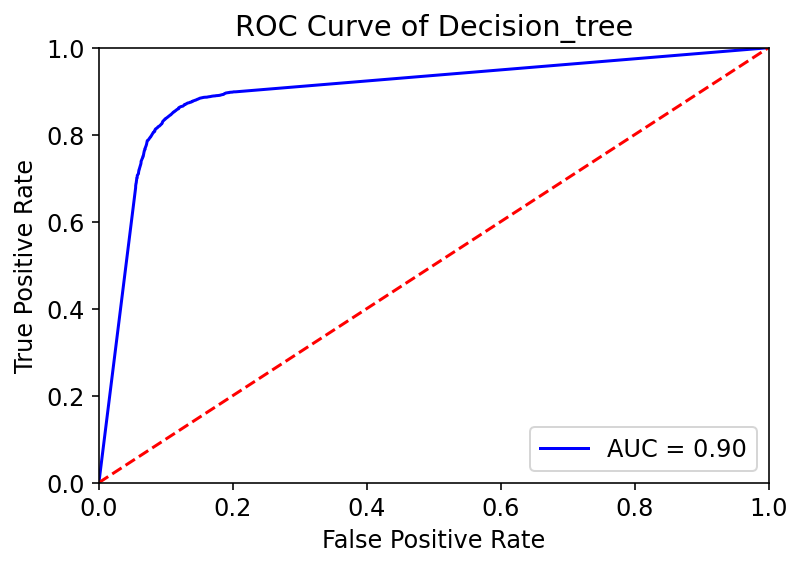

____________________________________________________________________________
150000
Model accuracy score: 0.8893
Training-set accuracy score: 0.9601
Confusion matrix

 [[17264  1476]
 [ 1846  9414]]

True Positives(TP) =  17264

True Negatives(TN) =  9414

False Positives(FP) =  1476

False Negatives(FN) =  1846


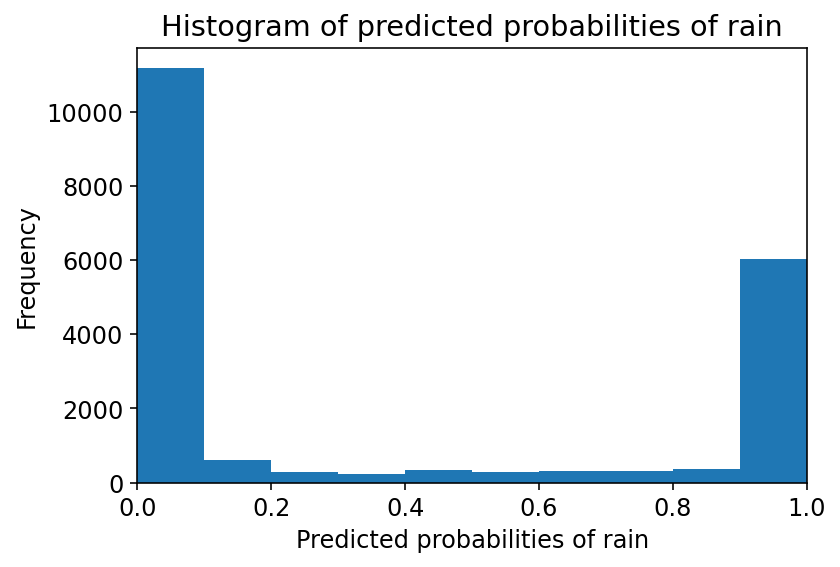

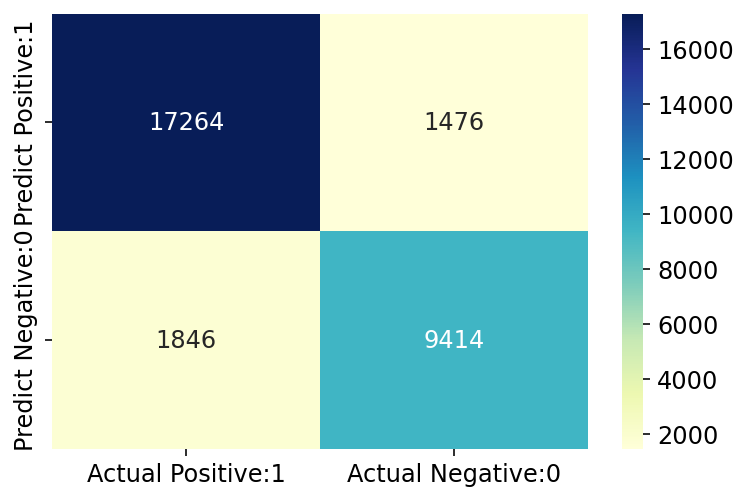

              precision    recall  f1-score   support

           0       0.90      0.92      0.91     18740
           1       0.86      0.84      0.85     11260

    accuracy                           0.89     30000
   macro avg       0.88      0.88      0.88     30000
weighted avg       0.89      0.89      0.89     30000

Classification accuracy : 0.8893


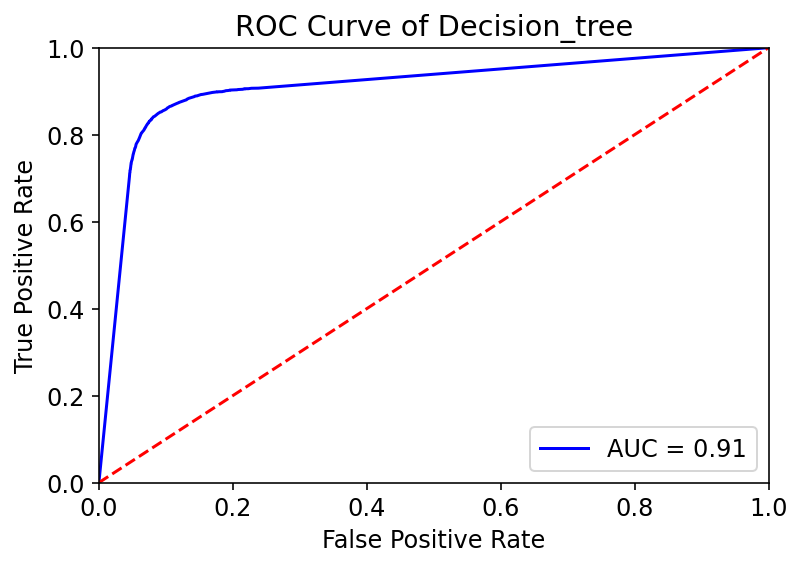

____________________________________________________________________________
200000
Model accuracy score: 0.8920
Training-set accuracy score: 0.9523
Confusion matrix

 [[23185  1831]
 [ 2491 12493]]

True Positives(TP) =  23185

True Negatives(TN) =  12493

False Positives(FP) =  1831

False Negatives(FN) =  2491


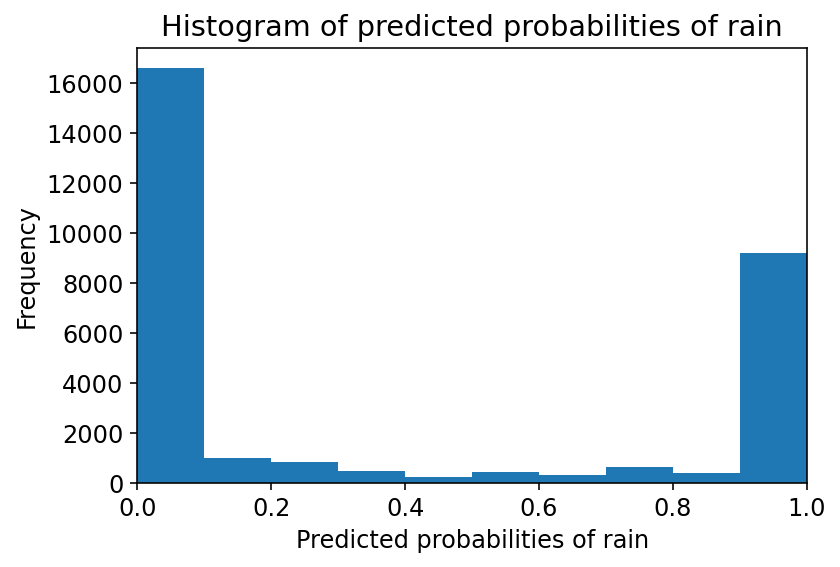

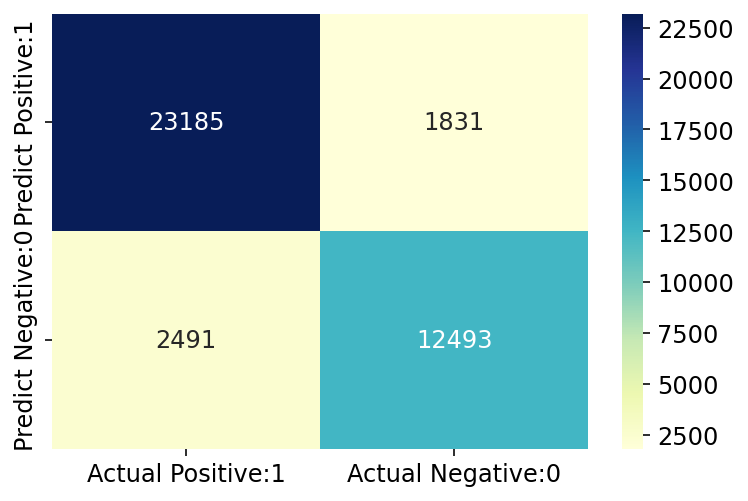

              precision    recall  f1-score   support

           0       0.90      0.93      0.91     25016
           1       0.87      0.83      0.85     14984

    accuracy                           0.89     40000
   macro avg       0.89      0.88      0.88     40000
weighted avg       0.89      0.89      0.89     40000

Classification accuracy : 0.8920


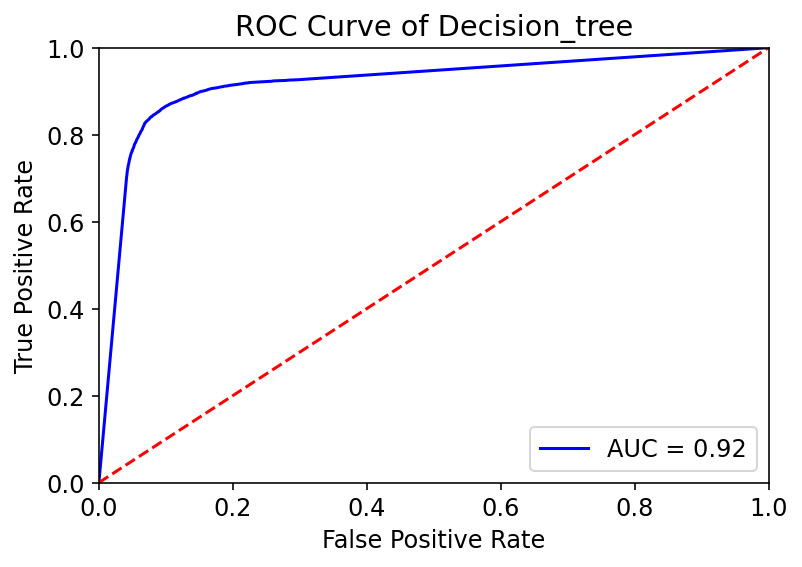

____________________________________________________________________________
6000000


KeyboardInterrupt: ignored

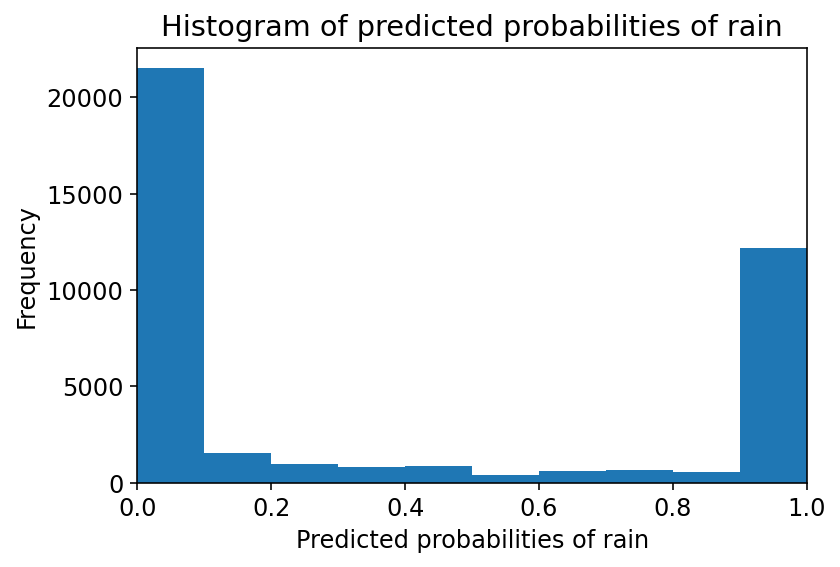

In [ ]:
from scipy.sparse import hstack
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD

for i in range(len(model_datas)):  
  df = model_datas[i]
  
  X = df.drop(['is_attributed','Year','Month','minute'], axis=1)
  y = df['is_attributed']
  print(len(X))

  
  columns = X.columns

  X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
  X = hstack((X,np.array(df['ip'])[:,None]))
  
  lf = TruncatedSVD(10)
  X = lf.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = (scaler.fit_transform(X_train))
  X_test = (scaler.transform(X_test))

  y_pred , y_pred_probab  = Decision_tree_model(X_train , X_test , y_train, y_test)
  evalute_model_Decision_tree(y_pred , y_pred_probab ,y_test)

10000
Model accuracy score: 0.8790
Training-set accuracy score: 0.9969
Confusion matrix

 [[1152  121]
 [ 121  606]]

True Positives(TP) =  1152

True Negatives(TN) =  606

False Positives(FP) =  121

False Negatives(FN) =  121


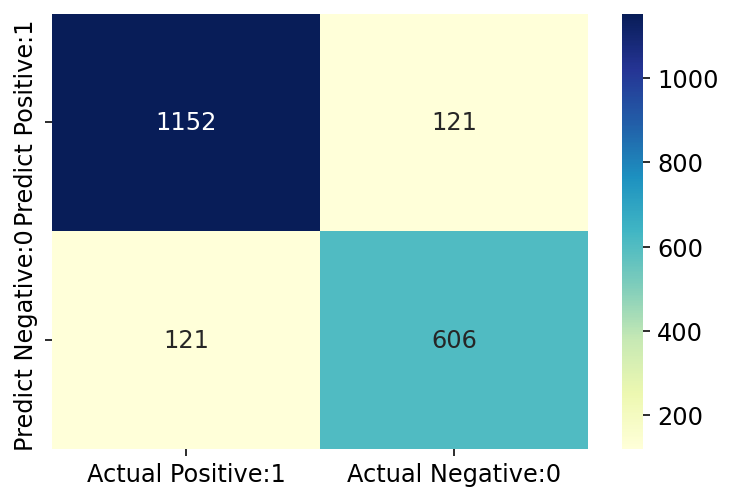

              precision    recall  f1-score   support

           0       0.90      0.90      0.90      1273
           1       0.83      0.83      0.83       727

    accuracy                           0.88      2000
   macro avg       0.87      0.87      0.87      2000
weighted avg       0.88      0.88      0.88      2000

Classification accuracy : 0.8790


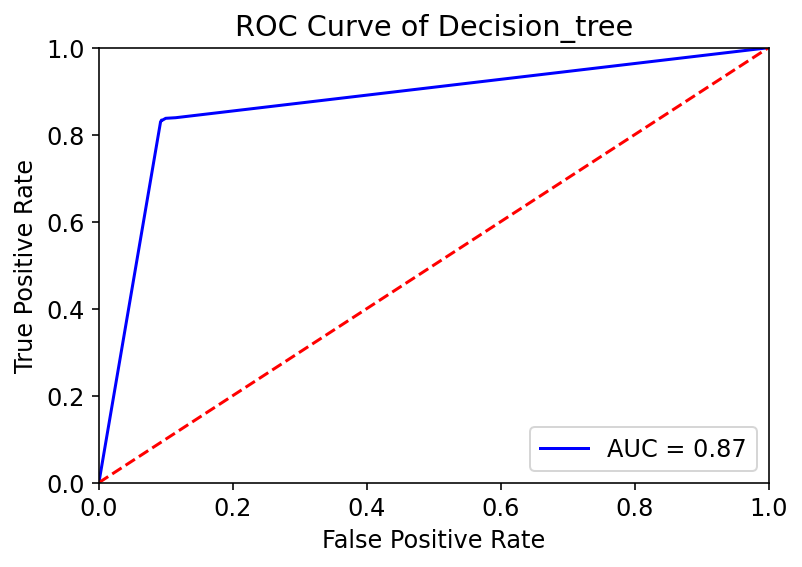

____________________________________________________________________________
50000
Model accuracy score: 0.9186
Training-set accuracy score: 0.9829
Confusion matrix

 [[5773  445]
 [ 369 3413]]

True Positives(TP) =  5773

True Negatives(TN) =  3413

False Positives(FP) =  445

False Negatives(FN) =  369


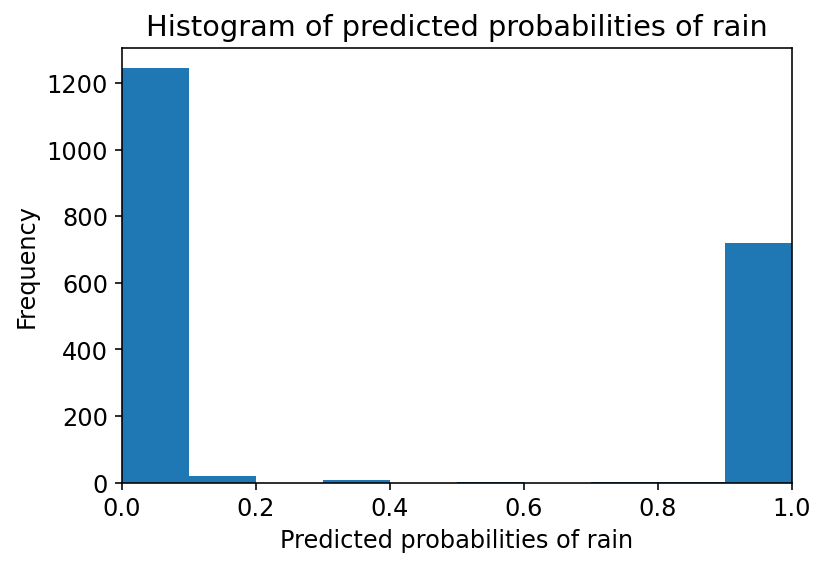

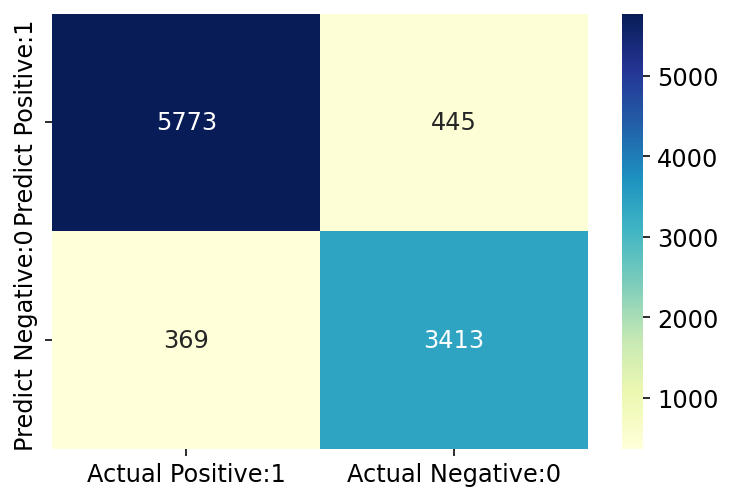

              precision    recall  f1-score   support

           0       0.94      0.93      0.93      6218
           1       0.88      0.90      0.89      3782

    accuracy                           0.92     10000
   macro avg       0.91      0.92      0.91     10000
weighted avg       0.92      0.92      0.92     10000

Classification accuracy : 0.9186


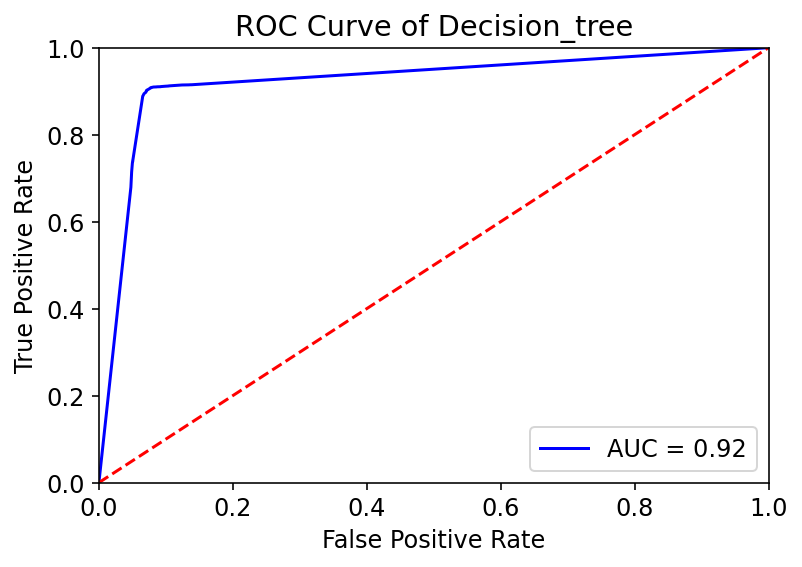

____________________________________________________________________________
100000
Model accuracy score: 0.9335
Training-set accuracy score: 0.9849
Confusion matrix

 [[11907   606]
 [  725  6762]]

True Positives(TP) =  11907

True Negatives(TN) =  6762

False Positives(FP) =  606

False Negatives(FN) =  725


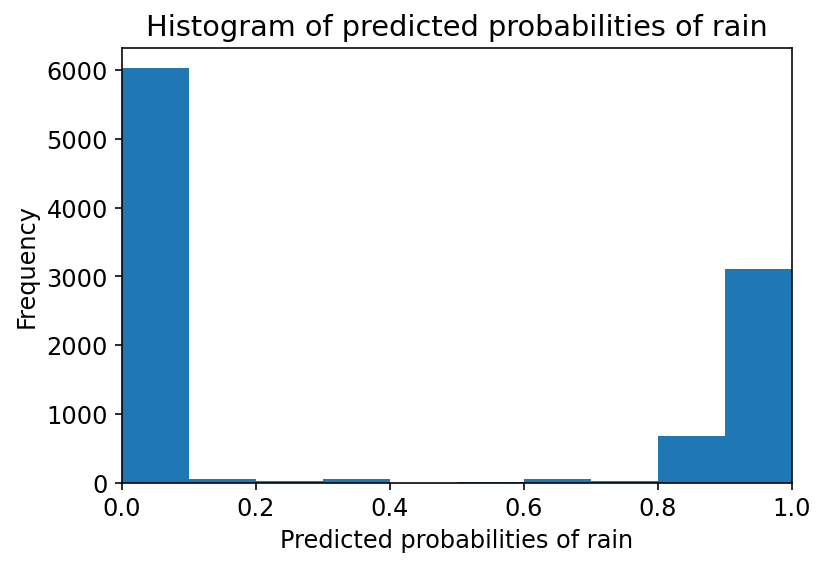

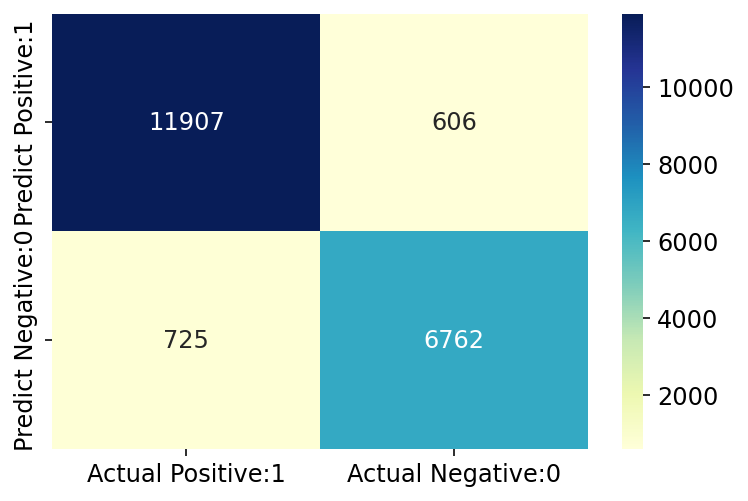

              precision    recall  f1-score   support

           0       0.94      0.95      0.95     12513
           1       0.92      0.90      0.91      7487

    accuracy                           0.93     20000
   macro avg       0.93      0.93      0.93     20000
weighted avg       0.93      0.93      0.93     20000

Classification accuracy : 0.9335


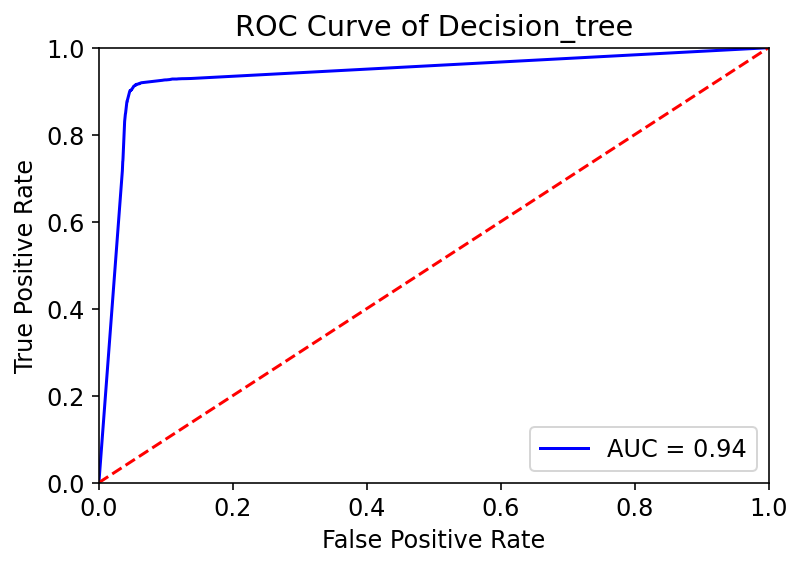

____________________________________________________________________________
150000
Model accuracy score: 0.9336
Training-set accuracy score: 0.9783
Confusion matrix

 [[17748   992]
 [  999 10261]]

True Positives(TP) =  17748

True Negatives(TN) =  10261

False Positives(FP) =  992

False Negatives(FN) =  999


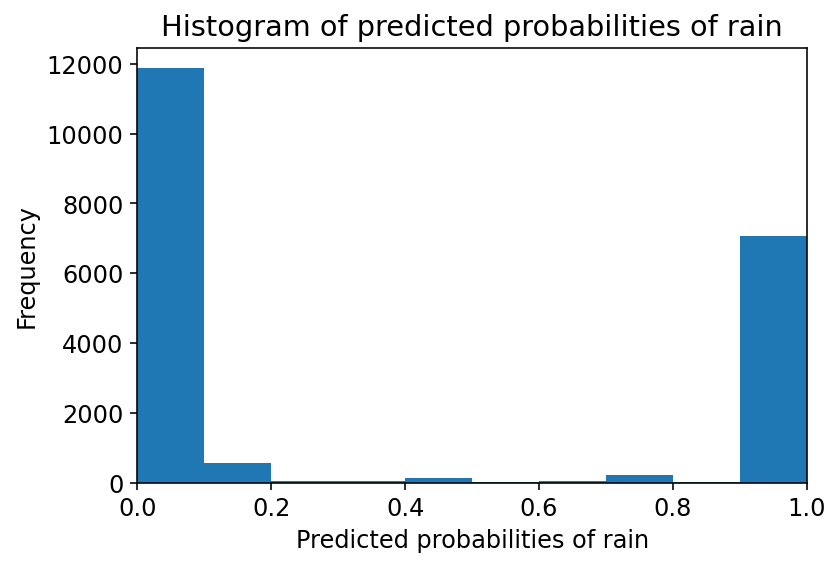

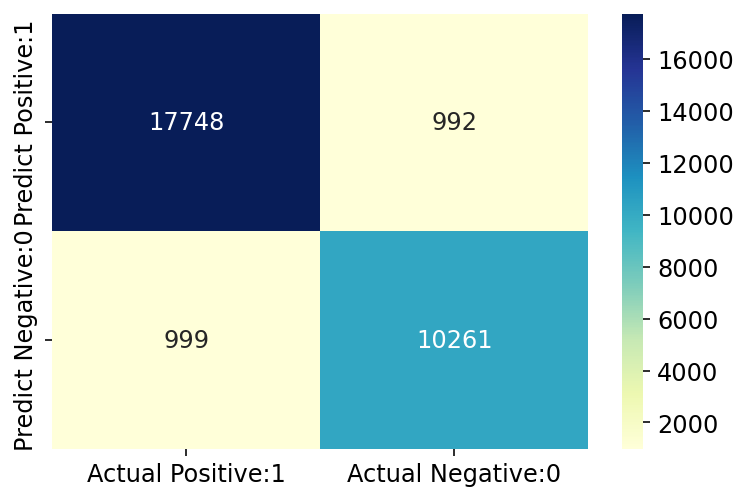

              precision    recall  f1-score   support

           0       0.95      0.95      0.95     18740
           1       0.91      0.91      0.91     11260

    accuracy                           0.93     30000
   macro avg       0.93      0.93      0.93     30000
weighted avg       0.93      0.93      0.93     30000

Classification accuracy : 0.9336


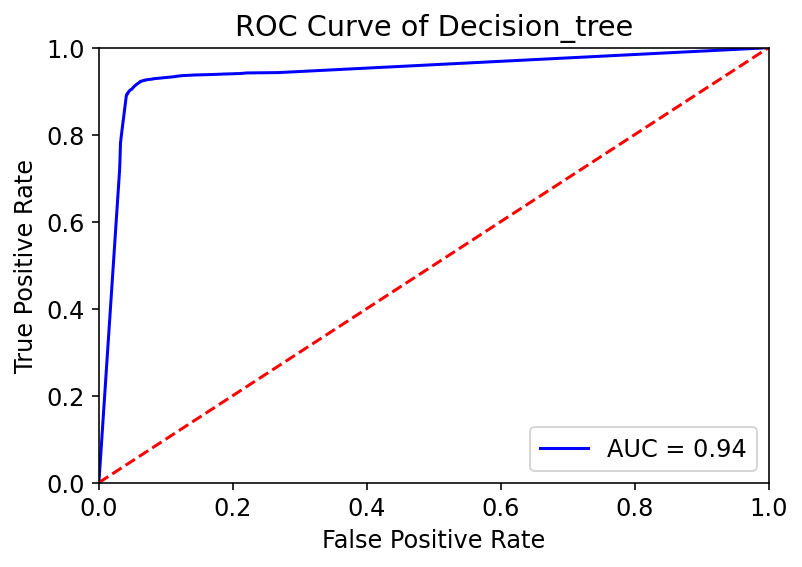

____________________________________________________________________________
200000
Model accuracy score: 0.9414
Training-set accuracy score: 0.9803
Confusion matrix

 [[23671  1345]
 [ 1000 13984]]

True Positives(TP) =  23671

True Negatives(TN) =  13984

False Positives(FP) =  1345

False Negatives(FN) =  1000


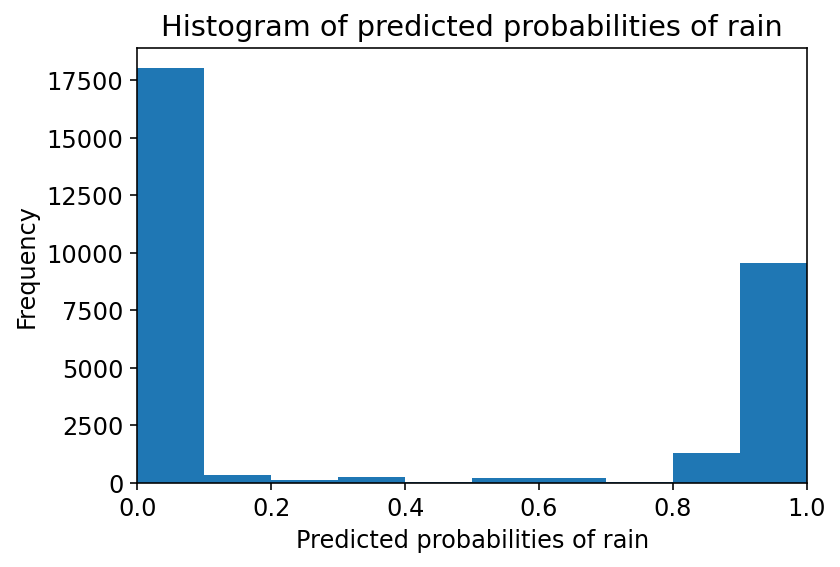

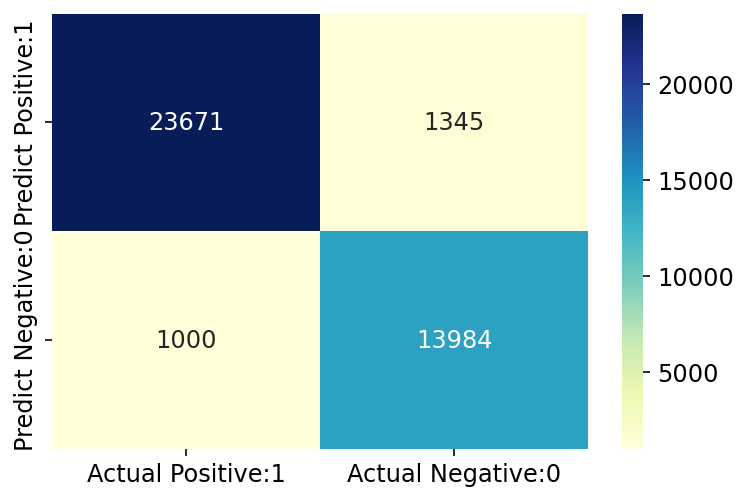

              precision    recall  f1-score   support

           0       0.96      0.95      0.95     25016
           1       0.91      0.93      0.92     14984

    accuracy                           0.94     40000
   macro avg       0.94      0.94      0.94     40000
weighted avg       0.94      0.94      0.94     40000

Classification accuracy : 0.9414


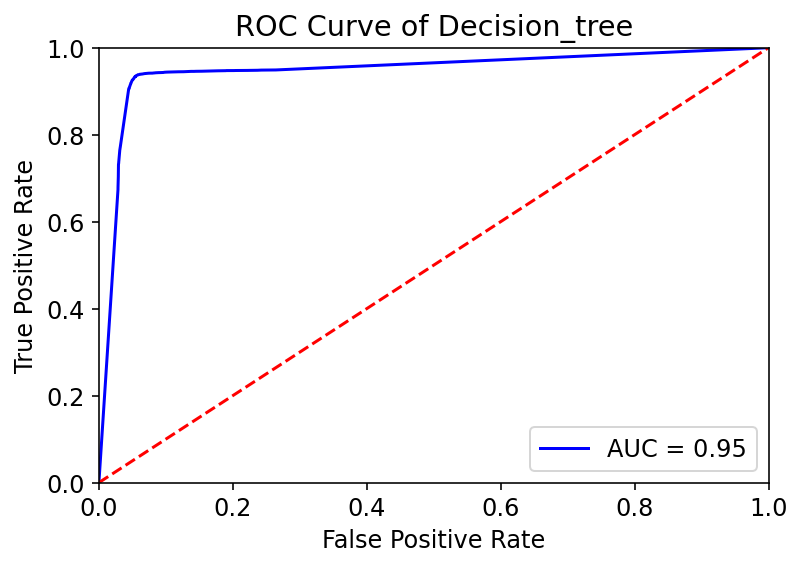

____________________________________________________________________________
6000000


KeyboardInterrupt: ignored

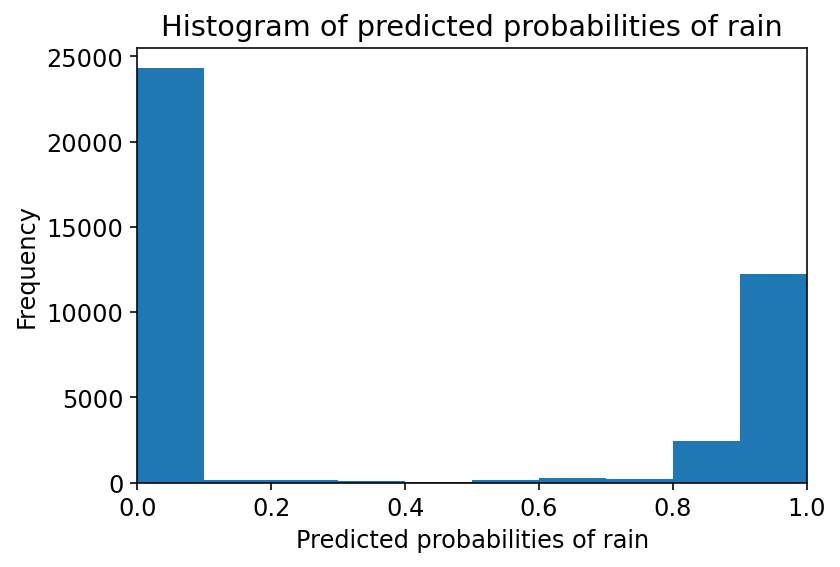

In [ ]:
from scipy.sparse import hstack
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD

for i in range(len(model_datas)):  
  df = model_datas[i]
  
  X = df.drop(['is_attributed','Year','Month','minute'], axis=1)
  y = df['is_attributed']
  print(len(X))

  
  columns = X.columns

  X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
  X = hstack((X,np.array(df['ip'])[:,None]))
  
  lf = TruncatedSVD(100)
  X = lf.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = (scaler.fit_transform(X_train))
  X_test = (scaler.transform(X_test))

  y_pred , y_pred_probab  = Decision_tree_model(X_train , X_test , y_train, y_test)
  evalute_model_Decision_tree(y_pred , y_pred_probab ,y_test)

## Random Forest

In [ ]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

def print_score(clf, X_train, y_train, X_test, y_test, train=True):
    if train:
        pred = clf.predict(X_train)
        clf_report = pd.DataFrame(classification_report(y_train, pred, output_dict=True))
        print("Train Result:\n================================================")
        print(f"Accuracy Score: {accuracy_score(y_train, pred) * 100:.2f}%")
        print("_______________________________________________")
        print(f"CLASSIFICATION REPORT:\n{clf_report}")
        print("_______________________________________________")
        print(f"Confusion Matrix: \n {confusion_matrix(y_train, pred)}\n")
        fpr, tpr, threshold = roc_curve(y_test, clf.predict_proba(X_test)[:,1])
        roc_auc = auc(fpr, tpr)
        plt.title('Receiver Operating Characteristic')
        plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
        plt.legend(loc = 'lower right')
        plt.plot([0, 1], [0, 1],'r--')
        plt.xlim([0, 1])
        plt.ylim([0, 1])
        plt.ylabel('True Positive Rate')
        plt.xlabel('False Positive Rate')
        plt.title('ROC Curve of Decision_tree')
        plt.show()

        print("_______________________________________________")


        plt.rcParams['font.size'] = 12
        plt.hist(y_pred_probab[:,1], bins = 10)
        plt.title('Histogram of predicted probabilities of rain')
        plt.xlim(0,1)
        plt.xlabel('Predicted probabilities of rain')
        plt.ylabel('Frequency')
        plt.show()
        print("_______________________________________________")
    elif train==False:
        pred = clf.predict(X_test)
        clf_report = pd.DataFrame(classification_report(y_test, pred, output_dict=True))
        print("Test Result:\n================================================")        
        print(f"Accuracy Score: {accuracy_score(y_test, pred) * 100:.2f}%")
        print("_______________________________________________")
        print(f"CLASSIFICATION REPORT:\n{clf_report}")
        print("_______________________________________________")
        print(f"Confusion Matrix: \n {confusion_matrix(y_test, pred)}\n")
        fpr, tpr, threshold = roc_curve(y_test, clf.predict_proba(X_test)[:,1])
        roc_auc = auc(fpr, tpr)
        plt.title('Receiver Operating Characteristic')
        plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
        plt.legend(loc = 'lower right')
        plt.plot([0, 1], [0, 1],'r--')
        plt.xlim([0, 1])
        plt.ylim([0, 1])
        plt.ylabel('True Positive Rate')
        plt.xlabel('False Positive Rate')
        plt.title('ROC Curve of Decision_tree')
        plt.show()

        print("_______________________________________________")


        plt.rcParams['font.size'] = 12
        plt.hist(y_pred_probab[:,1], bins = 10)
        plt.title('Histogram of predicted probabilities of rain')
        plt.xlim(0,1)
        plt.xlabel('Predicted probabilities of rain')
        plt.ylabel('Frequency')
        plt.show()
        print("_______________________________________________")


In [ ]:
from sklearn.tree import DecisionTreeClassifier

tree_clf = DecisionTreeClassifier(random_state=42)
tree_clf.fit(X_train, y_train)

print_score(tree_clf, X_train, y_train, X_test, y_test, train=True)
print_score(tree_clf, X_train, y_train, X_test, y_test, train=False)

10000
Train Result:
Accuracy Score: 99.70%
_______________________________________________
CLASSIFICATION REPORT:
                     0            1  accuracy    macro avg  weighted avg
precision     0.995540     0.999648     0.997     0.997594      0.997011
recall        0.999805     0.991972     0.997     0.995889      0.997000
f1-score      0.997668     0.995795     0.997     0.996732      0.996997
support    5135.000000  2865.000000     0.997  8000.000000   8000.000000
_______________________________________________
Confusion Matrix: 
 [[5134    1]
 [  23 2842]]



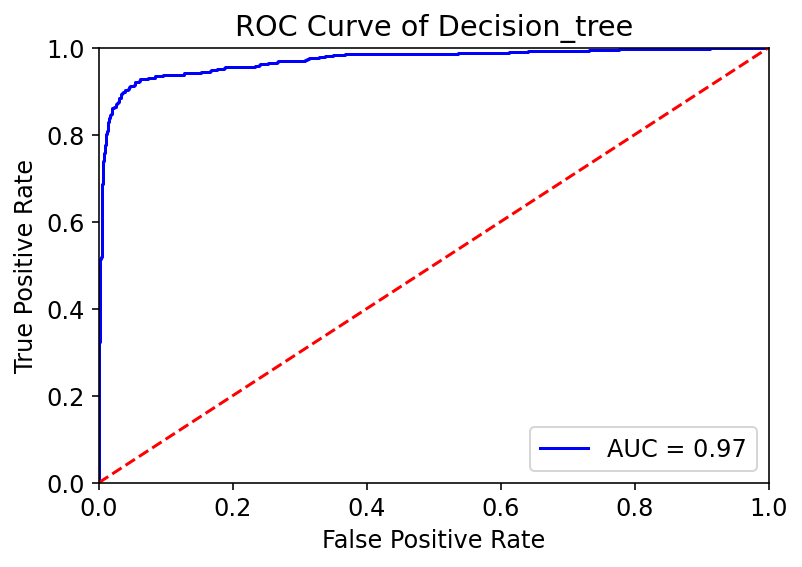

_______________________________________________


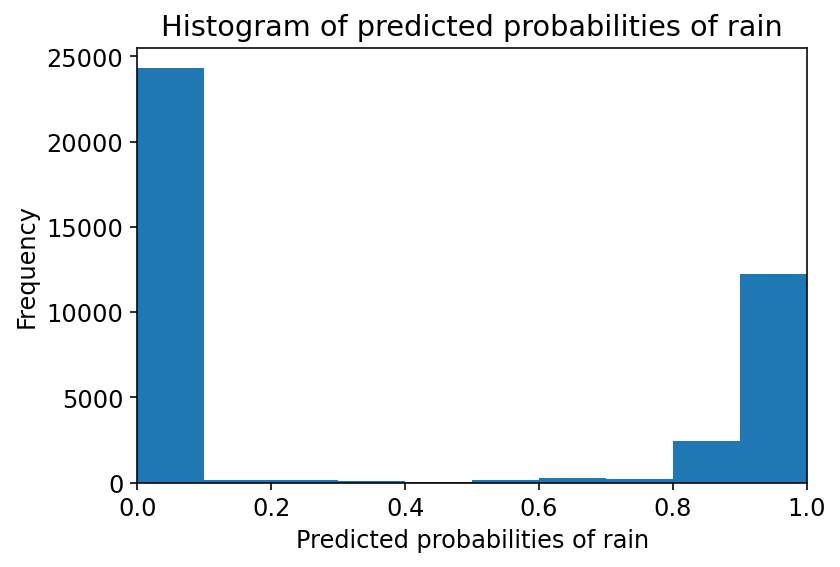

_______________________________________________
Test Result:
Accuracy Score: 93.65%
_______________________________________________
CLASSIFICATION REPORT:
                     0           1  accuracy    macro avg  weighted avg
precision     0.932127    0.945104    0.9365     0.938615      0.936844
recall        0.970935    0.876204    0.9365     0.923569      0.936500
f1-score      0.951135    0.909350    0.9365     0.930243      0.935946
support    1273.000000  727.000000    0.9365  2000.000000   2000.000000
_______________________________________________
Confusion Matrix: 
 [[1236   37]
 [  90  637]]



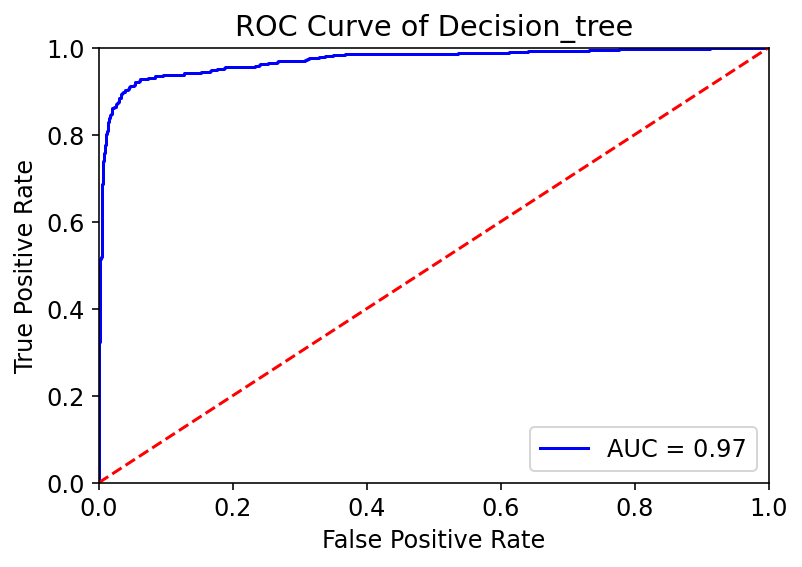

_______________________________________________


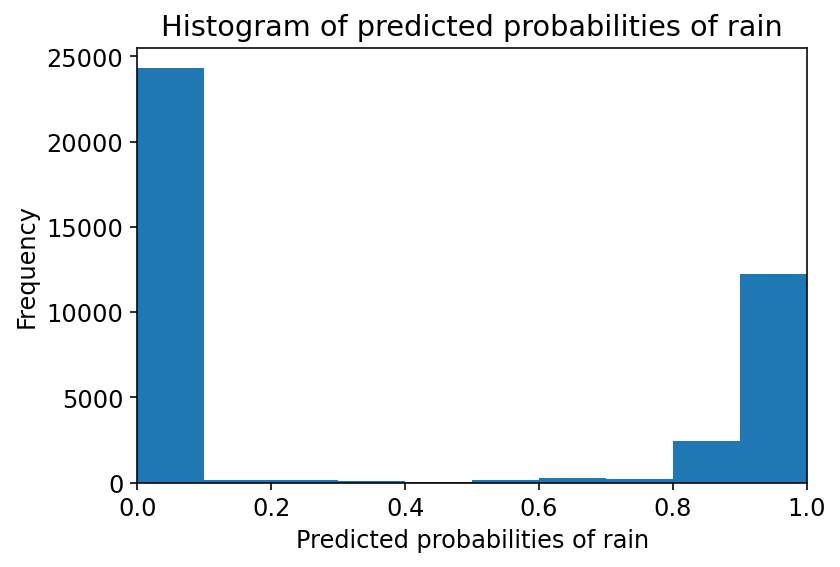

_______________________________________________
50000
Train Result:
Accuracy Score: 98.66%
_______________________________________________
CLASSIFICATION REPORT:
                      0             1  accuracy     macro avg  weighted avg
precision      0.981601      0.995296   0.98655      0.988448      0.986688
recall         0.997295      0.968365   0.98655      0.982830      0.986550
f1-score       0.989386      0.981646   0.98655      0.985516      0.986511
support    25143.000000  14857.000000   0.98655  40000.000000  40000.000000
_______________________________________________
Confusion Matrix: 
 [[25075    68]
 [  470 14387]]



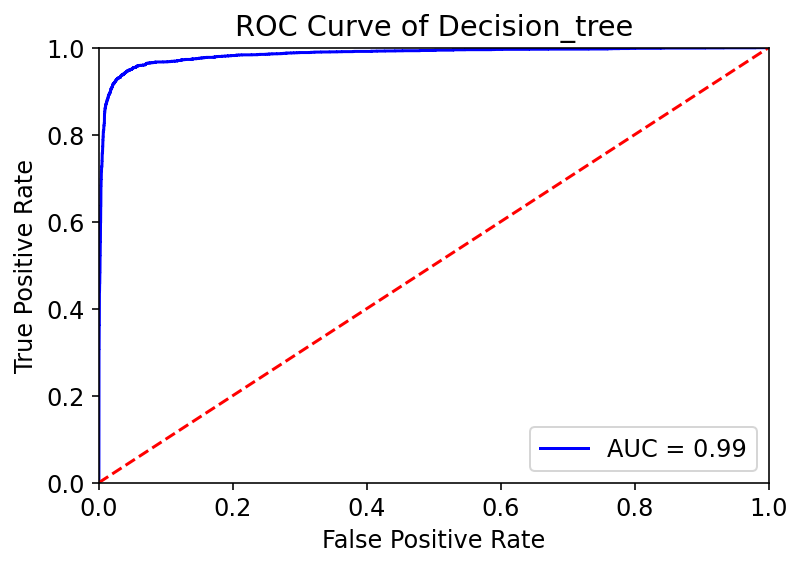

_______________________________________________


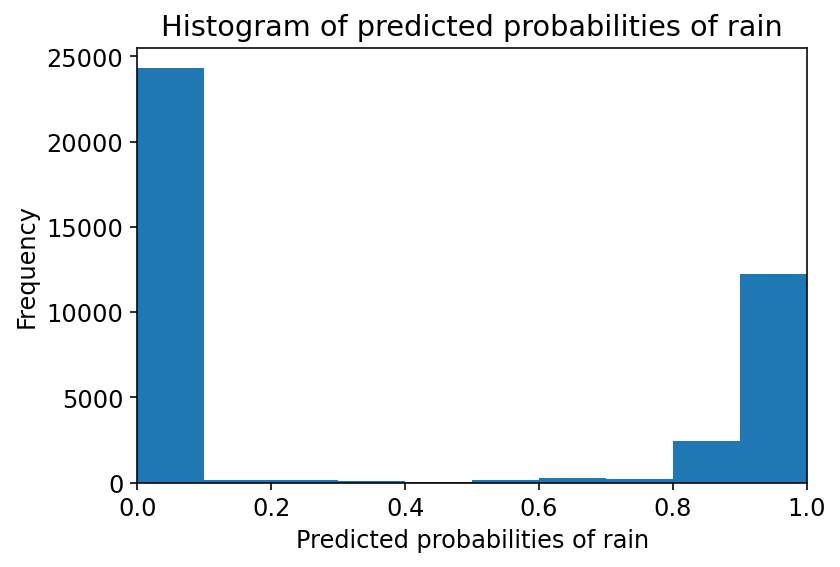

_______________________________________________
Test Result:
Accuracy Score: 95.38%
_______________________________________________
CLASSIFICATION REPORT:
                     0            1  accuracy     macro avg  weighted avg
precision     0.947729     0.964726    0.9538      0.956227      0.954157
recall        0.979736     0.911158    0.9538      0.945447      0.953800
f1-score      0.963467     0.937177    0.9538      0.950322      0.953524
support    6218.000000  3782.000000    0.9538  10000.000000  10000.000000
_______________________________________________
Confusion Matrix: 
 [[6092  126]
 [ 336 3446]]



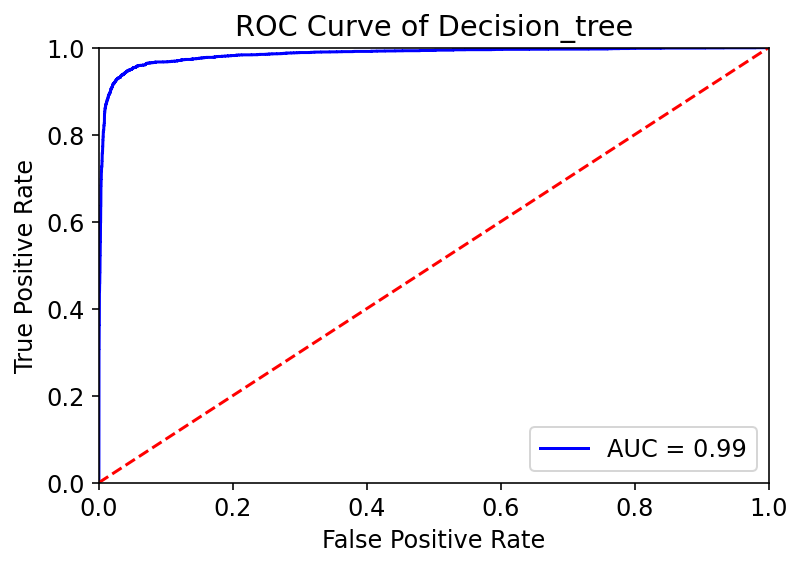

_______________________________________________


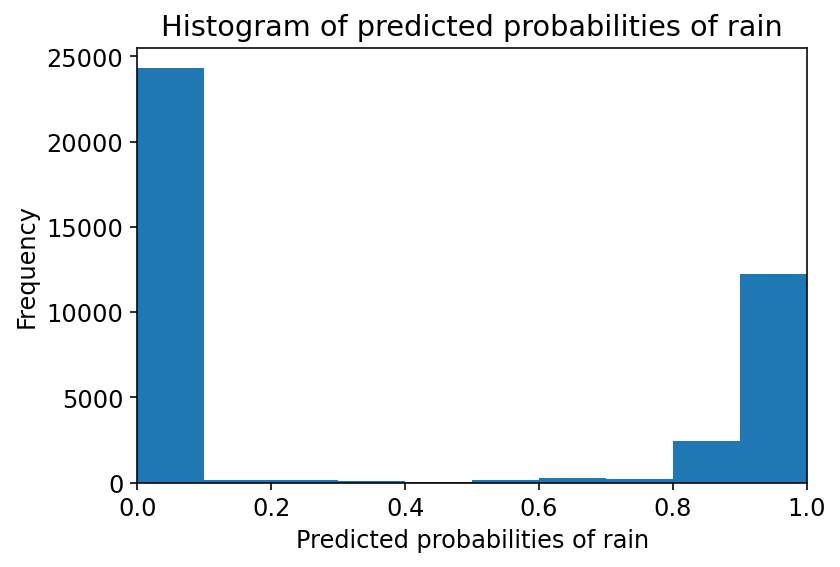

_______________________________________________
100000
Train Result:
Accuracy Score: 98.55%
_______________________________________________
CLASSIFICATION REPORT:
                      0             1  accuracy     macro avg  weighted avg
precision      0.980454      0.994300  0.985525      0.987377      0.985668
recall         0.996652      0.967103  0.985525      0.981877      0.985525
f1-score       0.988486      0.980513  0.985525      0.984500      0.985484
support    49876.000000  30124.000000  0.985525  80000.000000  80000.000000
_______________________________________________
Confusion Matrix: 
 [[49709   167]
 [  991 29133]]



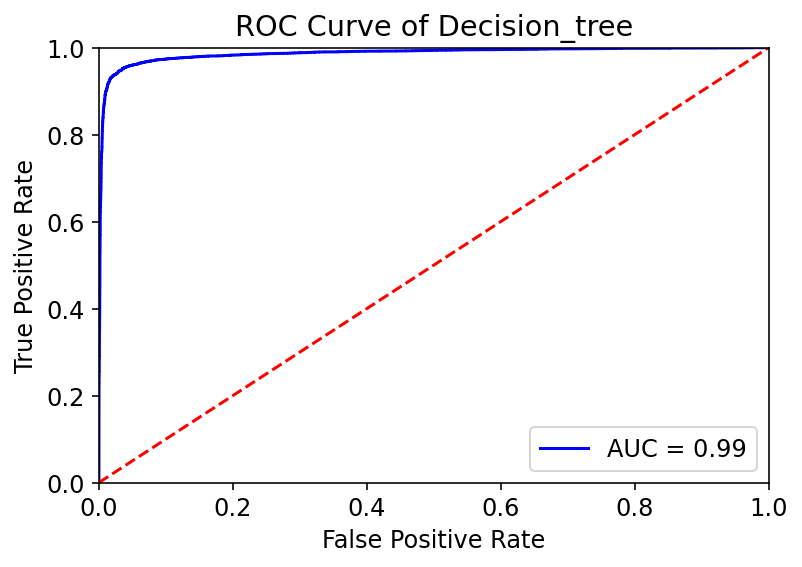

_______________________________________________


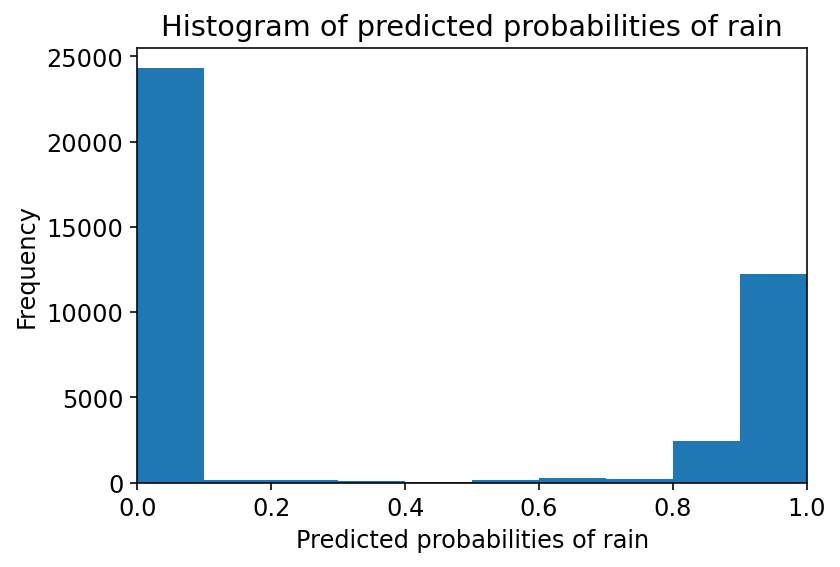

_______________________________________________
Test Result:
Accuracy Score: 96.16%
_______________________________________________
CLASSIFICATION REPORT:
                      0            1  accuracy     macro avg  weighted avg
precision      0.955480     0.972703    0.9616      0.964091      0.961927
recall         0.984496     0.923334    0.9616      0.953915      0.961600
f1-score       0.969771     0.947376    0.9616      0.958573      0.961387
support    12513.000000  7487.000000    0.9616  20000.000000  20000.000000
_______________________________________________
Confusion Matrix: 
 [[12319   194]
 [  574  6913]]



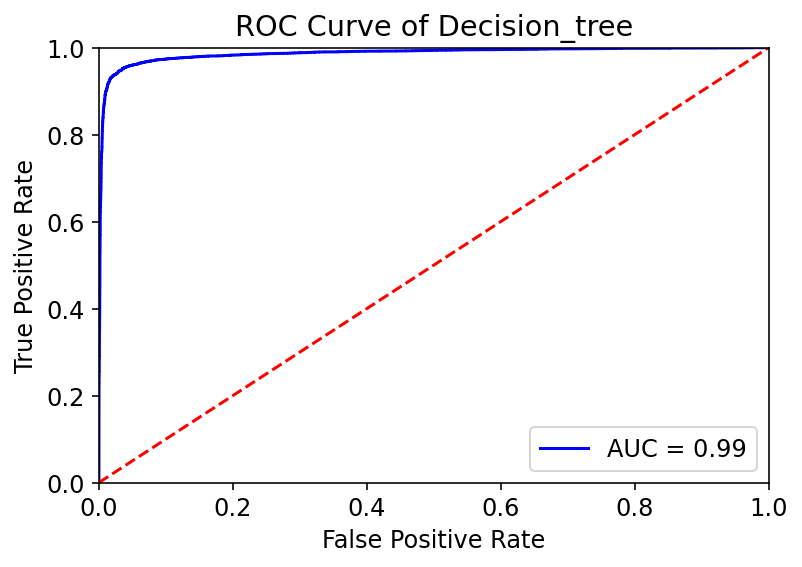

_______________________________________________


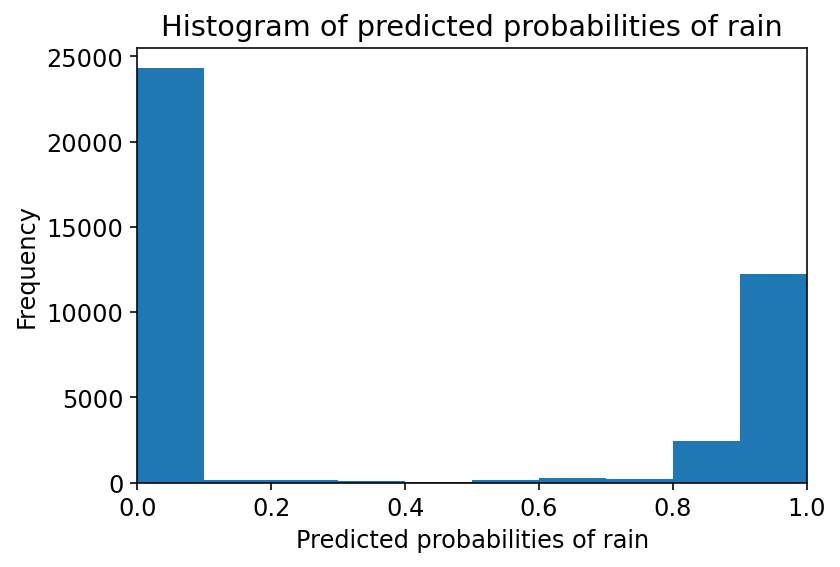

_______________________________________________
150000
Train Result:
Accuracy Score: 98.41%
_______________________________________________
CLASSIFICATION REPORT:
                      0             1  accuracy      macro avg   weighted avg
precision      0.979977      0.991075   0.98405       0.985526       0.984154
recall         0.994749      0.966323   0.98405       0.980536       0.984050
f1-score       0.987308      0.978543   0.98405       0.982925       0.984009
support    74836.000000  45164.000000   0.98405  120000.000000  120000.000000
_______________________________________________
Confusion Matrix: 
 [[74443   393]
 [ 1521 43643]]



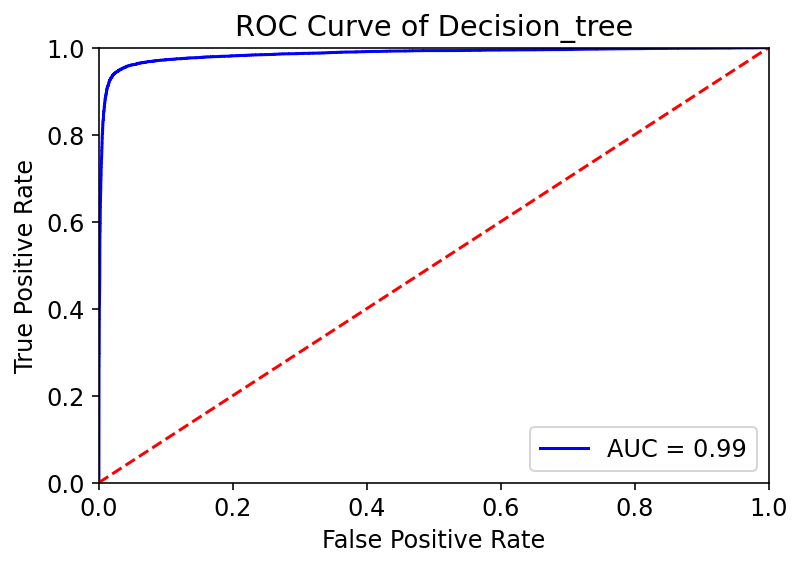

_______________________________________________


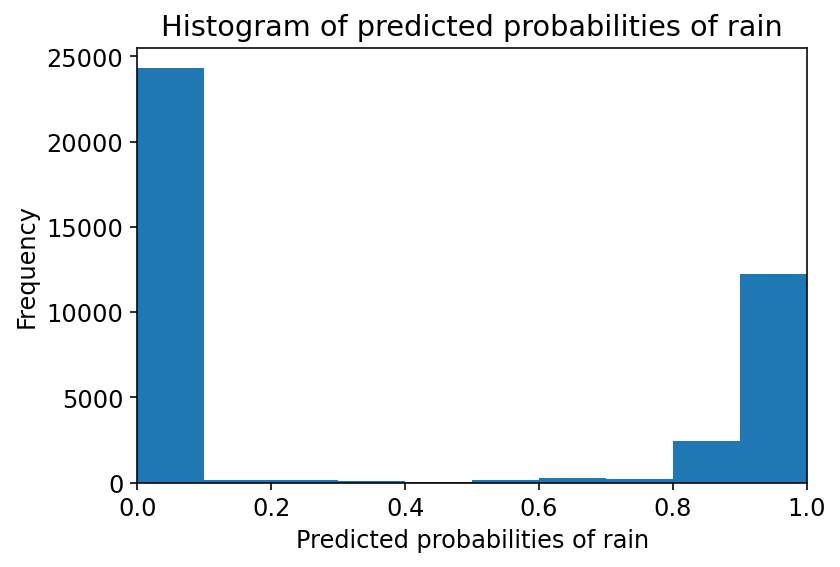

_______________________________________________
Test Result:
Accuracy Score: 96.25%
_______________________________________________
CLASSIFICATION REPORT:
                      0             1  accuracy     macro avg  weighted avg
precision      0.958746      0.969080  0.962467      0.963913      0.962624
recall         0.982177      0.929663  0.962467      0.955920      0.962467
f1-score       0.970320      0.948962  0.962467      0.959641      0.962304
support    18740.000000  11260.000000  0.962467  30000.000000  30000.000000
_______________________________________________
Confusion Matrix: 
 [[18406   334]
 [  792 10468]]



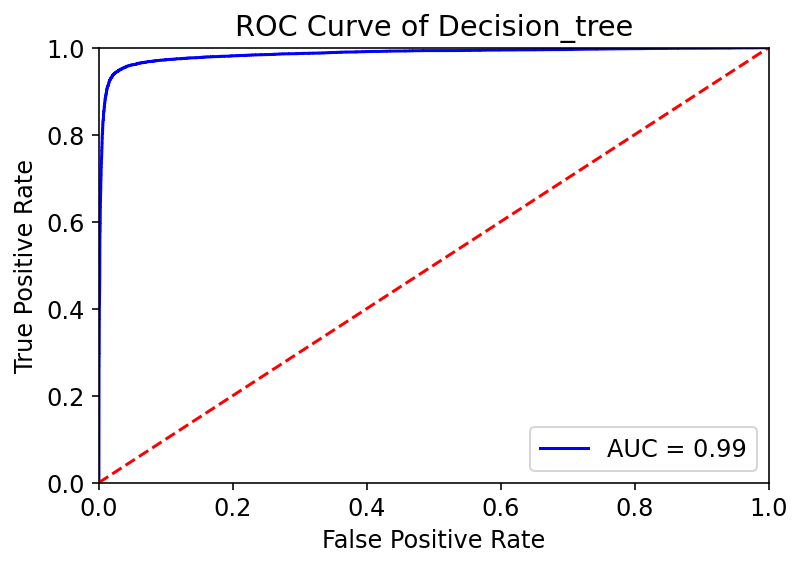

_______________________________________________


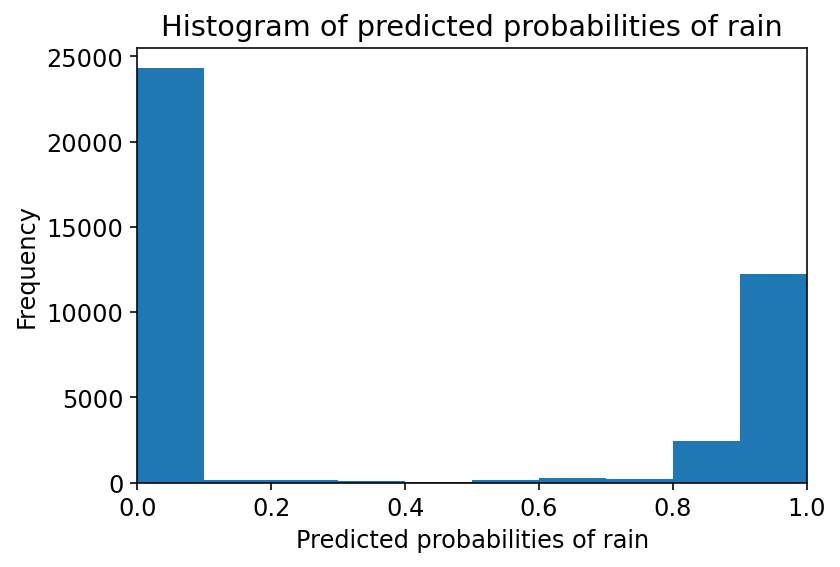

_______________________________________________
200000


KeyboardInterrupt: ignored

In [ ]:
from scipy.sparse import hstack
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD
from sklearn.ensemble import RandomForestClassifier

for i in range(len(model_datas)):  
  df = model_datas[i]
  
  X = df.drop(['is_attributed','Year','Month','minute'], axis=1)
  y = df['is_attributed']
  print(len(X))

  
  columns = X.columns

  X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
  X = hstack((X,np.array(df['ip'])[:,None]))
  
  lf = TruncatedSVD(100)
  X = lf.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = (scaler.fit_transform(X_train))
  X_test = (scaler.transform(X_test))

  tree_clf = RandomForestClassifier(max_depth=20, random_state=42)
  tree_clf.fit(X_train, y_train)

  print_score(tree_clf, X_train, y_train, X_test, y_test, train=True)
  print_score(tree_clf, X_train, y_train, X_test, y_test, train=False)

100000
Train Result:
Accuracy Score: 99.43%
_______________________________________________
CLASSIFICATION REPORT:
                      0            1  accuracy     macro avg  weighted avg
precision      0.994089     1.000000  0.994287      0.997044      0.994321
recall         1.000000     0.854736  0.994287      0.927368      0.994287
f1-score       0.997036     0.921680  0.994287      0.959358      0.994072
support    76854.000000  3146.000000  0.994287  80000.000000  80000.000000
_______________________________________________
Confusion Matrix: 
 [[76854     0]
 [  457  2689]]



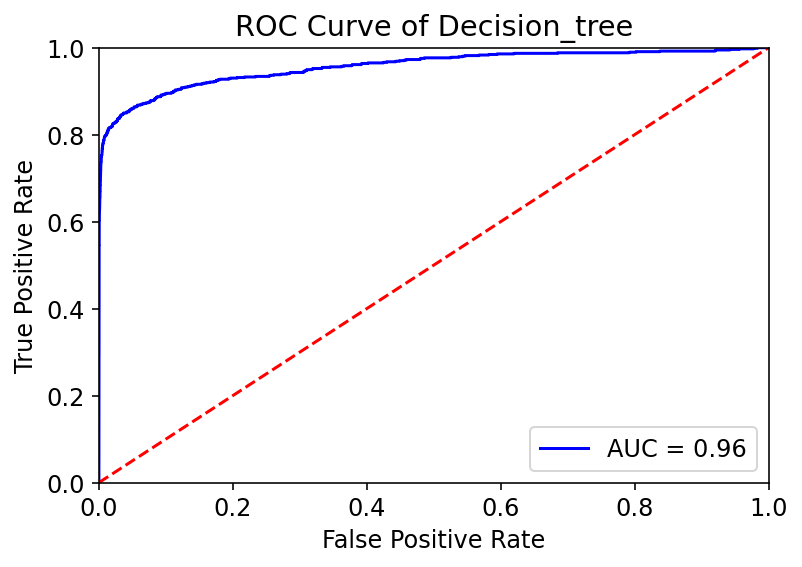

_______________________________________________


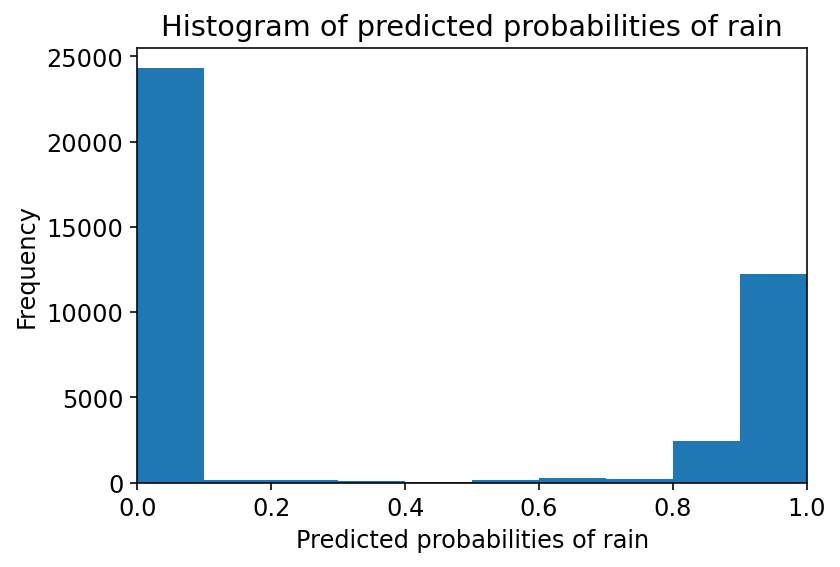

_______________________________________________
Test Result:
Accuracy Score: 98.65%
_______________________________________________
CLASSIFICATION REPORT:
                      0           1  accuracy     macro avg  weighted avg
precision      0.990123    0.879154   0.98645      0.934639      0.985834
recall         0.995839    0.752911   0.98645      0.874375      0.986450
f1-score       0.992973    0.811150   0.98645      0.902061      0.985945
support    19227.000000  773.000000   0.98645  20000.000000  20000.000000
_______________________________________________
Confusion Matrix: 
 [[19147    80]
 [  191   582]]



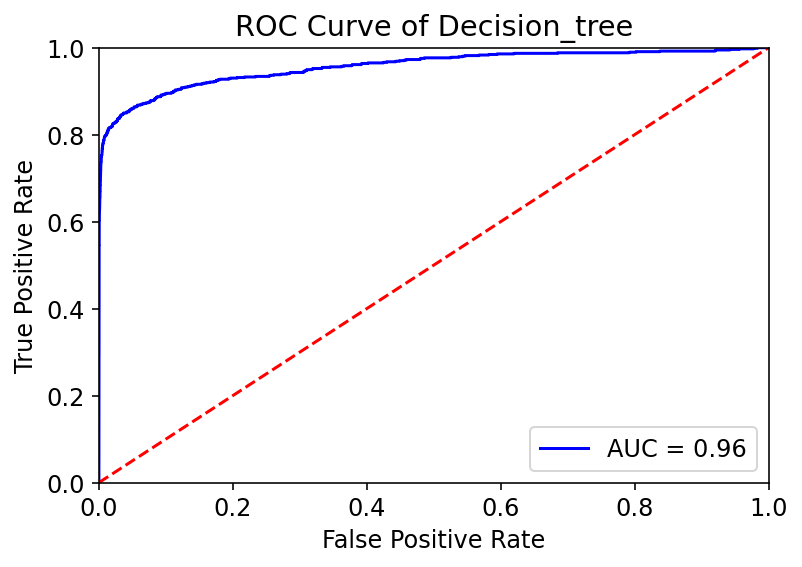

_______________________________________________


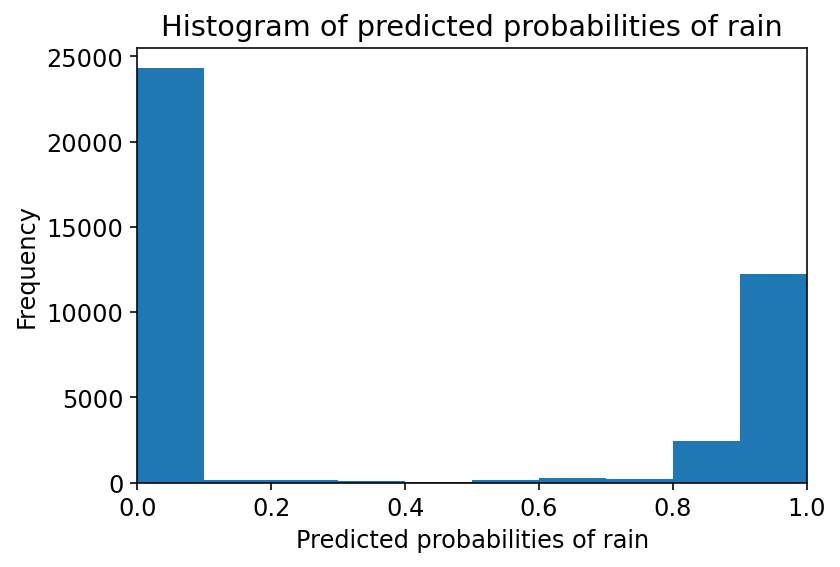

_______________________________________________
100000
Train Result:
Accuracy Score: 99.43%
_______________________________________________
CLASSIFICATION REPORT:
                      0            1  accuracy     macro avg  weighted avg
precision      0.994089     1.000000  0.994287      0.997044      0.994321
recall         1.000000     0.854736  0.994287      0.927368      0.994287
f1-score       0.997036     0.921680  0.994287      0.959358      0.994072
support    76854.000000  3146.000000  0.994287  80000.000000  80000.000000
_______________________________________________
Confusion Matrix: 
 [[76854     0]
 [  457  2689]]



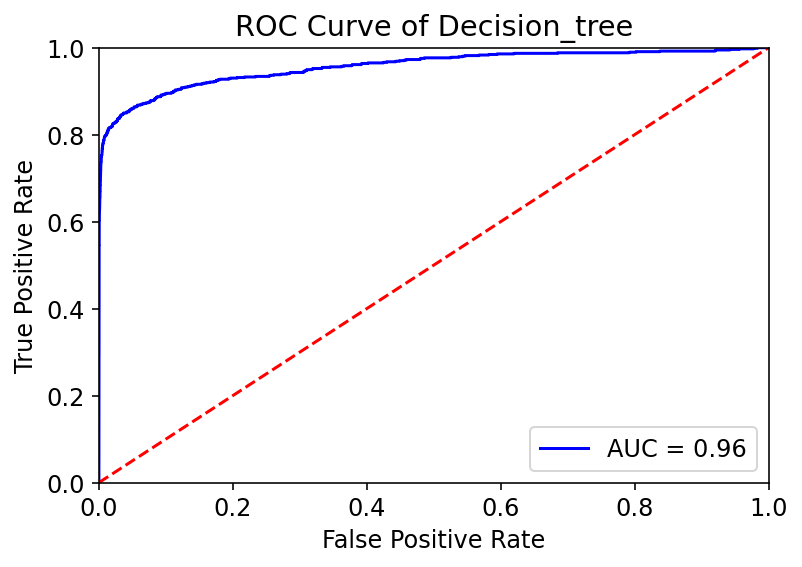

_______________________________________________


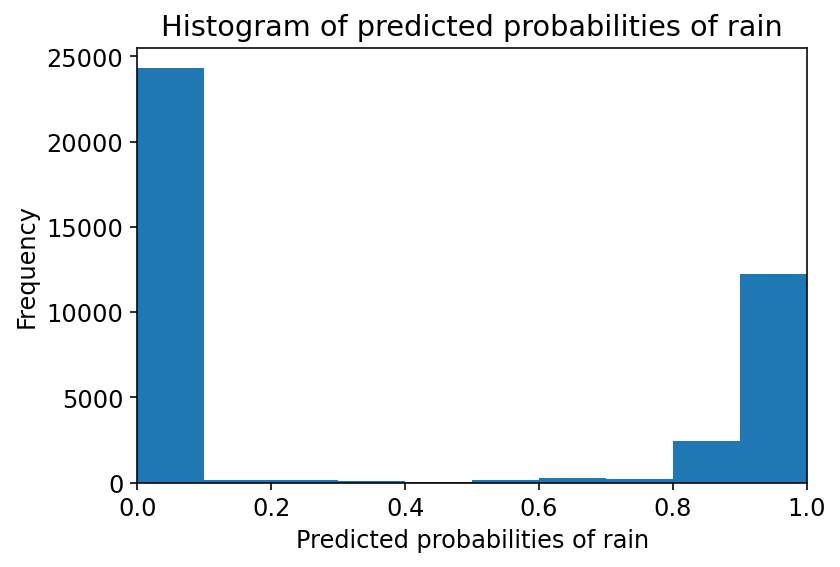

_______________________________________________
Test Result:
Accuracy Score: 98.65%
_______________________________________________
CLASSIFICATION REPORT:
                      0           1  accuracy     macro avg  weighted avg
precision      0.990123    0.879154   0.98645      0.934639      0.985834
recall         0.995839    0.752911   0.98645      0.874375      0.986450
f1-score       0.992973    0.811150   0.98645      0.902061      0.985945
support    19227.000000  773.000000   0.98645  20000.000000  20000.000000
_______________________________________________
Confusion Matrix: 
 [[19147    80]
 [  191   582]]



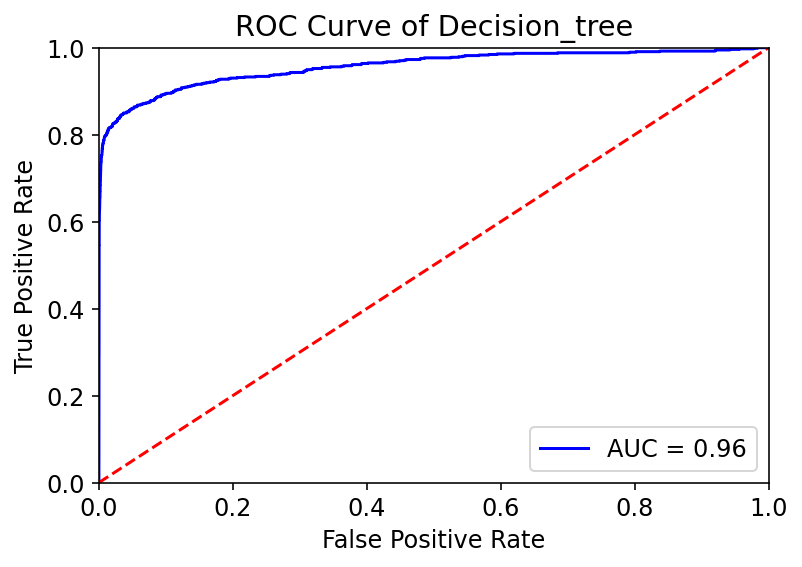

_______________________________________________


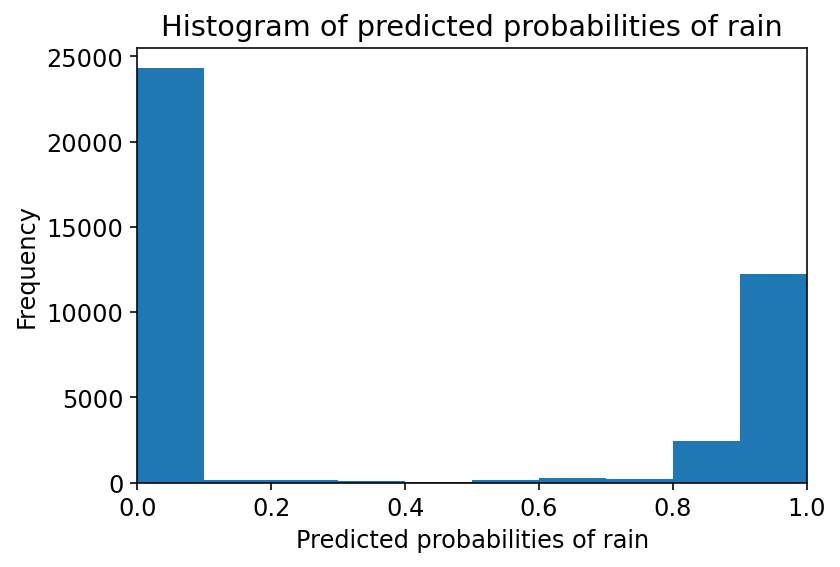

_______________________________________________
100000
Train Result:
Accuracy Score: 99.43%
_______________________________________________
CLASSIFICATION REPORT:
                      0            1  accuracy     macro avg  weighted avg
precision      0.994089     1.000000  0.994287      0.997044      0.994321
recall         1.000000     0.854736  0.994287      0.927368      0.994287
f1-score       0.997036     0.921680  0.994287      0.959358      0.994072
support    76854.000000  3146.000000  0.994287  80000.000000  80000.000000
_______________________________________________
Confusion Matrix: 
 [[76854     0]
 [  457  2689]]



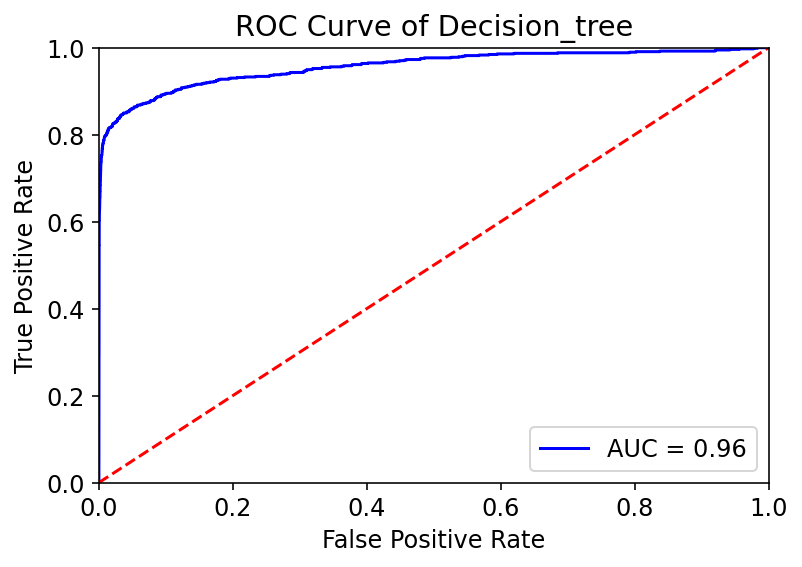

_______________________________________________


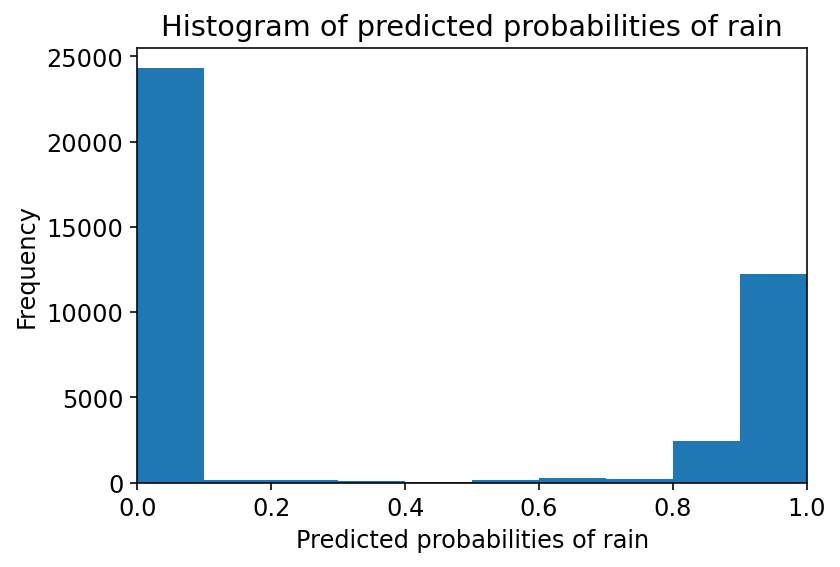

_______________________________________________
Test Result:
Accuracy Score: 98.65%
_______________________________________________
CLASSIFICATION REPORT:
                      0           1  accuracy     macro avg  weighted avg
precision      0.990123    0.879154   0.98645      0.934639      0.985834
recall         0.995839    0.752911   0.98645      0.874375      0.986450
f1-score       0.992973    0.811150   0.98645      0.902061      0.985945
support    19227.000000  773.000000   0.98645  20000.000000  20000.000000
_______________________________________________
Confusion Matrix: 
 [[19147    80]
 [  191   582]]



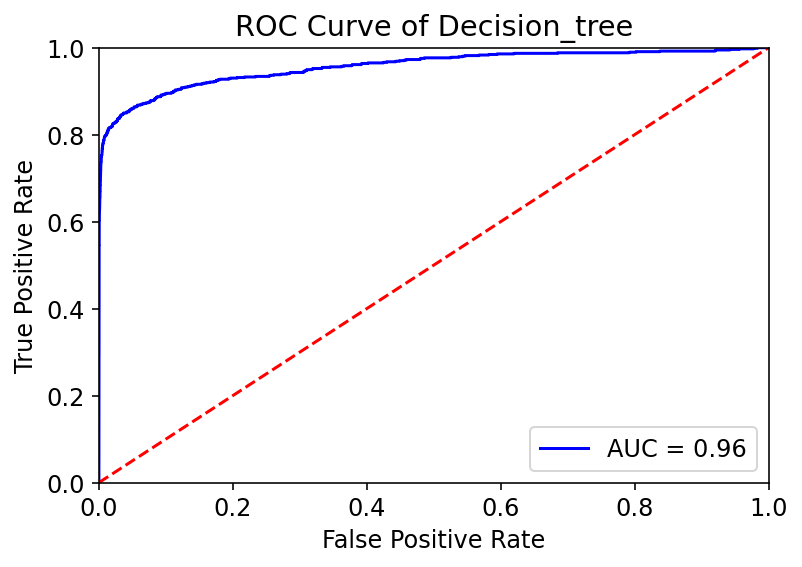

_______________________________________________


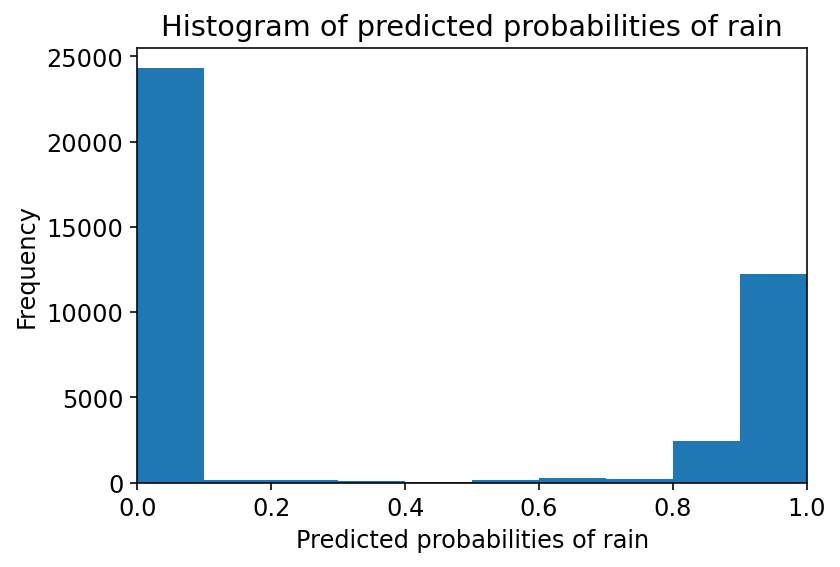

_______________________________________________
100000


KeyboardInterrupt: ignored

In [ ]:
from scipy.sparse import hstack
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD
from sklearn.ensemble import RandomForestClassifier

for i in range(len(model_datas)):  
  df = resample_data(test,100000)
  
  X = df.drop(['is_attributed','Year','Month','minute'], axis=1)
  y = df['is_attributed']
  print(len(X))

  
  columns = X.columns

  # X = OneHotEncoder().fit_transform(X.drop(columns= ['ip']))
  # X = hstack((X,np.array(df['ip'])[:,None]))
  
  # lf = TruncatedSVD(100)
  # X = lf.fit_transform(X)

  X_train, X_test, y_train, y_test = train_test_split(
      X, y, test_size=0.20,random_state=0)
  
  scaler = StandardScaler()
  X_train = (scaler.fit_transform(X_train))
  X_test = (scaler.transform(X_test))

  tree_clf = RandomForestClassifier(max_depth=20, random_state=42)
  tree_clf.fit(X_train, y_train)

  print_score(tree_clf, X_train, y_train, X_test, y_test, train=True)
  print_score(tree_clf, X_train, y_train, X_test, y_test, train=False)

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

params = {
    "criterion":("gini", "entropy"), 
    "splitter":("best", "random"), 
    "max_depth":(list(range(1, 20))), 
    "min_samples_split":[2, 3, 4], 
    "min_samples_leaf":list(range(1, 20)), 
}


tree_clf = DecisionTreeClassifier(random_state=42)
tree_cv = GridSearchCV(tree_clf, params, scoring="accuracy", n_jobs=-1, verbose=1, cv=3)
tree_cv.fit(X_train, y_train)
best_params = tree_cv.best_params_
print(f"Best paramters: {best_params})")

tree_clf = DecisionTreeClassifier(**best_params)
tree_clf.fit(X_train, y_train)
print_score(tree_clf, X_train, y_train, X_test, y_test, train=True)
print_score(tree_clf, X_train, y_train, X_test, y_test, train=False)

In [ ]:
#Visualization of a tree
from IPython.display import Image
from six import StringIO
from sklearn.tree import export_graphviz
import pydot

features = list(X_train.columns)
# features.remove("Attrition")

dot_data = StringIO()
export_graphviz(tree_clf, out_file=dot_data, feature_names=features, filled=True)
graph = pydot.graph_from_dot_data(dot_data.getvalue())
Image(graph[0].create_png())


## Random Forest hyperparameter tuning

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV

n_estimators = [int(x) for x in np.linspace(start=200, stop=2000, num=10)]
max_features = ['auto', 'sqrt']
max_depth = [int(x) for x in np.linspace(10, 110, num=11)]
max_depth.append(None)
min_samples_split = [2, 5, 10]
min_samples_leaf = [1, 2, 4]
bootstrap = [True, False]

random_grid = {'n_estimators': n_estimators, 'max_features': max_features,
               'max_depth': max_depth, 'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf, 'bootstrap': bootstrap}

rf_clf = RandomForestClassifier(random_state=42)

rf_cv = RandomizedSearchCV(estimator=rf_clf, scoring='f1',param_distributions=random_grid, n_iter=100, cv=3, 
                               verbose=2, random_state=42, n_jobs=-1)

rf_cv.fit(X_train, y_train)
rf_best_params = rf_cv.best_params_
print(f"Best paramters: {rf_best_params})")

rf_clf = RandomForestClassifier(**rf_best_params)
rf_clf.fit(X_train, y_train)

print_score(rf_clf, X_train, y_train, X_test, y_test, train=True)
print_score(rf_clf, X_train, y_train, X_test, y_test, train=False)

Fitting 3 folds for each of 100 candidates, totalling 300 fits


KeyboardInterrupt: ignored

# XGBoost

In [ ]:
def feature_extraction(df):
    df['date'] = pd.to_datetime(df['click_time'])
    df['dayOfWeek'] = df['date'].dt.dayofweek.astype('uint16')
    df['dayOfYear'] = df['date'].dt.dayofyear.astype('uint16')
    df['hour'] = df['date'].dt.hour.astype('uint8')
    df['min'] = df['date'].dt.minute.astype('uint8')
    df['sec'] = df['date'].dt.second.astype('uint8')
    df.drop(['date','click_time'], axis= 1, inplace=True)
    return df

In [ ]:
# Set the params for xgboost model
params = {'eta': 0.3,
          'tree_method': "hist",
          'grow_policy': "lossguide",
          'max_leaves': 1400,  
          'max_depth': 0, 
          'subsample': 0.9, 
          'colsample_bytree': 0.7, 
          'colsample_bylevel':0.7,
          'min_child_weight':0,
          'alpha':4,
          'objective': 'binary:logistic', 
          'scale_pos_weight':9,
          'eval_metric': 'auc', 
          'nthread':8,
          'random_state': 99, 
          'silent': True}

In [ ]:
dtrain = xgb.DMatrix(X_train, y_train)
dvalid = xgb.DMatrix(X_test, y_test)
del X_train, y_train
gc.collect()
watchlist = [(dtrain, 'train'), (dvalid, 'valid')]
model = xgb.train(params, dtrain, 200, watchlist, maximize=True, early_stopping_rounds = 20, verbose_eval=5)
del dvalid

print("Validating...")
check = model.predict(xgb.DMatrix(X_test), ntree_limit=model.best_iteration+1)

[0]	train-auc:0.972486	valid-auc:0.968406
Multiple eval metrics have been passed: 'valid-auc' will be used for early stopping.

Will train until valid-auc hasn't improved in 20 rounds.
[5]	train-auc:0.990911	valid-auc:0.988341
[10]	train-auc:0.994626	valid-auc:0.99154
[15]	train-auc:0.996418	valid-auc:0.992903
[20]	train-auc:0.998013	valid-auc:0.994279
[25]	train-auc:0.998386	valid-auc:0.994799
[30]	train-auc:0.998798	valid-auc:0.994858
[35]	train-auc:0.998999	valid-auc:0.994892
[40]	train-auc:0.999146	valid-auc:0.994862
[45]	train-auc:0.999329	valid-auc:0.994946
[50]	train-auc:0.999417	valid-auc:0.994922
[55]	train-auc:0.999489	valid-auc:0.99493
[60]	train-auc:0.999551	valid-auc:0.995052
[65]	train-auc:0.999599	valid-auc:0.995028
[70]	train-auc:0.999632	valid-auc:0.994988
[75]	train-auc:0.999657	valid-auc:0.994935
Stopping. Best iteration:
[59]	train-auc:0.999548	valid-auc:0.99506

Validating...


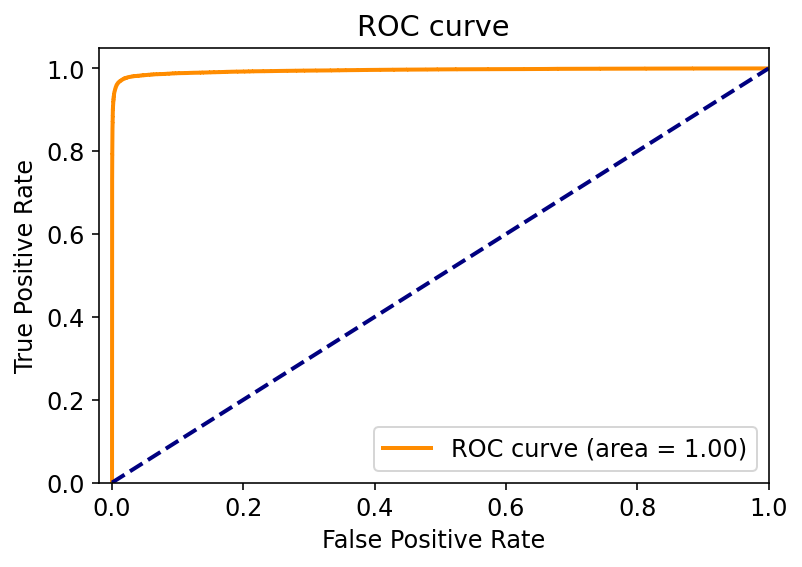

In [ ]:
from sklearn.metrics import roc_curve, auc
# Compute micro-average ROC curve and ROC area
fpr, tpr, _ = roc_curve(y_test.values, check)
roc_auc = auc(fpr, tpr)
plt.figure()
lw = 2
plt.plot(fpr, tpr, color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([-0.02, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curve')
plt.legend(loc="lower right")
plt.show()

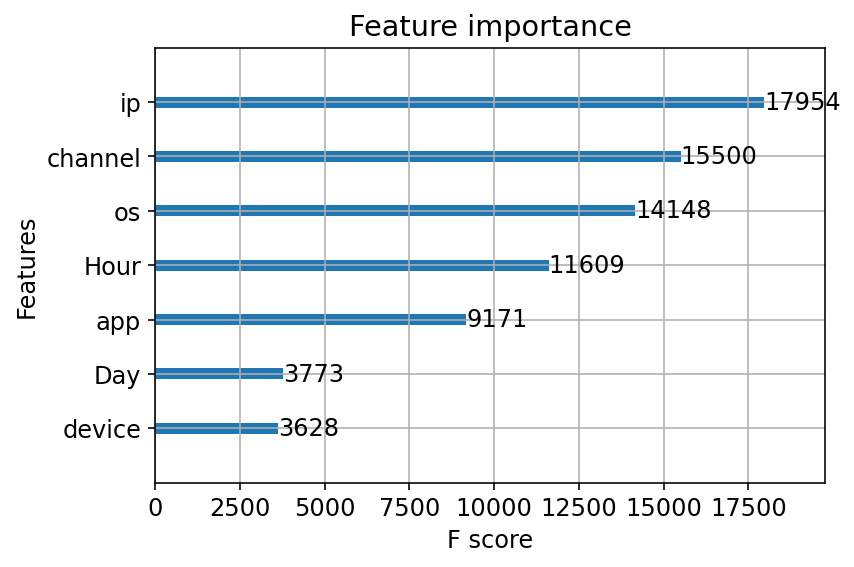

In [ ]:
# Plot the feature importances from xgboost
plot_importance(model)
plt.gcf().savefig('xgb_feature_importance_v2_downsample_roc.png')

# Naive Bayse

## Featrue Scalling

In [ ]:
cols = X_train.columns

In [ ]:
from sklearn.preprocessing import RobustScaler

scaler = RobustScaler()

X_train = scaler.fit_transform(X_train)

X_test = scaler.transform(X_test)

NameError: ignored

In [ ]:
X_train

array([[ 1.42800024,  4.42259428,  0.02108639, ...,  0.04320795,
         1.33278615,  0.64357772],
       [ 0.37264386, -0.25330107,  0.11489228, ...,  1.61285451,
        -0.94052612, -0.85897633],
       [-1.39290723, -0.26542525, -0.82316664, ...,  1.730578  ,
         0.19613002, -0.09659156],
       ...,
       [-0.85749224, -0.1059164 ,  0.58392175, ..., -1.48719743,
         1.33278615,  0.61692097],
       [ 1.38649023, -0.27628651,  9.21406387, ..., -0.15299786,
        -0.94052612, -2.33086544],
       [-0.22871969,  0.60739002,  0.58392175, ..., -1.48719743,
        -2.07718225, -0.8463897 ]])

In [ ]:
X_train = pd.DataFrame(X_train, columns=[cols])

In [ ]:
X_test = pd.DataFrame(X_test, columns=[cols])

In [ ]:
X_train

NameError: ignored

In [ ]:
from sklearn.naive_bayes import GaussianNB


# instantiate the model
gnb = GaussianNB()


# fit the model
gnb.fit(X_train, y_train)

GaussianNB()

In [ ]:
y_pred = gnb.predict(X_test)

y_pred

array([1, 0, 0, ..., 0, 0, 0], dtype=uint16)

In [ ]:
from sklearn.metrics import accuracy_score

print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test, y_pred)))

Model accuracy score: 0.9452


In [ ]:
y_pred_train = gnb.predict(X_train)

y_pred_train

array([1, 1, 1, ..., 1, 1, 1], dtype=uint16)

In [ ]:
print('Training-set accuracy score: {0:0.4f}'. format(accuracy_score(y_train, y_pred_train)))


Training-set accuracy score: 0.3556


In [ ]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(gnb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(gnb.score(X_test, y_test)))

Training set score: 0.3556
Test set score: 0.3577


In [ ]:
# check class distribution in test set

y_test.value_counts()

0    66612
1    33388
Name: is_attributed, dtype: int64

In [ ]:
# check null accuracy score

null_accuracy = (7407/(7407+2362))

print('Null accuracy score: {0:0.4f}'. format(null_accuracy))

Null accuracy score: 0.7582


In [ ]:
# Print the Confusion Matrix and slice it into four pieces

from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_test, y_pred)

print('Confusion matrix\n\n', cm)

print('\nTrue Positives(TP) = ', cm[0,0])

print('\nTrue Negatives(TN) = ', cm[1,1])

print('\nFalse Positives(FP) = ', cm[0,1])

print('\nFalse Negatives(FN) = ', cm[1,0])

Confusion matrix

 [[ 2932 63680]
 [  547 32841]]

True Positives(TP) =  2932

True Negatives(TN) =  32841

False Positives(FP) =  63680

False Negatives(FN) =  547


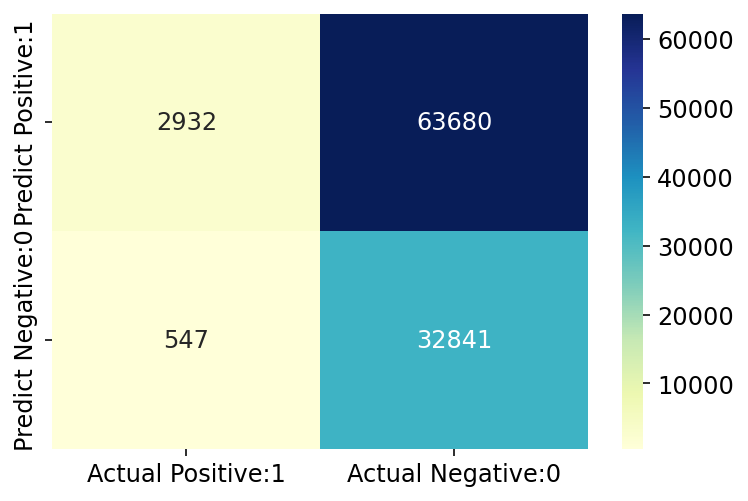

In [ ]:
# visualize confusion matrix with seaborn heatmap

cm_matrix = pd.DataFrame(data=cm, columns=['Actual Positive:1', 'Actual Negative:0'], 
                                 index=['Predict Positive:1', 'Predict Negative:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.84      0.04      0.08     66612
           1       0.34      0.98      0.51     33388

    accuracy                           0.36    100000
   macro avg       0.59      0.51      0.29    100000
weighted avg       0.67      0.36      0.22    100000



In [ ]:
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

In [ ]:
# print classification accuracy

classification_accuracy = (TP + TN) / float(TP + TN + FP + FN)

print('Classification accuracy : {0:0.4f}'.format(classification_accuracy))

Classification accuracy : 0.3577


In [ ]:
# print classification error

classification_error = (FP + FN) / float(TP + TN + FP + FN)

print('Classification error : {0:0.4f}'.format(classification_error))

Classification error : 0.6423


In [ ]:
# print precision score

precision = TP / float(TP + FP)


print('Precision : {0:0.4f}'.format(precision))

Precision : 0.0440


In [ ]:
recall = TP / float(TP + FN)

print('Recall or Sensitivity : {0:0.4f}'.format(recall))

Recall or Sensitivity : 0.8428


In [ ]:
true_positive_rate = TP / float(TP + FN)


print('True Positive Rate : {0:0.4f}'.format(true_positive_rate))

True Positive Rate : 0.8428


In [ ]:
false_positive_rate = FP / float(FP + TN)


print('False Positive Rate : {0:0.4f}'.format(false_positive_rate))

False Positive Rate : 0.6598


In [ ]:
specificity = TN / (TN + FP)

print('Specificity : {0:0.4f}'.format(specificity))

Specificity : 0.3402


In [ ]:
# print the first 10 predicted probabilities of two classes- 0 and 1

y_pred_prob = gnb.predict_proba(X_test)[0:10]

y_pred_prob

array([[2.54581255e-03, 9.97454187e-01],
       [2.57656223e-03, 9.97423438e-01],
       [4.64925799e-03, 9.95350742e-01],
       [7.55090872e-04, 9.99244909e-01],
       [4.56692008e-02, 9.54330799e-01],
       [5.29893612e-03, 9.94701064e-01],
       [3.08457267e-01, 6.91542733e-01],
       [1.29632049e-03, 9.98703680e-01],
       [2.93730157e-03, 9.97062698e-01],
       [9.42597596e-01, 5.74024044e-02]])

In [ ]:
# store the probabilities in dataframe

y_pred_prob_df = pd.DataFrame(data=y_pred_prob, columns=['Prob of - <=50K', 'Prob of - >50K'])

y_pred_prob_df

,Prob of - <=50K,Prob of - >50K
0,0.002546,0.997454
1,0.002577,0.997423
2,0.004649,0.995351
3,0.000755,0.999245
4,0.045669,0.954331
5,0.005299,0.994701
6,0.308457,0.691543
7,0.001296,0.998704
8,0.002937,0.997063
9,0.942598,0.057402


In [ ]:
# print the first 10 predicted probabilities for class 1 - Probability of >50K

gnb.predict_proba(X_test)[0:10, 1]

array([0.99745419, 0.99742344, 0.99535074, 0.99924491, 0.9543308 ,
       0.99470106, 0.69154273, 0.99870368, 0.9970627 , 0.0574024 ])

In [ ]:
# store the predicted probabilities for class 1 - Probability of >50K

y_pred1 = gnb.predict_proba(X_test)[:, 1]

Text(0, 0.5, 'Frequency')

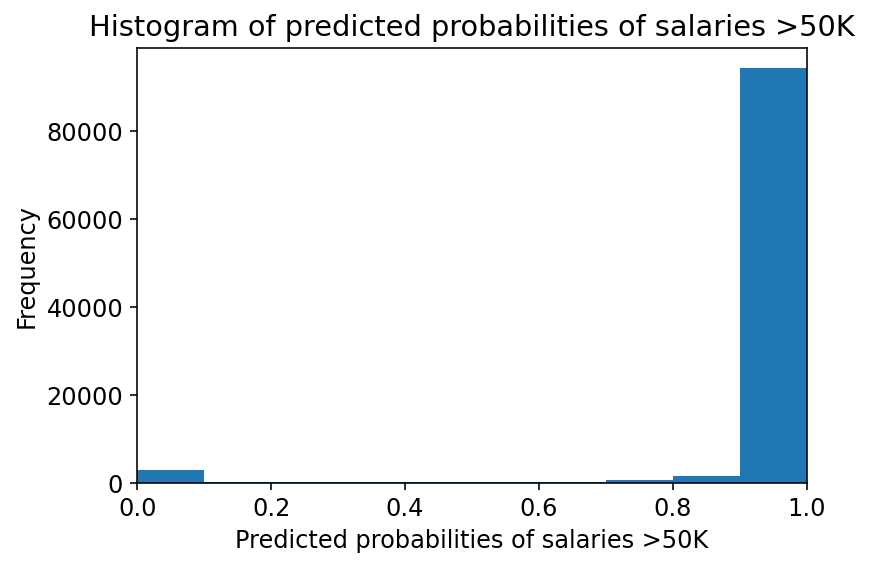

In [ ]:
# plot histogram of predicted probabilities


# adjust the font size 
plt.rcParams['font.size'] = 12


# plot histogram with 10 bins
plt.hist(y_pred1, bins = 10)


# set the title of predicted probabilities
plt.title('Histogram of predicted probabilities of salaries >50K')


# set the x-axis limit
plt.xlim(0,1)


# set the title
plt.xlabel('Predicted probabilities of salaries >50K')
plt.ylabel('Frequency')

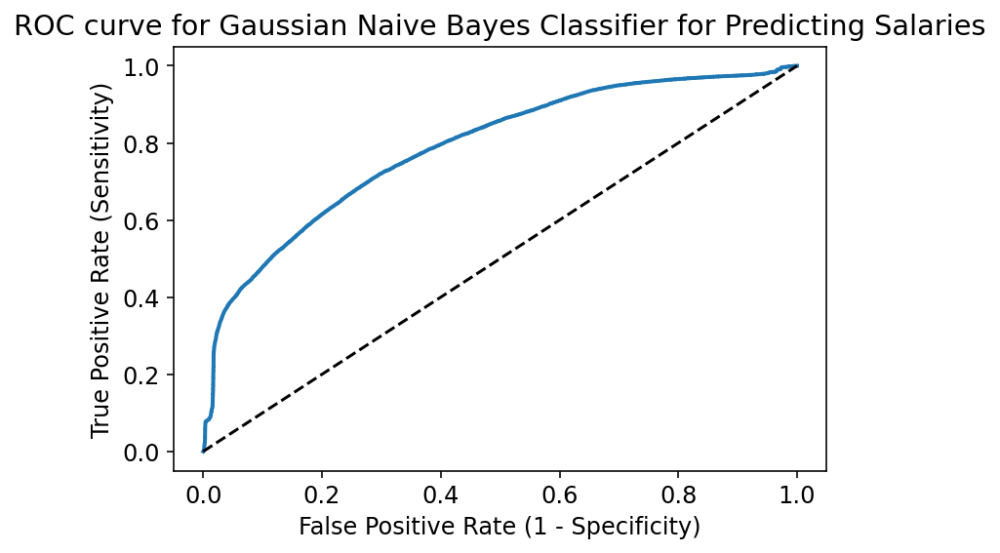

In [ ]:
# plot ROC Curve

from sklearn.metrics import roc_curve

fpr, tpr, thresholds = roc_curve(y_test, y_pred1)

plt.figure(figsize=(6,4))

plt.plot(fpr, tpr, linewidth=2)

plt.plot([0,1], [0,1], 'k--' )

plt.rcParams['font.size'] = 12

plt.title('ROC curve for Gaussian Naive Bayes Classifier for Predicting Salaries')

plt.xlabel('False Positive Rate (1 - Specificity)')

plt.ylabel('True Positive Rate (Sensitivity)')

plt.show()

In [ ]:
# compute ROC AUC

from sklearn.metrics import roc_auc_score

ROC_AUC = roc_auc_score(y_test, y_pred1)

print('ROC AUC : {:.4f}'.format(ROC_AUC))

ROC AUC : 0.7883


In [ ]:
# calculate cross-validated ROC AUC 

from sklearn.model_selection import cross_val_score

Cross_validated_ROC_AUC = cross_val_score(gnb, X_train, y_train, cv=5, scoring='roc_auc').mean()

print('Cross validated ROC AUC : {:.4f}'.format(Cross_validated_ROC_AUC))


Cross validated ROC AUC : 0.7903


In [ ]:
# Applying 10-Fold Cross Validation

from sklearn.model_selection import cross_val_score

scores = cross_val_score(gnb, X_train, y_train, cv = 10, scoring='accuracy')

print('Cross-validation scores:{}'.format(scores))

Cross-validation scores:[0.356125 0.355375 0.354975 0.35555  0.35495  0.354525 0.35715  0.355
 0.355825 0.35685 ]


In [ ]:
# compute Average cross-validation score

print('Average cross-validation score: {:.4f}'.format(scores.mean()))

Average cross-validation score: 0.3556
